In [1]:
#install.packages('RODBC')
#install.packages("lubridate")
#install.packages("tidyverse")
#install.packages('naniar')
#install.packages("cocor")
#install.packages("corrgram")
#install.packages('class')
#install.packages('VIM')

In [3]:
library(RODBC)
library(dplyr)
library(ggplot2)
library(lubridate)
library(readxl)
library(gridExtra)
library(cocor)
library(corrgram)
library(class)
library(VIM)

In [4]:
con1 <- odbcConnect("BoxOffice")

ff <- sqlQuery(con1, 'select * from BoxOffice.dbo.movies')

In [5]:
#col_type <- c("numeric","numeric","numeric","numeric","numeric","text","date","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric","numeric")
#ff <- read_xlsx("C:/DataScience/EDA_HW/BoxOffice_final.xlsx", col_types = col_type)

In [7]:
str(ff)

tibble [7,399 x 41] (S3: tbl_df/tbl/data.frame)
 $ movie_id       : num [1:7399] 1 2 3 4 5 6 7 8 9 10 ...
 $ revenue        : num [1:7399] 12314651 95149435 13092000 16000000 3923970 ...
 $ budget         : num [1:7399] 1.4e+07 4.0e+07 3.3e+06 1.2e+06 NA 8.0e+06 1.4e+07 NA NA 6.0e+06 ...
 $ runtime        : num [1:7399] 93 113 105 122 118 83 92 84 100 91 ...
 $ popularity     : num [1:7399] 6.58 8.25 64.3 3.17 1.15 ...
 $ lang           : chr [1:7399] "en" "en" "en" "hi" ...
 $ release_date   : POSIXct[1:7399], format: "2015-02-20" "2004-08-06" ...
 $ release_year   : num [1:7399] 2015 2004 2014 2012 2009 ...
 $ release_month  : num [1:7399] 2 8 10 3 2 8 8 1 2 4 ...
 $ Actors         : num [1:7399] 0 0 0 0 0 0 0 0 0 0 ...
 $ Art            : num [1:7399] 12 0 5 0 0 1 4 0 0 3 ...
 $ Camera         : num [1:7399] 8 1 4 0 0 0 11 0 1 1 ...
 $ Costume_Make_Up: num [1:7399] 13 0 5 0 0 0 12 0 0 1 ...
 $ Crew           : num [1:7399] 4 0 9 0 0 0 11 0 0 0 ...
 $ Directing      : num [1:7399] 4 

In [8]:
ff$revenue_log <- log(ff$revenue + 1)
ff$budget[which(ff$budget == 0)] <- NA
ff$budget_log <- log(ff$budget + 1)
ff <- ff %>% 
    mutate(lang2 = ifelse(lang %in% c("en","fr","hi","ru","es","ja"),lang,'other'))
          

In [9]:
head(ff)

movie_id,revenue,budget,runtime,popularity,lang,release_date,release_year,release_month,Actors,...,Mystery,Romance,Science_Fiction,Thriller,TV_Movie,War,Western,revenue_log,budget_log,lang2
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dttm>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
1,12314651,1.4e+07,93,6.575393,en,2015-02-20,2015,2,0,...,0,0,0,0,0,0,0,16.32630,16.45457,en
2,95149435,4.0e+07,113,8.248895,en,2004-08-06,2004,8,0,...,0,1,0,0,0,0,0,18.37096,17.50439,en
3,13092000,3.3e+06,105,64.299990,en,2014-10-10,2014,10,0,...,0,0,0,0,0,0,0,16.38751,15.00943,en
4,16000000,1.2e+06,122,3.174936,hi,2012-03-09,2012,3,0,...,0,0,0,1,0,0,0,16.58810,13.99783,hi
5,3923970,NA,118,1.148070,ko,2009-02-05,2009,2,0,...,0,0,0,1,0,0,0,15.18261,NA,other
6,3261638,8.0e+06,83,0.743274,en,1987-08-06,1987,8,0,...,0,0,0,0,0,0,0,14.99774,15.89495,en


In [10]:
summary(ff)

    movie_id       revenue              budget             runtime     
 Min.   :   1   Min.   :1.000e+00   Min.   :        1   Min.   :  0.0  
 1st Qu.:1850   1st Qu.:2.387e+06   1st Qu.:  5061474   1st Qu.: 94.0  
 Median :3699   Median :1.681e+07   Median : 17000000   Median :104.0  
 Mean   :3699   Mean   :6.681e+07   Mean   : 31113390   Mean   :107.7  
 3rd Qu.:5548   3rd Qu.:6.893e+07   3rd Qu.: 40000000   3rd Qu.:118.0  
 Max.   :7398   Max.   :1.520e+09   Max.   :380000000   Max.   :338.0  
                NA's   :4398        NA's   :2023        NA's   :6      
   popularity          lang            release_date                
 Min.   :  0.000   Length:7399        Min.   :1950-03-04 00:00:00  
 1st Qu.:  3.933   Class :character   1st Qu.:1993-09-30 06:00:00  
 Median :  7.436   Mode  :character   Median :2005-02-04 00:00:00  
 Mean   :  8.515                      Mean   :2001-09-28 17:29:43  
 3rd Qu.: 10.921                      3rd Qu.:2011-10-06 18:00:00  
 Max.   :547.488

In [11]:
## fix the problem whith the released year
table(year(ff$release_date))


1950 1951 1952 1953 1954 1955 1956 1957 1958 1959 1960 1961 1962 1963 1964 1965 
   6   10    7   11   14   10   13    7    8   10   14   16   15   15   14   12 
1966 1967 1968 1969 1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 
  15   24   23   15   23   20   16   23   19   26   22   29   43   40   59   65 
1982 1983 1984 1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 
  67   80   78   94  103  112  132  102  104  116  116  139  124  134  138  158 
1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 
 152  159  155  177  199  180  209  236  281  258  266  284  306  311  305  335 
2014 2015 2016 2017 2018 2021 2022 2023 2024 2025 2026 2027 2028 2029 2030 2031 
 320  312  300   98    1    1    1    1    1    6    2    3    5    1    2    4 
2032 2033 2034 2035 2036 2037 2038 2039 2040 2041 2042 2043 2044 2045 2046 2047 
   3    6    3    5    6    2    3    6    5    6    6    2    7    6    4    2 
2048 2049 
   9    5 

In [12]:
ff$release_date <- ymd(as.character(ifelse(year(ff$release_date)>2020 ,year(ff$release_date)-100, year(ff$release_date)) *10000 +
month(ff$release_date)*100 +
day(ff$release_date)))

ff$release_year <- year(ff$release_date)

In [13]:
table(year(ff$release_date))


1921 1922 1923 1924 1925 1926 1927 1928 1929 1930 1931 1932 1933 1934 1935 1936 
   1    1    1    1    6    2    3    5    1    2    4    3    6    3    5    6 
1937 1938 1939 1940 1941 1942 1943 1944 1945 1946 1947 1948 1949 1950 1951 1952 
   2    3    6    5    6    6    2    7    6    4    2    9    5    6   10    7 
1953 1954 1955 1956 1957 1958 1959 1960 1961 1962 1963 1964 1965 1966 1967 1968 
  11   14   10   13    7    8   10   14   16   15   15   14   12   15   24   23 
1969 1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 
  15   23   20   16   23   19   26   22   29   43   40   59   65   67   80   78 
1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 
  94  103  112  132  102  104  116  116  139  124  134  138  158  152  159  155 
2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015 2016 
 177  199  180  209  236  281  258  266  284  306  311  305  335  320  312  300 
2017 2018 
  98    1 

In [14]:
names(ff)

[1] "movie_id"        "revenue"         "budget"          "runtime"        
 [5] "popularity"      "lang"            "release_date"    "release_year"   
 [9] "release_month"   "Actors"          "Art"             "Camera"         
[13] "Costume_Make_Up" "Crew"            "Directing"       "Editing"        
[17] "Lighting"        "Production"      "Sound"           "Visual_Effects" 
[21] "Writing"         "Action"          "Adventure"       "Animation"      
[25] "Comedy"          "Crime"           "Documentary"     "Drama"          
[29] "Family"          "Fantasy"         "Foreign"         "History"        
[33] "Horror"          "Music"           "Mystery"         "Romance"        
[37] "Science_Fiction" "Thriller"        "TV_Movie"        "War"            
[41] "Western"         "revenue_log"     "budget_log"      "lang2"

divide the colomns to numeric and categorical

In [15]:
numlst <- c('budget' 
            ,'runtime' 
            ,'popularity'   
            ,'Actors' 
            ,'Art' 
            ,'Camera' 
            ,'Costume_Make_Up' 
            ,'Crew' 
            ,'Directing' 
            ,'Editing' 
            ,'Lighting' 
            ,'Production' 
            ,'Sound' 
            ,'Visual_Effects' 
            ,'Writing'
            ,'budget_log'
            )
catlst <- c('lang'
            ,'release_year' 
            ,'release_month'
            ,'Action' 
            ,'Adventure' 
            ,'Animation' 
            ,'Comedy' 
            ,'Crime' 
            ,'Documentary' 
            ,'Drama' 
            ,'Family' 
            ,'Fantasy' 
            ,'Foreign' 
            ,'History' 
            ,'Horror' 
            ,'Music' 
            ,'Mystery' 
            ,'Romance' 
            ,'Science_Fiction' 
            ,'Thriller' 
            ,'TV_Movie' 
            ,'War' 
            ,'Western'
            ,'lang2'
            )
binlst <- c('Action' 
            ,'Adventure' 
            ,'Animation' 
            ,'Comedy' 
            ,'Crime' 
            ,'Documentary' 
            ,'Drama' 
            ,'Family' 
            ,'Fantasy' 
            ,'Foreign' 
            ,'History' 
            ,'Horror' 
            ,'Music' 
            ,'Mystery' 
            ,'Romance' 
            ,'Science_Fiction' 
            ,'Thriller' 
            ,'TV_Movie' 
            ,'War' 
            ,'Western'
            )



numlst
catlst 
binlst


[1] "budget"          "runtime"         "popularity"      "Actors"         
 [5] "Art"             "Camera"          "Costume_Make_Up" "Crew"           
 [9] "Directing"       "Editing"         "Lighting"        "Production"     
[13] "Sound"           "Visual_Effects"  "Writing"         "budget_log"

[1] "lang"            "release_year"    "release_month"   "Action"         
 [5] "Adventure"       "Animation"       "Comedy"          "Crime"          
 [9] "Documentary"     "Drama"           "Family"          "Fantasy"        
[13] "Foreign"         "History"         "Horror"          "Music"          
[17] "Mystery"         "Romance"         "Science_Fiction" "Thriller"       
[21] "TV_Movie"        "War"             "Western"         "lang2"

[1] "Action"          "Adventure"       "Animation"       "Comedy"         
 [5] "Crime"           "Documentary"     "Drama"           "Family"         
 [9] "Fantasy"         "Foreign"         "History"         "Horror"         
[13] "Music"           "Mystery"         "Romance"         "Science_Fiction"
[17] "Thriller"        "TV_Movie"        "War"             "Western"

### Part 2 - Exploratory data analysis

#### 1 - descriptive parameters 

In [16]:
summary(ff)

    movie_id       revenue              budget             runtime     
 Min.   :   1   Min.   :1.000e+00   Min.   :        1   Min.   :  0.0  
 1st Qu.:1850   1st Qu.:2.387e+06   1st Qu.:  5061474   1st Qu.: 94.0  
 Median :3699   Median :1.681e+07   Median : 17000000   Median :104.0  
 Mean   :3699   Mean   :6.681e+07   Mean   : 31113390   Mean   :107.7  
 3rd Qu.:5548   3rd Qu.:6.893e+07   3rd Qu.: 40000000   3rd Qu.:118.0  
 Max.   :7398   Max.   :1.520e+09   Max.   :380000000   Max.   :338.0  
                NA's   :4398        NA's   :2023        NA's   :6      
   popularity          lang            release_date         release_year 
 Min.   :  0.000   Length:7399        Min.   :1921-01-21   Min.   :1921  
 1st Qu.:  3.933   Class :character   1st Qu.:1992-11-18   1st Qu.:1992  
 Median :  7.436   Mode  :character   Median :2004-07-27   Median :2004  
 Mean   :  8.515                      Mean   :2000-03-19   Mean   :2000  
 3rd Qu.: 10.921                      3rd Qu.:2011-06-

#### 2- descriptive graphs

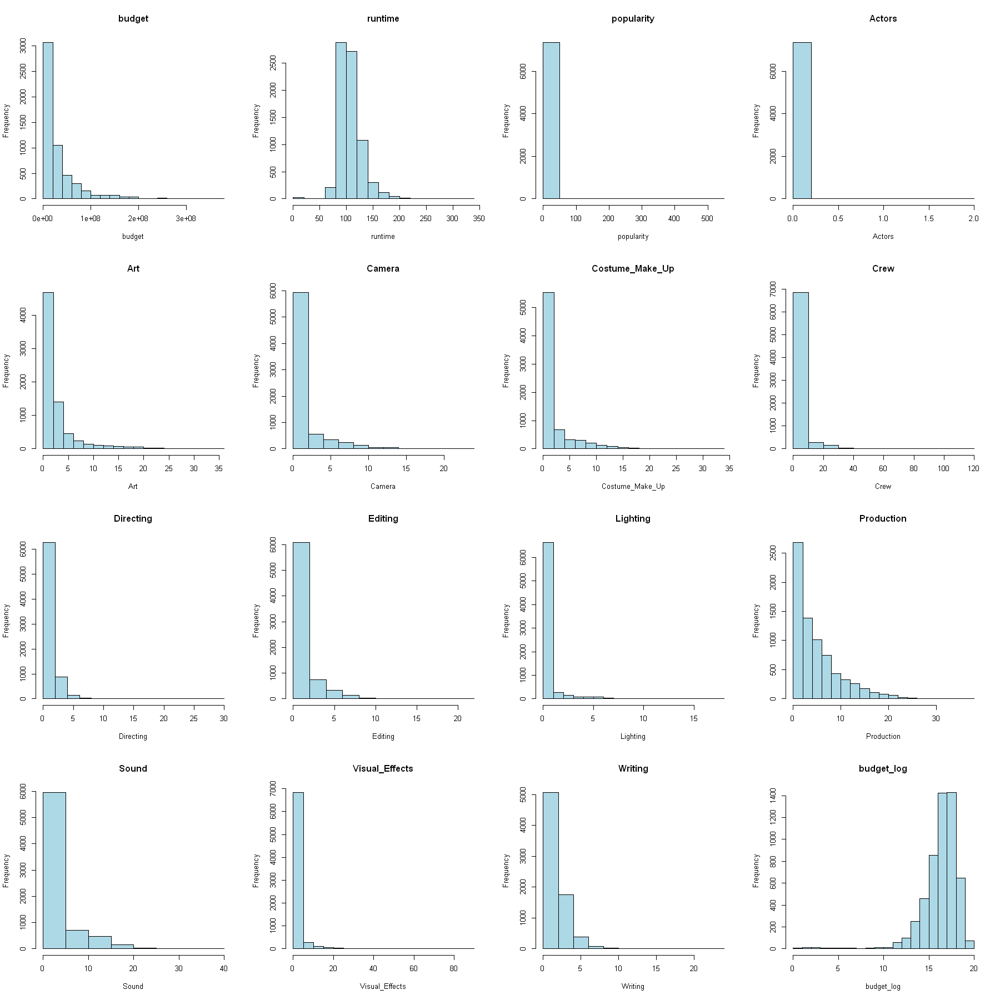

In [17]:
options(repr.plot.width =15, repr.plot.height = 15)
par(mfrow=c(4,4))
for (n in numlst){
    hist(as.numeric(ff[[n]]), xlab = n, main = n, col = 'lightblue')
   }


some tables to get orientation about the data

In [18]:
table(ff$lang2)


   en    es    fr    hi    ja other    ru 
 6352    95   199   118    90   436   109 

In [19]:
table(ff$release_month,ff$lang2)

    
      en  es  fr  hi  ja other  ru
  1  423   4  18  11   3    48   5
  2  443   2  13  10   0    41  10
  3  492  12  13   3   6    29   9
  4  492   9  17   6   6    20   8
  5  480   5  32  10   3    48   7
  6  529   6   9  12   5    25  10
  7  479   4   7  13  29    29   6
  8  557  12  13  16   6    47   7
  9  782  16  28  11   8    49  10
  10 603  12  25   6   5    35  11
  11 473   9  11  11  11    22   4
  12 598   4  13   9   8    43  22

compare all the numeric vars against the categorical ones

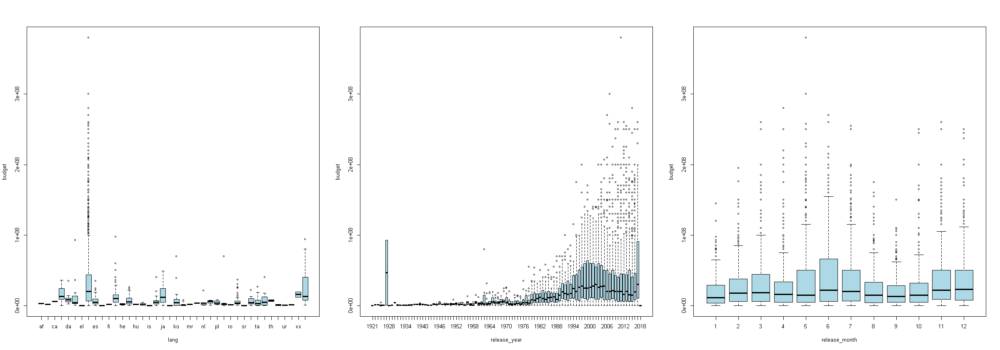

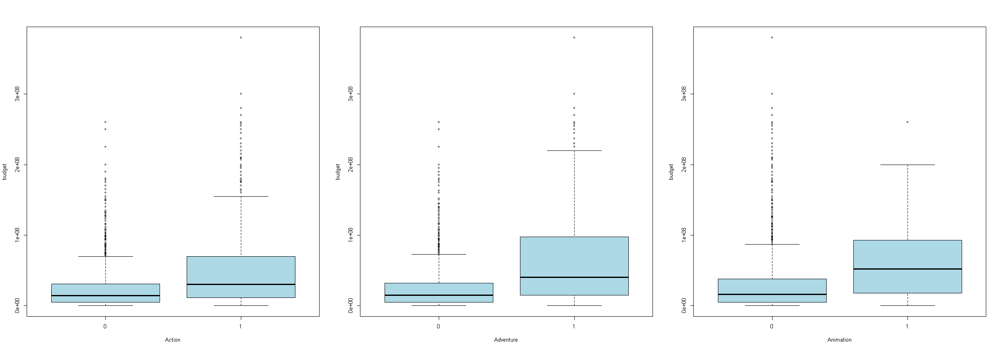

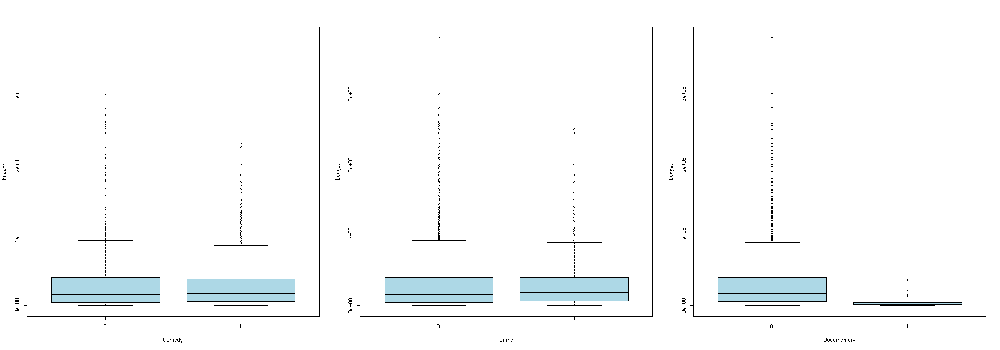

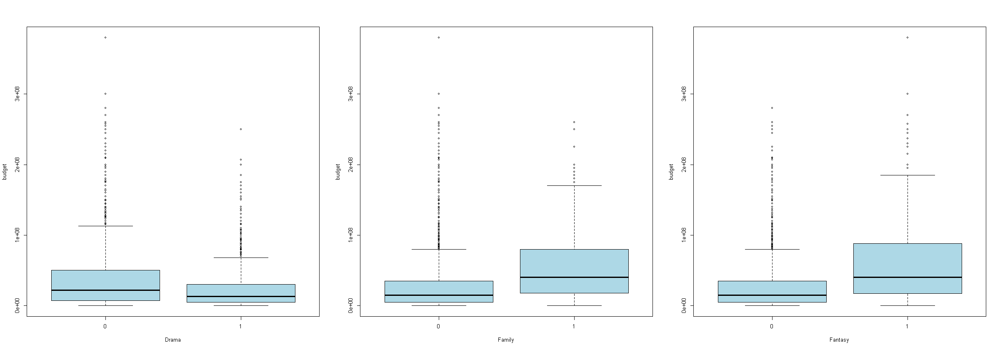

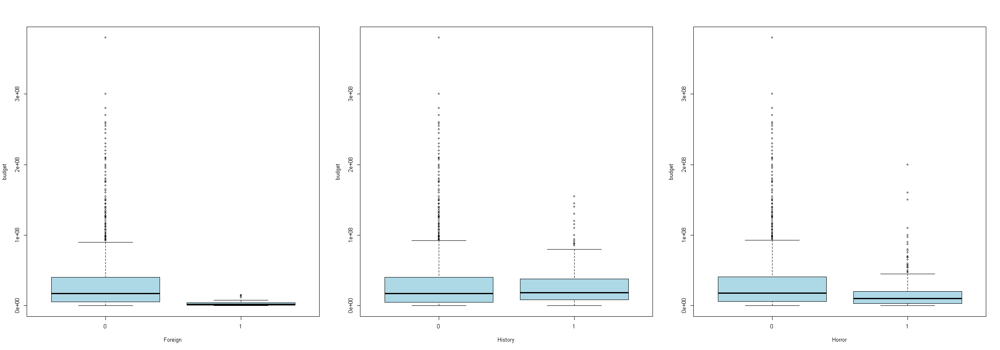

...

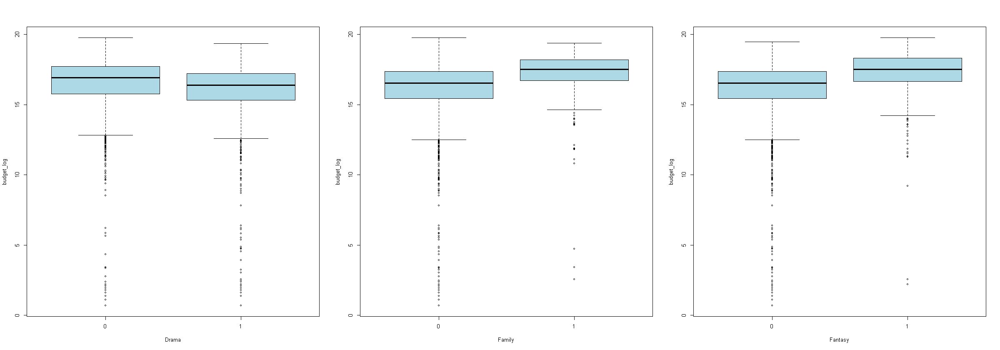

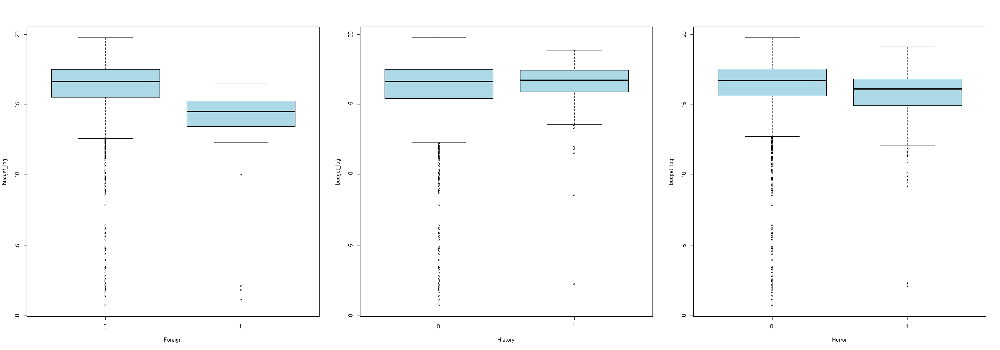

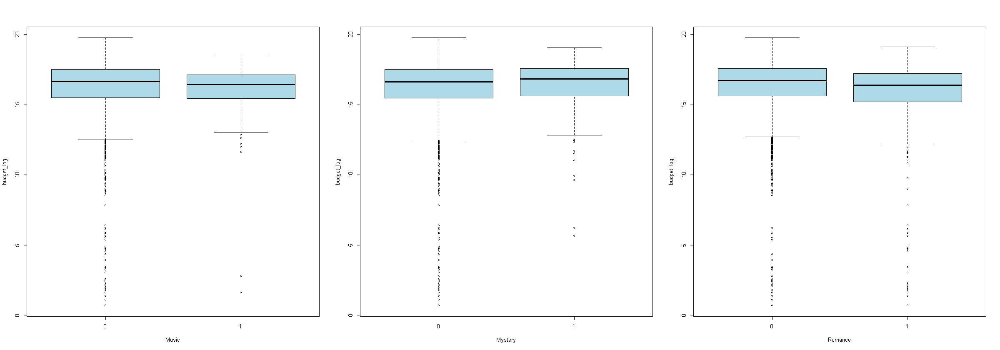

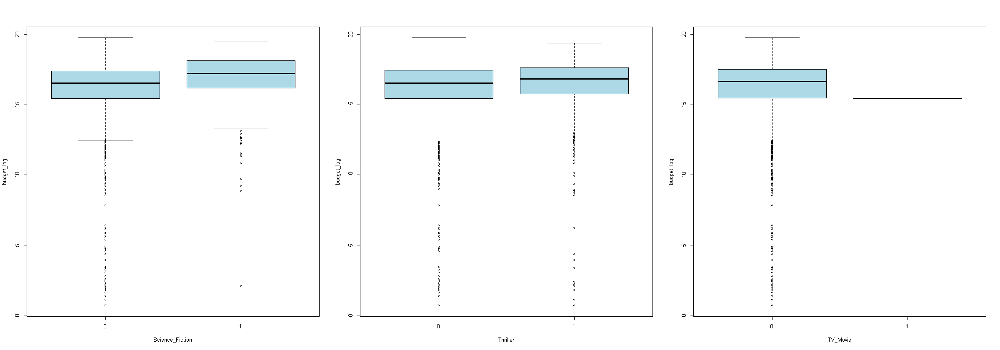

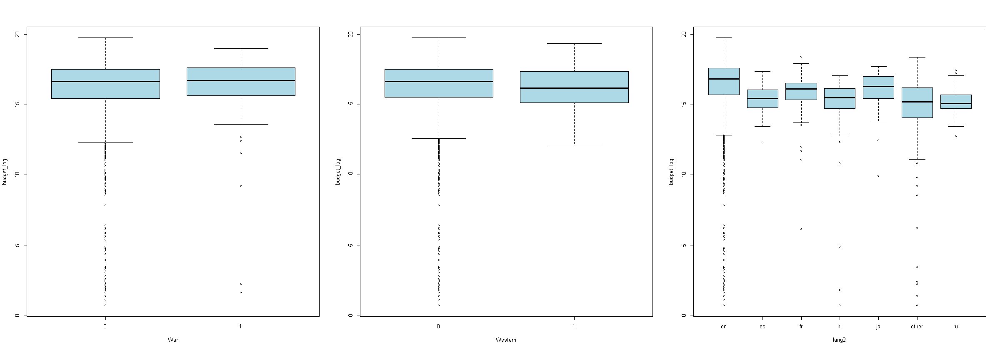

In [20]:
options(repr.plot.width =20, repr.plot.height = 7)
        par(mfrow=c(1,3))
for (n in numlst){
    for (s in catlst){
        boxplot(ff[[n]] ~ ff[[s]], xlab = s, ylab = n, col='light blue')
    }
}

density graphs 

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-miss

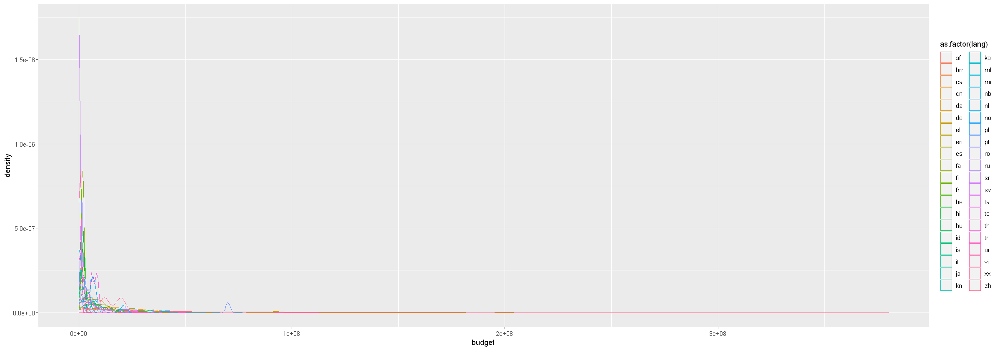

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


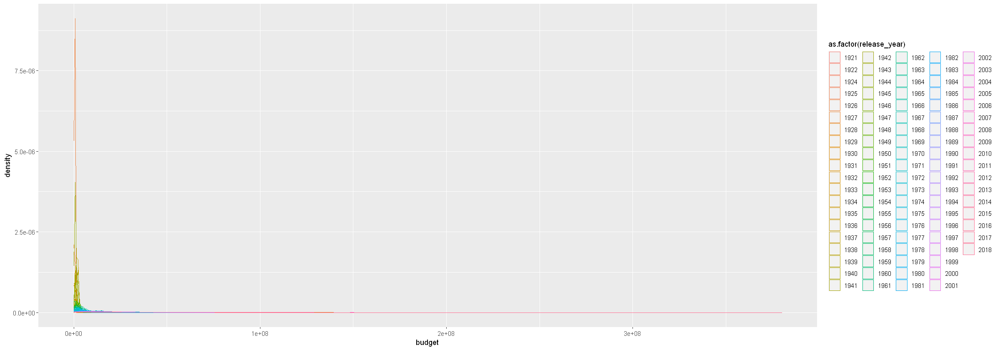

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


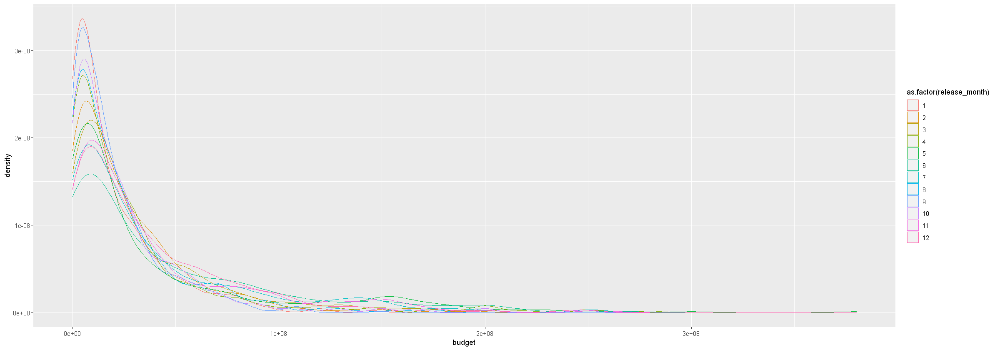

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


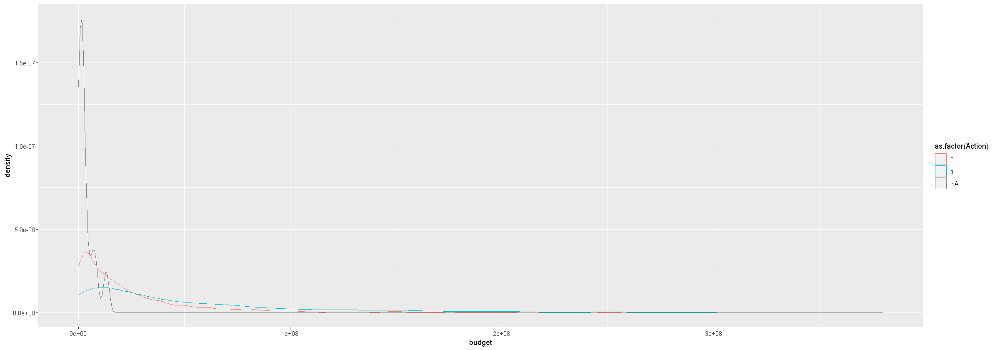

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


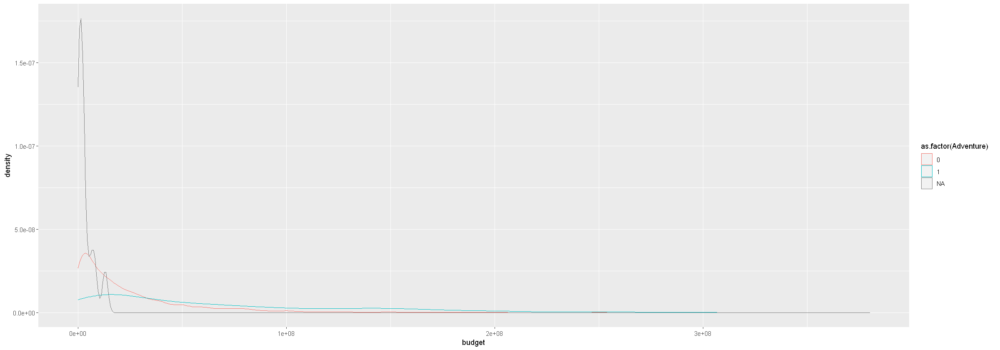

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


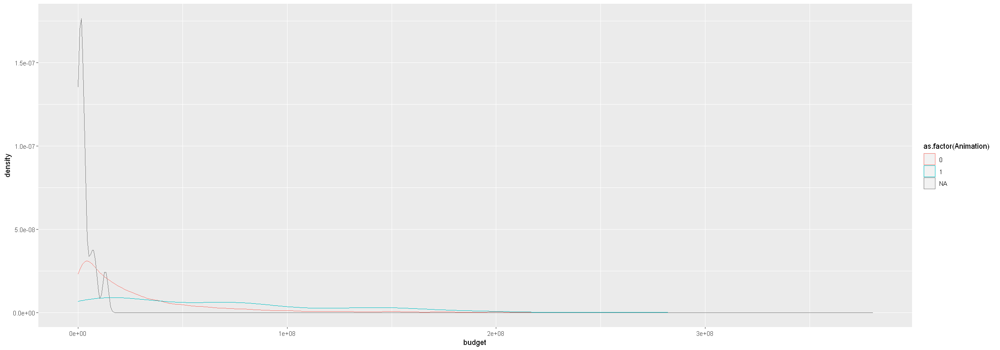

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


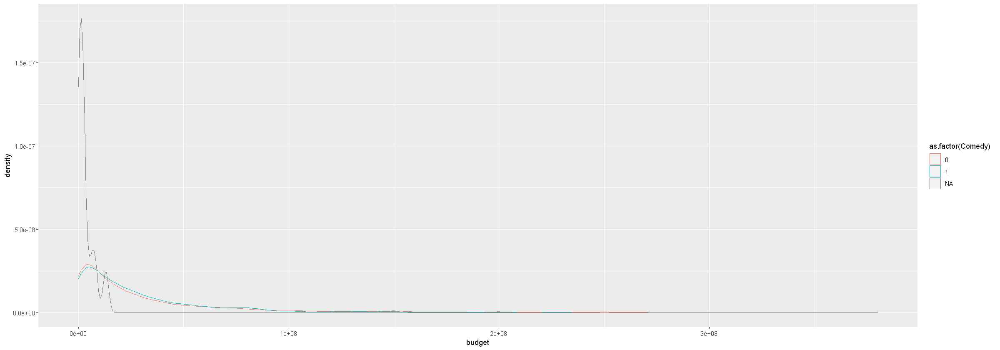

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


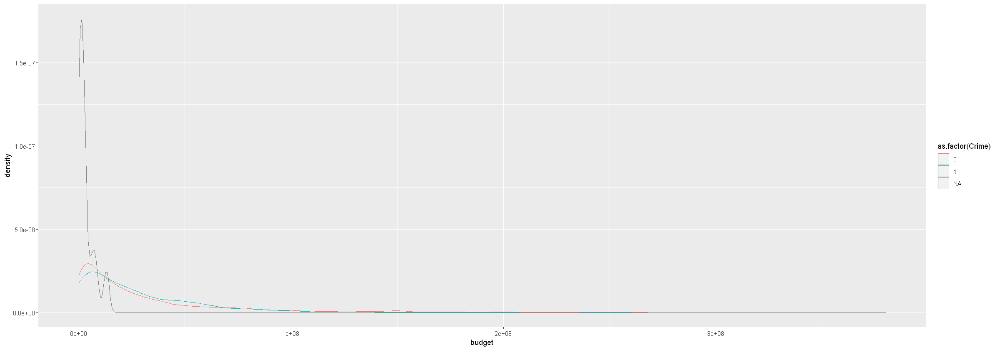

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


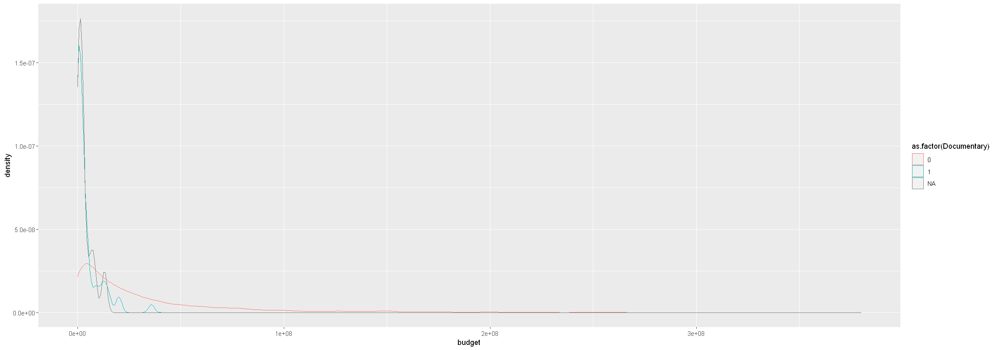

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


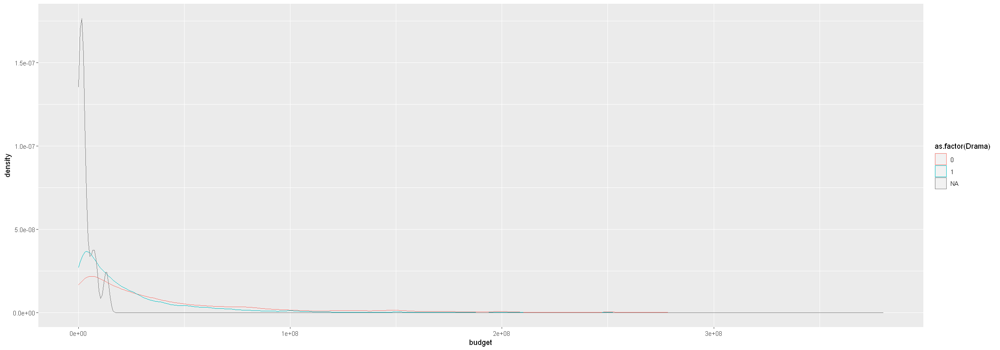

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


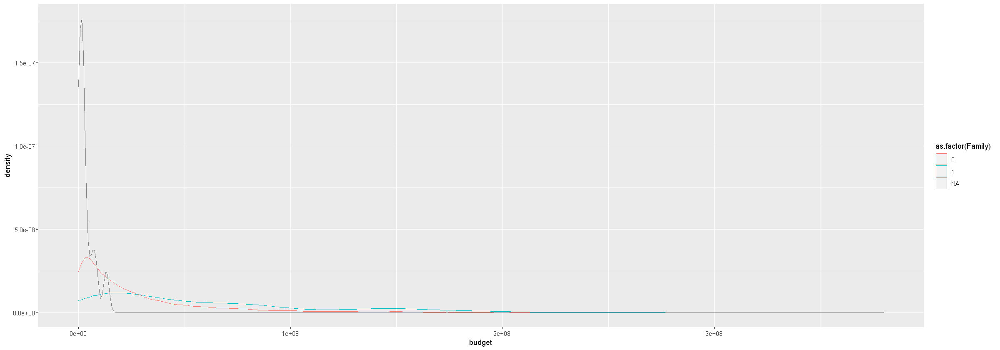

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


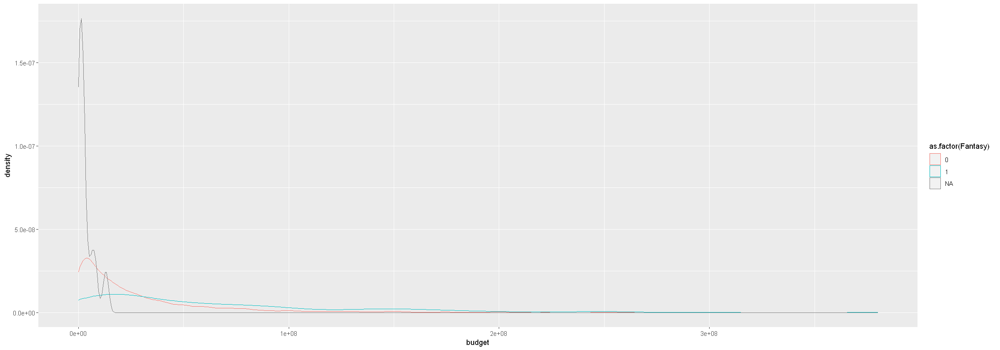

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


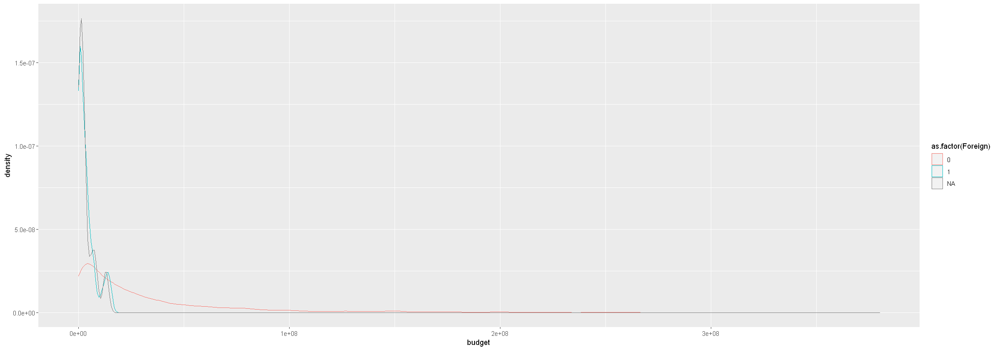

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


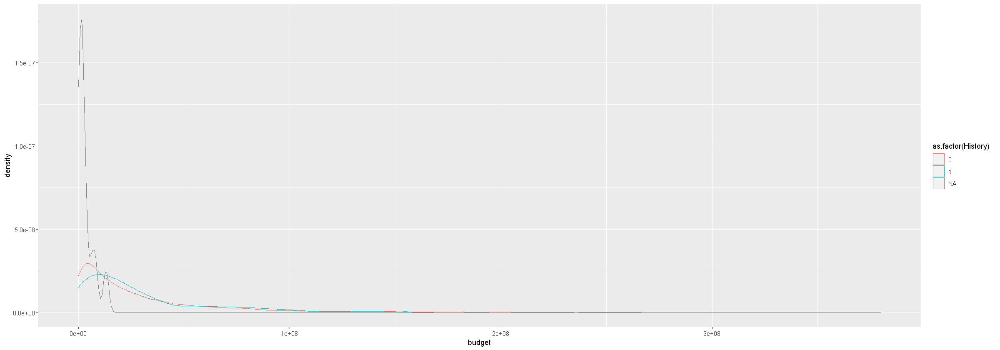

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


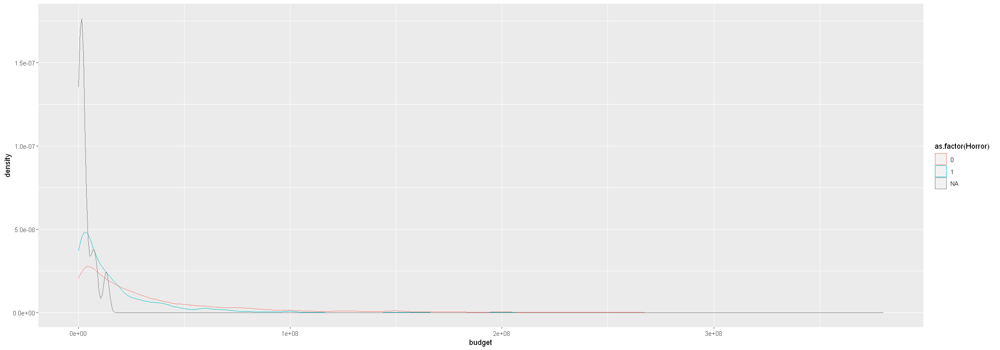

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


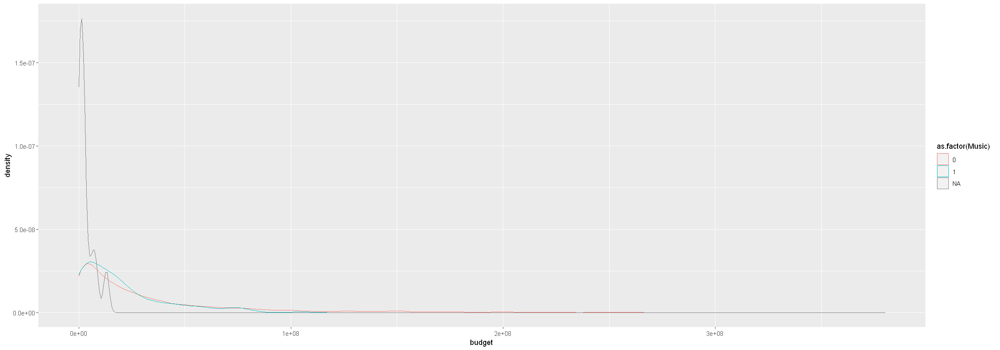

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


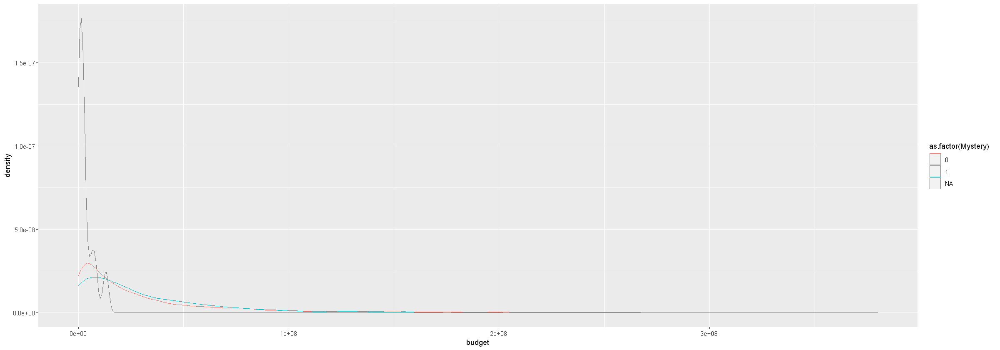

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


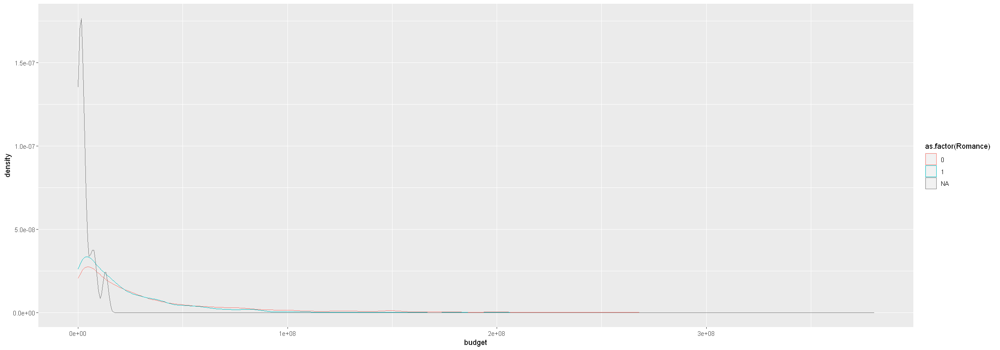

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


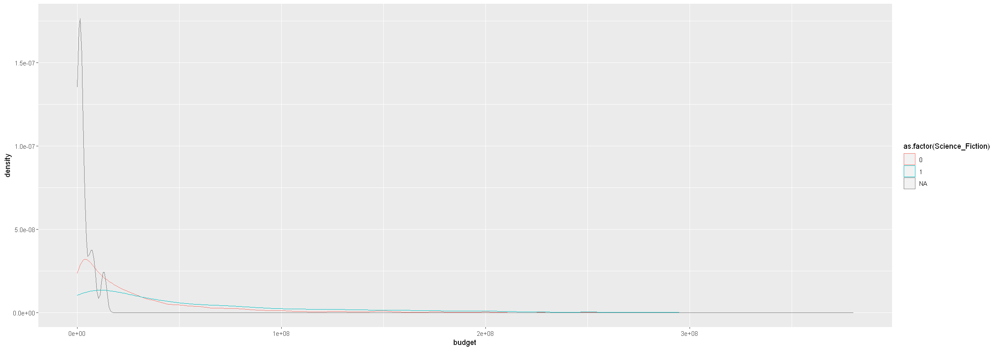

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


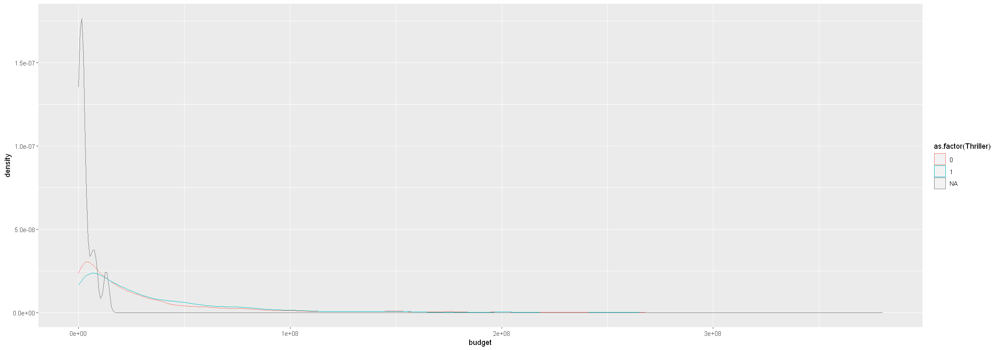

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


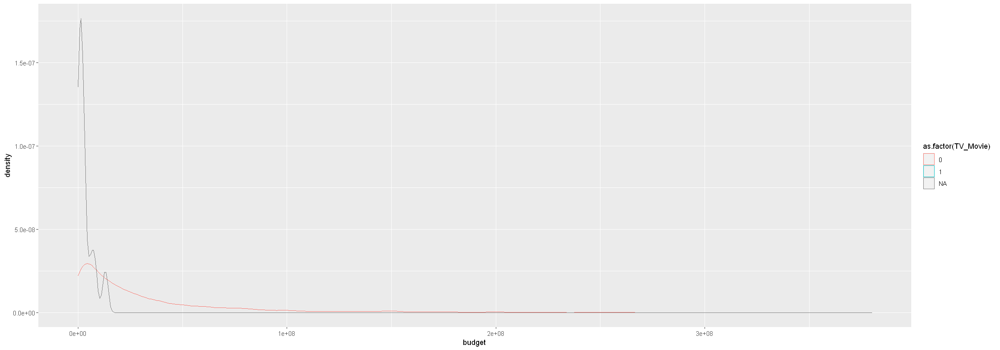

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


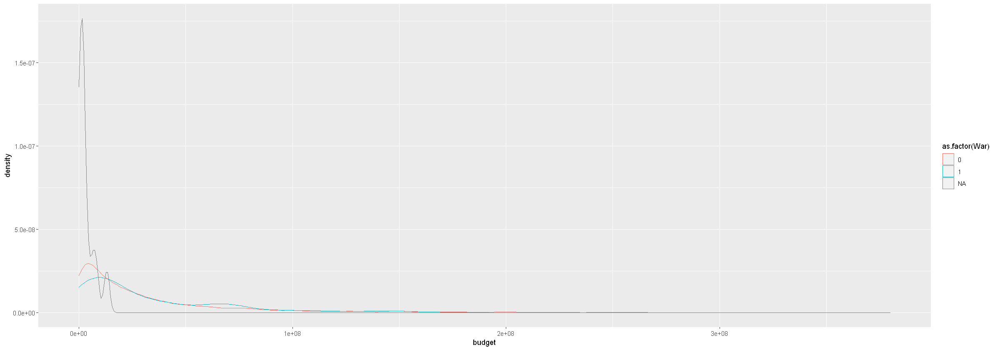

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


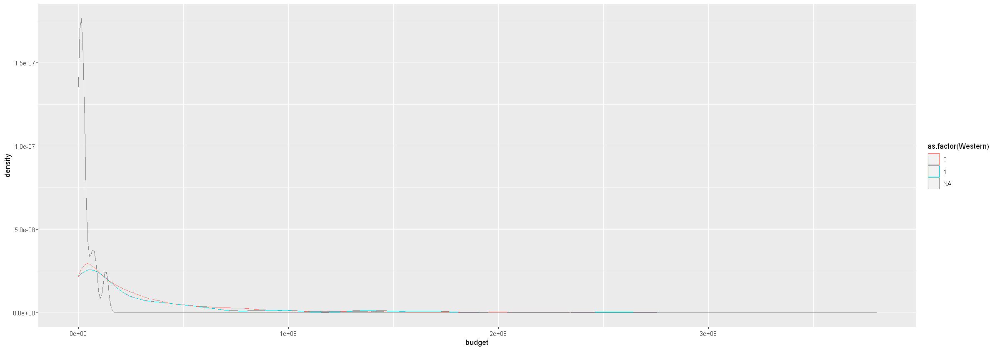

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):

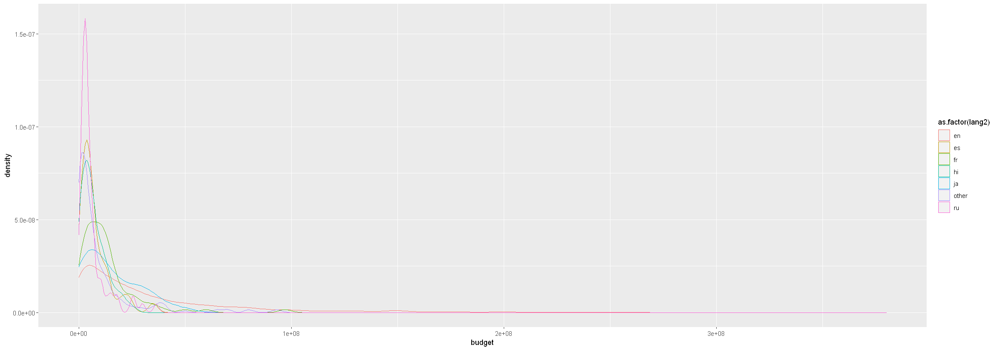

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning me

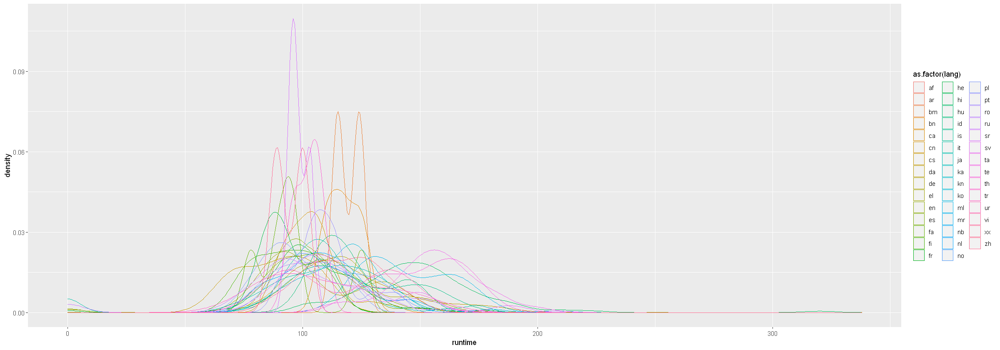

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


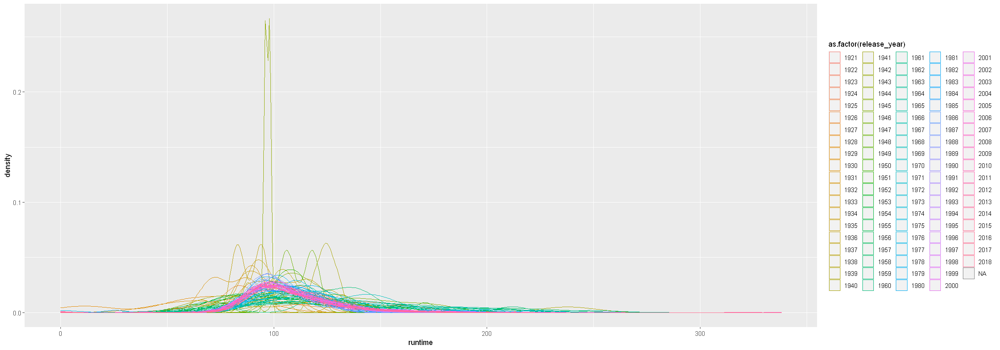

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


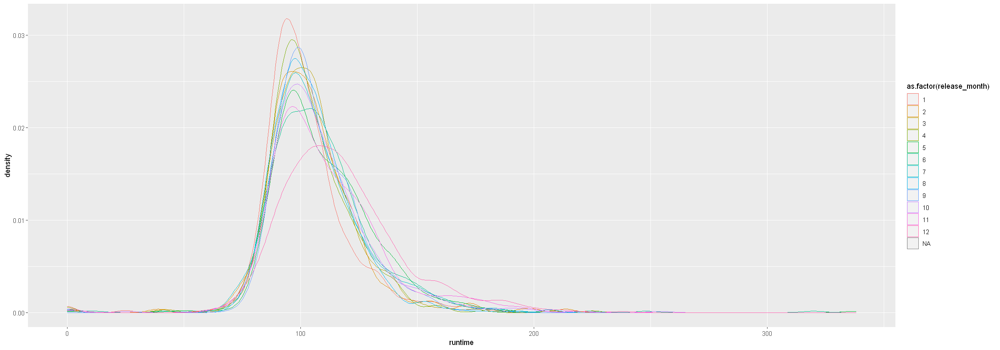

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


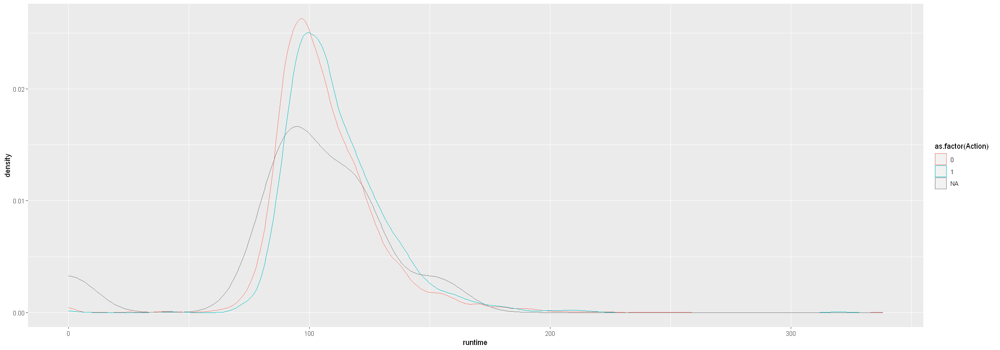

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


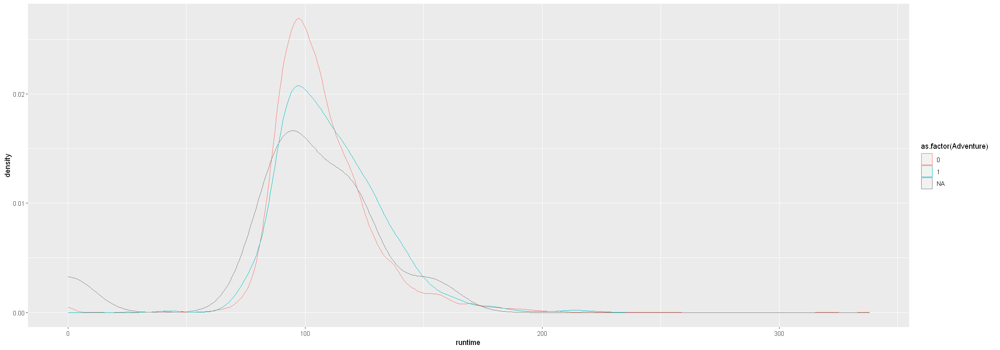

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


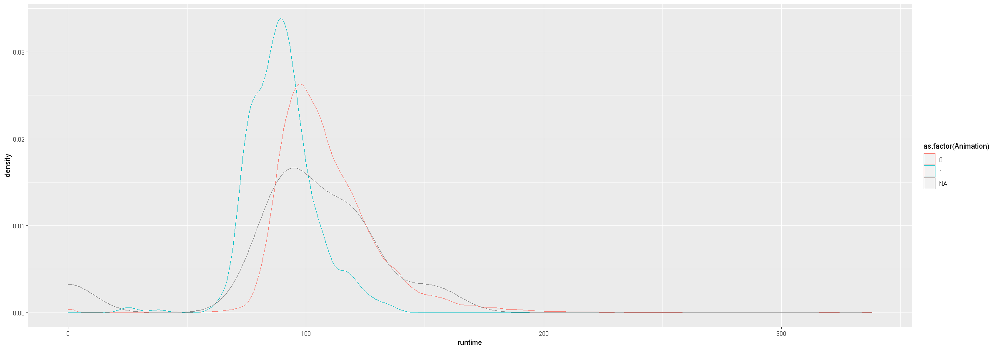

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


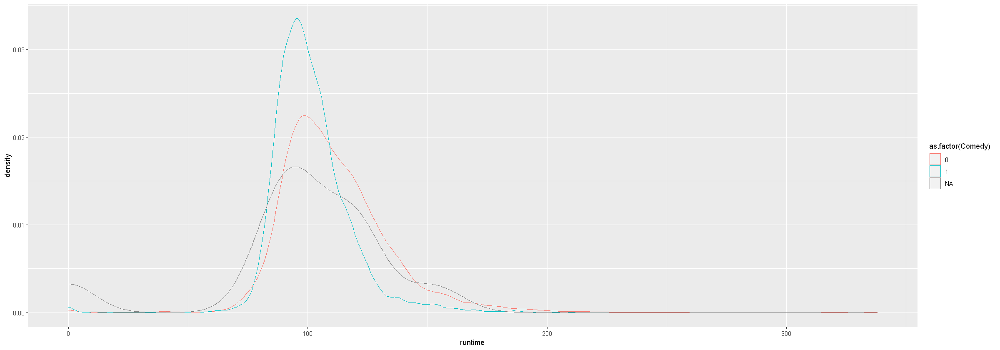

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


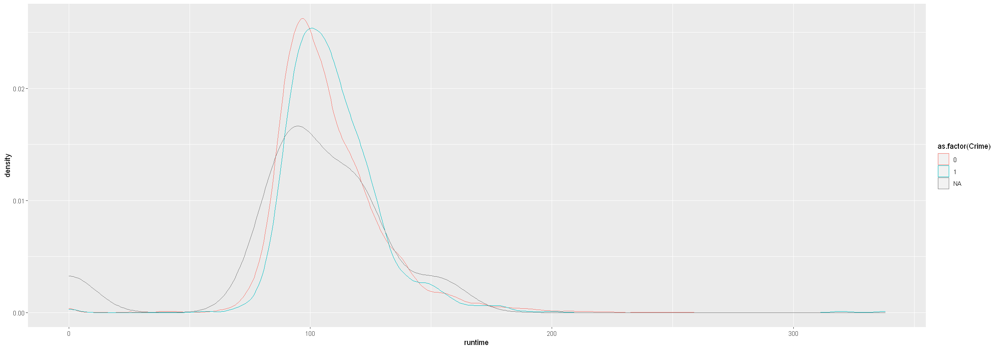

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


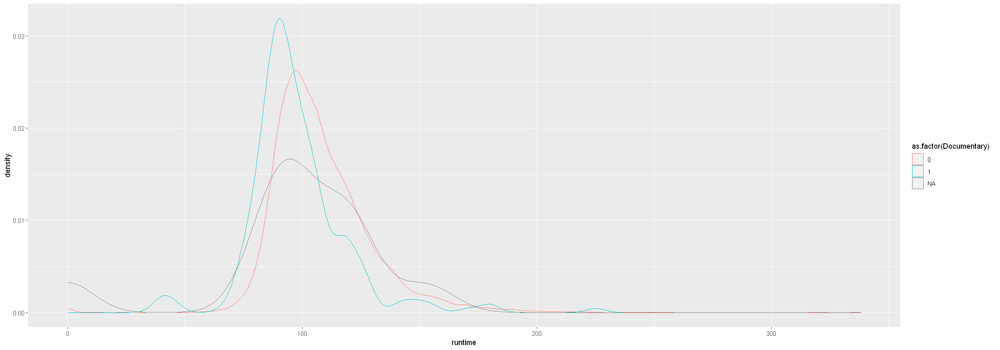

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


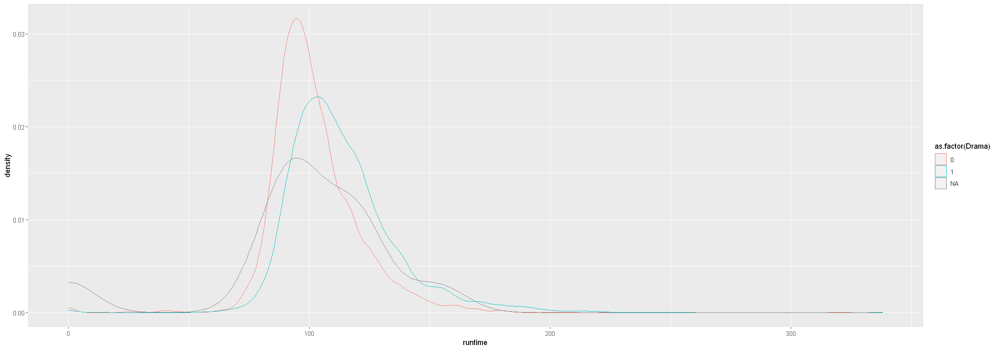

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


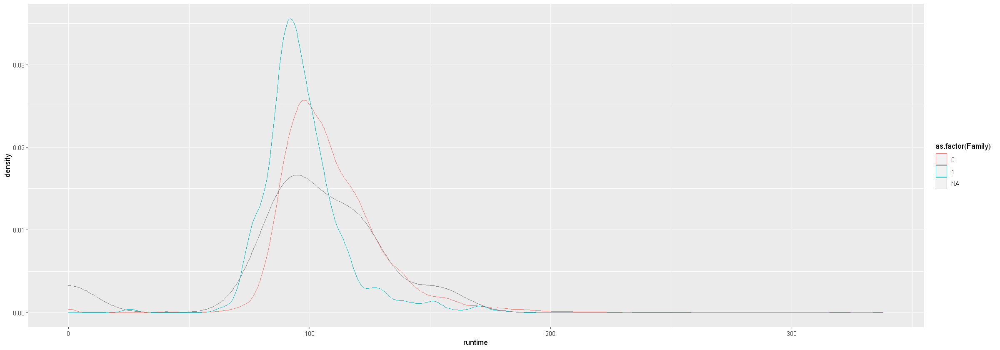

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


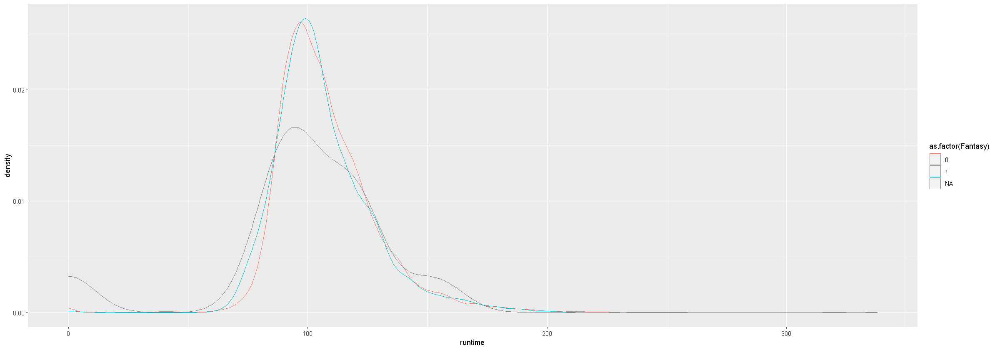

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


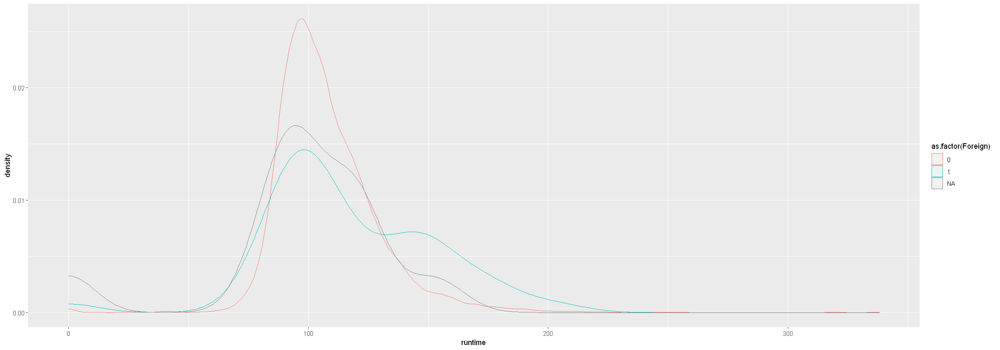

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


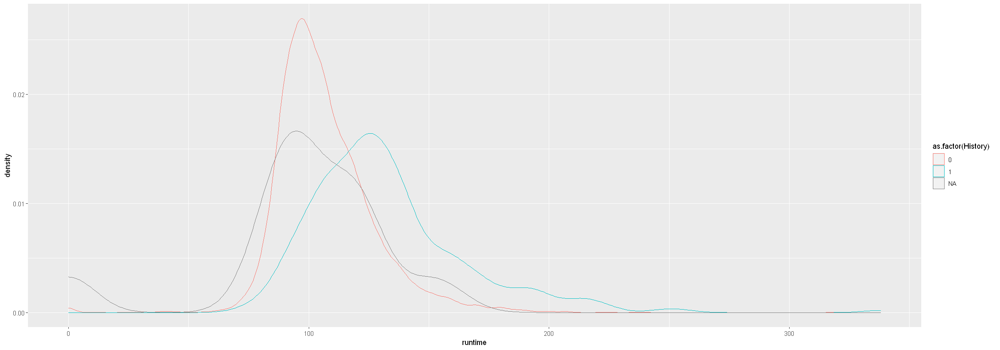

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


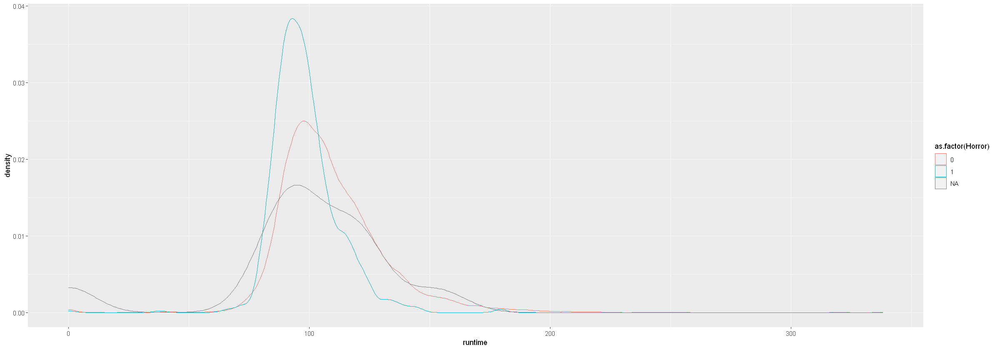

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


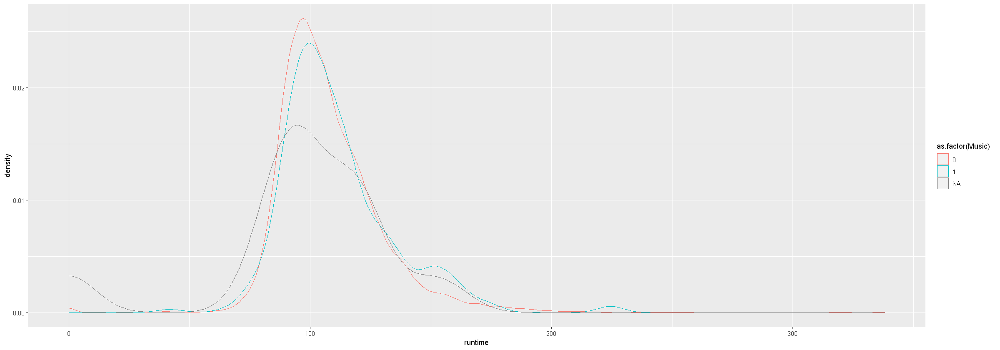

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


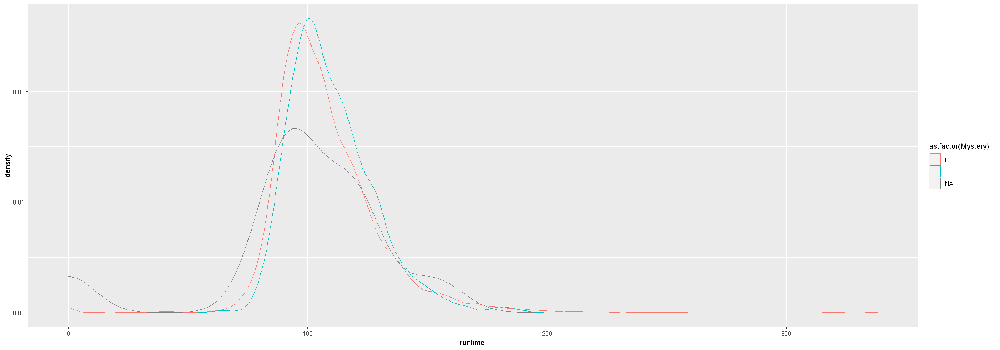

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


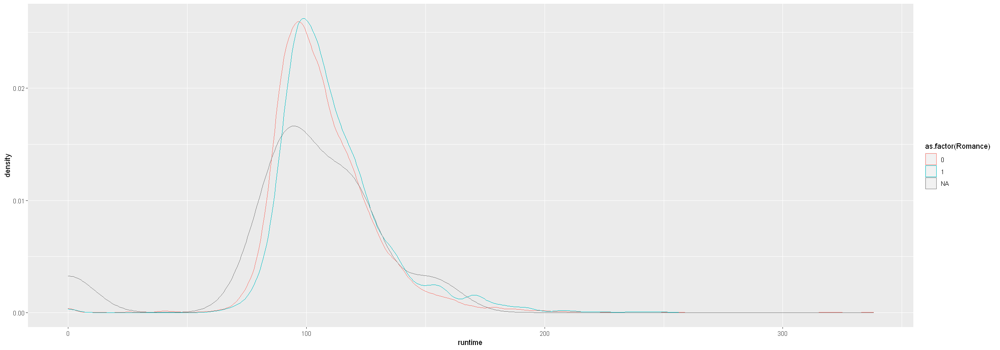

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


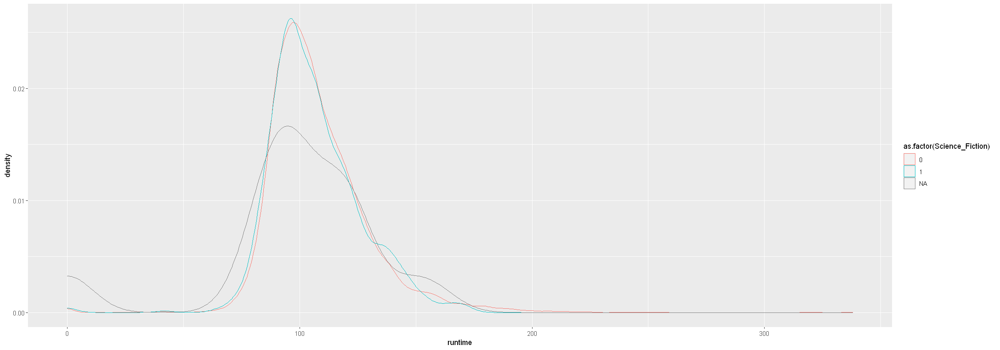

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


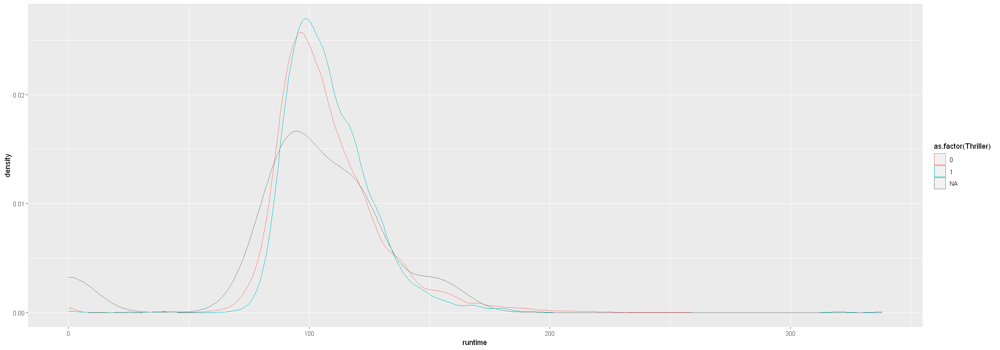

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


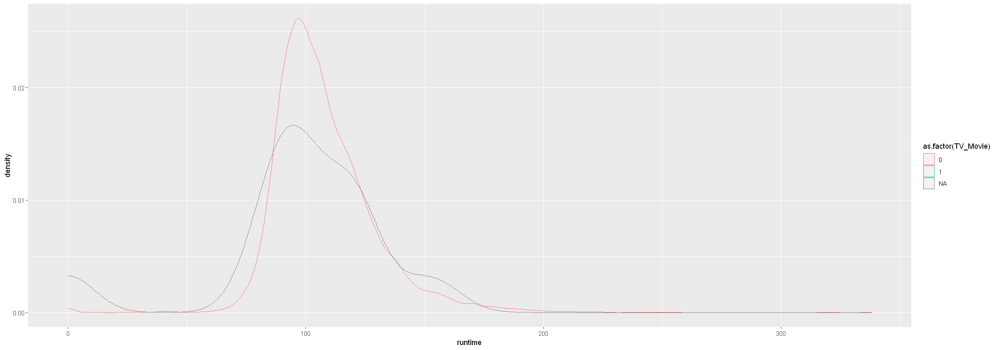

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


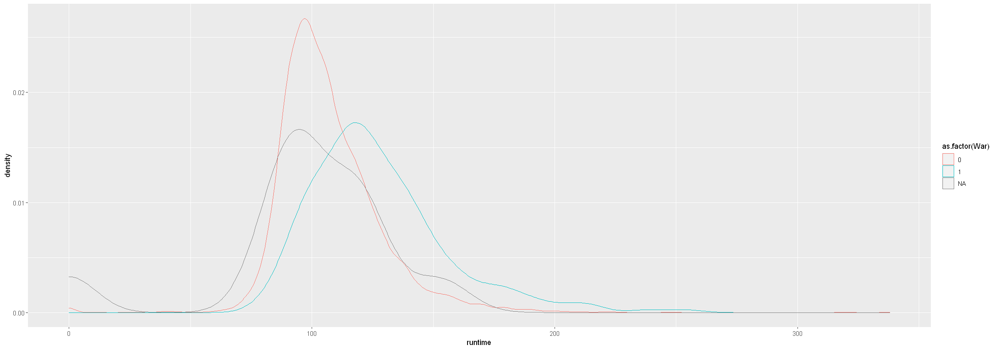

Warning message:
"Removed 6 rows containing non-finite values (stat_density)."


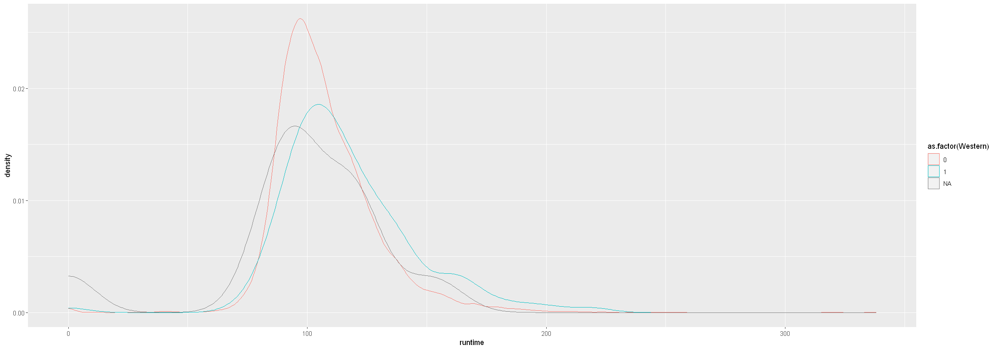

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, 

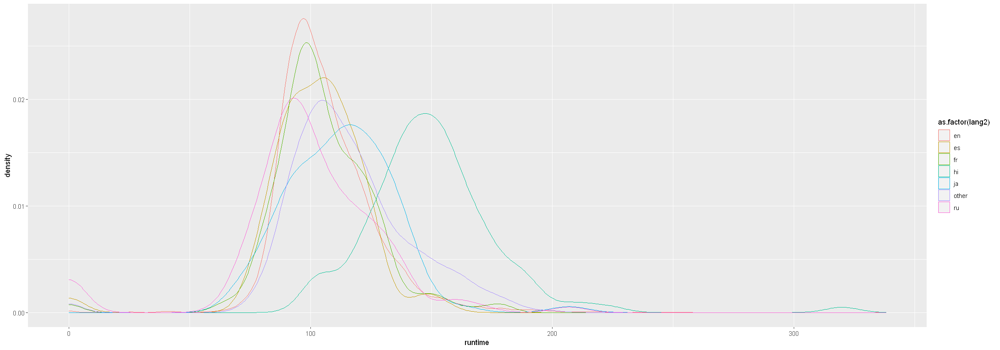

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -I

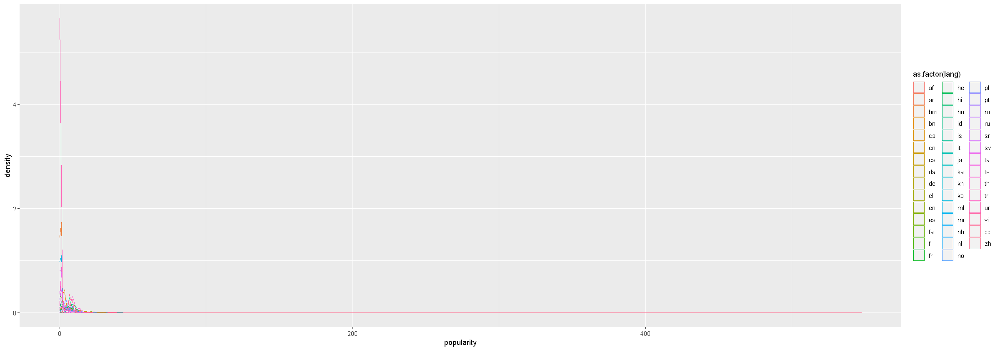

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


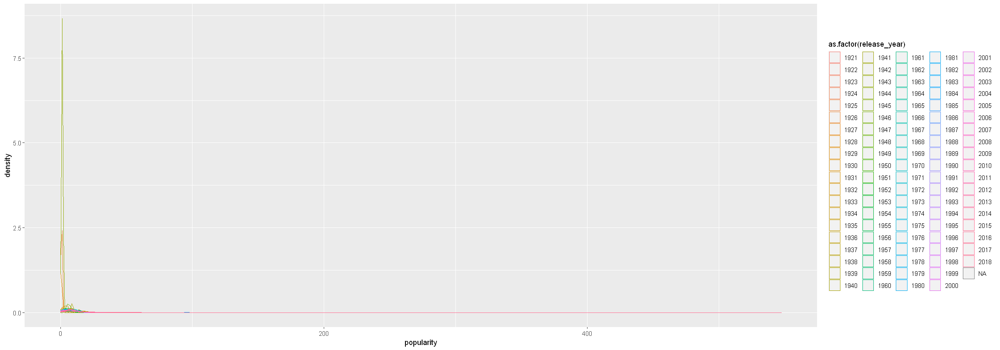

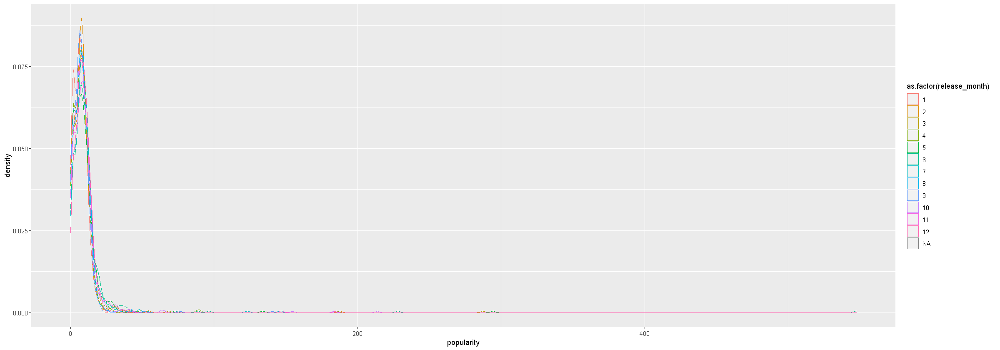

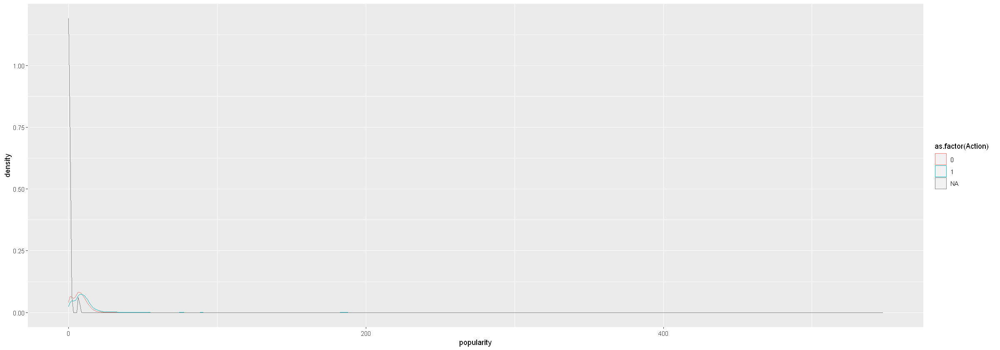

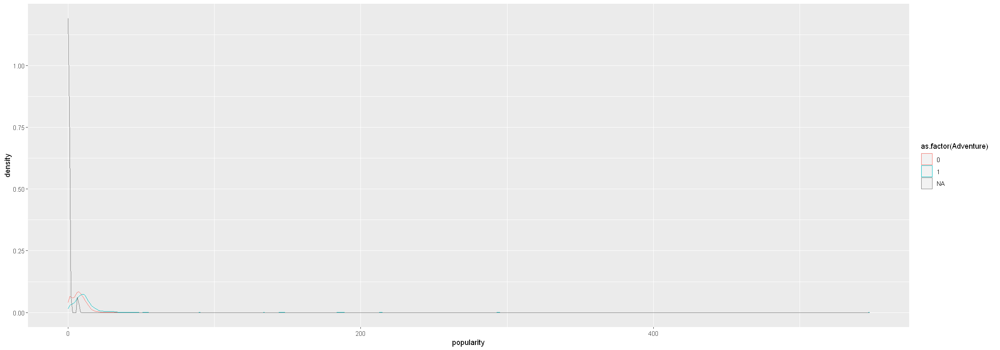

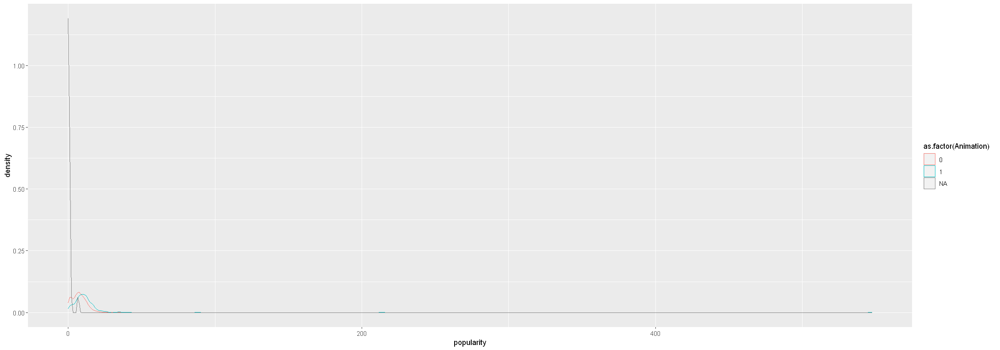

...

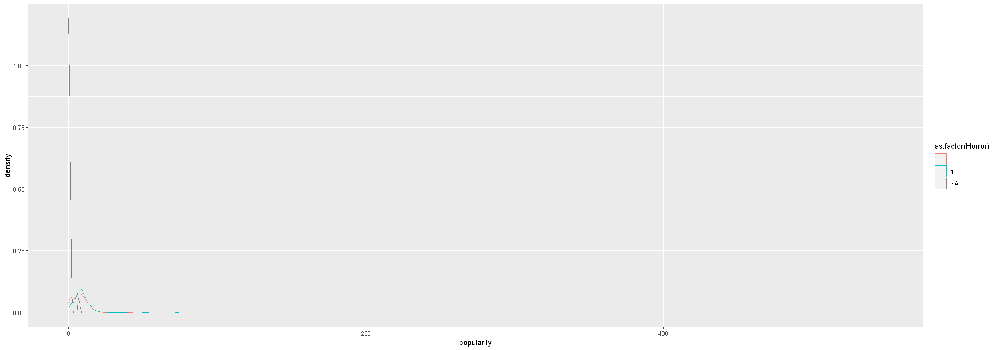

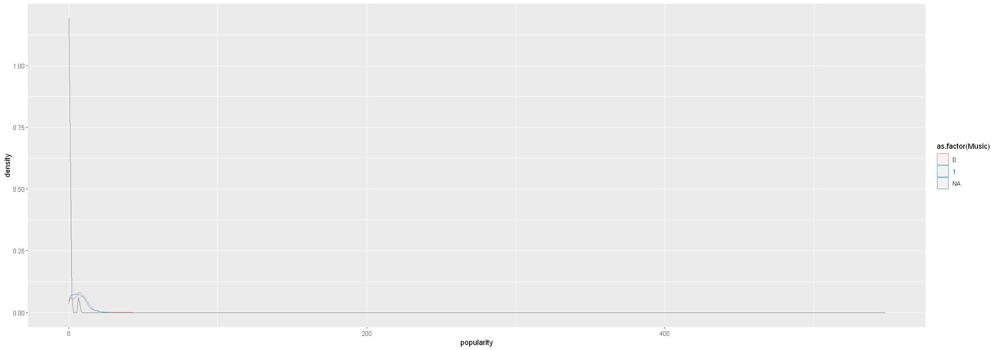

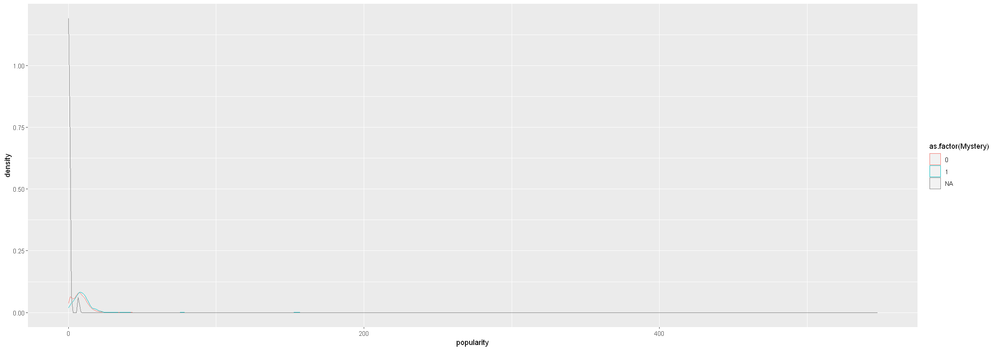

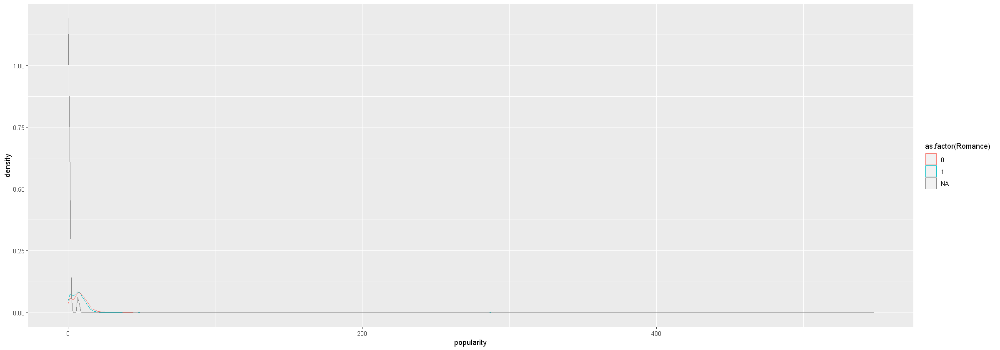

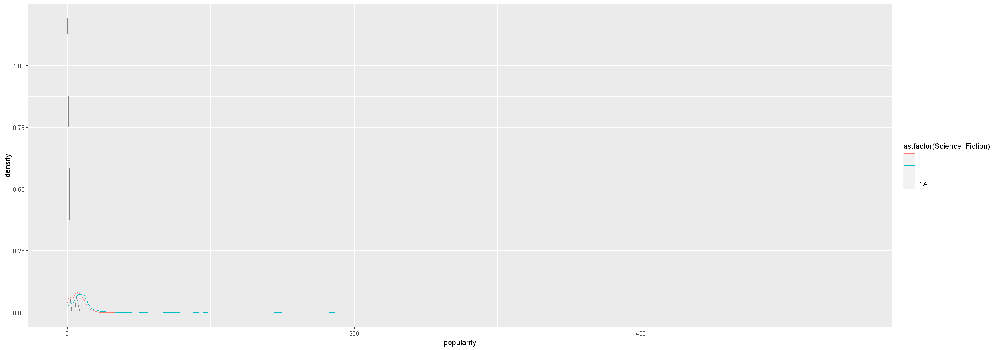

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


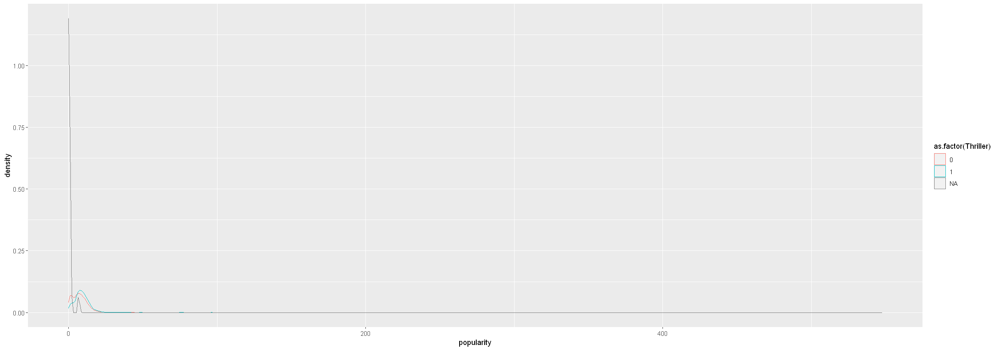

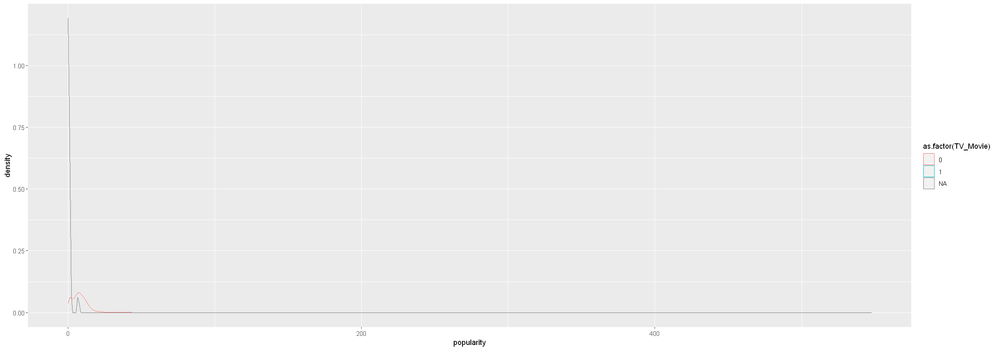

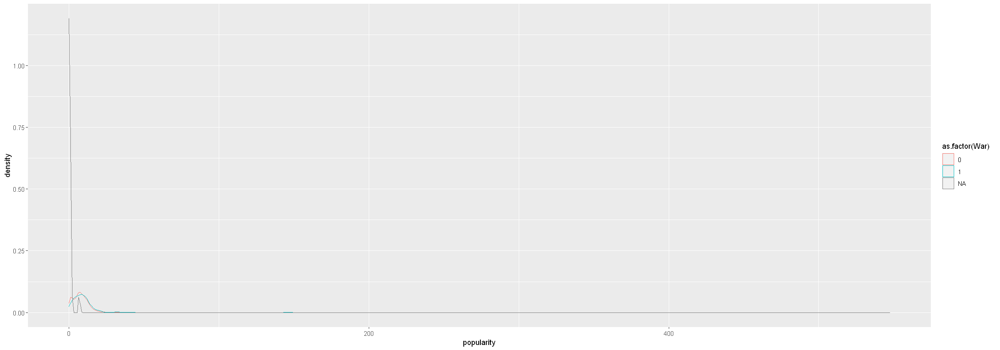

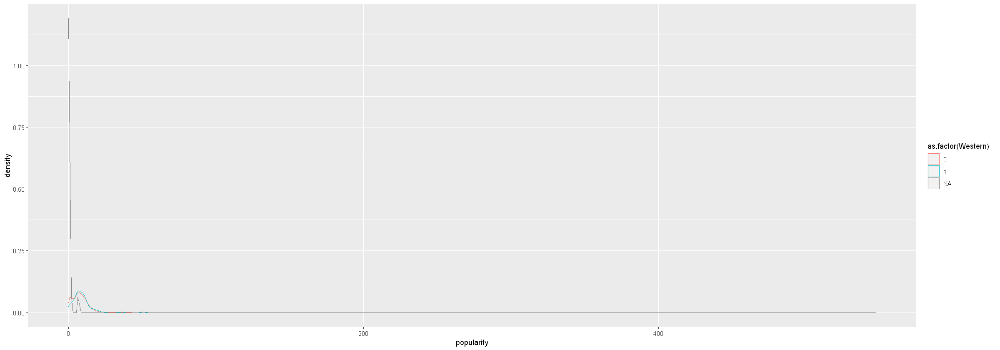

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

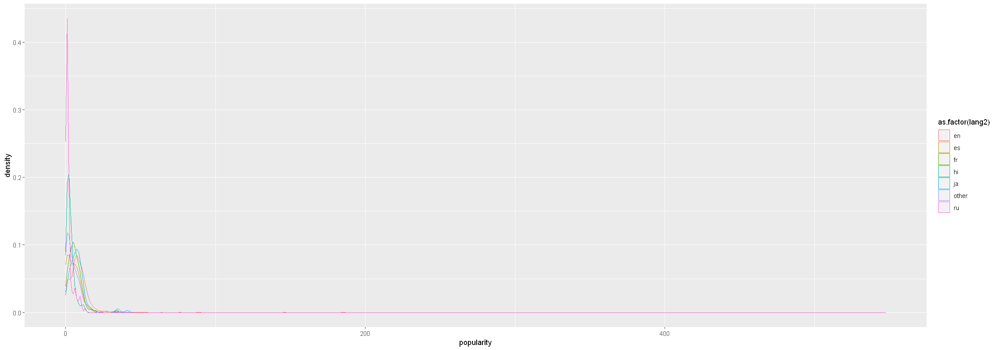

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

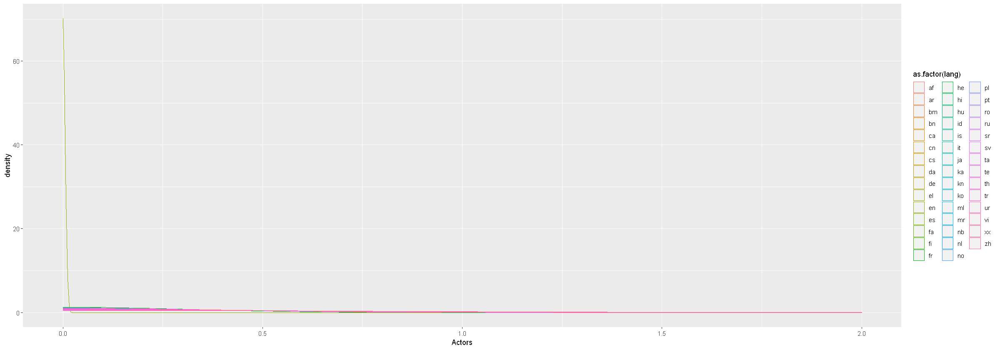

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


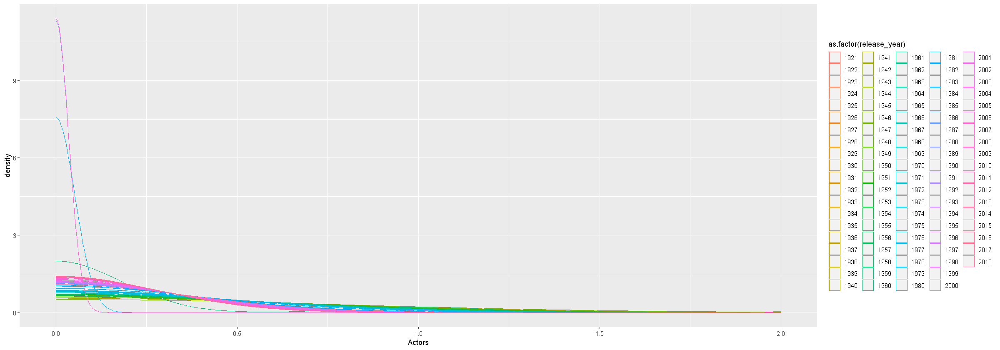

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


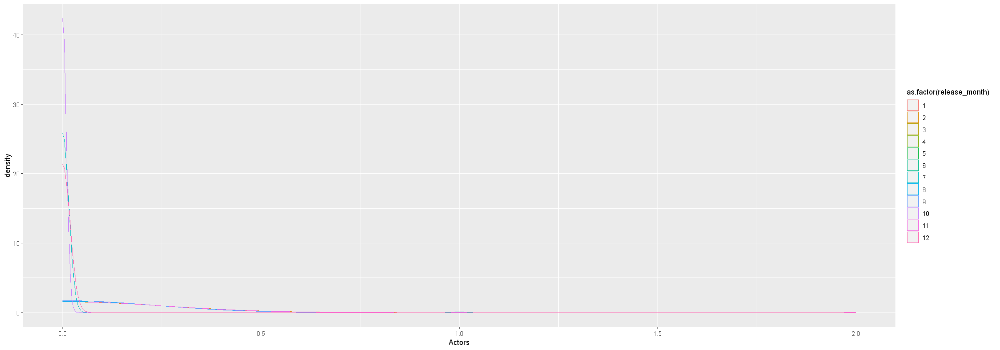

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


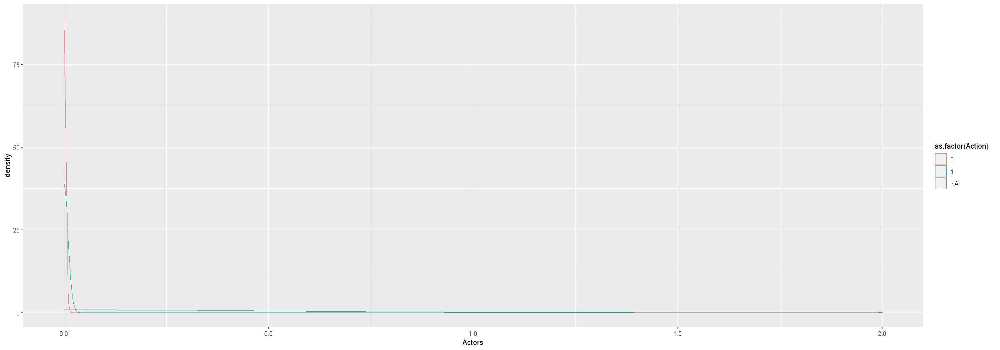

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


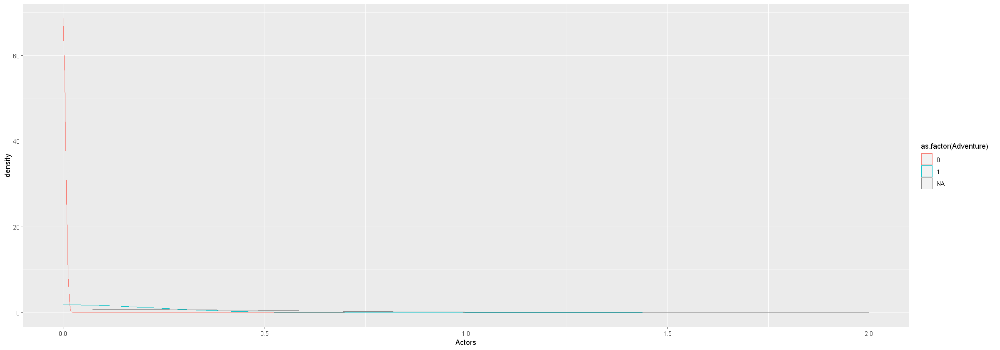

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


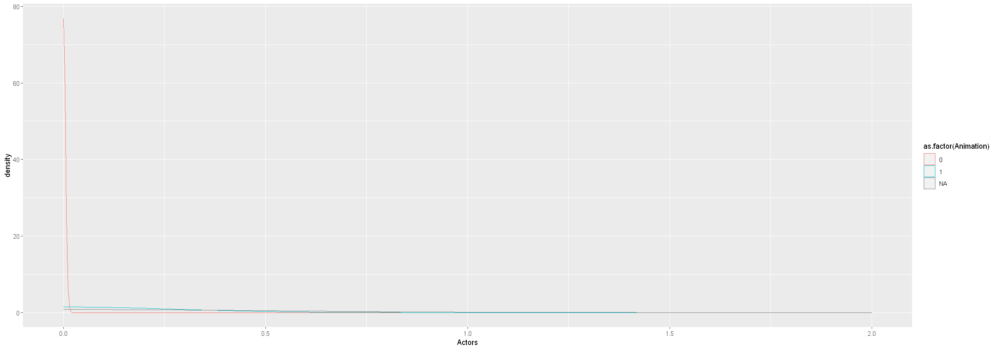

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


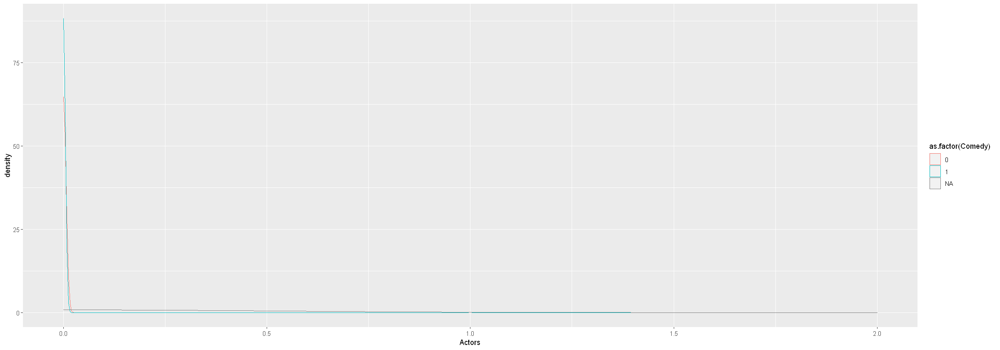

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


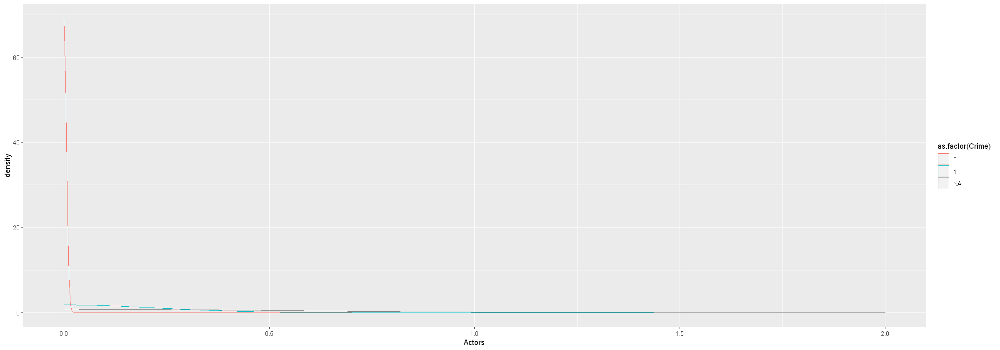

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


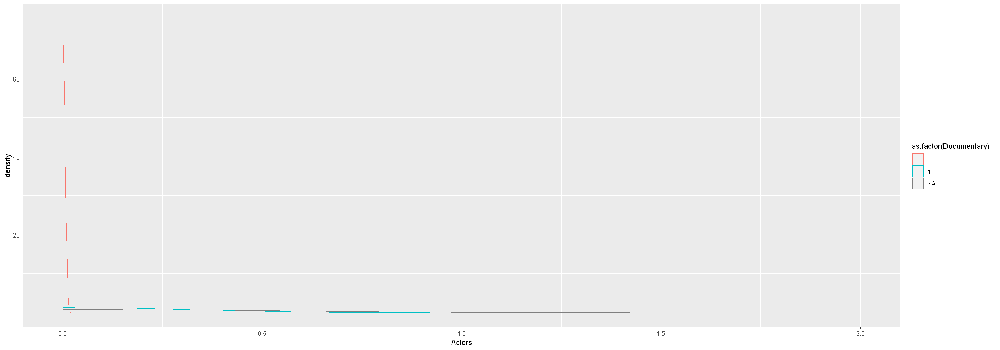

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


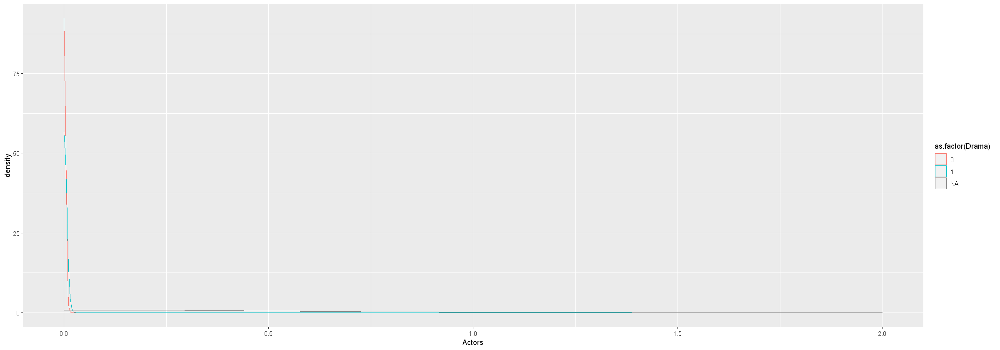

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


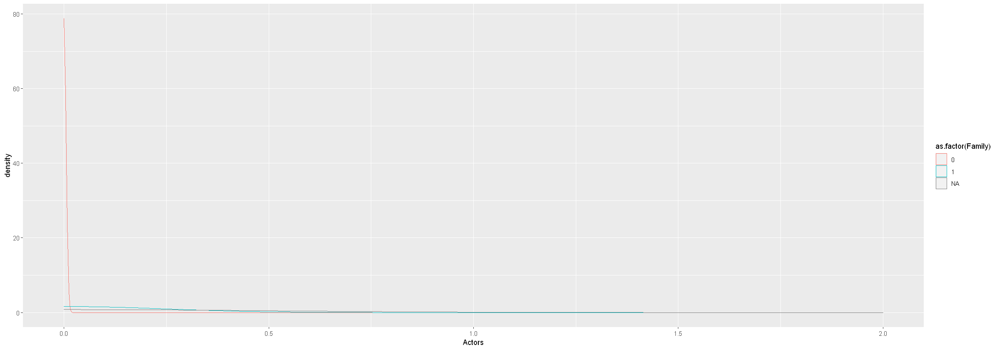

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


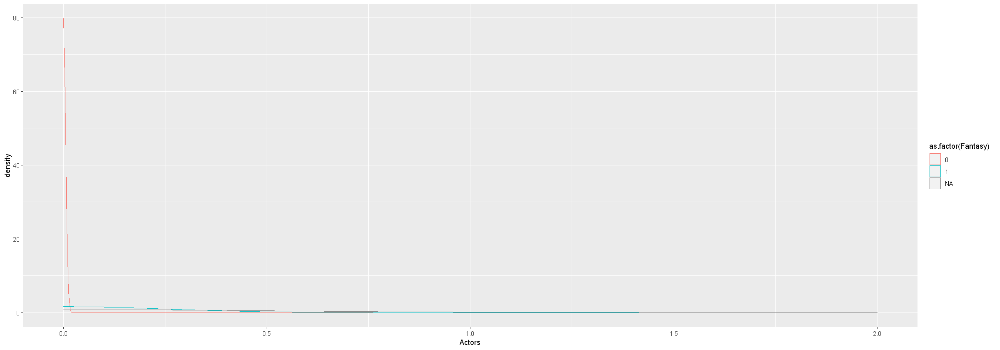

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


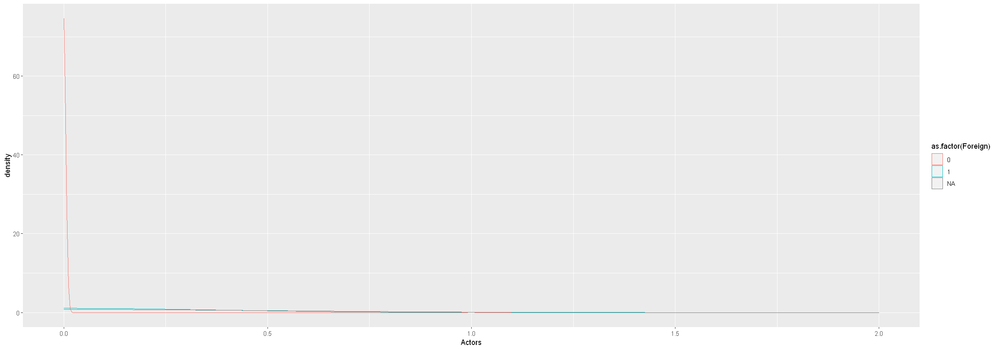

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


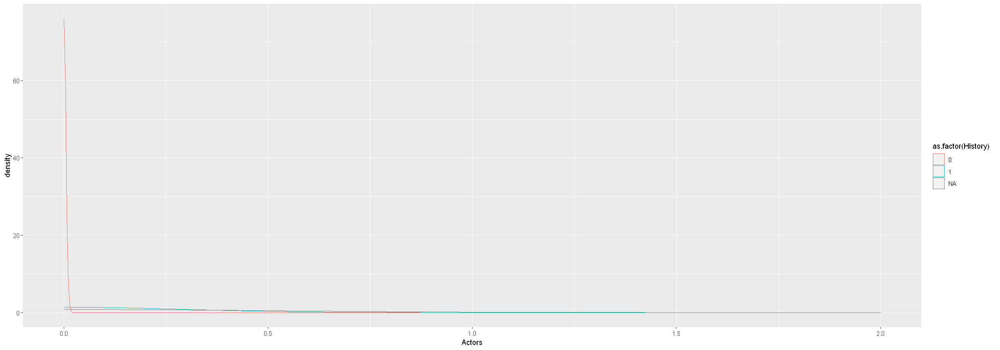

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


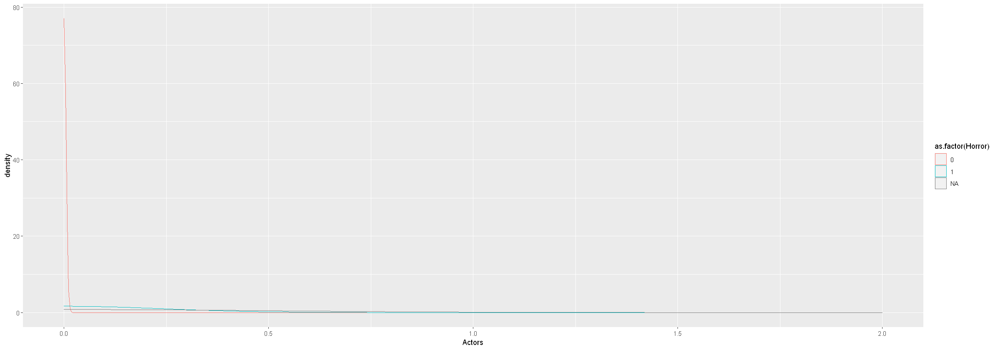

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


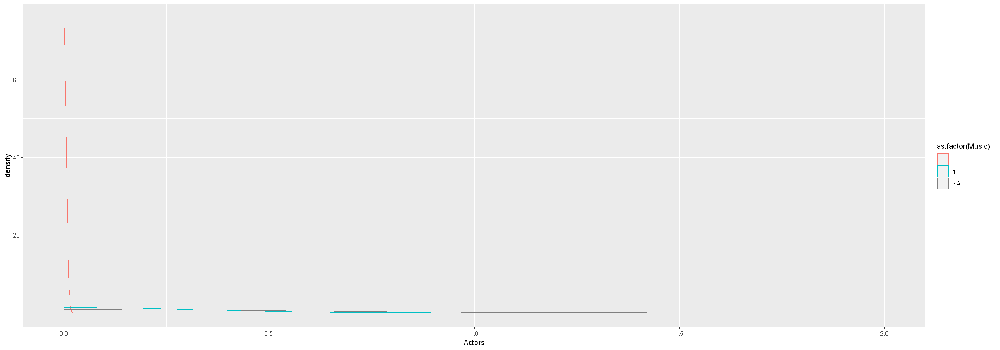

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


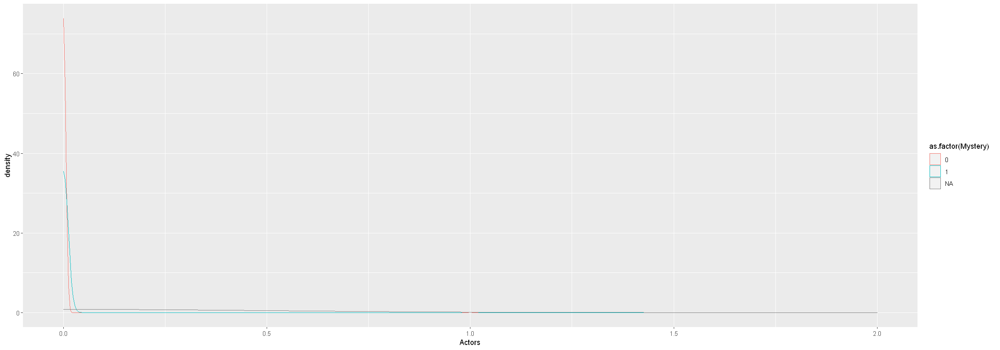

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


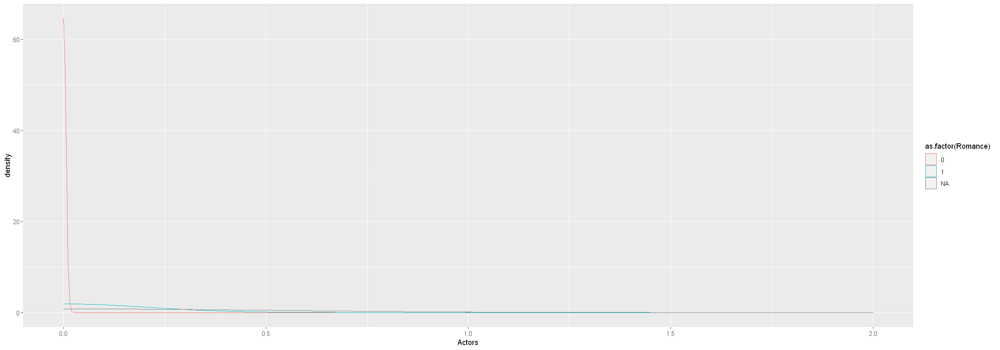

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


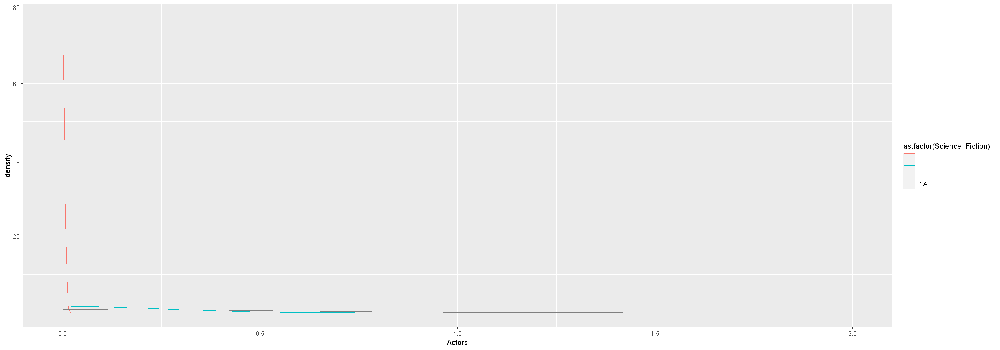

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


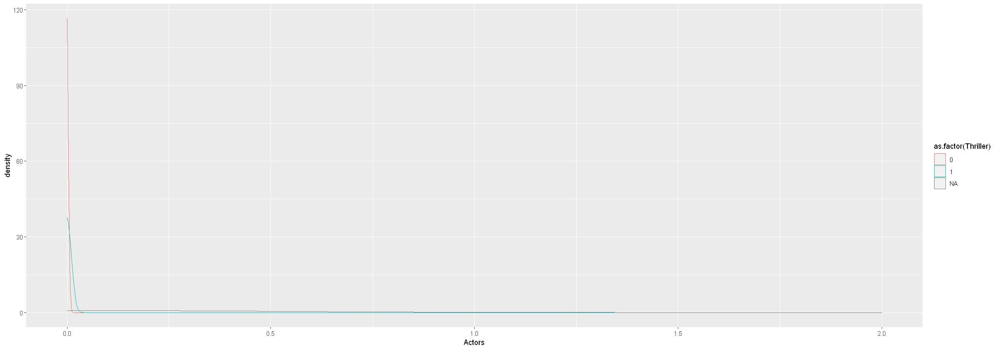

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


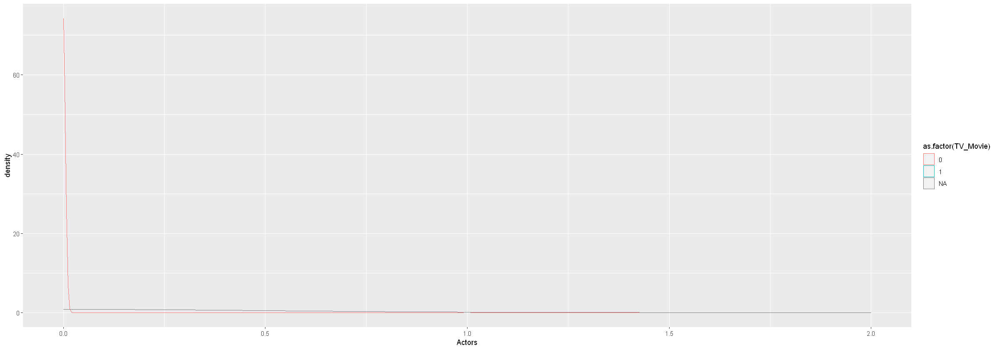

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


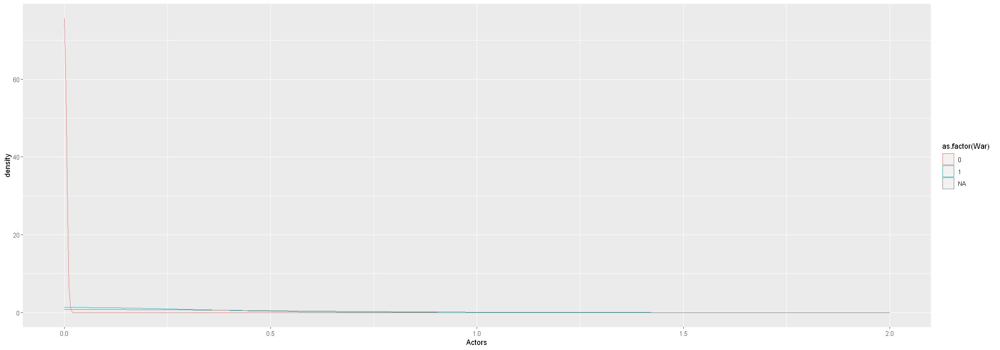

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


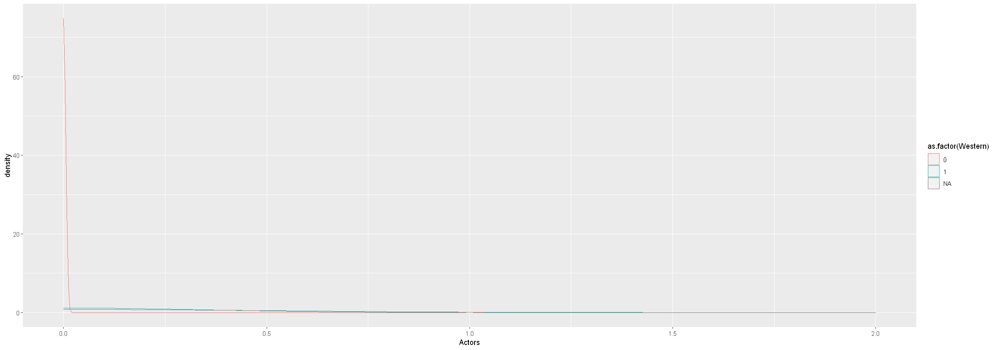

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

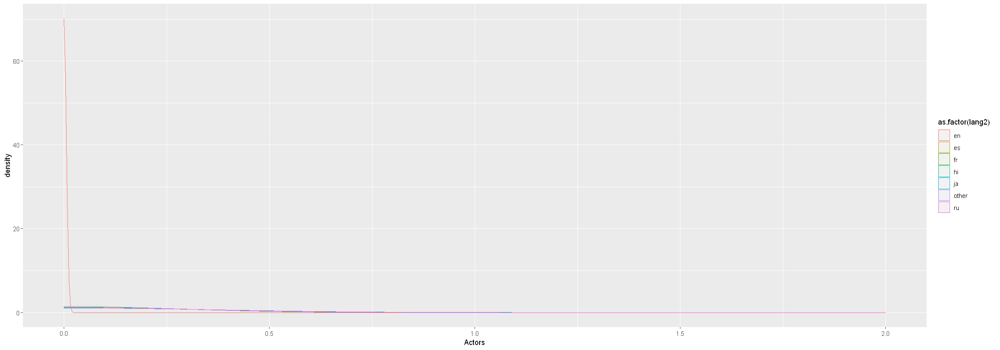

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

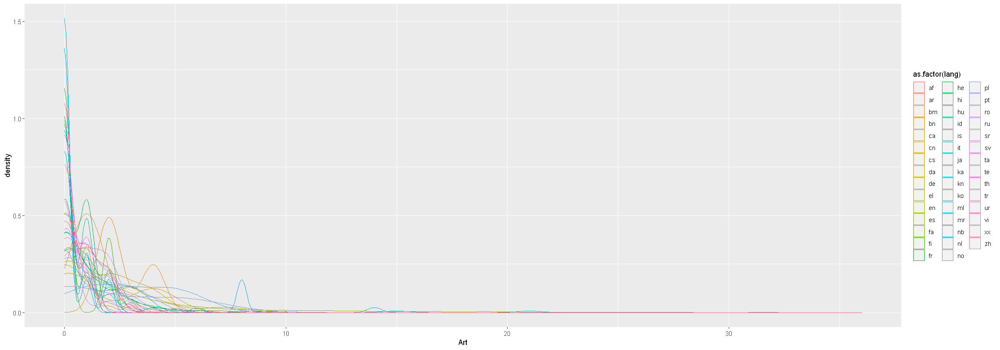

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


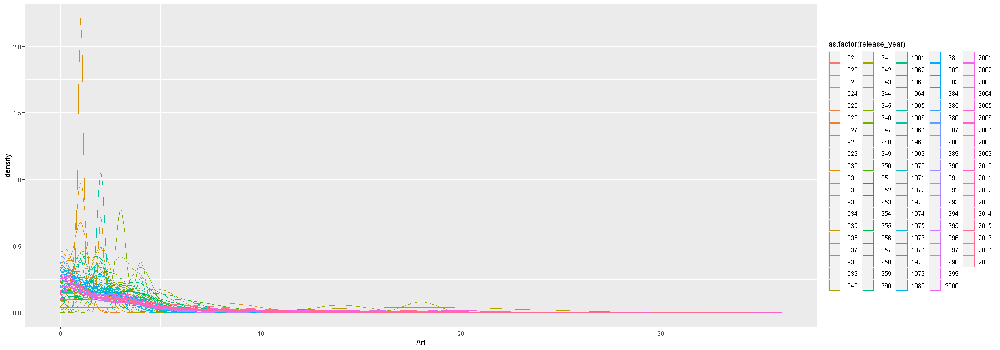

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


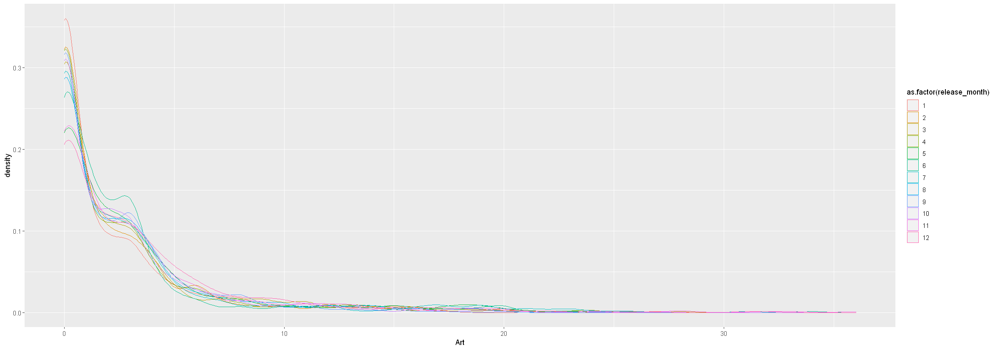

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


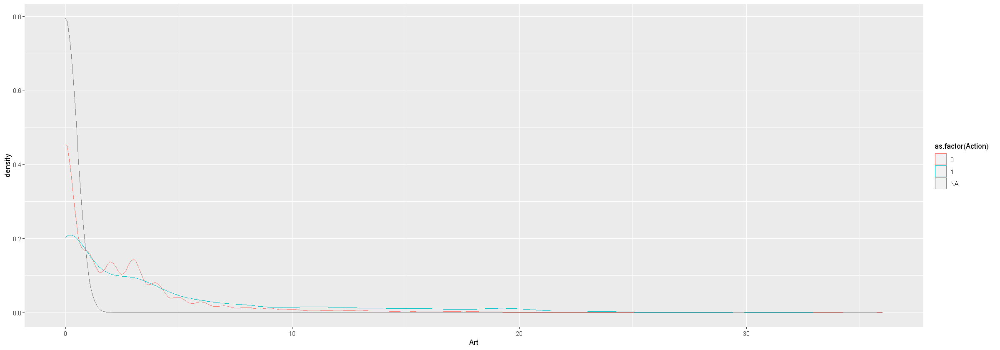

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


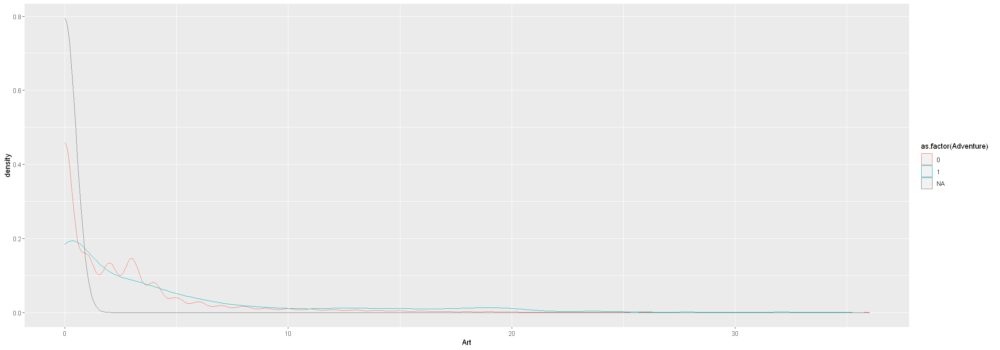

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


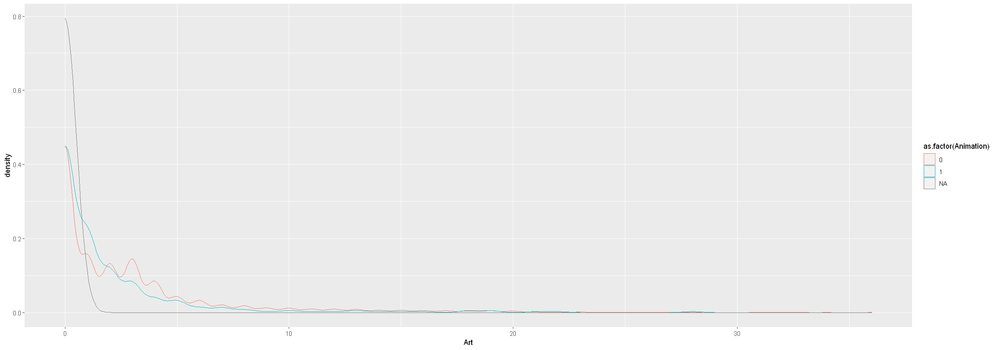

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


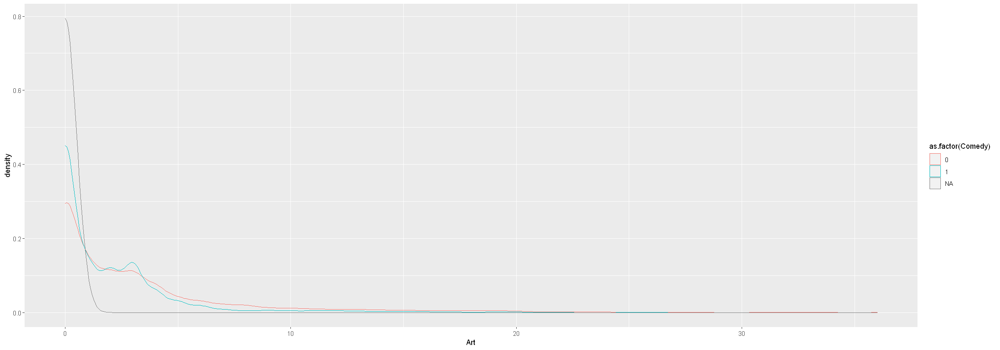

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


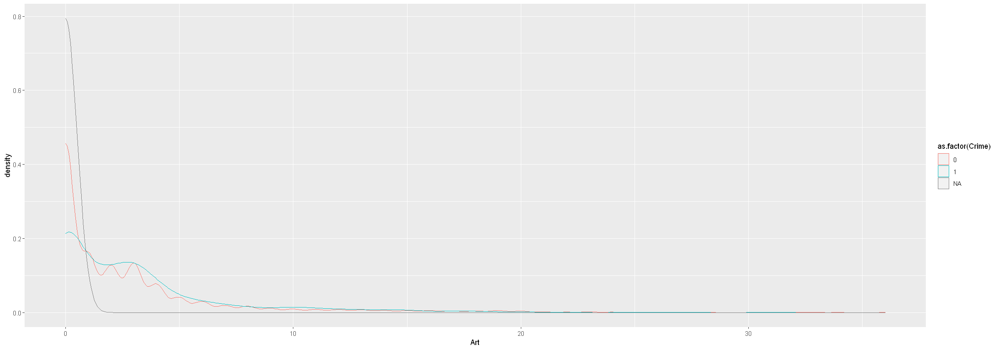

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


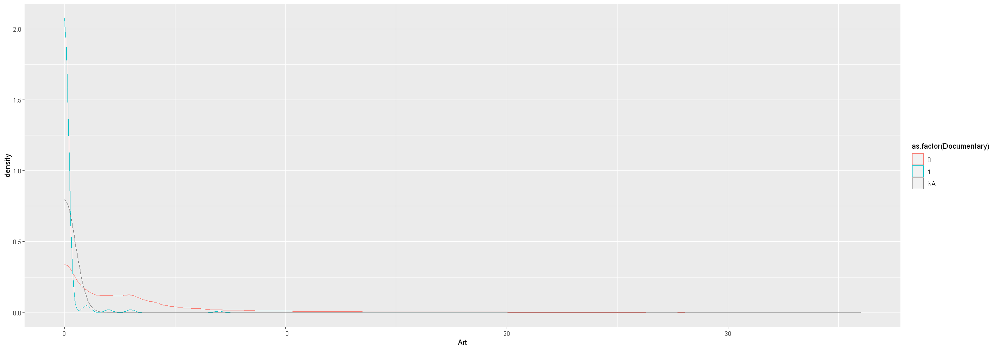

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


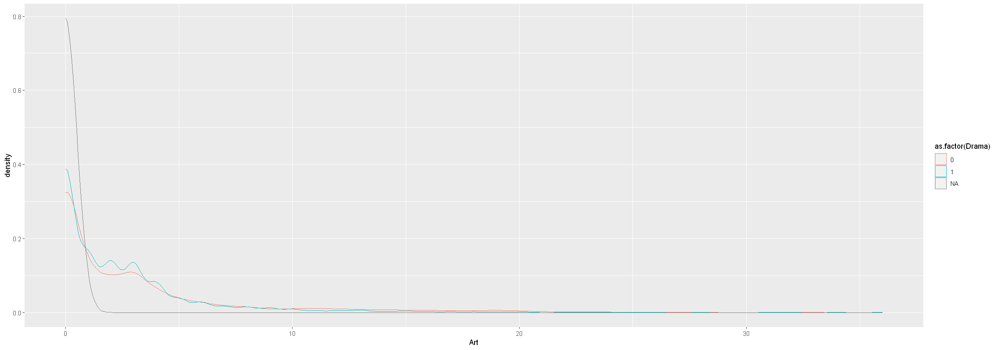

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


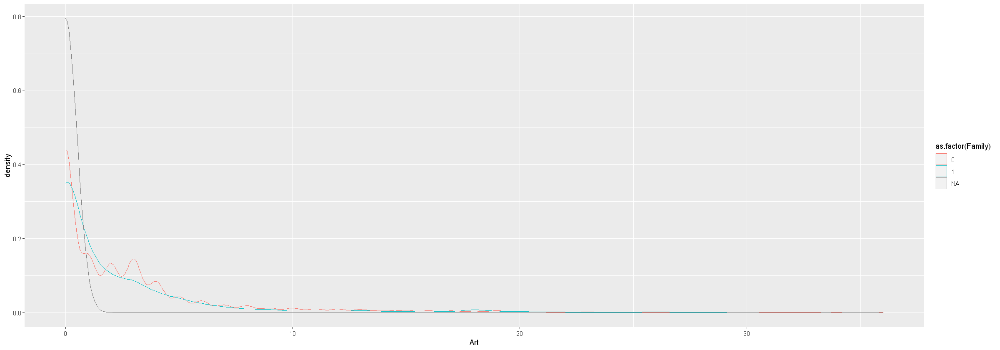

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


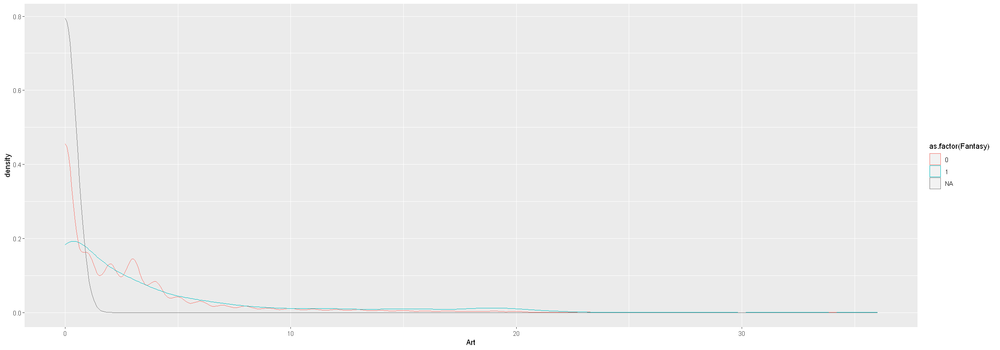

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


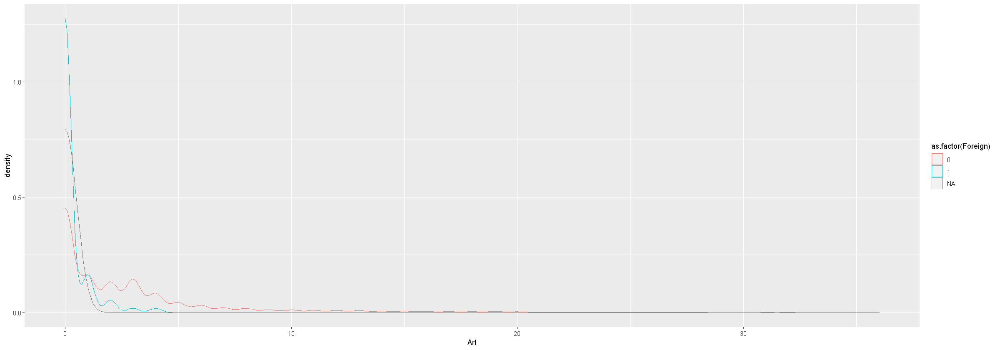

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


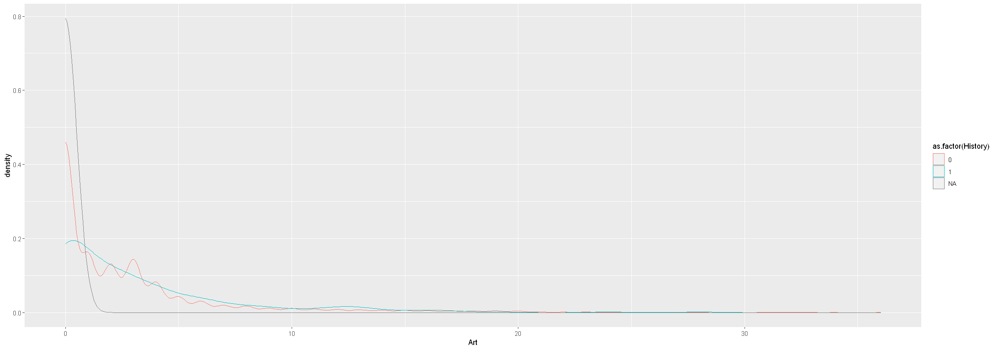

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


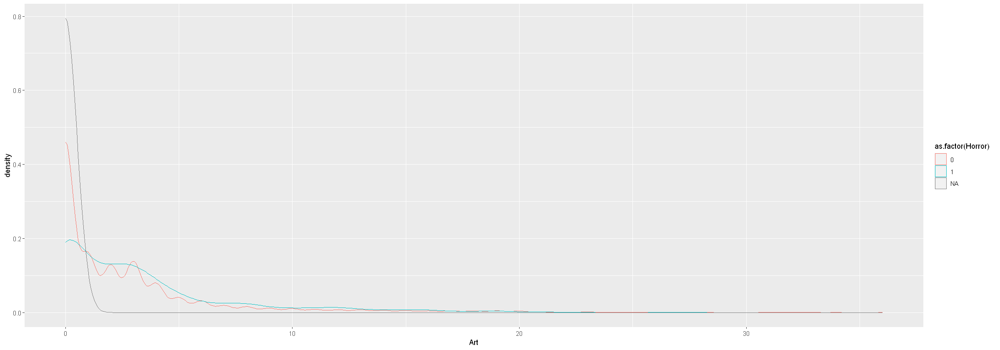

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


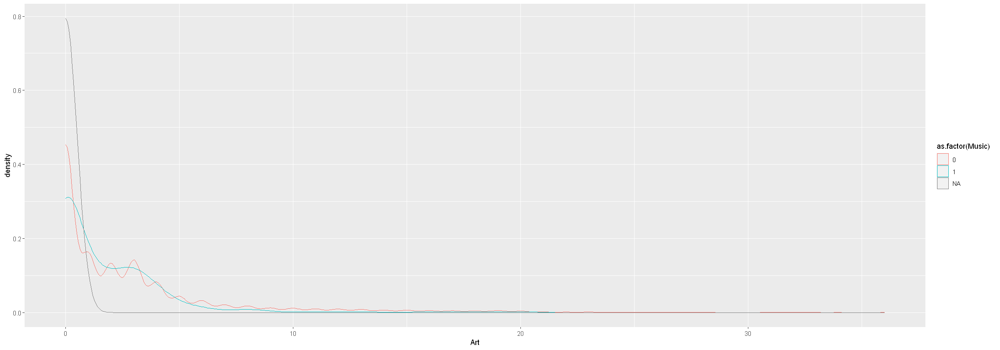

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


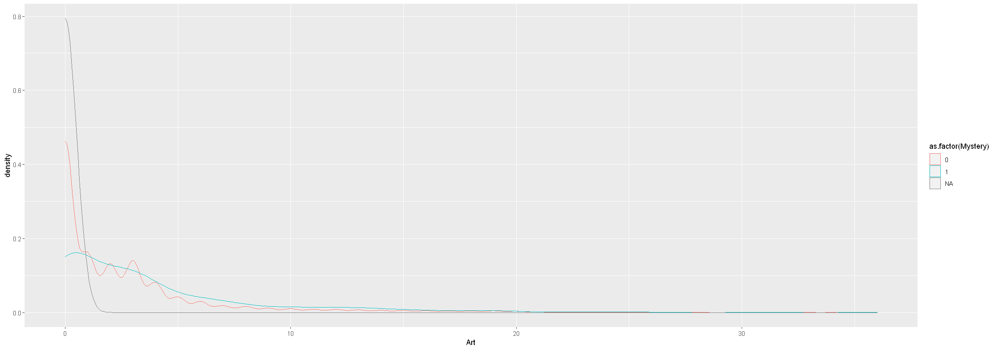

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


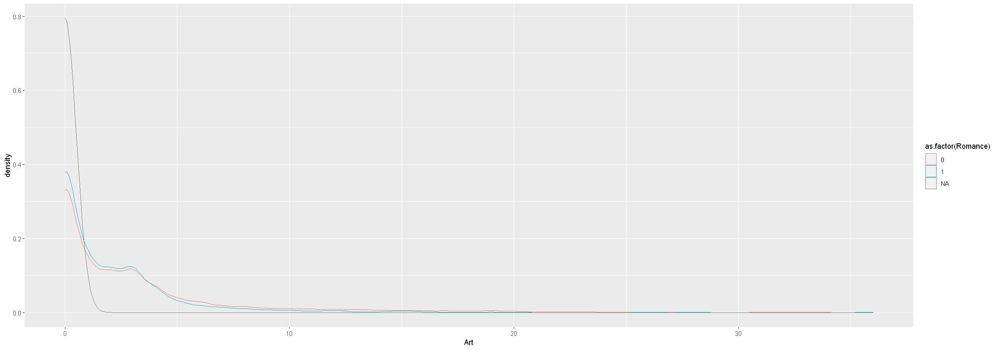

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


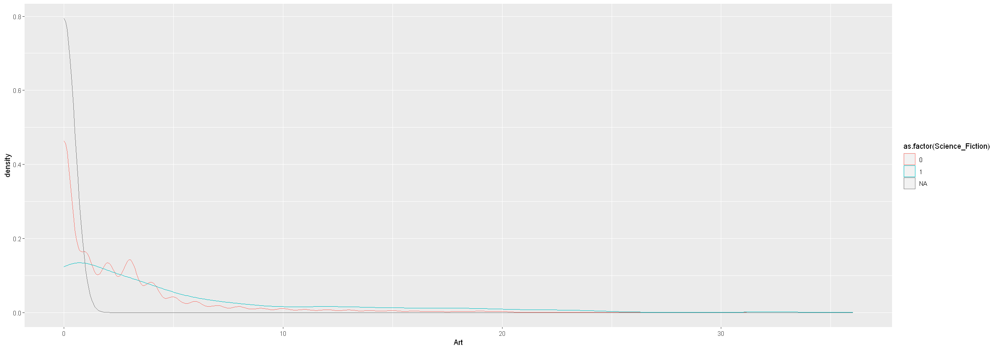

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


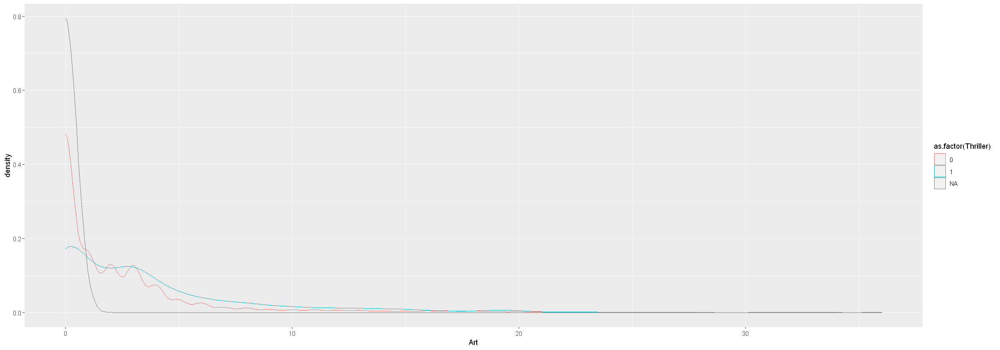

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


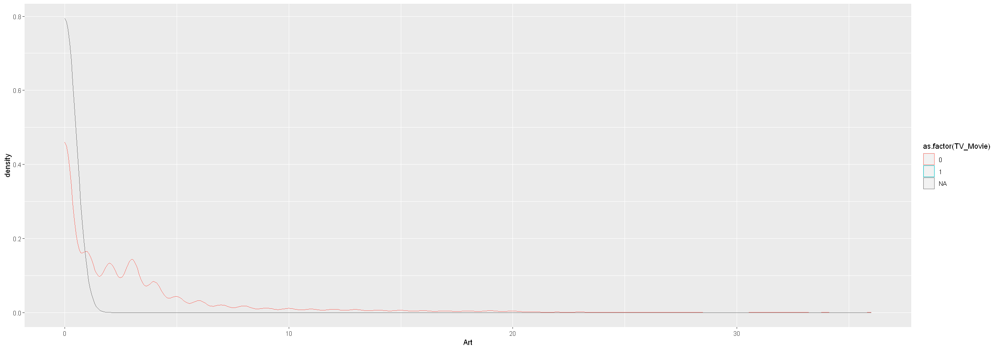

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


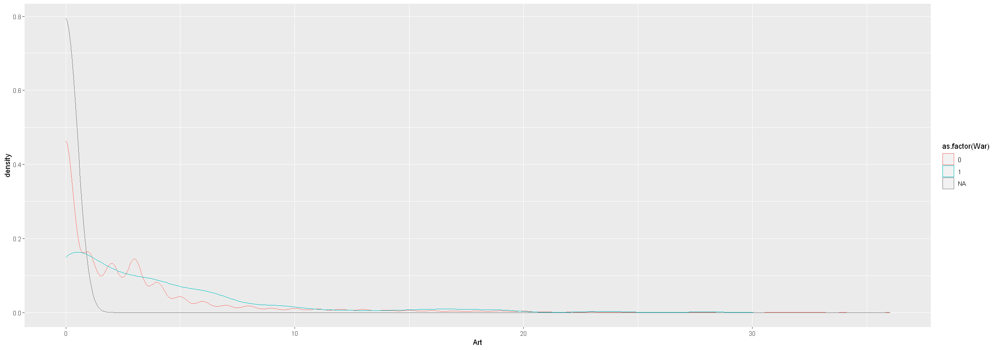

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


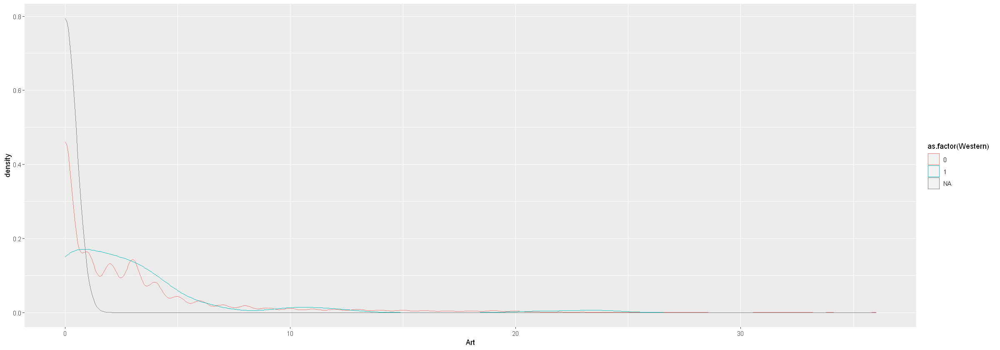

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

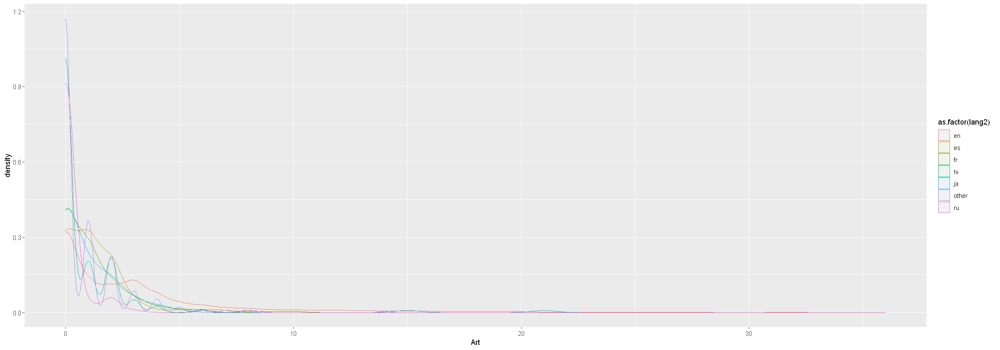

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

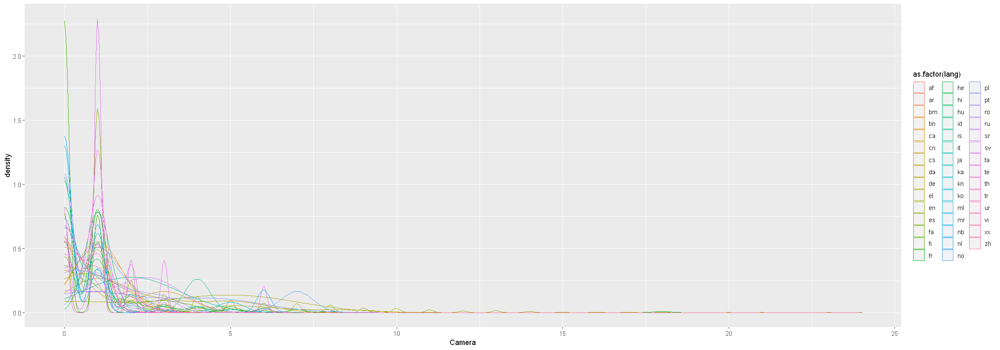

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


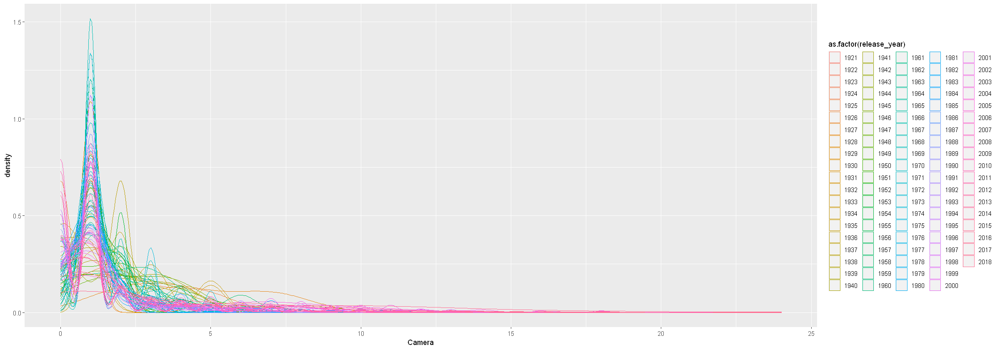

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


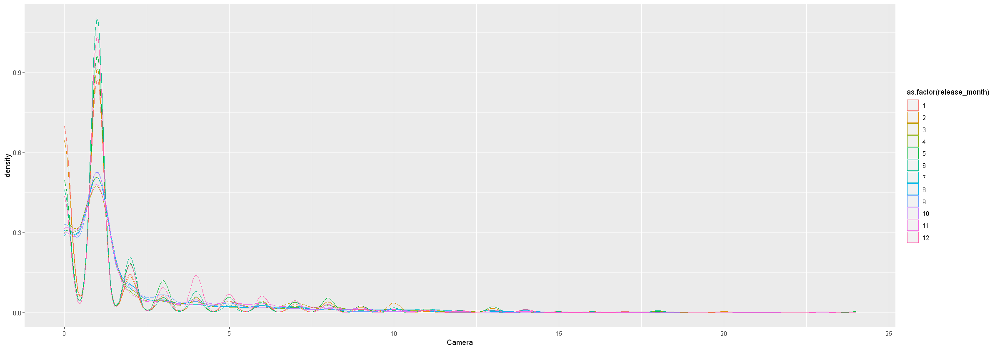

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


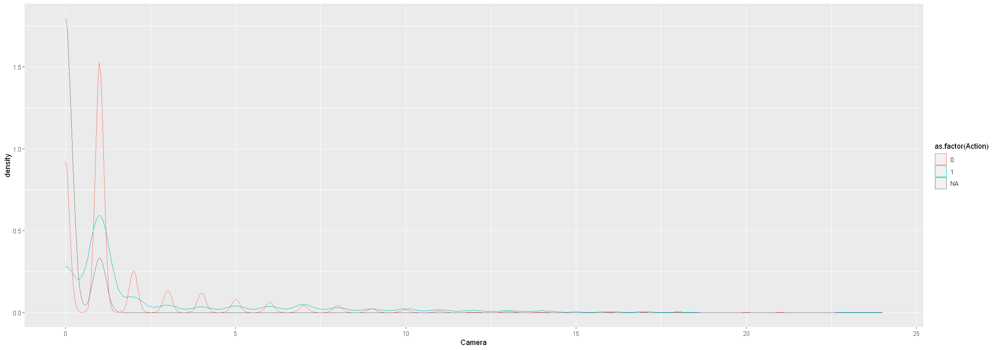

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


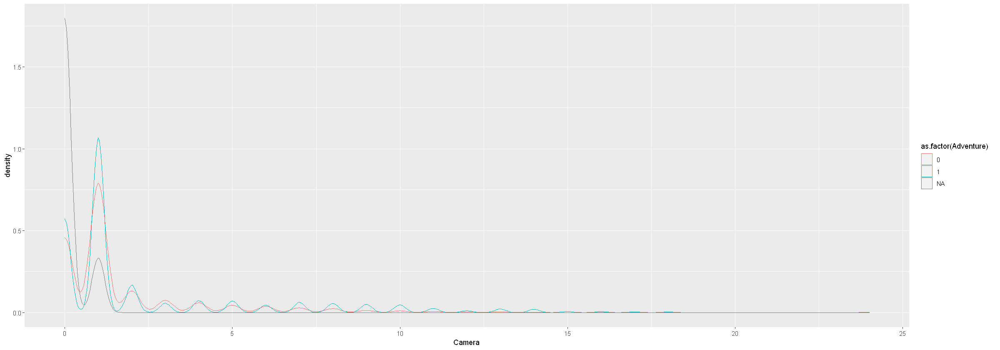

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


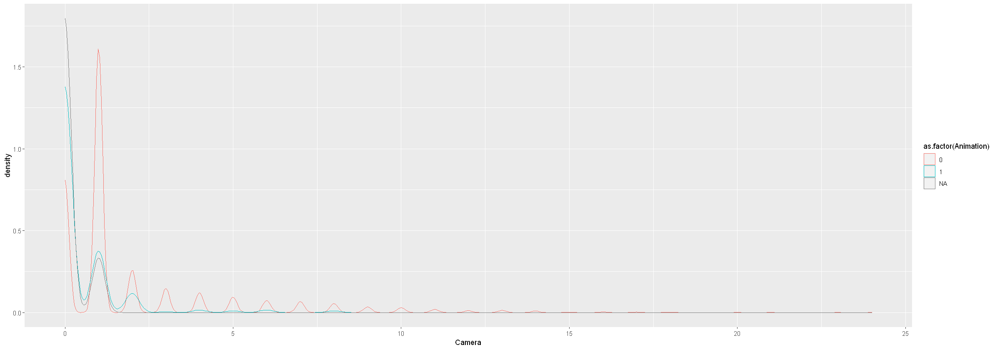

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


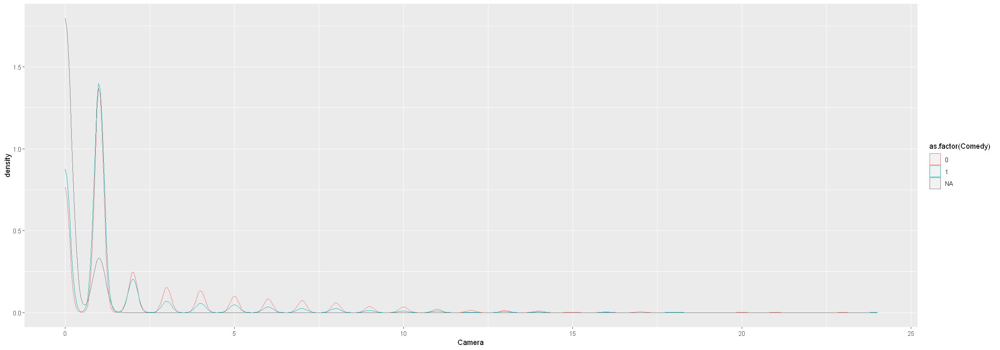

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


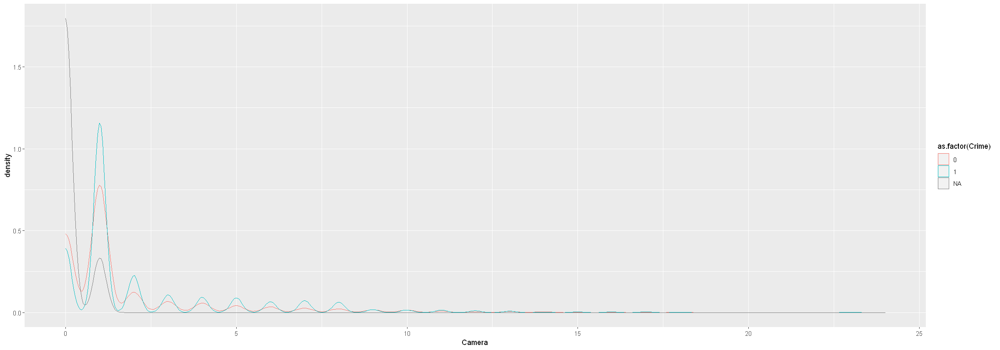

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


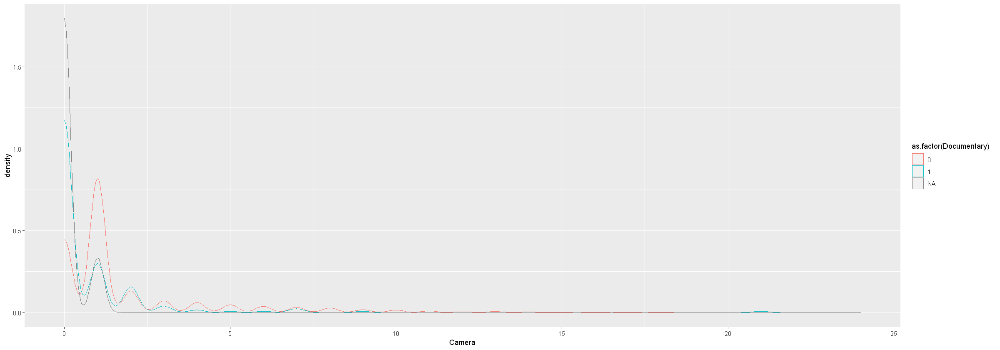

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


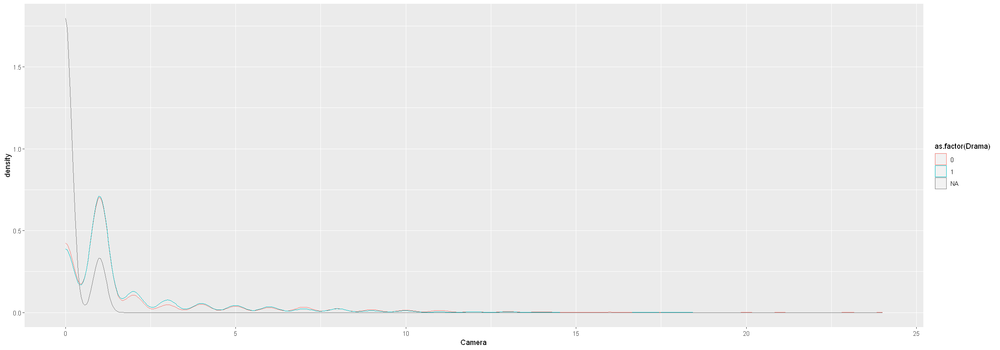

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


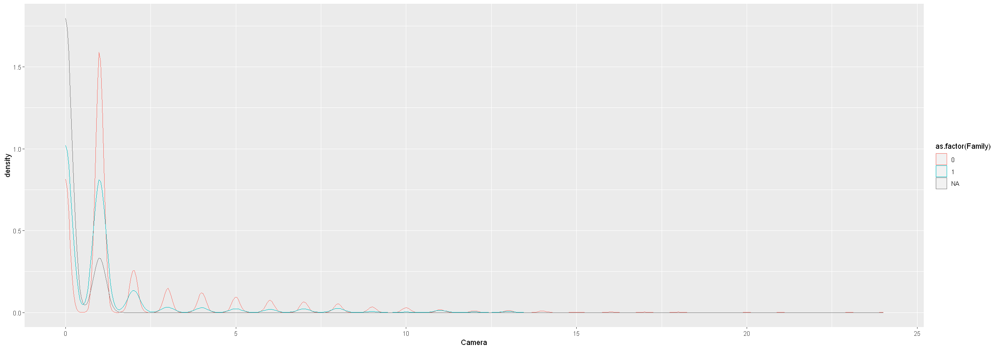

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


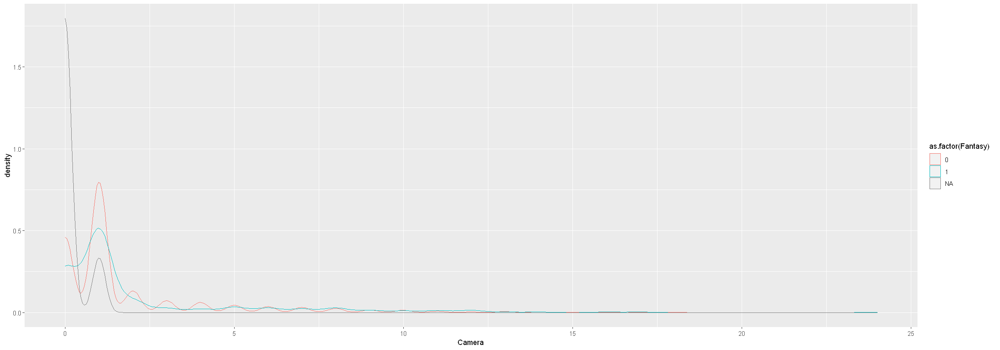

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


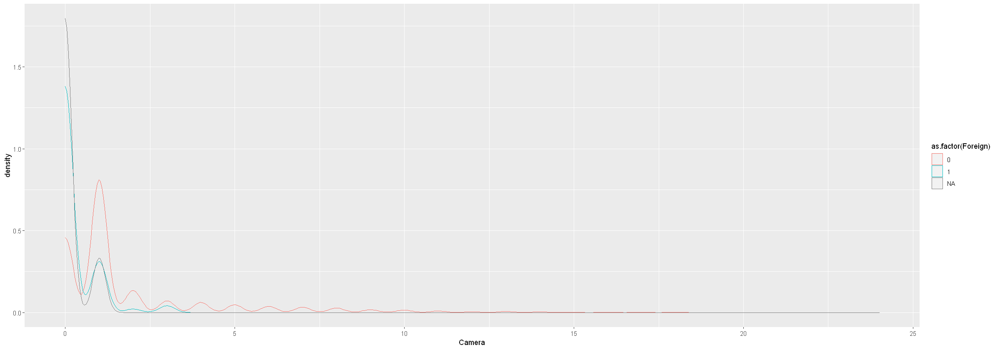

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


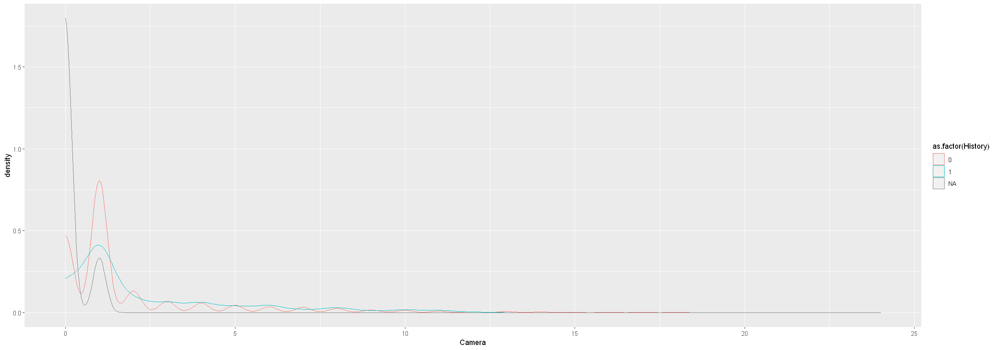

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


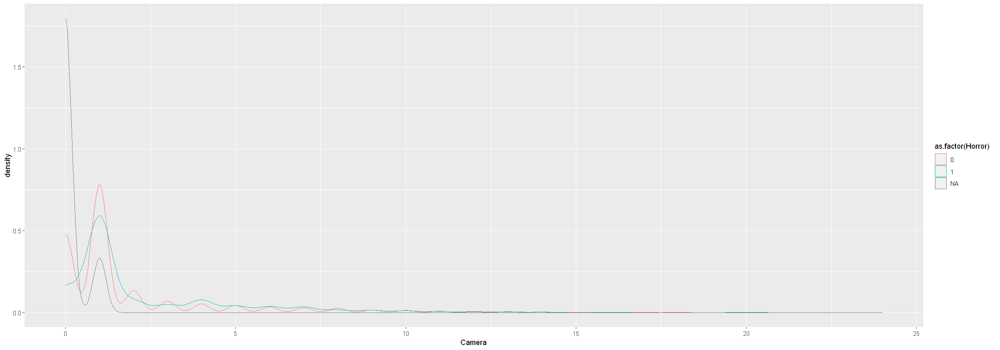

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


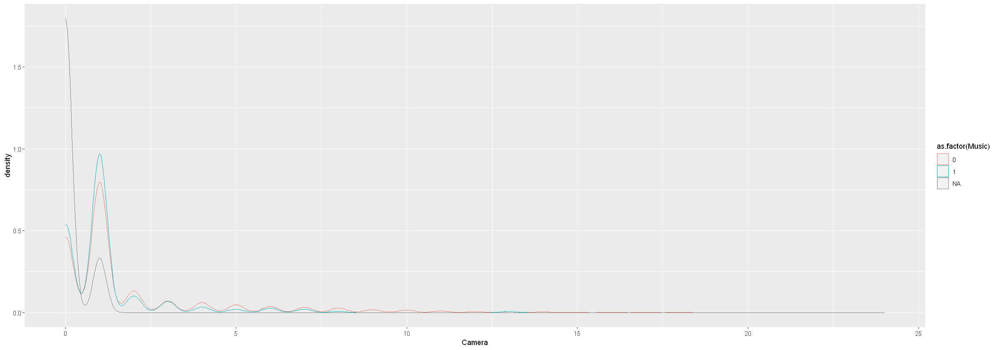

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


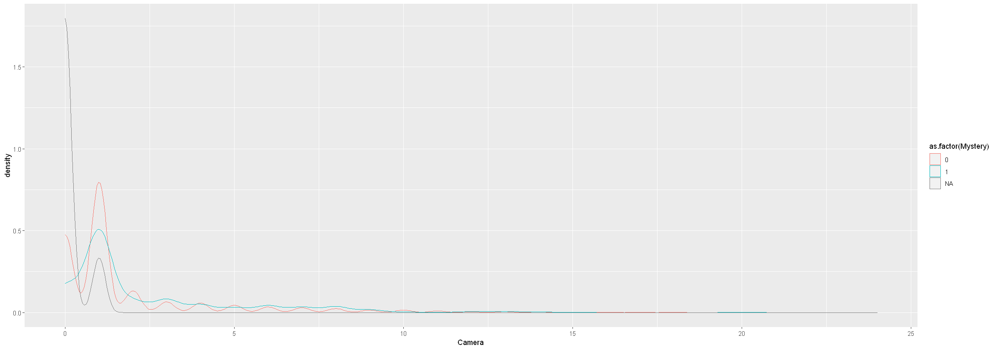

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


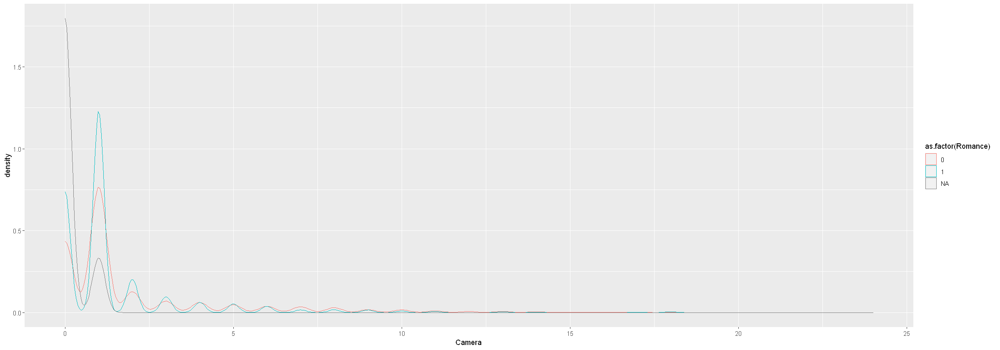

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


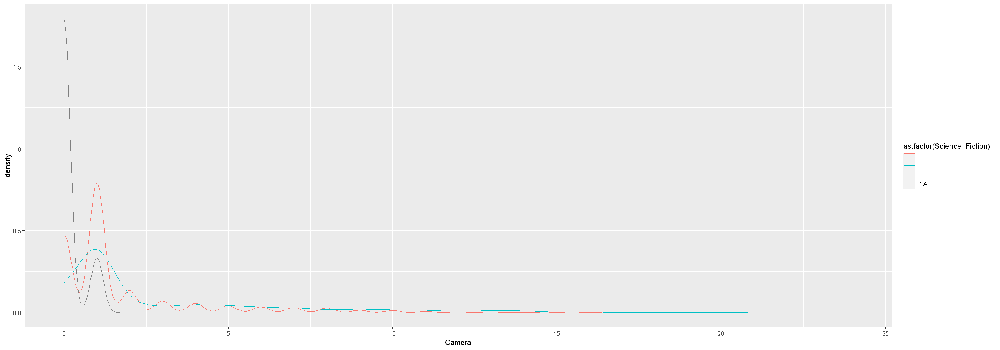

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


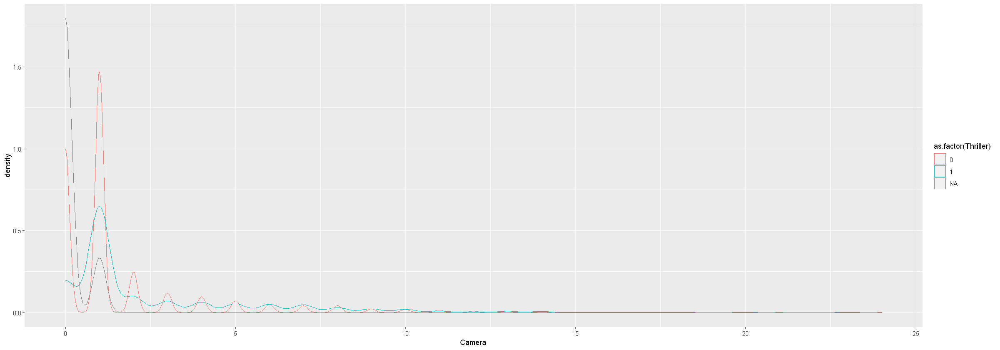

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


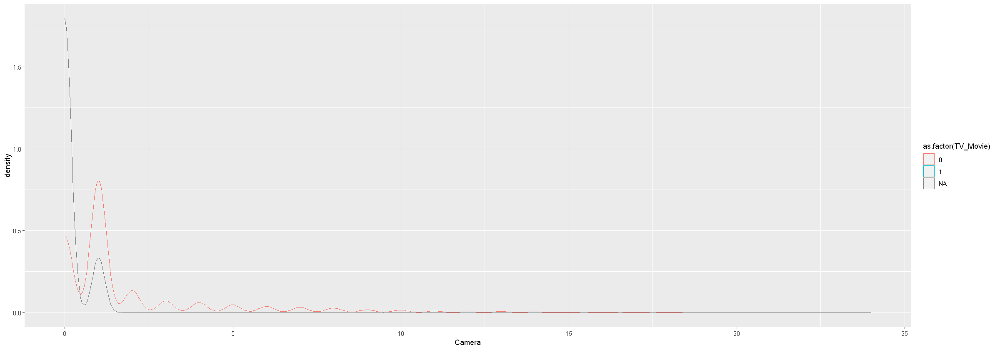

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


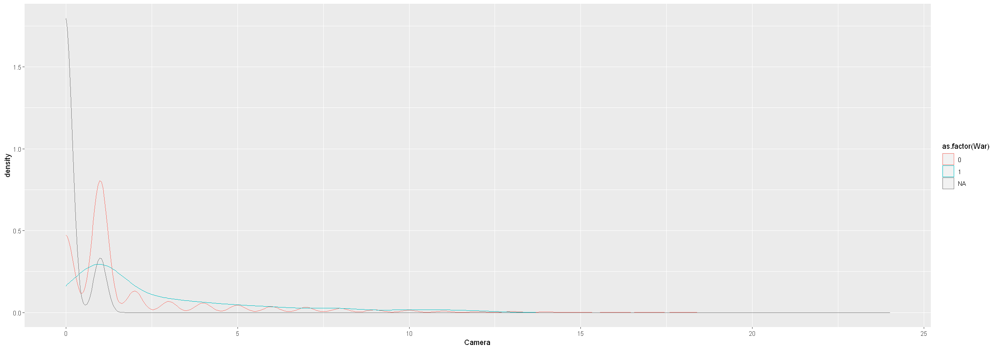

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


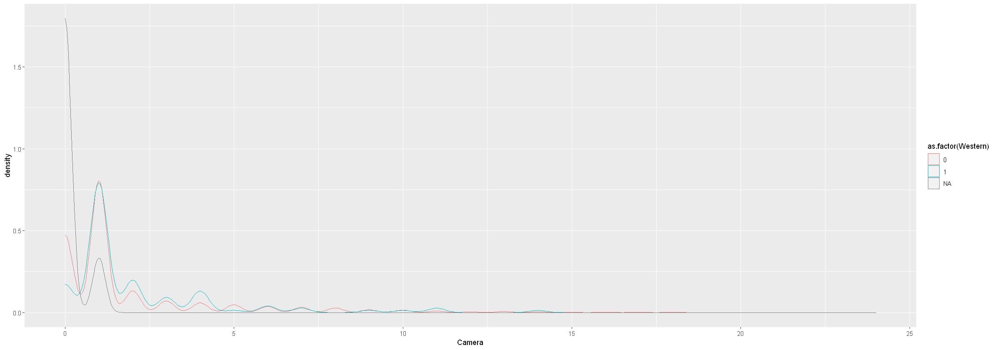

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

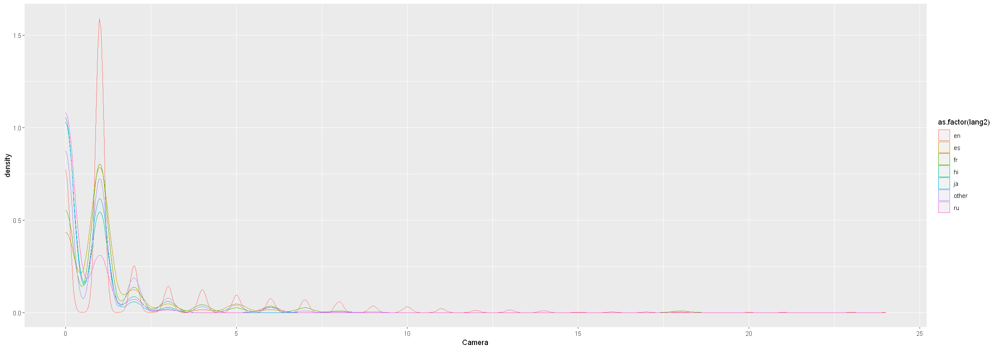

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

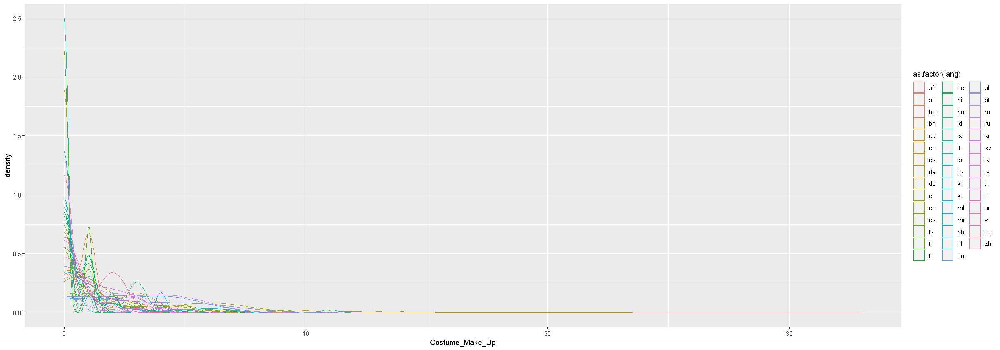

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


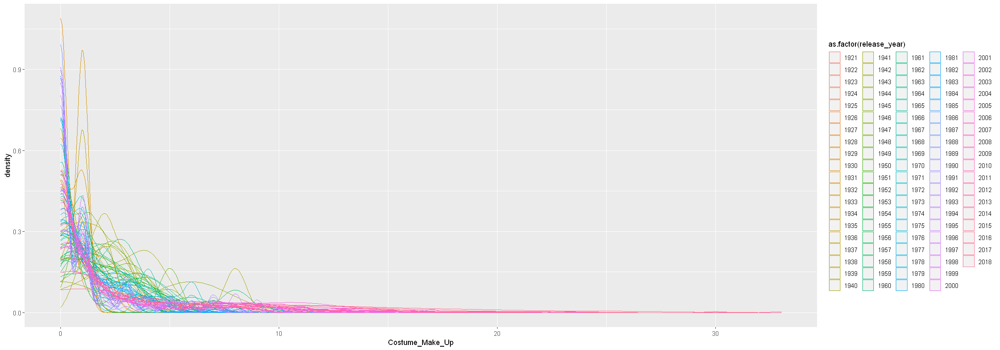

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


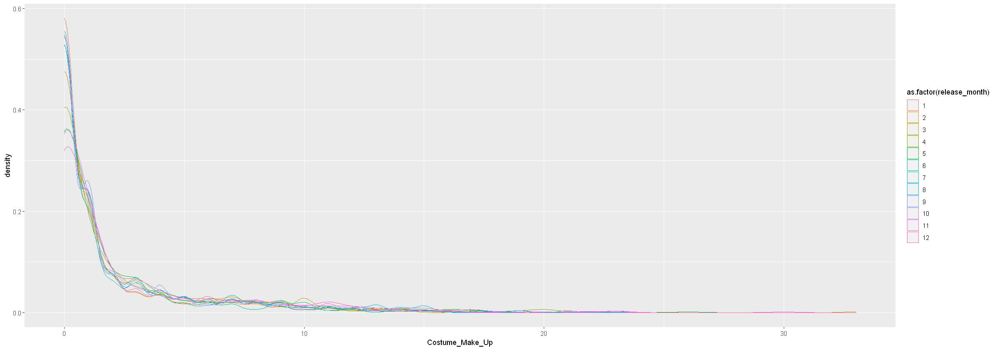

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


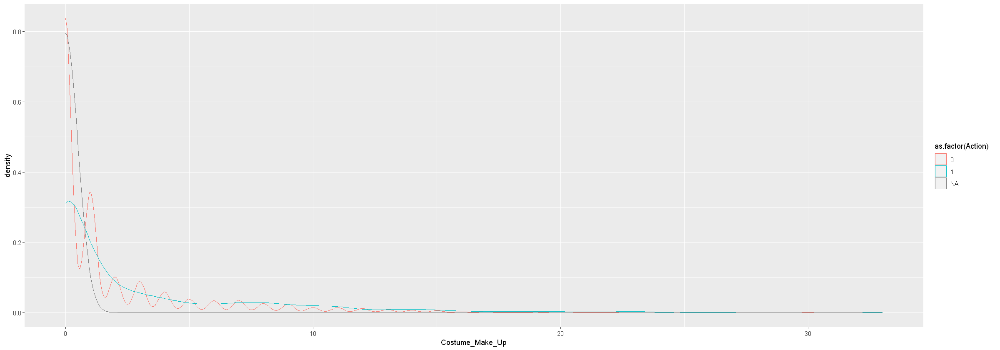

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


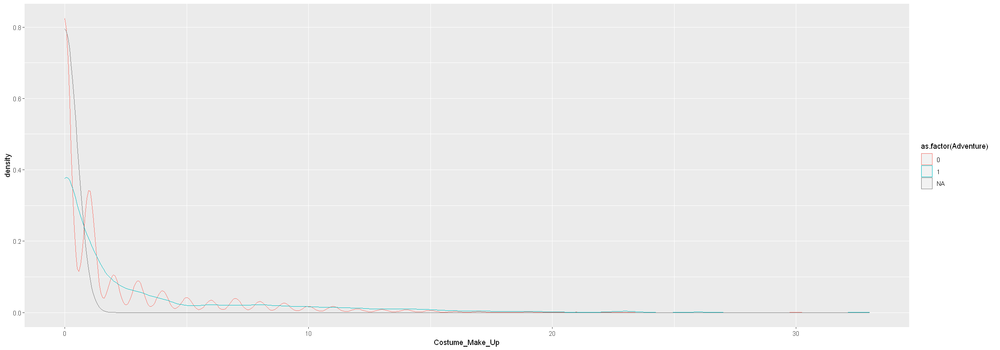

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


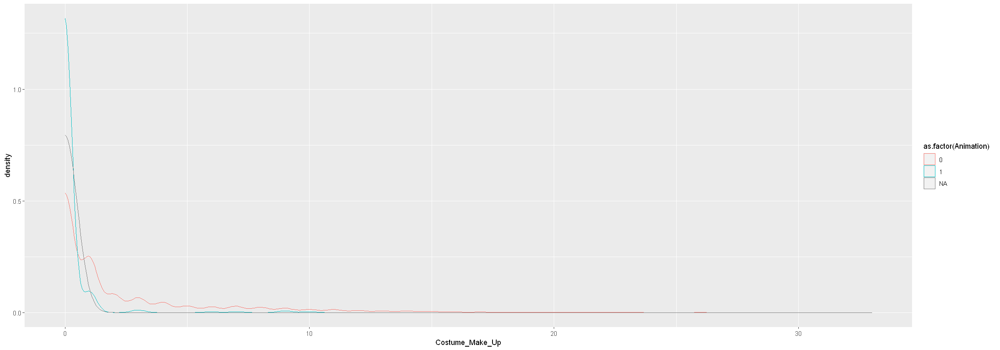

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


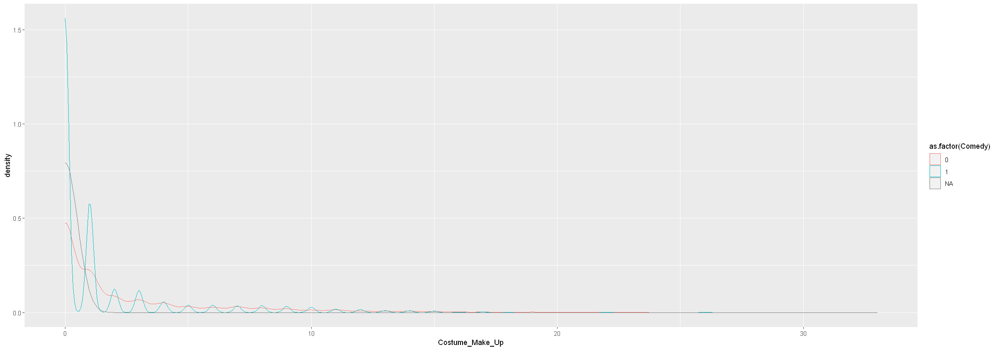

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


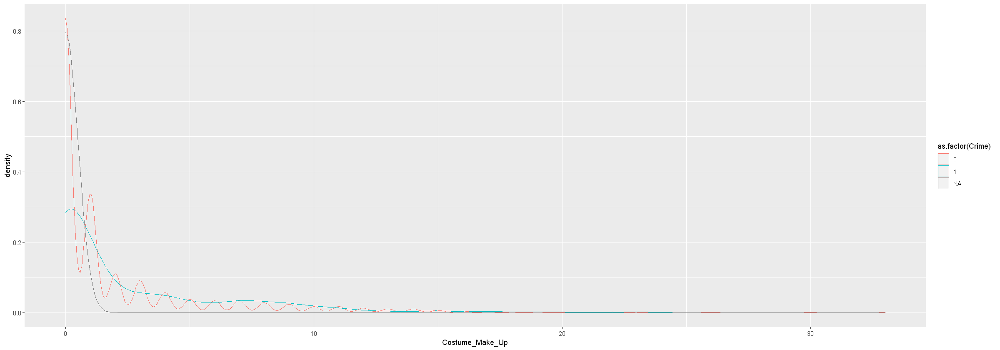

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


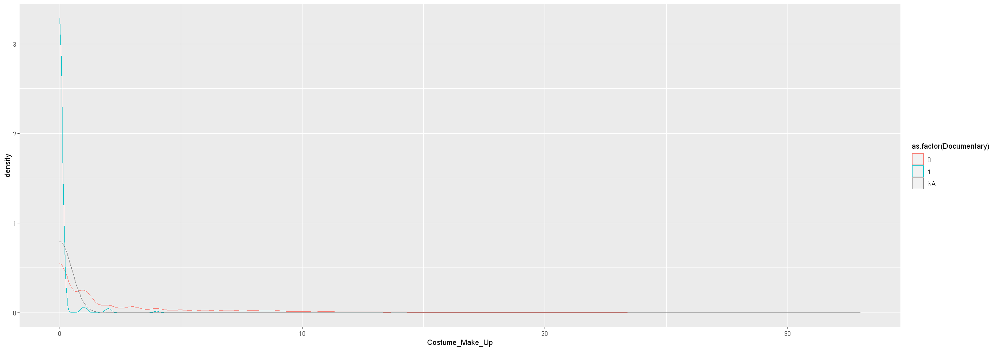

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


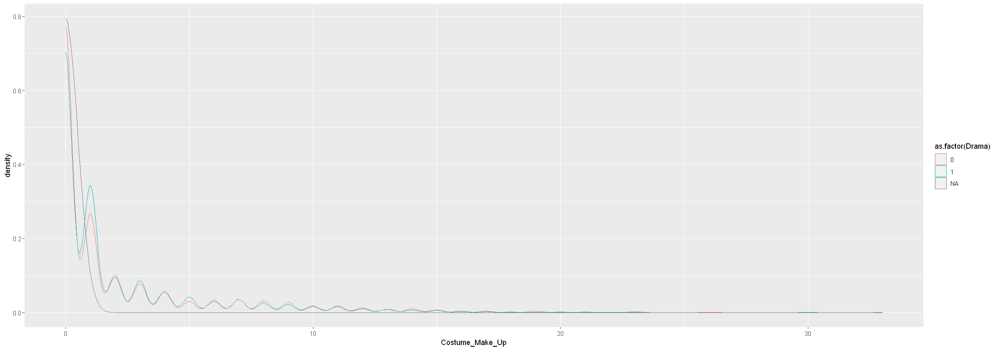

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


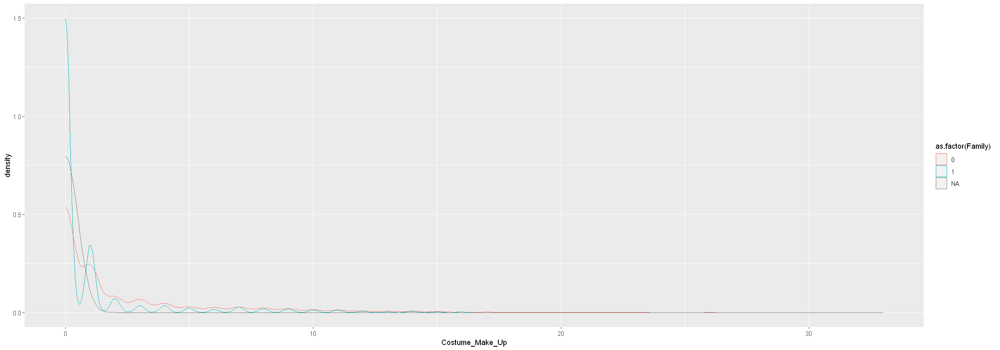

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


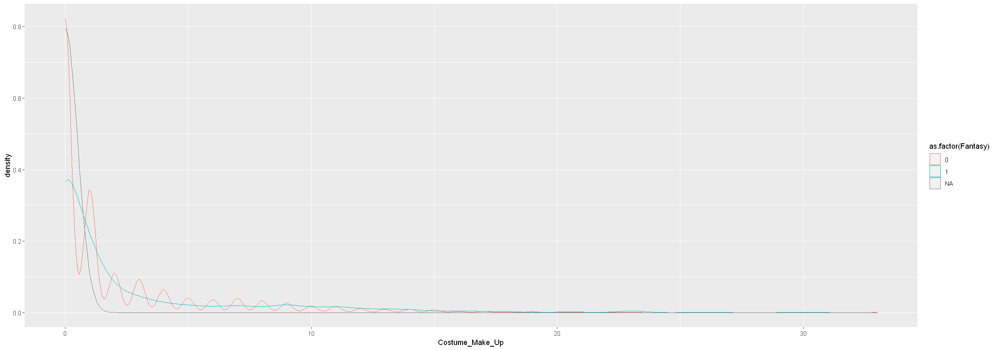

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


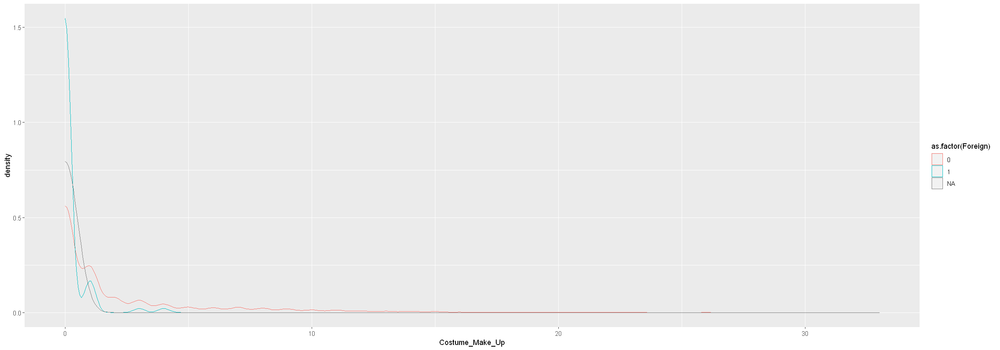

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


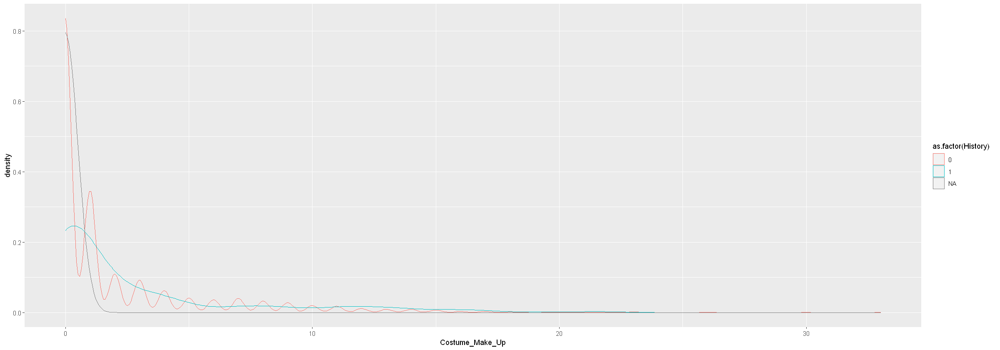

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


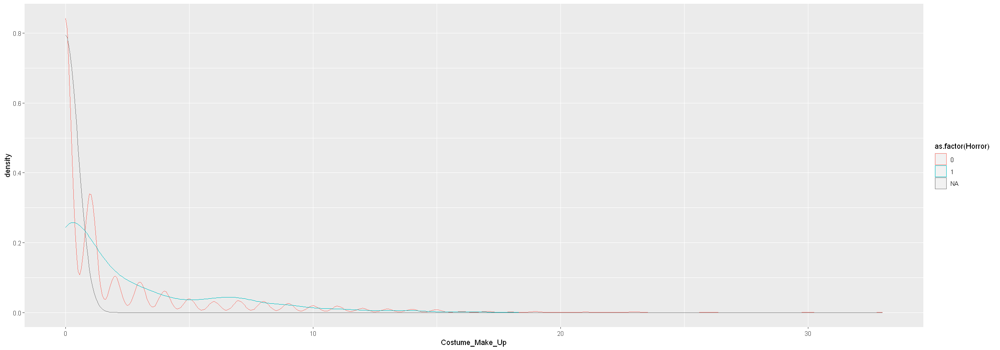

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


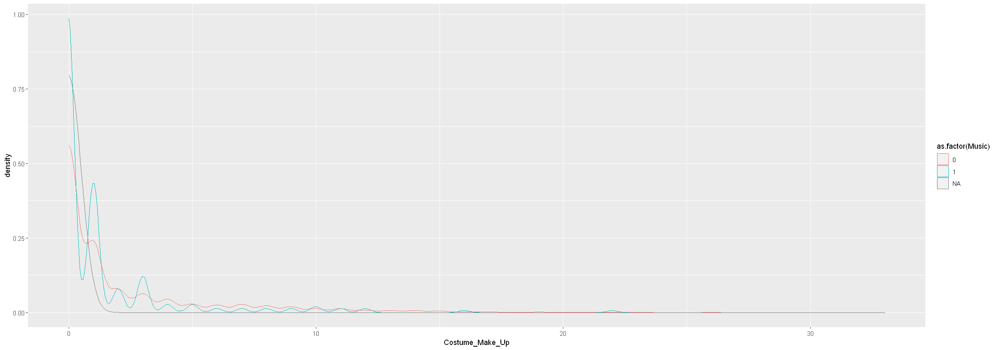

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


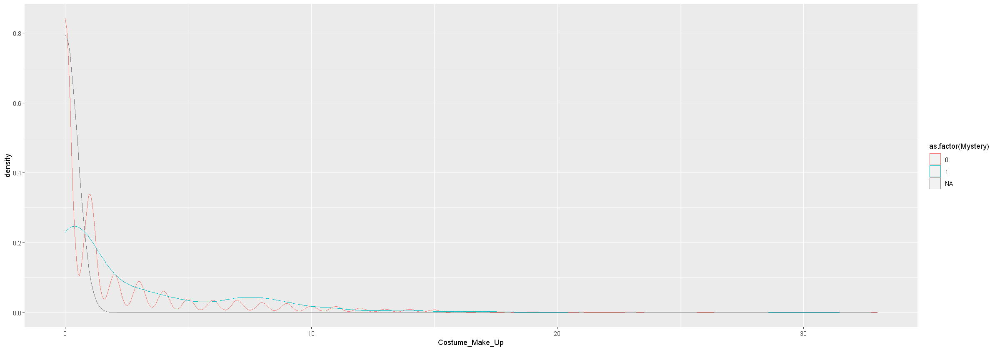

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


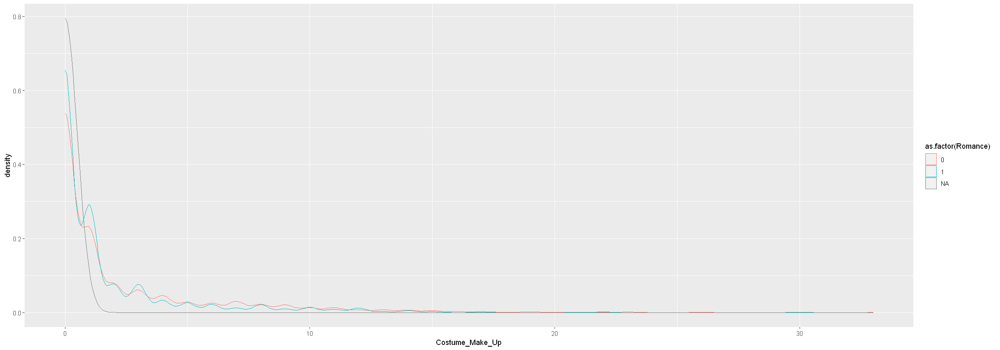

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


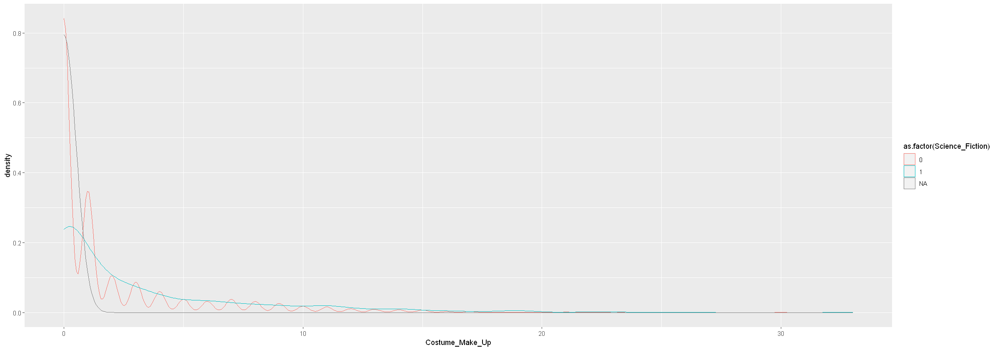

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


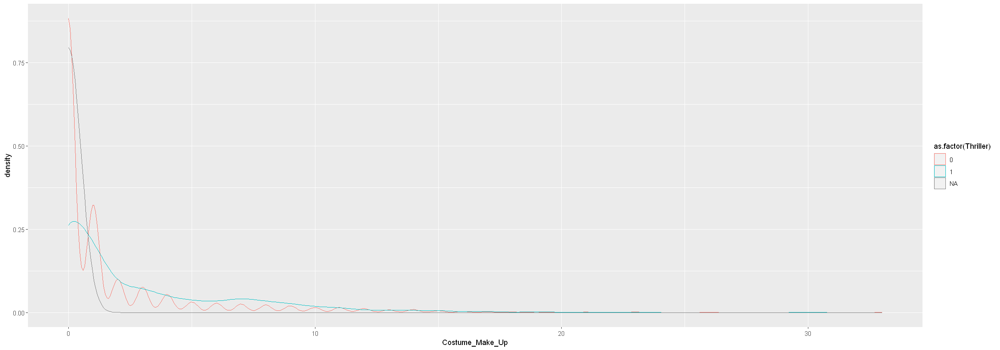

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


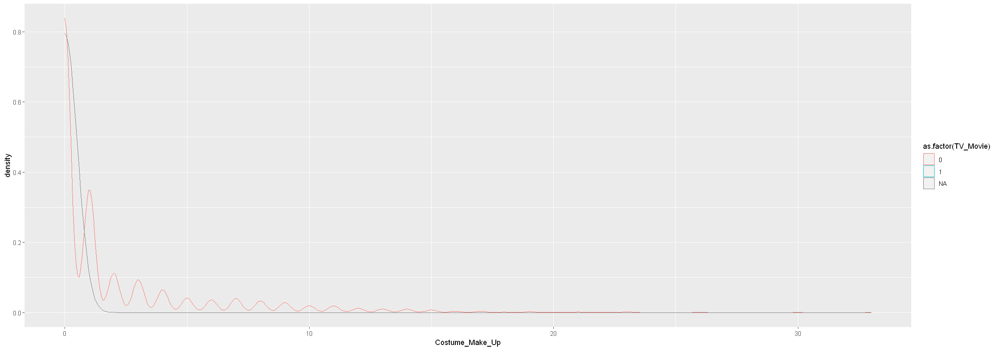

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


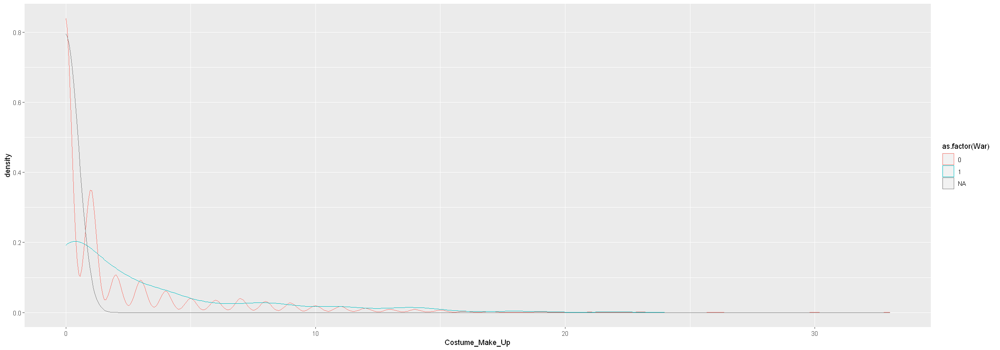

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


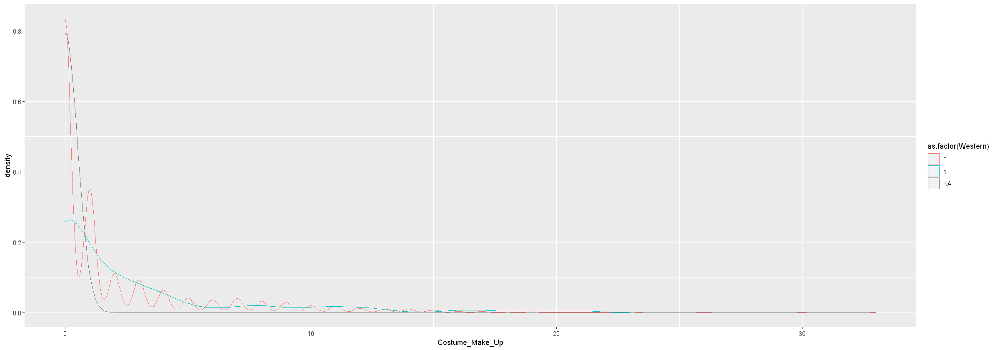

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

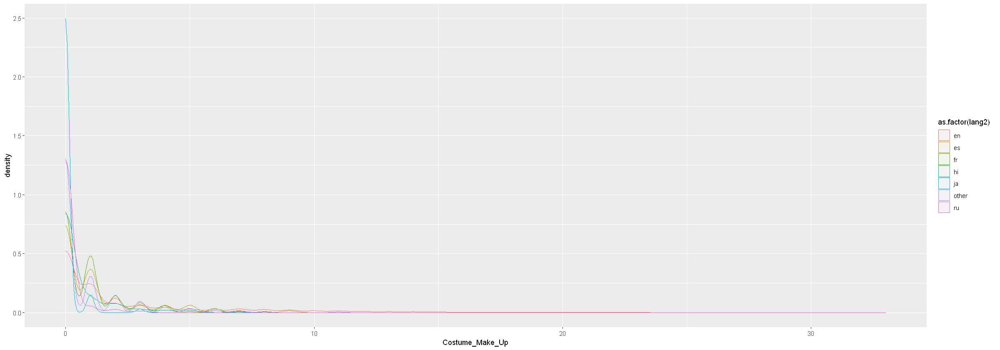

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

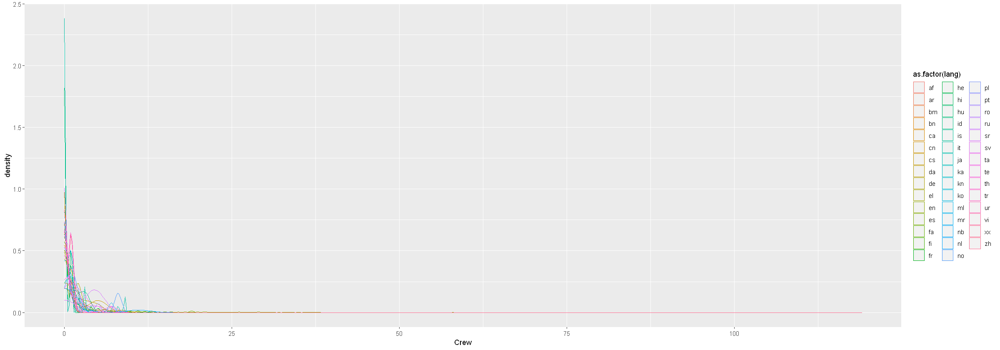

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


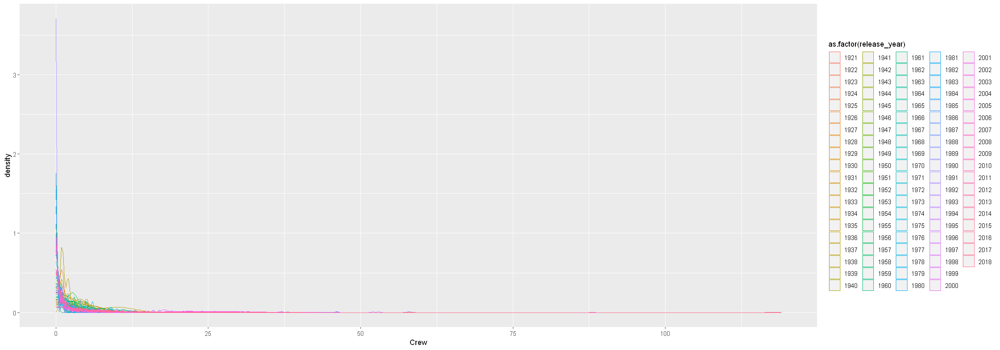

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


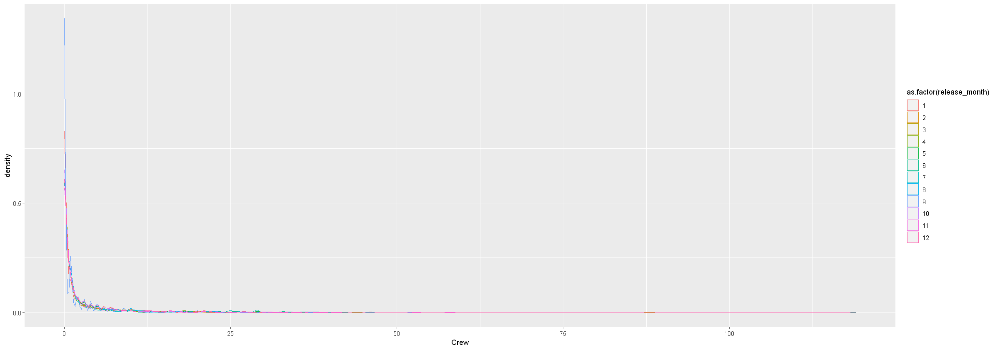

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


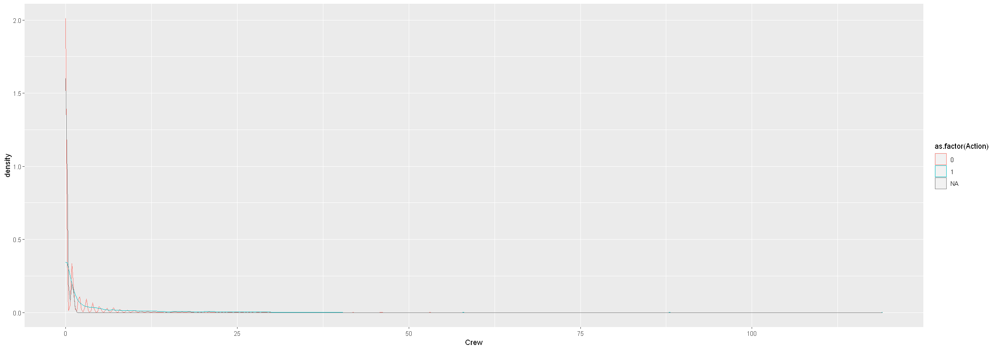

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


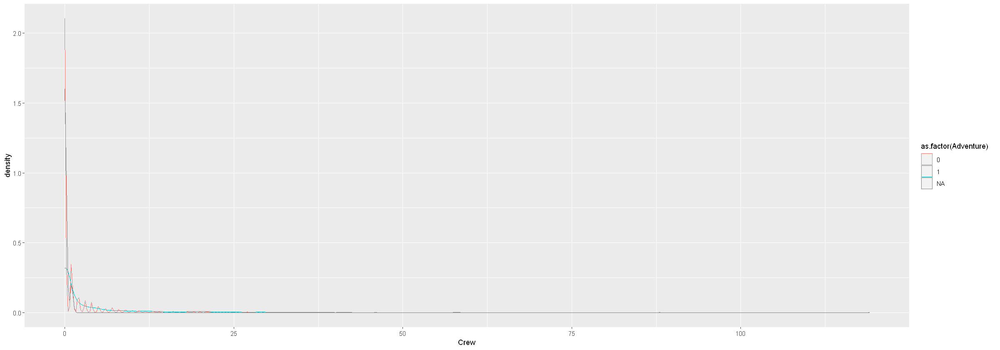

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


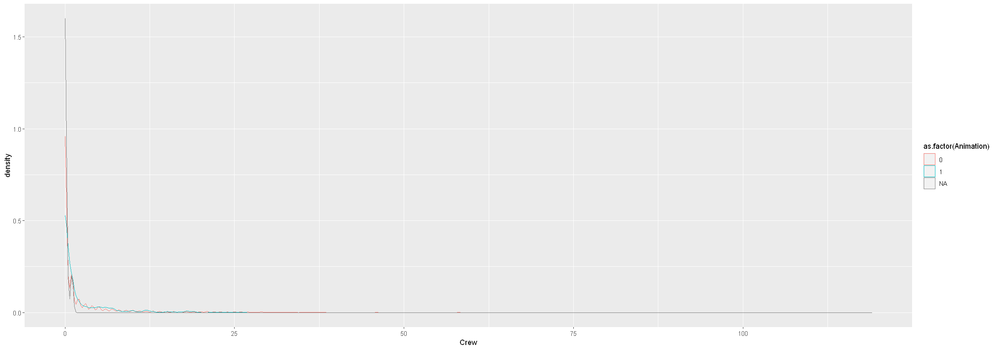

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


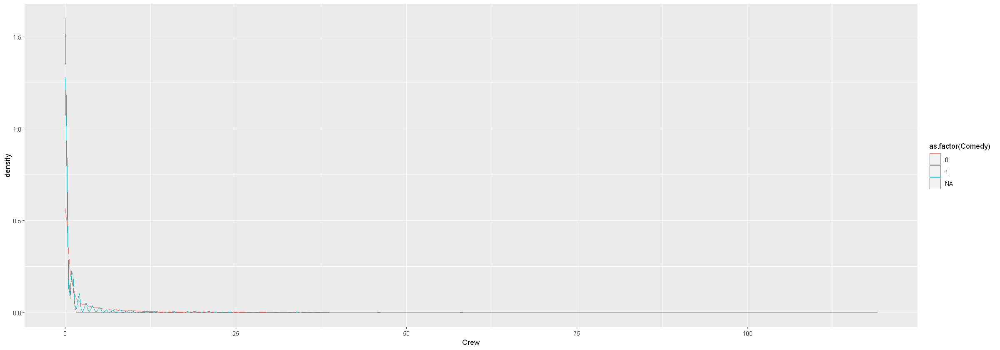

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


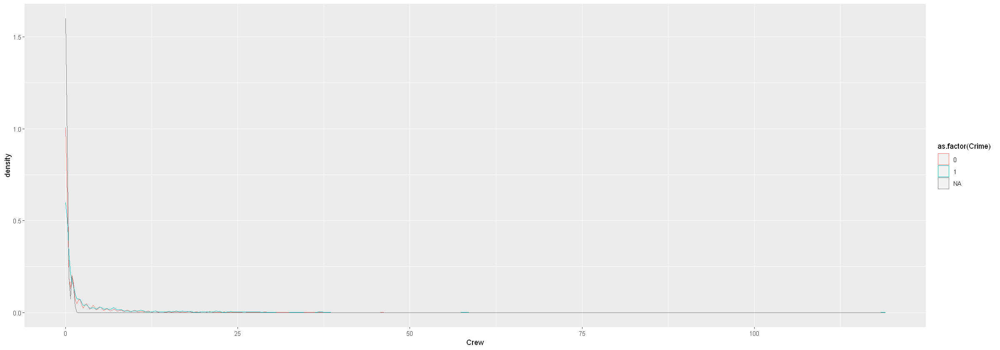

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


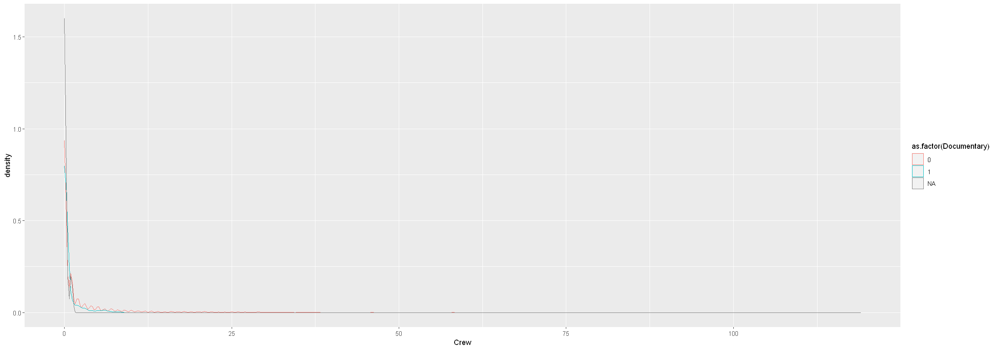

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


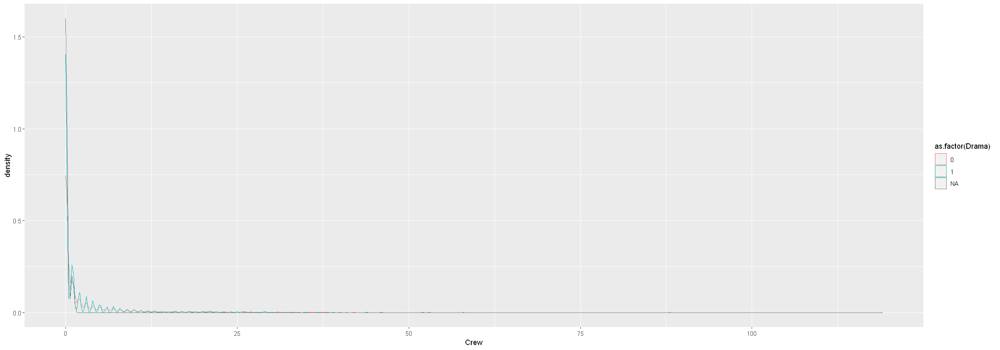

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


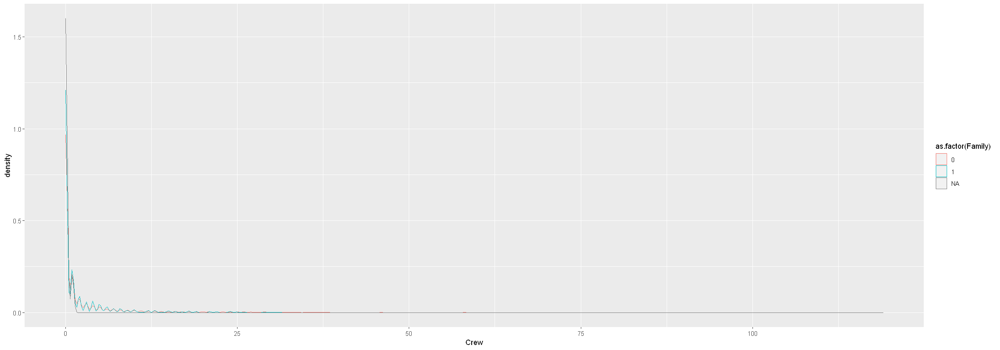

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


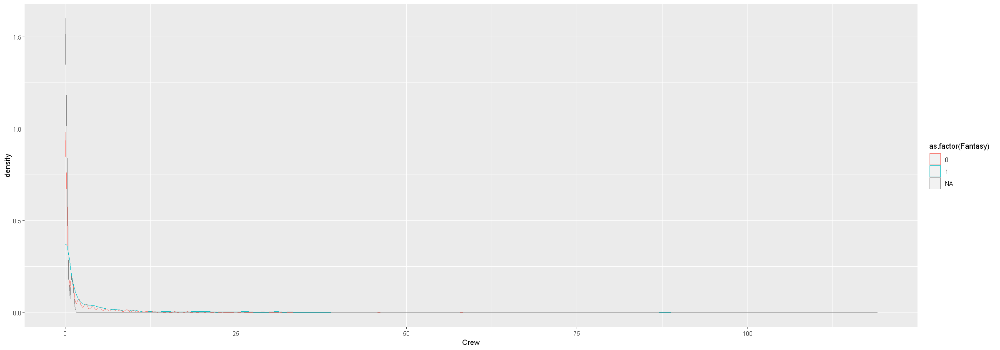

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


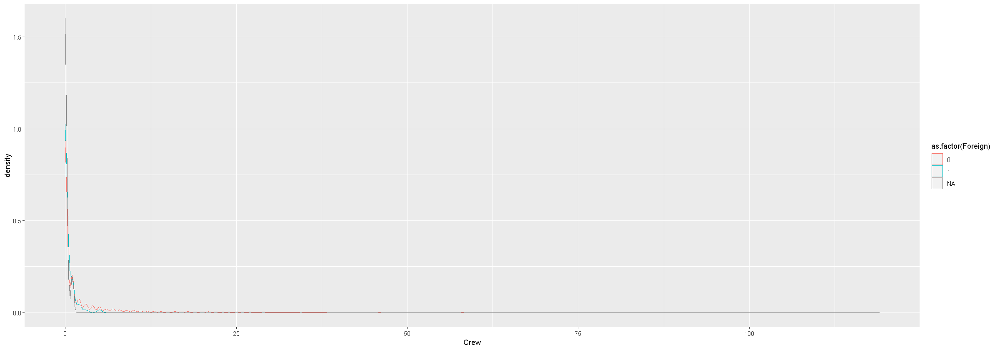

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


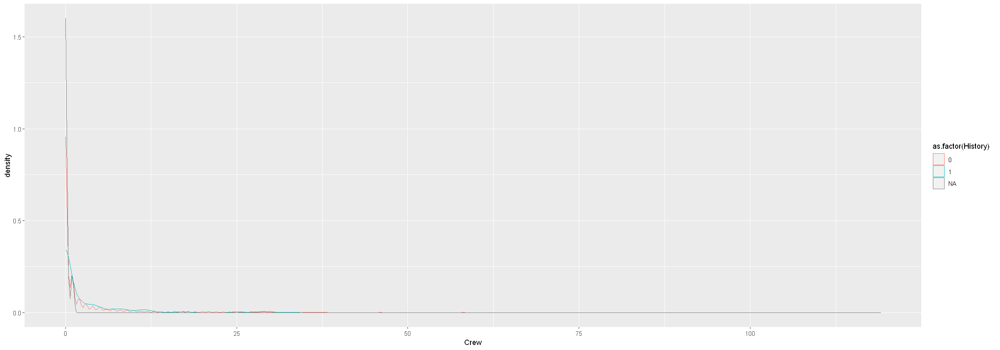

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


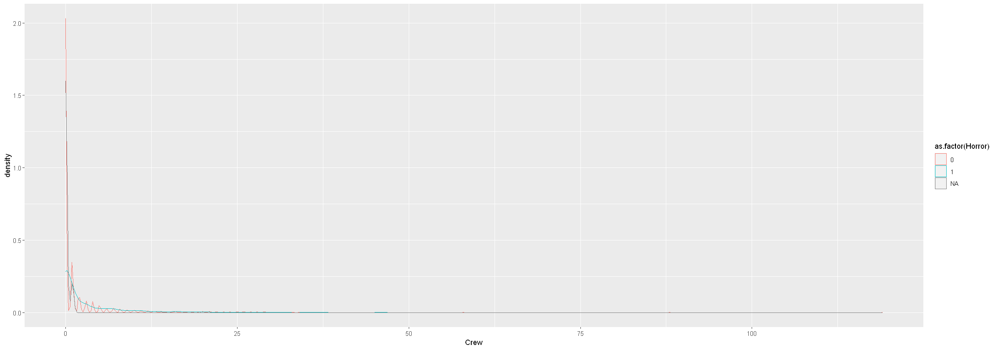

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


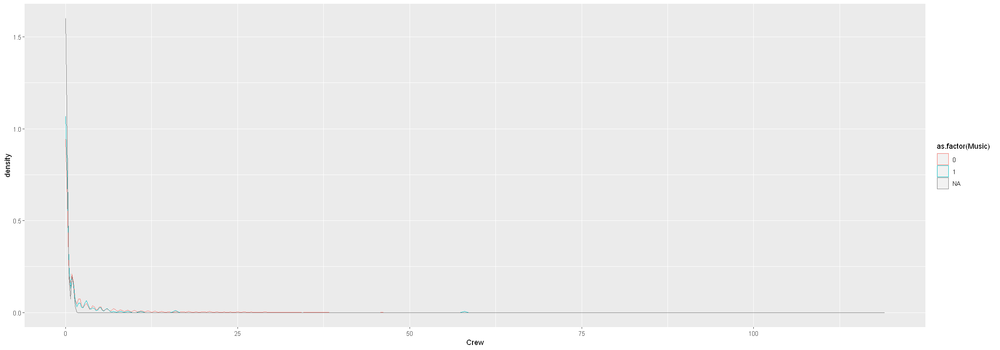

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


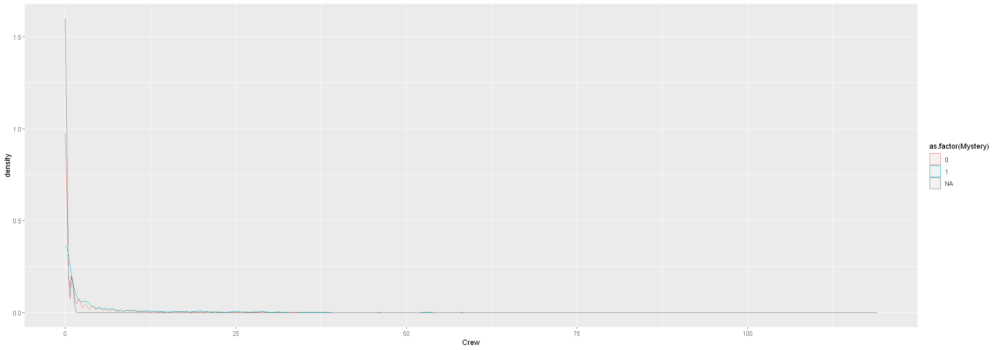

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


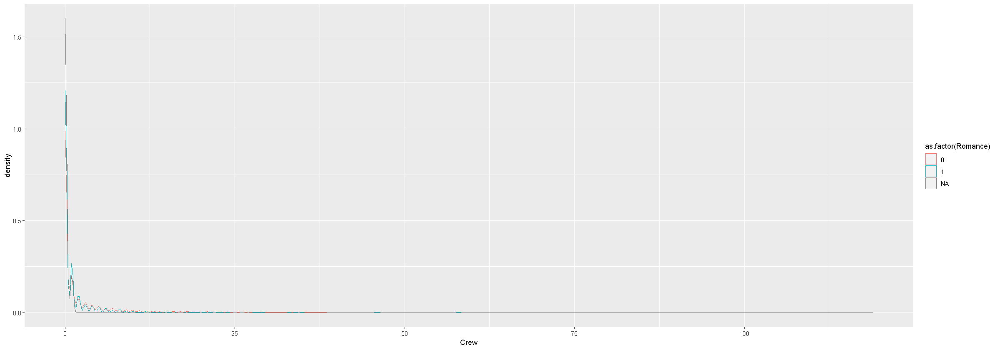

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


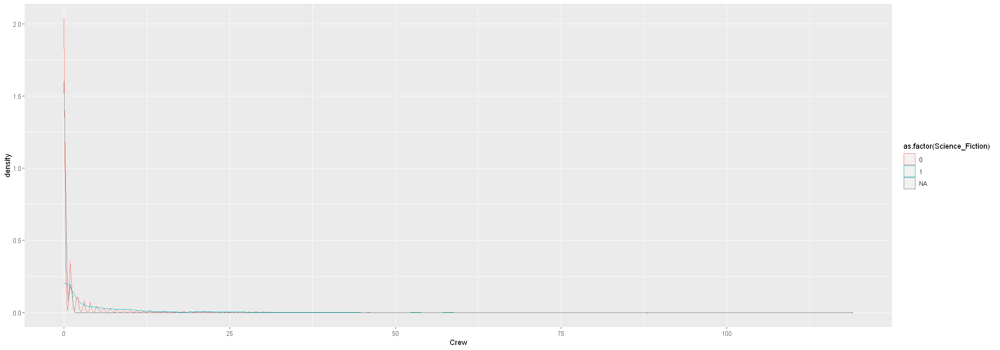

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


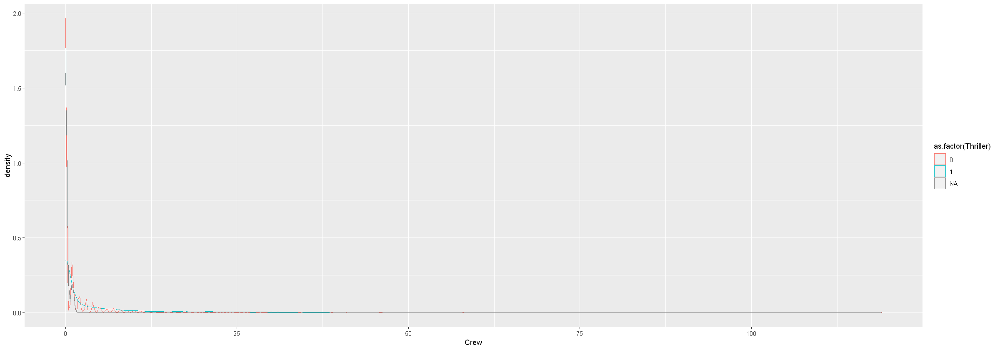

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


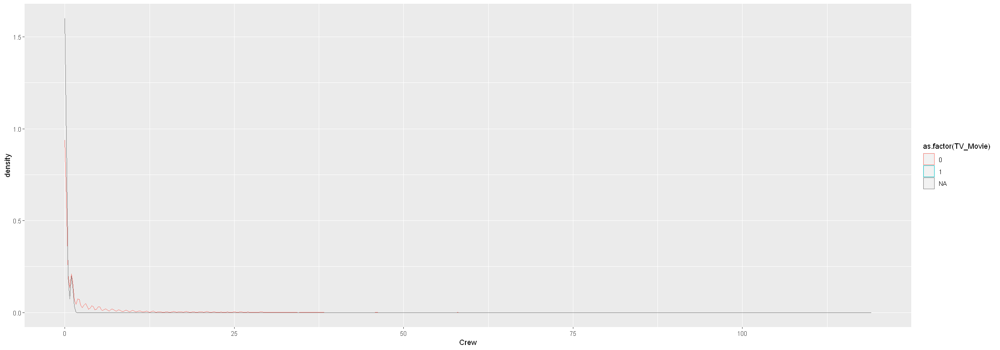

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


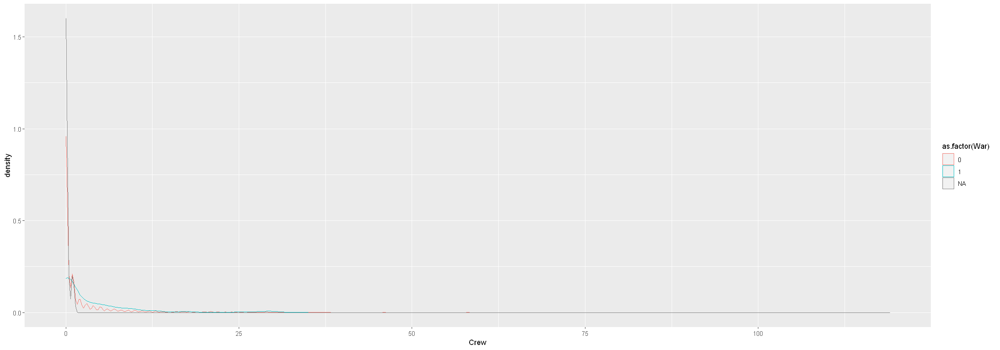

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


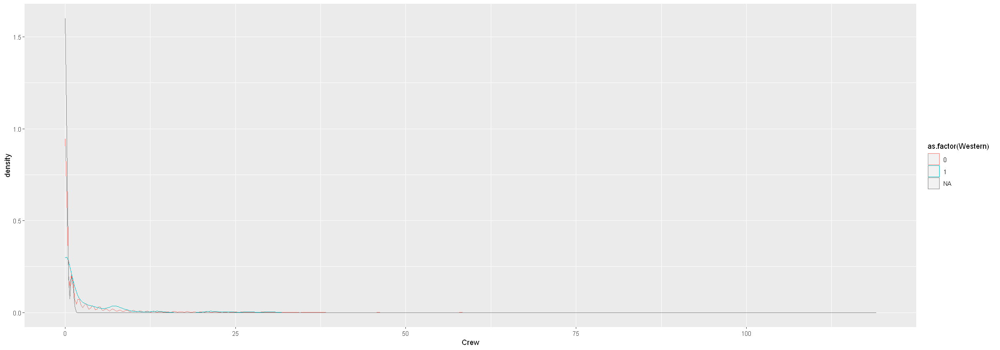

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

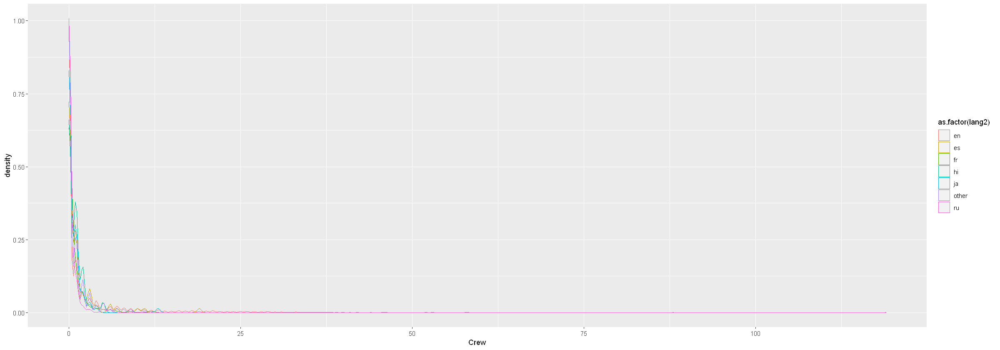

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

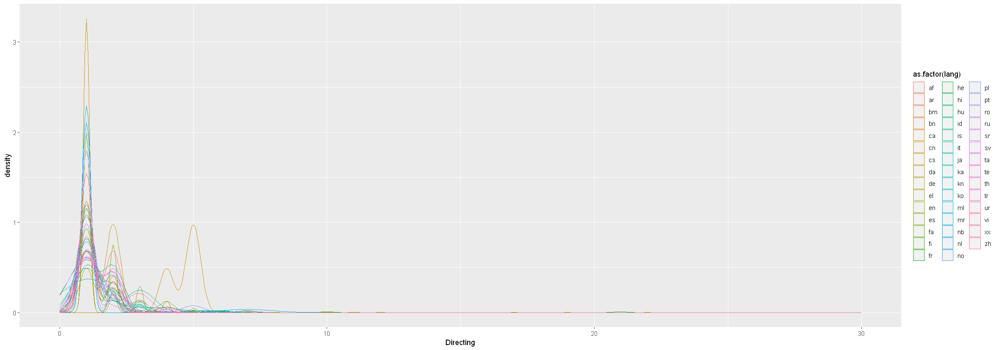

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


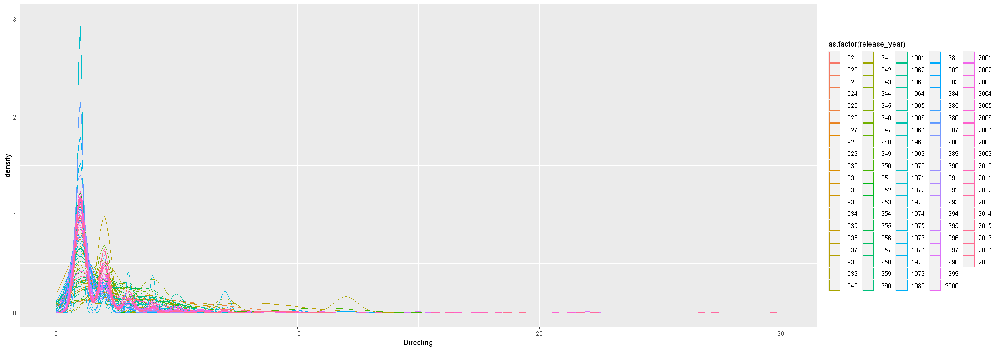

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


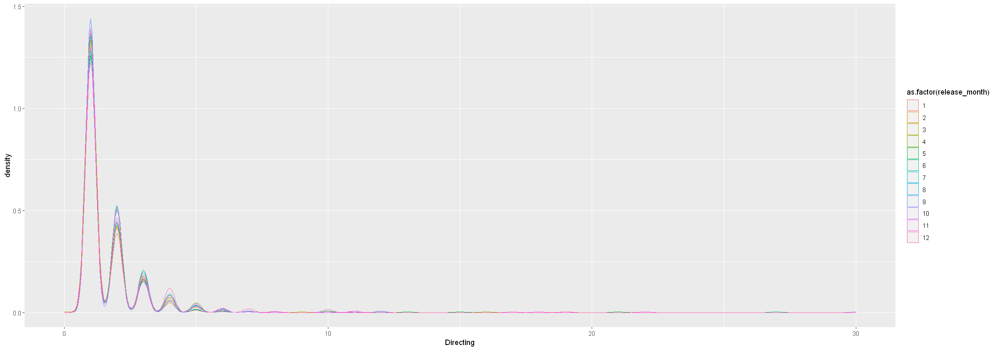

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


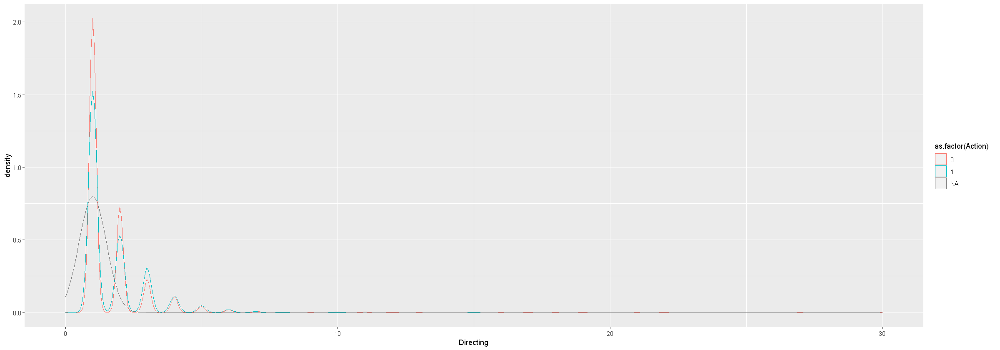

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


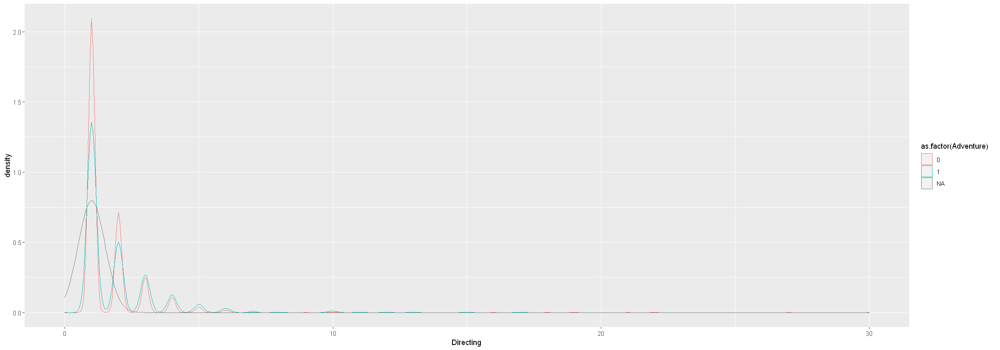

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


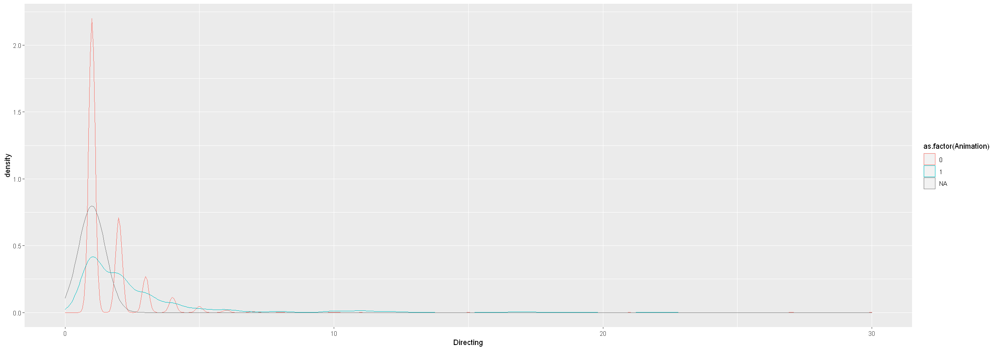

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


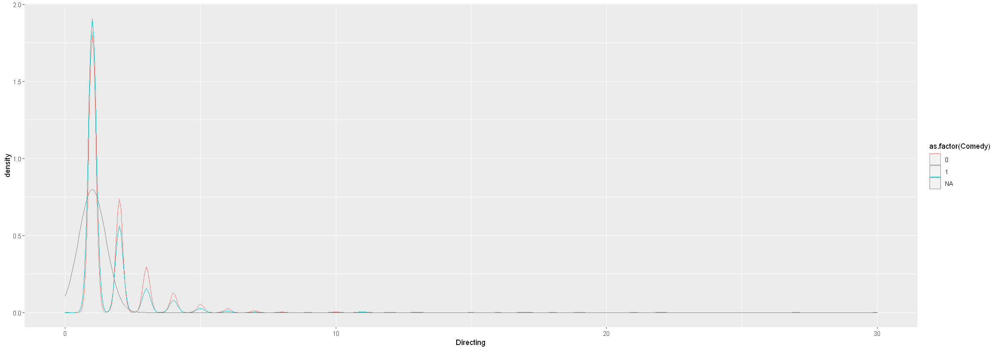

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


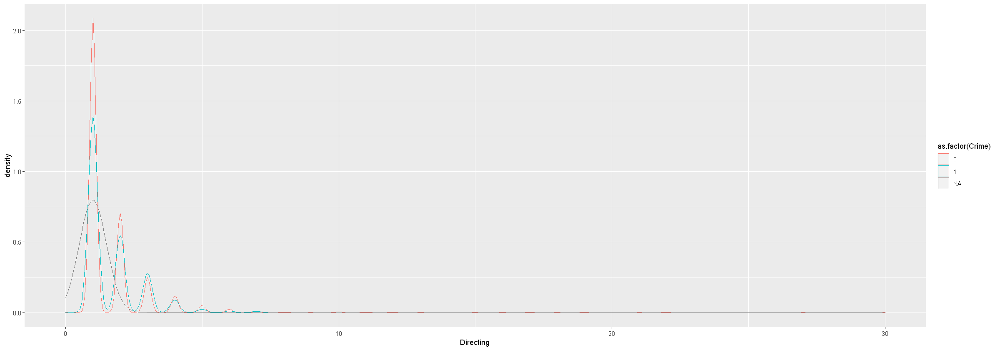

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


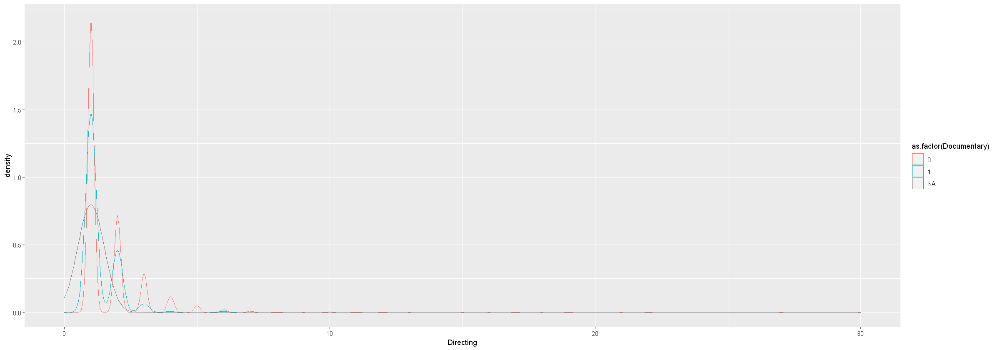

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


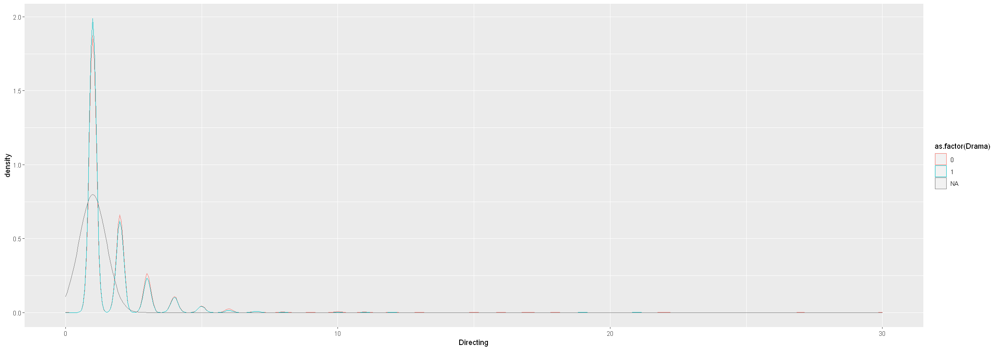

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


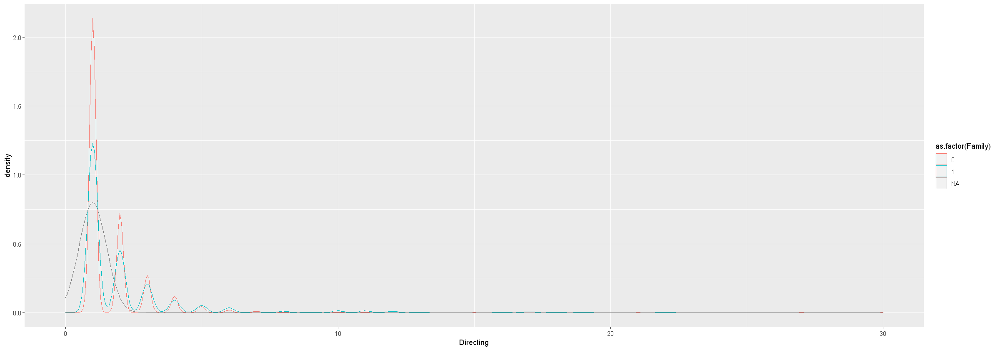

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


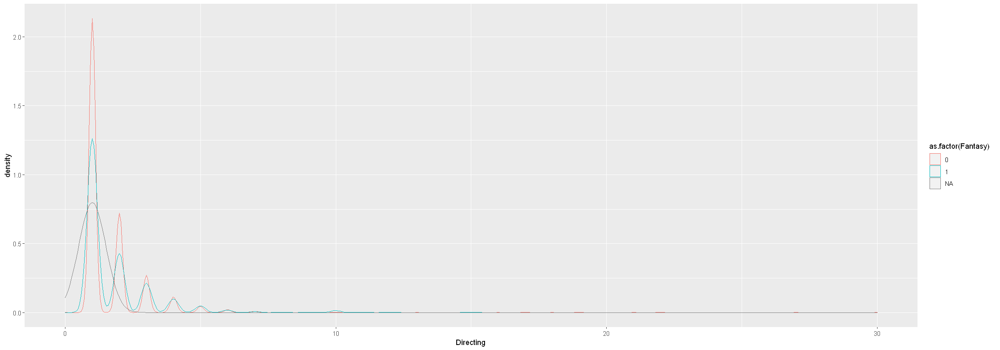

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


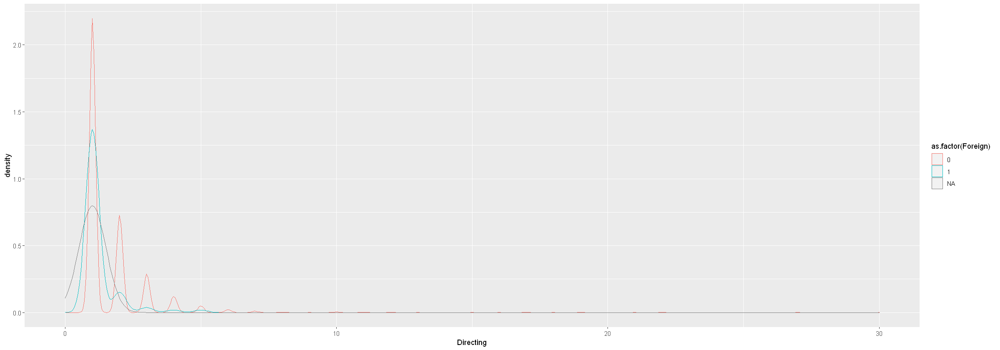

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


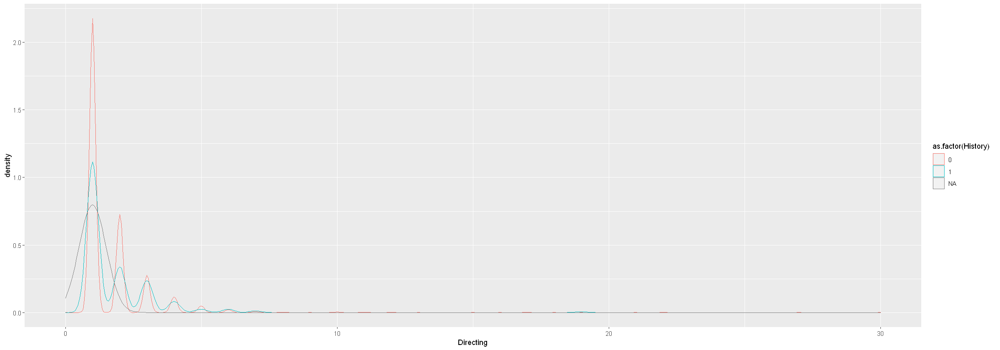

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


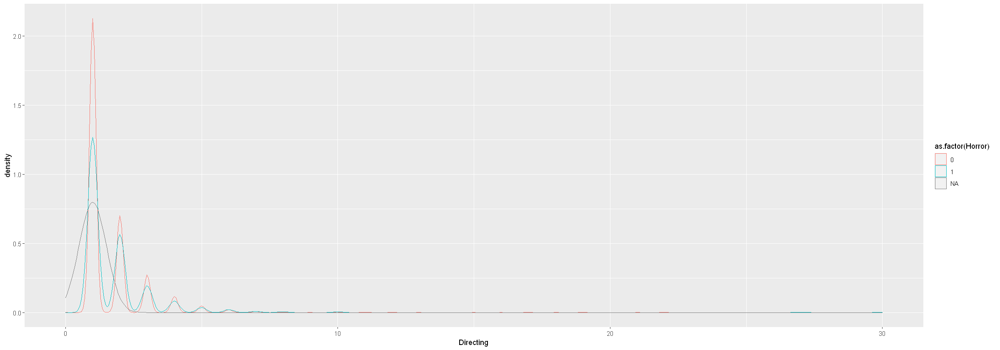

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


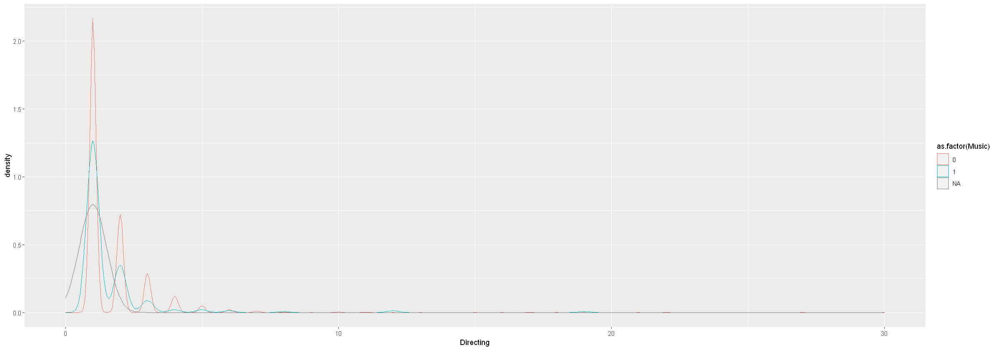

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


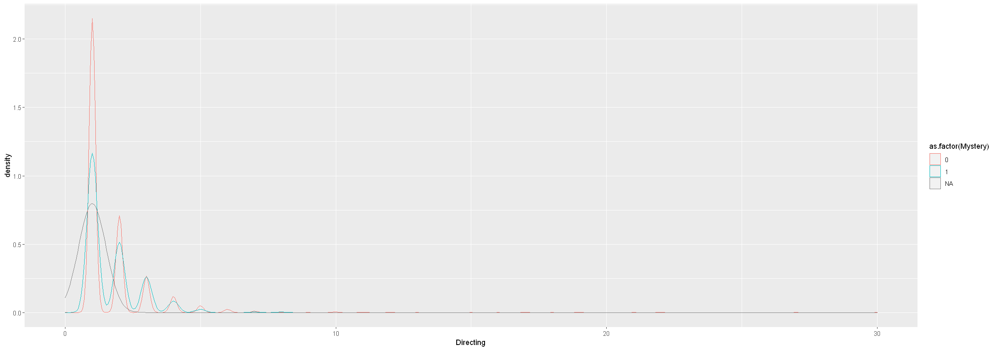

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


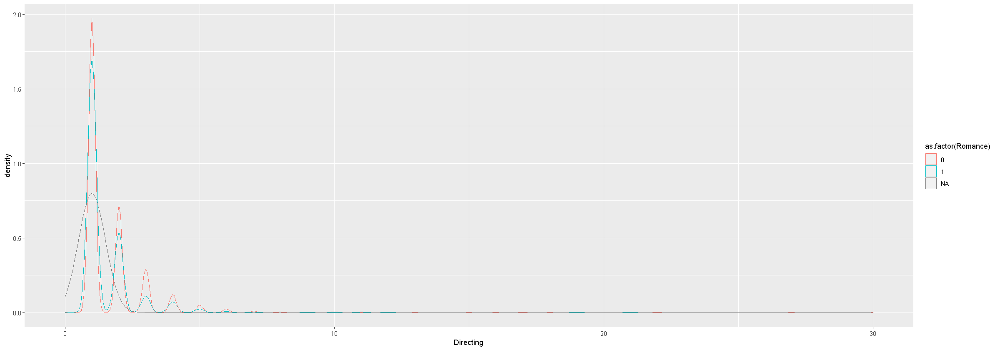

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


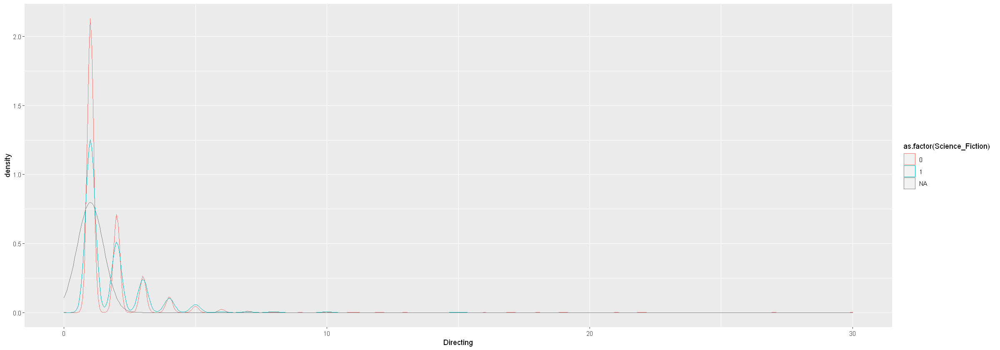

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


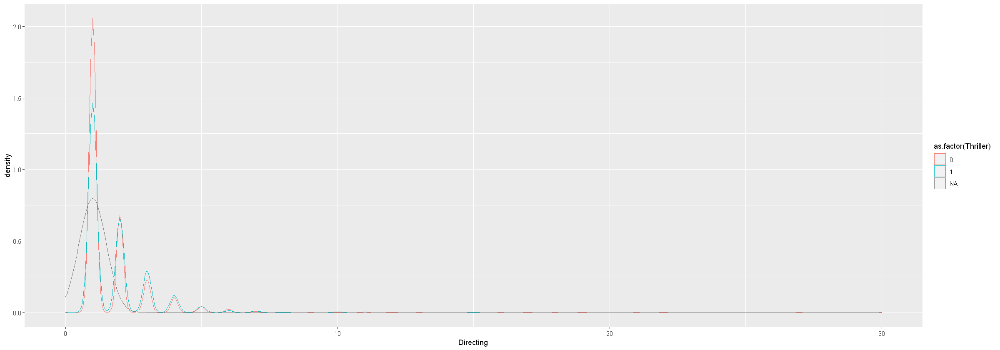

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


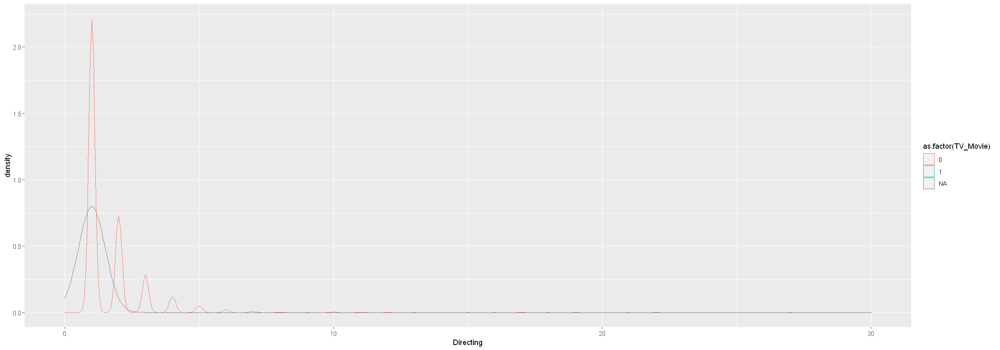

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


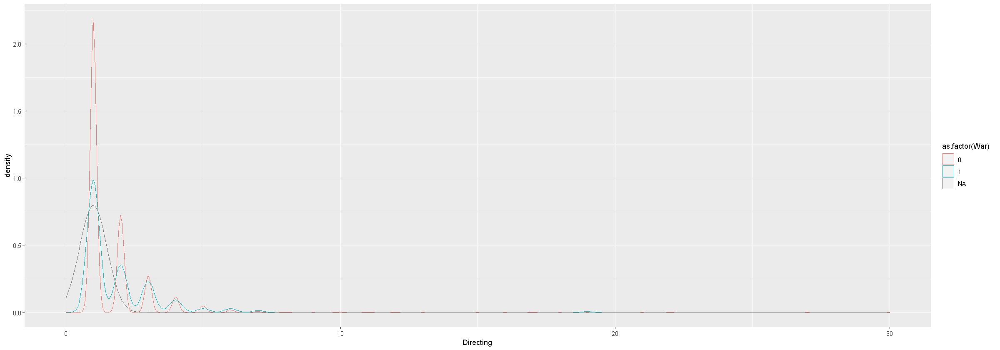

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


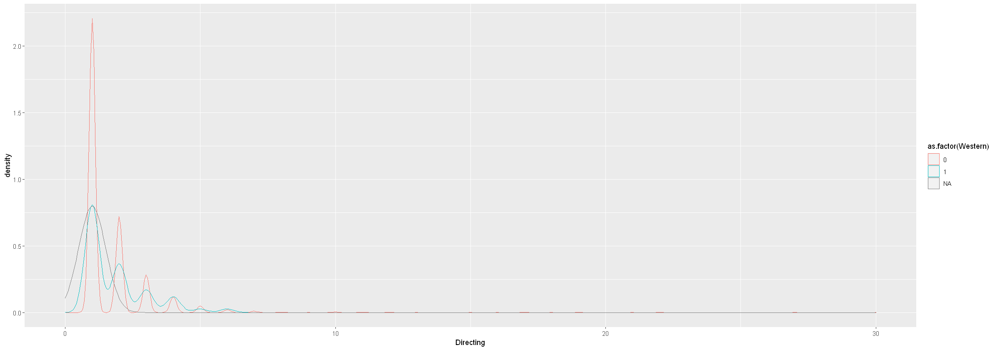

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

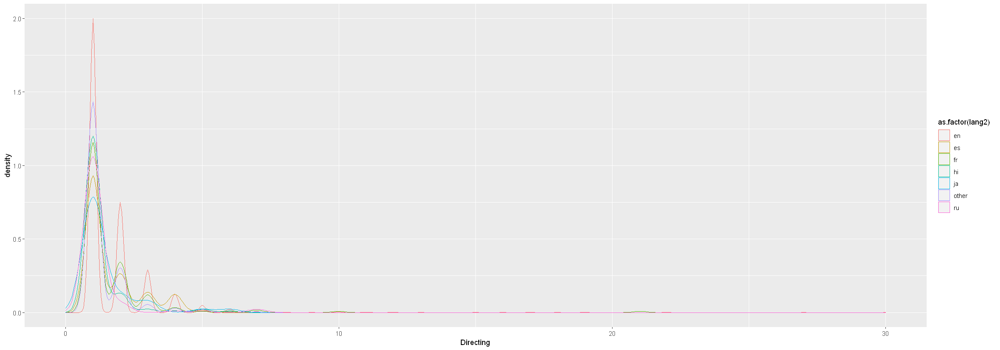

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

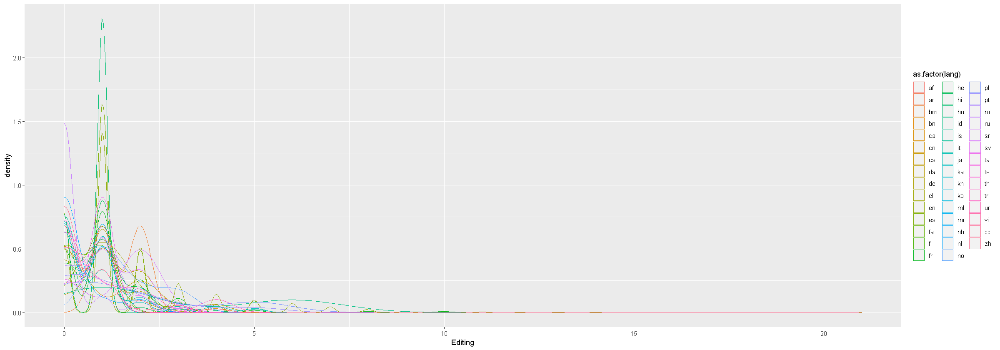

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


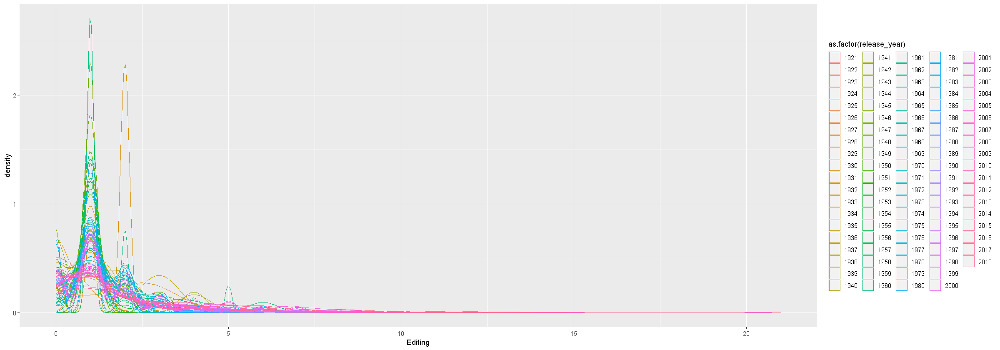

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


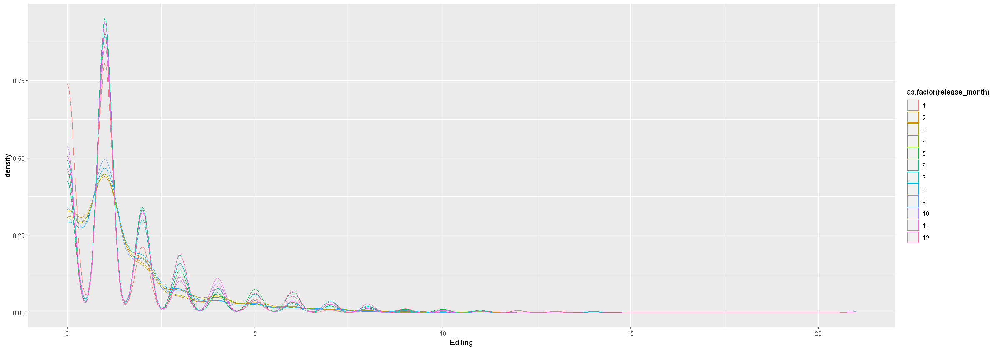

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


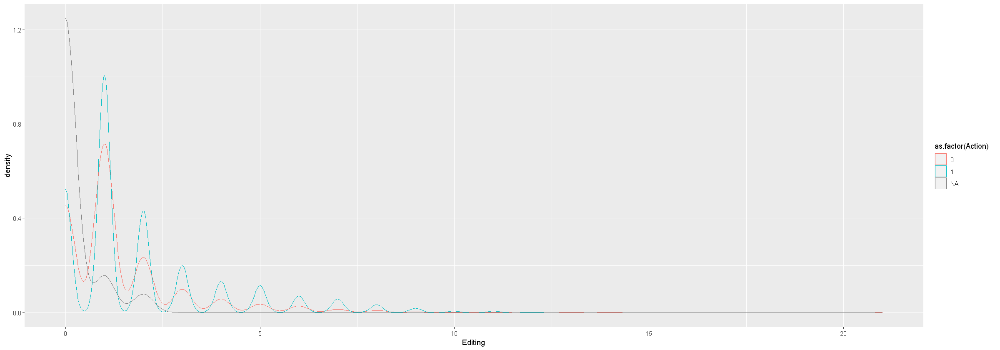

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


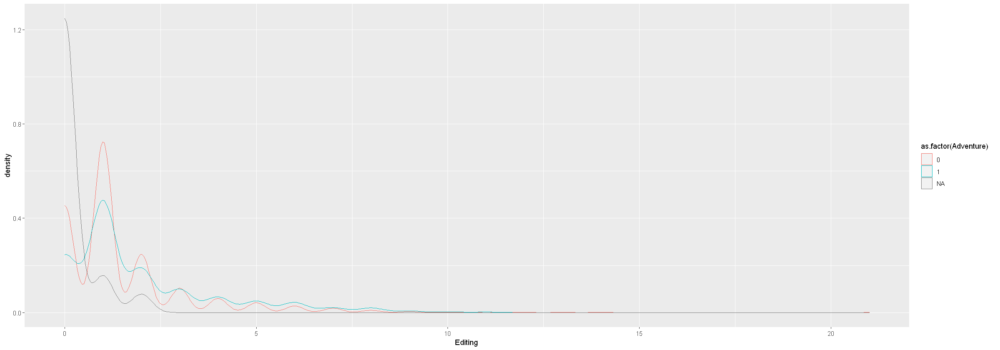

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


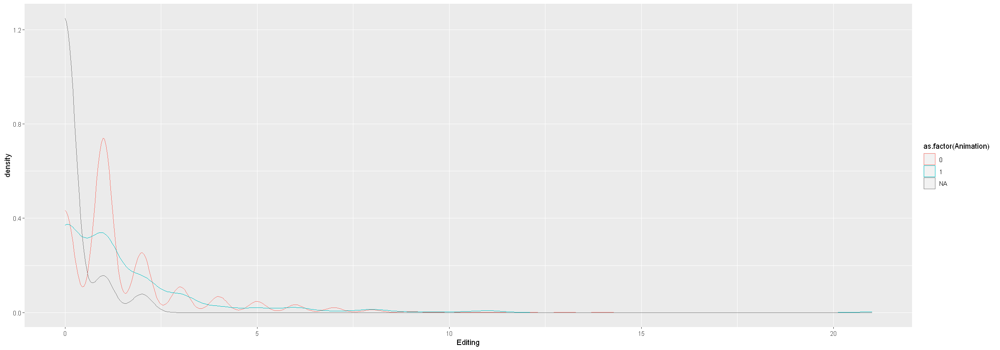

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


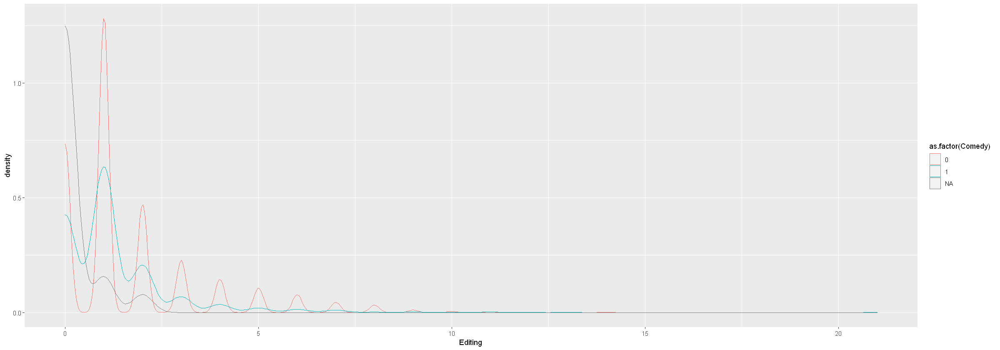

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


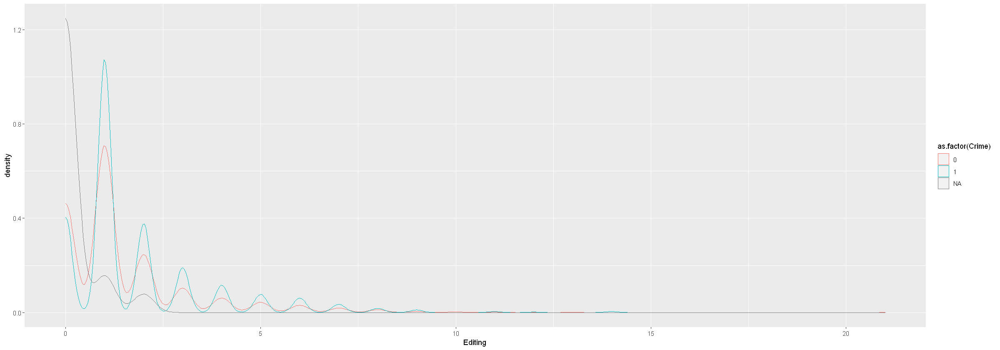

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


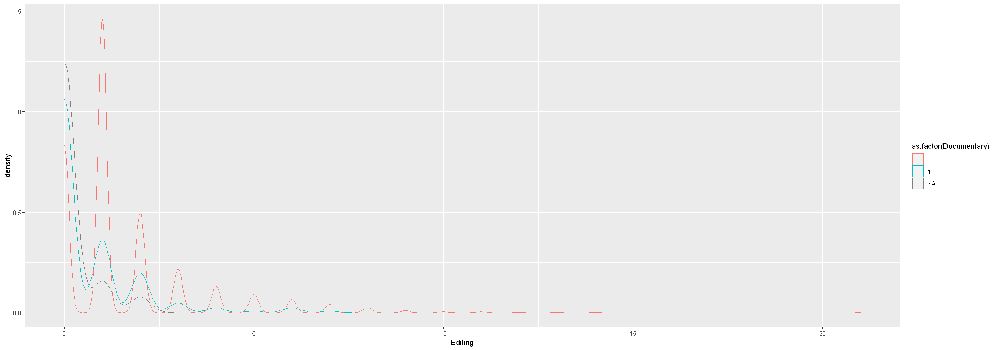

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


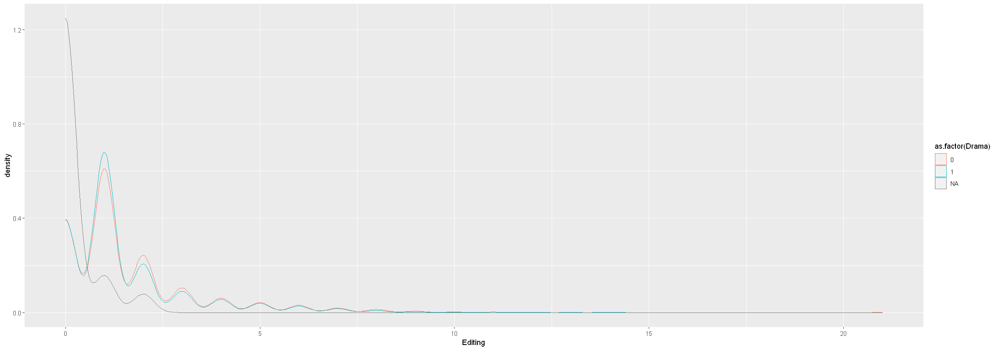

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


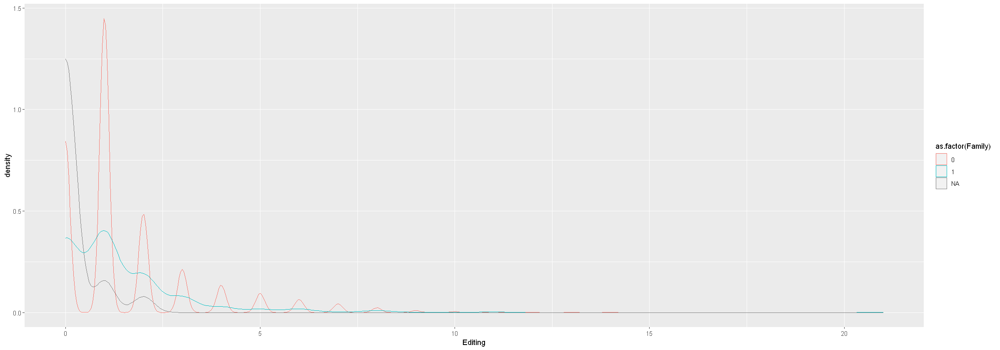

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


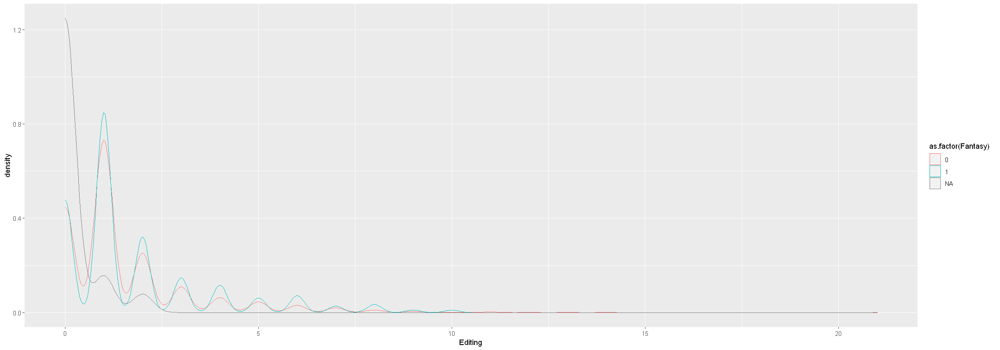

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


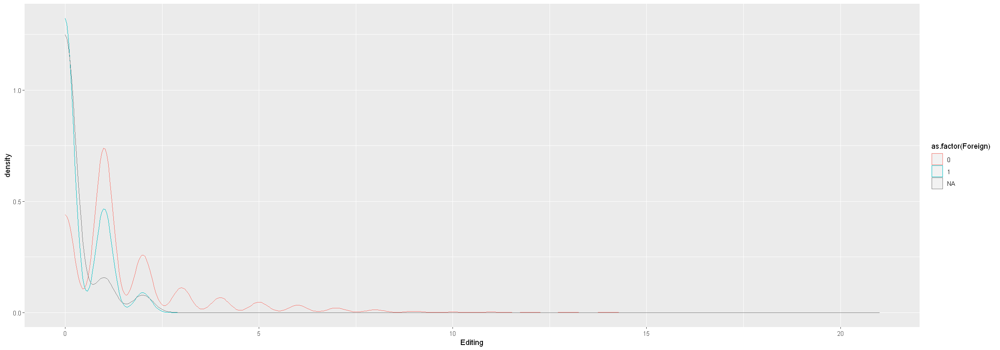

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


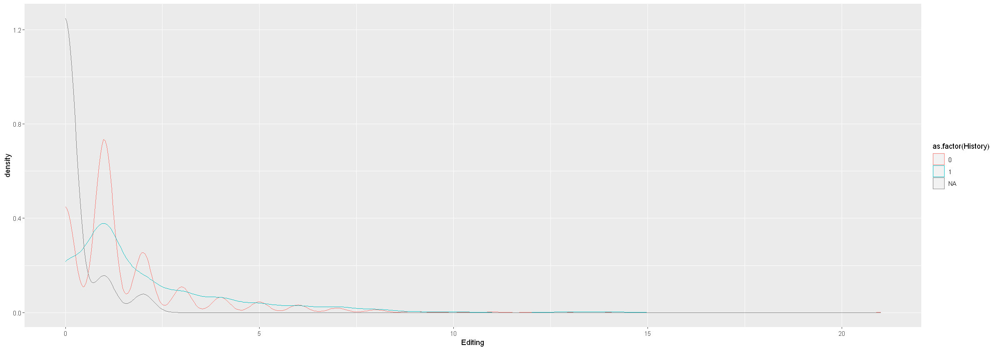

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


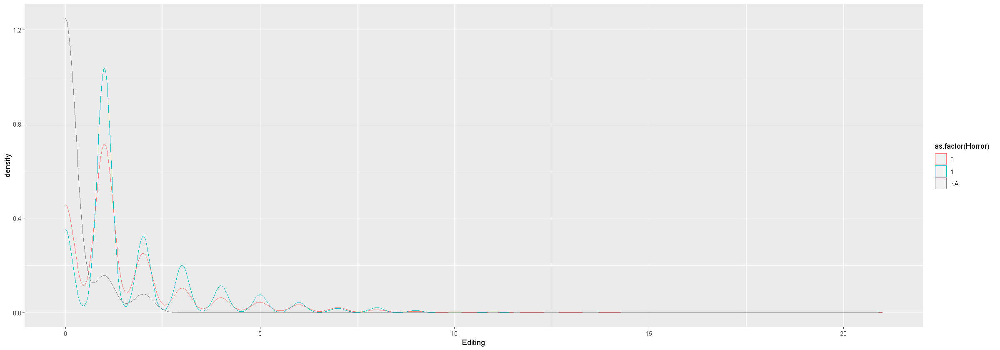

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


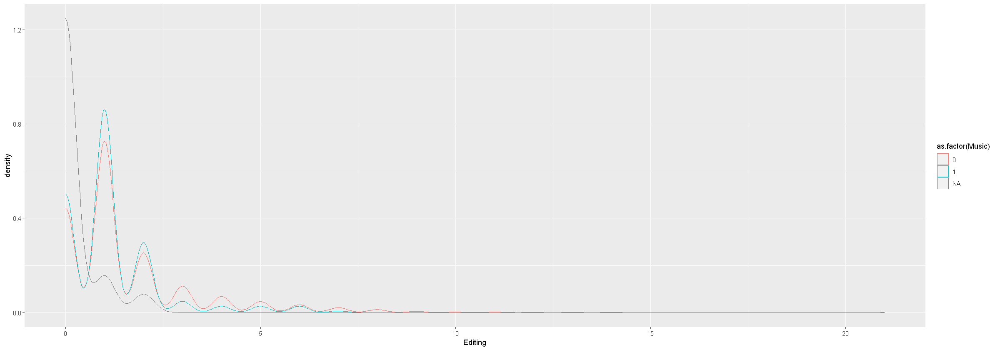

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


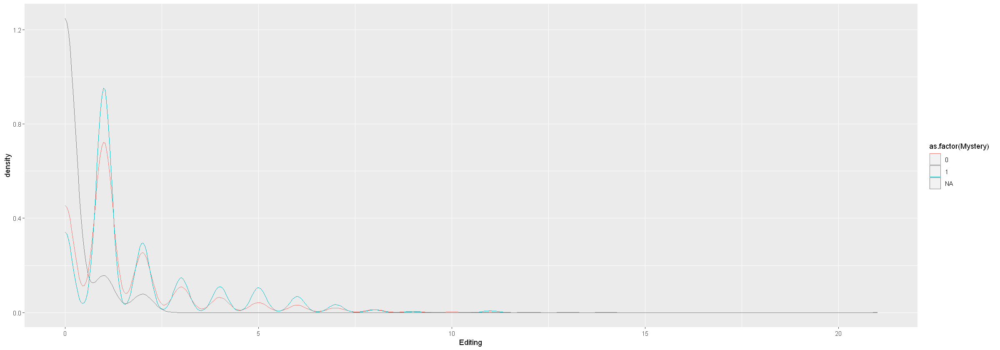

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


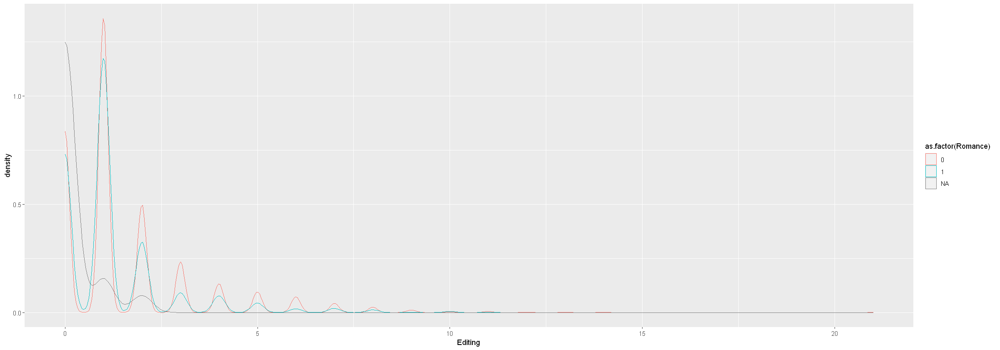

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


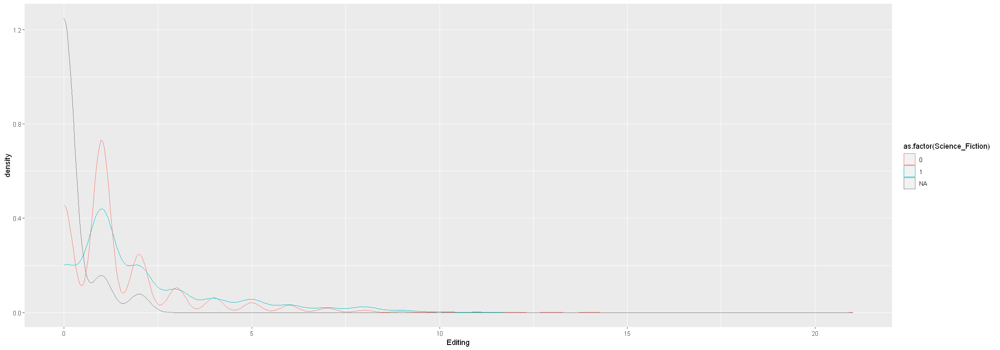

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


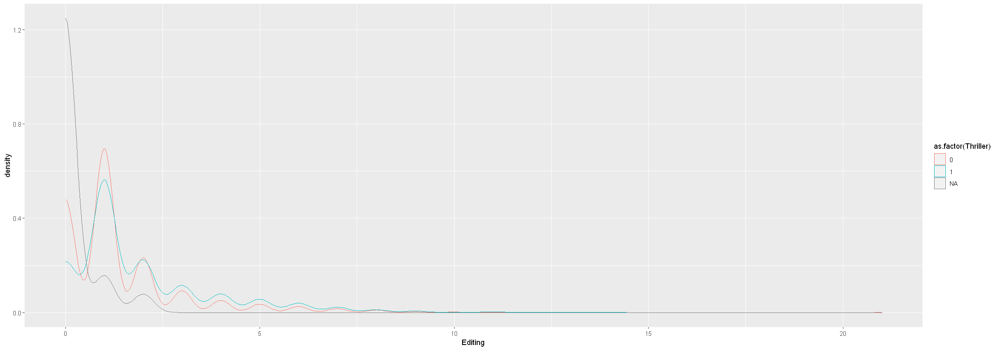

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


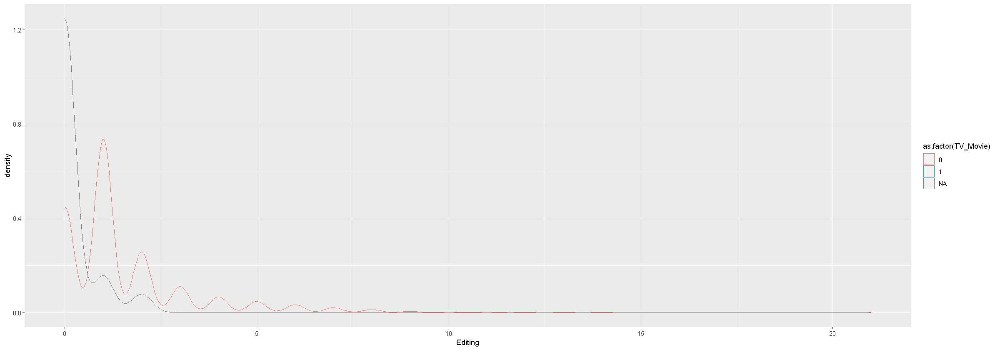

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


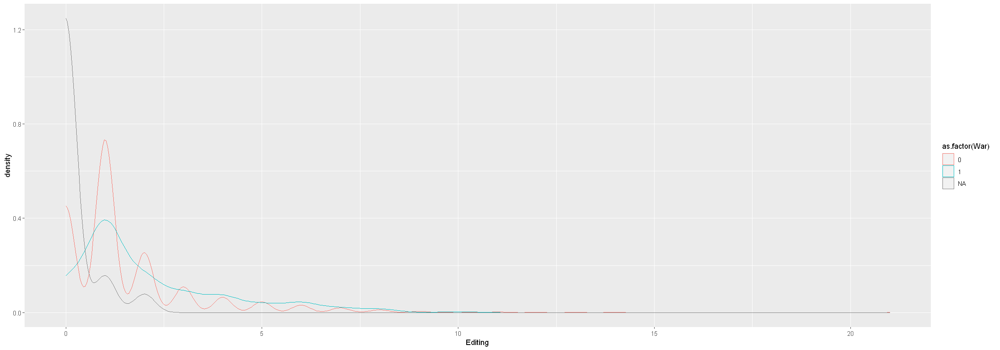

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


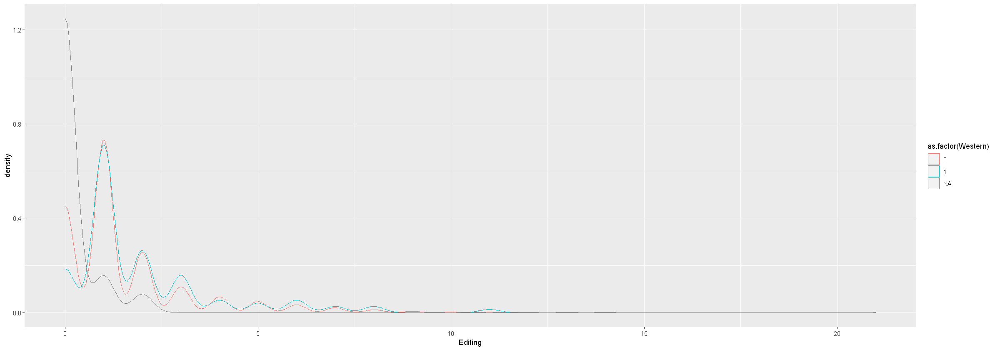

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

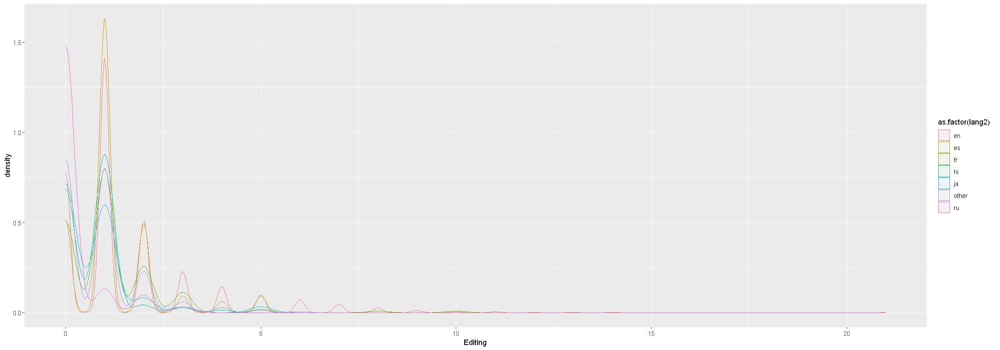

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

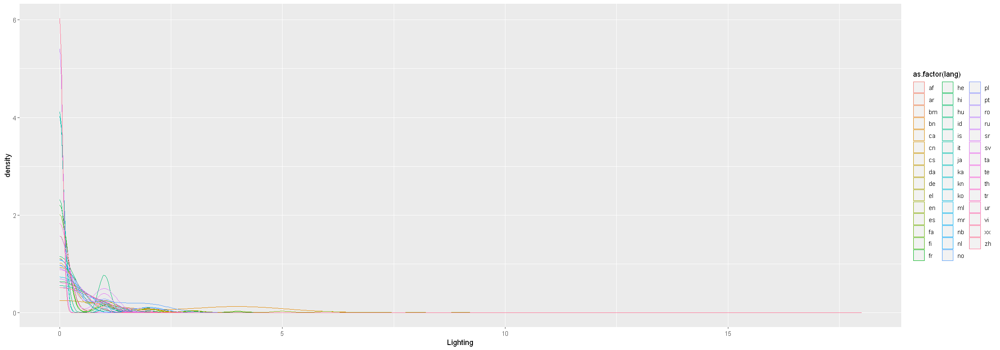

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


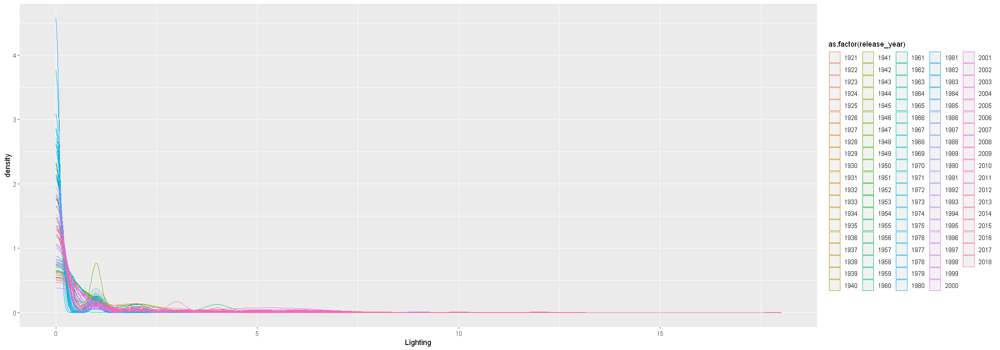

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


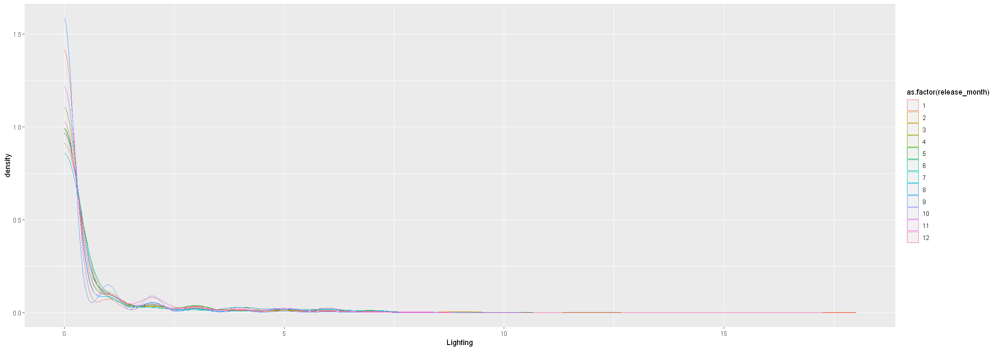

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


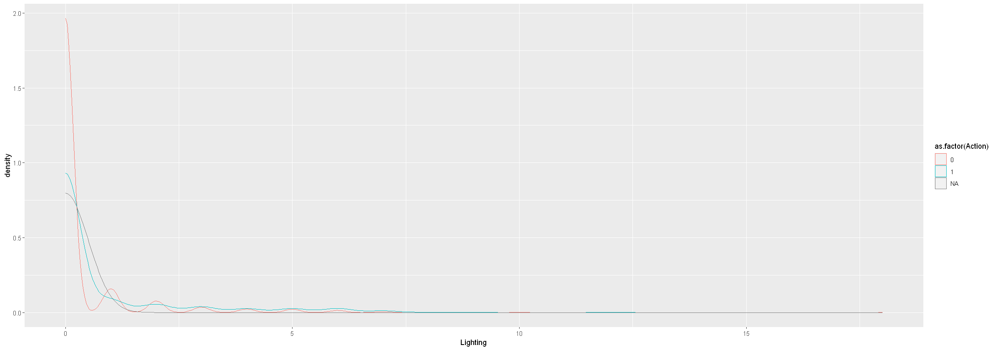

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


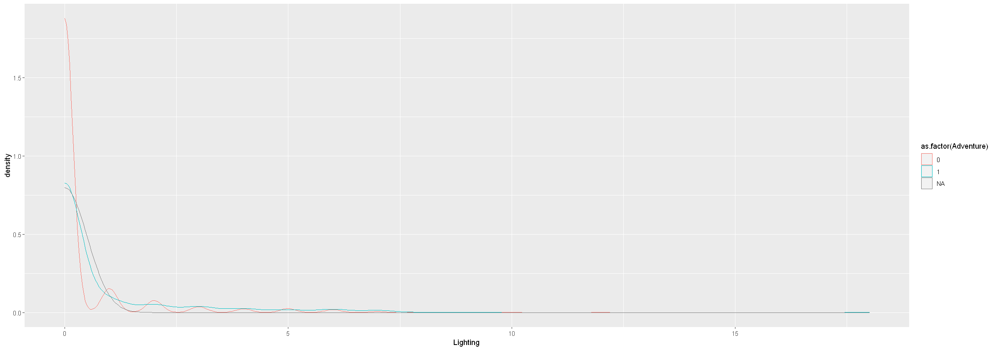

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


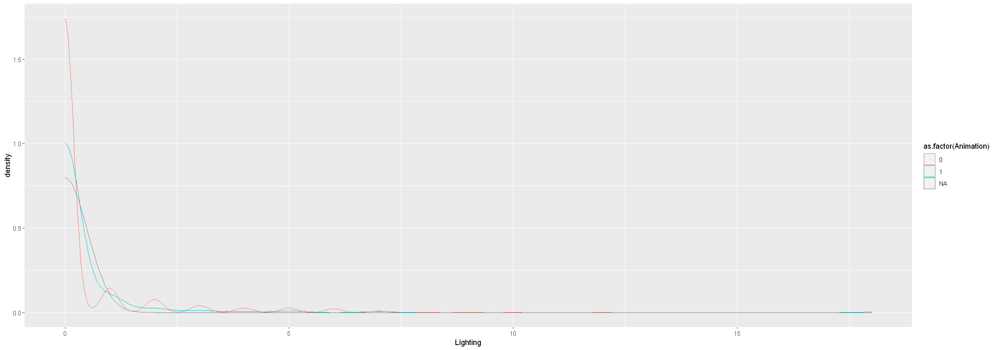

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


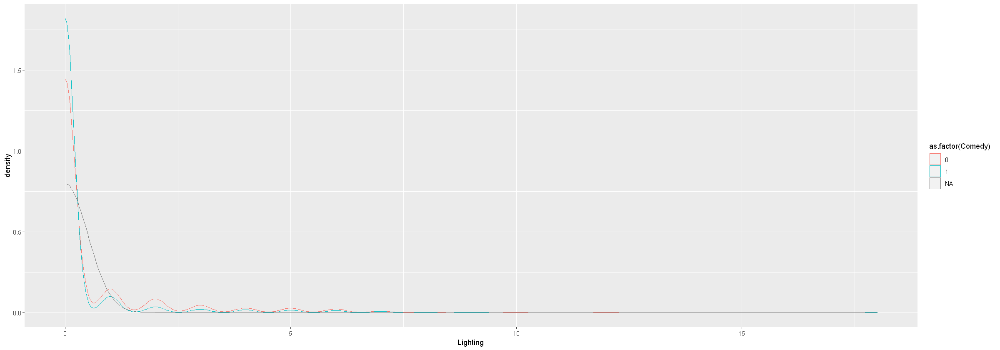

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


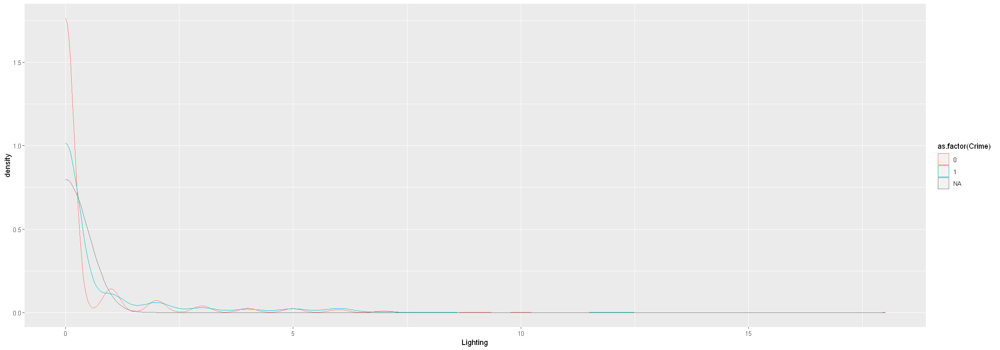

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


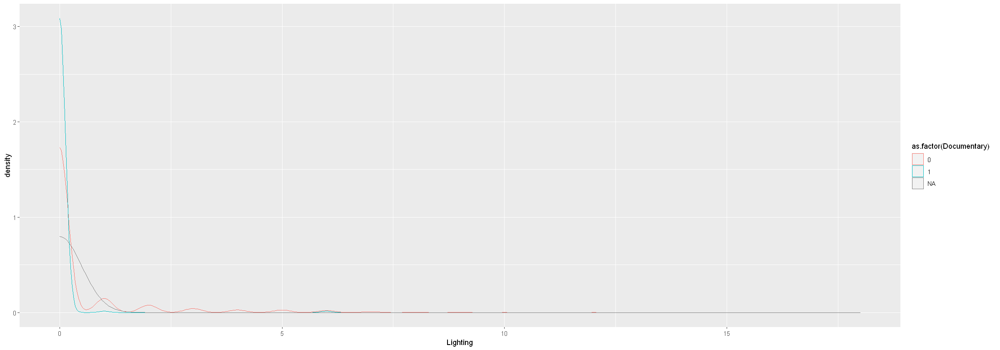

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


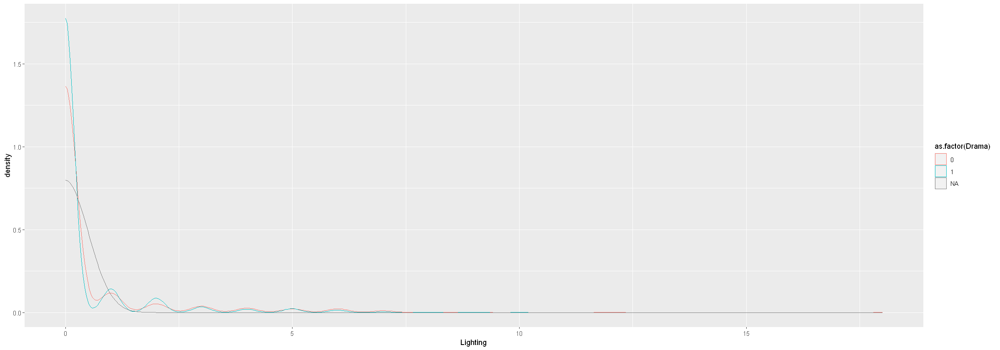

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


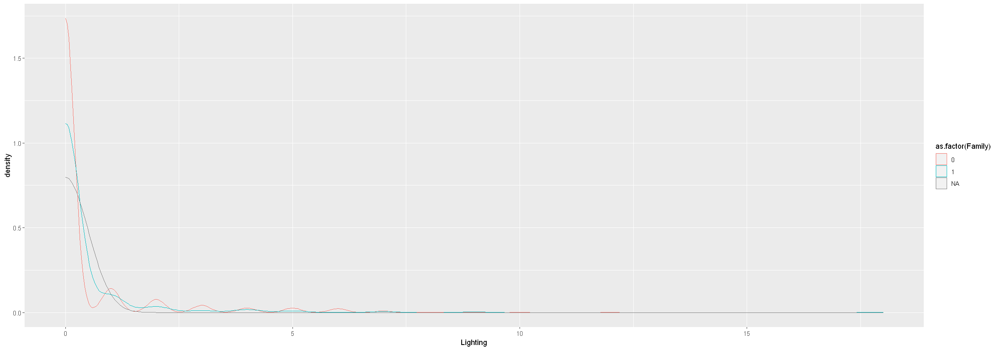

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


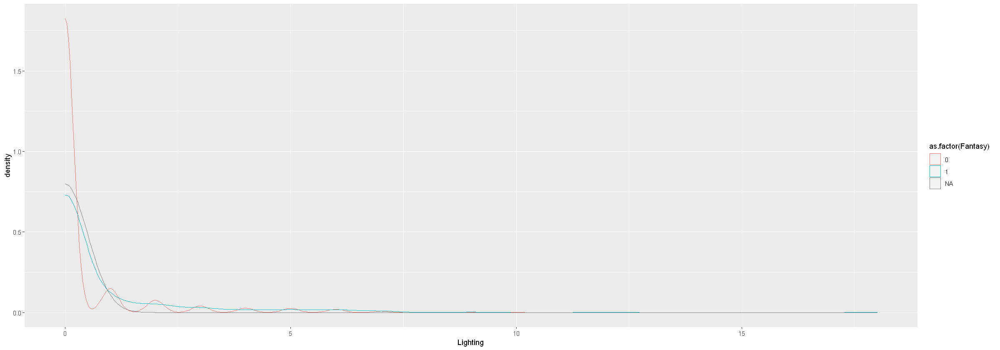

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


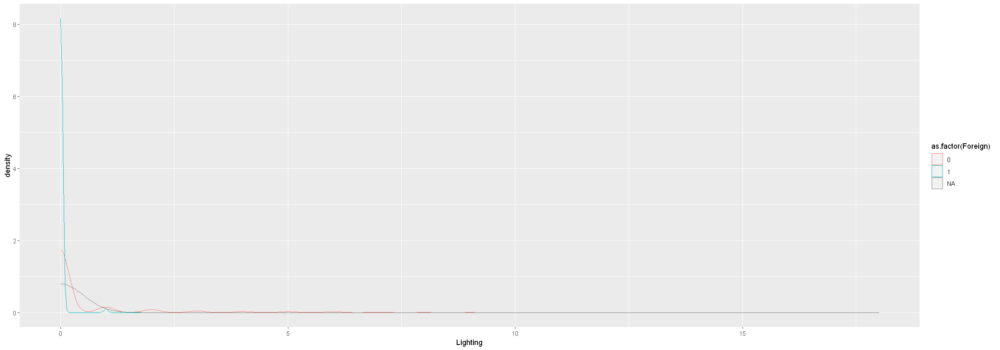

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


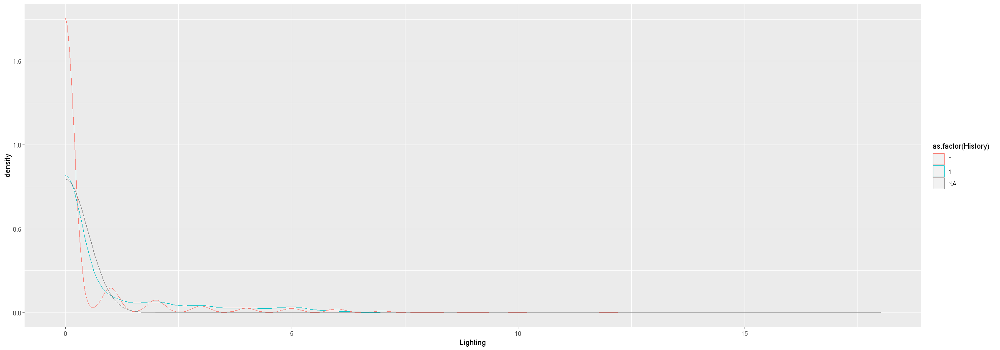

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


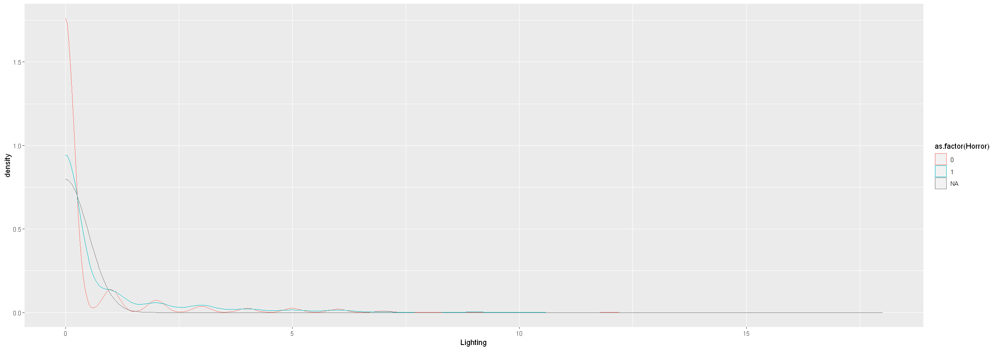

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


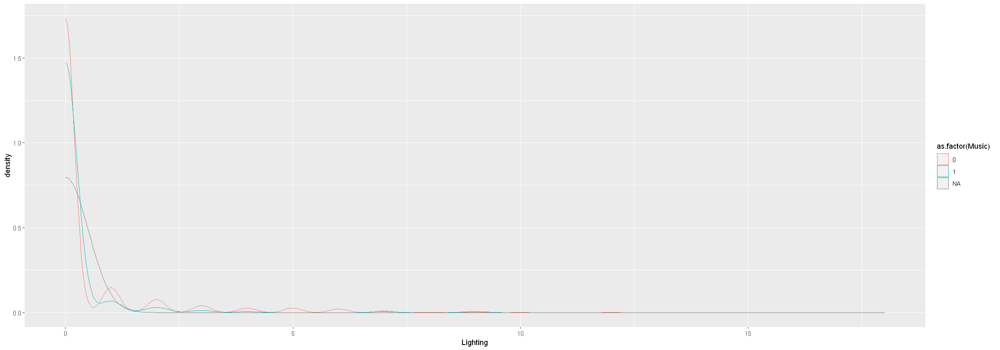

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


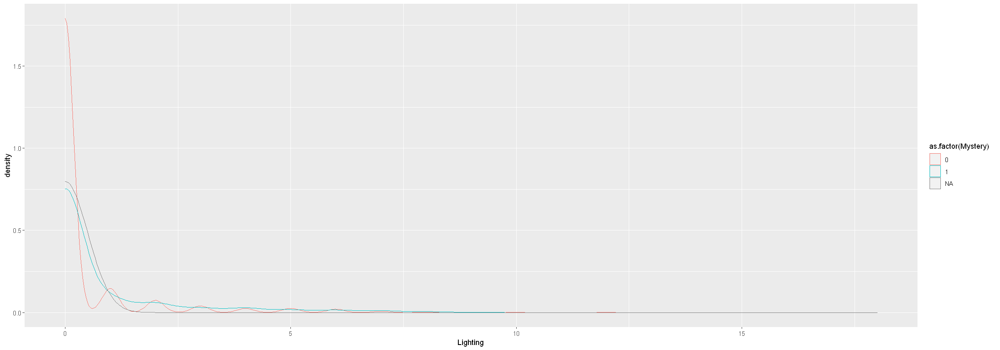

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


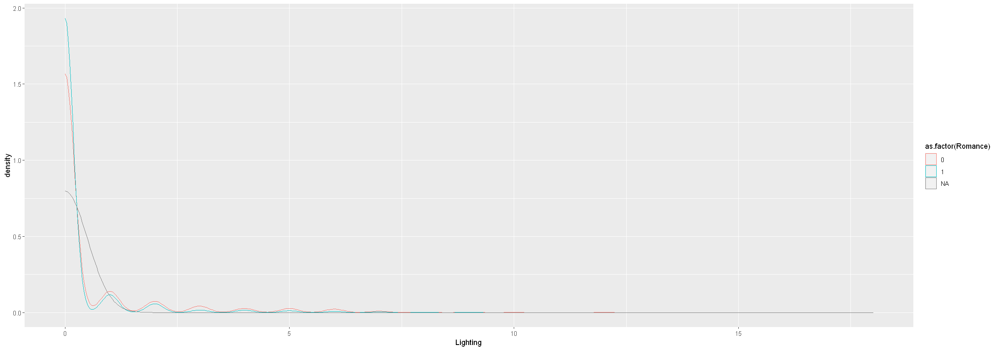

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


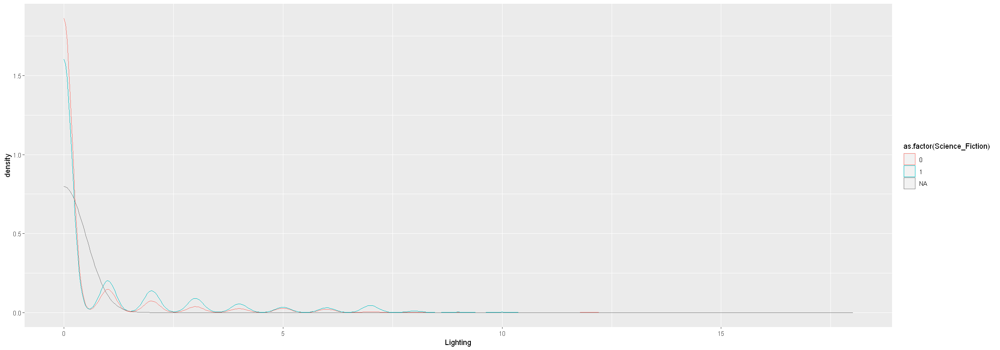

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


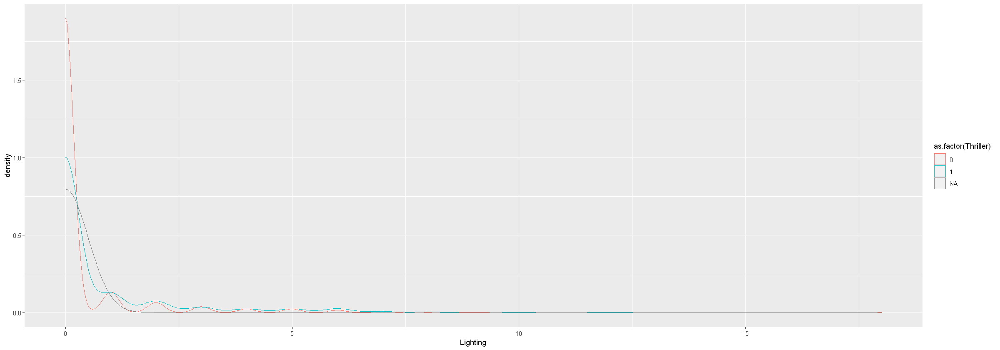

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


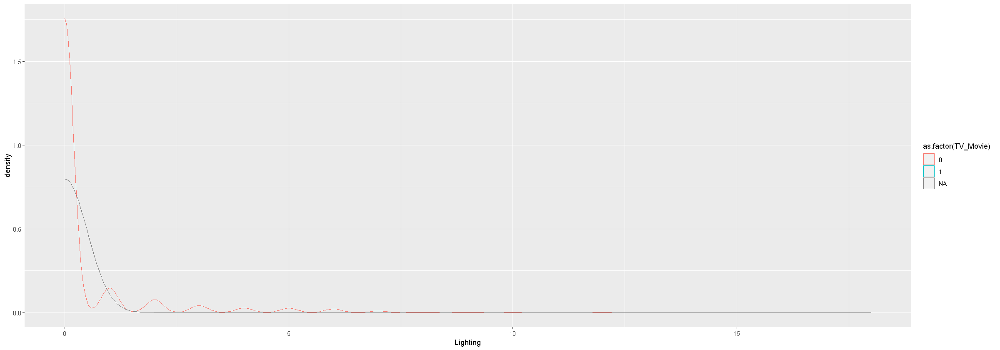

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


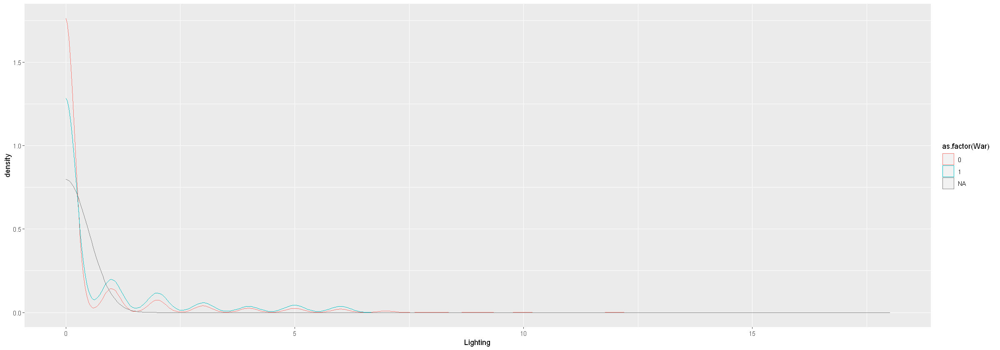

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


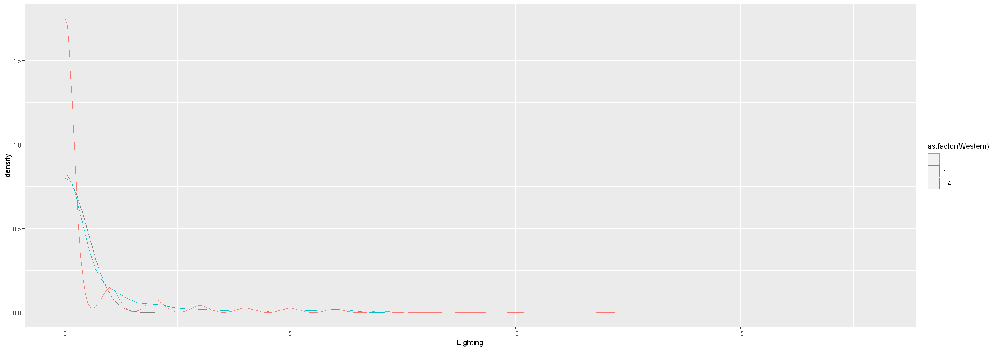

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

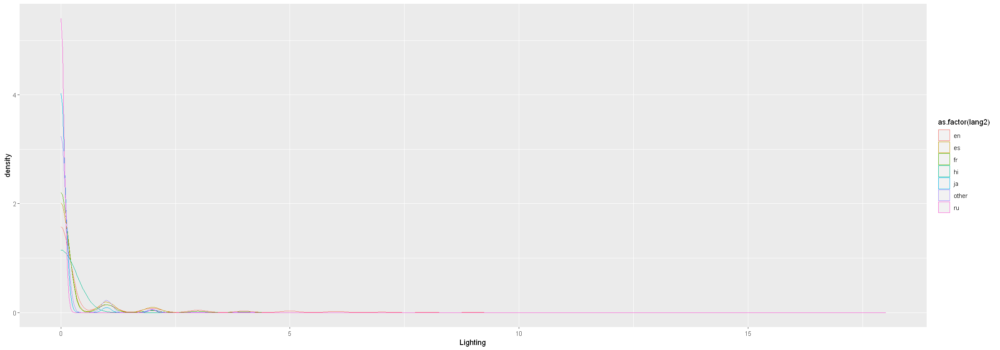

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

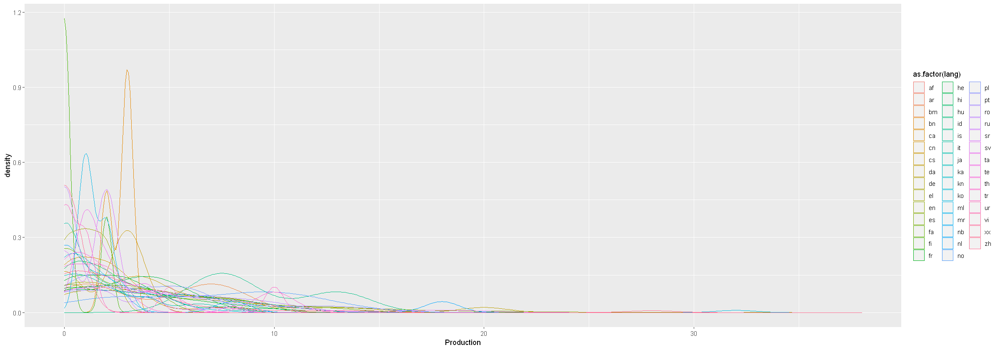

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


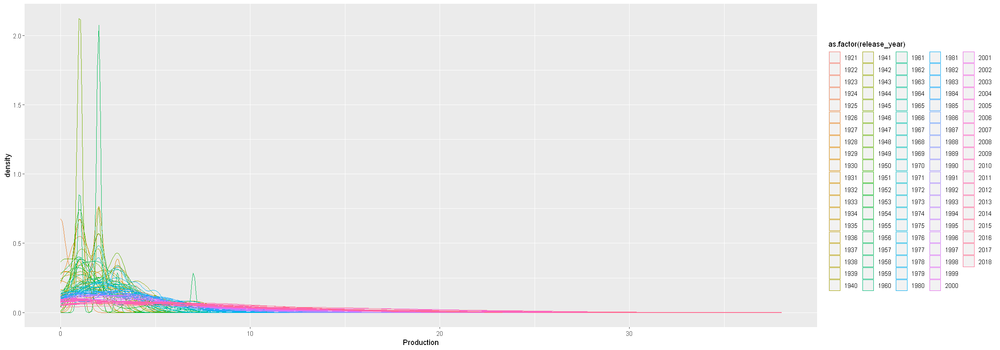

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


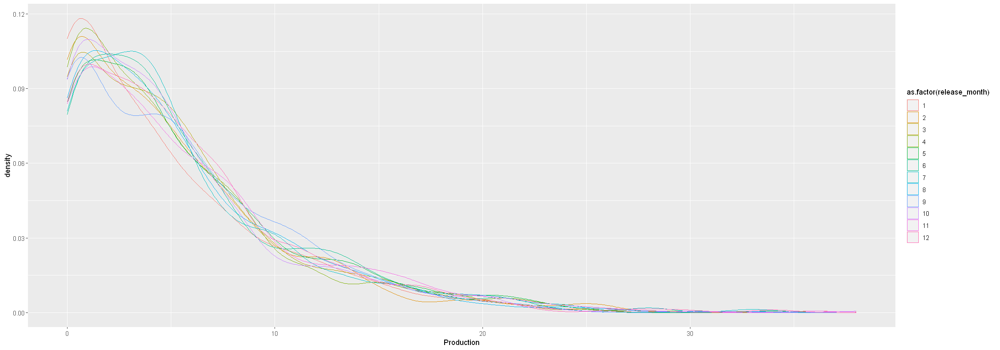

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


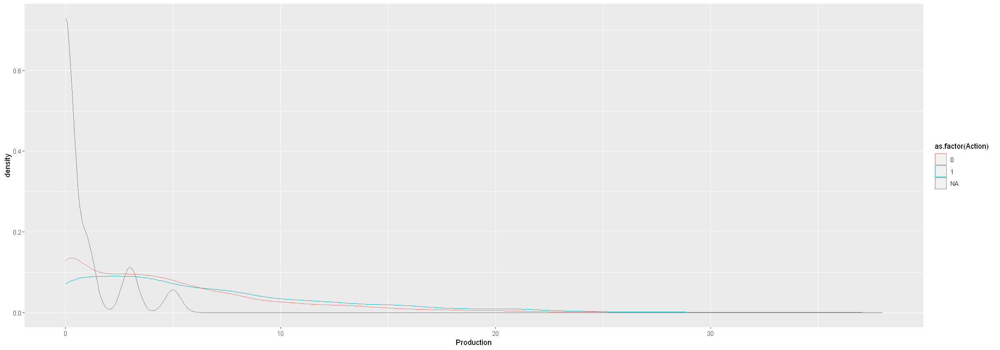

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


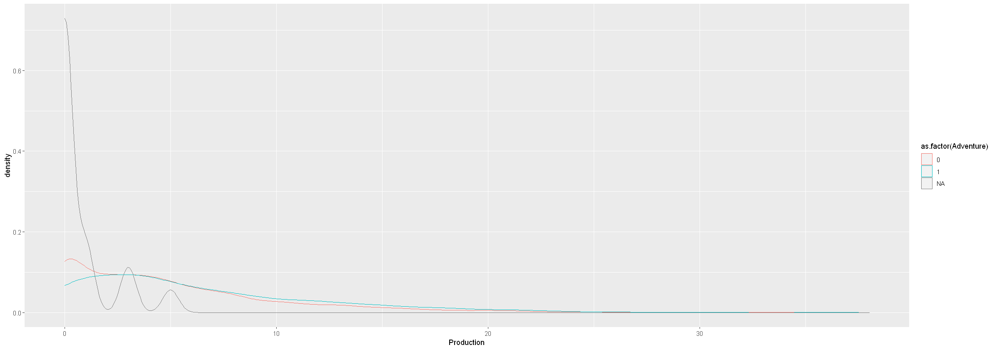

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


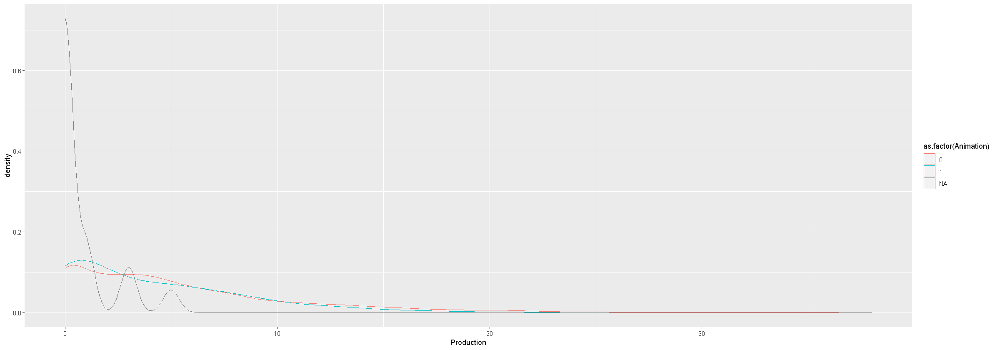

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


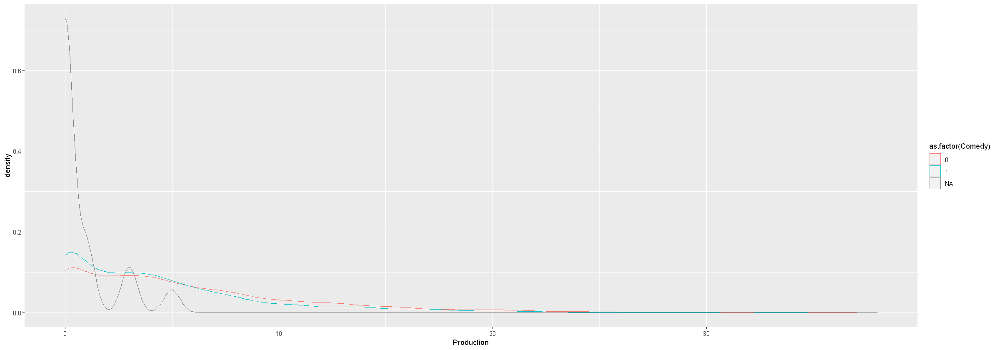

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


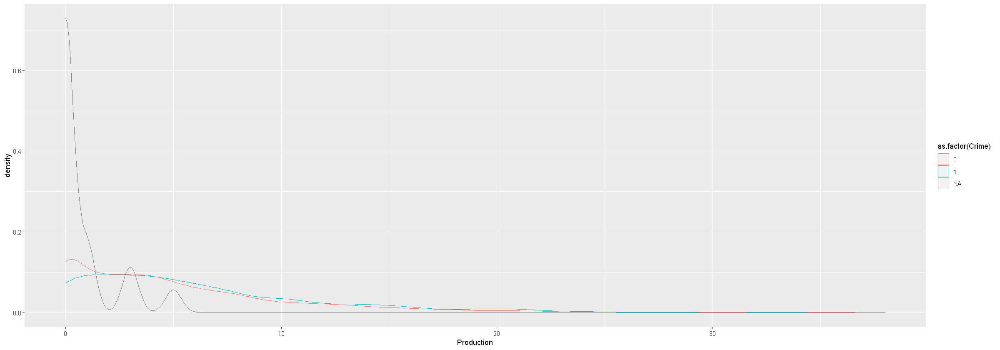

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


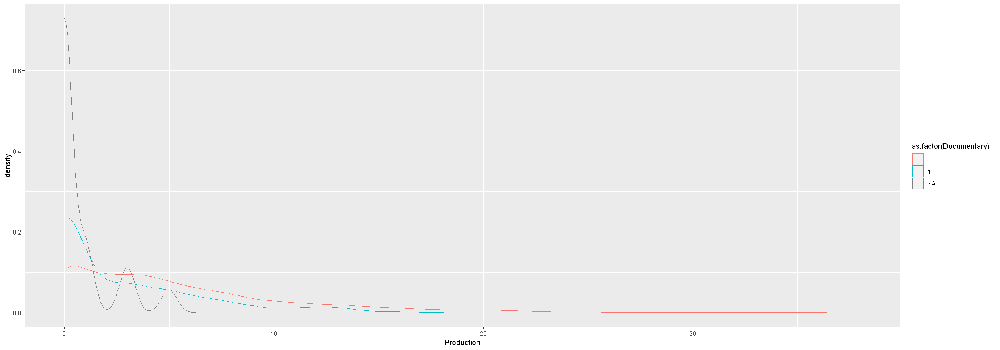

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


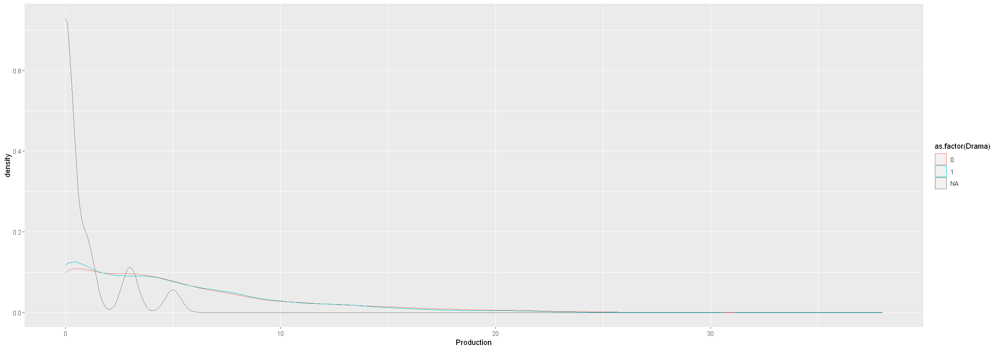

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


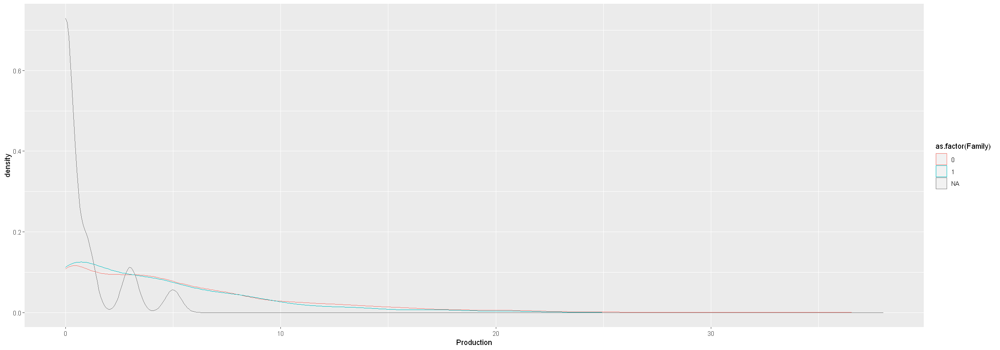

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


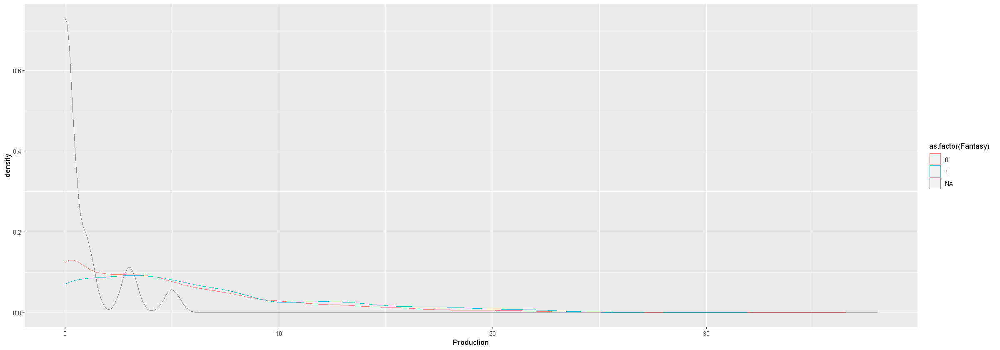

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


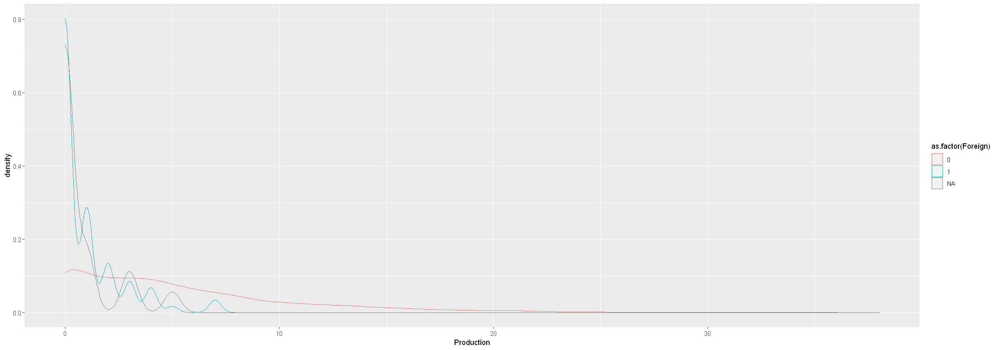

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


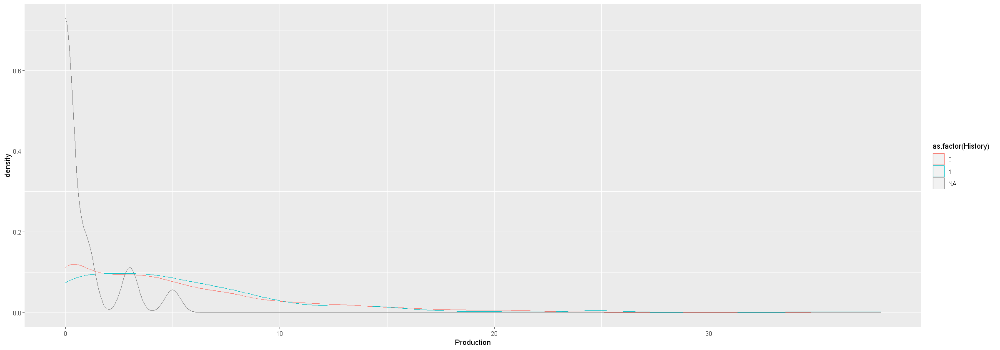

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


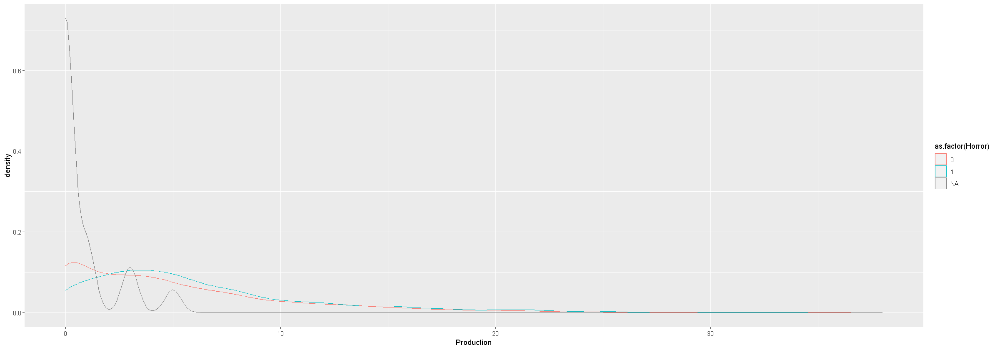

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


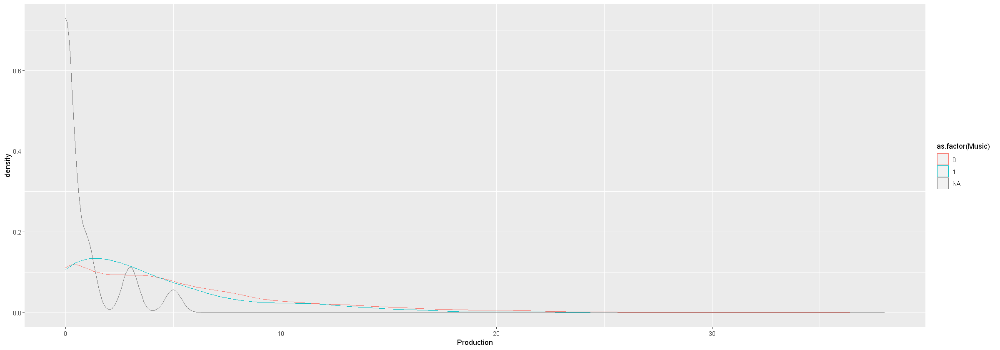

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


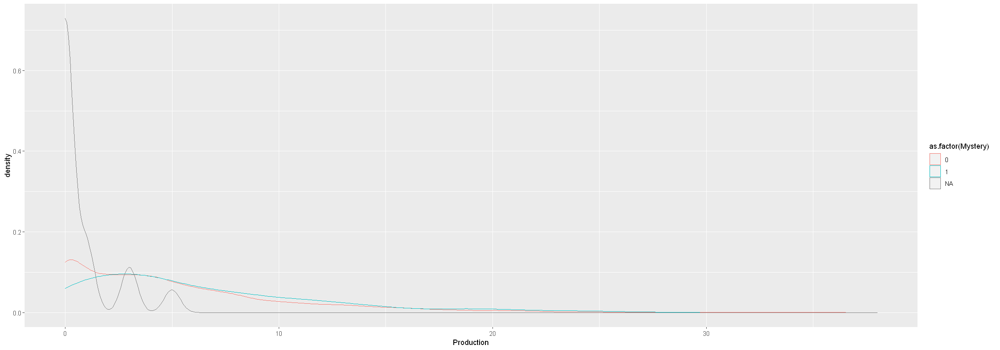

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


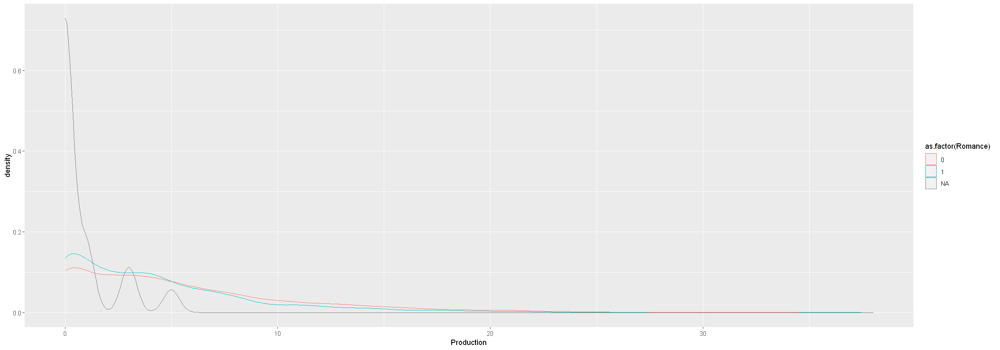

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


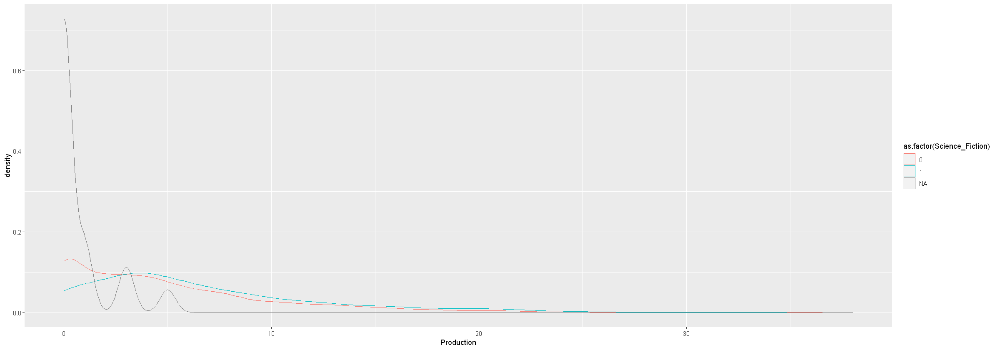

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


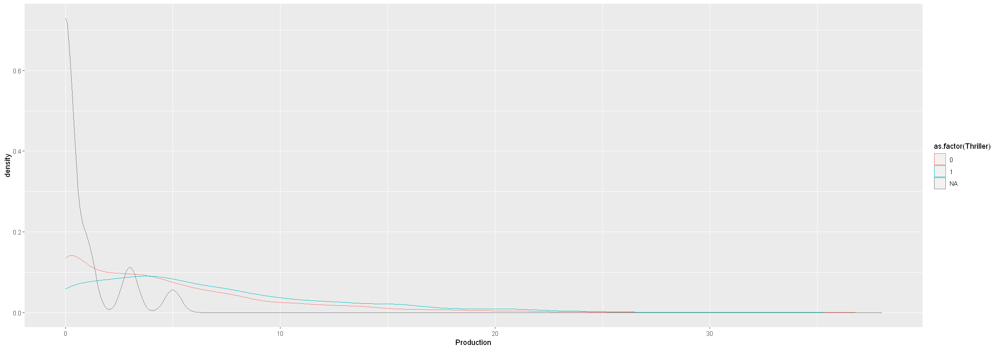

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


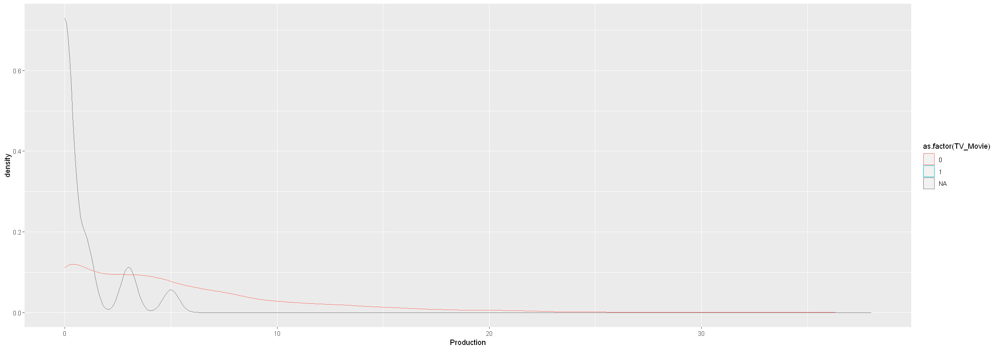

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


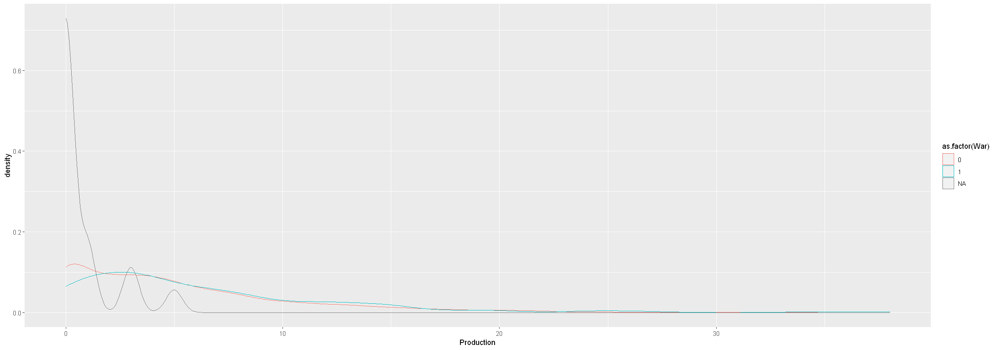

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


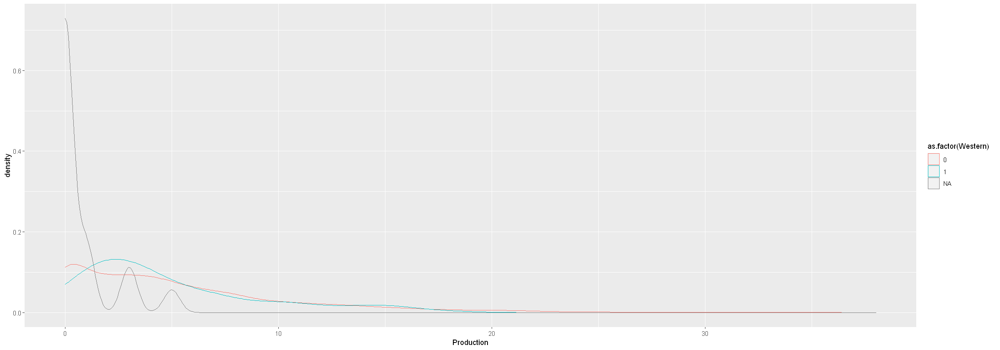

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

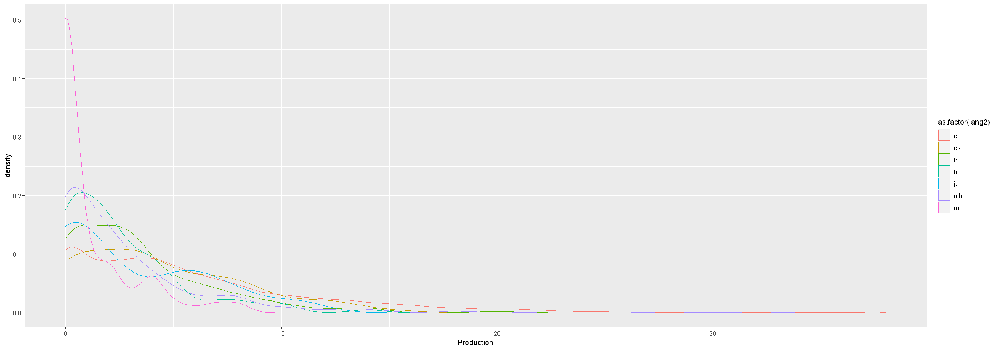

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

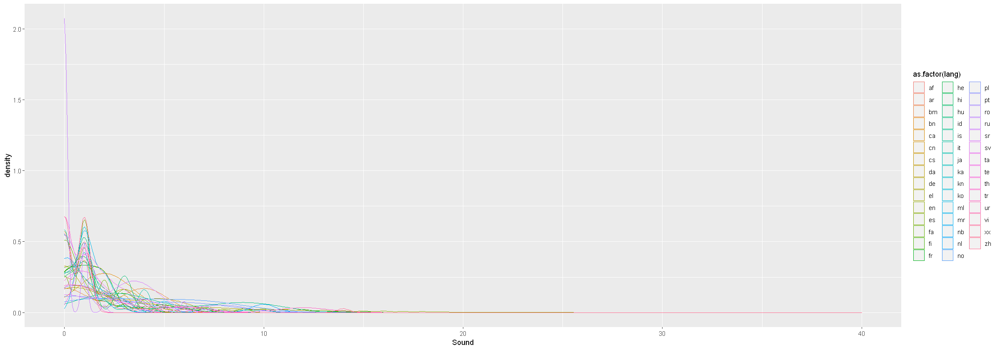

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


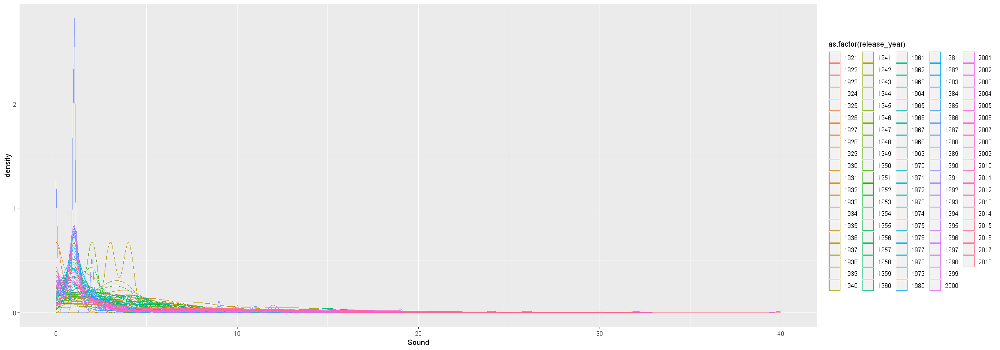

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


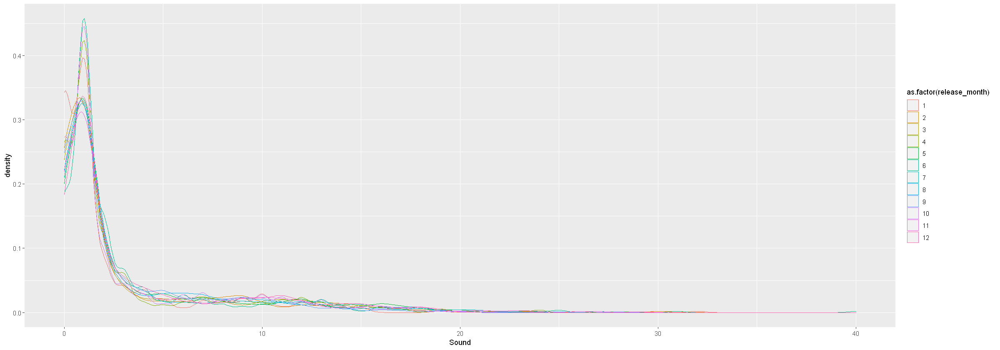

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


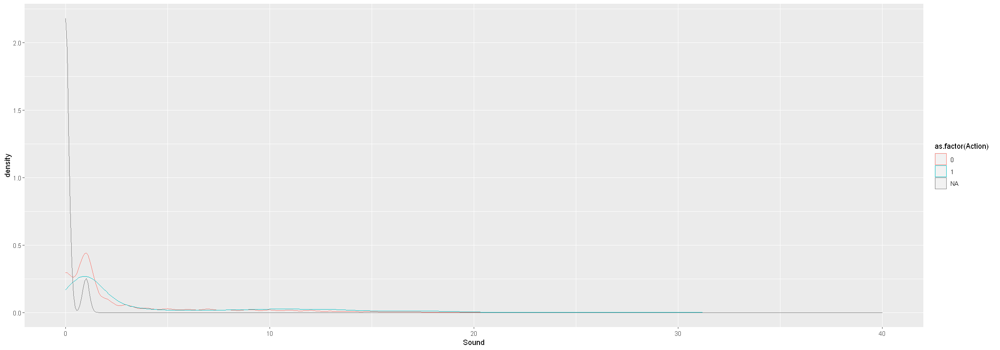

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


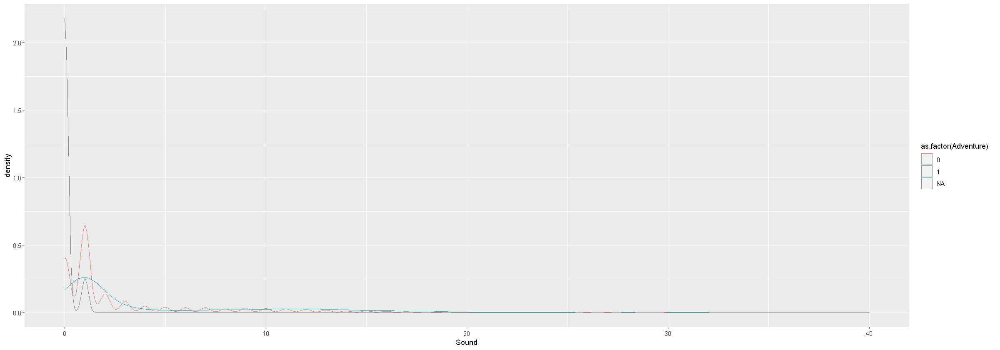

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


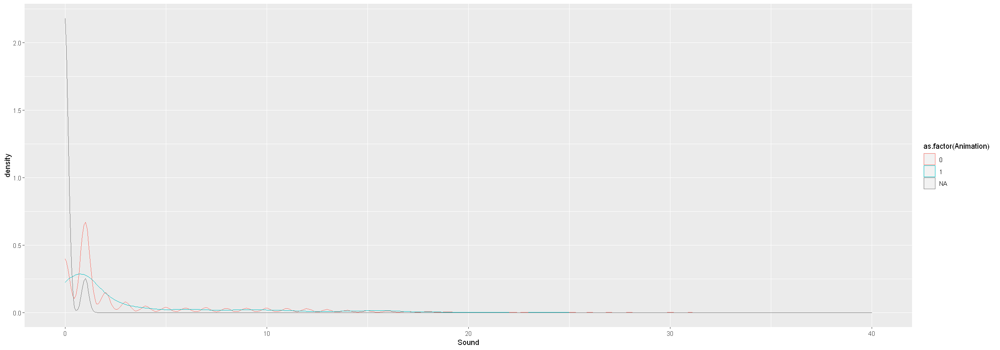

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


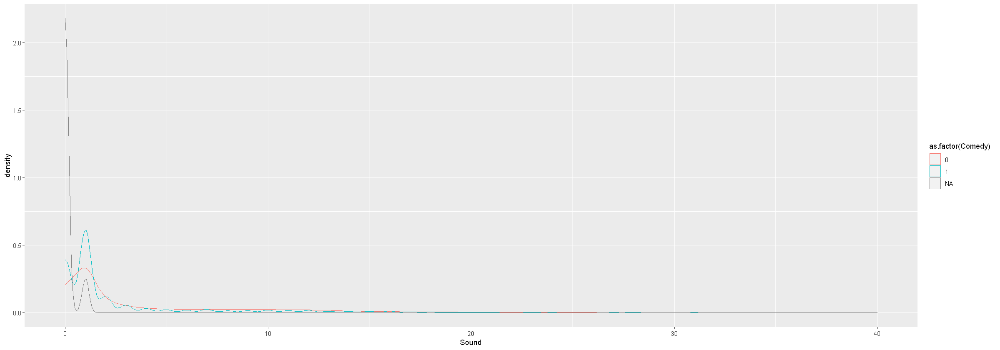

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


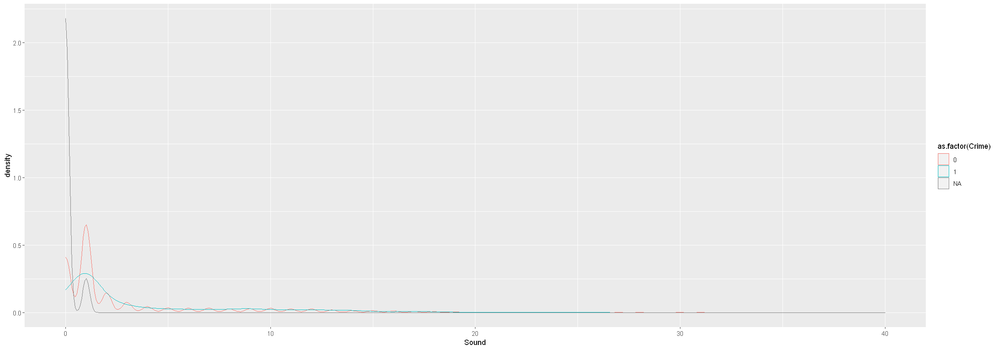

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


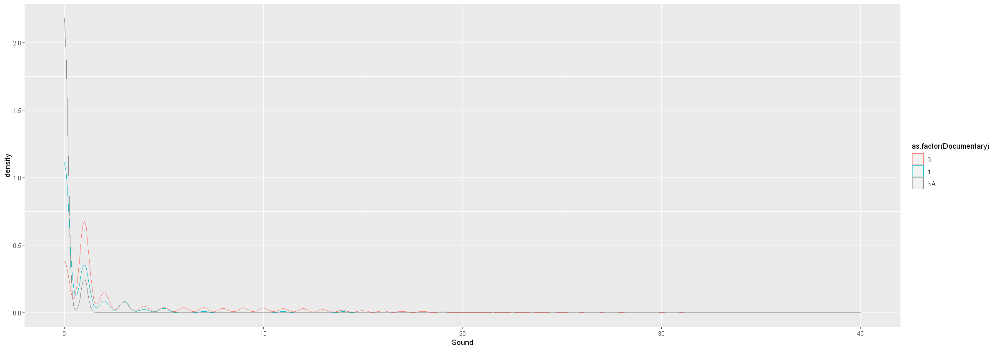

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


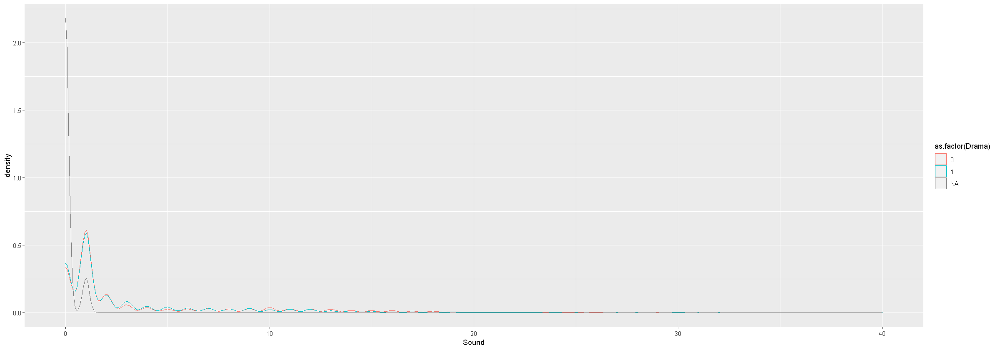

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


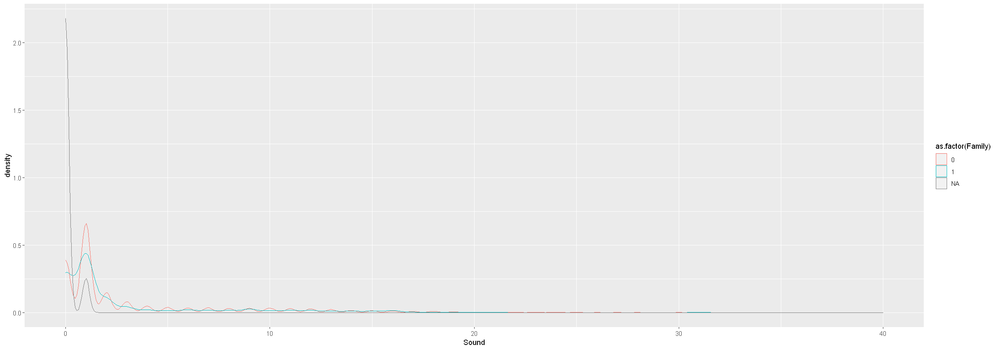

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


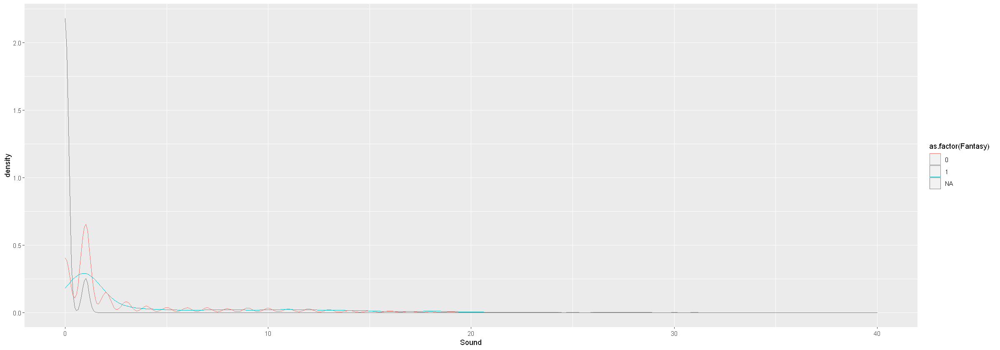

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


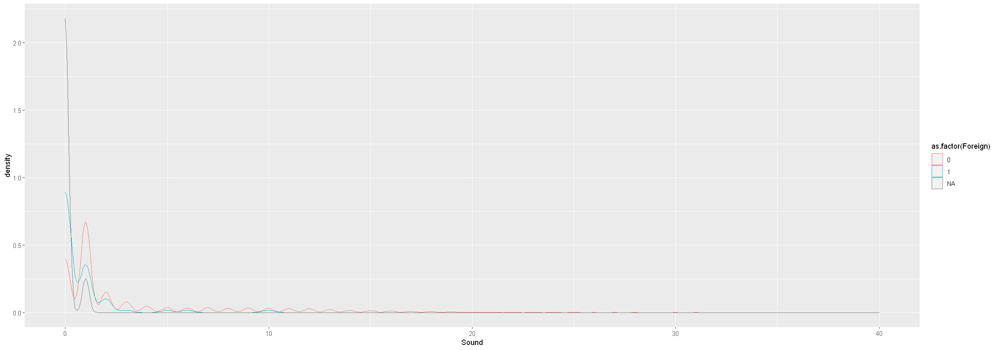

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


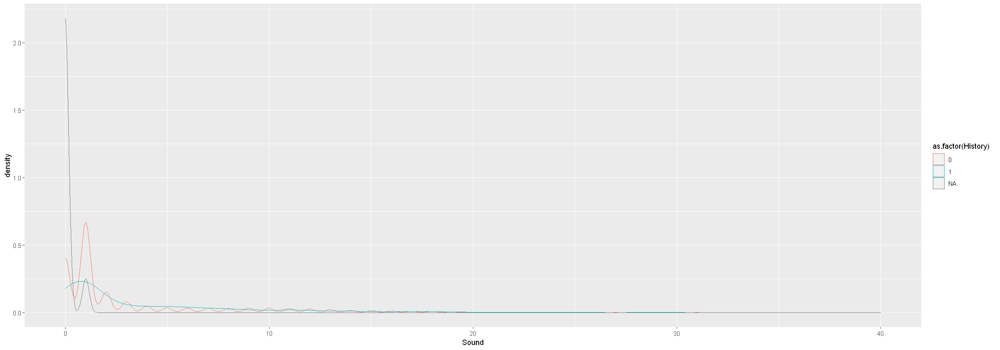

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


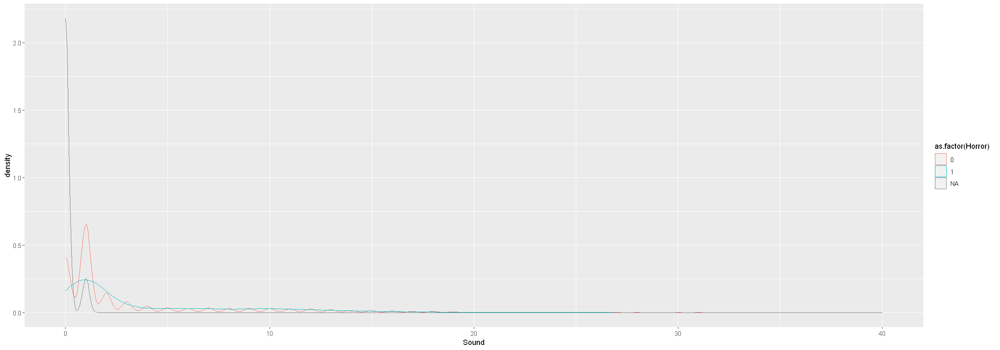

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


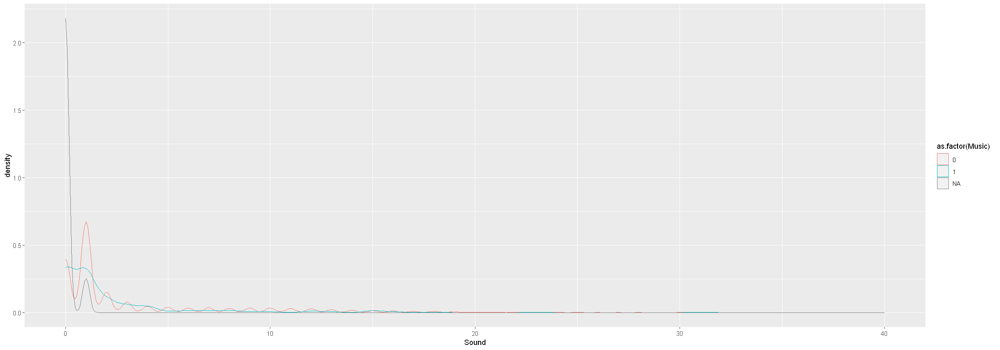

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


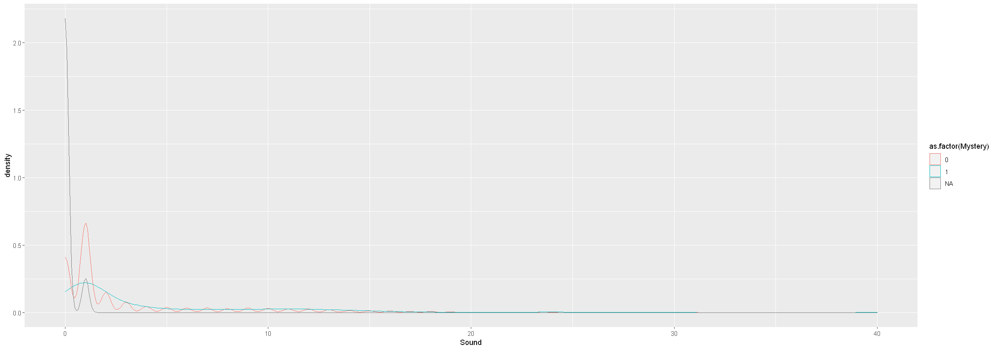

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


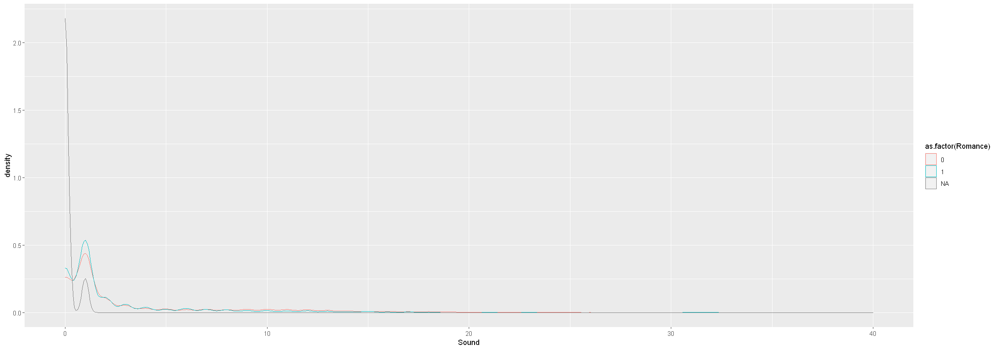

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


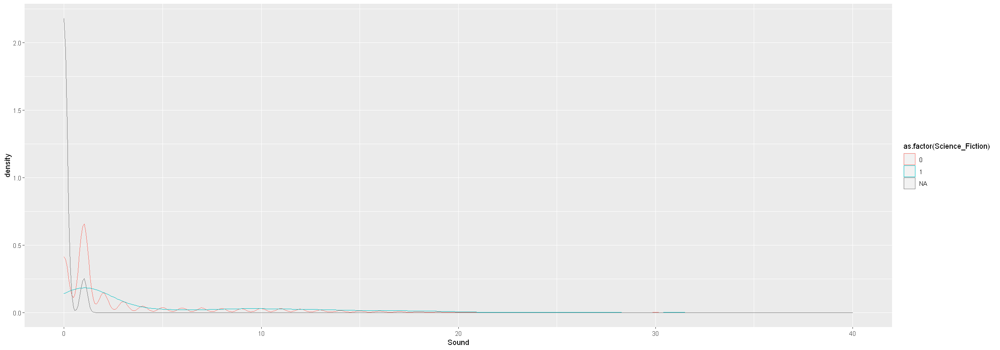

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


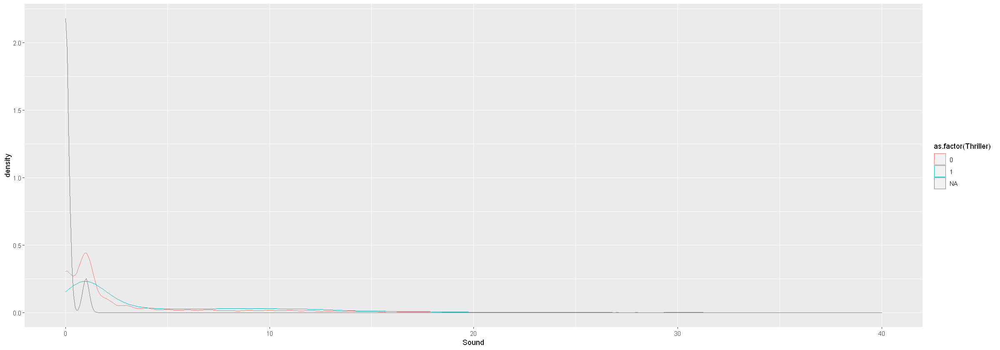

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


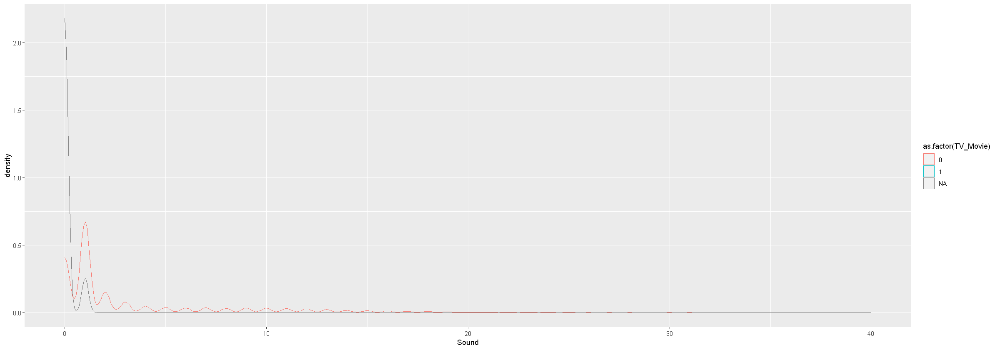

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


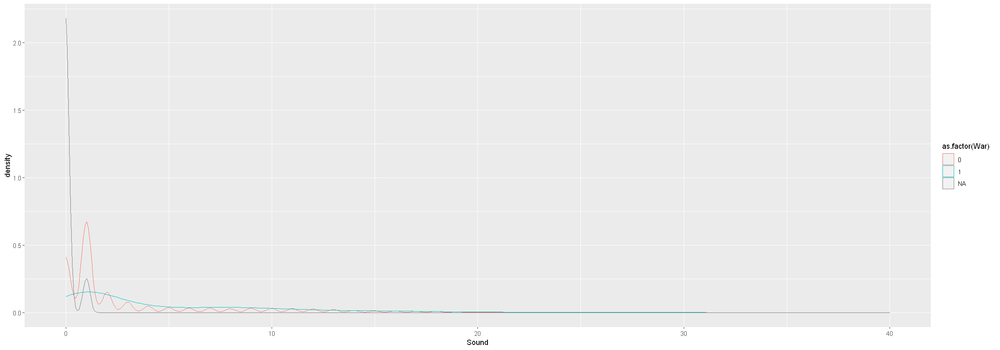

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


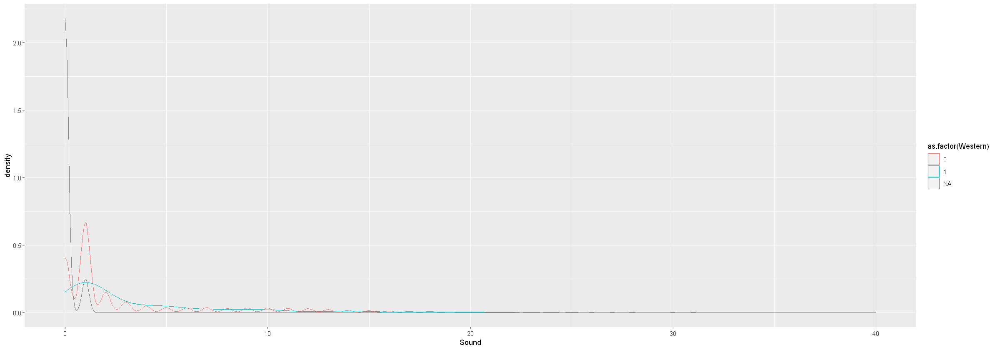

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

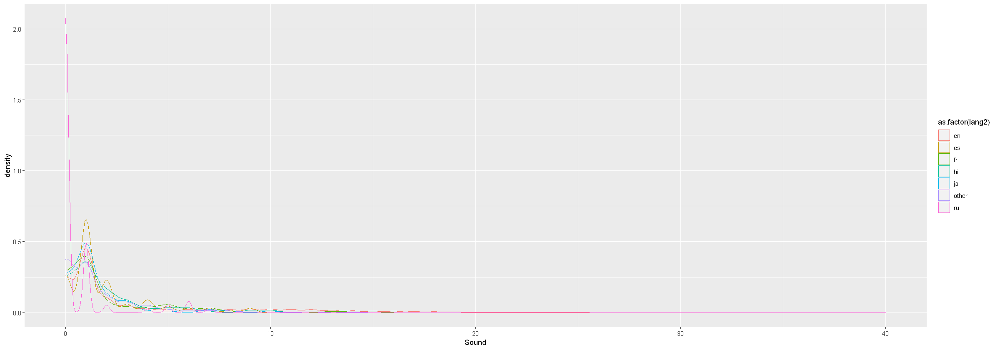

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

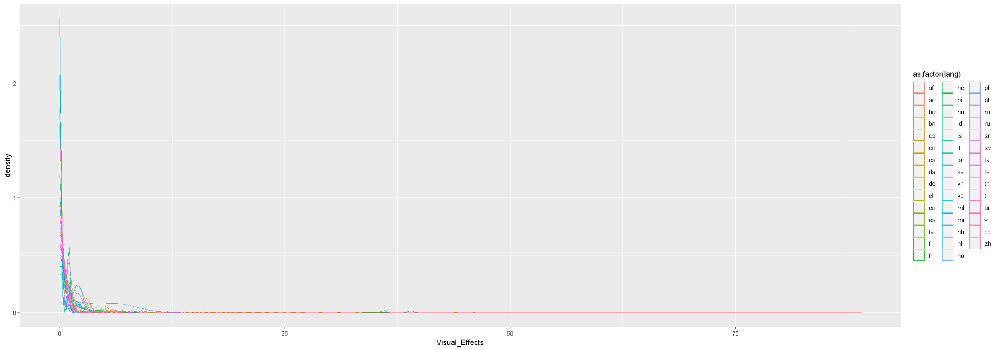

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


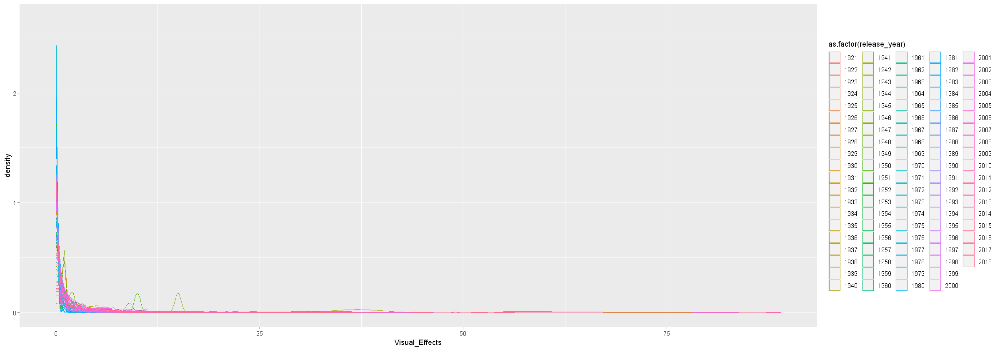

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


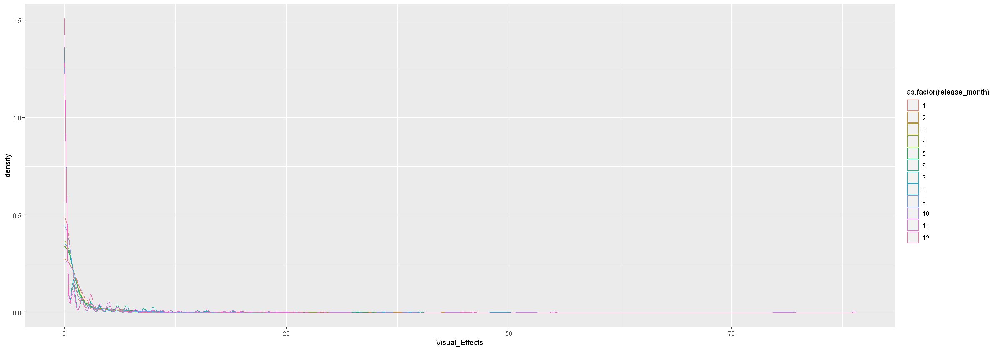

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


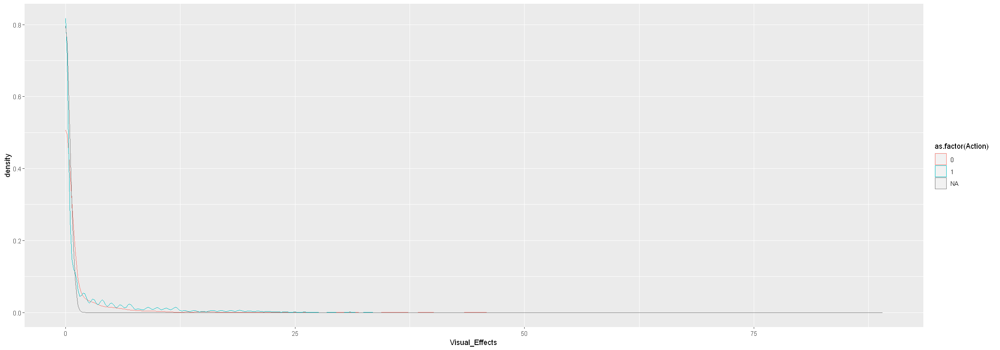

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


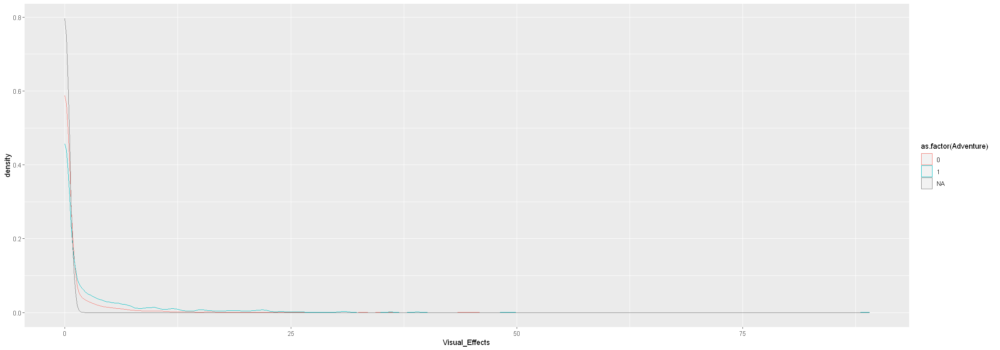

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


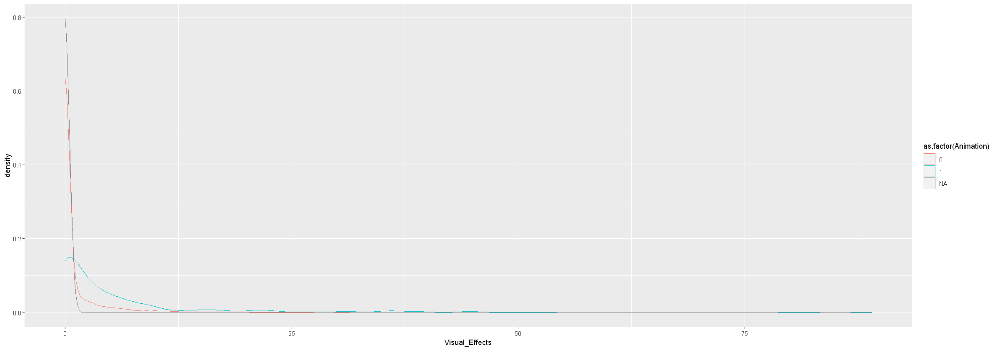

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


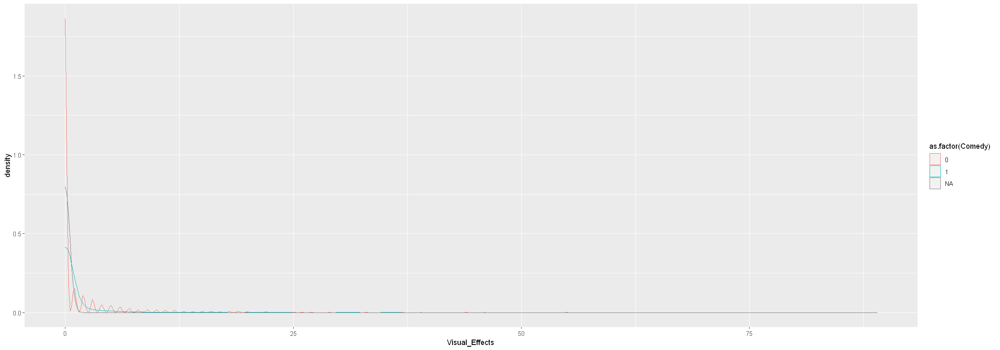

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


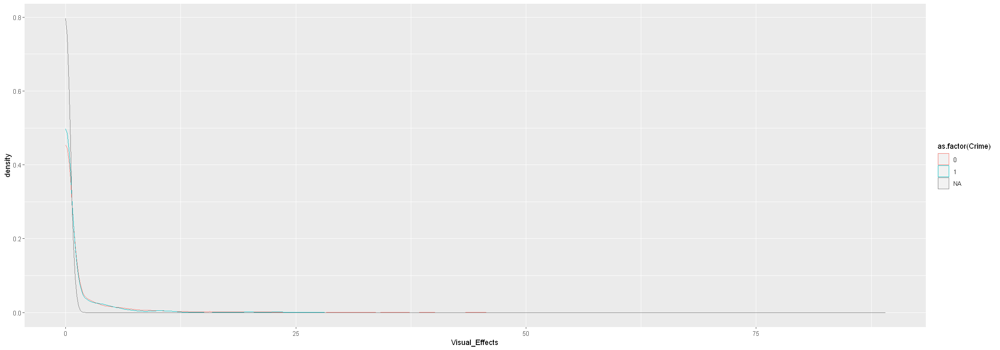

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


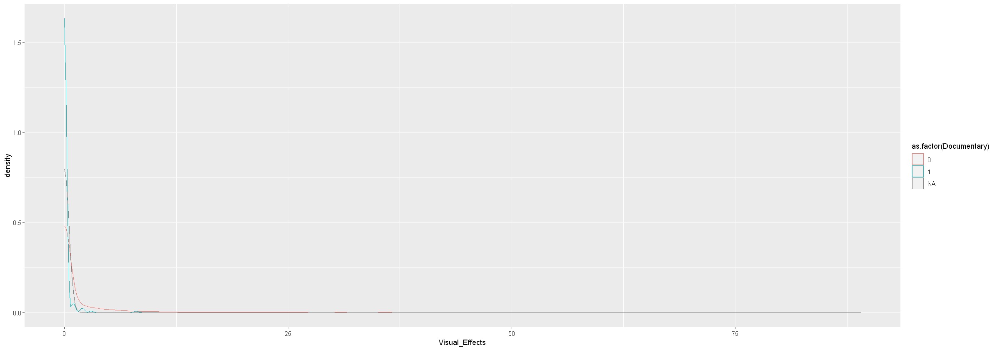

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


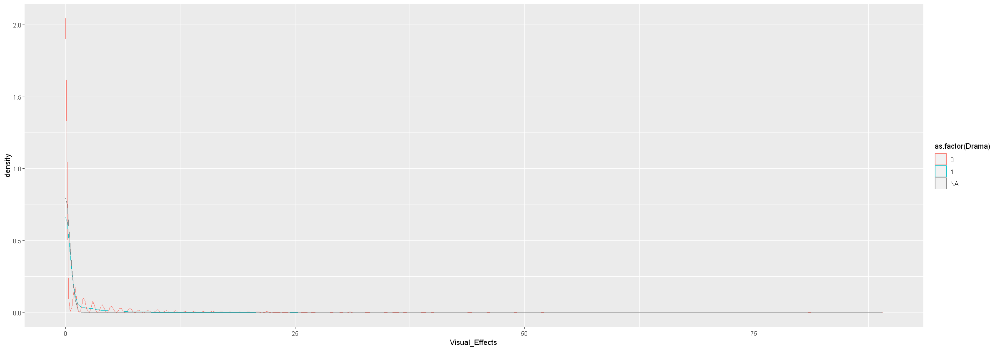

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


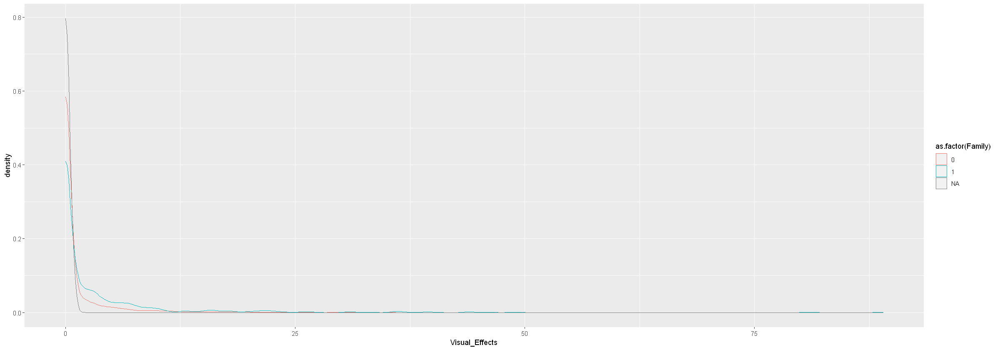

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


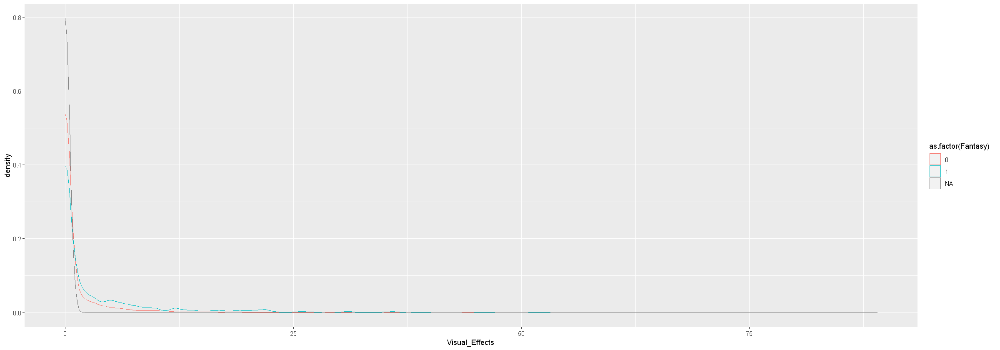

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


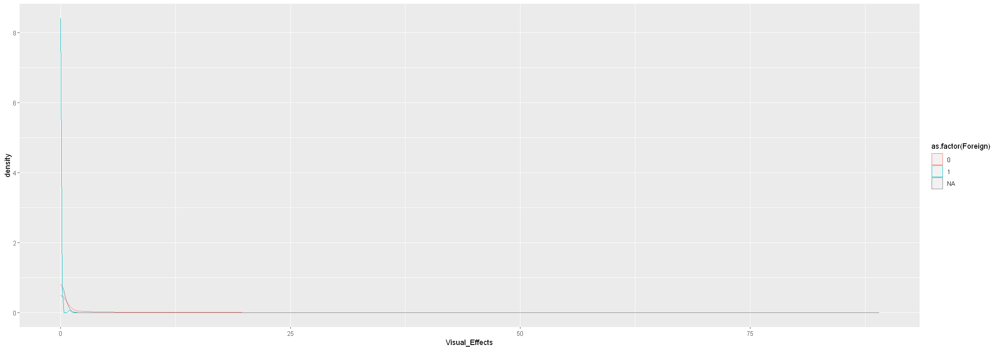

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


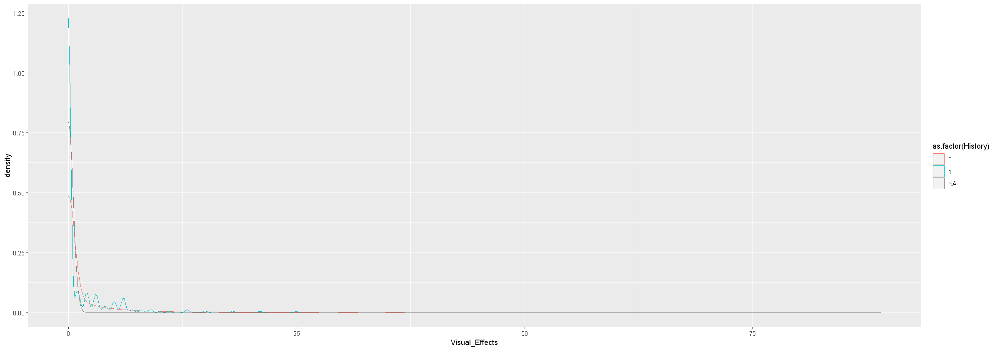

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


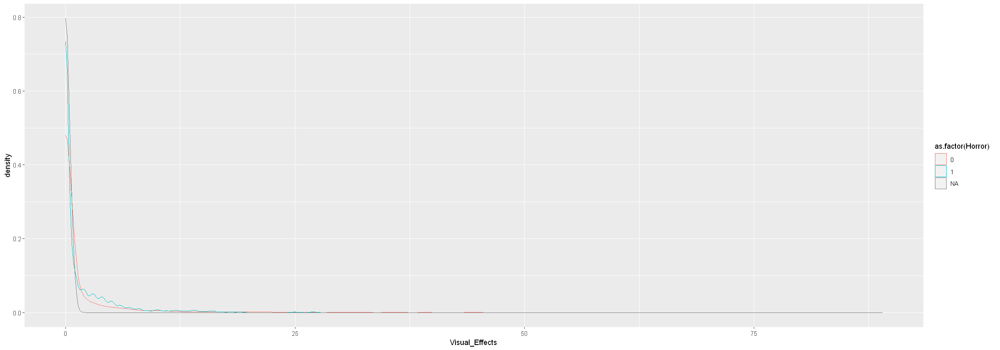

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


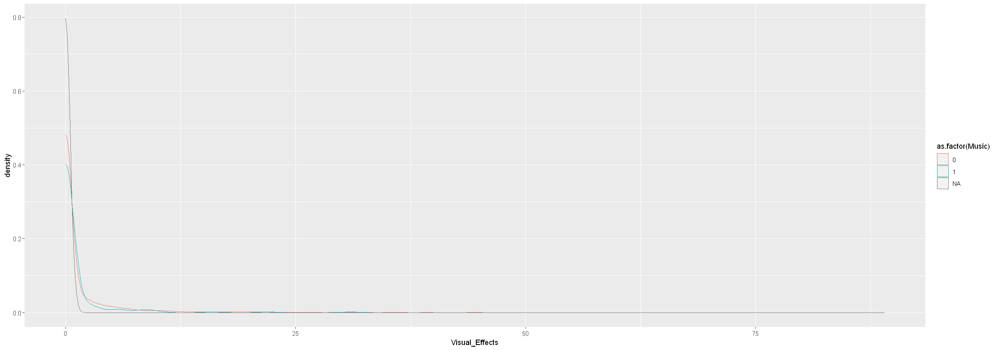

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


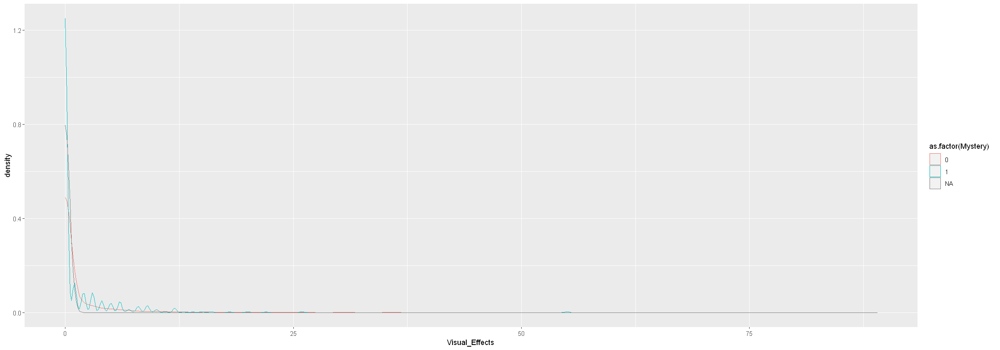

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


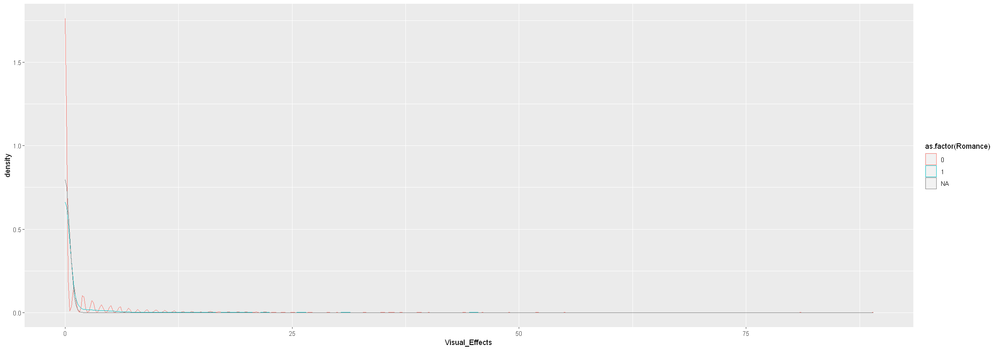

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


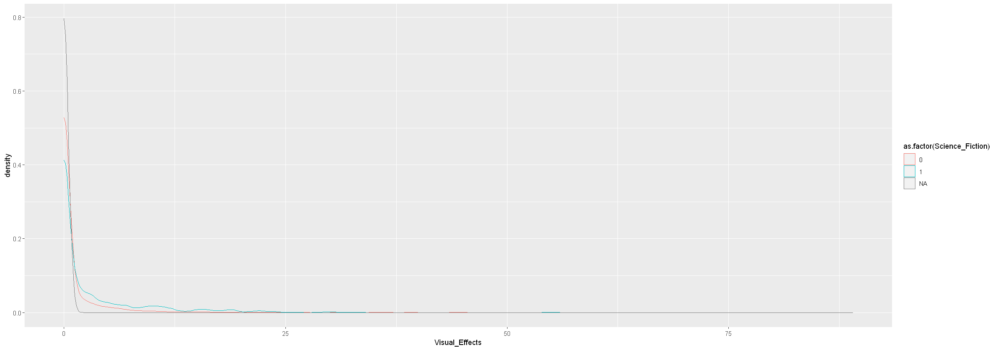

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


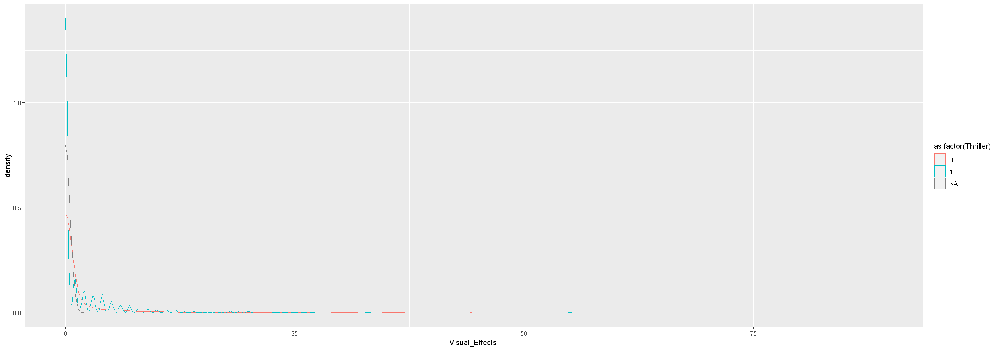

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


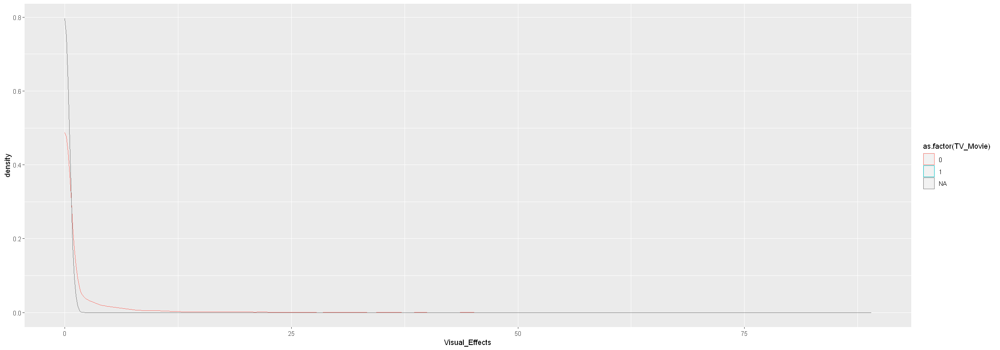

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


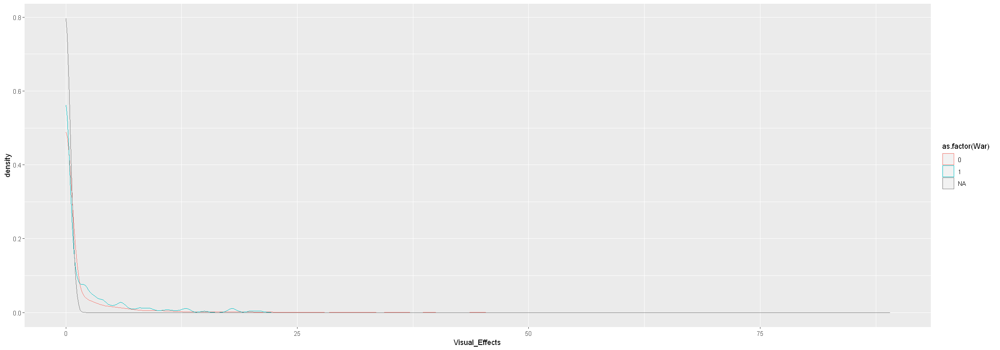

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


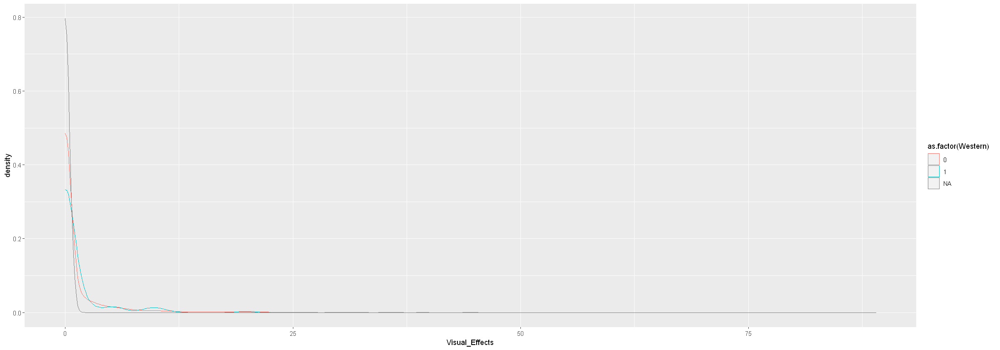

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missin

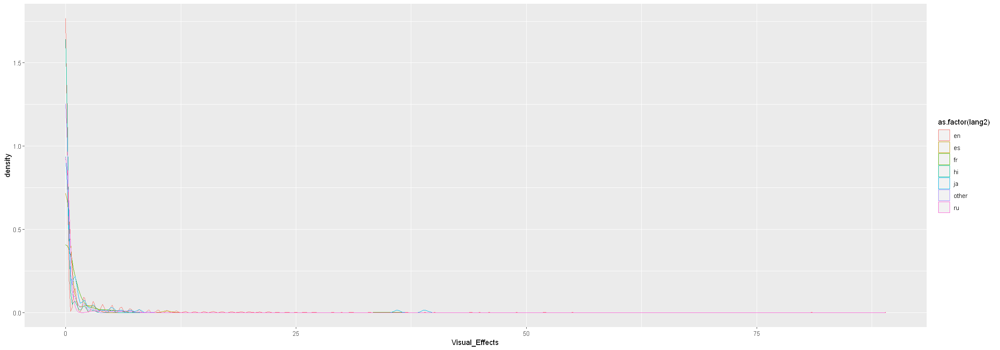

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning

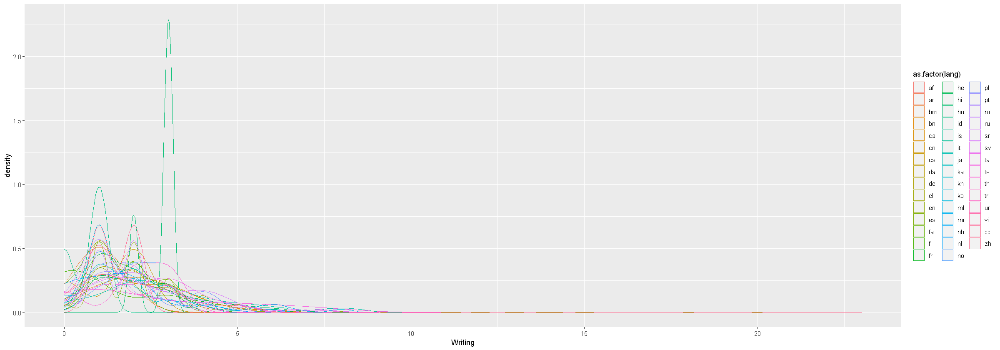

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


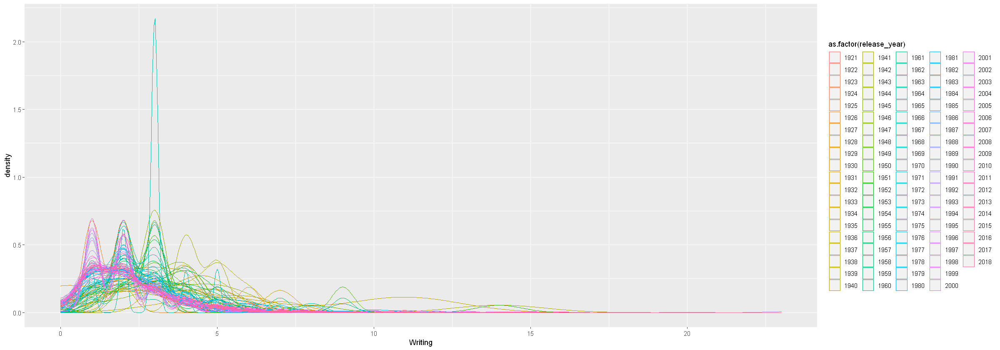

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


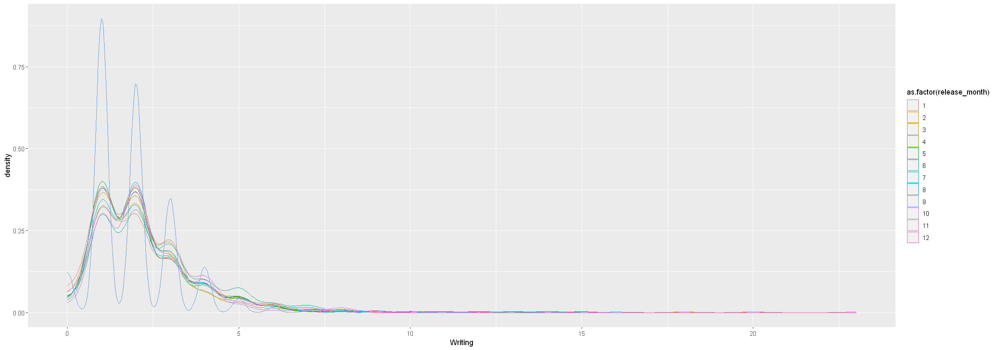

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


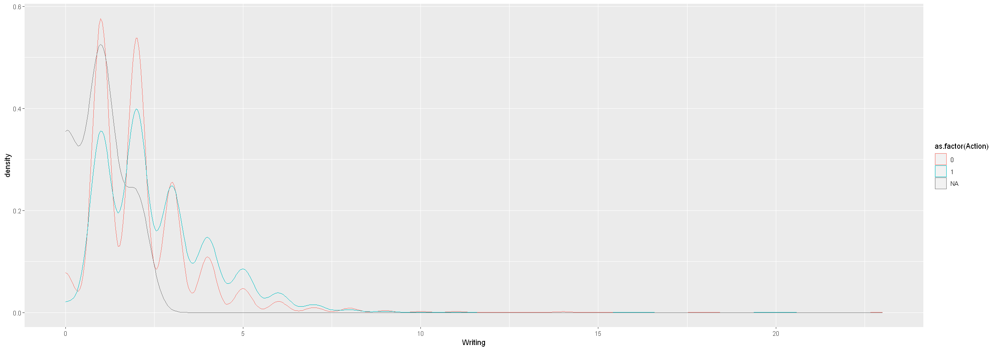

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


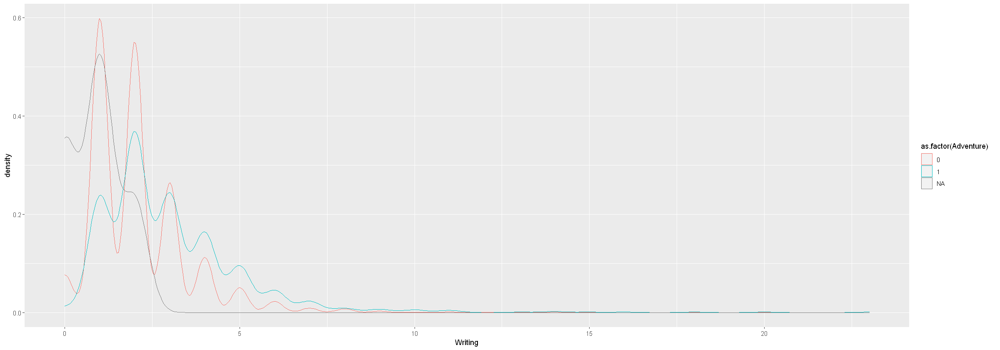

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


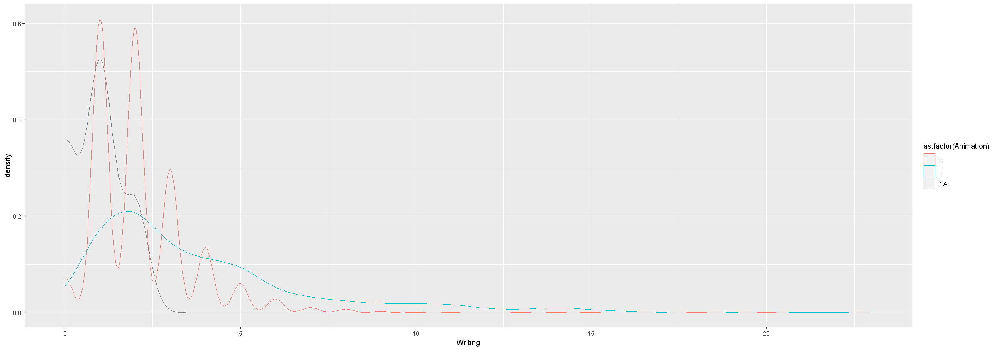

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


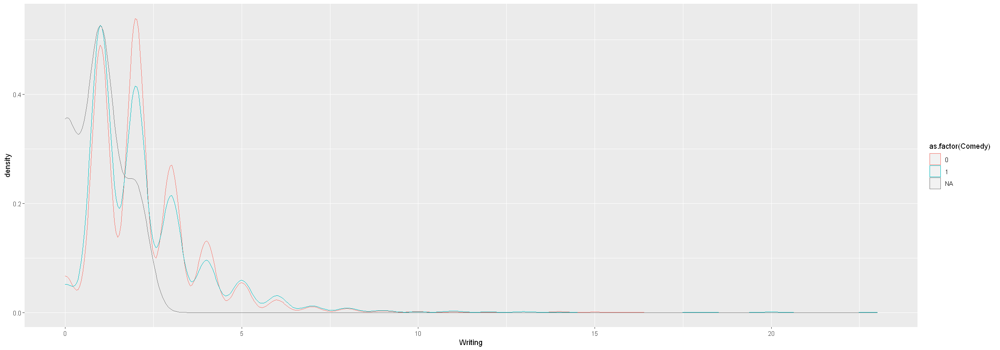

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


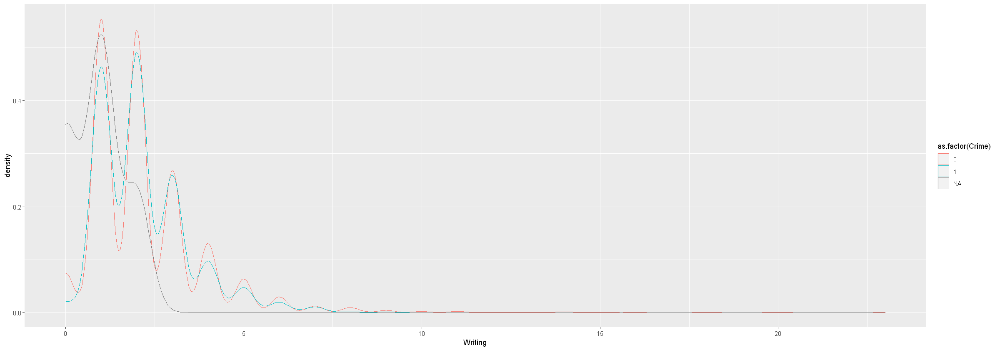

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


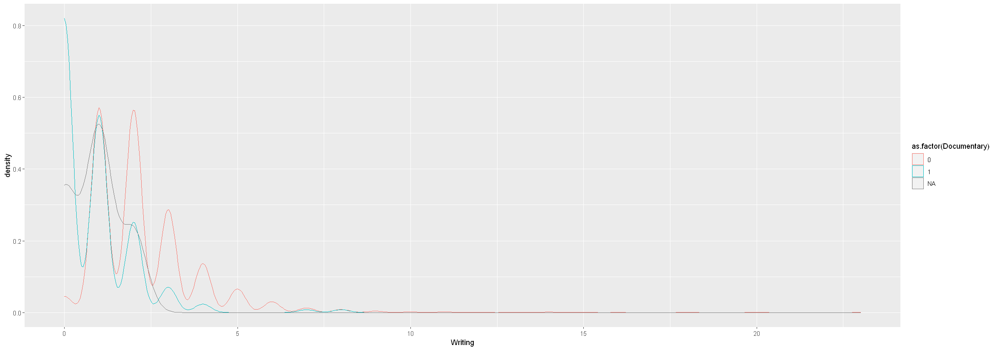

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


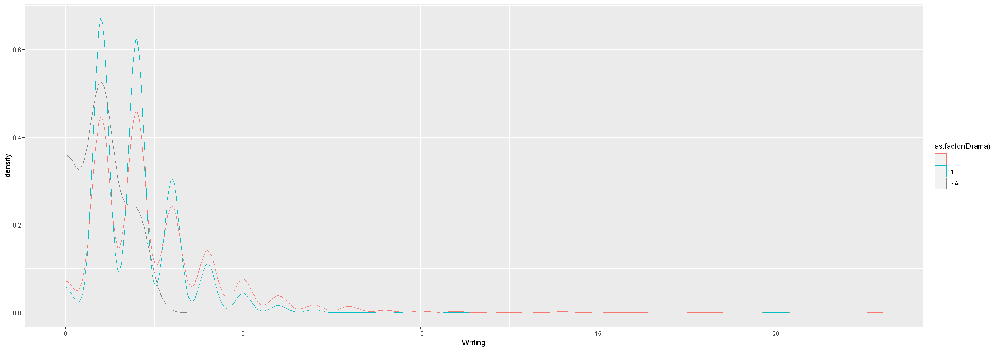

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


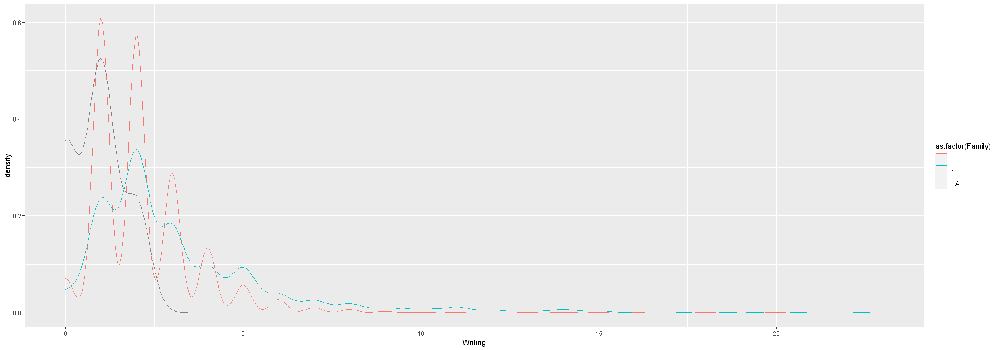

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


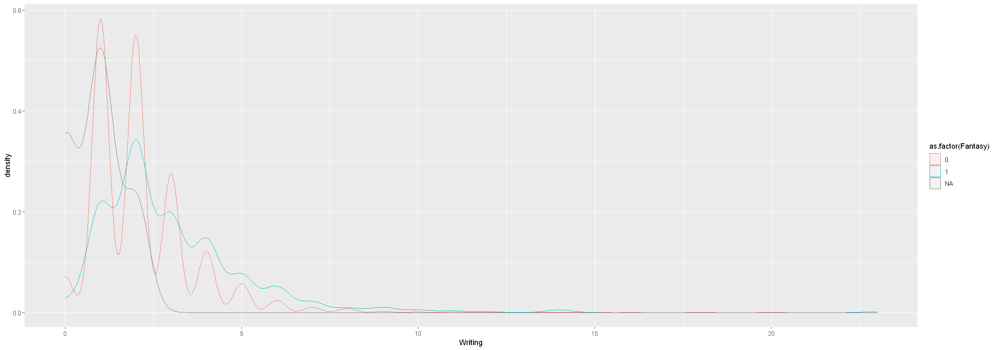

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


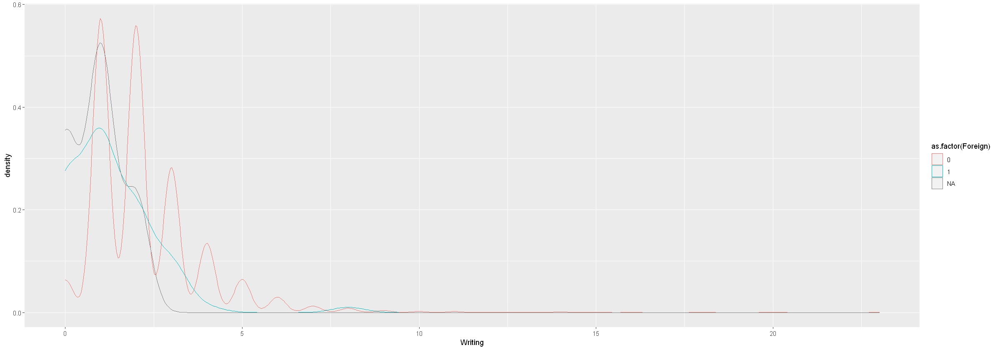

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


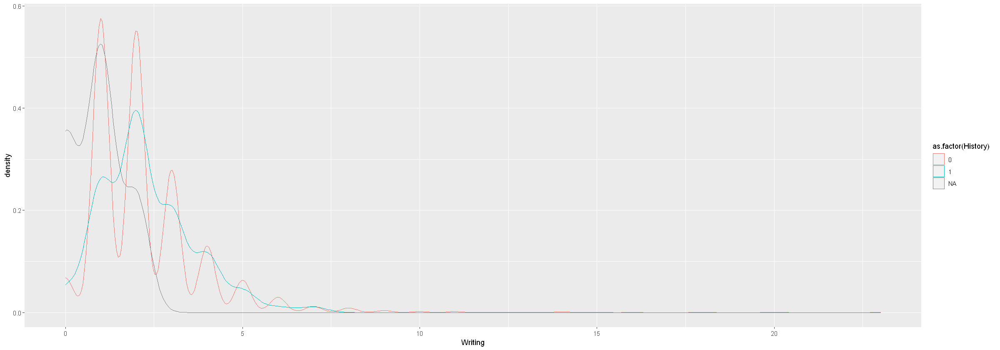

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


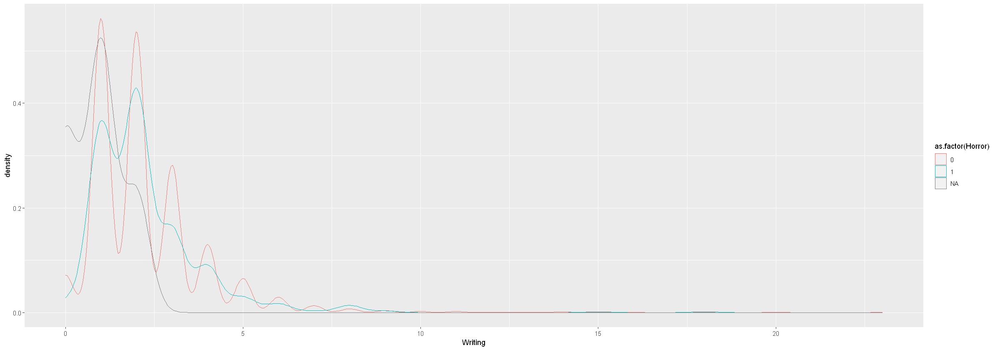

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


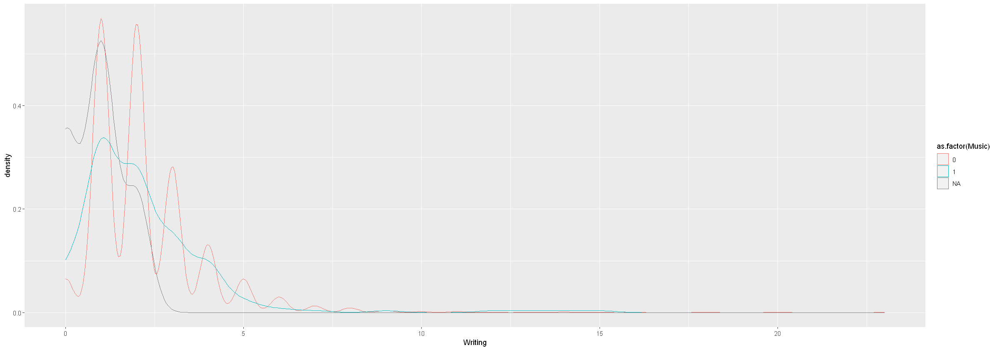

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


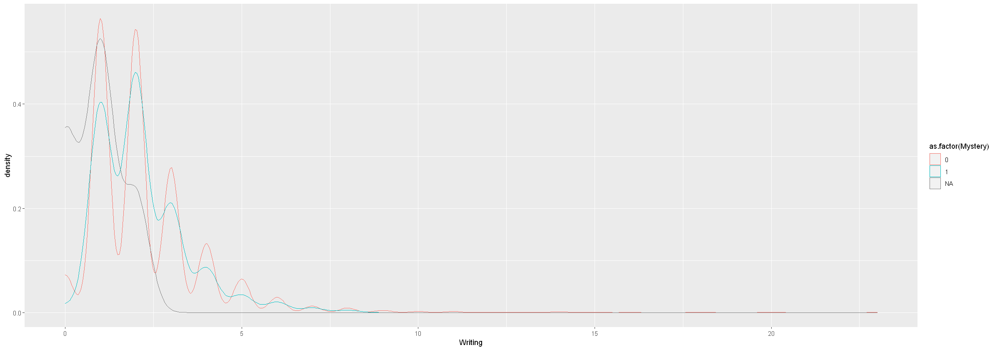

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


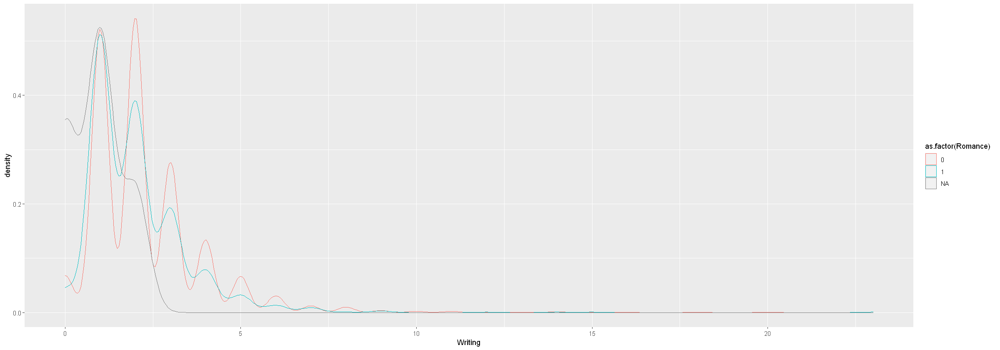

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


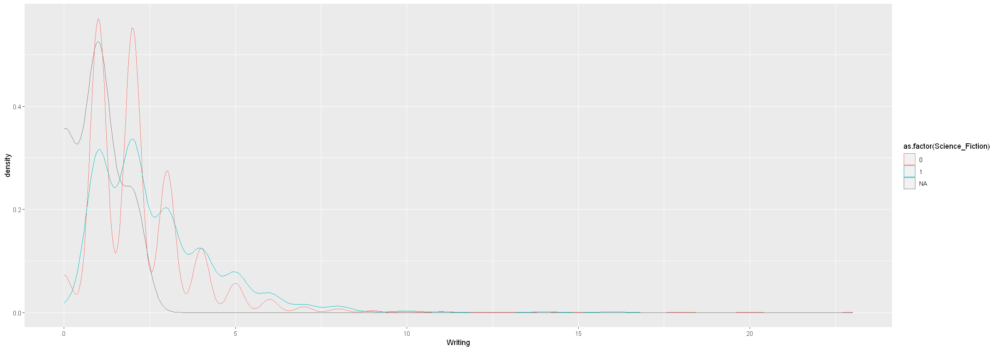

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


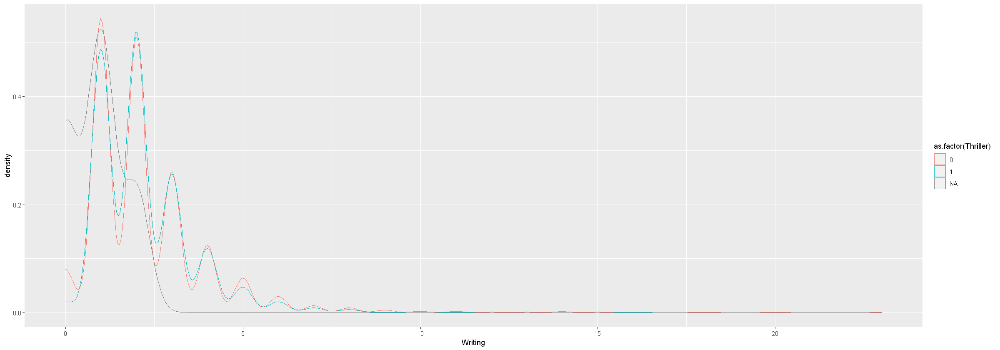

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


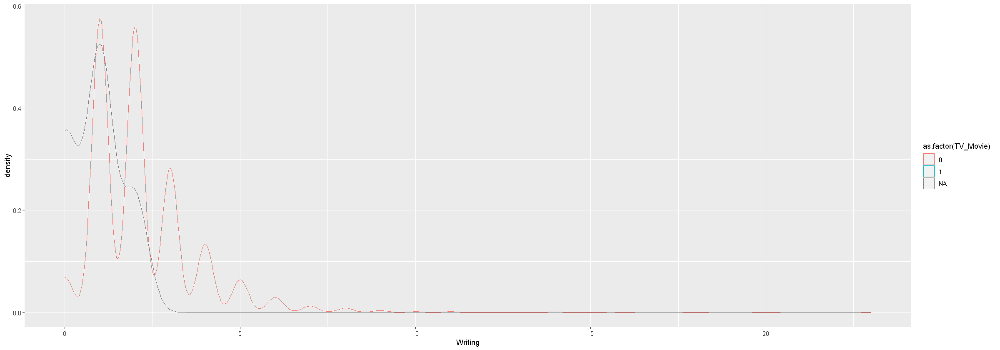

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


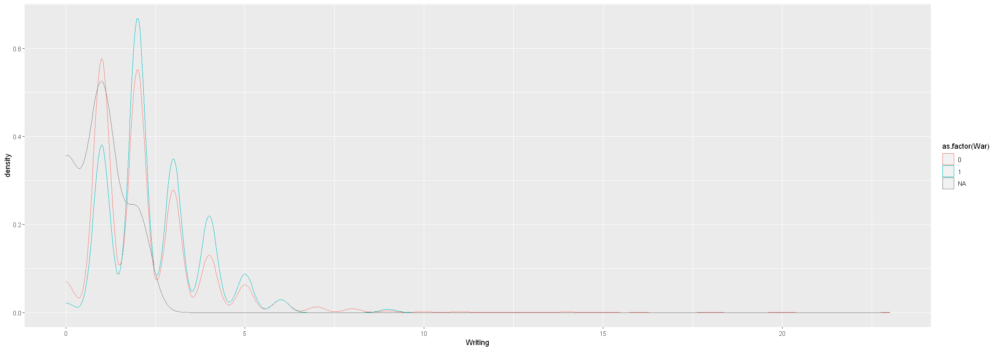

Warning message:
"Removed 38 rows containing non-finite values (stat_density)."


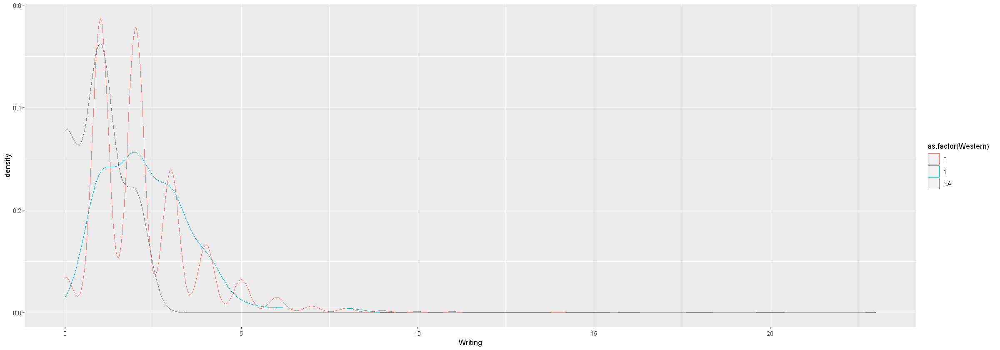

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-miss

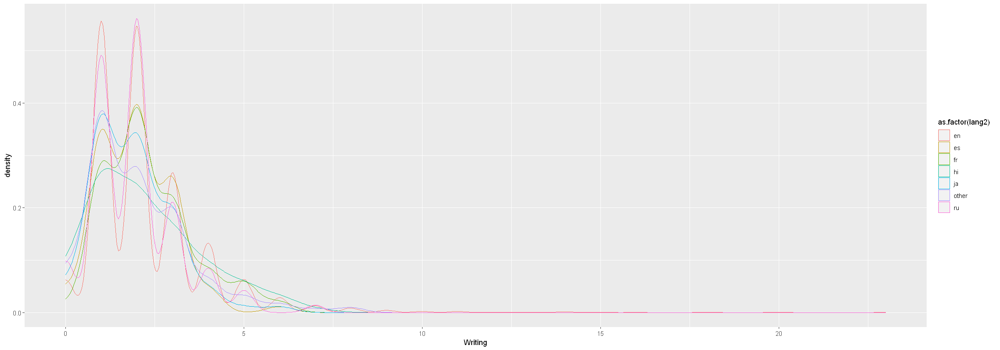

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(

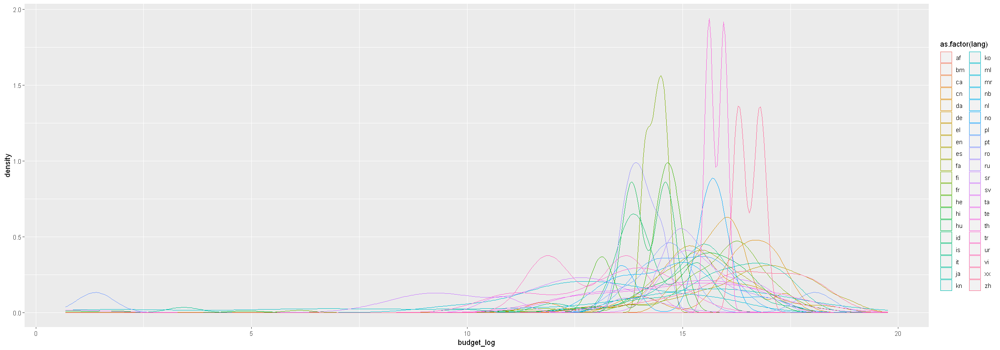

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


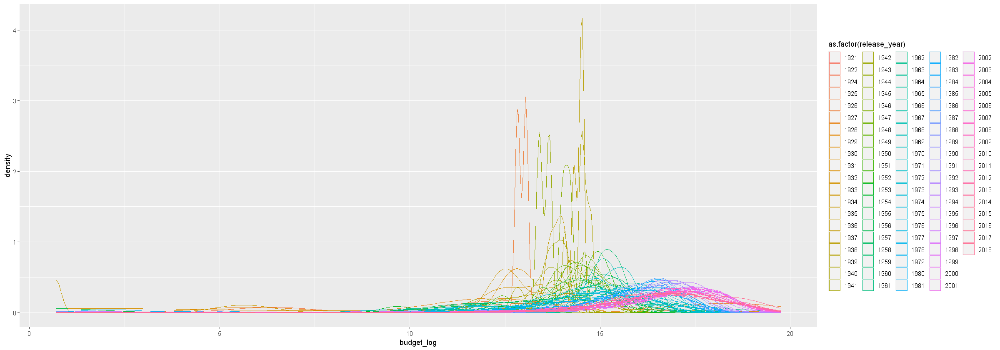

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


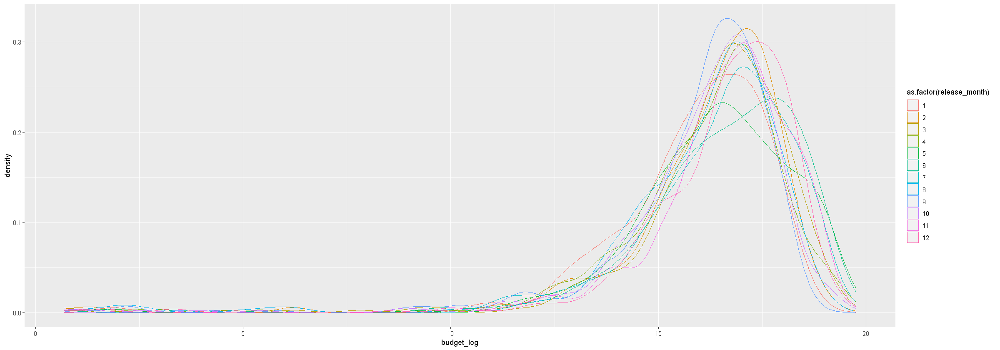

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


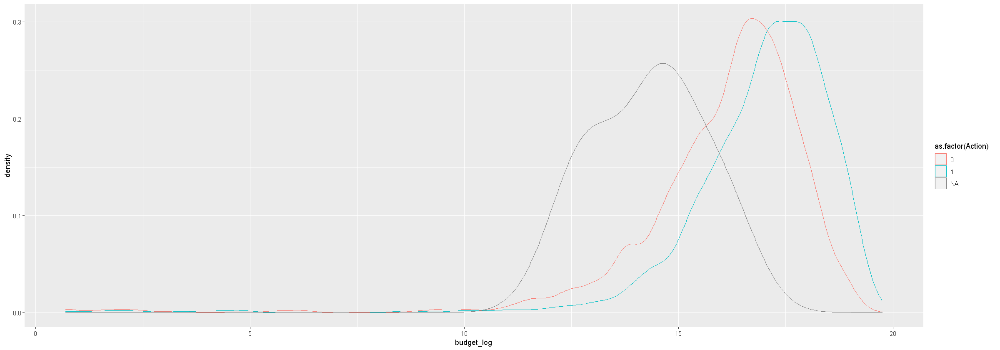

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


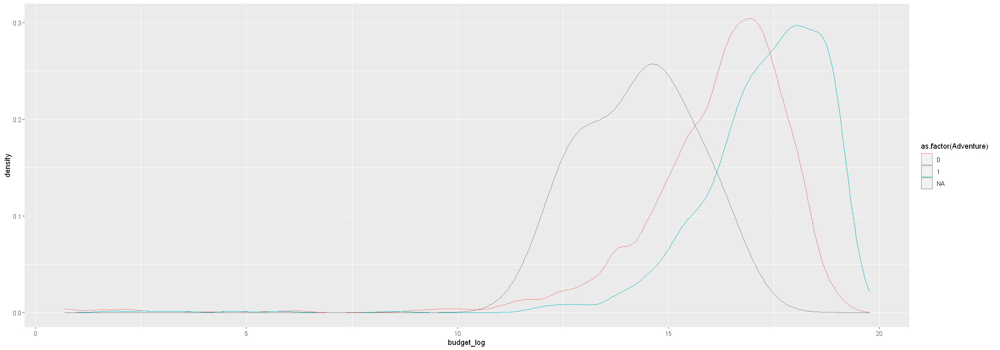

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


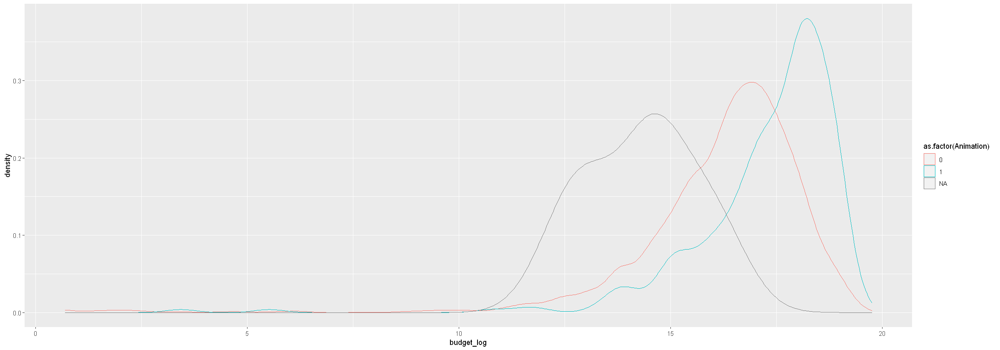

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


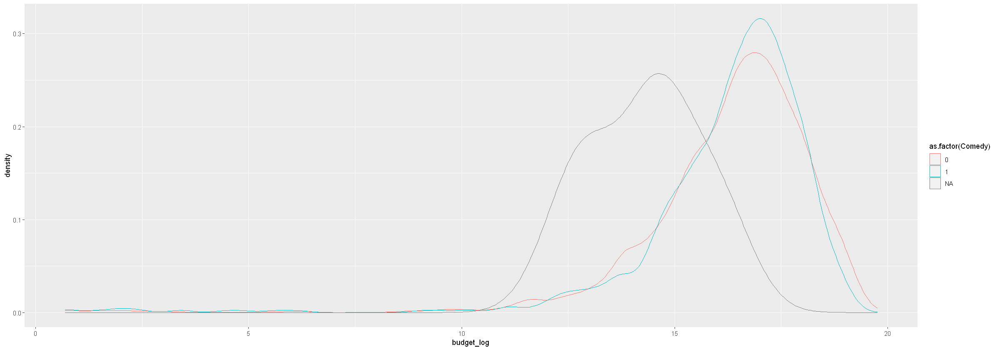

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


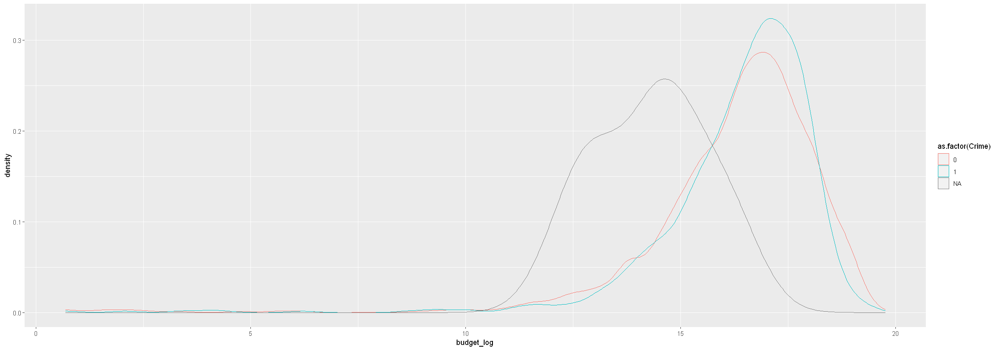

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


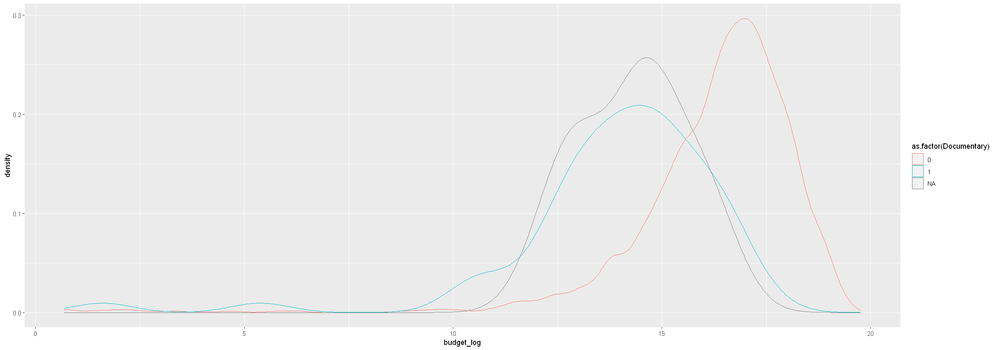

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


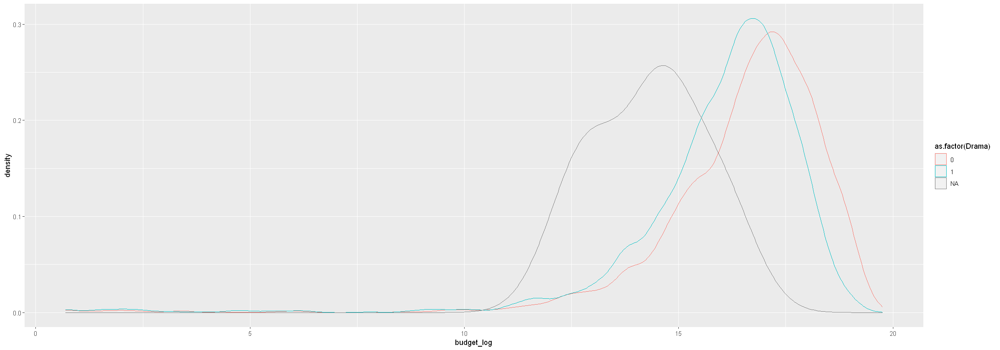

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


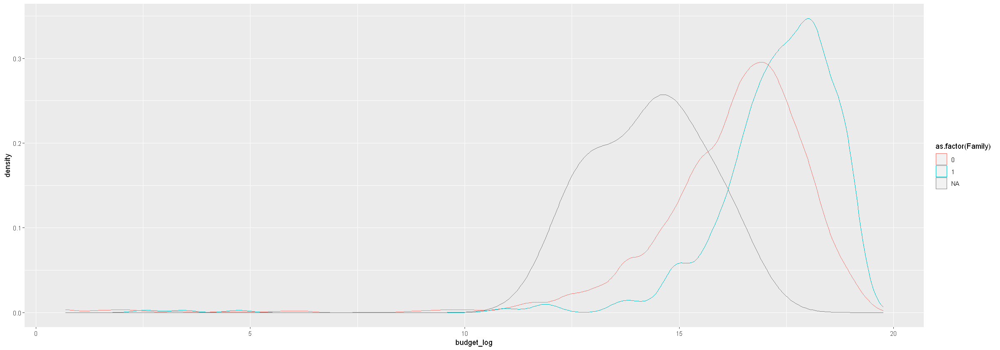

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


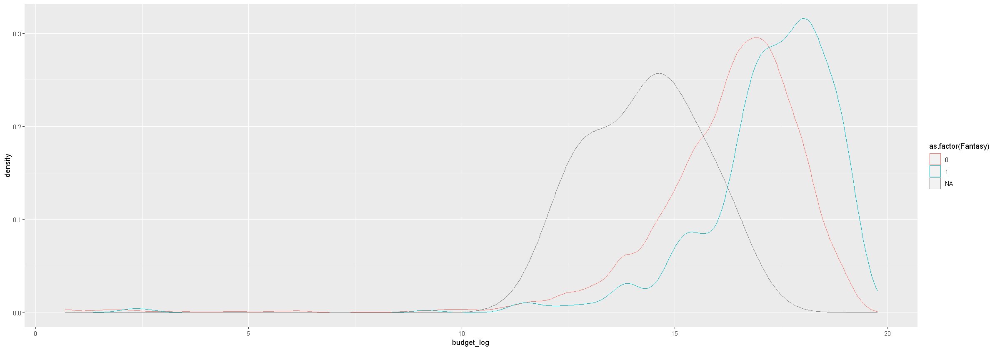

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


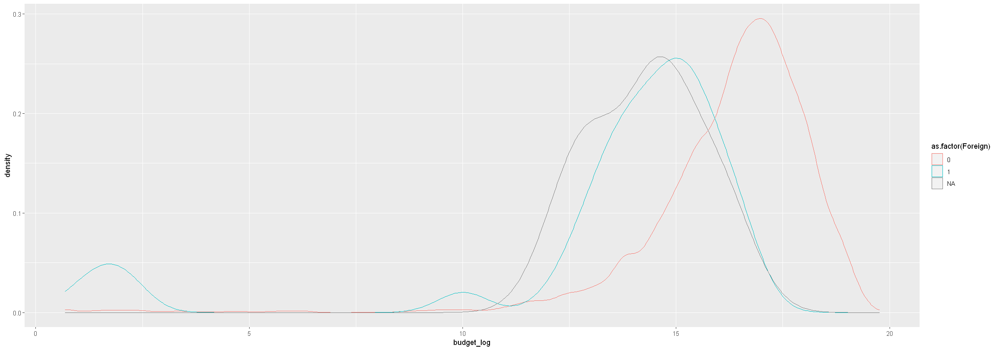

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


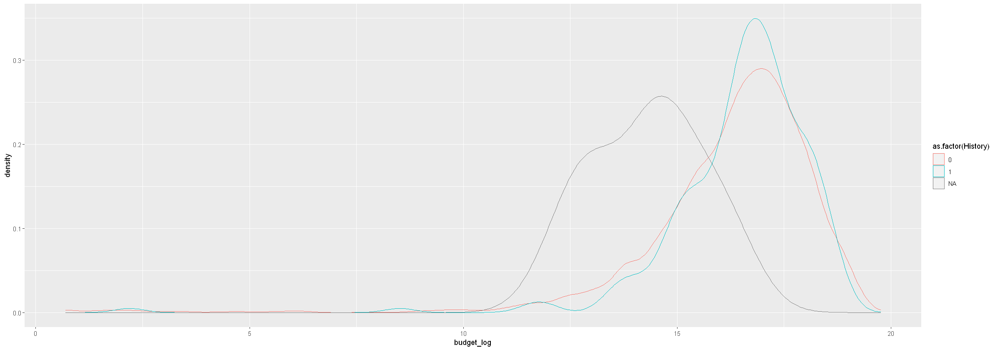

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


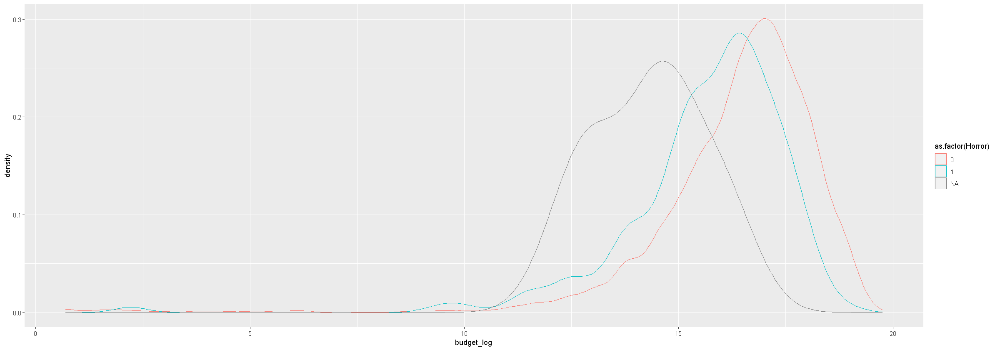

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


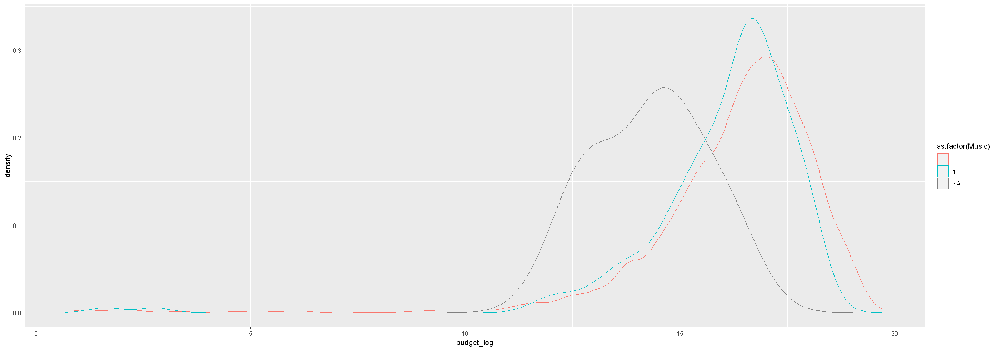

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


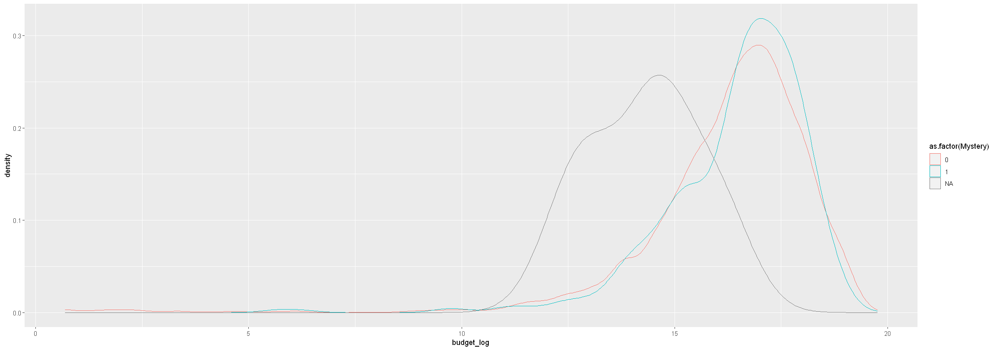

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


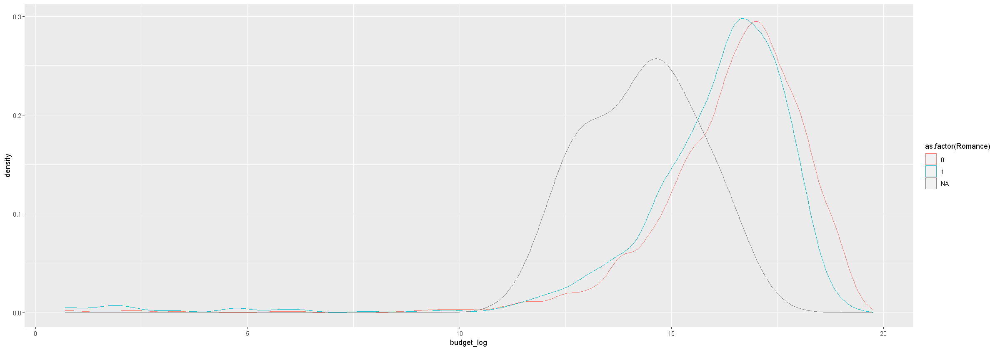

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


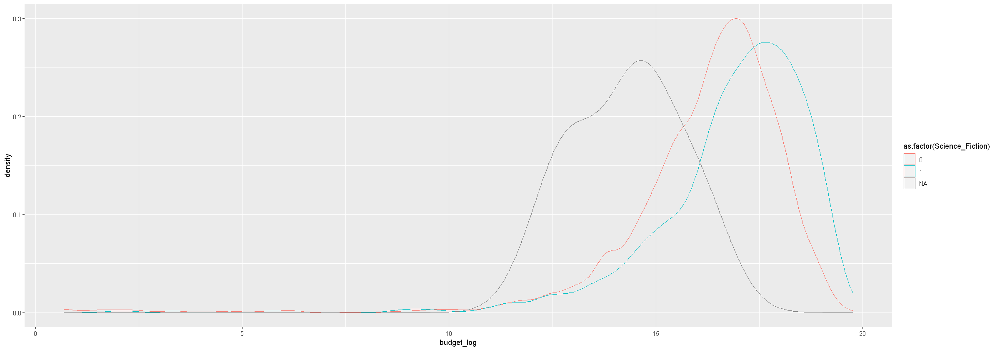

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


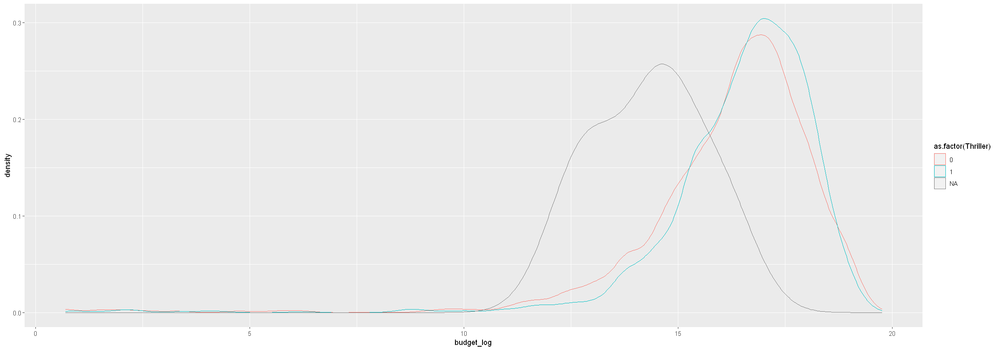

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


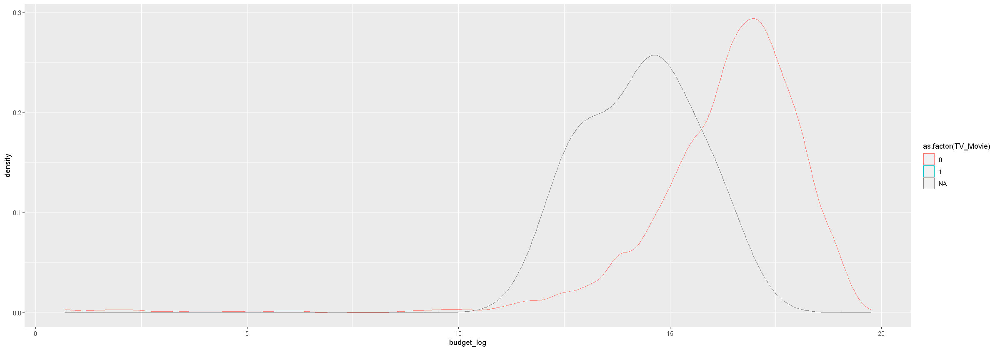

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


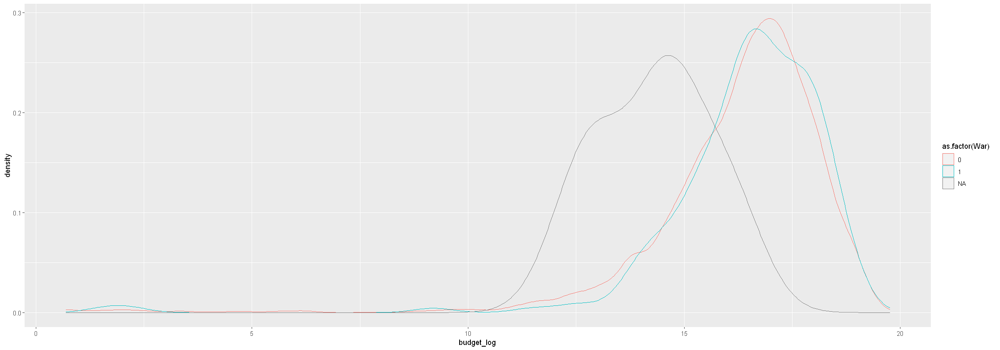

Warning message:
"Removed 2023 rows containing non-finite values (stat_density)."


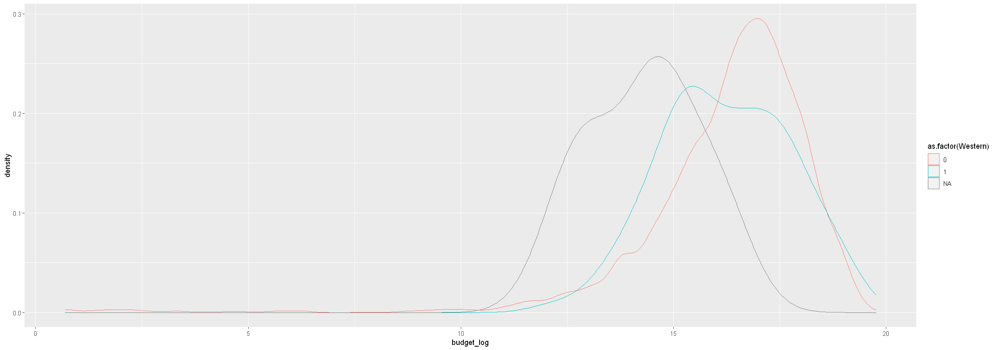

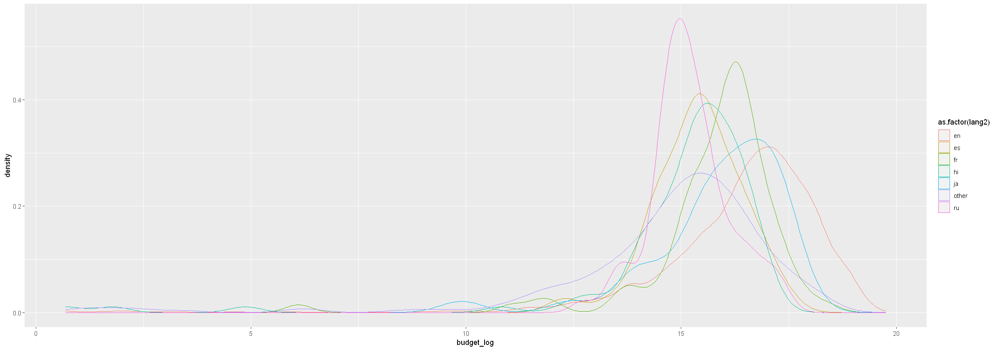

In [21]:
for (n in numlst){
    for (s in catlst){
            print(ggplot(data = ff, na.rm = TRUE) +
                    geom_density(aes(.data[[n]], group=as.factor(.data[[s]]), color=as.factor(.data[[s]]))))
    }
}

notes: 
budget_log - lang2 --> more budget for en 
budget_log - lang2 --> more budget for not genre_foreign 
popularity - lang2 --> ru, fr less popular
popularity - lang2 --> en is more popular
popularity - genre_foreign --> genre_foreign is less popular
runtime - lang2 --> hi has longer runtime 
runtime - genre_animation --> genre_animation has shorter runtime
runtime - genre_history --> genre_history has longer runtime

#### 3 - Correlation table

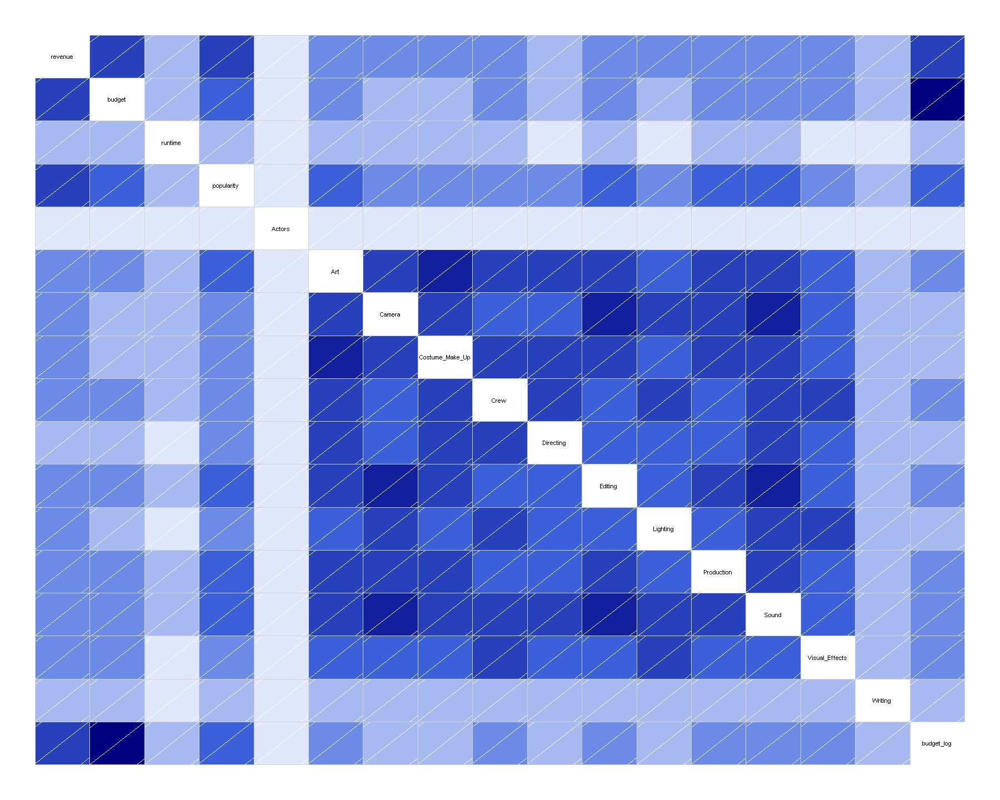

In [22]:
options(repr.plot.width = 15, repr.plot.height = 12)
ffcormat <- cor(ff[,c('revenue',numlst)], use = "pairwise.complete.obs", method = "spearman")
corrgram::corrgram(ffcormat)

budget and popularity have the strongest correlation with the outcome
also there is strong correlation between the number of crew members (but actors and writing)

#### 4 - Outcome 

In [23]:
length(ff$revenue)
summary(ff$revenue)
sd(ff$revenue, na.rm = T )

[1] 7399

     Min.   1st Qu.    Median      Mean   3rd Qu.      Max.      NA's 
1.000e+00 2.387e+06 1.681e+07 6.681e+07 6.893e+07 1.520e+09      4398 

[1] 137583193

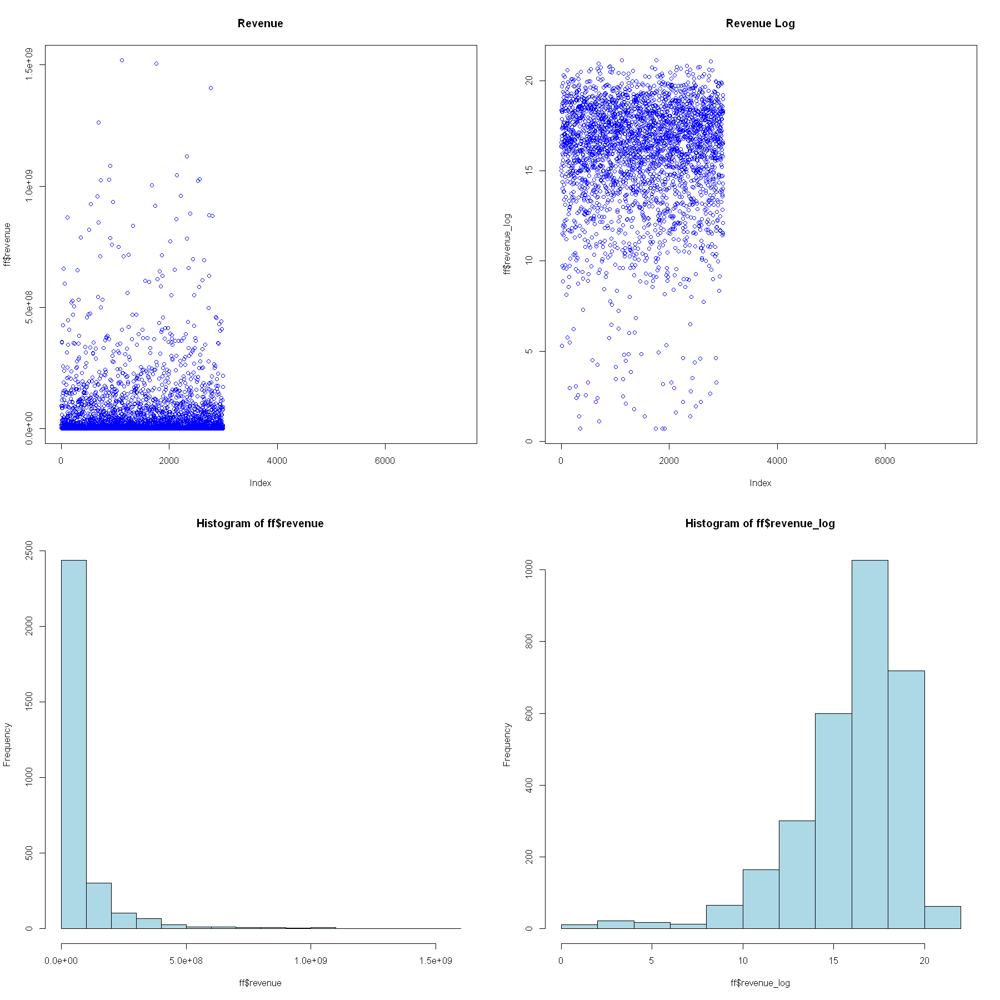

In [24]:
options(repr.plot.width =15, repr.plot.height = 15)
par(mfrow=c(2,2))
plot(ff$revenue, main = 'Revenue', col = 'blue')
plot(ff$revenue_log, main = 'Revenue Log', col = 'blue')
hist(ff$revenue, col = 'lightblue')
hist(ff$revenue_log, col = 'lightblue')


lots of missing values

#### density charts of the outcome

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."
Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


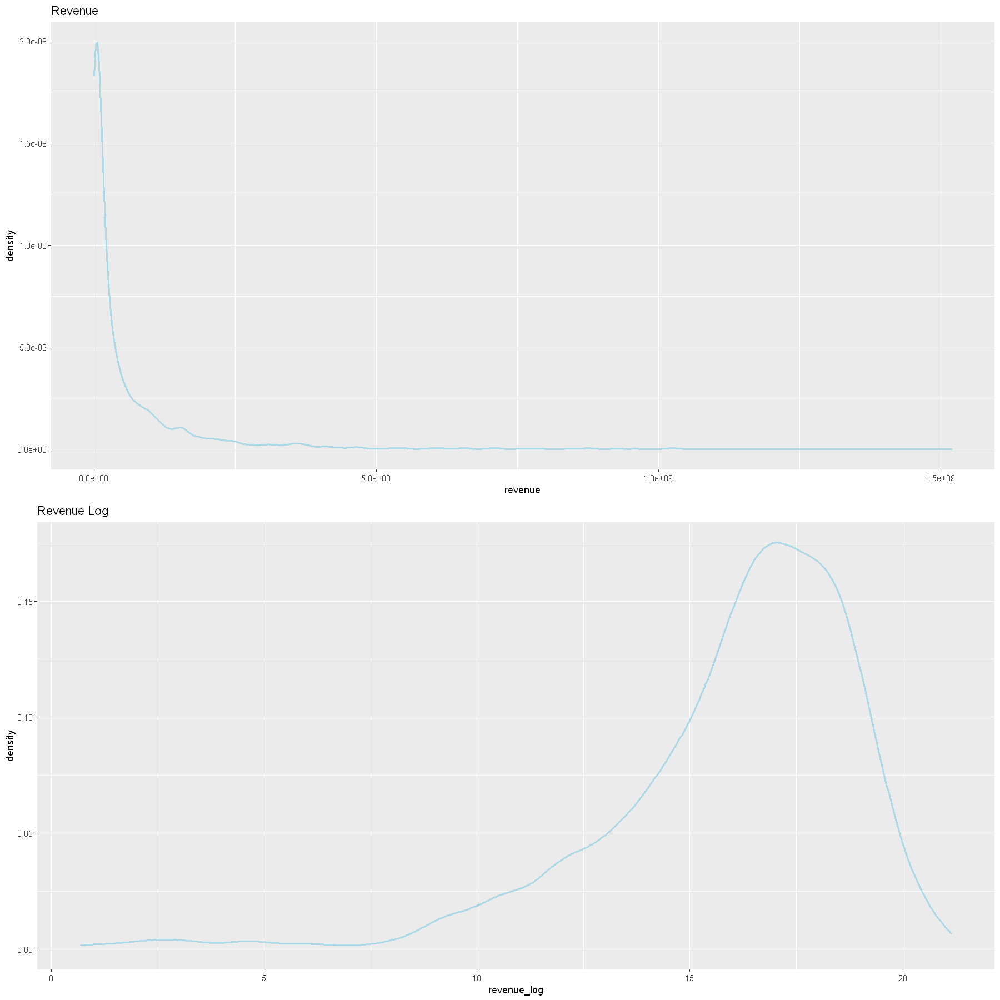

In [25]:
p1 <- ggplot(data = ff) +
            geom_density(aes(revenue), colour = 'light blue', size = 1) + ggtitle("Revenue")
p2 <- ggplot(data = ff) +
            geom_density(aes(revenue_log), colour = 'light blue', size = 1) + ggtitle("Revenue Log")

grid.arrange(p1, p2)    

#### graphs of the outcome against the categorical vars

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to

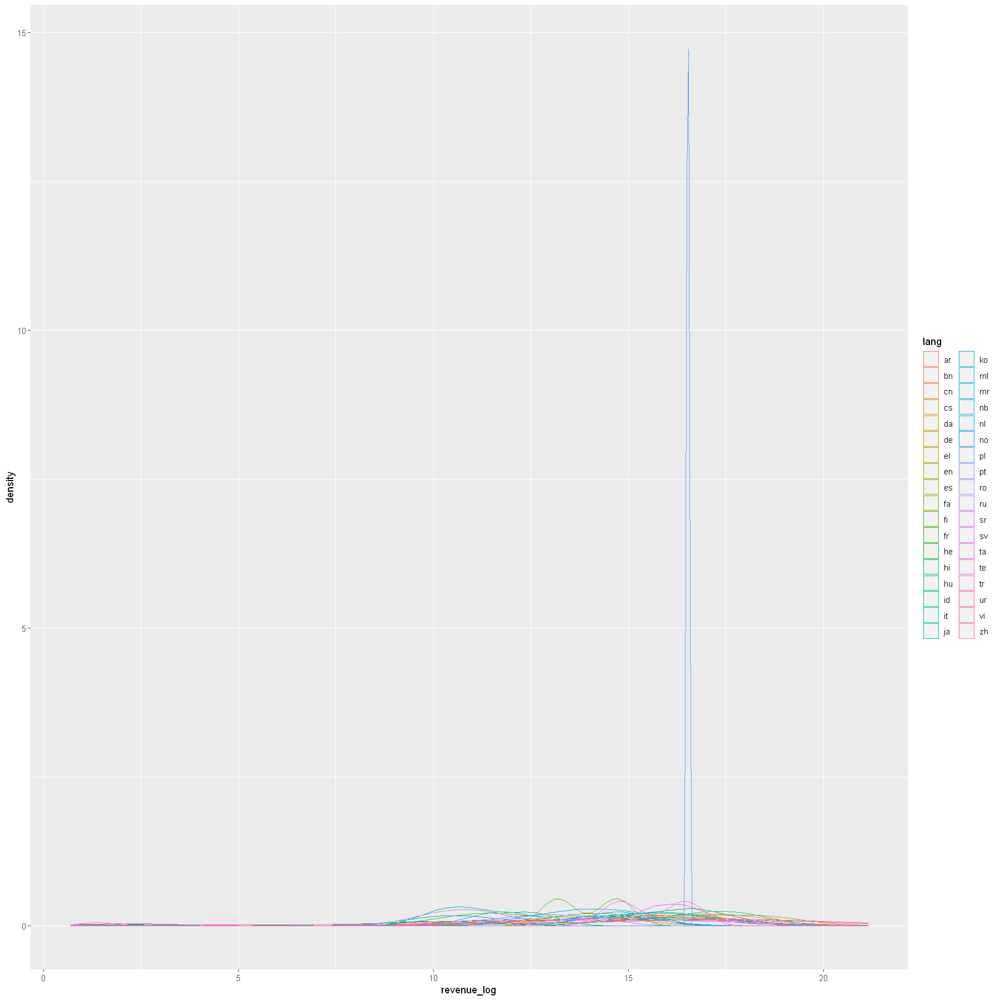

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


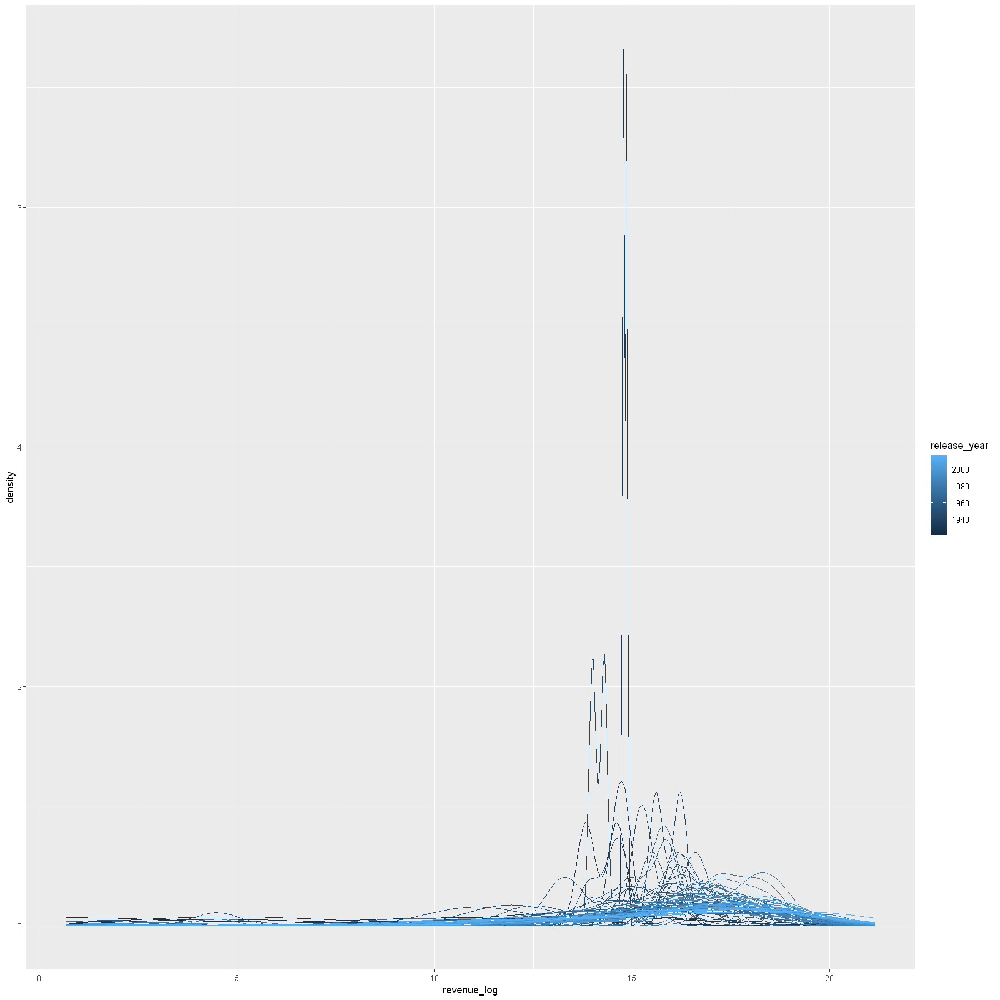

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


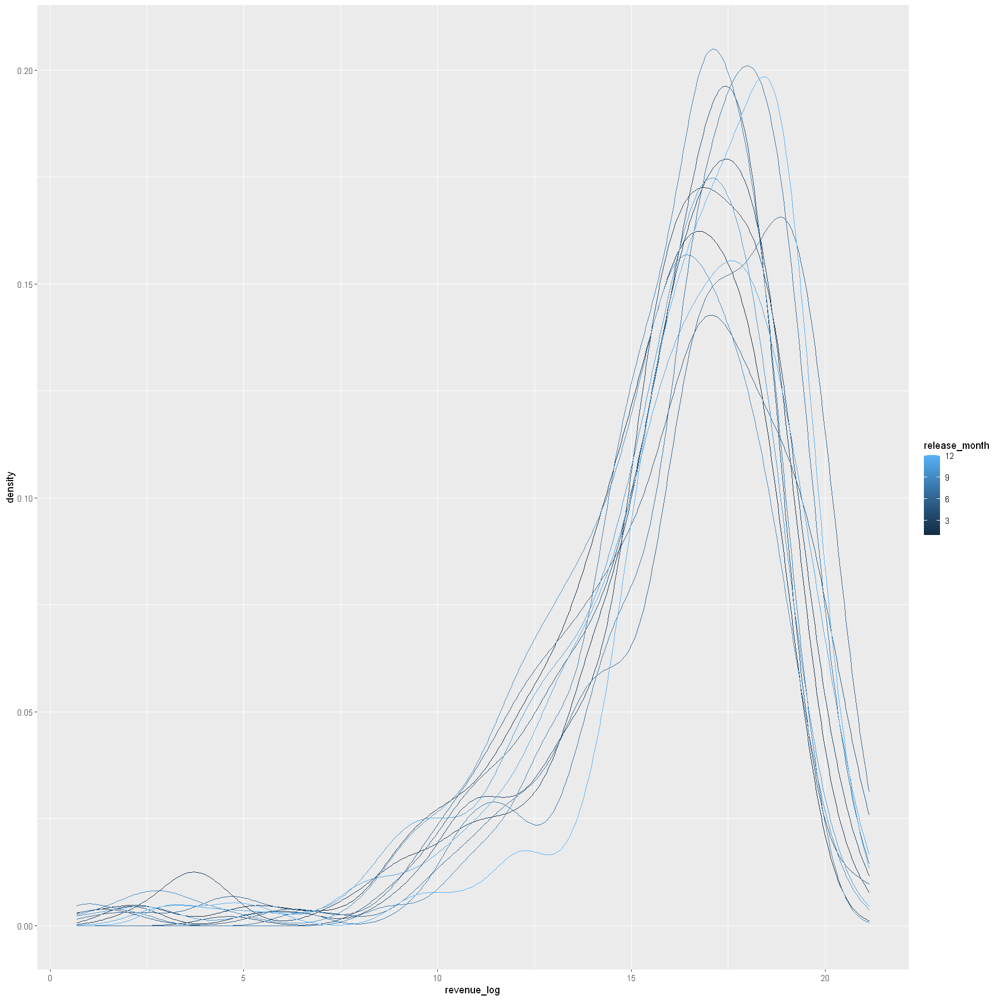

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


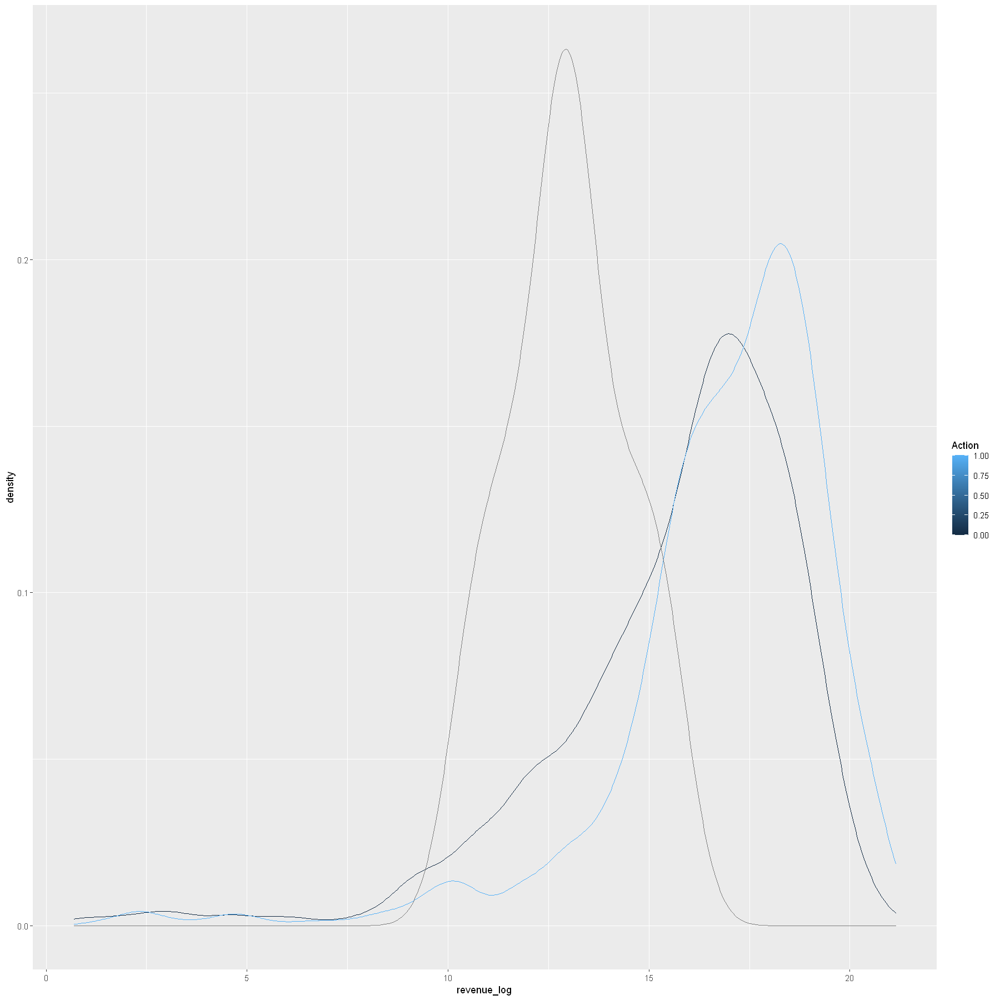

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


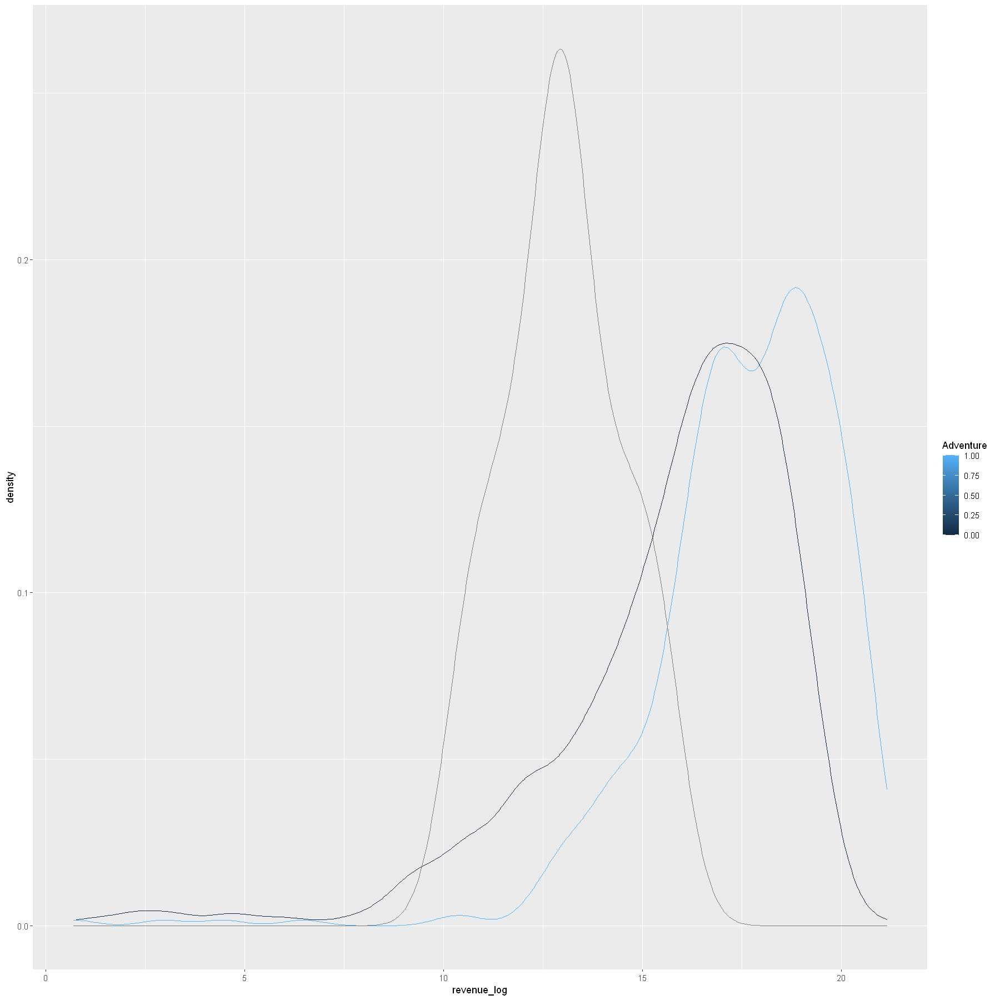

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


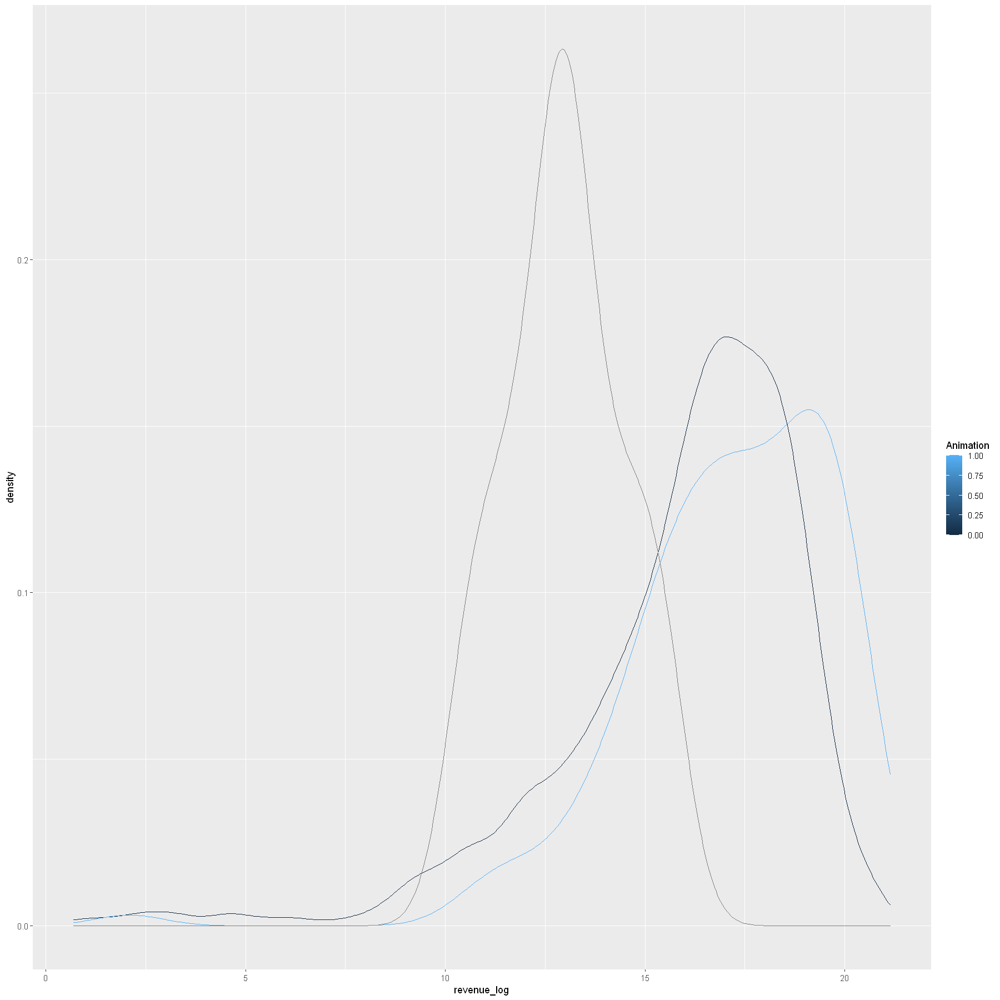

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


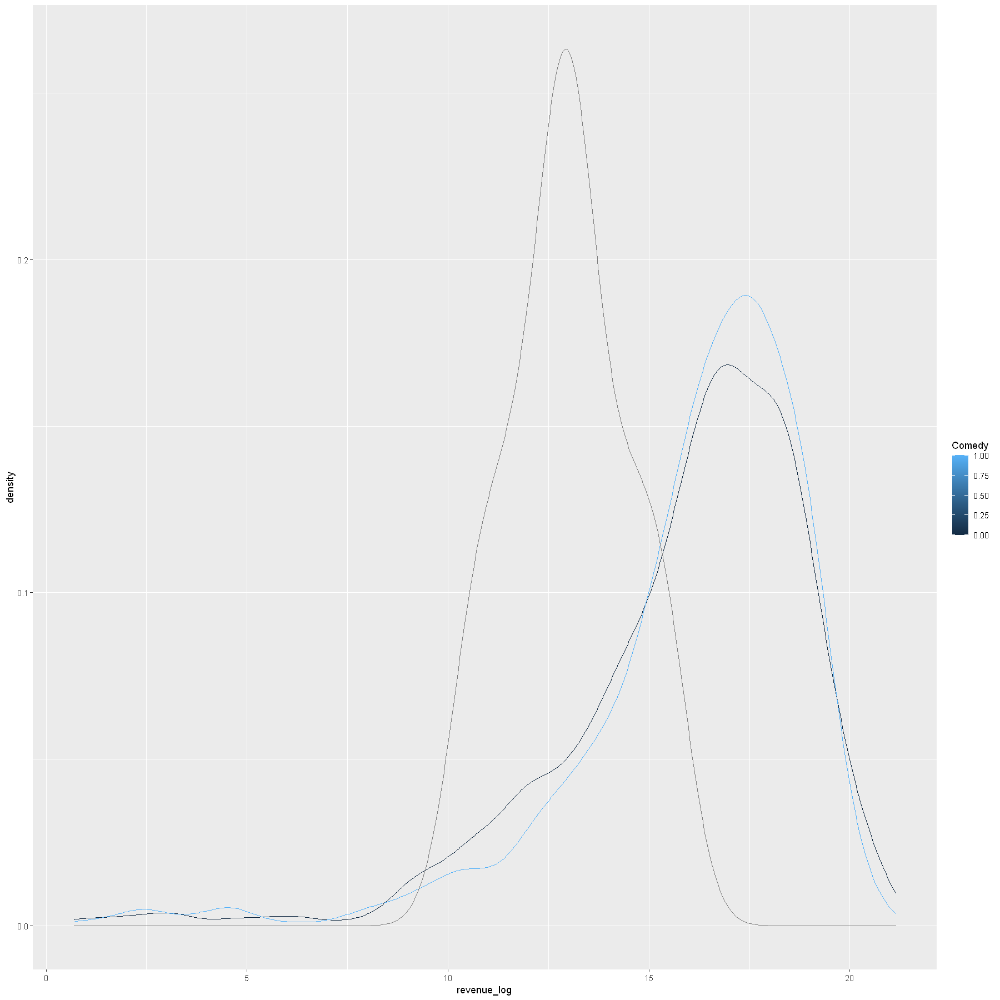

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


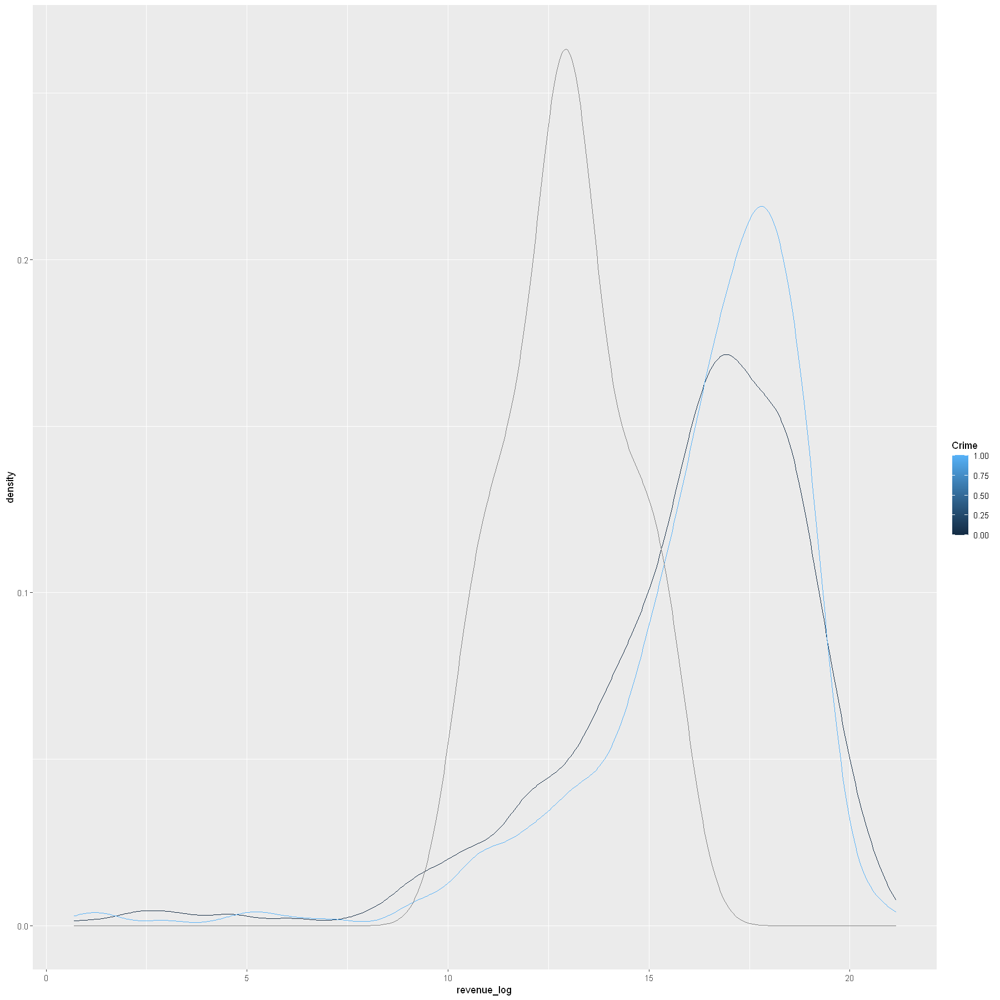

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


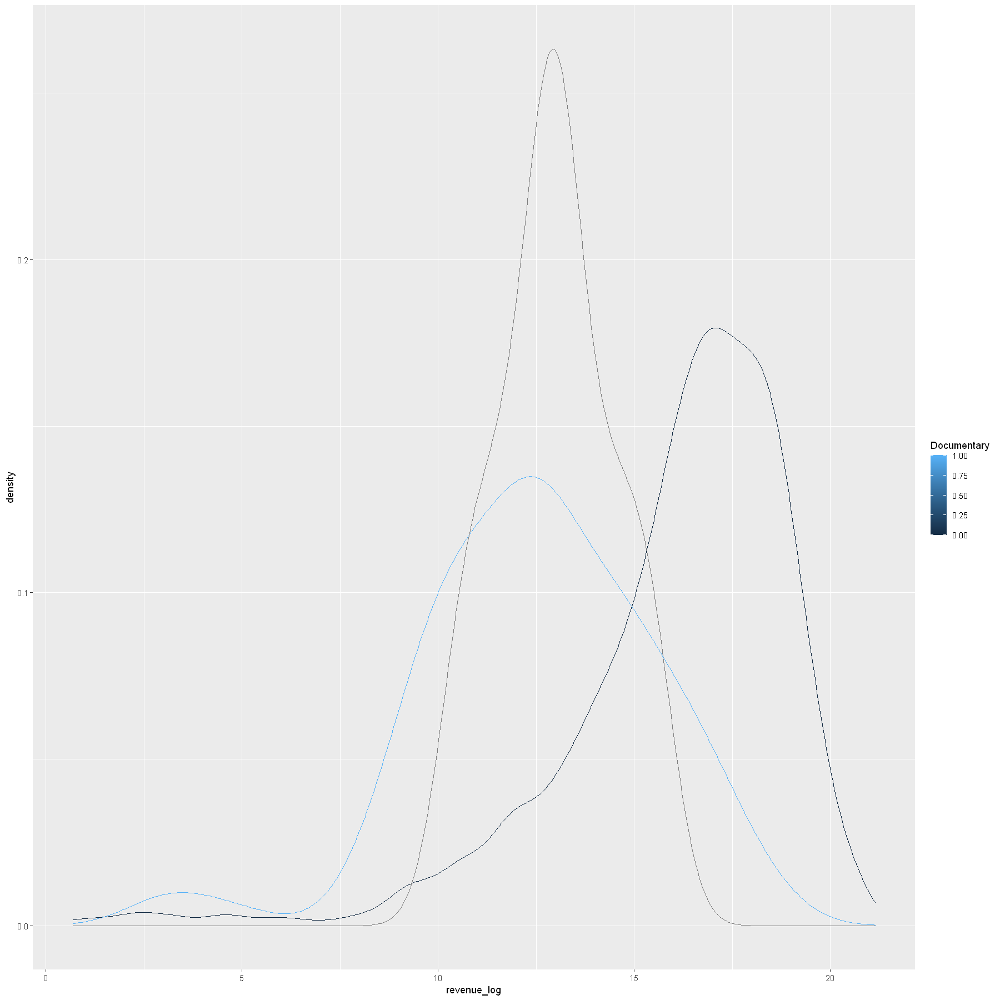

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


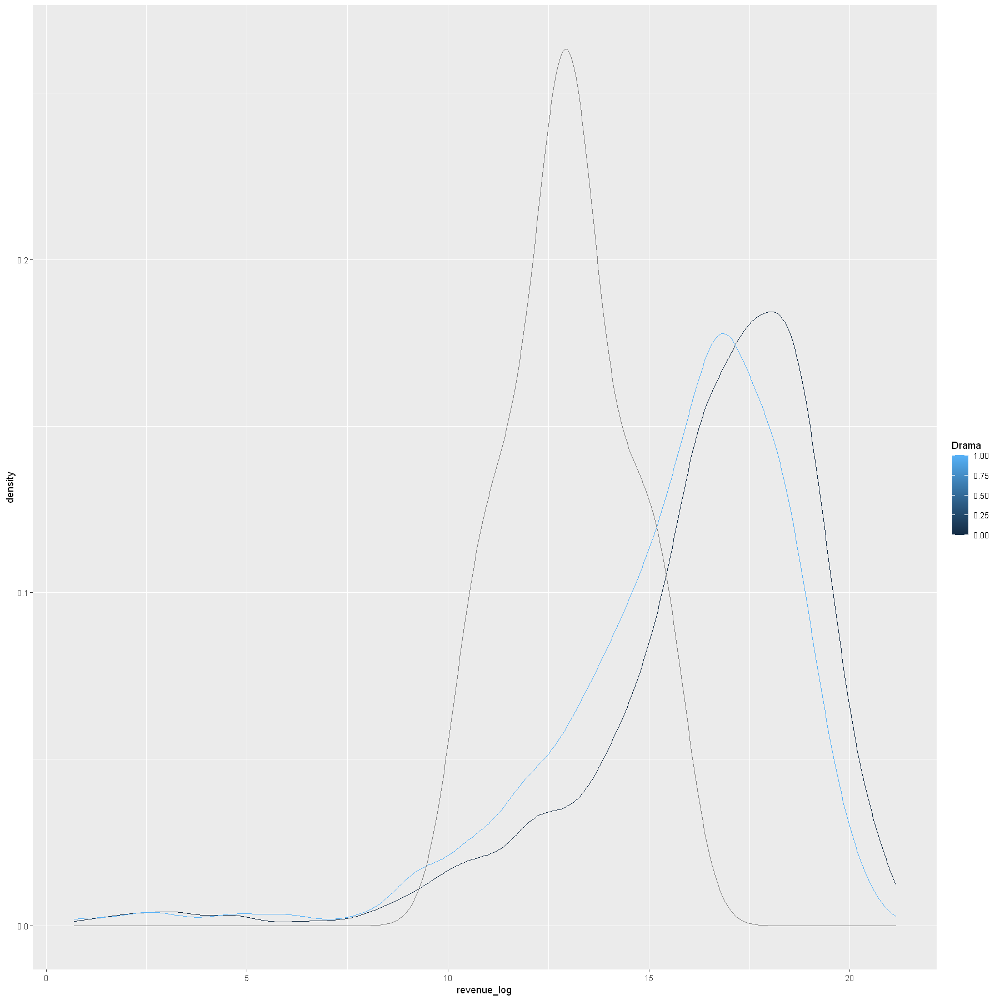

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


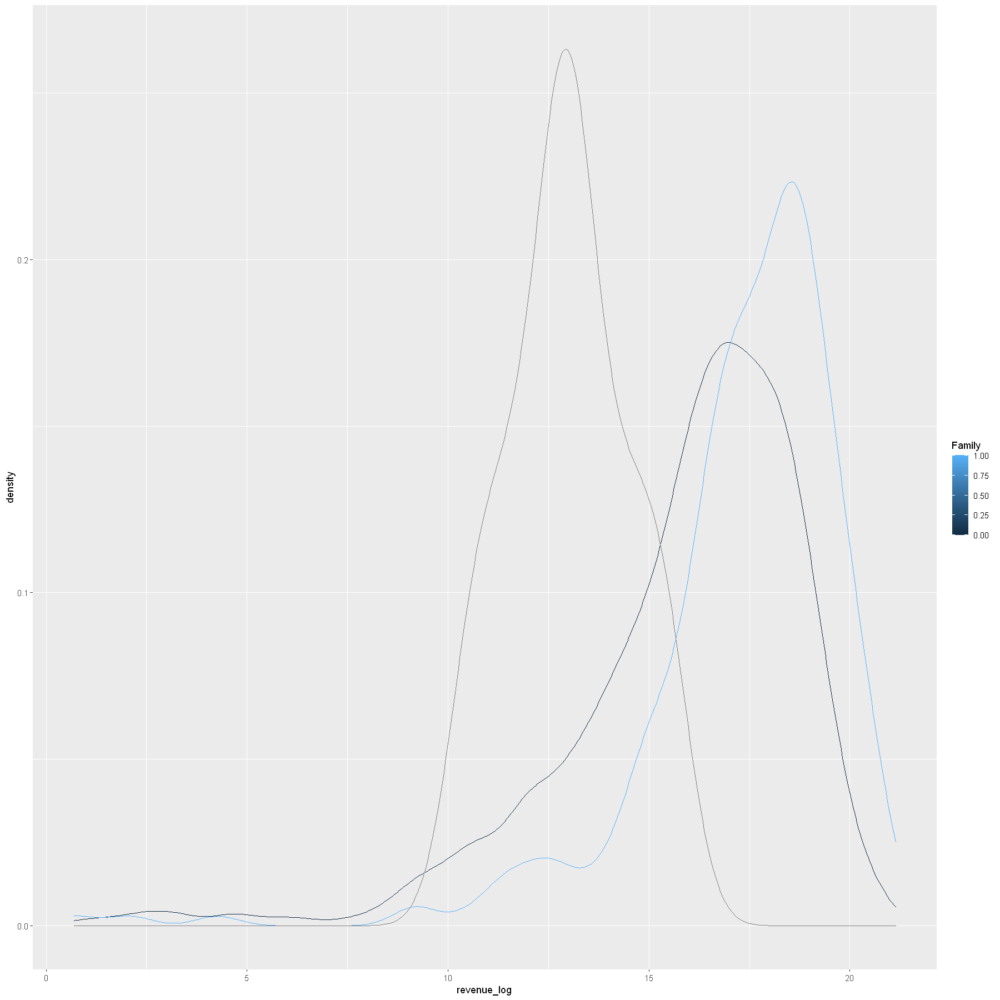

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


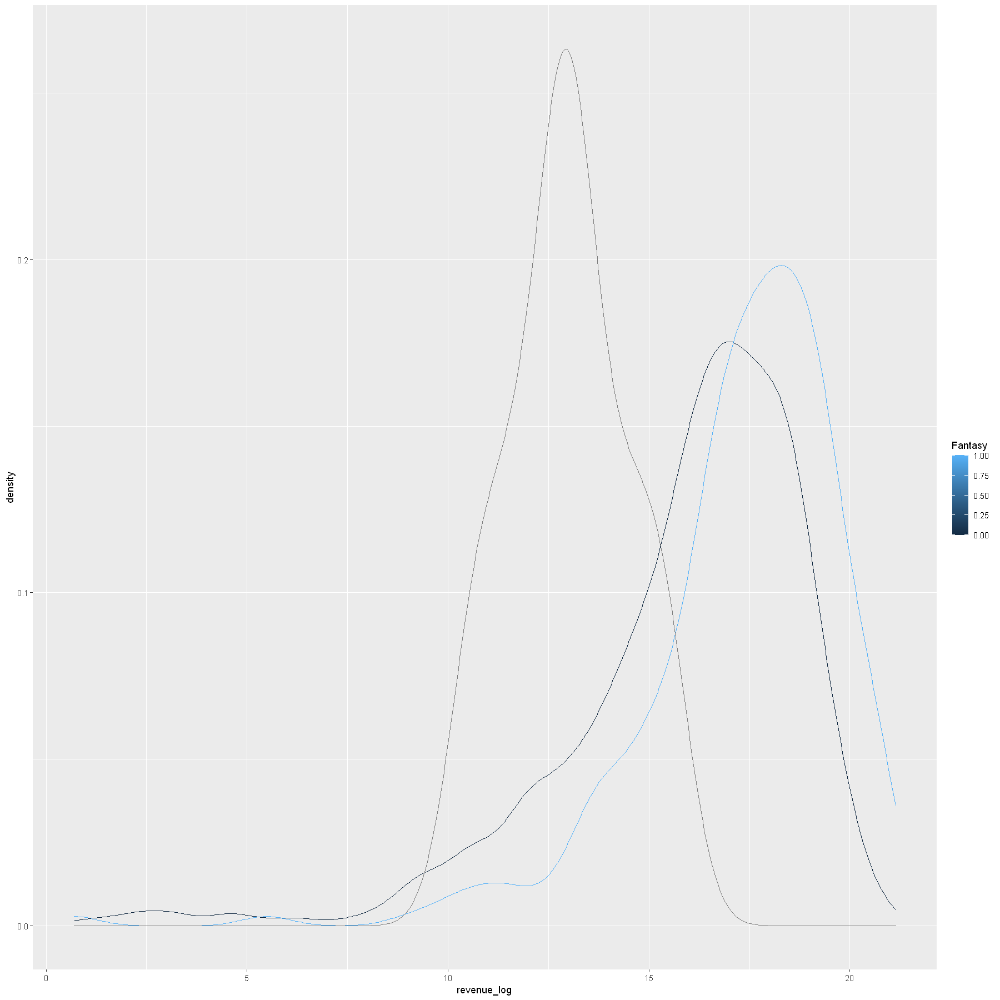

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


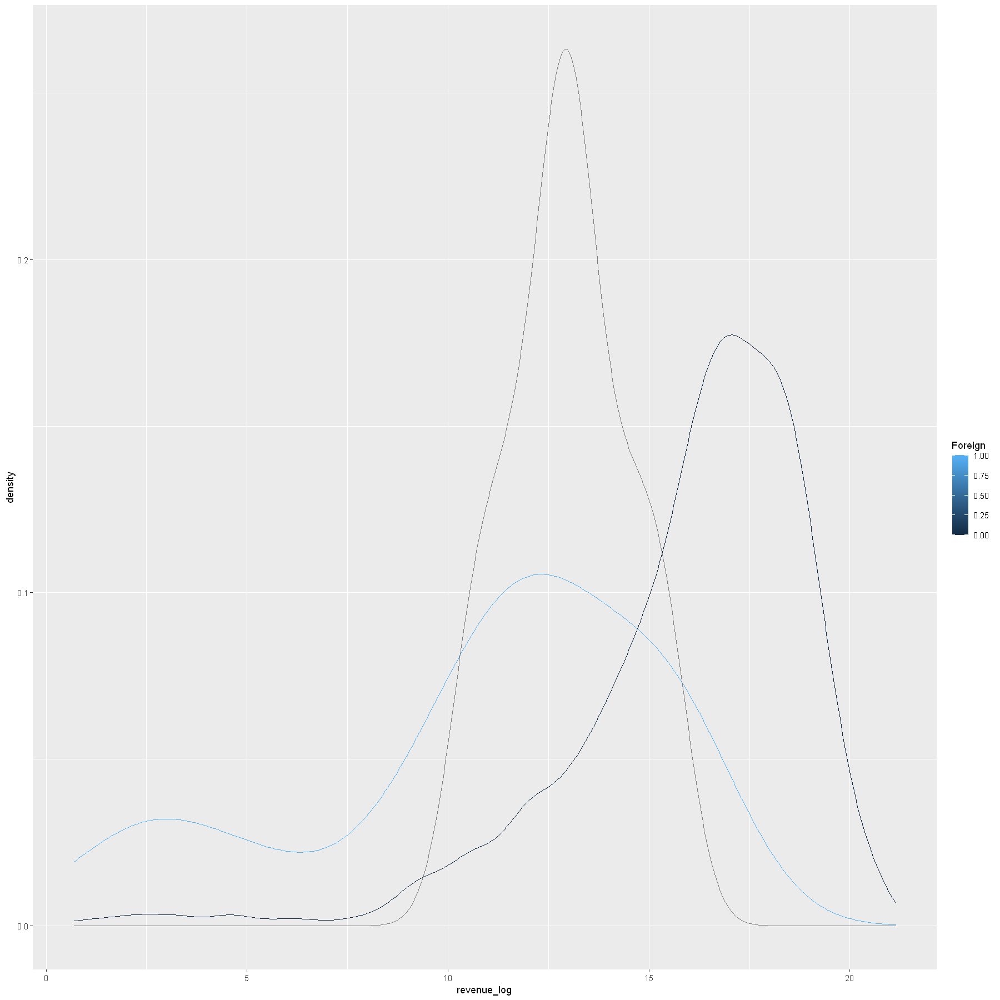

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


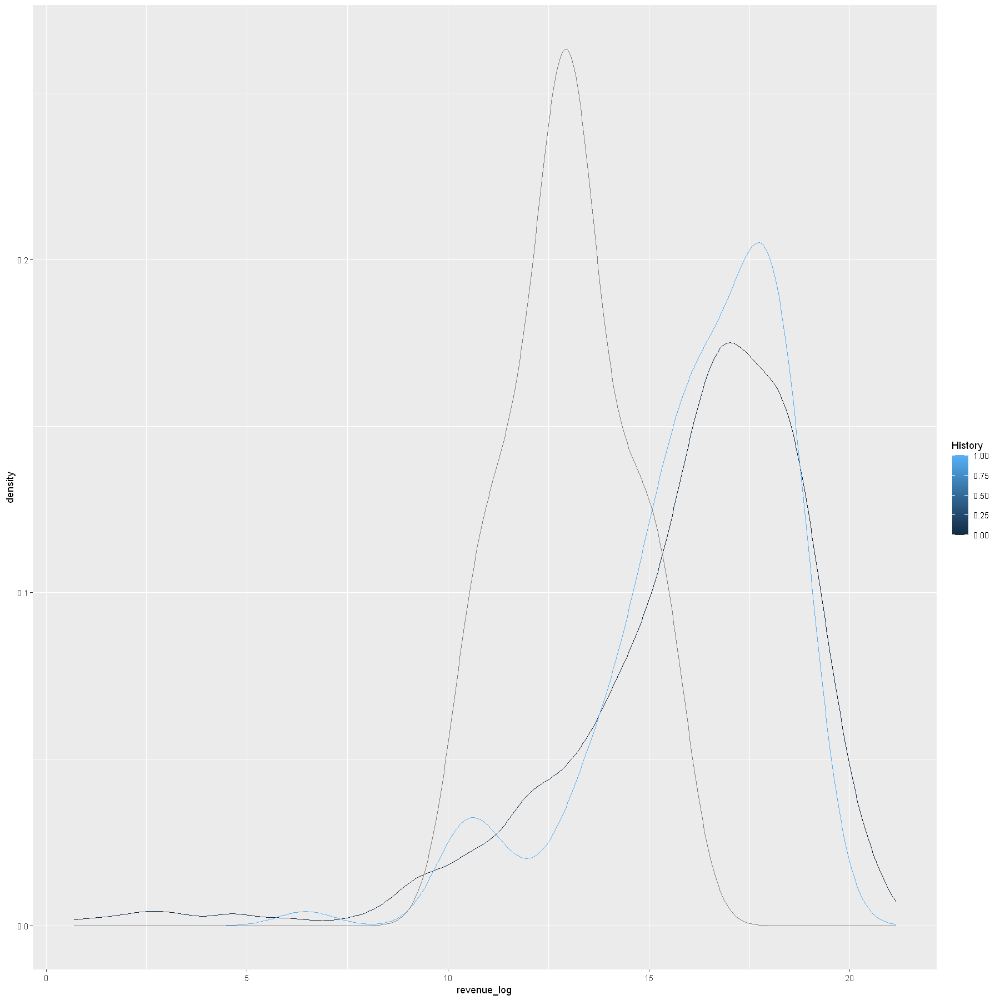

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


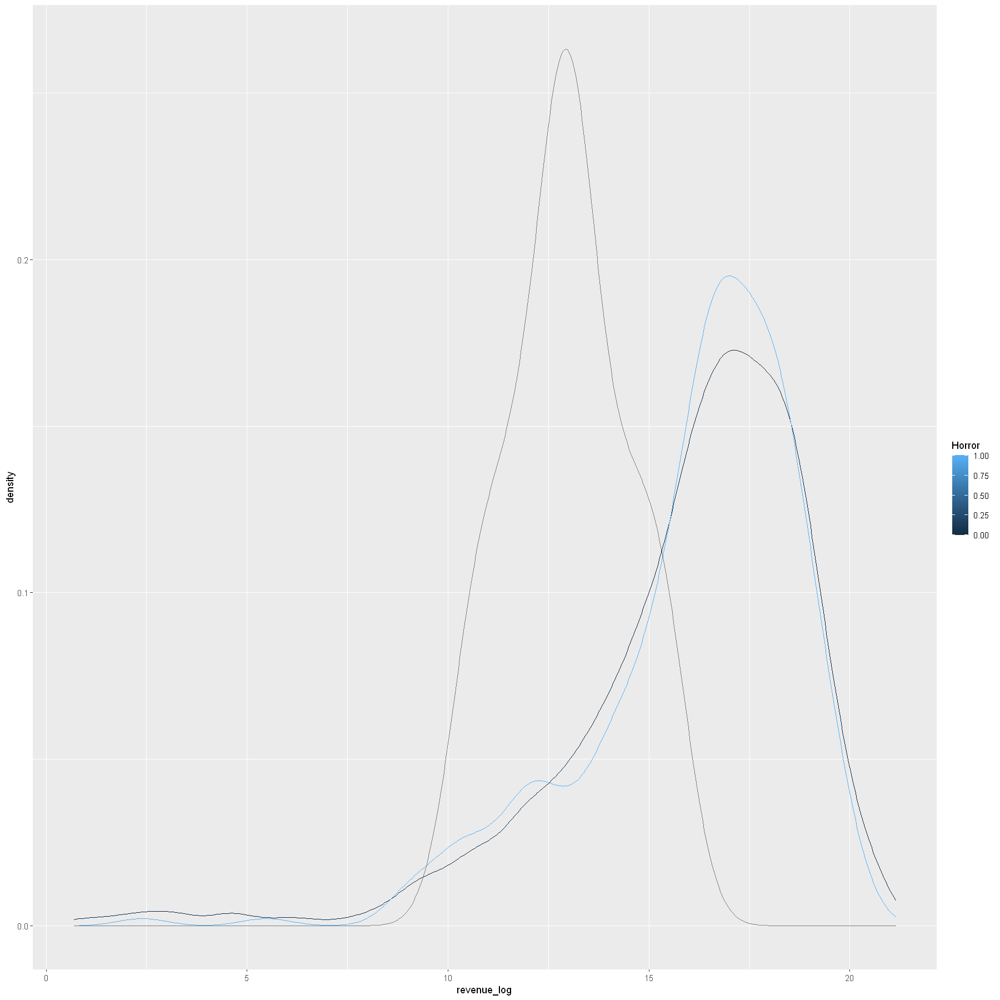

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


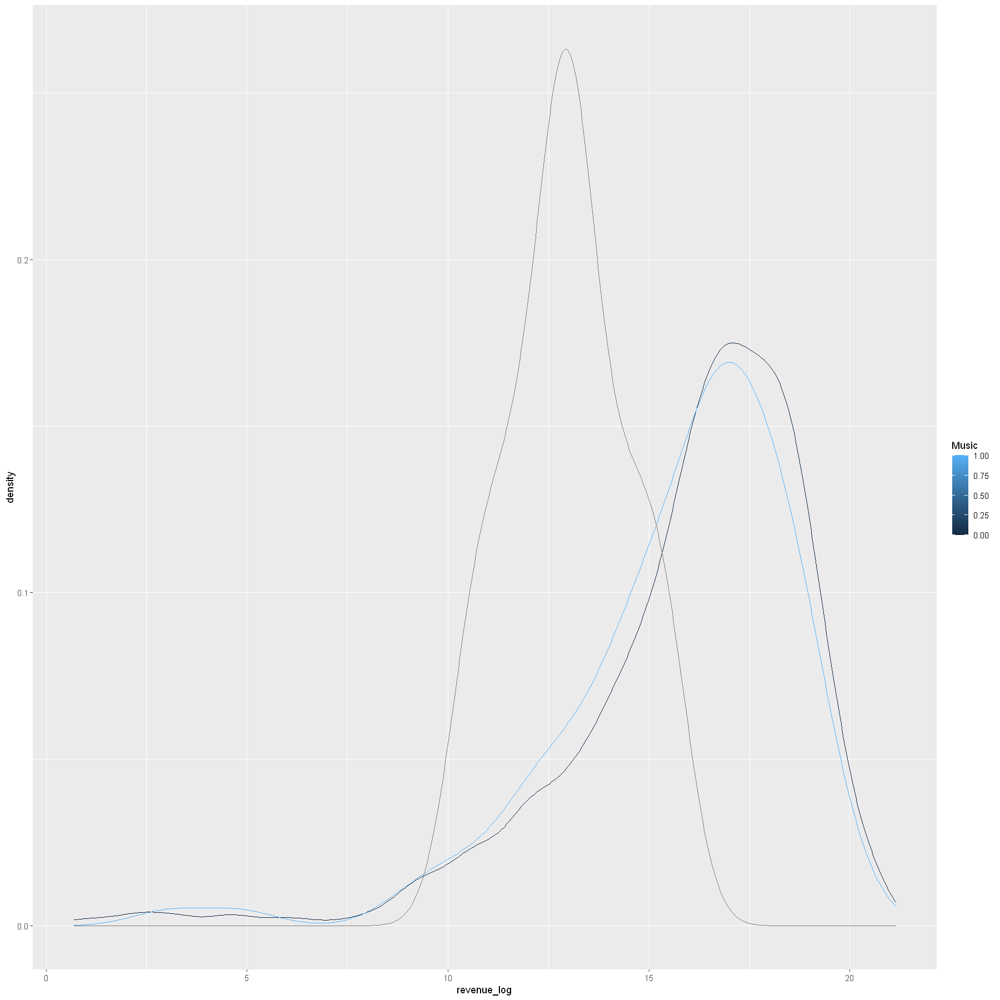

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


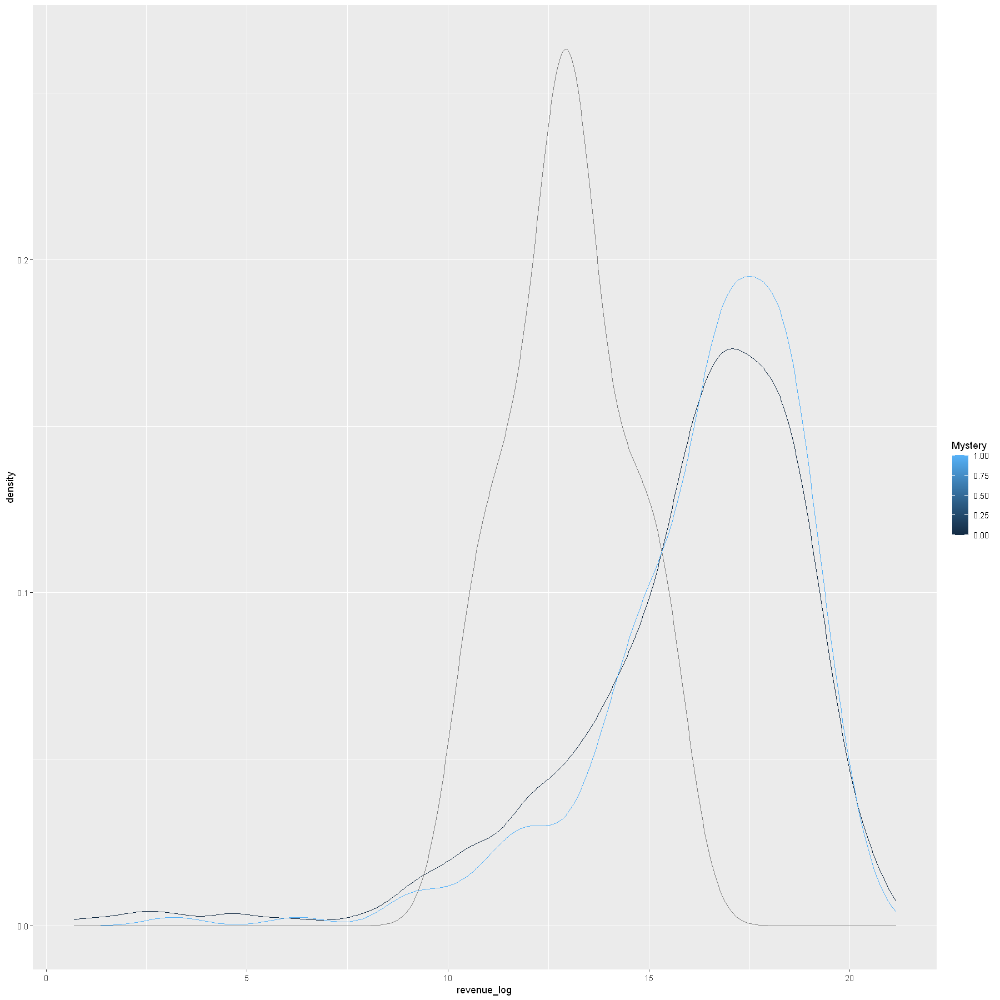

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


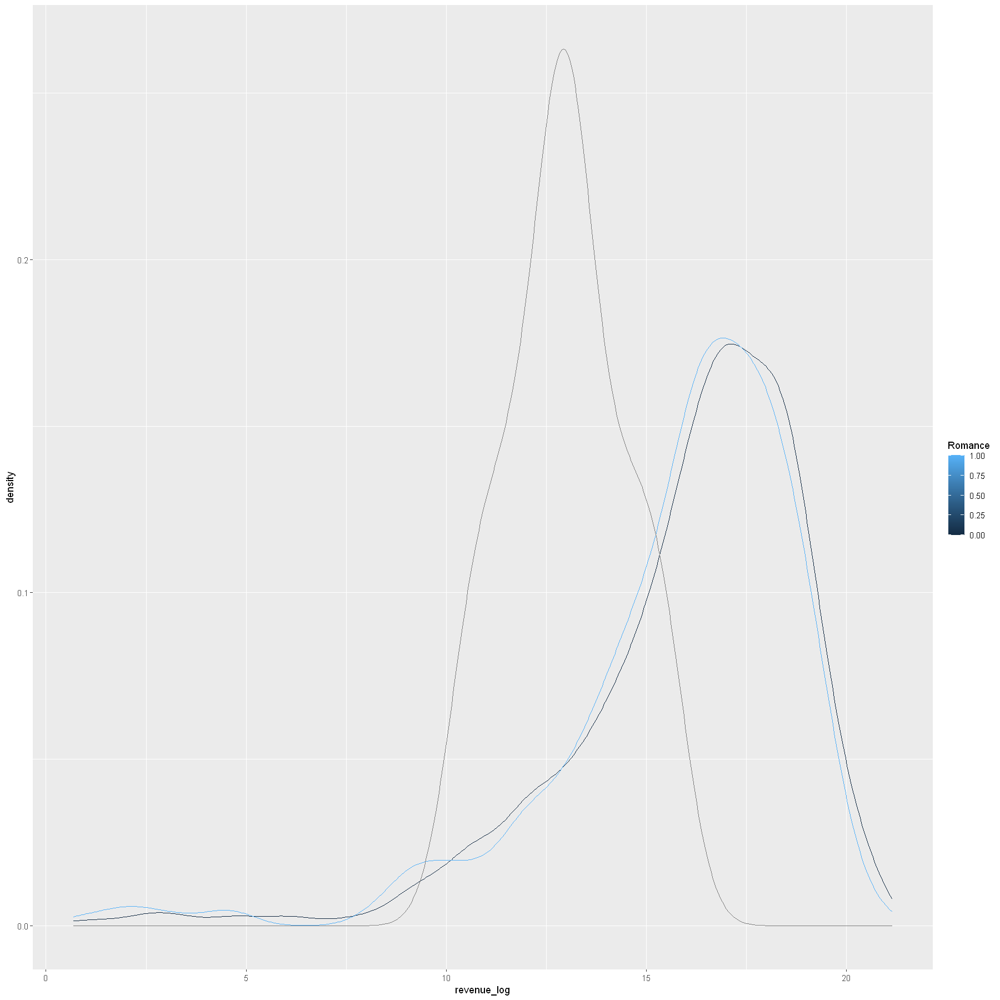

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


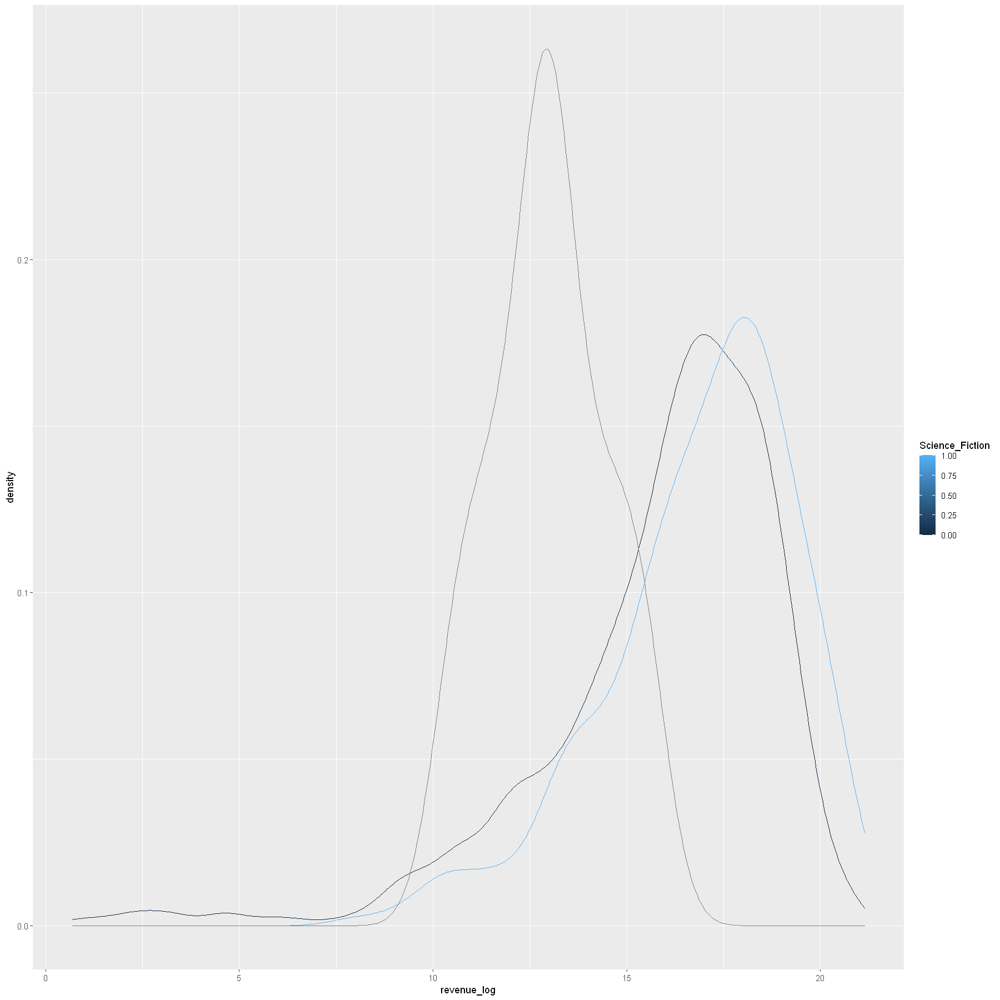

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


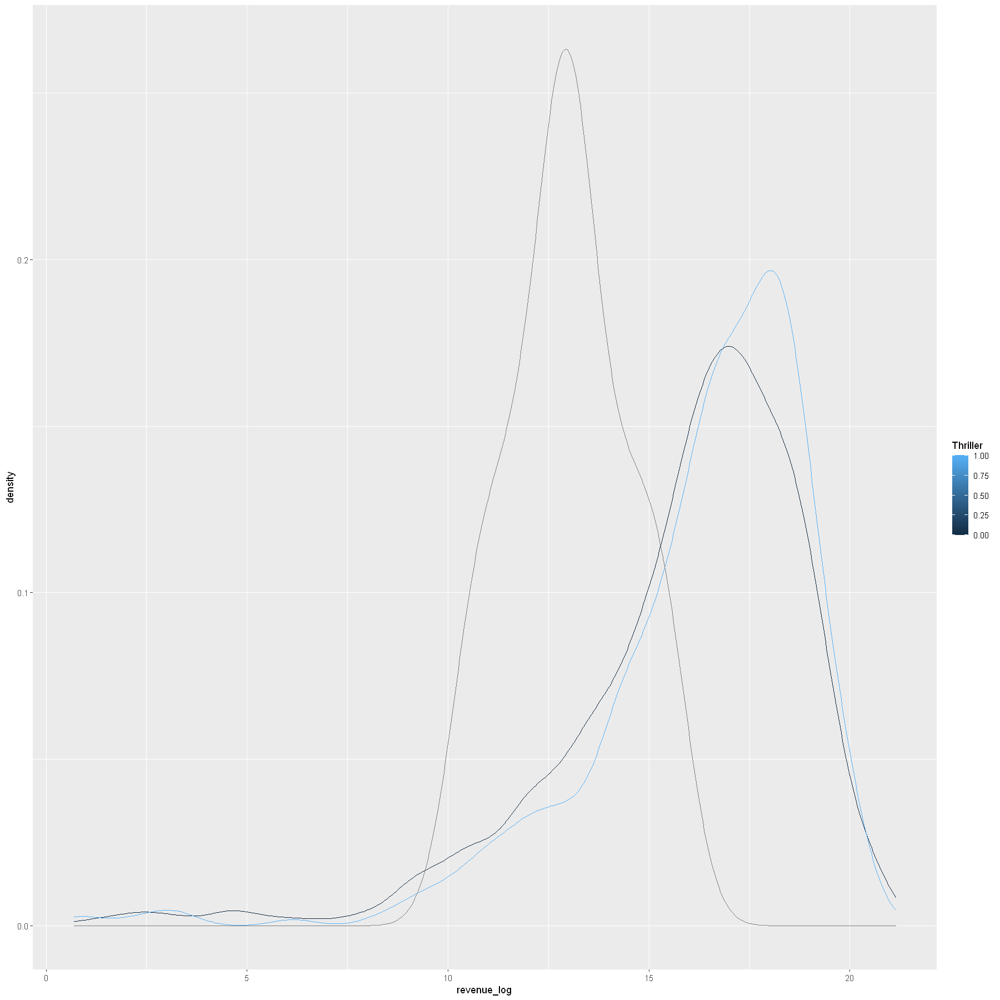

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


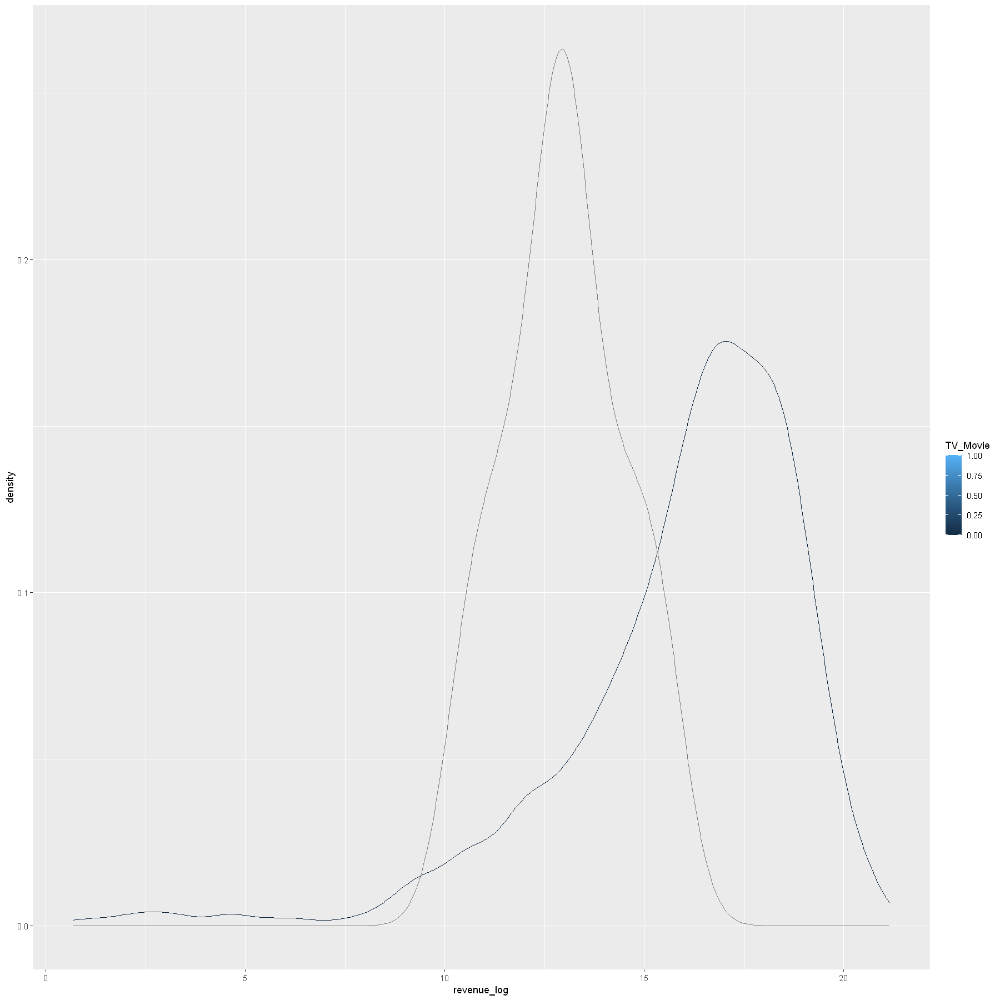

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


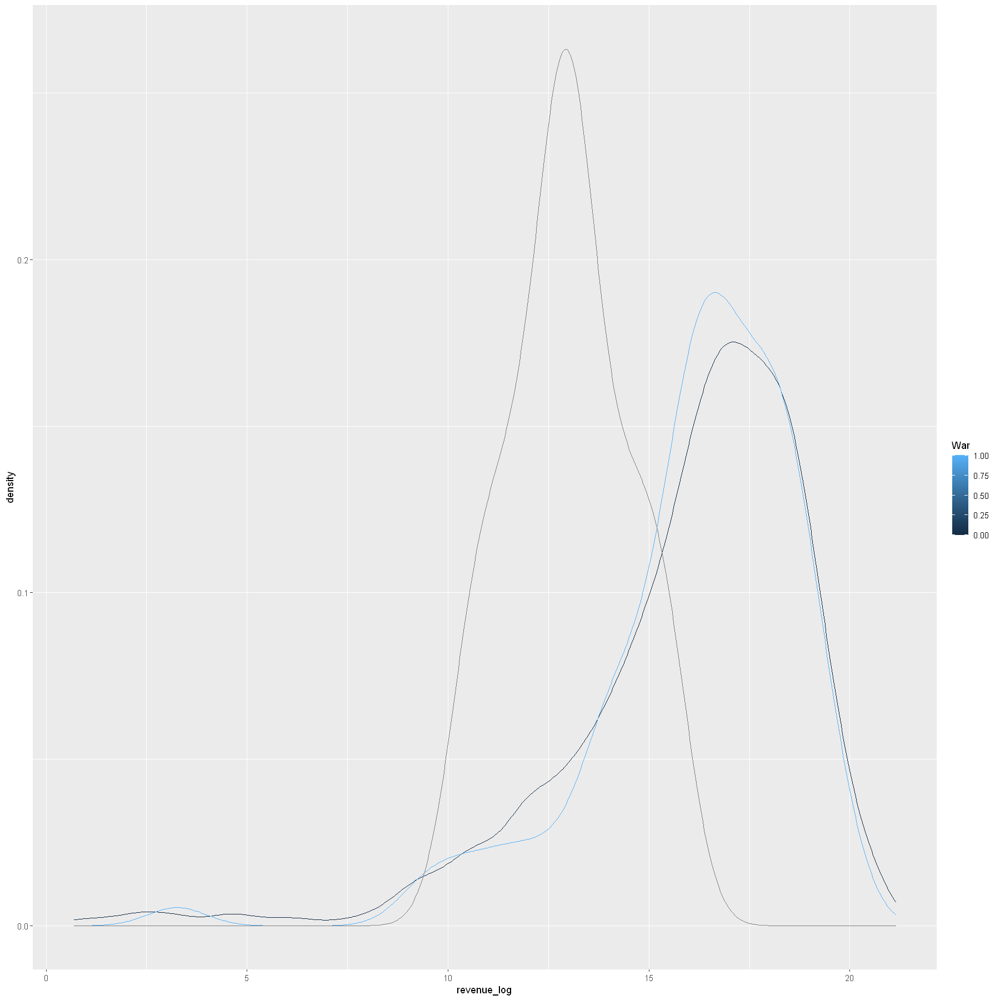

Warning message:
"Removed 4398 rows containing non-finite values (stat_density)."


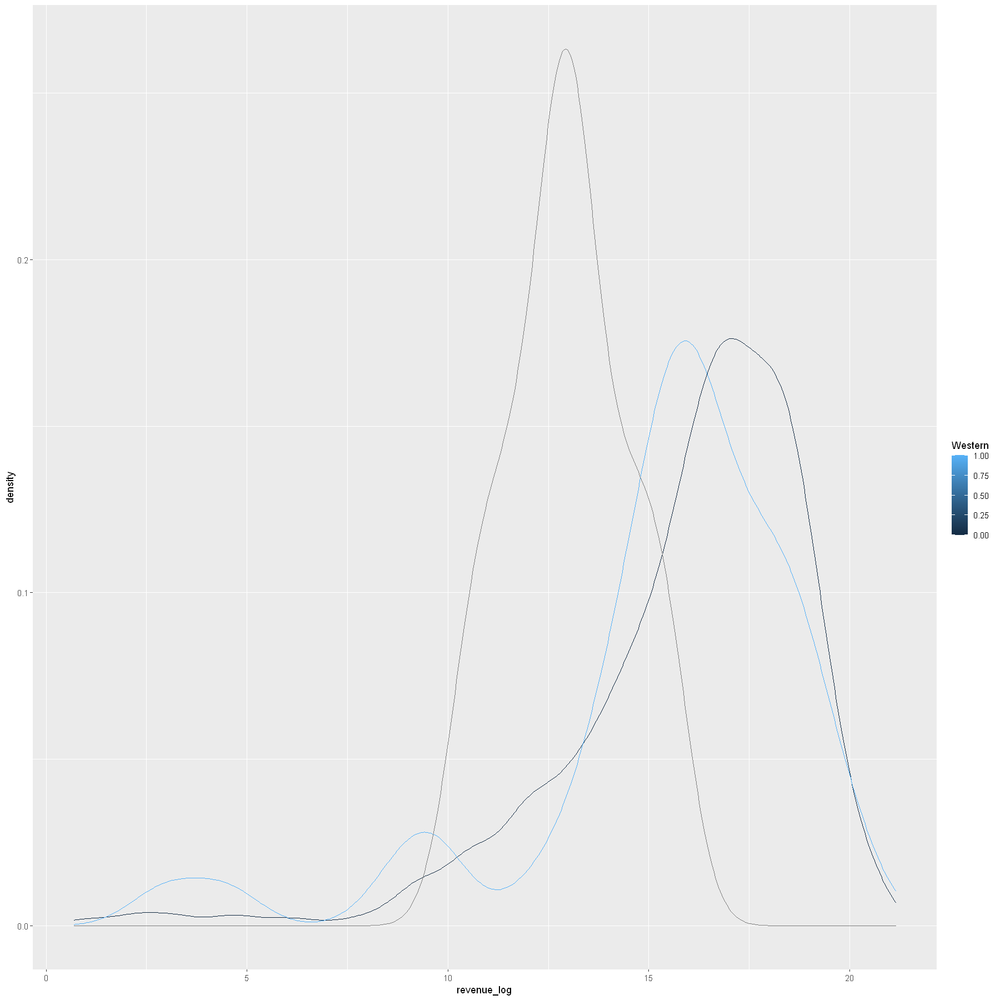

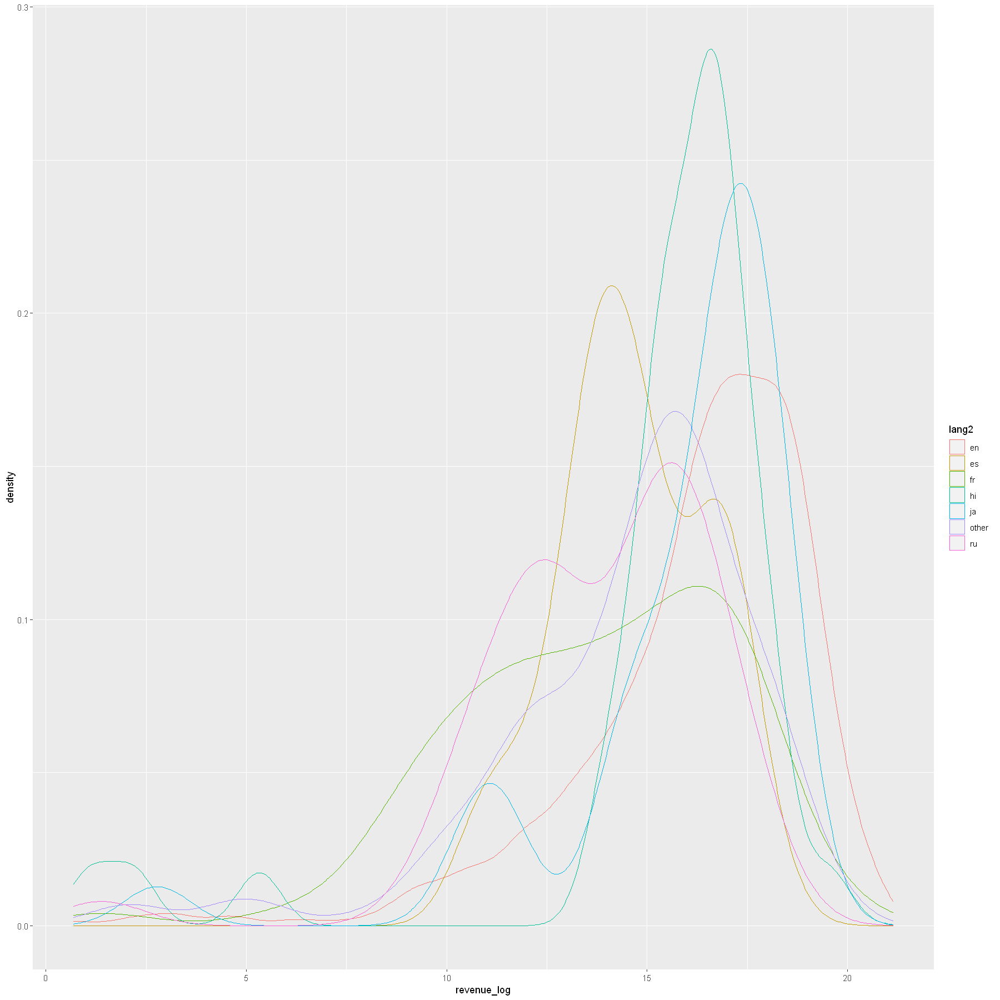

In [26]:
for (s in catlst){
        print(ggplot(data = ff) +
                geom_density(aes(revenue_log, group=.data[[s]], color=.data[[s]])))
}


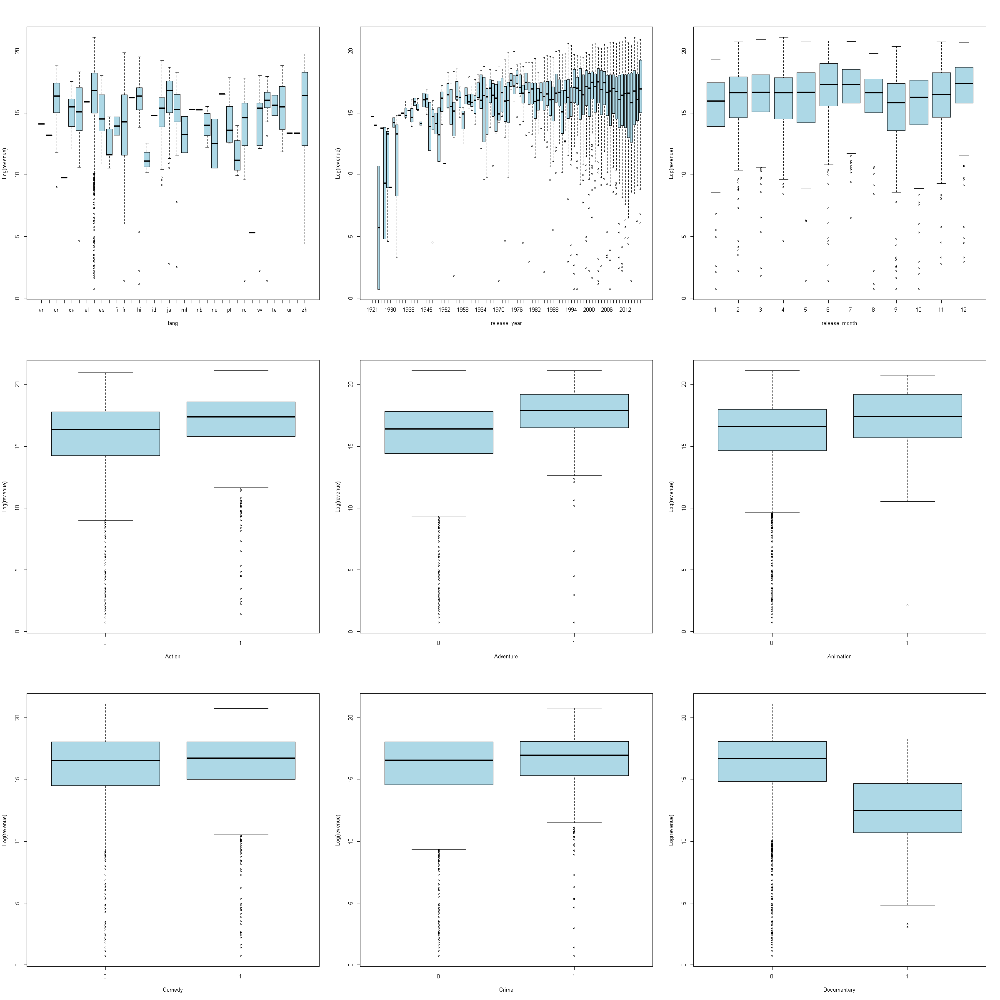

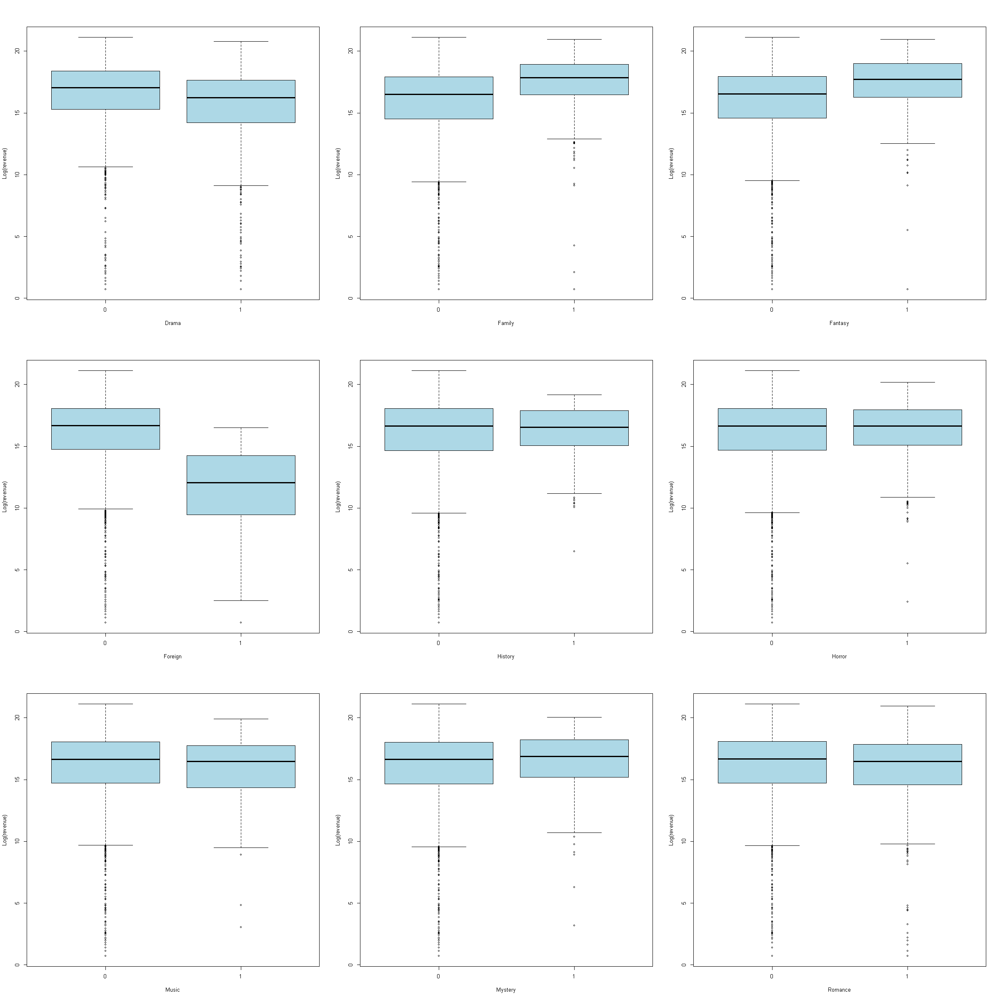

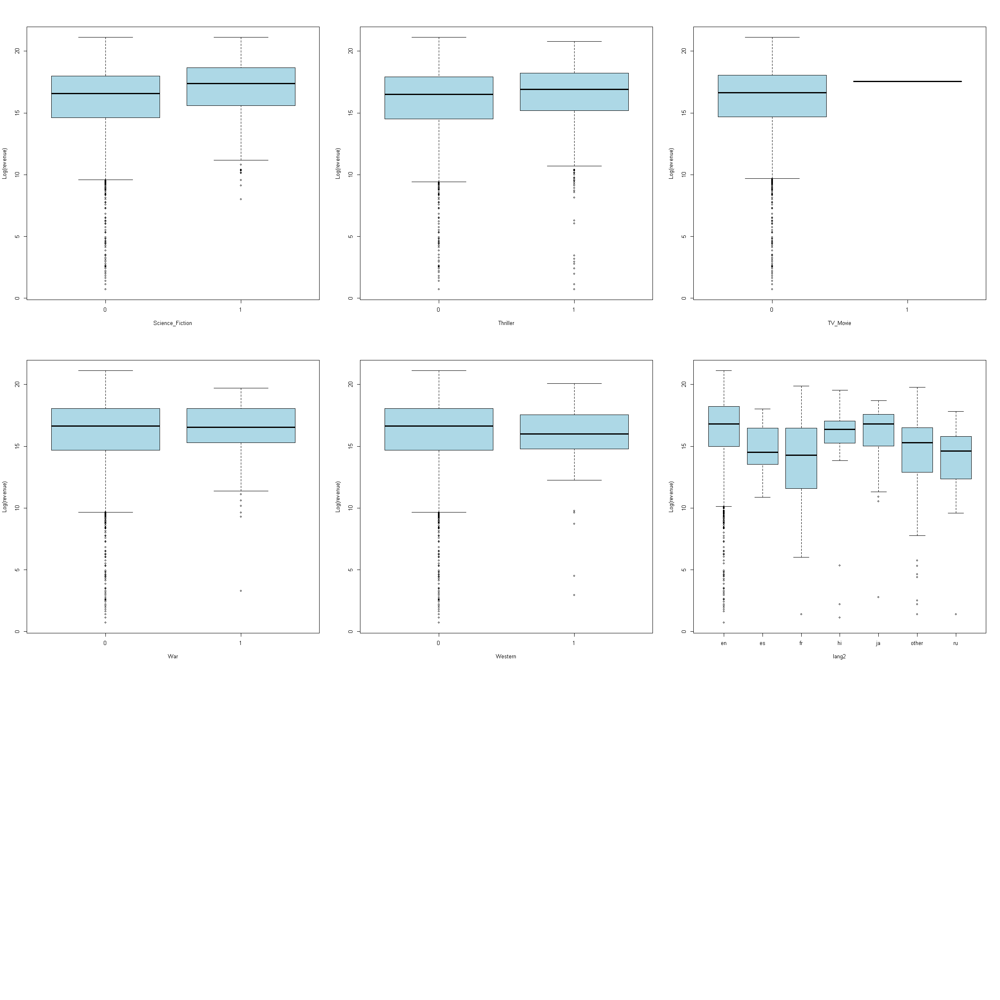

In [27]:
options(repr.plot.width =20, repr.plot.height = 20)
par(mfrow=c(3,3))
for (n in catlst){
    boxplot(ff$revenue_log ~ ff[[n]], xlab = n, ylab = 'Log(revenue)', col = 'light blue')
}

In [28]:
binlst

[1] "Action"          "Adventure"       "Animation"       "Comedy"         
 [5] "Crime"           "Documentary"     "Drama"           "Family"         
 [9] "Fantasy"         "Foreign"         "History"         "Horror"         
[13] "Music"           "Mystery"         "Romance"         "Science_Fiction"
[17] "Thriller"        "TV_Movie"        "War"             "Western"

##### Calculate wilcoxon test to define if the distributions differ 

In [29]:
for (s in binlst){
        print(s)
        print(wilcox.test(ff$revenue_log ~ ff[[s]], var.equal = T,paired = F))
   }

[1] "Action"

	Wilcoxon rank sum test with continuity correction

data:  ff$revenue_log by ff[[s]]
W = 615458, p-value < 2.2e-16
alternative hypothesis: true location shift is not equal to 0

[1] "Adventure"

	Wilcoxon rank sum test with continuity correction

data:  ff$revenue_log by ff[[s]]
W = 331227, p-value < 2.2e-16
alternative hypothesis: true location shift is not equal to 0

[1] "Animation"

	Wilcoxon rank sum test with continuity correction

data:  ff$revenue_log by ff[[s]]
W = 150671, p-value = 4.742e-07
alternative hypothesis: true location shift is not equal to 0

[1] "Comedy"

	Wilcoxon rank sum test with continuity correction

data:  ff$revenue_log by ff[[s]]
W = 969650, p-value = 0.06878
alternative hypothesis: true location shift is not equal to 0

[1] "Crime"

	Wilcoxon rank sum test with continuity correction

data:  ff$revenue_log by ff[[s]]
W = 543856, p-value = 0.005002
alternative hypothesis: true location shift is not equal to 0

[1] "Documentary"

	Wilcoxon ran

In [30]:
#res %>% filter(pvalue < 0.05)

vars that indicates differences in revenue:
'Action' 'Adventure' 'Animation' 'Documentary' 'Drama' 'Family' 'Fantasy' 'Foreign' 'Science Fiction' 'Thriller'  

### 5 - outliers

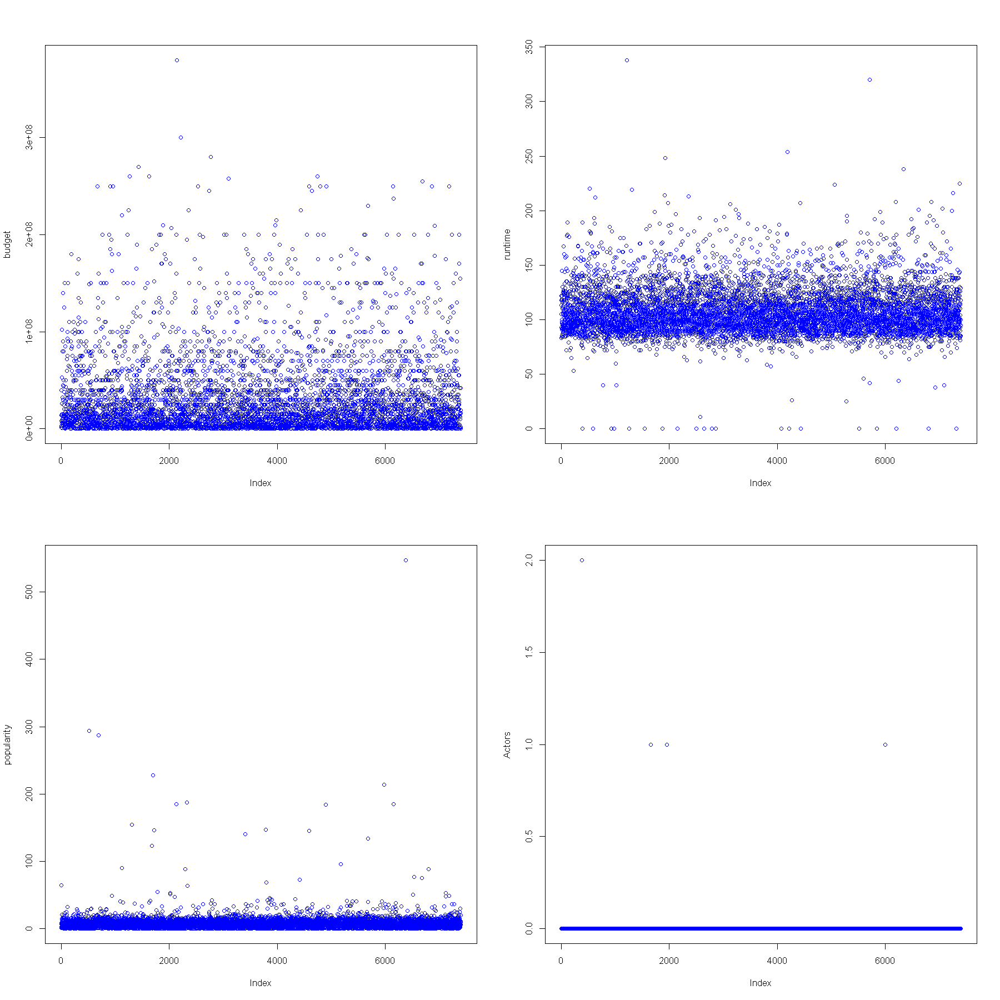

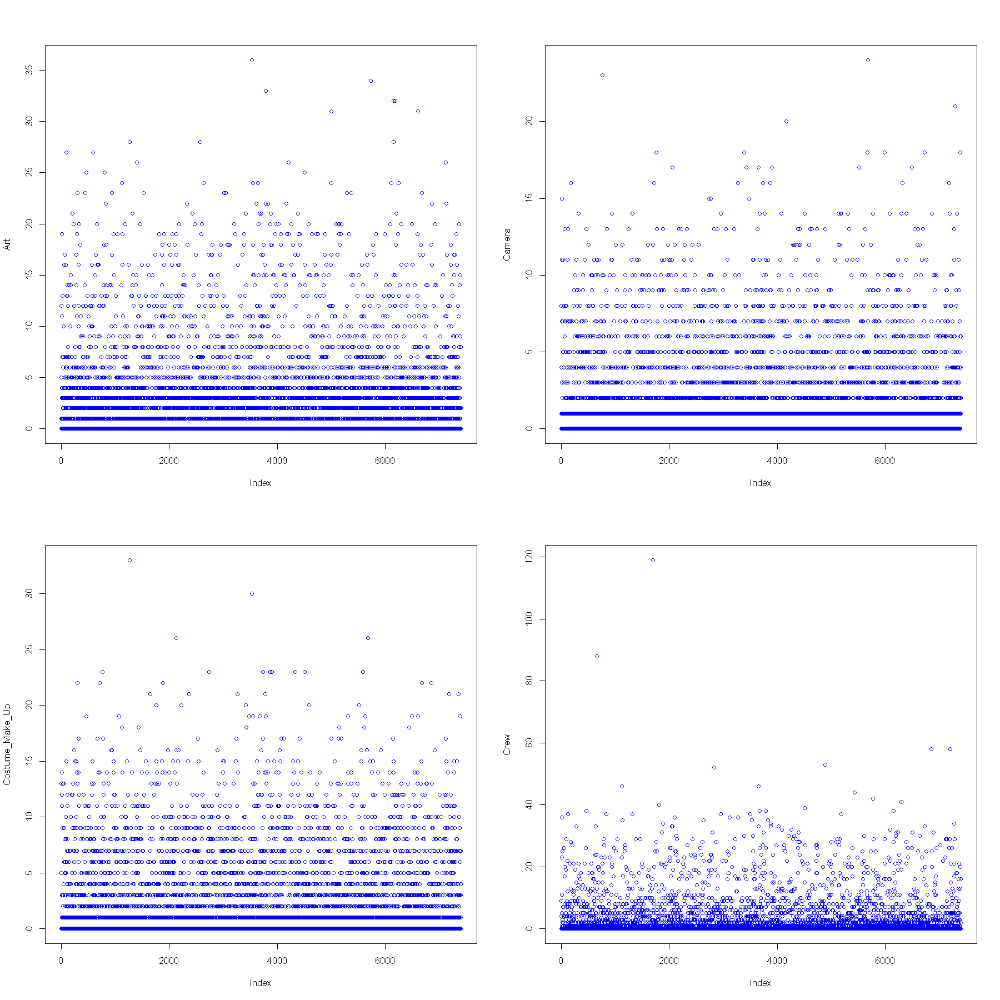

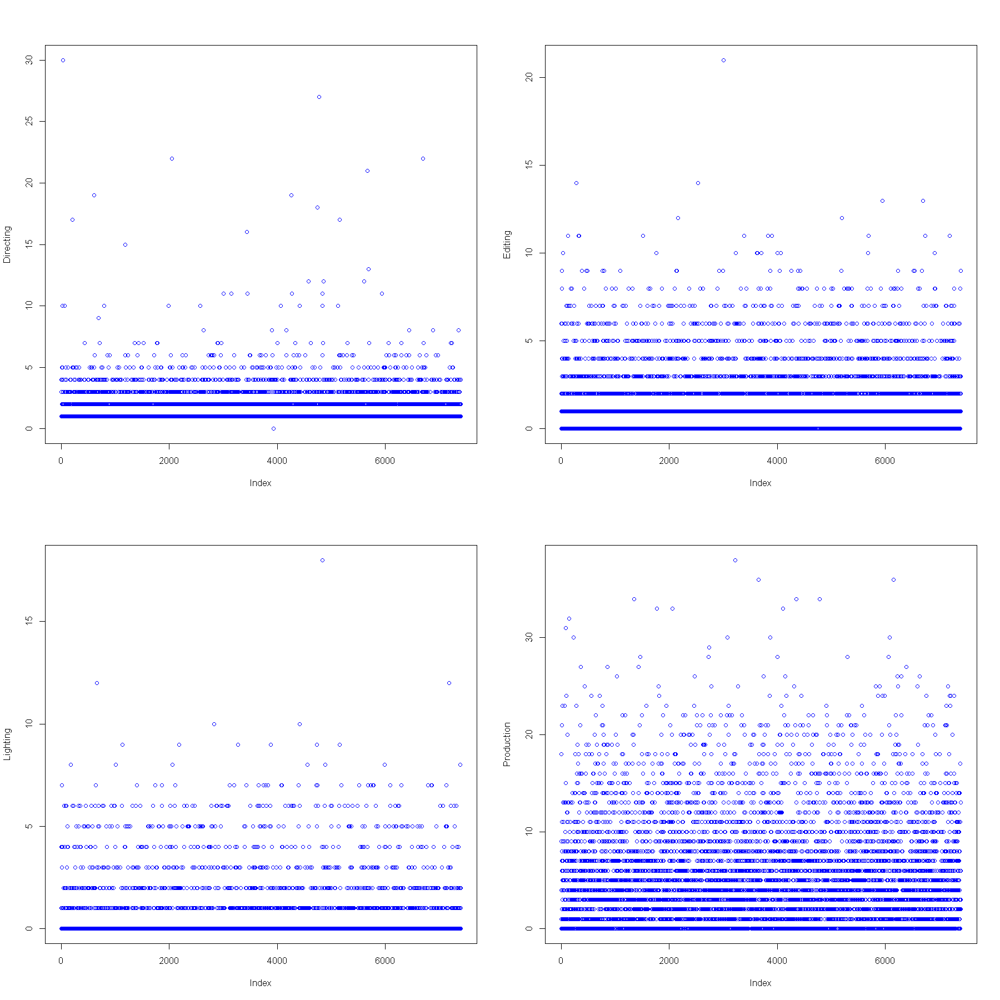

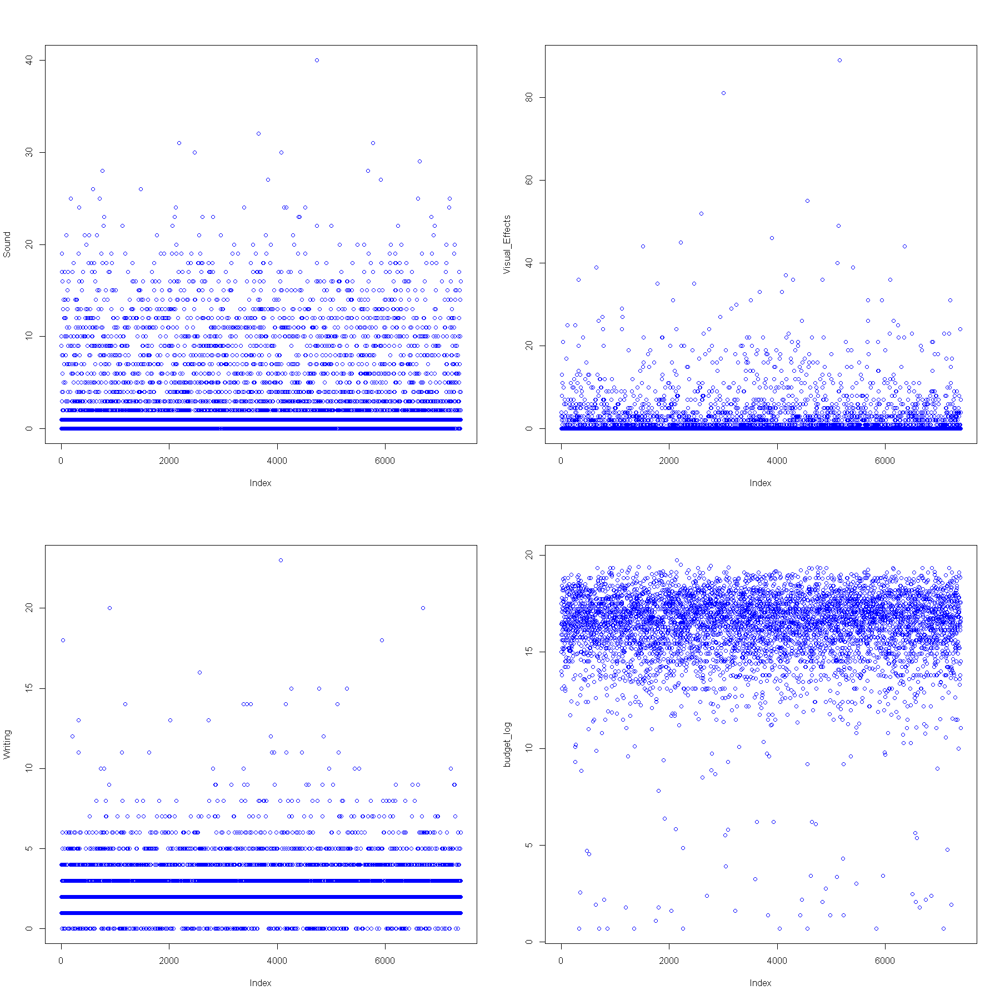

In [31]:
options(repr.plot.width =15, repr.plot.height = 15)
par(mfrow=c(2,2))
for (n in numlst){
    plot(ff[[n]], ylab = n, col = 'blue')
}

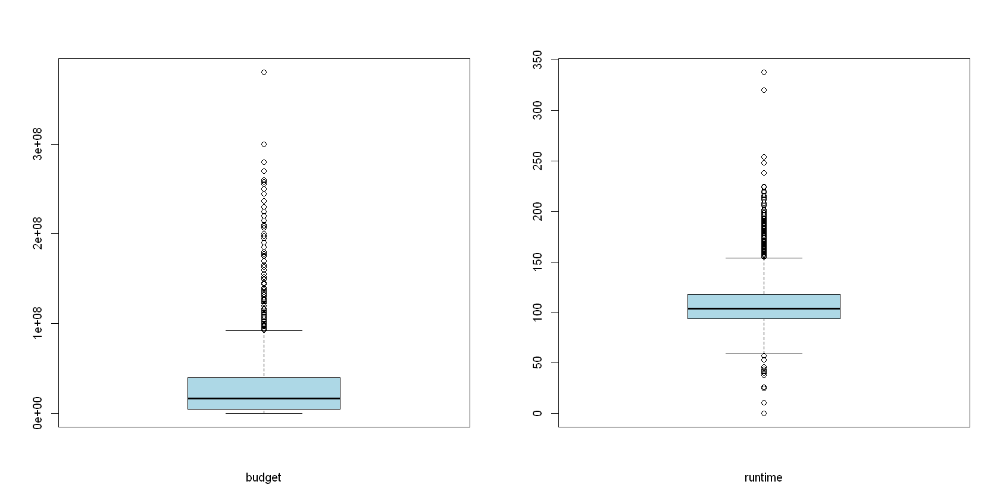

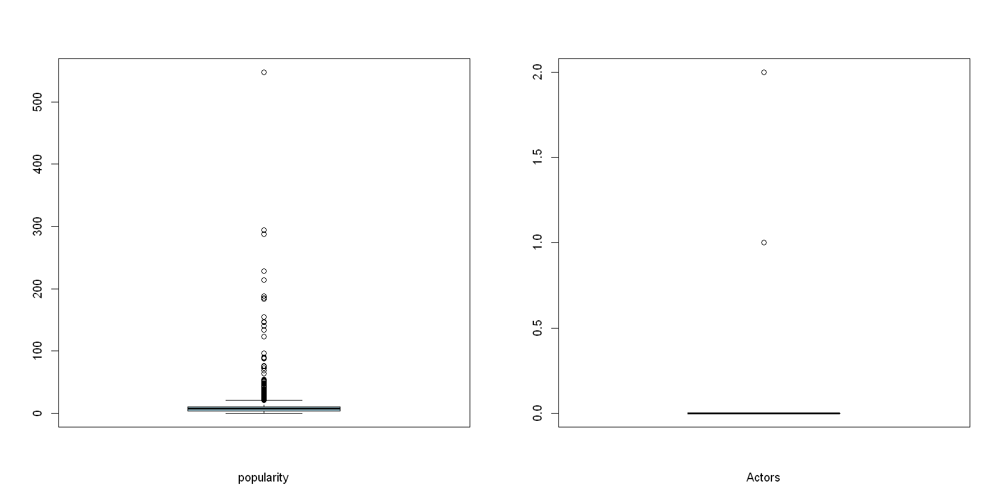

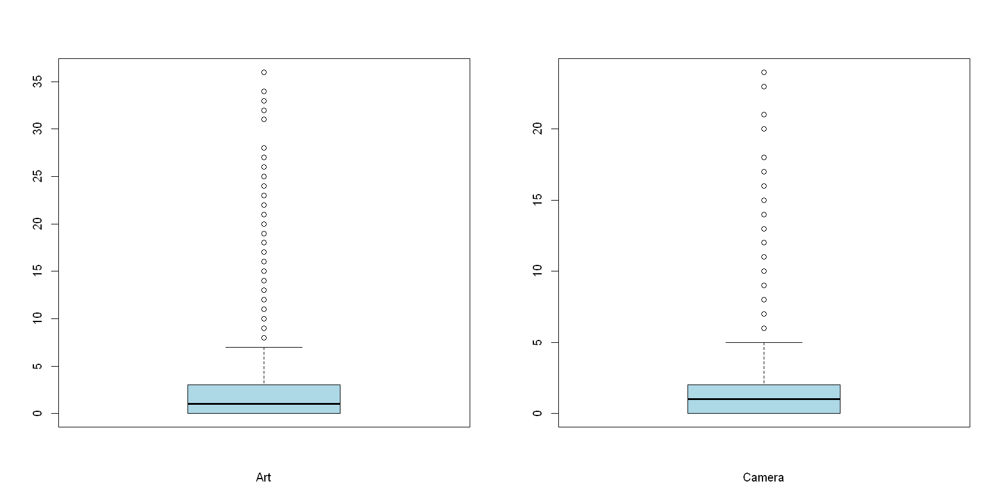

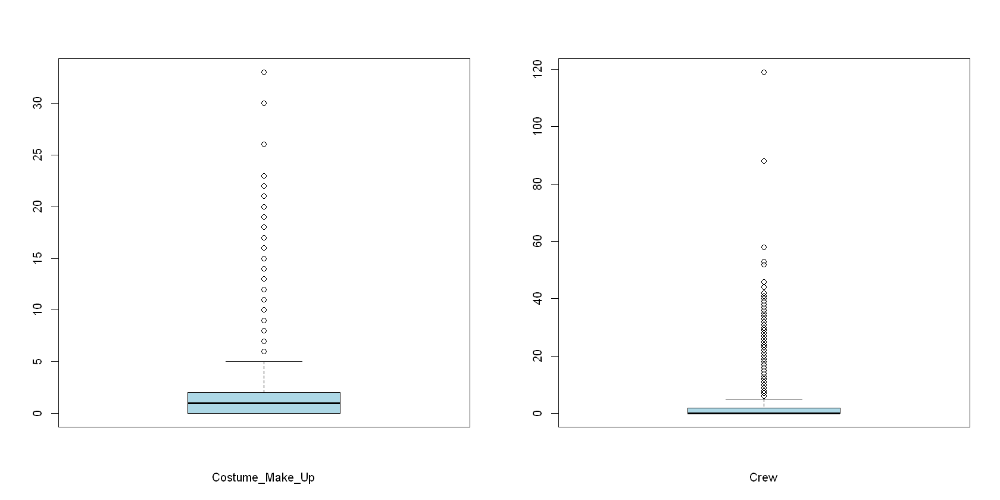

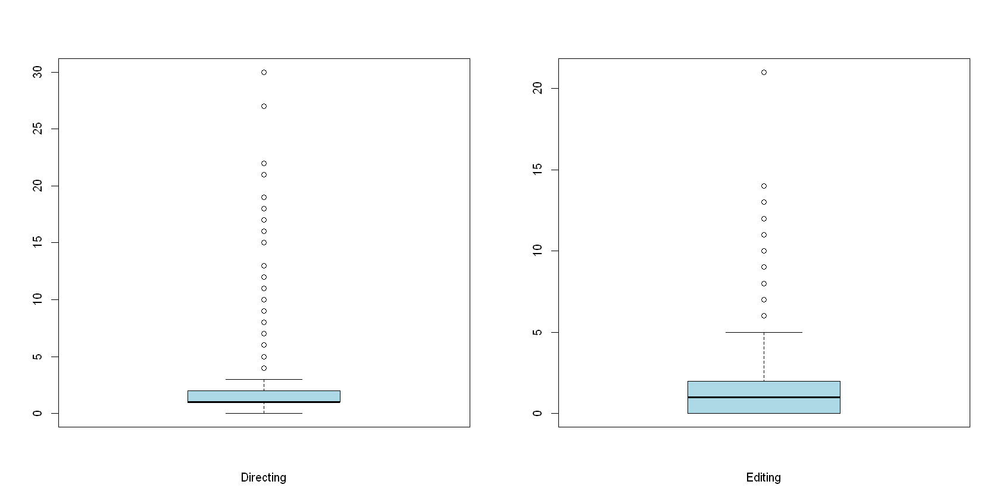

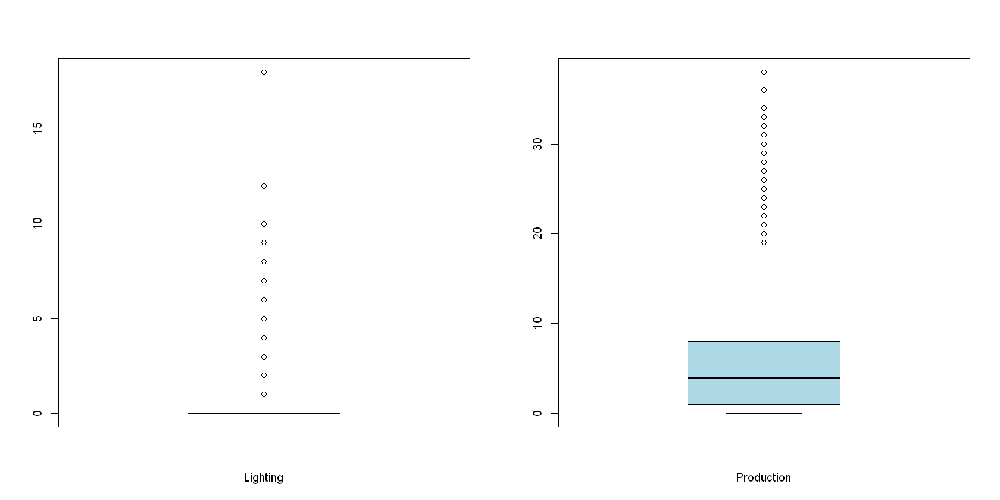

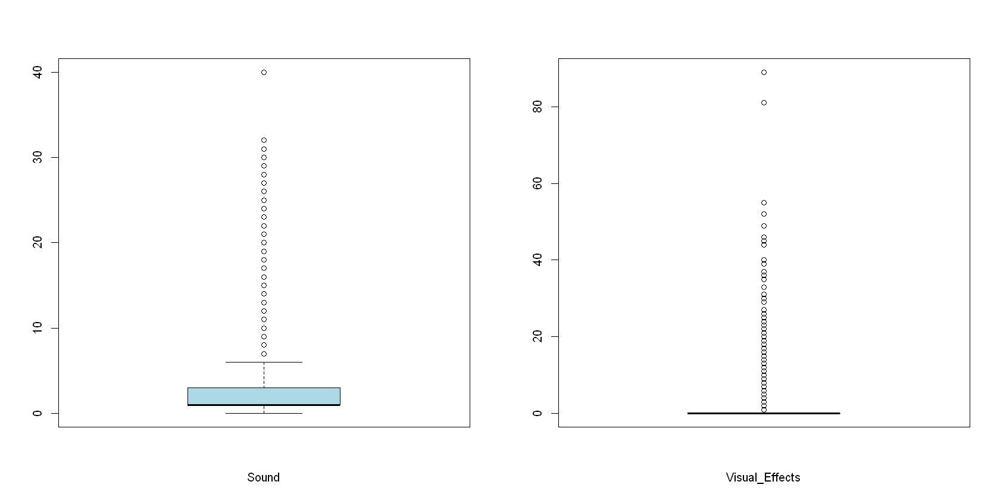

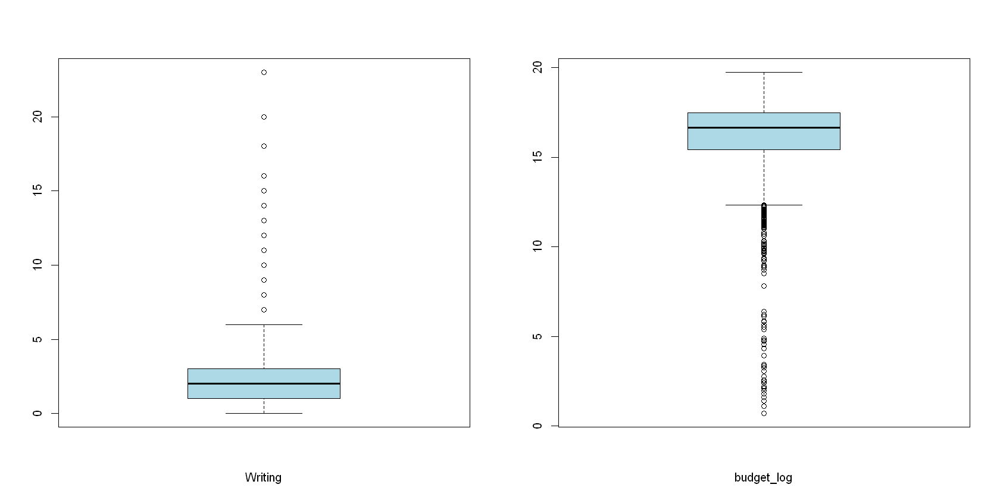

In [32]:
options(repr.plot.width =14, repr.plot.height = 7)
        par(mfrow=c(1,2))
for (n in numlst){
       boxplot(ff[[n]] , xlab = n, col = 'light blue')
    }

##### Outliers Matrix

In [33]:
outlierMatrix <- function(data,threshold=1.5) {
    vn <- names(data)
    outdata <- data.frame(row1=1:nrow(data))
    for(v in vn) {
        if(is.numeric(data[[v]])) {
            outlow <- quantile(data[[v]],probs = 0.25,na.rm = T) 
            outhigh <- quantile(data[[v]],probs = 0.75, na.rm = T)
            irq_level <- (outhigh - outlow) * threshold
            outlow <- outlow - irq_level
            outhigh <- outhigh +  irq_level
            mv <- ifelse(data[[v]] < outlow | data[[v]] > outhigh, 1, 0)
            outdata[v] <- mv
        } else {
            mv <- rep(0,nrow(data))
        }
    }
    outdata$row1 <- NULL
    return(outdata)
}


In [34]:
ff_out <- outlierMatrix(ff)
head(ff_out)

,movie_id,revenue,budget,runtime,popularity,release_year,release_month,Actors,Art,Camera,...,Music,Mystery,Romance,Science_Fiction,Thriller,TV_Movie,War,Western,revenue_log,budget_log
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0,0,0,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
3,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,NA,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,NA
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


#### Check if the distribution was changed after removing the outliers

In [35]:
res1 <- NULL
for (n in numlst){
    out <- ff[[n]]
    non <- ff[[n]][which(ff_out[[n]] == 0)]
    outnum <- length(out) - length(non)
    pval <- suppressWarnings(ks.test(out, non)$p.value )
    res1 <- rbind(res1, cbind(var = n, outliers_pct = outnum, distribution_changed = ifelse(pval < 0.05, '+', '-')))
}
res1

var,outliers_pct,distribution_changed
budget,2417,+
runtime,284,+
popularity,201,+
Actors,42,-
Art,731,+
Camera,708,+
Costume_Make_Up,1022,+
Crew,945,+
Directing,517,+
Editing,365,+


#### Check if the correlation was changed after removing the outliers
remove vars with SD = 0 after removing the outliers

In [36]:

res2 <- NULL 
for (n in numlst){
    if(sd(ff[[n]][which(ff_out[[n]] == 0)]) != 0){  
    out <- ff[[n]]
    non <- ff[[n]][which(ff_out[[n]] == 0)]
    revenue_out <- ff$revenue
    revenue_non <- ff$revenue[which(ff_out[[n]] == 0)]
    outdf <- data.frame(x_out = out, y_out = revenue_out)
    nondf <- data.frame(x_non = non, y_non = revenue_non)
    
    cr <- cocor(~ x_out + y_out | x_non + y_non, data = list(outdf, nondf))
    pval <- cr@fisher1925$p.value
    res2 <- rbind(res2, cbind(var = n, correlation_changed = ifelse(pval < 0.05, "+", "-")))
        }
}
res2

var,correlation_changed
budget,+
runtime,-
popularity,-
Art,+
Camera,+
Costume_Make_Up,+
Crew,+
Directing,-
Editing,-
Production,-


In [37]:
res <- left_join(data.frame(res1),data.frame(res2), by = 'var')
res$drop <- ifelse(res$distribution_changed == '+' & res$correlation_changed == '+', 'No', 'Yes')
res

var,outliers_pct,distribution_changed,correlation_changed,drop
<chr>,<chr>,<chr>,<chr>,<chr>
budget,2417,+,+,No
runtime,284,+,-,Yes
popularity,201,+,-,Yes
Actors,42,-,NA,Yes
Art,731,+,+,No
Camera,708,+,+,No
Costume_Make_Up,1022,+,+,No
Crew,945,+,+,No
Directing,517,+,-,Yes


##### Drop the outlier values are stand the critarion 

In [38]:
drop_out_lst <- as.list.data.frame(res[which(res[,5] == 'Yes'),][1])
drop_out_lst


$var
[1] "runtime"    "popularity" "Actors"     "Directing"  "Editing"   
[6] "Production" "Writing"

In [39]:
ff_wo_outliers <- ff

for (l in drop_out_lst$var){
    ff_wo_outliers[[l]][which(ff_out[[l]] == 1)] <- NA
}

head(ff_wo_outliers)
summary(ff_wo_outliers)

movie_id,revenue,budget,runtime,popularity,lang,release_date,release_year,release_month,Actors,...,Mystery,Romance,Science_Fiction,Thriller,TV_Movie,War,Western,revenue_log,budget_log,lang2
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<date>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
1,12314651,1.4e+07,93,6.575393,en,2015-02-20,2015,2,0,...,0,0,0,0,0,0,0,16.32630,16.45457,en
2,95149435,4.0e+07,113,8.248895,en,2004-08-06,2004,8,0,...,0,1,0,0,0,0,0,18.37096,17.50439,en
3,13092000,3.3e+06,105,NA,en,2014-10-10,2014,10,0,...,0,0,0,0,0,0,0,16.38751,15.00943,en
4,16000000,1.2e+06,122,3.174936,hi,2012-03-09,2012,3,0,...,0,0,0,1,0,0,0,16.58810,13.99783,hi
5,3923970,NA,118,1.148070,ko,2009-02-05,2009,2,0,...,0,0,0,1,0,0,0,15.18261,NA,other
6,3261638,8.0e+06,83,0.743274,en,1987-08-06,1987,8,0,...,0,0,0,0,0,0,0,14.99774,15.89495,en


    movie_id       revenue              budget             runtime     
 Min.   :   1   Min.   :1.000e+00   Min.   :        1   Min.   : 59.0  
 1st Qu.:1850   1st Qu.:2.387e+06   1st Qu.:  5061474   1st Qu.: 94.0  
 Median :3699   Median :1.681e+07   Median : 17000000   Median :103.0  
 Mean   :3699   Mean   :6.681e+07   Mean   : 31113390   Mean   :105.9  
 3rd Qu.:5548   3rd Qu.:6.893e+07   3rd Qu.: 40000000   3rd Qu.:116.0  
 Max.   :7398   Max.   :1.520e+09   Max.   :380000000   Max.   :154.0  
                NA's   :4398        NA's   :2023        NA's   :284    
   popularity         lang            release_date         release_year 
 Min.   : 0.000   Length:7399        Min.   :1921-01-21   Min.   :1921  
 1st Qu.: 3.826   Class :character   1st Qu.:1992-11-18   1st Qu.:1992  
 Median : 7.273   Mode  :character   Median :2004-07-27   Median :2004  
 Mean   : 7.446                      Mean   :2000-03-19   Mean   :2000  
 3rd Qu.:10.563                      3rd Qu.:2011-06-24   3

### 6 - handle missing values

In [40]:
missingMatrix <- function(data) {
    vn <- names(data)
    missdata <- data.frame(row1=1:nrow(data))
    for(v in vn) {
        mv <- ifelse(is.na(data[[v]]),1,0)
        missdata[v] <- mv
    }
    missdata$row1 <- NULL
    return(missdata)
}

getMissingness <- function (data, getRows = FALSE) {
    require(dplyr)
    l <- nrow(data)
    vn <- names(data)
    nadf <- data
    cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(na.count > 0)
    totmiss <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::tally()
    idx <- NULL
    msg <- (paste("This dataset has ", as.character(totmiss), 
        " (", as.character(round(totmiss/nrow(data) * 100, 1)), 
        "%)", " complete rows. Original data has ", nrow(data), 
        " rows.", sep = ""))
    if (getRows == TRUE & totmiss != 0) {
        nadf$rn <- seq_len(nrow(data))
        idx <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::select(rn)
    }
    print(list(head(cnt, n = 10), msg))
    return(list(missingness = cnt, message = msg, rows = idx$rn))
}

Find the rate of missing values in each column

In [41]:
mm <- getMissingness(data = ff_wo_outliers)

[[1]]
           var na.count rate
1      revenue     4398 59.4
2  revenue_log     4398 59.4
3       budget     2023 27.3
4   budget_log     2023 27.3
5    Directing      517  7.0
6      Editing      365  4.9
7      runtime      284  3.8
8   Production      253  3.4
9   popularity      201  2.7
10     Writing      180  2.4

[[2]]
[1] "This dataset has 1773 (24%) complete rows. Original data has 7399 rows."



In [42]:
mm$missingness

var,na.count,rate
<chr>,<dbl>,<dbl>
revenue,4398,59.4
revenue_log,4398,59.4
budget,2023,27.3
budget_log,2023,27.3
Directing,517,7.0
Editing,365,4.9
runtime,284,3.8
Production,253,3.4
popularity,201,2.7


Generates missing matrix where every NA in the original matrix sign as 1

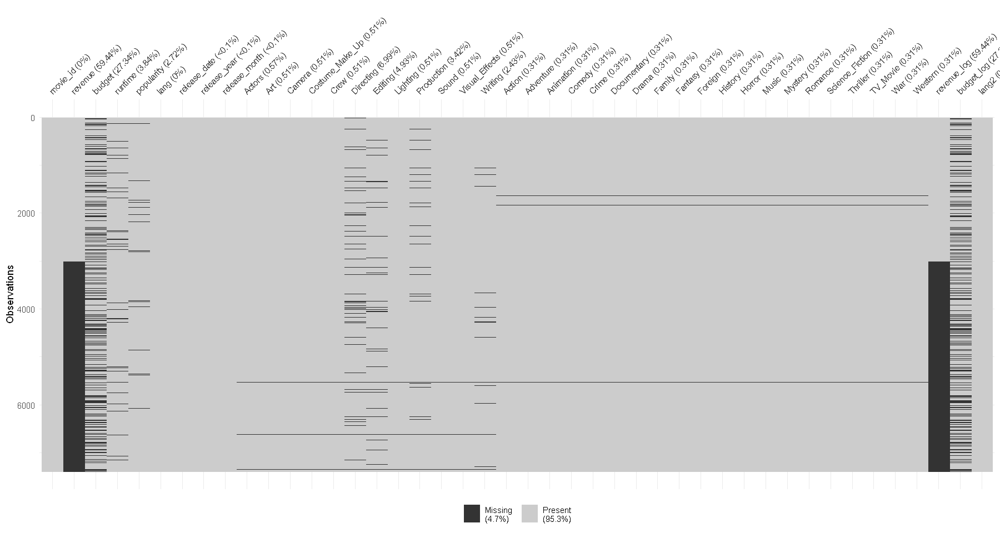

In [43]:
ff_na <- missingMatrix(ff_wo_outliers)

library(naniar)
options(repr.plot.width = 15, repr.plot.height = 8)
vis_miss(ff_wo_outliers,warn_large_data=F)

In [44]:
ff_na <- ff_na[,mm$missingness$var]
head(ff_na)

,revenue,revenue_log,budget,budget_log,Directing,Editing,runtime,Production,popularity,Writing,...,Mystery,Romance,Science_Fiction,Thriller,TV_Movie,War,Western,release_date,release_year,release_month
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


check for the correlation between the missing indicators. This can show variables that have similar patterns of missingness.

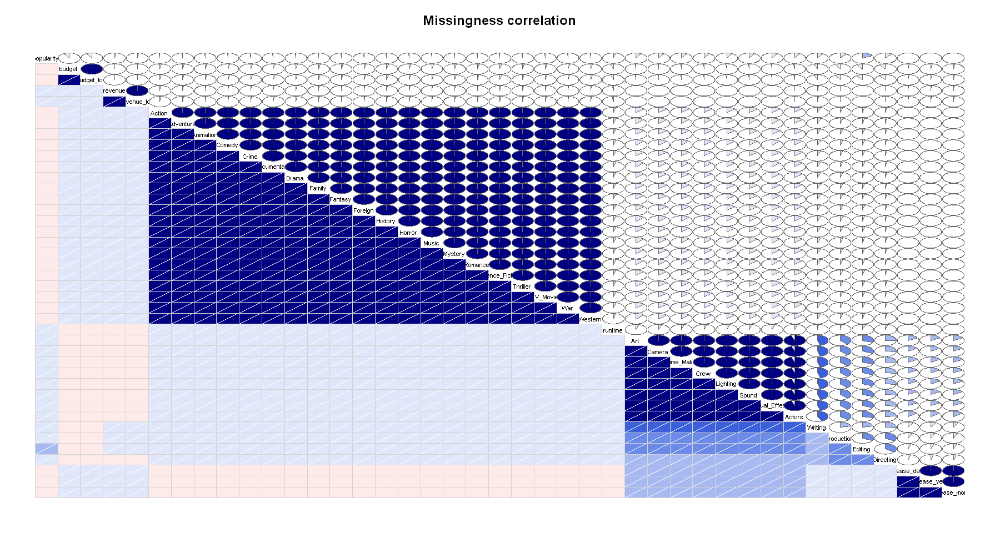

In [45]:
corrgram(ff_na, order=TRUE, lower.panel=panel.shade,
  upper.panel=panel.pie, text.panel=panel.txt,
  main="Missingness correlation")

###### Find the rate of missing data in rows

In [46]:
ffna_sum <- ff_na
ffna_sum$pct <- rowSums(ff_na)/ncol(ff_na)
ffna_sum$movie_id <- ff_wo_outliers$movie_id
ffna_sum %>% group_by(pct) %>% tally

pct,n
<dbl>,<int>
0.00000000,1773
0.02439024,275
0.04878049,3341
0.07317073,547
0.09756098,1278
0.12195122,112
0.14634146,12
0.17073171,3
0.19512195,1


remove row with missing rate grater then 30 %

In [47]:
ff_wo_outliers_mr <- ff_wo_outliers
ff_wo_outliers_mr$missing_row_rate <- rowSums(ff_na)/ncol(ff_na)
ff_wo_outliers_mr <- ff_wo_outliers_mr %>% filter(ff_wo_outliers_mr$missing_row_rate < 0.3)

In [48]:
ff_na1 <- missingMatrix(ff_wo_outliers_mr)
ff_na1 <- ff_na1[,mm$missingness$var]

In [49]:
ffna_sum <- ff_na1
ffna_sum$pct <- rowSums(ff_na1)/ncol(ff_na1)
ffna_sum$movie_id <- ff_wo_outliers_mr$movie_id
ffna_sum %>% group_by(pct) %>% tally

pct,n
<dbl>,<int>
0.00000000,1773
0.02439024,275
0.04878049,3341
0.07317073,547
0.09756098,1278
0.12195122,112
0.14634146,12
0.17073171,3
0.19512195,1


In [50]:
nrow(ff_wo_outliers)

nrow(ff_wo_outliers_mr)

[1] 7399

[1] 7348

In [51]:
mm1 <- getMissingness(data = ff_wo_outliers_mr)

[[1]]
           var na.count rate
1      revenue     4363 59.4
2  revenue_log     4363 59.4
3       budget     2005 27.3
4   budget_log     2005 27.3
5    Directing      485  6.6
6      Editing      333  4.5
7      runtime      275  3.7
8   Production      221  3.0
9   popularity      193  2.6
10     Writing      148  2.0

[[2]]
[1] "This dataset has 1773 (24.1%) complete rows. Original data has 7348 rows."



In [52]:
mm1$missingness

var,na.count,rate
<chr>,<dbl>,<dbl>
revenue,4363,59.4
revenue_log,4363,59.4
budget,2005,27.3
budget_log,2005,27.3
Directing,485,6.6
Editing,333,4.5
runtime,275,3.7
Production,221,3.0
popularity,193,2.6


### Find the missingness mechanism


#### Density of each var with and without missing values

library(gridExtra)
library(ggplot2)

for (m in mm$missingness$var) {
    p <- list()
    i <- 1
    for (v in numlst) {
        if (v != m) {
            ff <- data.frame(v=ff_wo_outliers_mr[[v]],m=factor(ff_na1[[m]]))
            p[[i]] <- suppressMessages(ggplot(data=ff,aes(x=v,group=m,color=m)) +
              geom_density()+labs(title=paste(v, "(miss=", m,")"),x =v))
            i <- i + 1
        }
    }
    do.call(grid.arrange,p)
}


###### Using KS test to find if the missingness is completely at random or not 

In [53]:
res2 <- NULL
for (m in mm1$missingness$var){
    p <- list()
    for (n in numlst){
        if (n != m){
            miss <- ff_wo_outliers_mr[[n]]
            non <- ff_wo_outliers_mr[[n]][which(ff_na[[n]] == 0)]
            missnum <- length(miss) - length(non)
            pval <- suppressWarnings(ks.test(miss, non)$p.value)
            res2 <- rbind(res2, cbind(var = n, missing = m, missing_cnt = missnum, distribution_changed = ifelse(pval < 0.05, '+', '-')))
            
        }
    }
}

res2

var,missing,missing_cnt,distribution_changed
budget,revenue,1972,-
runtime,revenue,233,-
popularity,revenue,150,-
Actors,revenue,-9,-
Art,revenue,-13,-
Camera,revenue,-13,-
Costume_Make_Up,revenue,-13,-
Crew,revenue,-13,-
Directing,revenue,466,-
Editing,revenue,314,-


In [54]:
res2 <- data.frame(res2)
res2 %>% filter(distribution_changed == '+')

var,missing,missing_cnt,distribution_changed
<chr>,<chr>,<chr>,<chr>


No var can explain the missingness of other var so:
all the missingness are completly at random and I would do imputation for the missing values

### Imputation

In [55]:
summary(ff_wo_outliers_mr)

    movie_id       revenue              budget             runtime     
 Min.   :   1   Min.   :1.000e+00   Min.   :        1   Min.   : 59.0  
 1st Qu.:1846   1st Qu.:2.405e+06   1st Qu.:  5200000   1st Qu.: 94.0  
 Median :3692   Median :1.686e+07   Median : 17000000   Median :103.0  
 Mean   :3695   Mean   :6.598e+07   Mean   : 30922386   Mean   :105.9  
 3rd Qu.:5545   3rd Qu.:6.873e+07   3rd Qu.: 40000000   3rd Qu.:116.0  
 Max.   :7398   Max.   :1.520e+09   Max.   :380000000   Max.   :154.0  
                NA's   :4363        NA's   :2005        NA's   :275    
   popularity         lang            release_date         release_year 
 Min.   : 0.000   Length:7348        Min.   :1921-01-21   Min.   :1921  
 1st Qu.: 3.865   Class :character   1st Qu.:1992-10-21   1st Qu.:1992  
 Median : 7.292   Mode  :character   Median :2004-07-23   Median :2004  
 Mean   : 7.465                      Mean   :2000-03-09   Mean   :2000  
 3rd Qu.:10.566                      3rd Qu.:2011-06-16   3

In [56]:
mm1

var,na.count,rate
<chr>,<dbl>,<dbl>
revenue,4363,59.4
revenue_log,4363,59.4
budget,2005,27.3
budget_log,2005,27.3
Directing,485,6.6
Editing,333,4.5
runtime,275,3.7
Production,221,3.0
popularity,193,2.6


I will not handle the missing values from revenue and revenue_log because they are the outcome. 

I will change the budget var to categories due to high (~30%) rate of missing values


I will imputate the rest

In [57]:
ff_final_knn <- kNN(ff_wo_outliers_mr, variable = c('Directing', 'Editing', 'runtime', 'Production', 'popularity'
                                                    ,'Writing' ,'Actors' ,'Art' ,'Camera' ,'Costume_Make_Up','Crew'
                                                    ,'Lighting','Sound','Visual_Effects'))

In [58]:
ff_final_knn$budeget_cat <- as.factor(ifelse(is.na(ff_final_knn$budget) == T, 'qNA',
                                    ifelse(ff_final_knn$budget < quantile(ff_final_knn$budget, 0.2, na.rm = T), 'q2',
                                    ifelse(ff_final_knn$budget < quantile(ff_final_knn$budget, 0.4, na.rm = T), 'q4',
                                    ifelse(ff_final_knn$budget < quantile(ff_final_knn$budget, 0.6, na.rm = T), 'q6',
                                    ifelse(ff_final_knn$budget < quantile(ff_final_knn$budget, 0.8, na.rm = T), 'q8', 'q10'
                                          ))))))

In [59]:
summary(ff_final_knn)

    movie_id       revenue              budget             runtime     
 Min.   :   1   Min.   :1.000e+00   Min.   :        1   Min.   : 59.0  
 1st Qu.:1846   1st Qu.:2.405e+06   1st Qu.:  5200000   1st Qu.: 94.0  
 Median :3692   Median :1.686e+07   Median : 17000000   Median :104.0  
 Mean   :3695   Mean   :6.598e+07   Mean   : 30922386   Mean   :106.2  
 3rd Qu.:5545   3rd Qu.:6.873e+07   3rd Qu.: 40000000   3rd Qu.:117.0  
 Max.   :7398   Max.   :1.520e+09   Max.   :380000000   Max.   :154.0  
                NA's   :4363        NA's   :2005                       
   popularity            lang            release_date         release_year 
 Min.   : 0.000001   Length:7348        Min.   :1921-01-21   Min.   :1921  
 1st Qu.: 3.968447   Class :character   1st Qu.:1992-10-21   1st Qu.:1992  
 Median : 7.420632   Mode  :character   Median :2004-07-23   Median :2004  
 Mean   : 7.567136                      Mean   :2000-03-09   Mean   :2000  
 3rd Qu.:10.739023                      3rd 

In [60]:
names(ff_final_knn)

[1] "movie_id"            "revenue"             "budget"             
 [4] "runtime"             "popularity"          "lang"               
 [7] "release_date"        "release_year"        "release_month"      
[10] "Actors"              "Art"                 "Camera"             
[13] "Costume_Make_Up"     "Crew"                "Directing"          
[16] "Editing"             "Lighting"            "Production"         
[19] "Sound"               "Visual_Effects"      "Writing"            
[22] "Action"              "Adventure"           "Animation"          
[25] "Comedy"              "Crime"               "Documentary"        
[28] "Drama"               "Family"              "Fantasy"            
[31] "Foreign"             "History"             "Horror"             
[34] "Music"               "Mystery"             "Romance"            
[37] "Science_Fiction"     "Thriller"            "TV_Movie"           
[40] "War"                 "Western"             "revenue_log"        
[43] "budget_log"          "lang2"               "missing_row_rate"   
[46] "Directing_imp"       "Editing_imp"         "runtime_imp"        
[49] "Production_imp"      "popularity_imp"      "Writing_imp"        
[52] "Actors_imp"          "Art_imp"             "Camera_imp"         
[55] "Costume_Make_Up_imp" "Crew_imp"            "Lighting_imp"       
[58] "Sound_imp"           "Visual_Effects_imp"  "budeget_cat"

In [61]:
ff_final <- ff_final_knn[c('movie_id','revenue','revenue_log','budeget_cat','runtime','popularity','lang2','release_date'
                           ,'release_year','release_month','Actors','Art','Camera','Costume_Make_Up','Crew'
                           ,'Directing','Editing','Lighting','Production','Sound','Visual_Effects','Writing'
                           ,'Action','Adventure','Animation','Comedy','Crime','Documentary','Drama','Family'
                           ,'Fantasy','Foreign','History','Horror','Music','Mystery','Romance','Science_Fiction'
                           ,'Thriller','TV_Movie','War','Western')]

### EDA on the final data 

In [62]:
numlst <- c('runtime' 
            ,'popularity'   
            ,'Actors' 
            ,'Art' 
            ,'Camera' 
            ,'Costume_Make_Up' 
            ,'Crew' 
            ,'Directing' 
            ,'Editing' 
            ,'Lighting' 
            ,'Production' 
            ,'Sound' 
            ,'Visual_Effects' 
            ,'Writing'
            )
catlst <- c('budeget_cat'
            ,'lang2'
            ,'release_year' 
            ,'release_month'
            ,'Action' 
            ,'Adventure' 
            ,'Animation' 
            ,'Comedy' 
            ,'Crime' 
            ,'Documentary' 
            ,'Drama' 
            ,'Family' 
            ,'Fantasy' 
            ,'Foreign' 
            ,'History' 
            ,'Horror' 
            ,'Music' 
            ,'Mystery' 
            ,'Romance' 
            ,'Science_Fiction' 
            ,'Thriller' 
            ,'TV_Movie' 
            ,'War' 
            ,'Western'
            )
binlst <- c('Action' 
            ,'Adventure' 
            ,'Animation' 
            ,'Comedy' 
            ,'Crime' 
            ,'Documentary' 
            ,'Drama' 
            ,'Family' 
            ,'Fantasy' 
            ,'Foreign' 
            ,'History' 
            ,'Horror' 
            ,'Music' 
            ,'Mystery' 
            ,'Romance' 
            ,'Science_Fiction' 
            ,'Thriller' 
            ,'TV_Movie' 
            ,'War' 
            ,'Western'
            )

numlst
catlst 
binlst


[1] "runtime"         "popularity"      "Actors"          "Art"            
 [5] "Camera"          "Costume_Make_Up" "Crew"            "Directing"      
 [9] "Editing"         "Lighting"        "Production"      "Sound"          
[13] "Visual_Effects"  "Writing"

[1] "budeget_cat"     "lang2"           "release_year"    "release_month"  
 [5] "Action"          "Adventure"       "Animation"       "Comedy"         
 [9] "Crime"           "Documentary"     "Drama"           "Family"         
[13] "Fantasy"         "Foreign"         "History"         "Horror"         
[17] "Music"           "Mystery"         "Romance"         "Science_Fiction"
[21] "Thriller"        "TV_Movie"        "War"             "Western"

[1] "Action"          "Adventure"       "Animation"       "Comedy"         
 [5] "Crime"           "Documentary"     "Drama"           "Family"         
 [9] "Fantasy"         "Foreign"         "History"         "Horror"         
[13] "Music"           "Mystery"         "Romance"         "Science_Fiction"
[17] "Thriller"        "TV_Movie"        "War"             "Western"

In [63]:
summary(ff_final)

    movie_id       revenue           revenue_log     budeget_cat
 Min.   :   1   Min.   :1.000e+00   Min.   : 0.693   q10:1088   
 1st Qu.:1846   1st Qu.:2.405e+06   1st Qu.:14.693   q2 :1035   
 Median :3692   Median :1.686e+07   Median :16.641   q4 :1084   
 Mean   :3695   Mean   :6.598e+07   Mean   :15.967   q6 :1054   
 3rd Qu.:5545   3rd Qu.:6.873e+07   3rd Qu.:18.046   q8 :1082   
 Max.   :7398   Max.   :1.520e+09   Max.   :21.142   qNA:2005   
                NA's   :4363        NA's   :4363                
    runtime        popularity           lang2            release_date       
 Min.   : 59.0   Min.   : 0.000001   Length:7348        Min.   :1921-01-21  
 1st Qu.: 94.0   1st Qu.: 3.968447   Class :character   1st Qu.:1992-10-21  
 Median :104.0   Median : 7.420632   Mode  :character   Median :2004-07-23  
 Mean   :106.2   Mean   : 7.567136                      Mean   :2000-03-09  
 3rd Qu.:117.0   3rd Qu.:10.739023                      3rd Qu.:2011-06-16  
 Max.   :154.0   M

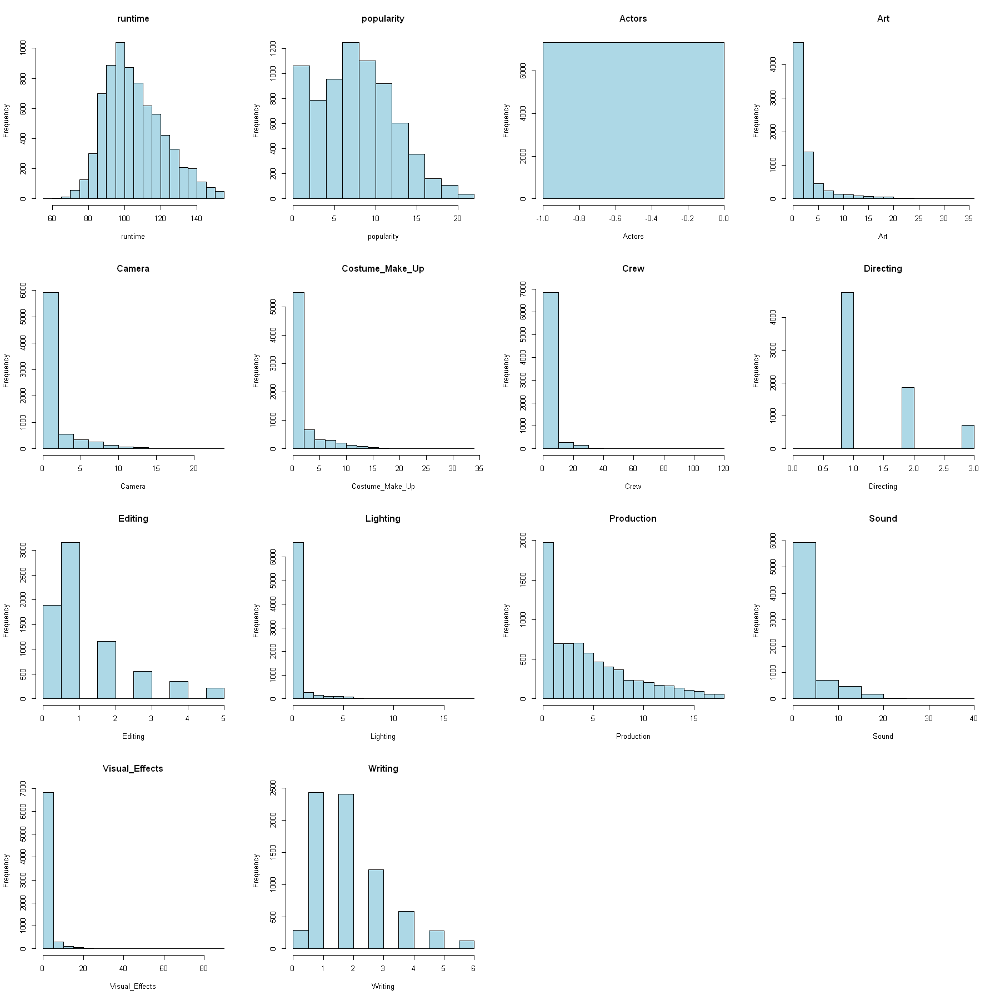

In [64]:
options(repr.plot.width =15, repr.plot.height = 15)
par(mfrow=c(4,4))
for (n in numlst){
    hist(as.numeric(ff_final[[n]]), xlab = n, main = n, col = 'lightblue')
   }


thre is a problem with the actors ....

In [65]:
table(ff_final$lang2)


   en    es    fr    hi    ja other    ru 
 6313    95   199   118    90   429   104 

In [66]:
table(ff_final$release_month,ff_final$lang2)

    
      en  es  fr  hi  ja other  ru
  1  421   4  18  11   3    47   5
  2  439   2  13  10   0    41  10
  3  487  12  13   3   6    28   9
  4  491   9  17   6   6    20   8
  5  476   5  32  10   3    47   6
  6  524   6   9  12   5    25  10
  7  474   4   7  13  29    29   5
  8  555  12  13  16   6    47   6
  9  779  16  28  11   8    49   9
  10 602  12  25   6   5    31  11
  11 470   9  11  11  11    22   4
  12 595   4  13   9   8    43  21

##### compare all the numeric vars against the categorical ones

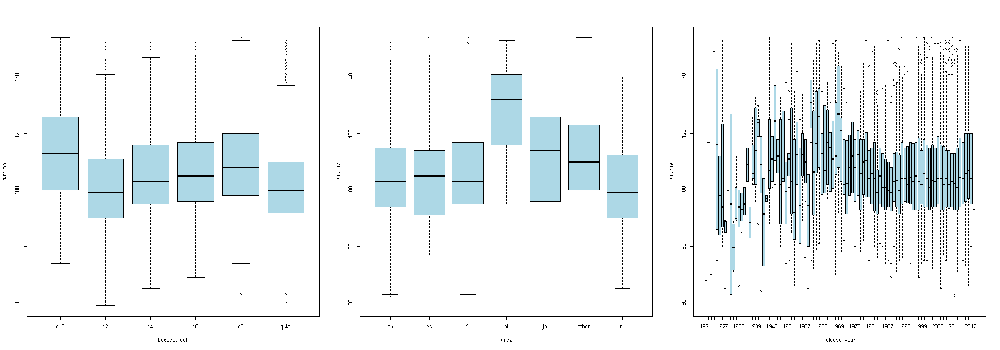

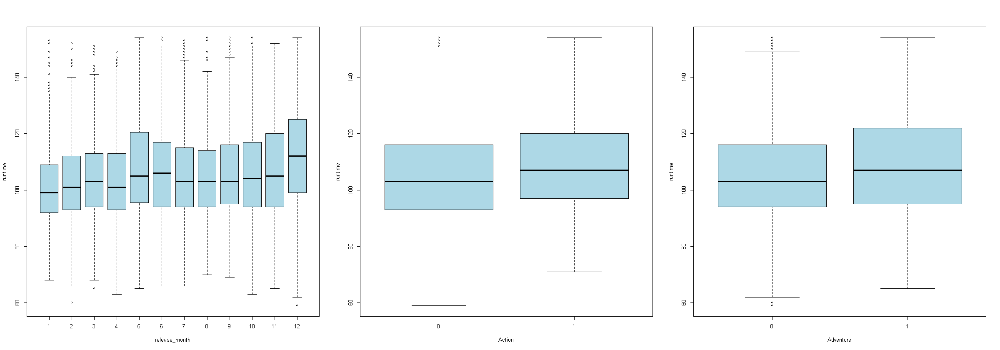

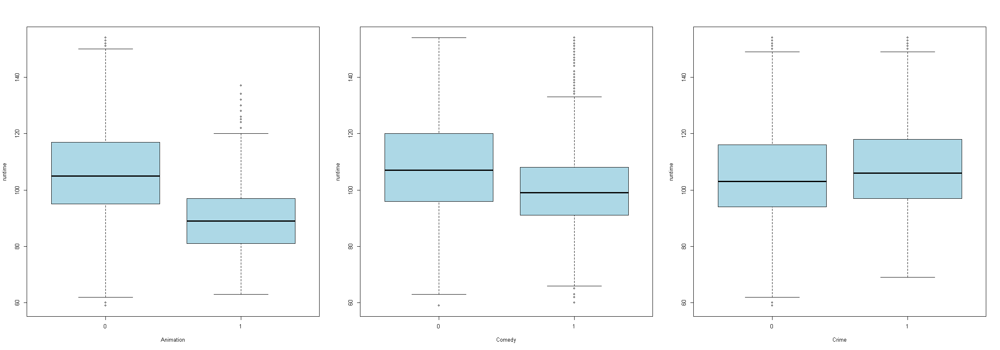

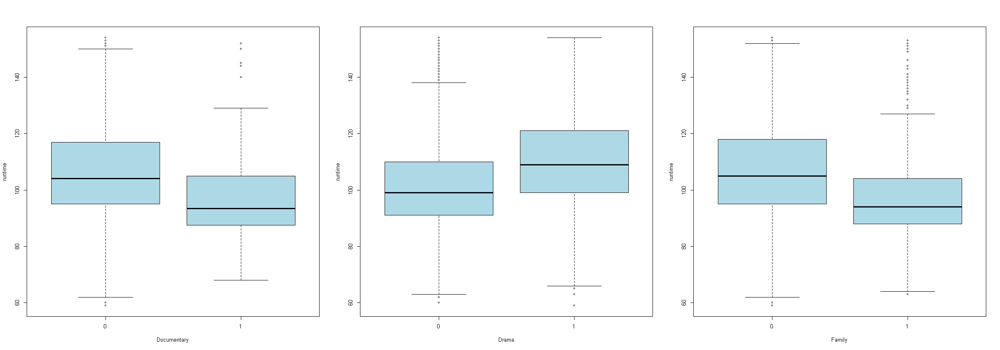

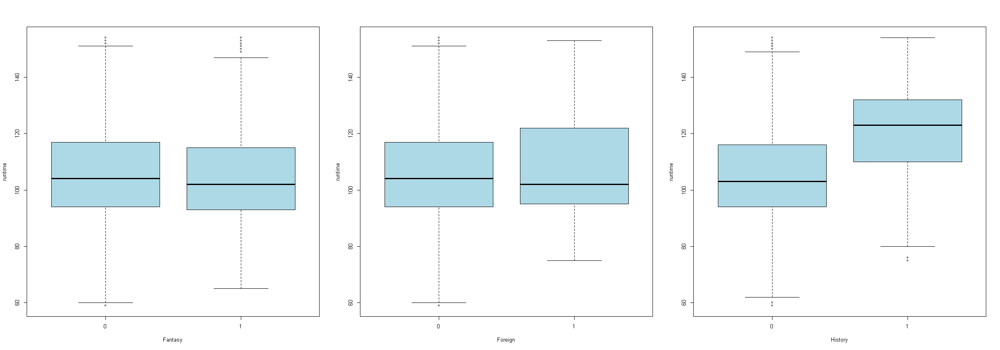

...

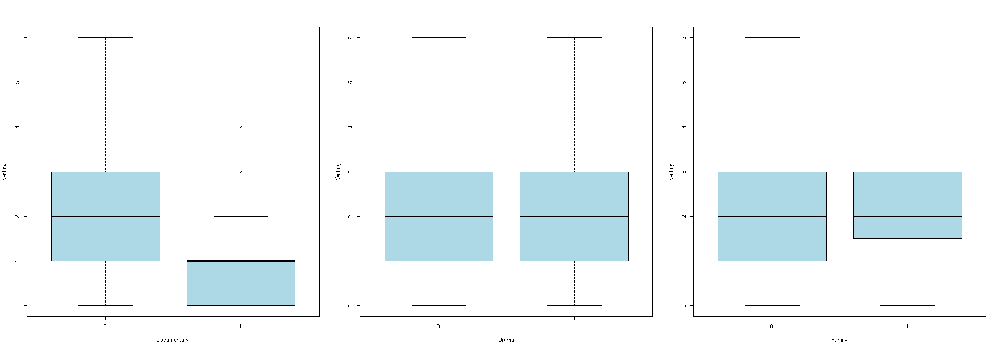

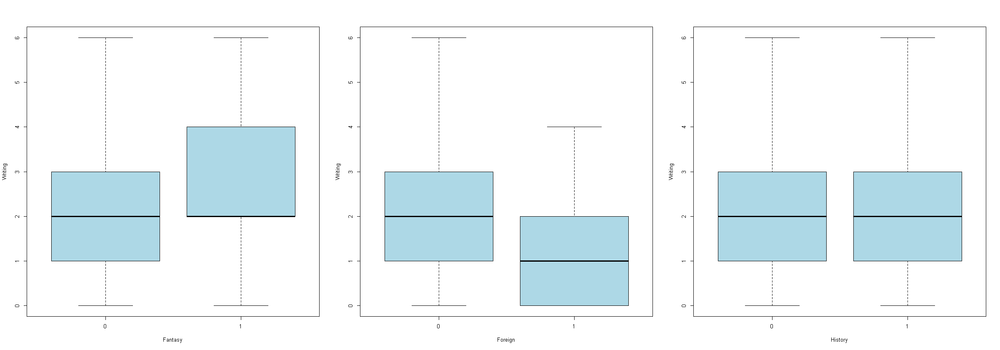

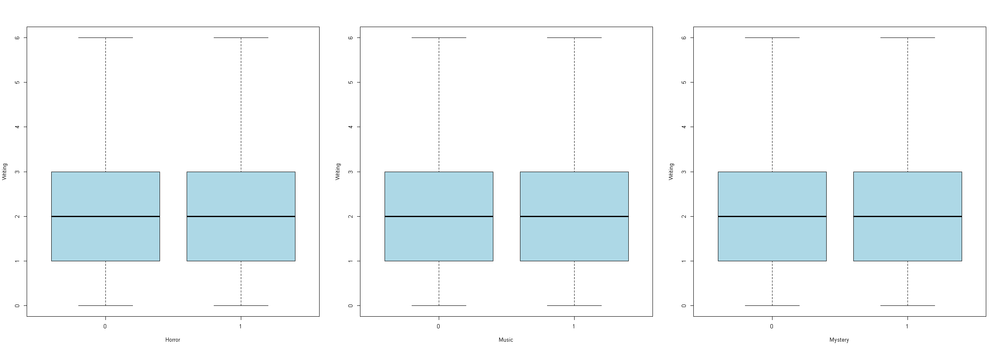

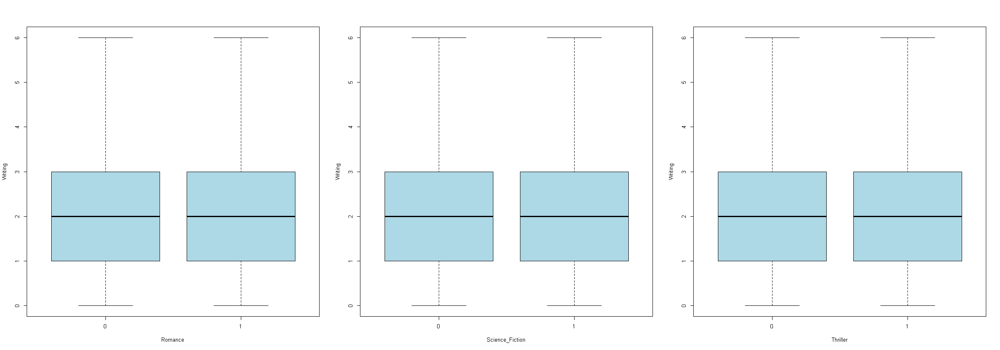

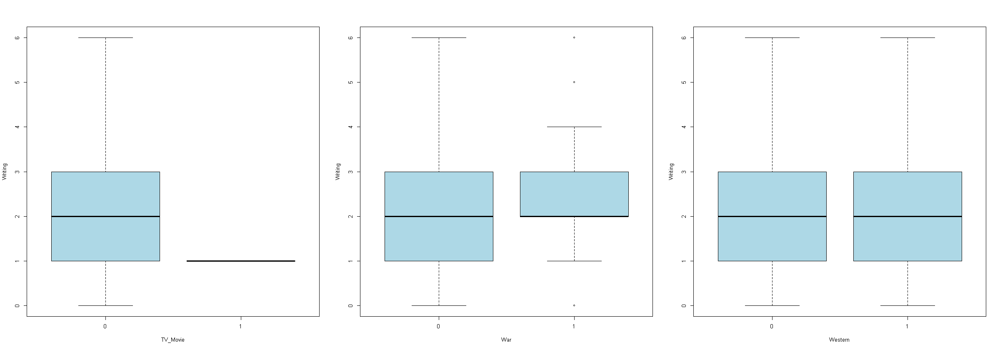

In [67]:
options(repr.plot.width =20, repr.plot.height = 7)
        par(mfrow=c(1,3))
for (n in numlst){
    for (s in catlst){
        boxplot(ff_final[[n]] ~ ff_final[[s]], xlab = s, ylab = n, col='light blue')
    }
}


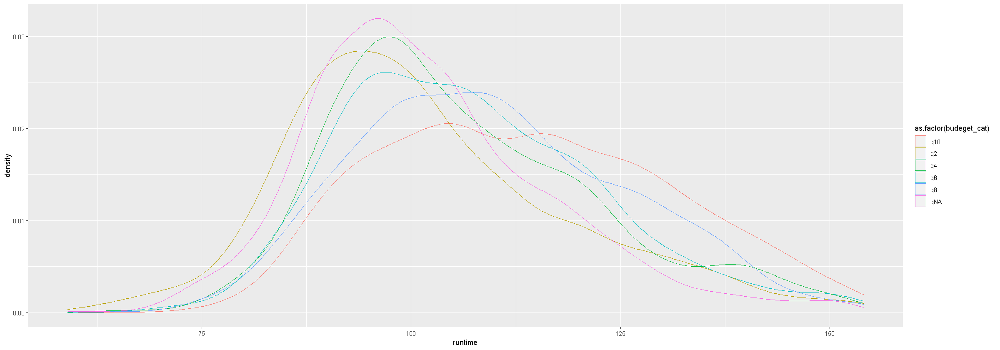

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

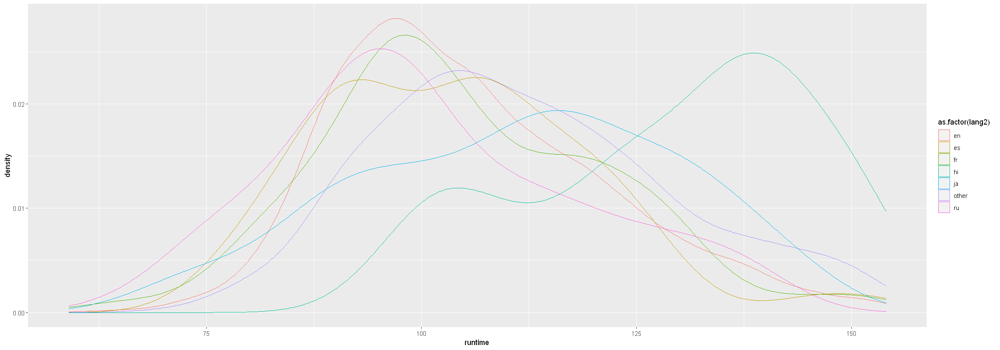

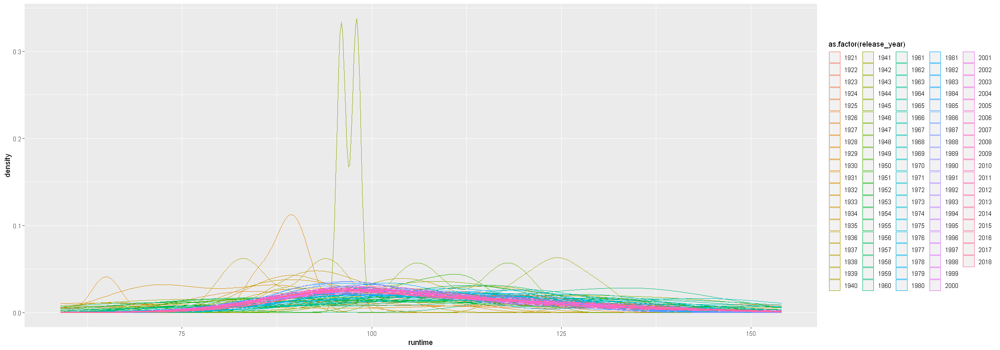

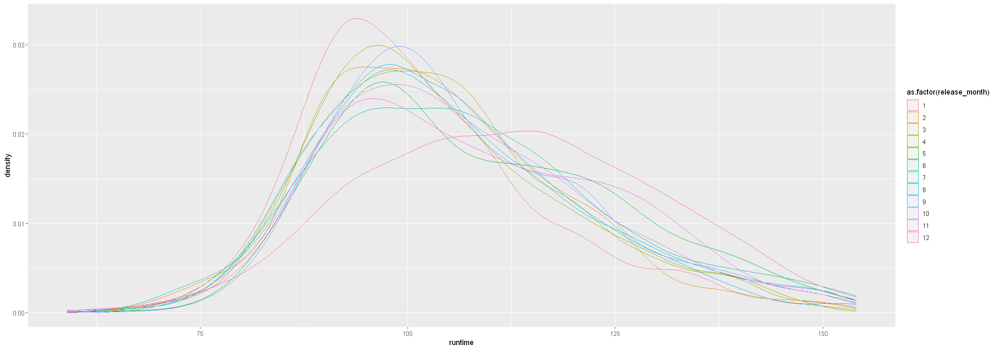

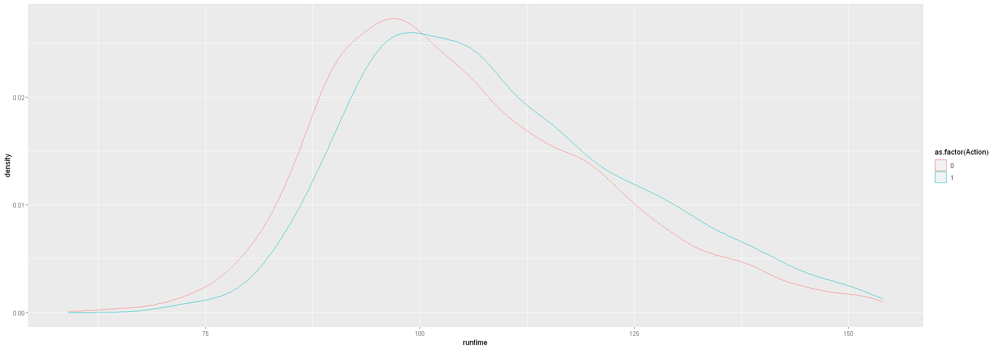

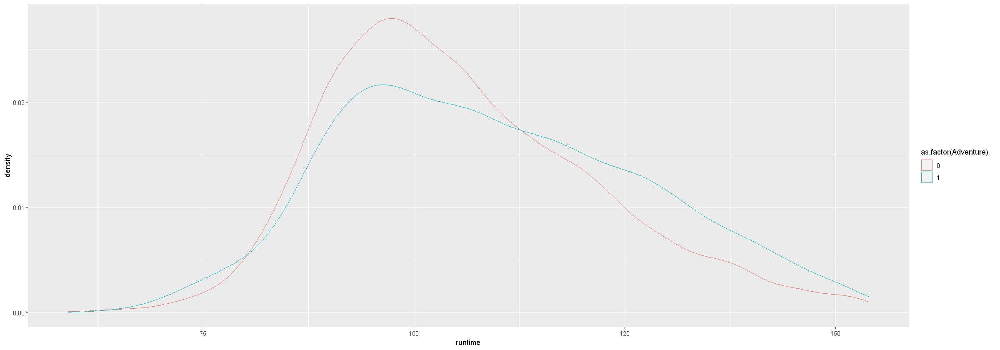

...

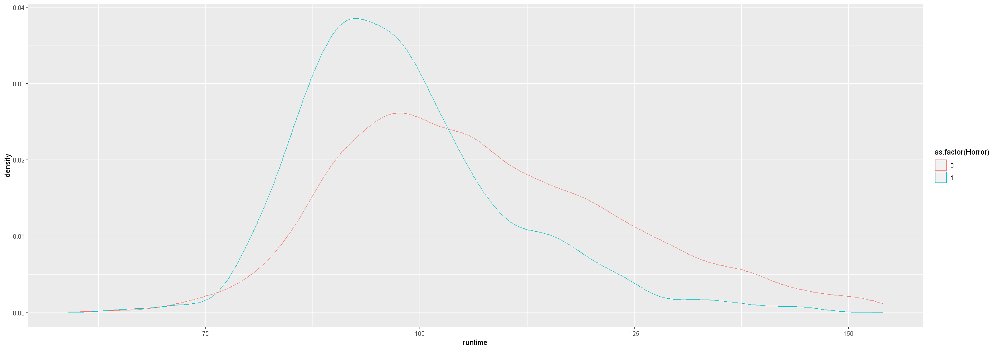

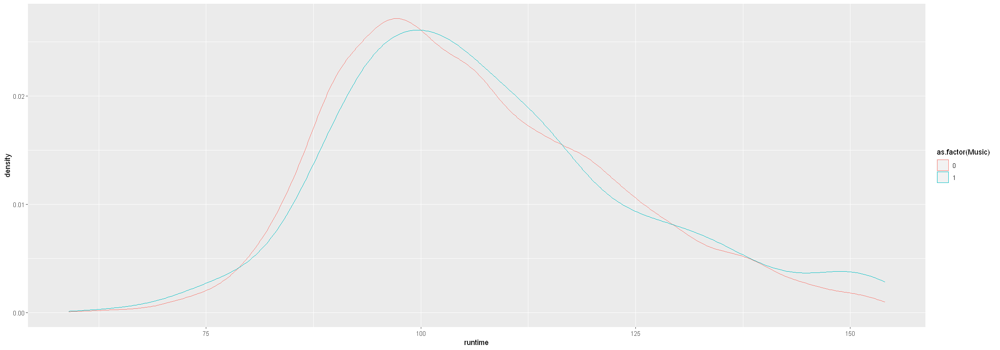

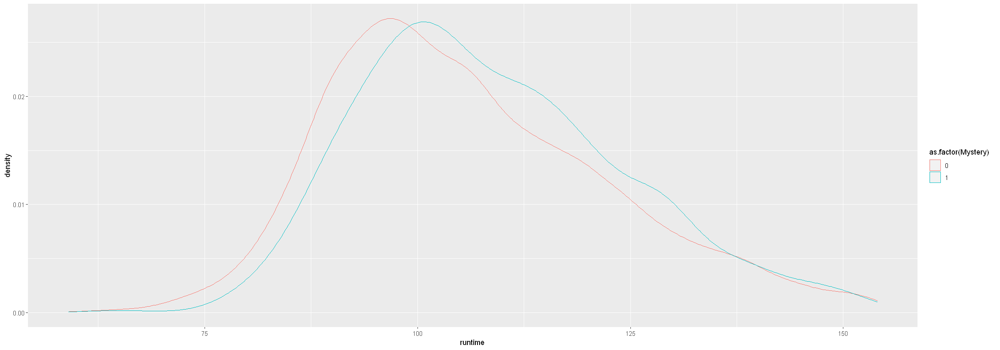

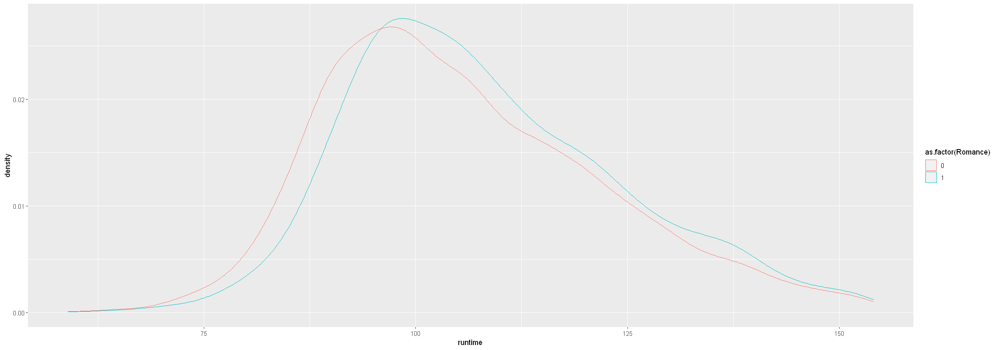

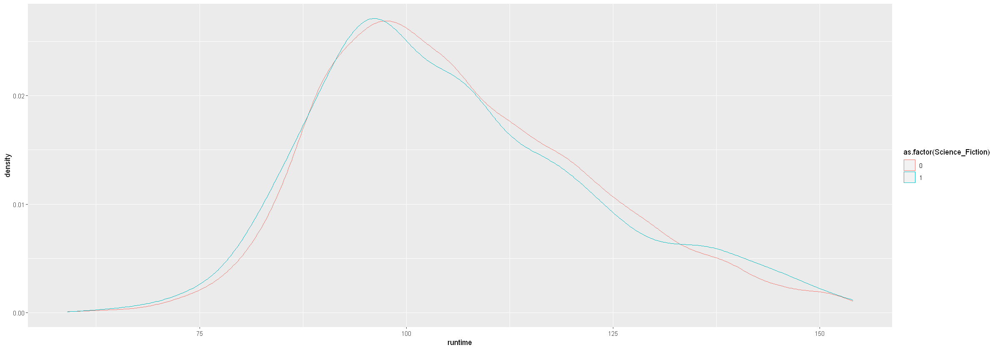

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


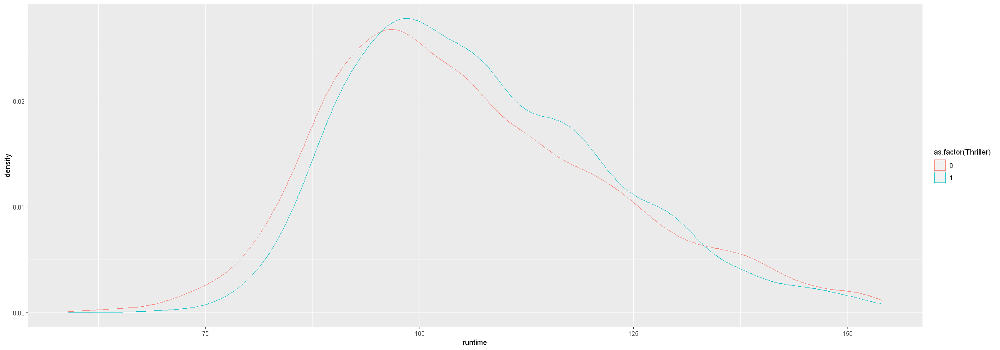

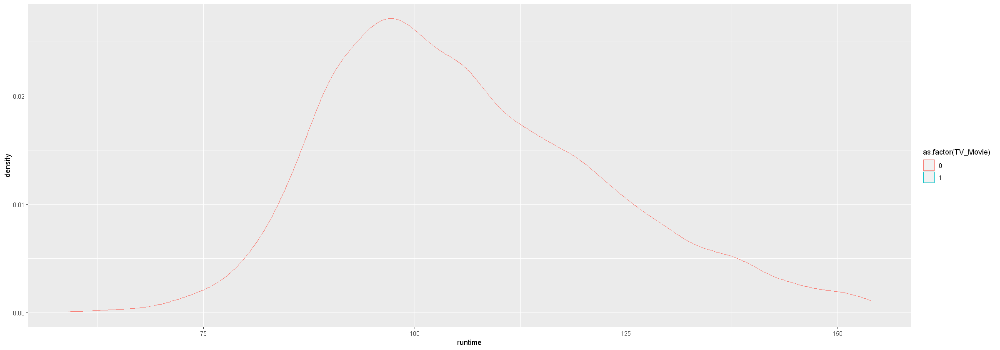

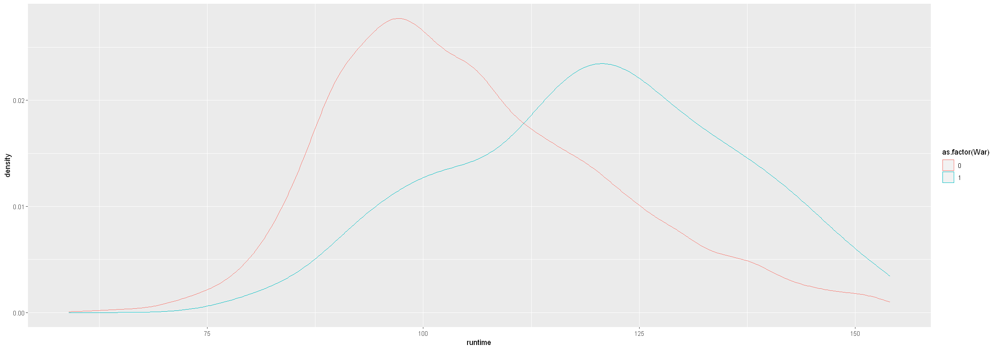

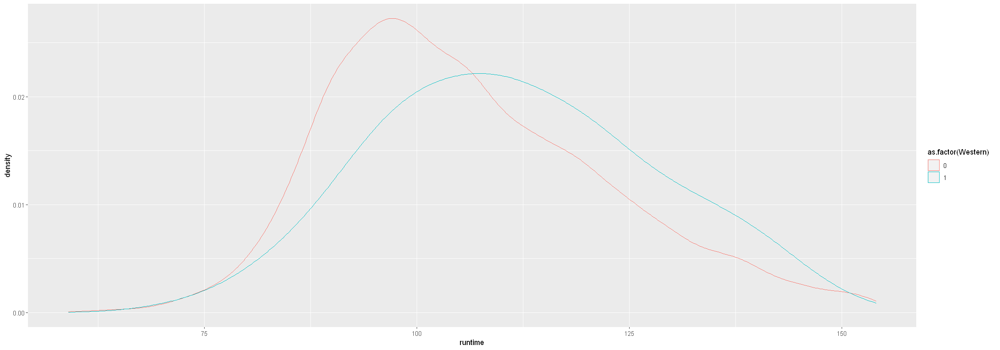

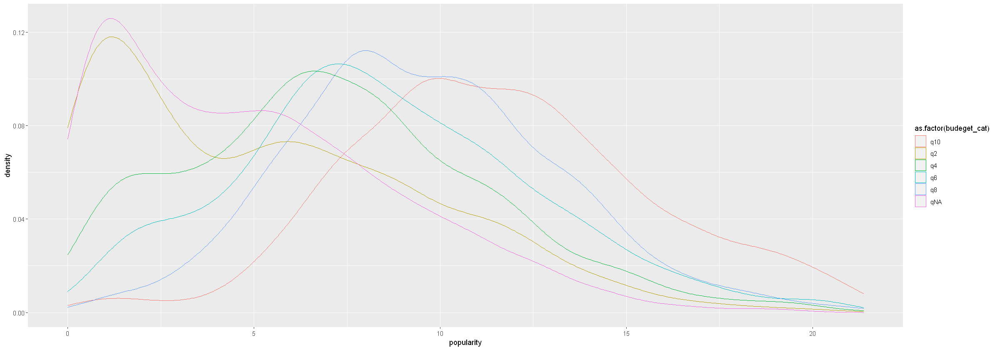

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

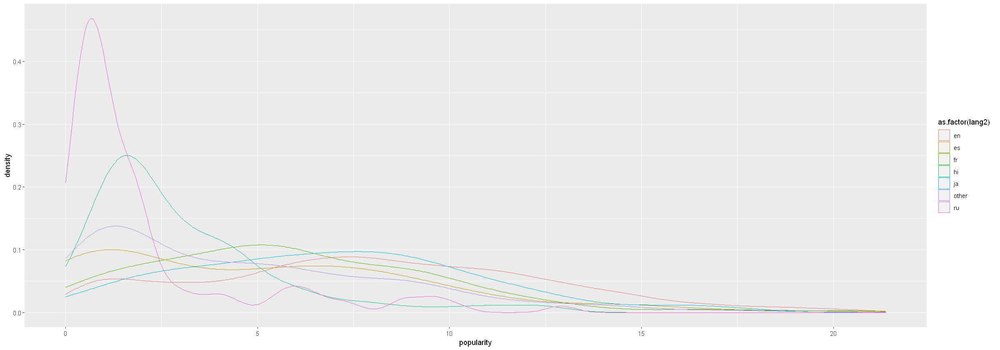

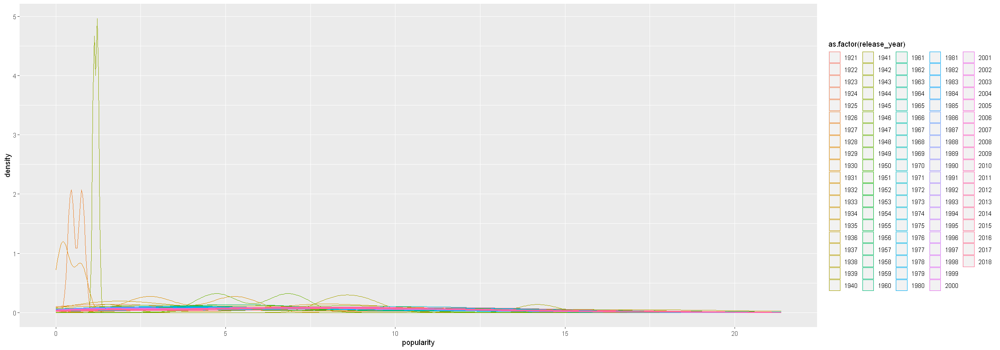

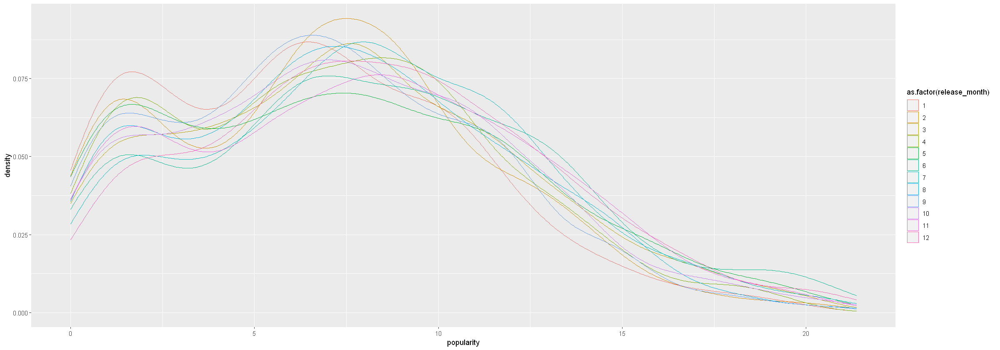

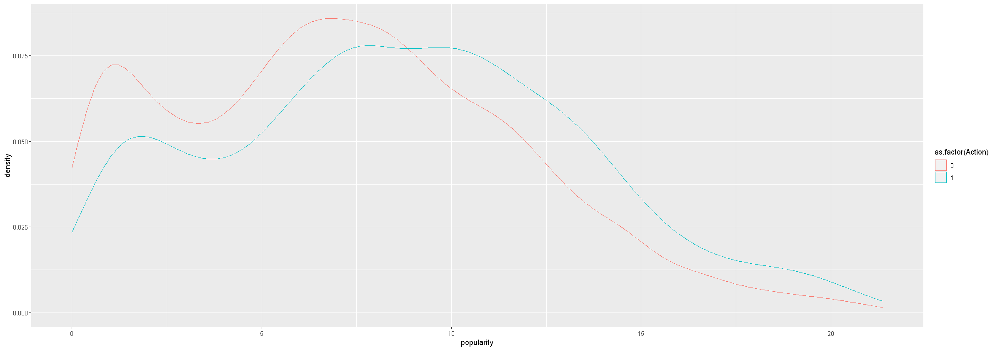

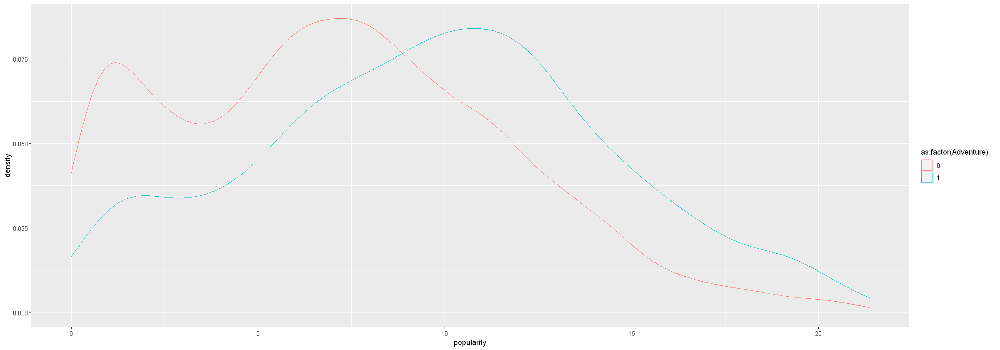

...

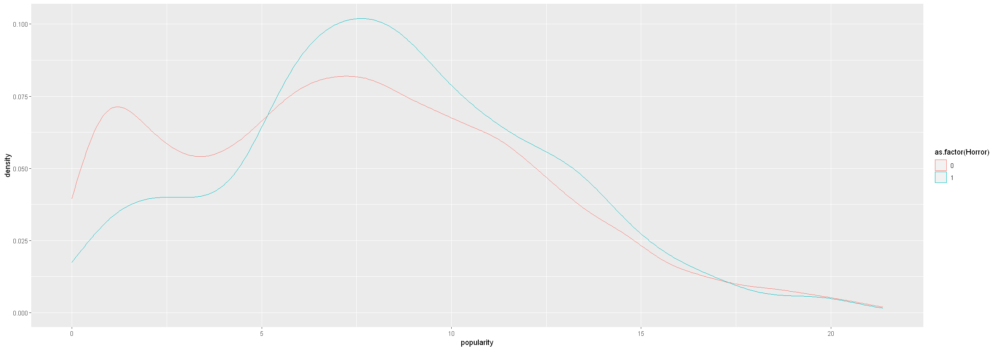

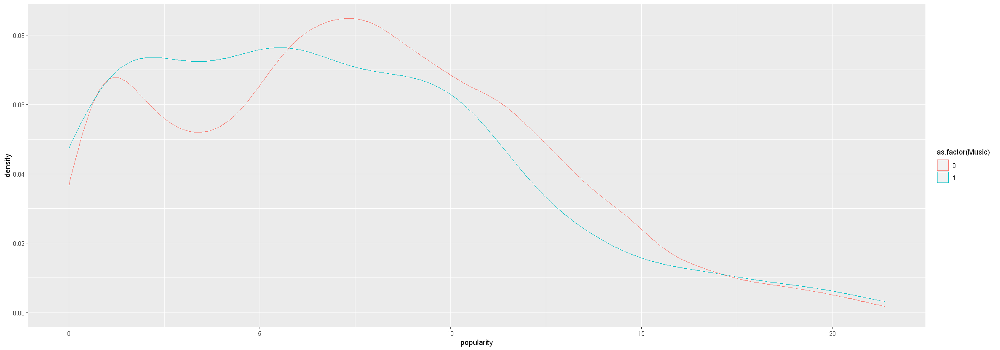

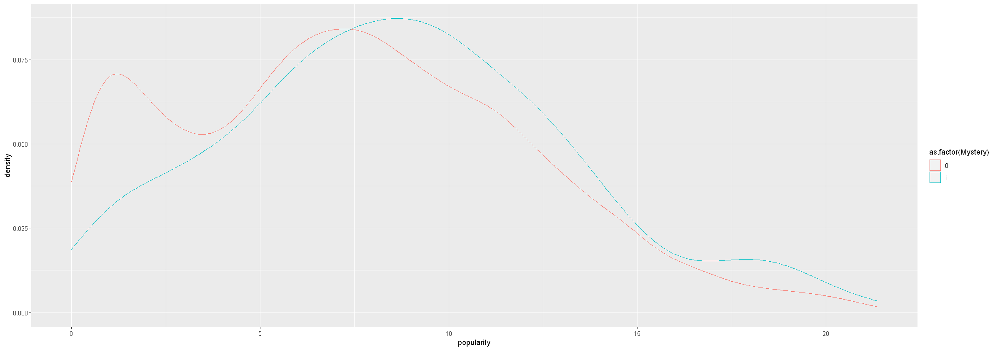

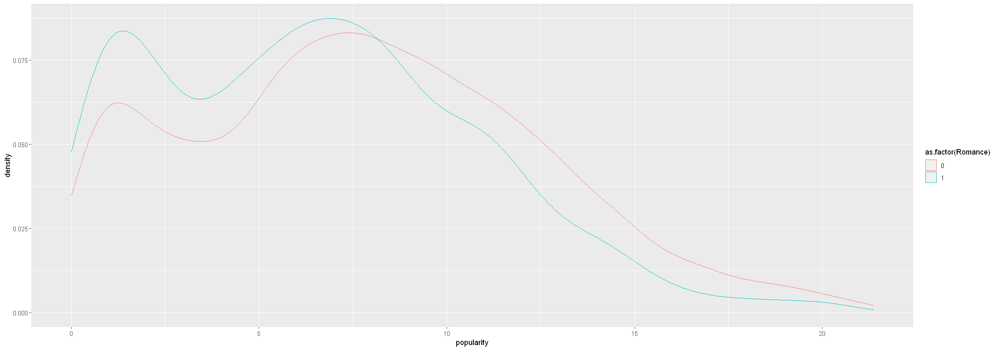

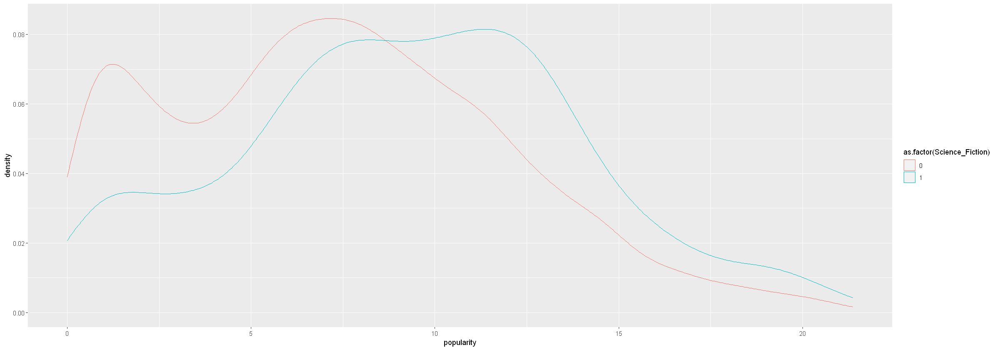

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


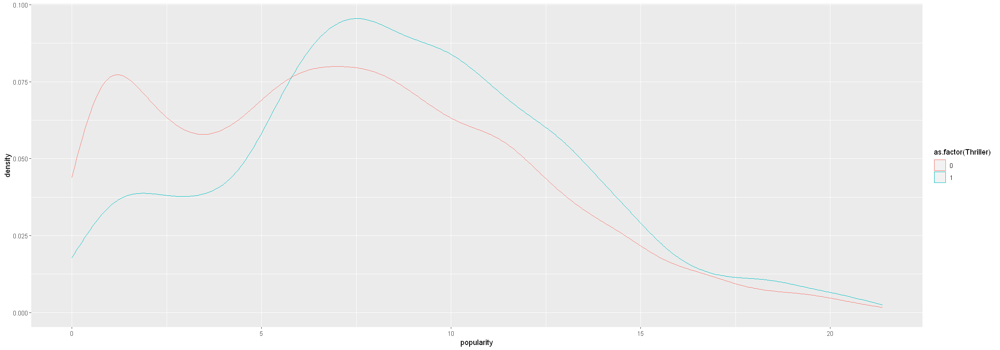

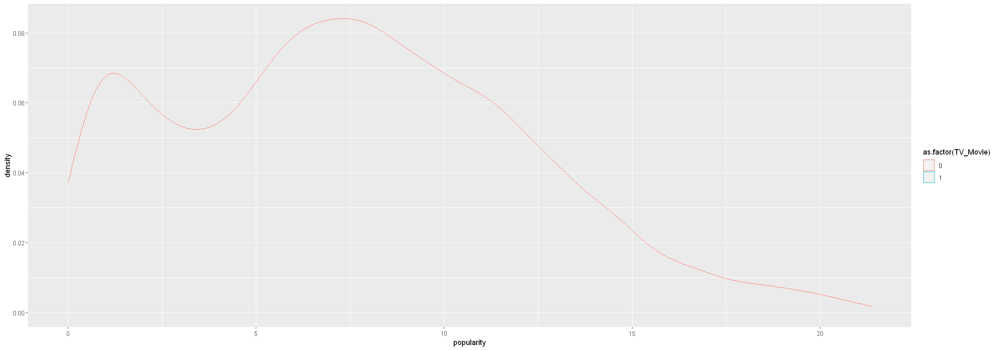

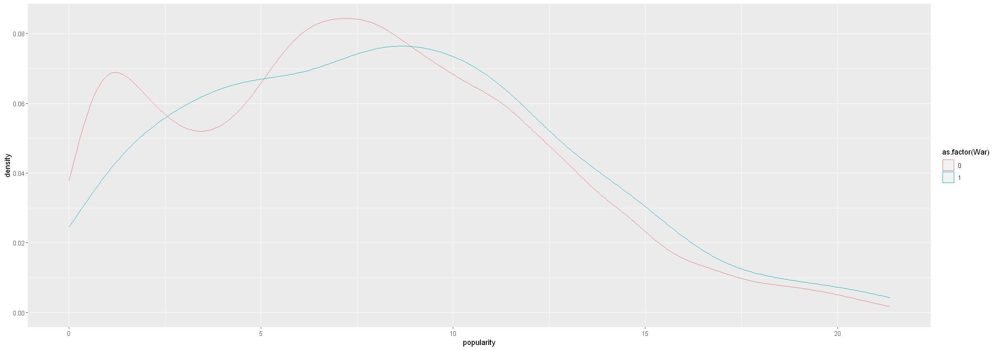

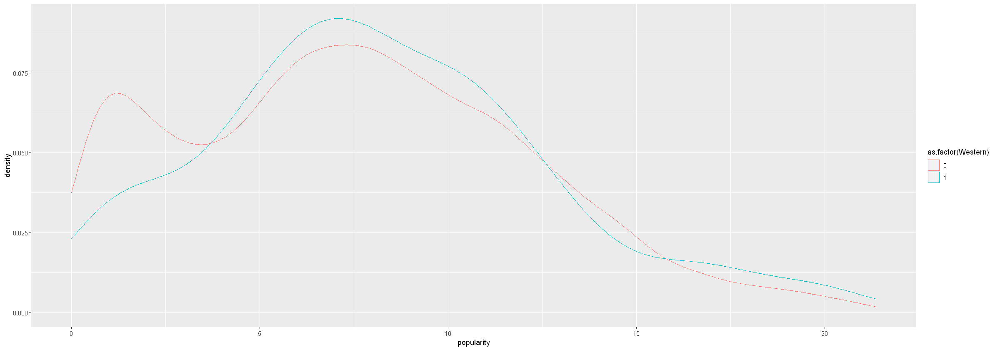

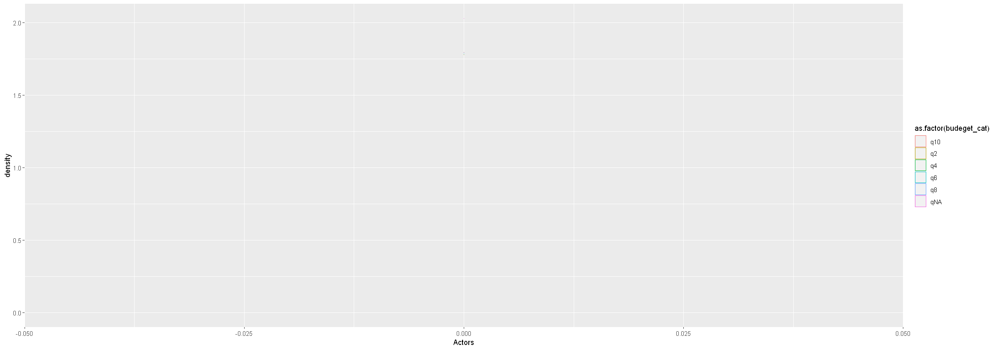

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

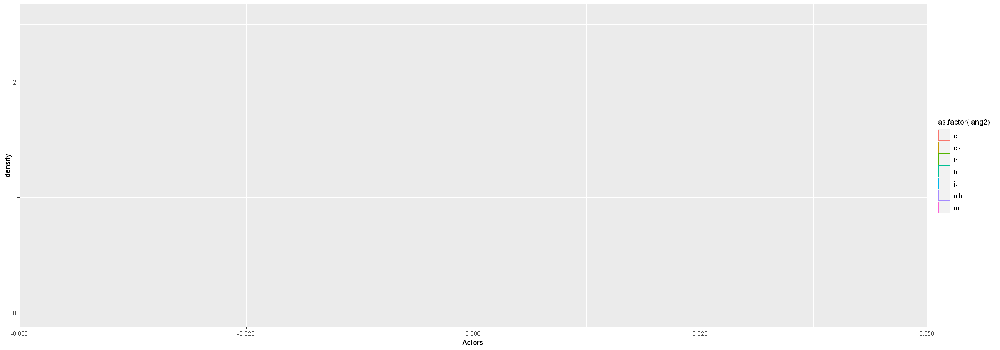

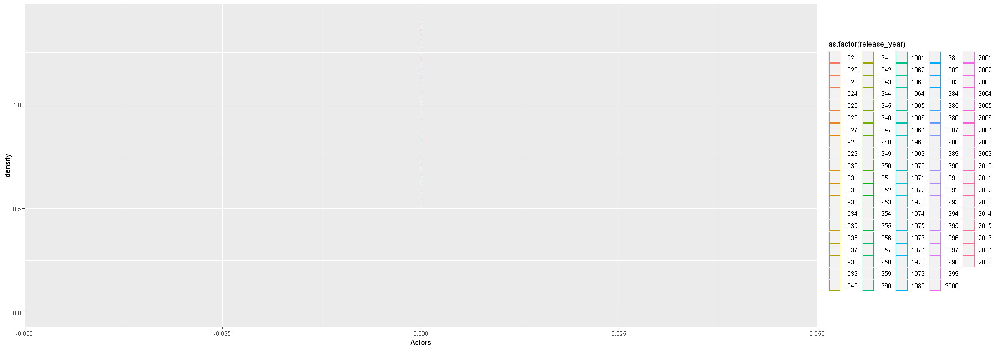

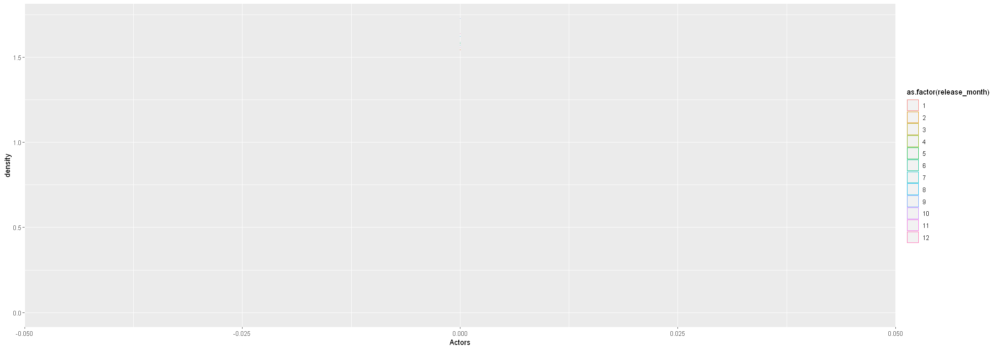

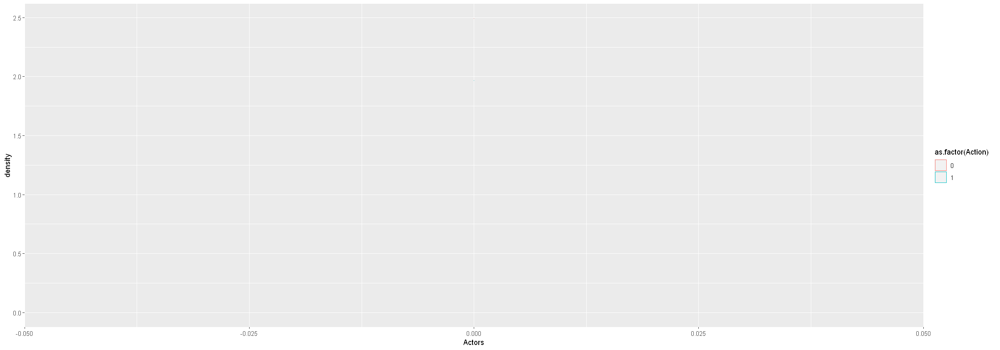

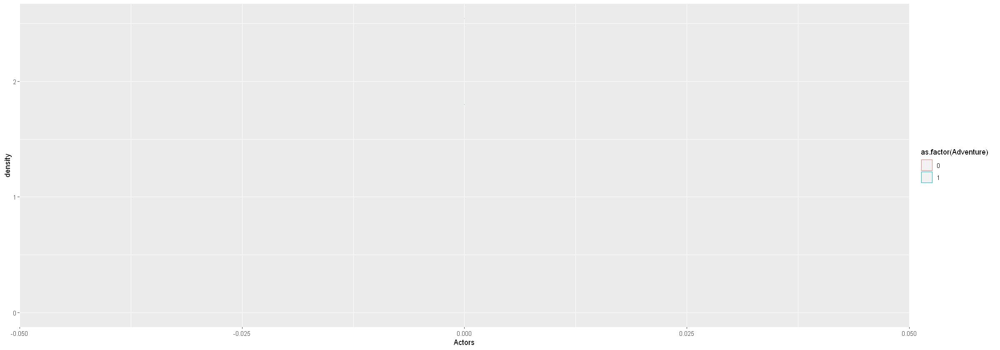

...

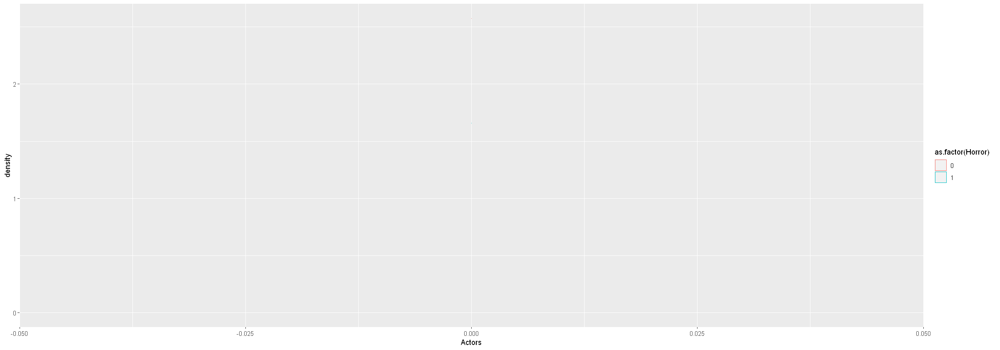

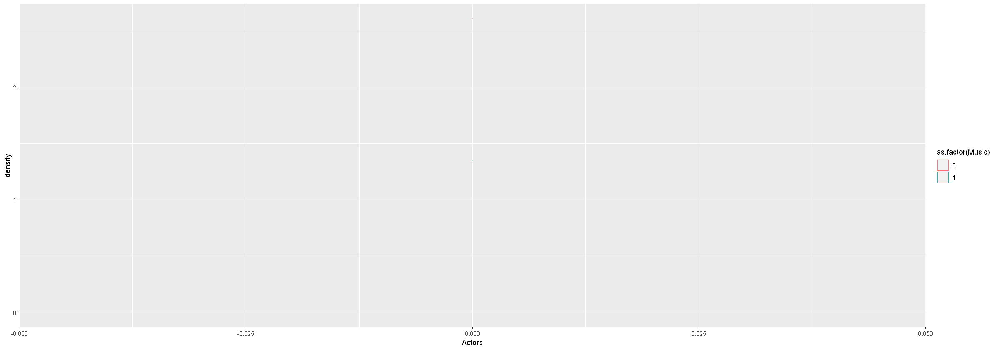

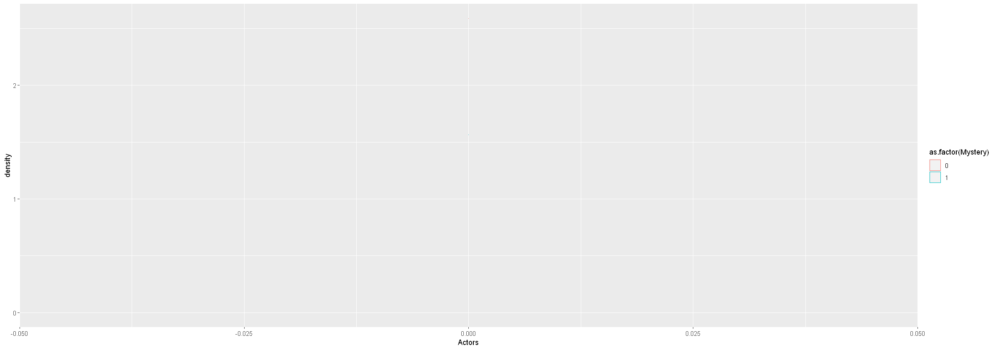

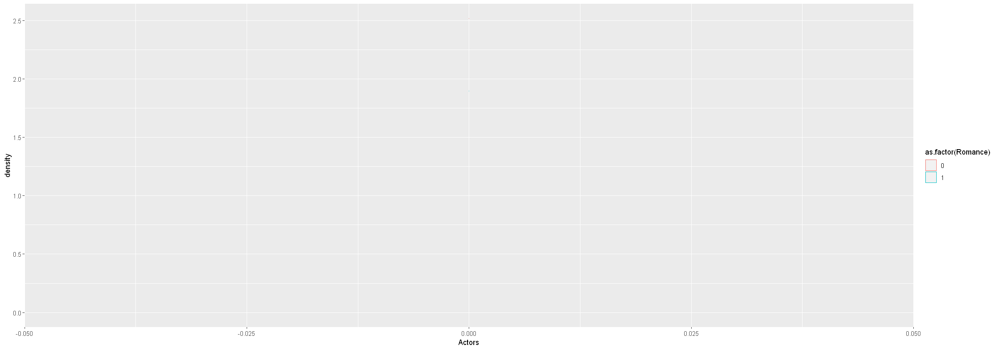

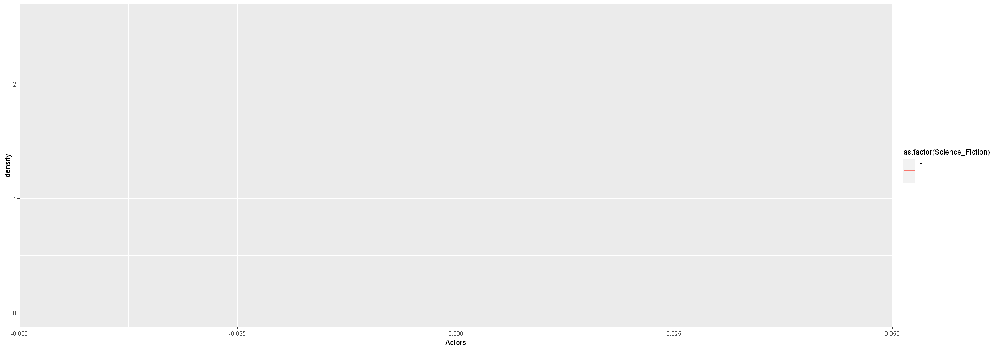

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


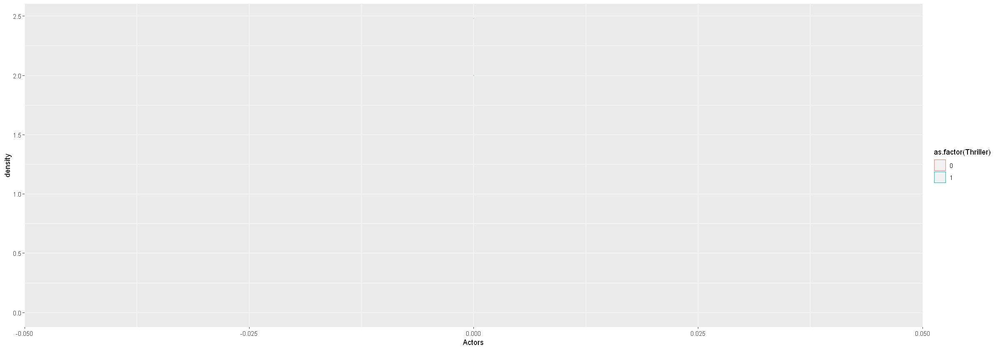

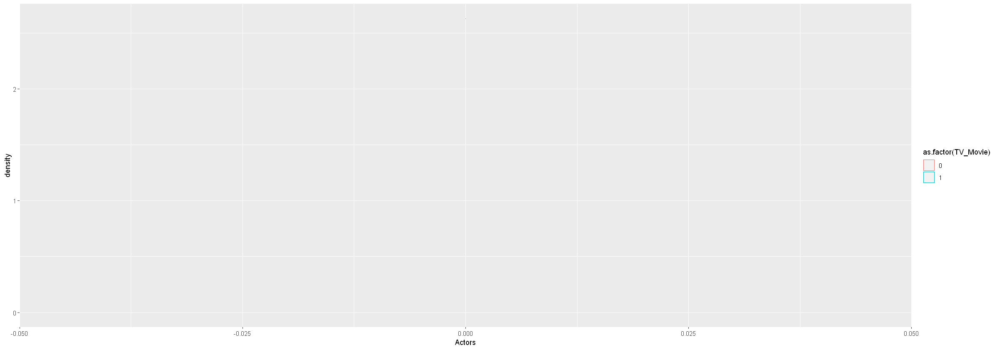

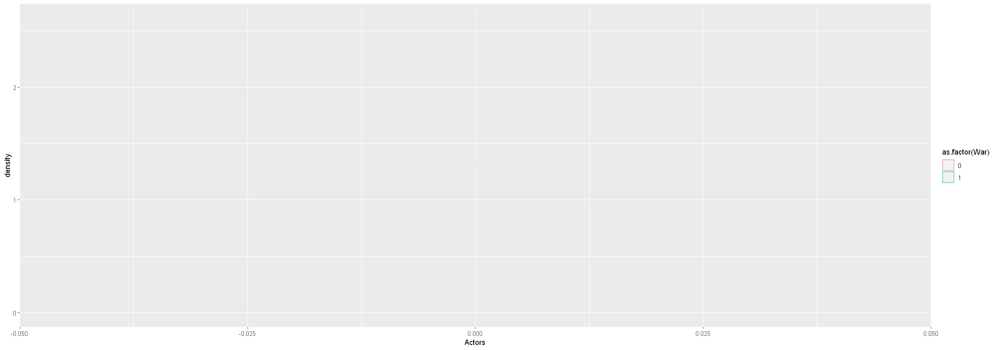

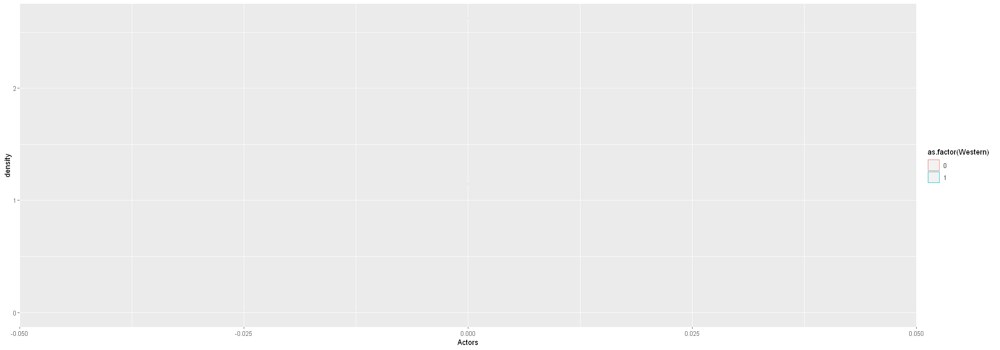

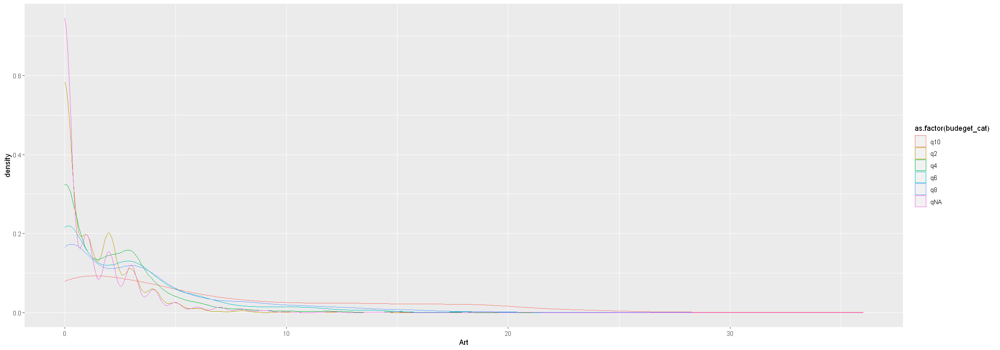

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

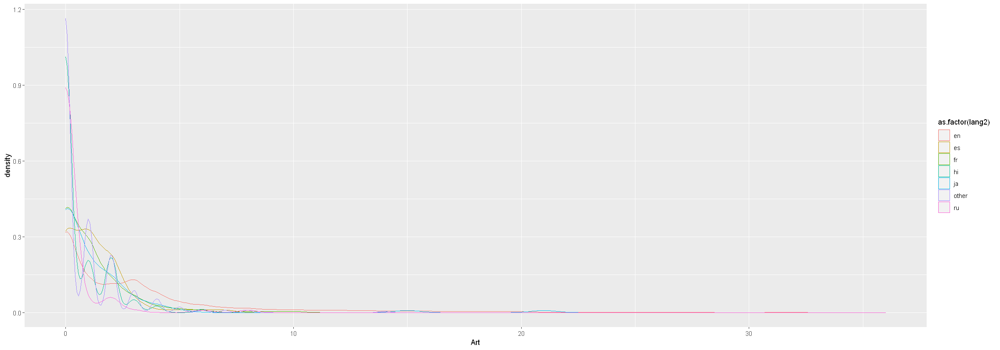

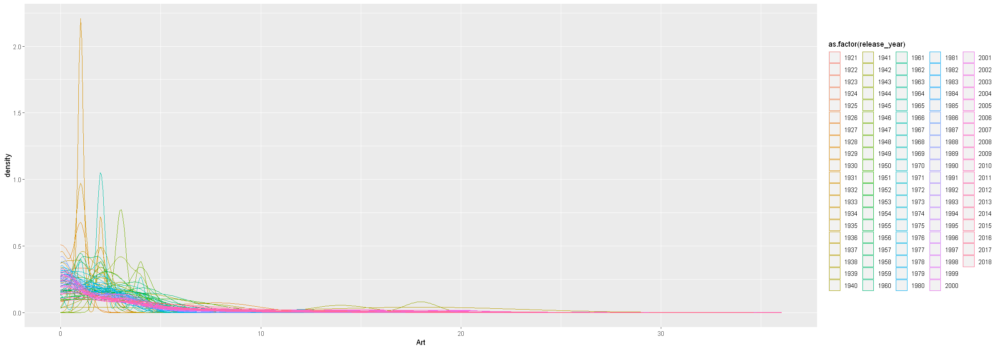

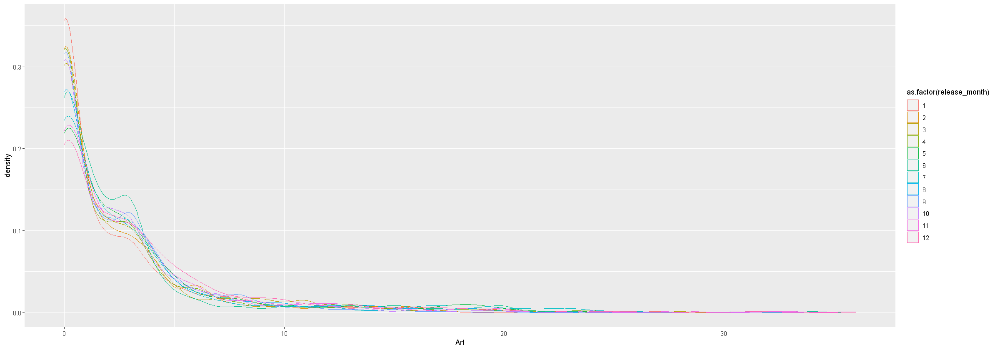

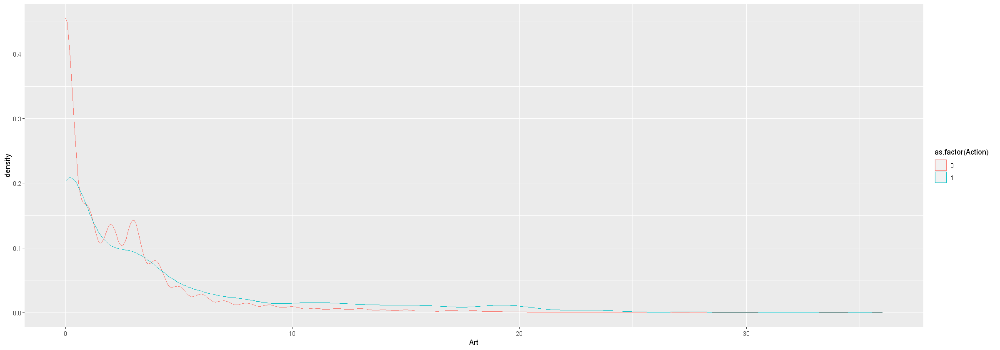

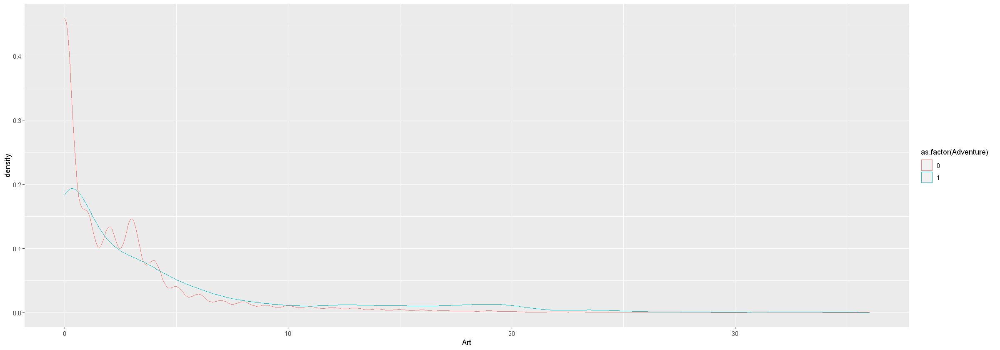

...

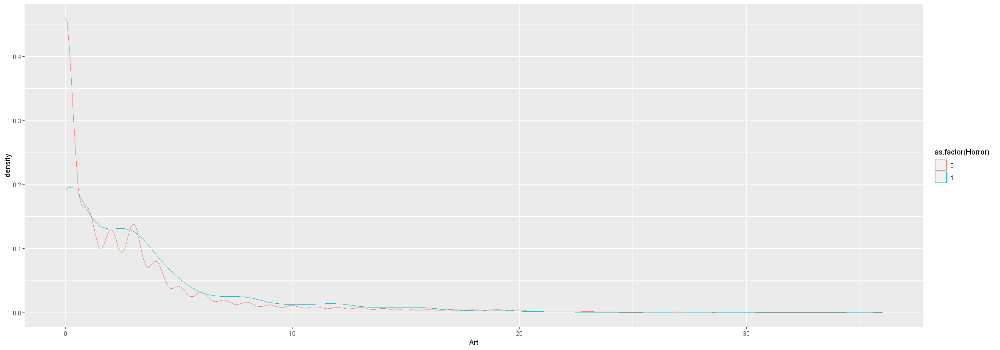

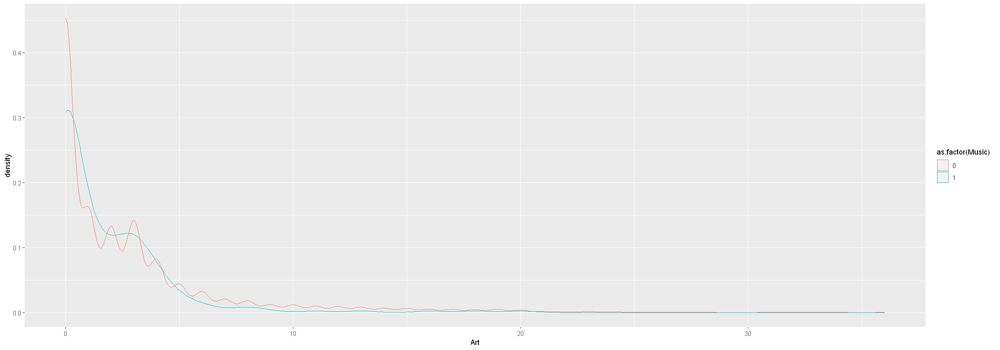

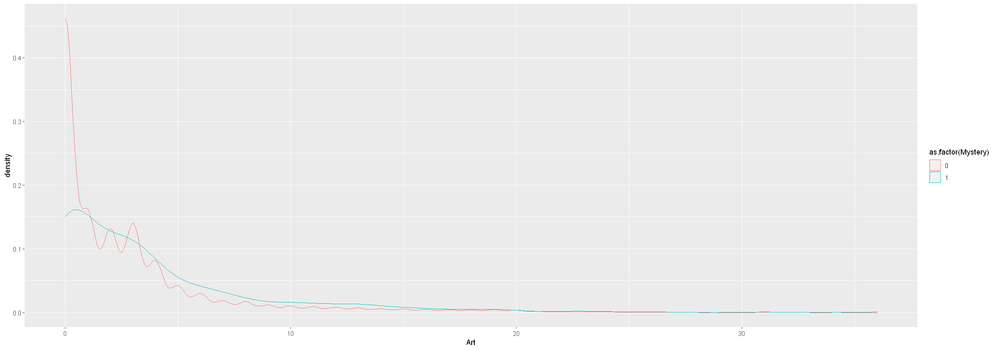

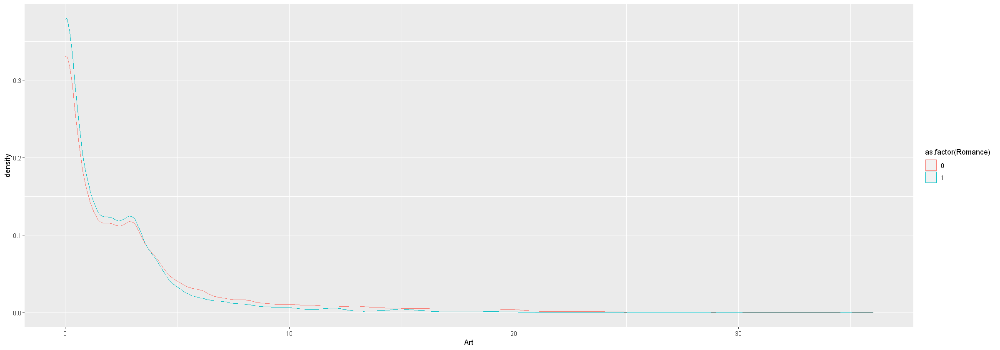

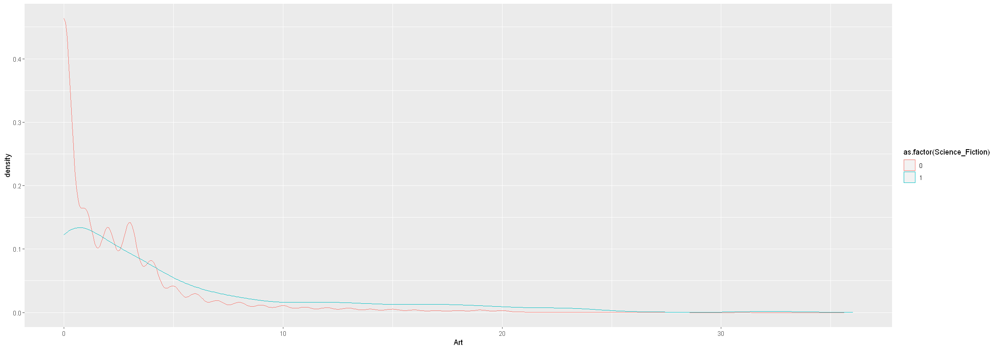

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


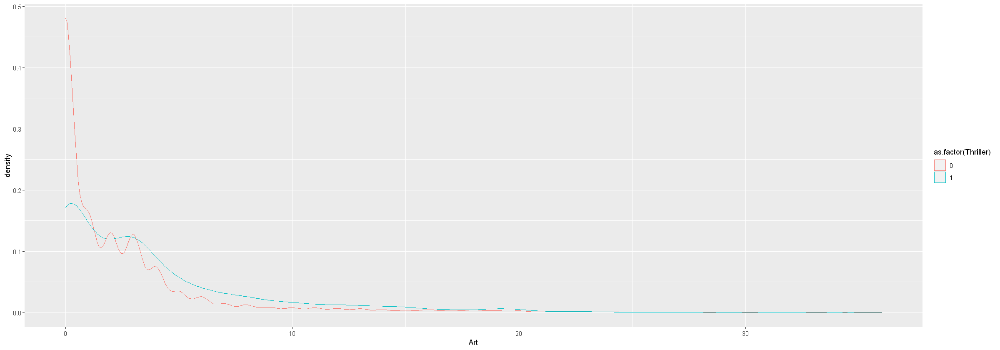

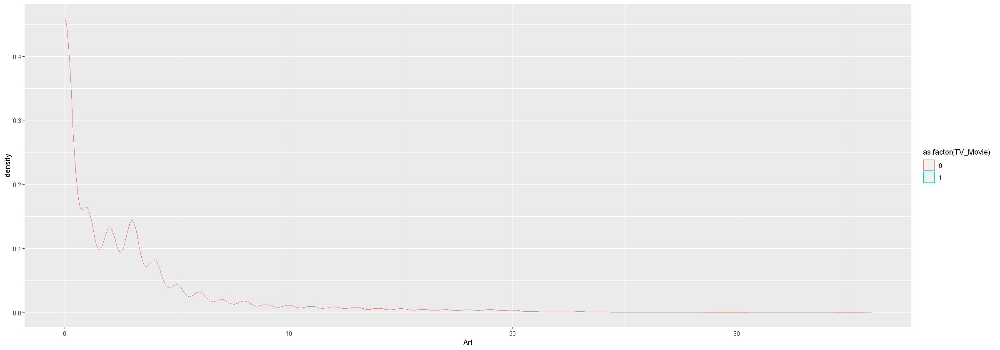

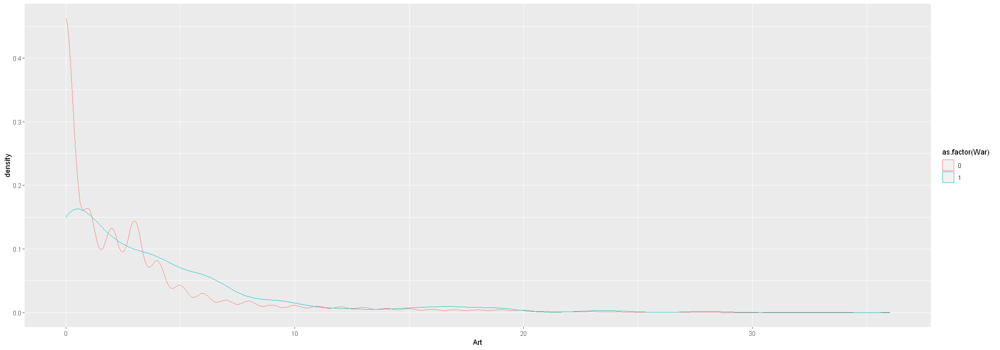

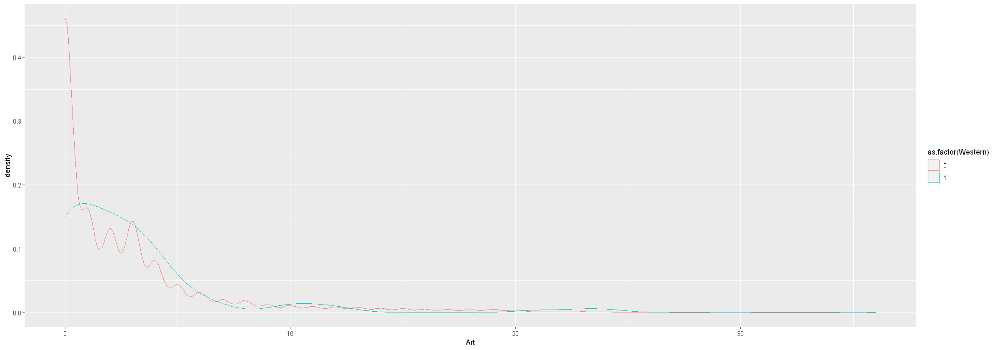

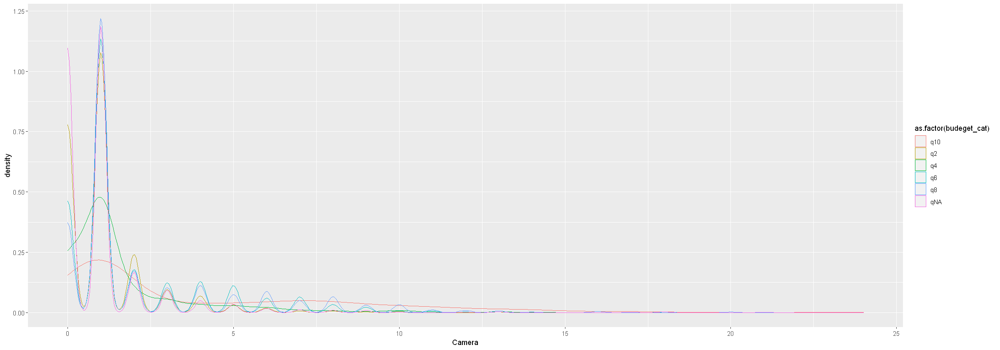

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

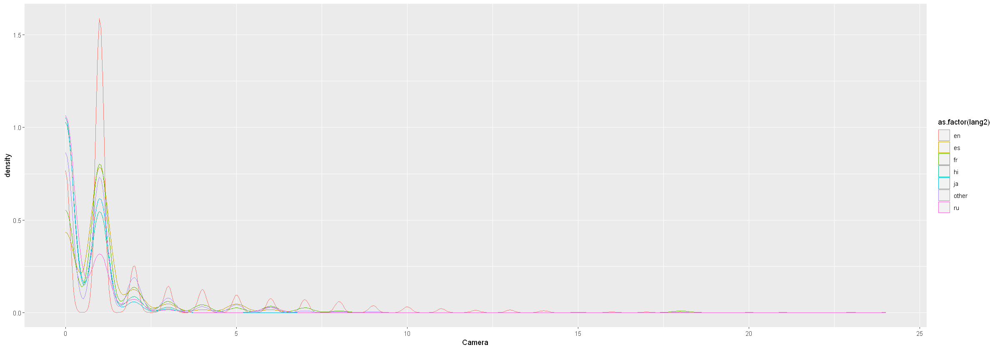

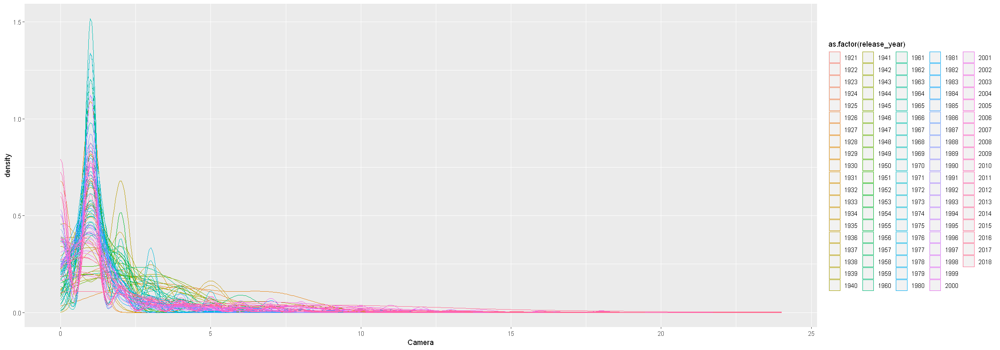

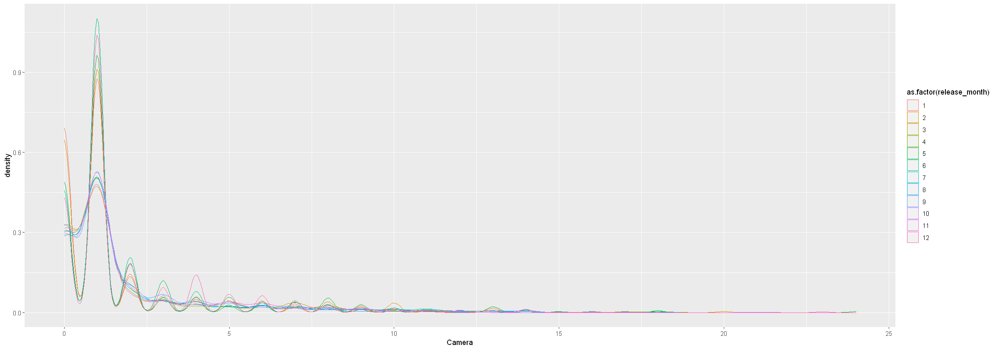

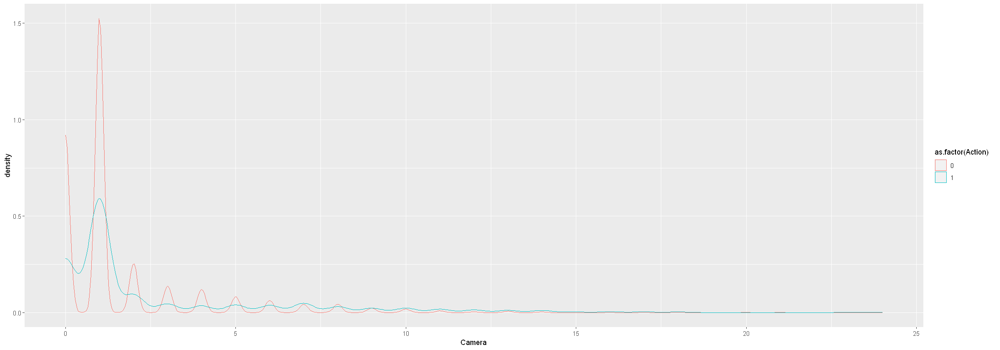

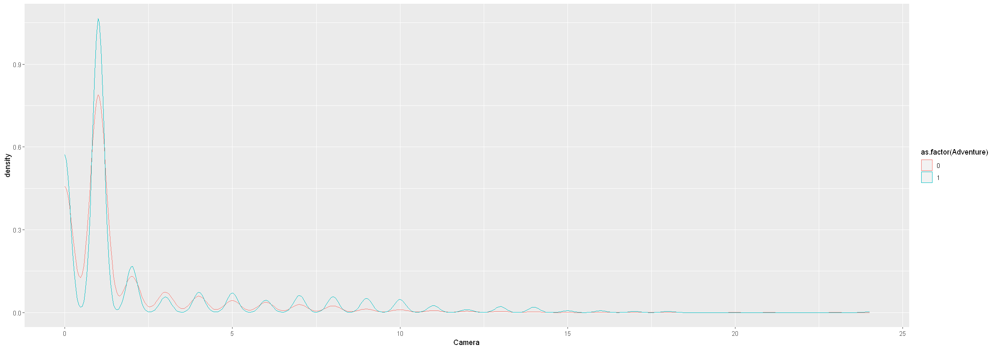

...

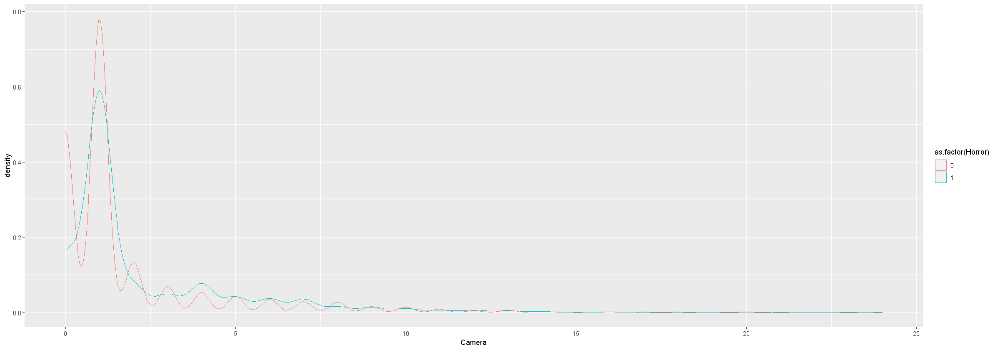

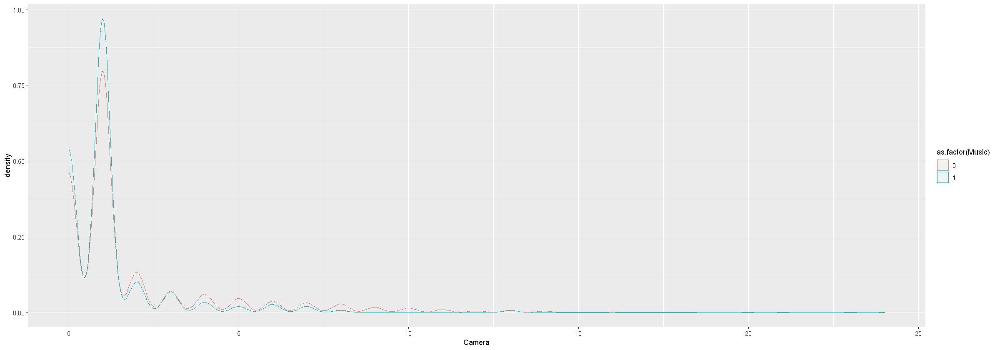

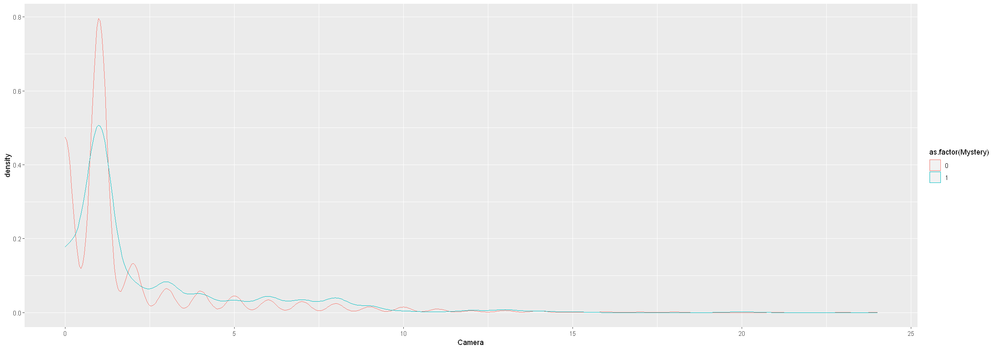

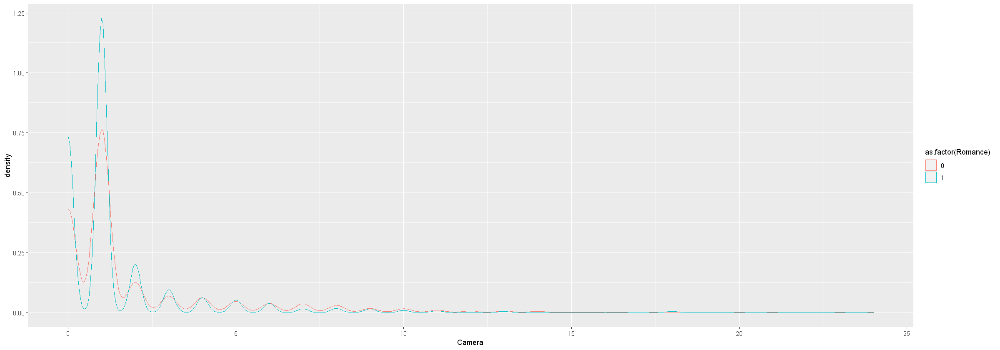

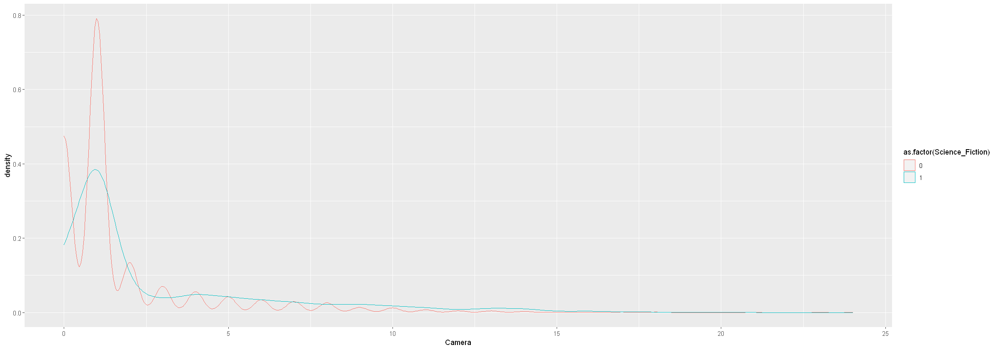

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


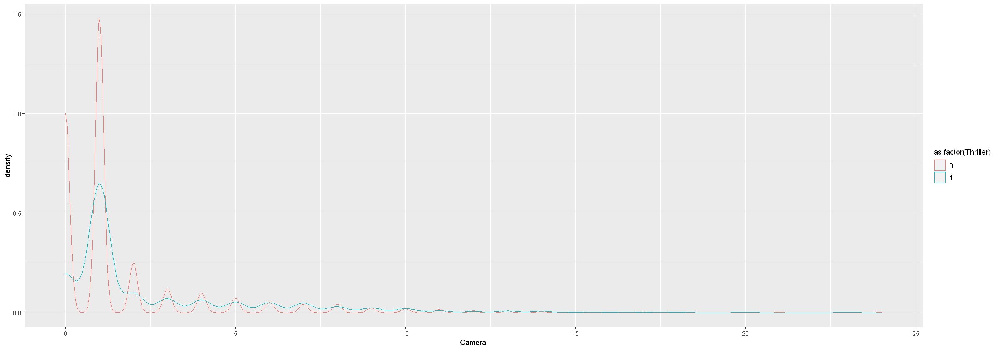

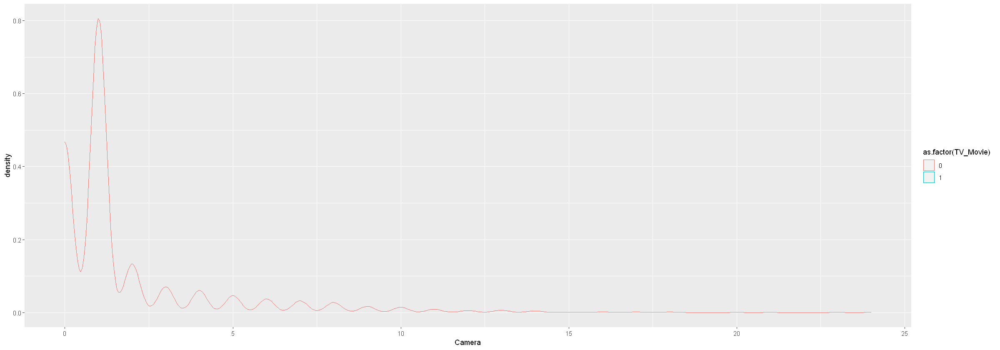

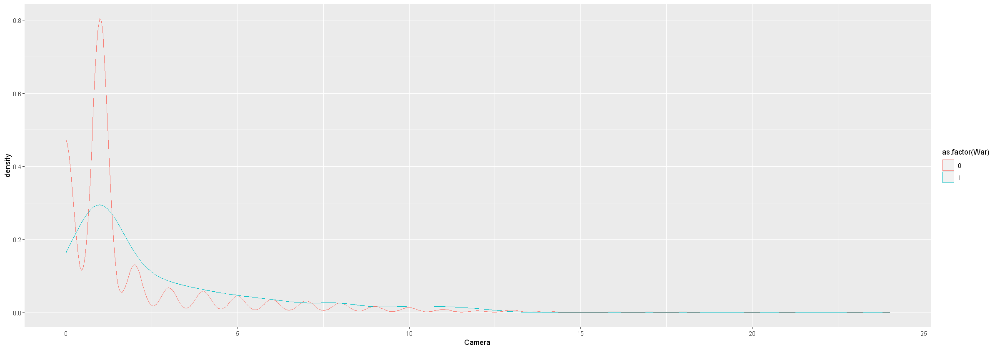

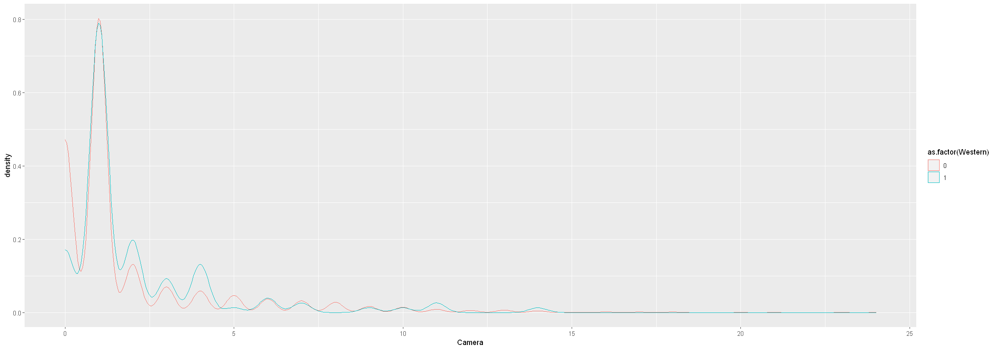

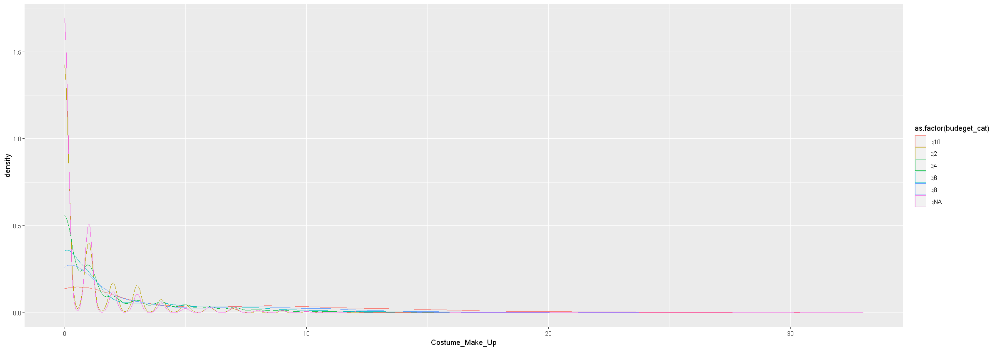

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

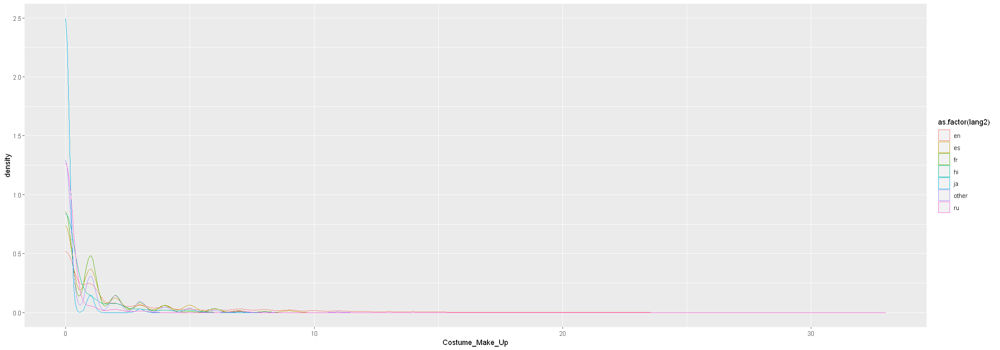

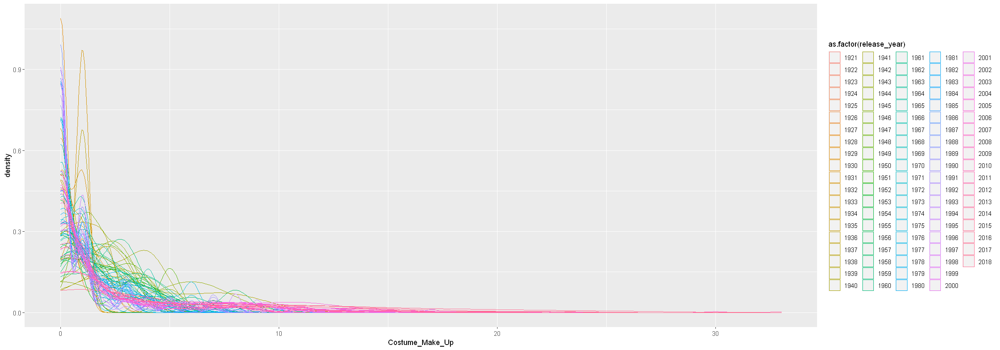

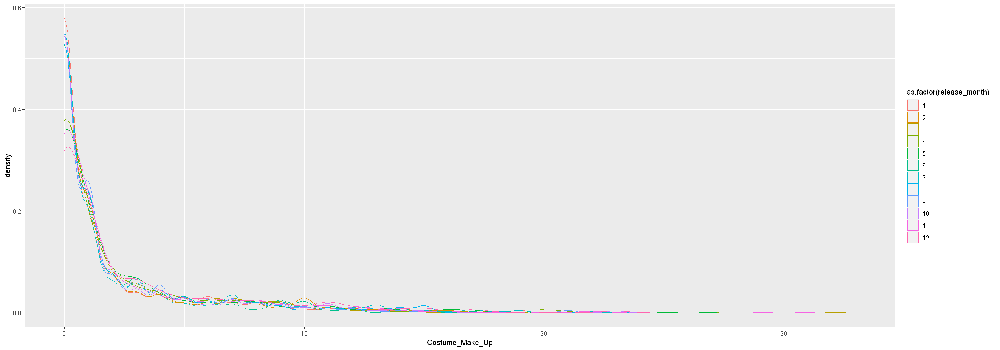

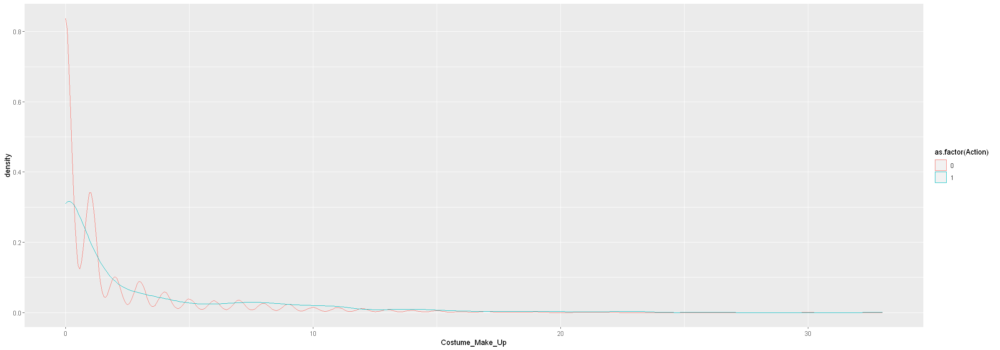

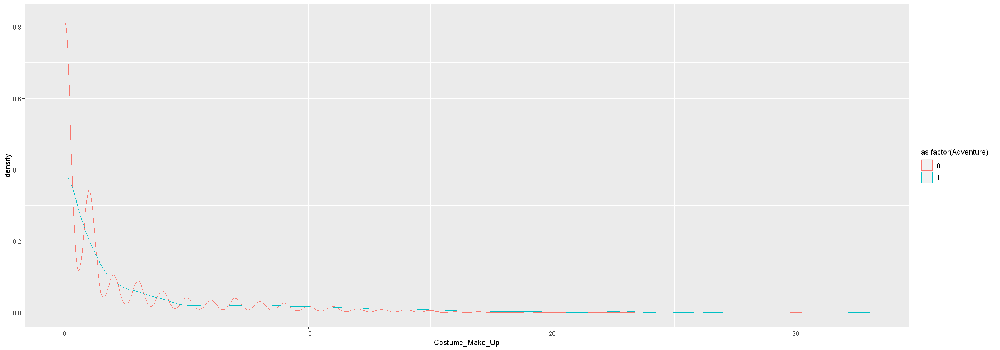

...

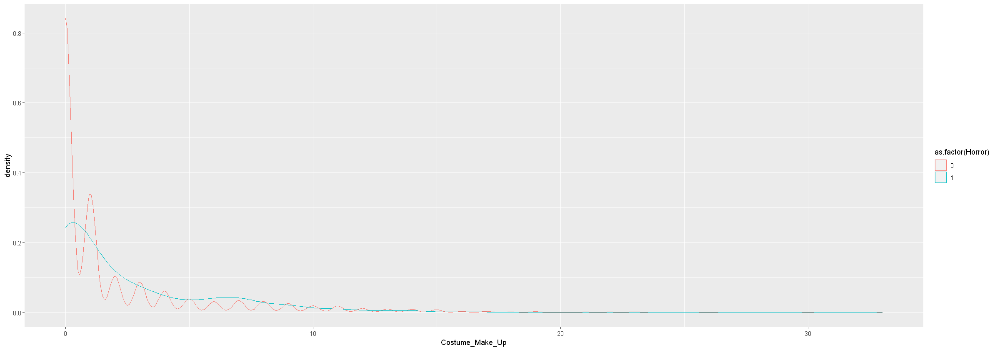

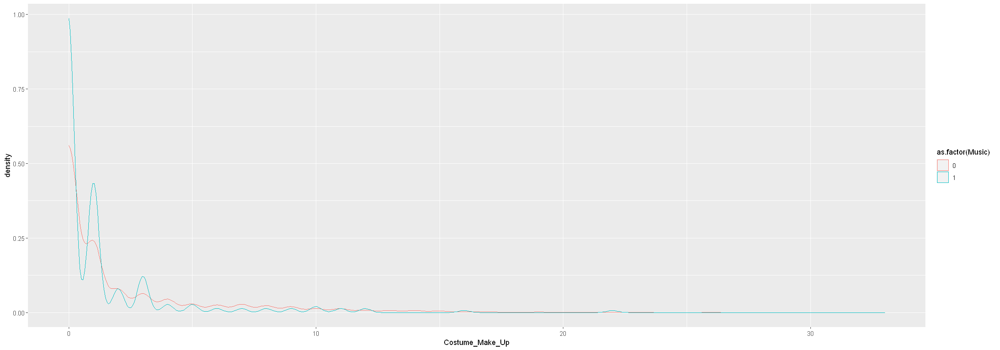

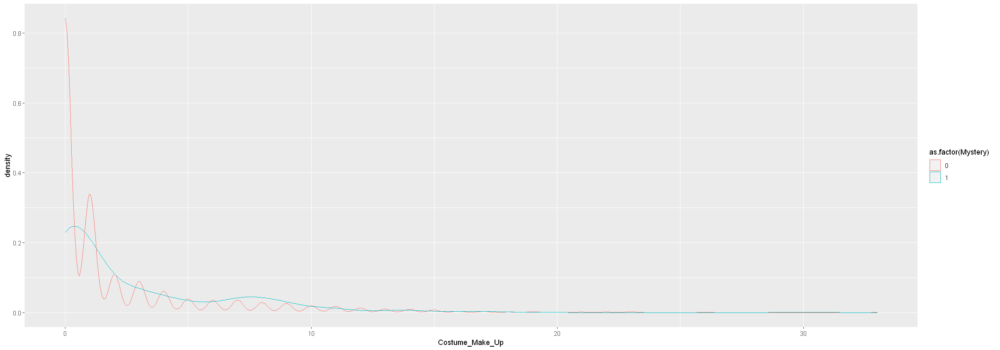

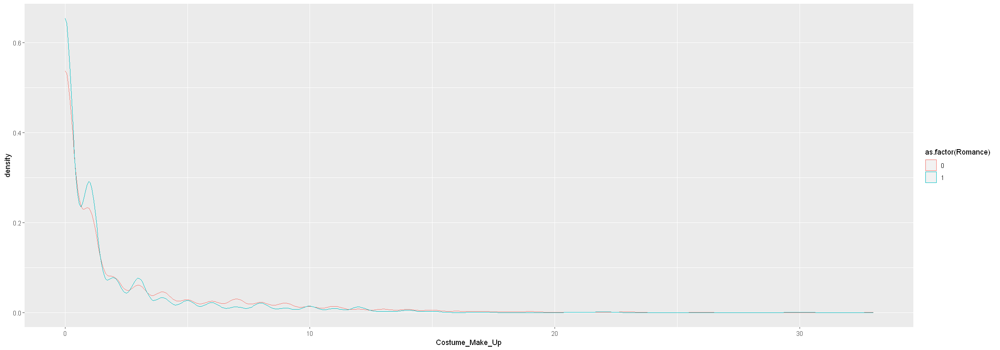

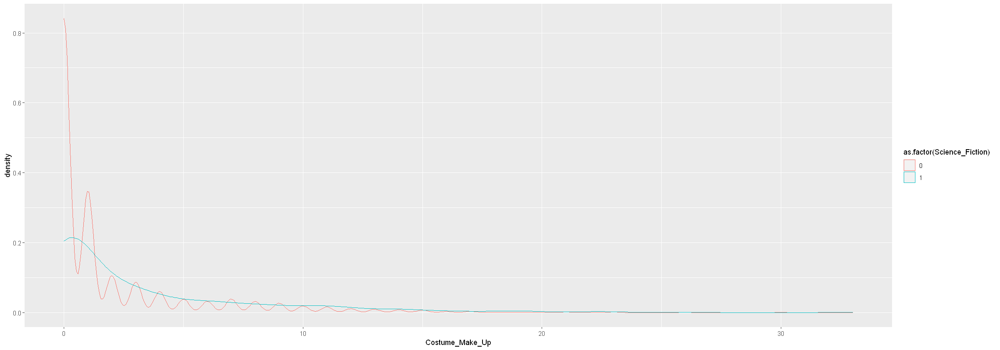

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


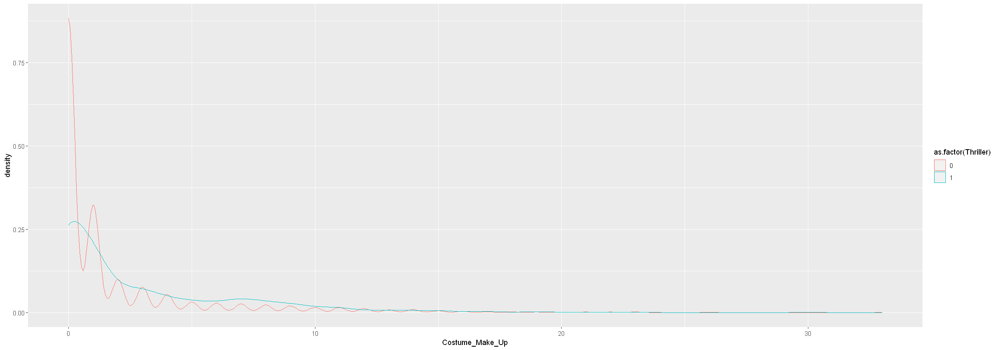

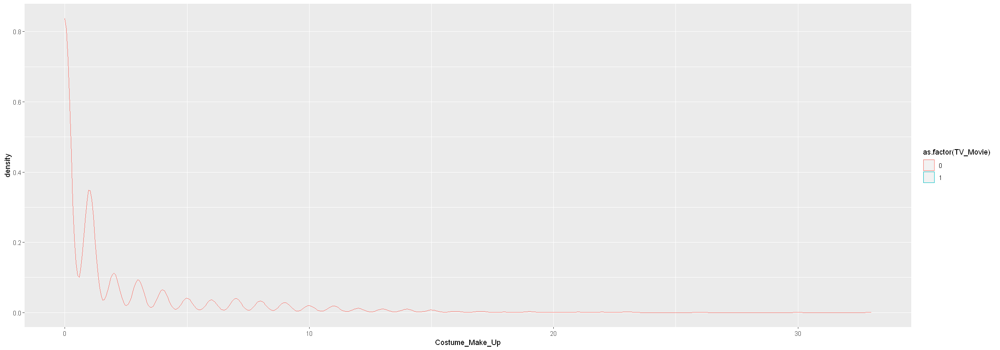

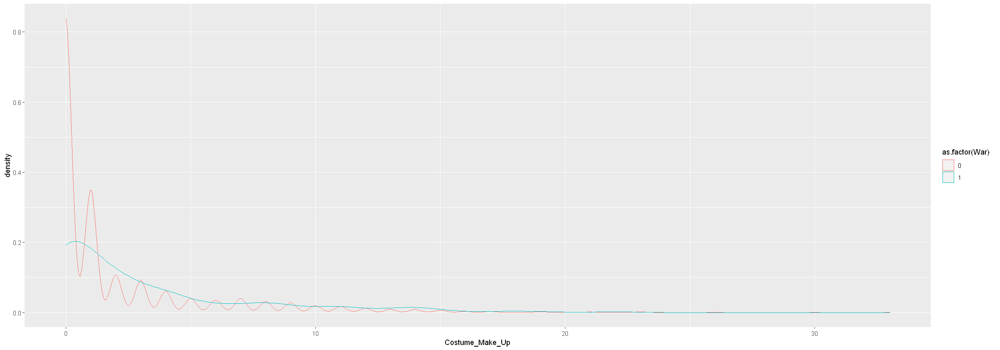

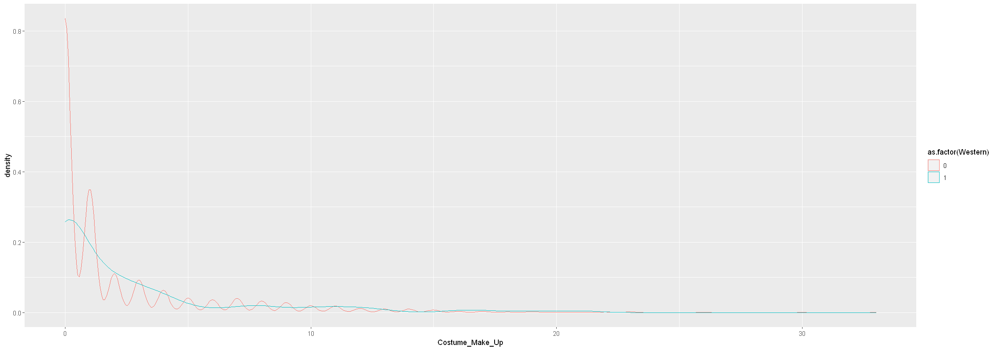

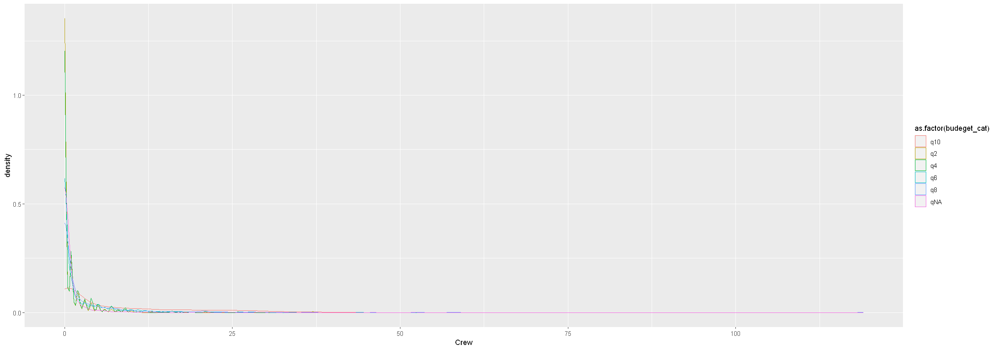

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

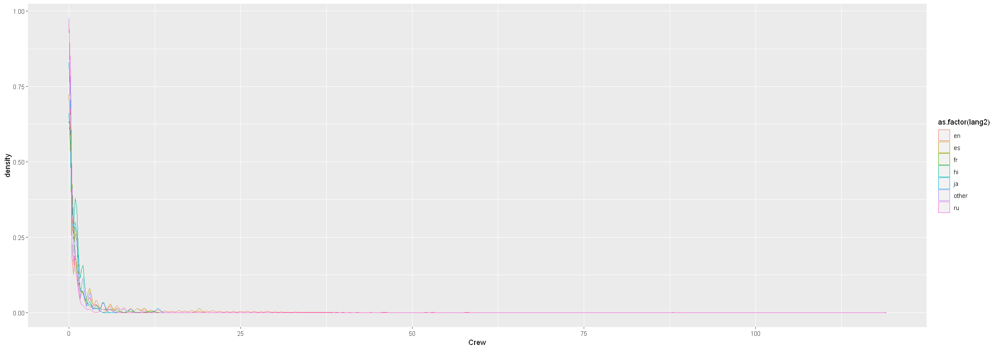

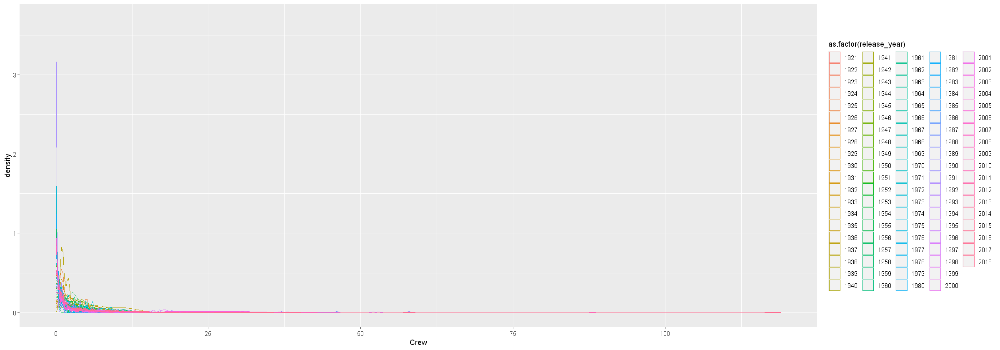

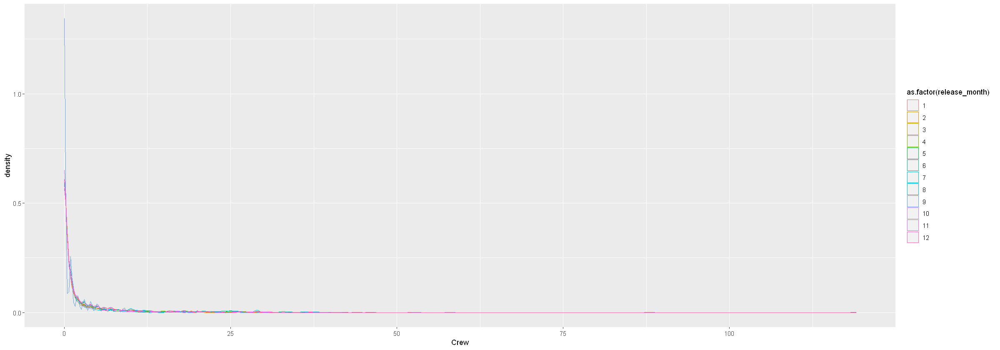

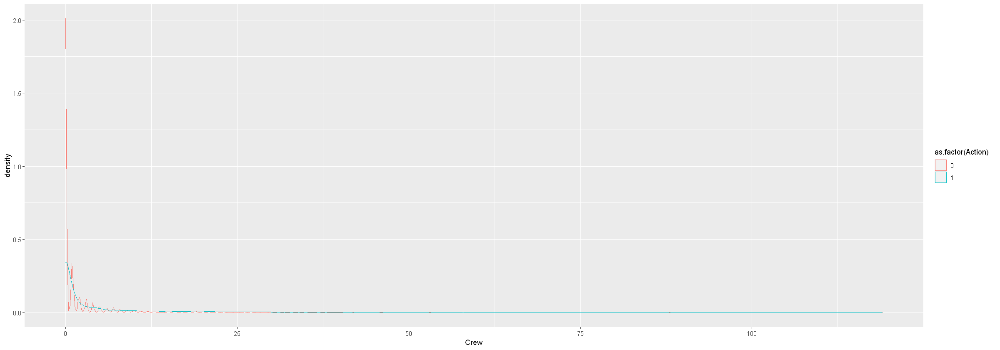

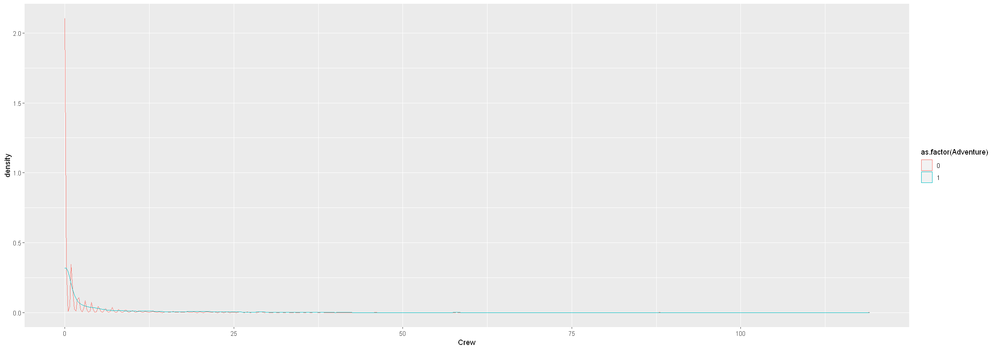

...

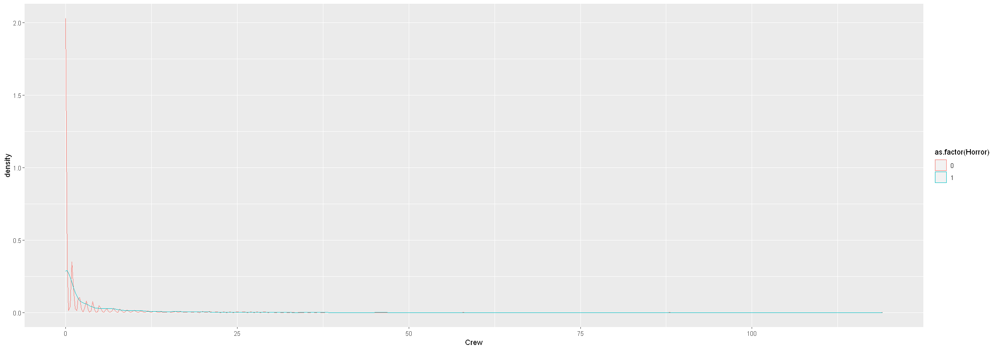

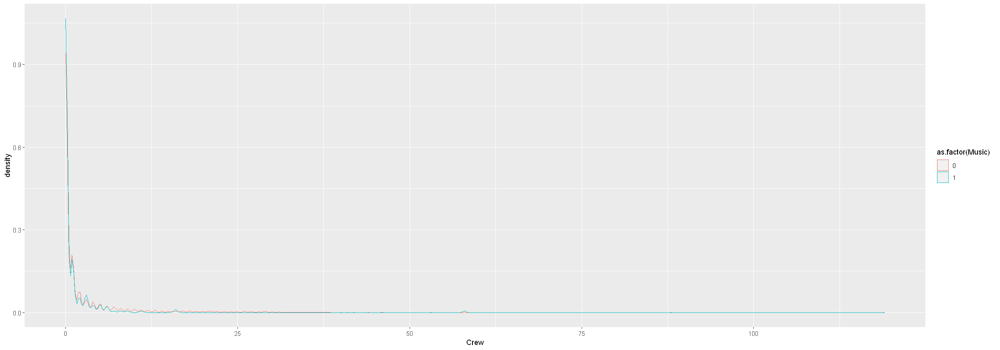

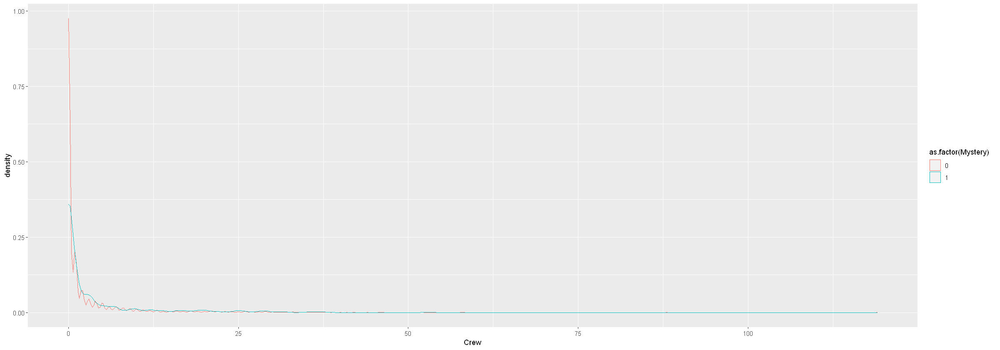

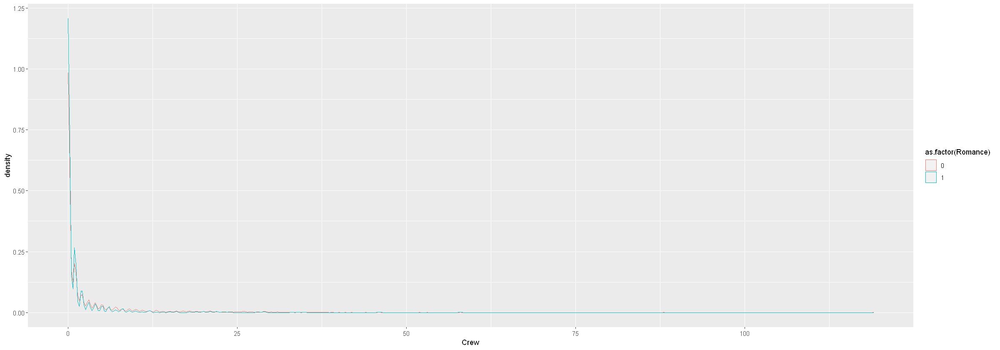

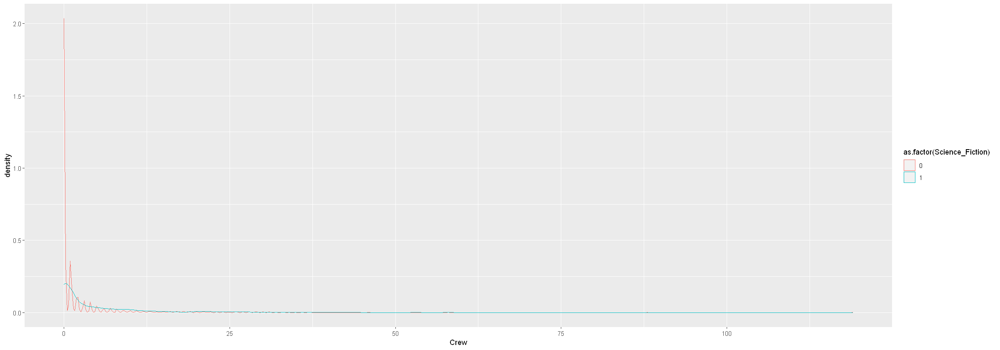

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


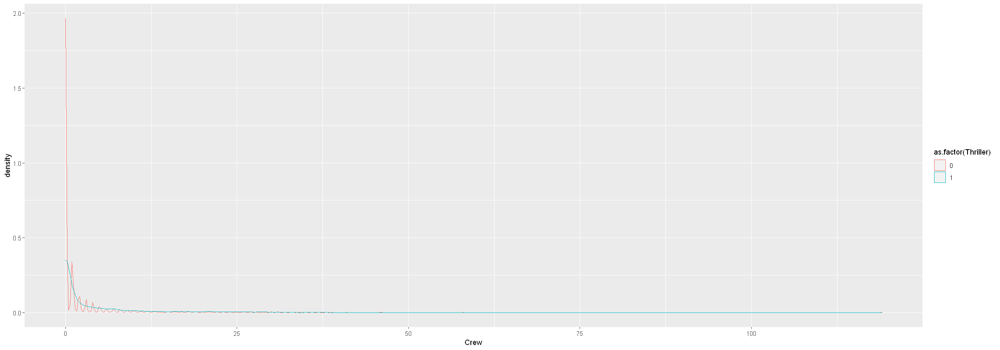

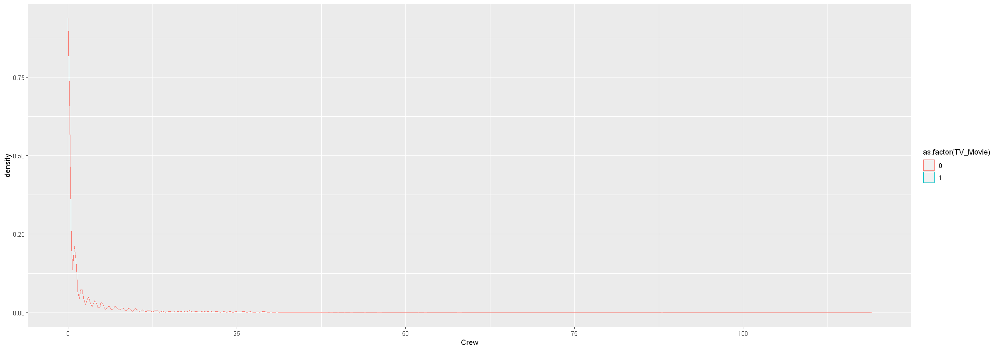

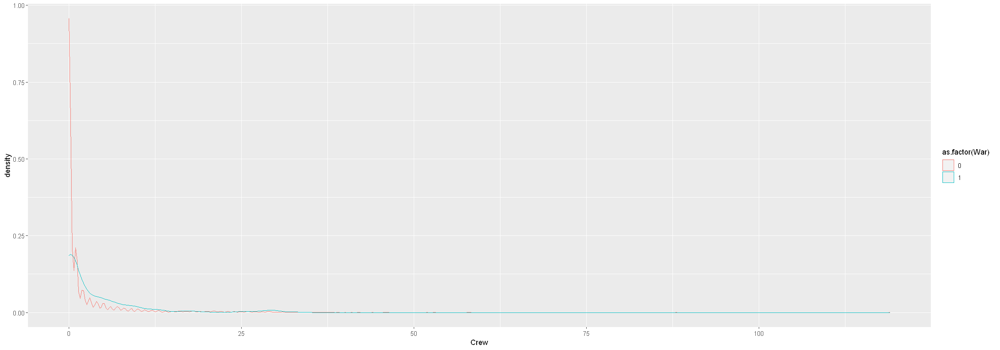

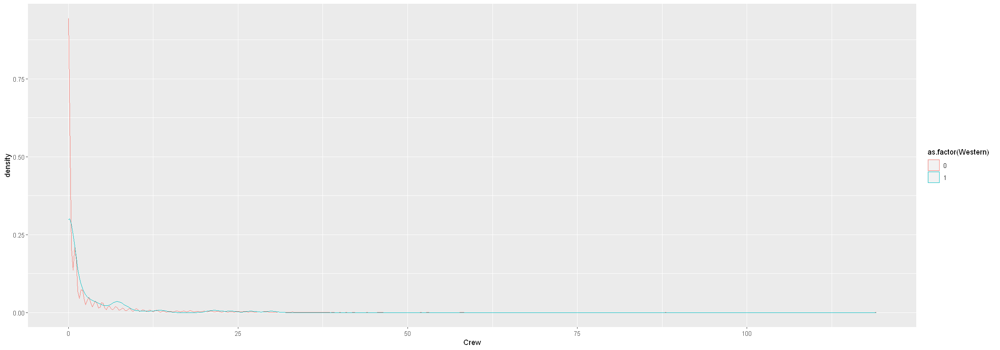

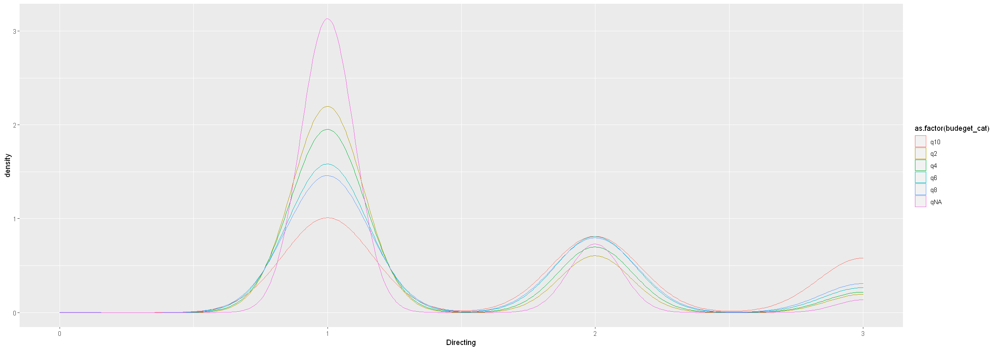

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

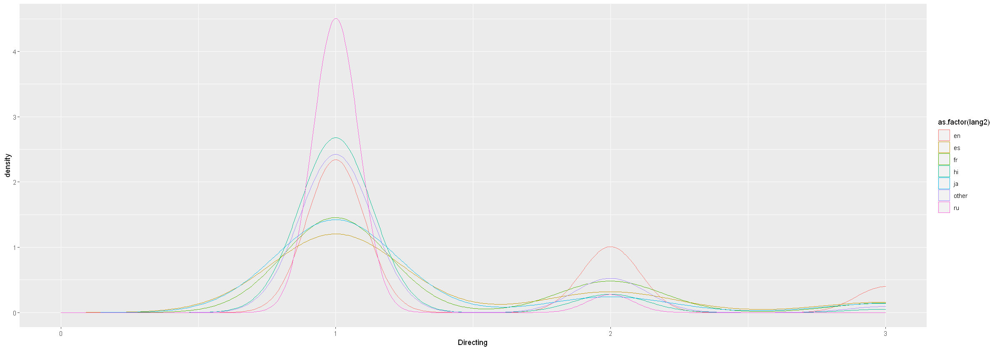

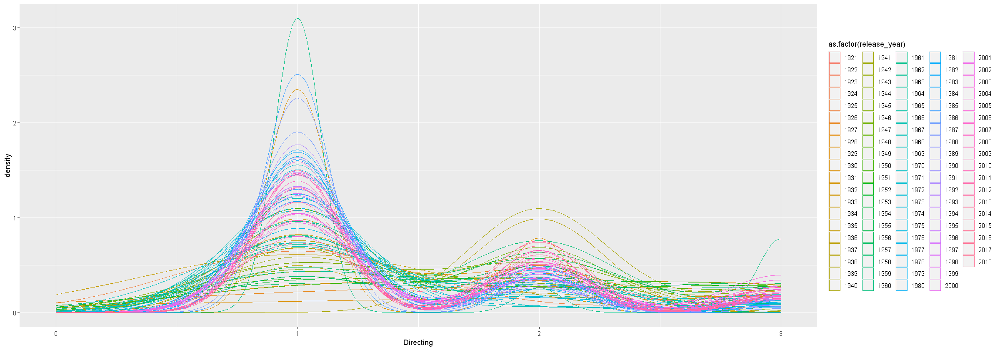

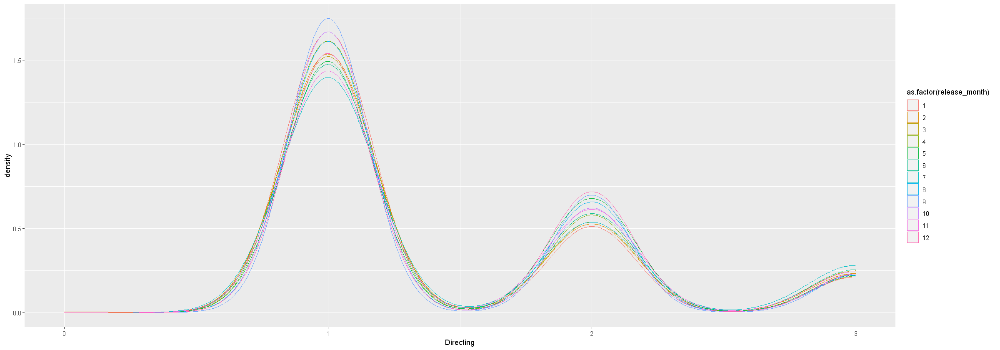

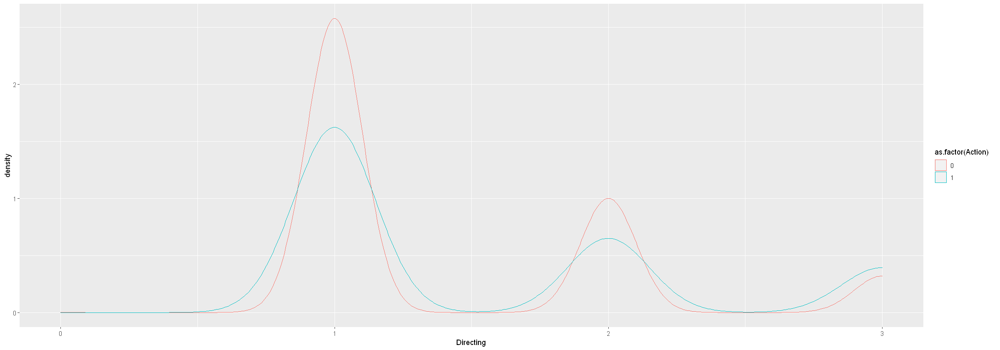

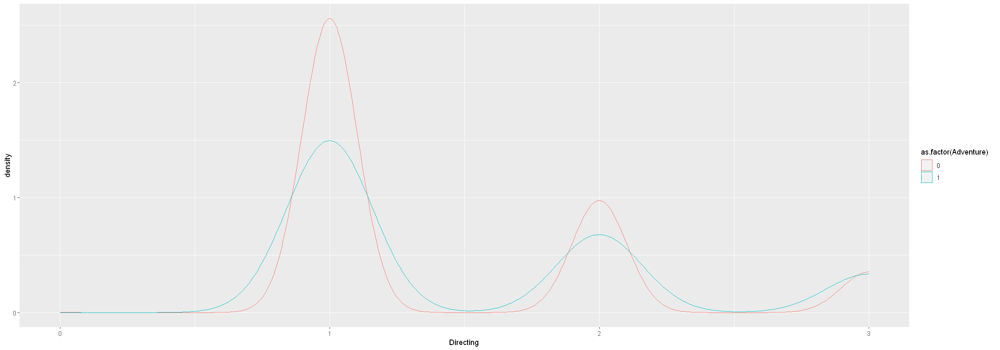

...

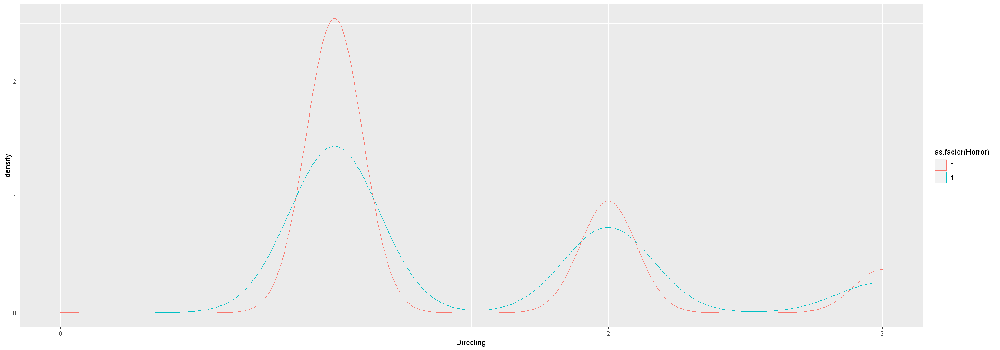

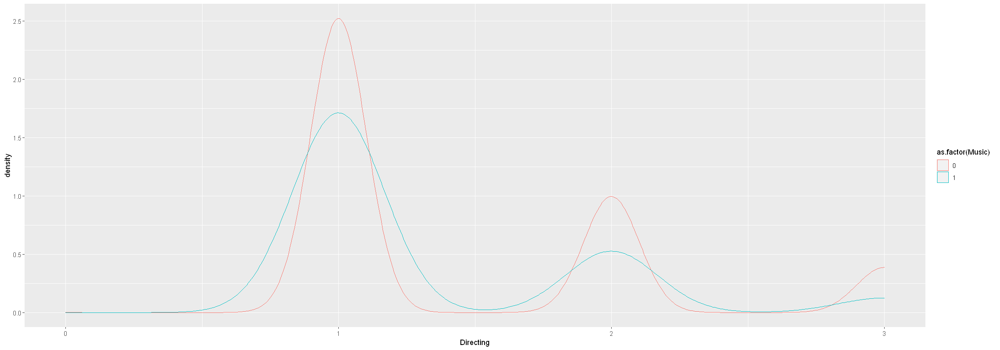

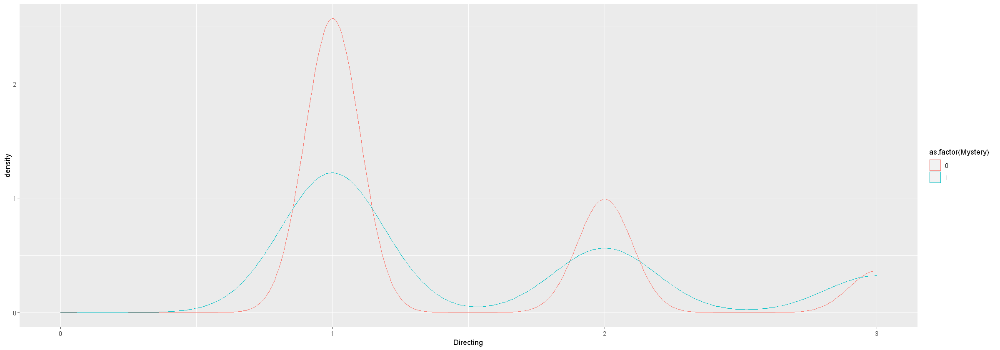

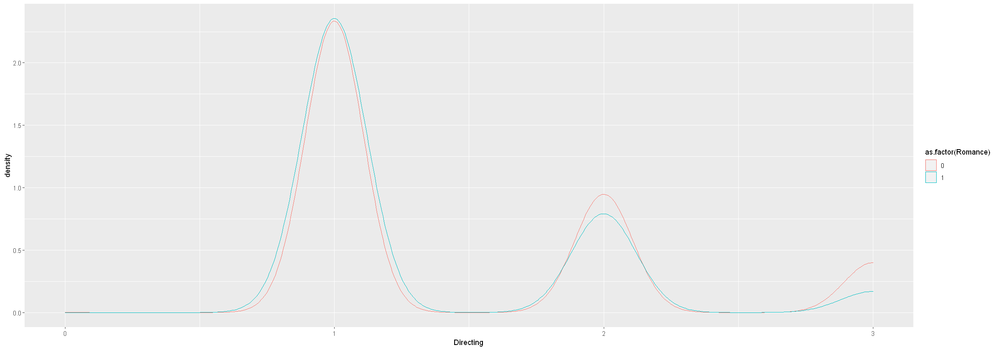

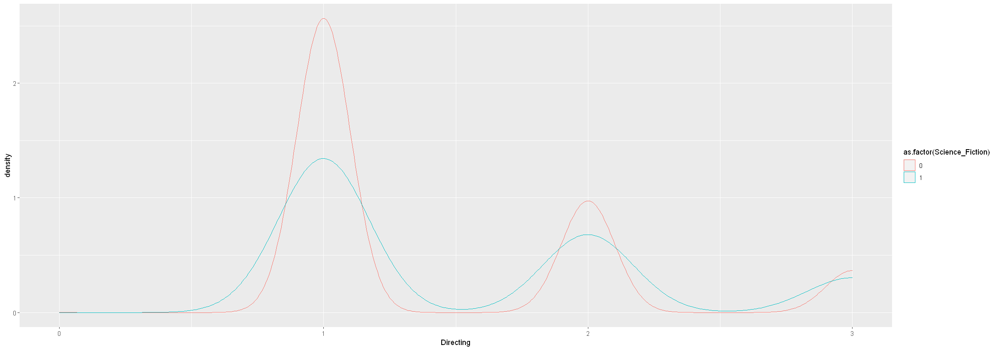

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


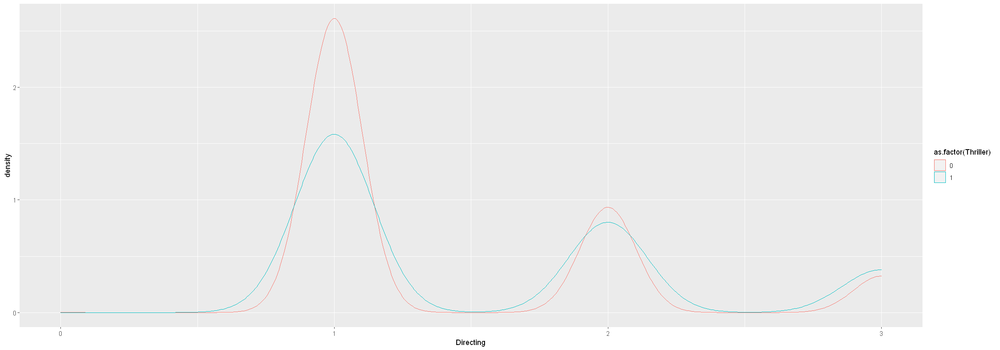

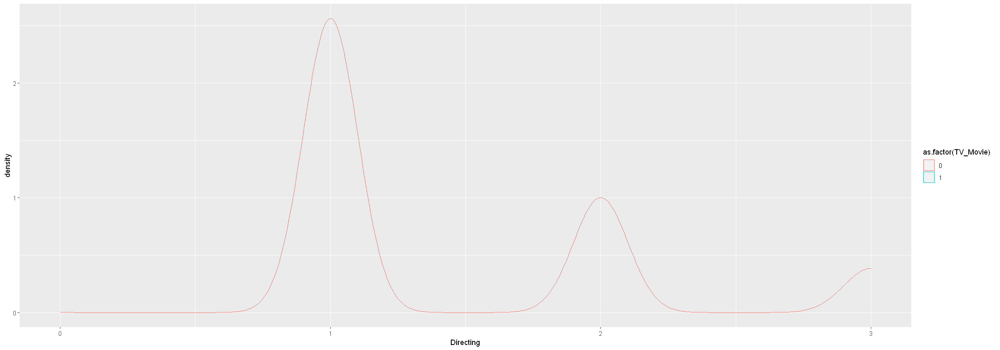

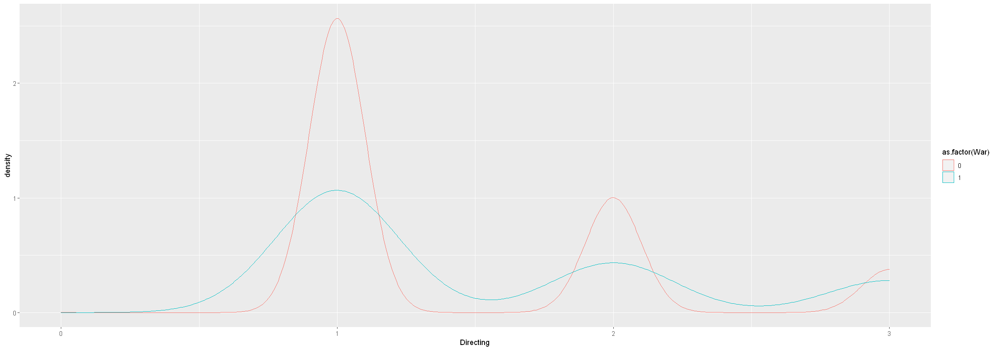

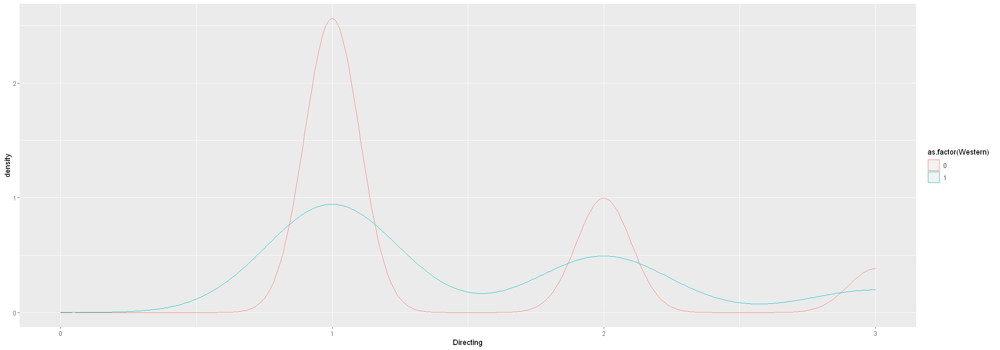

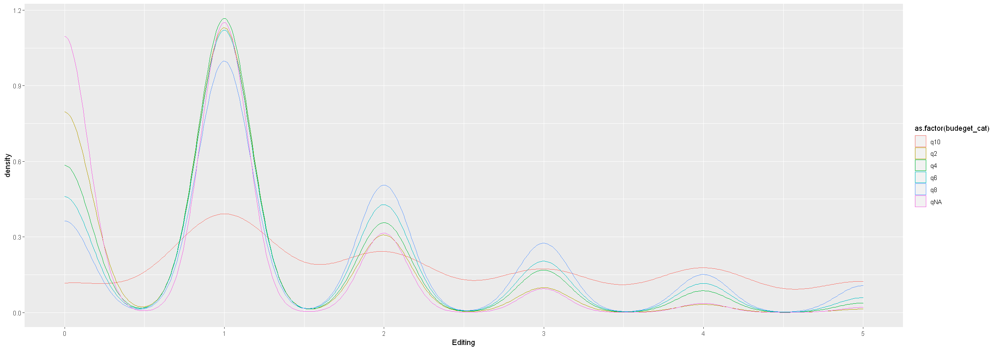

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

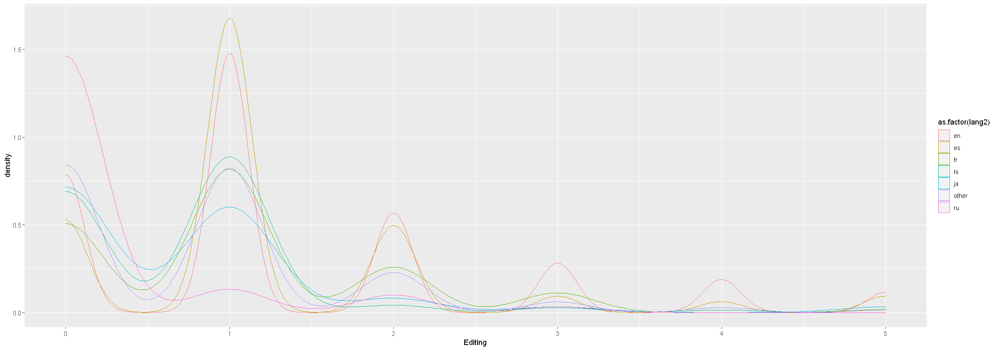

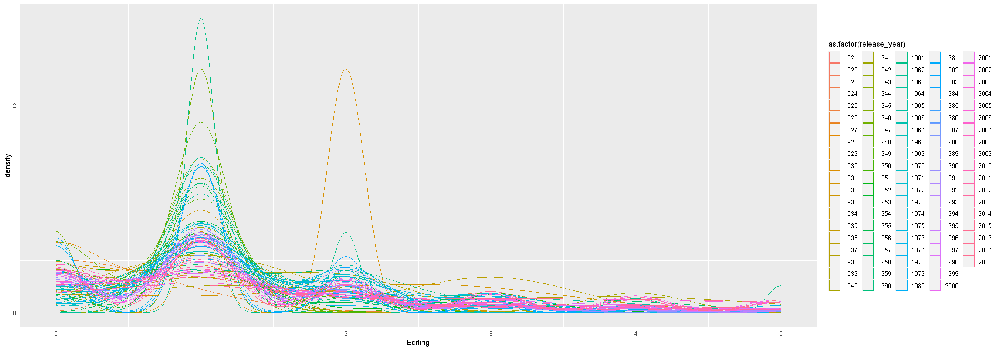

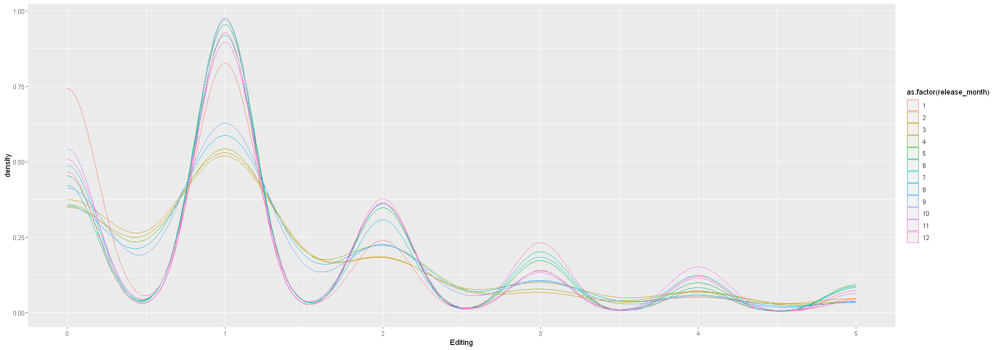

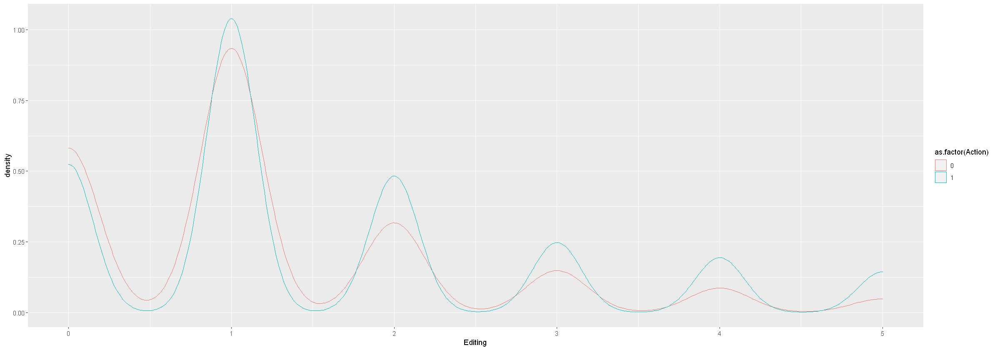

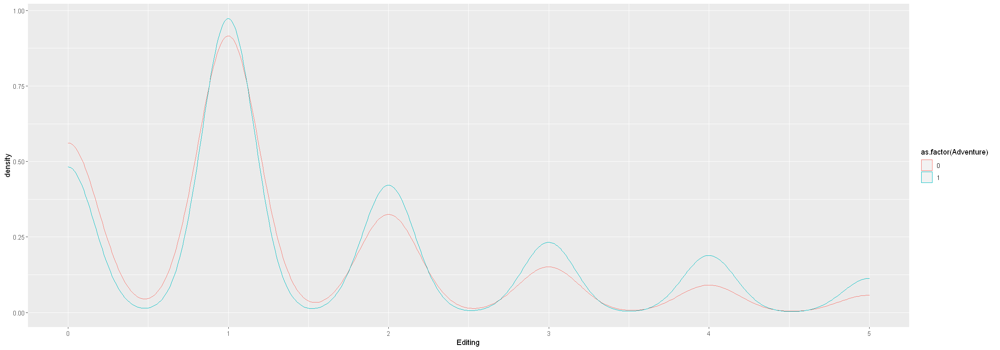

...

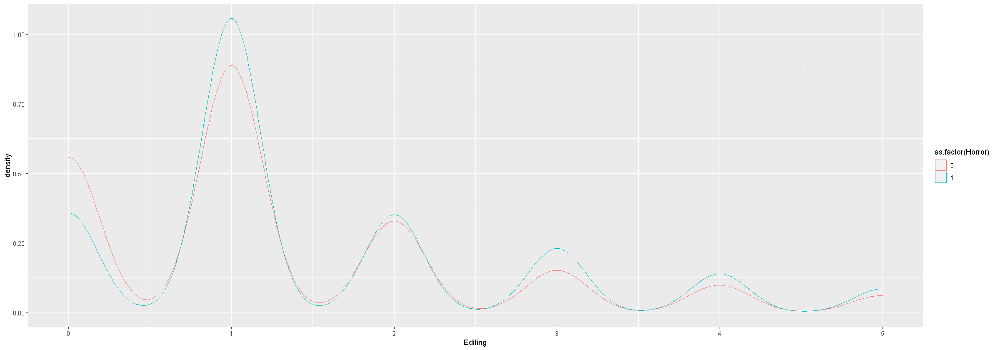

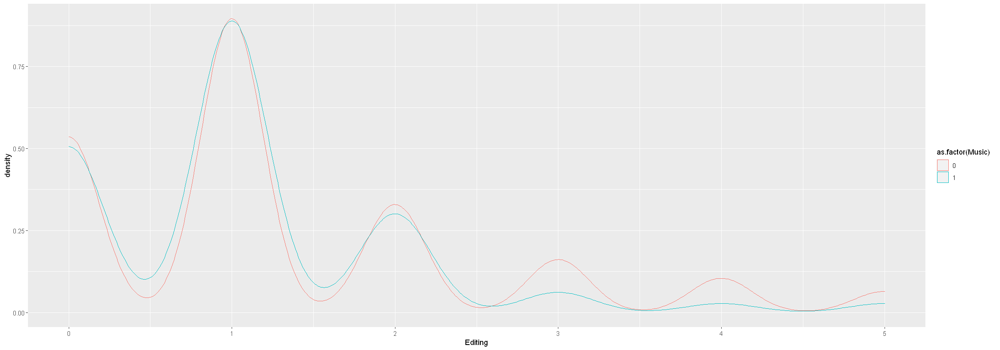

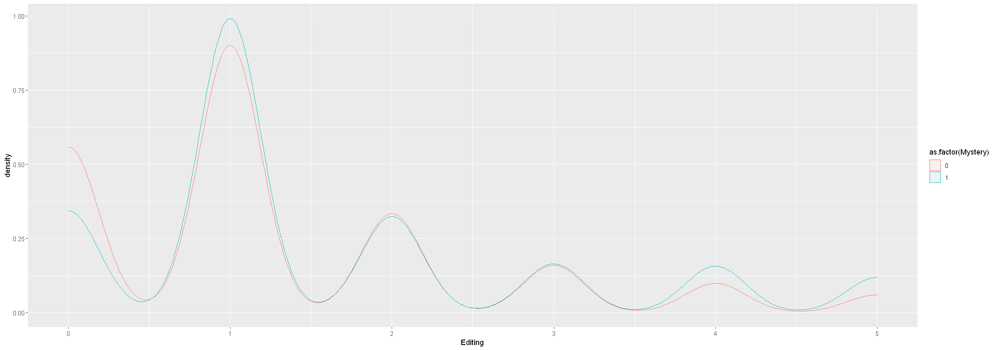

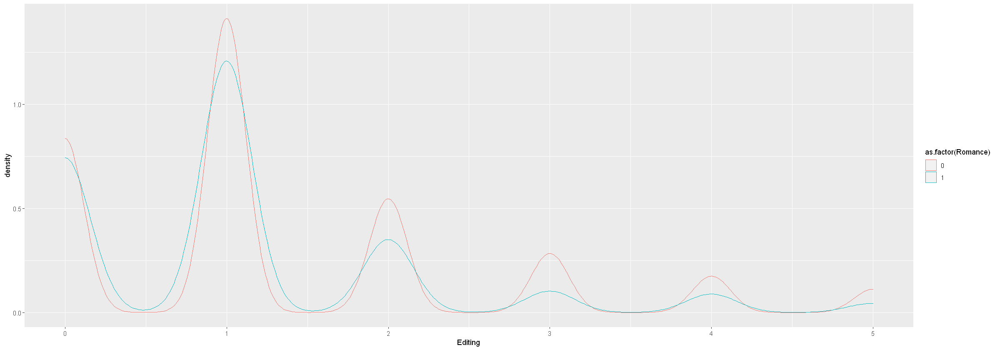

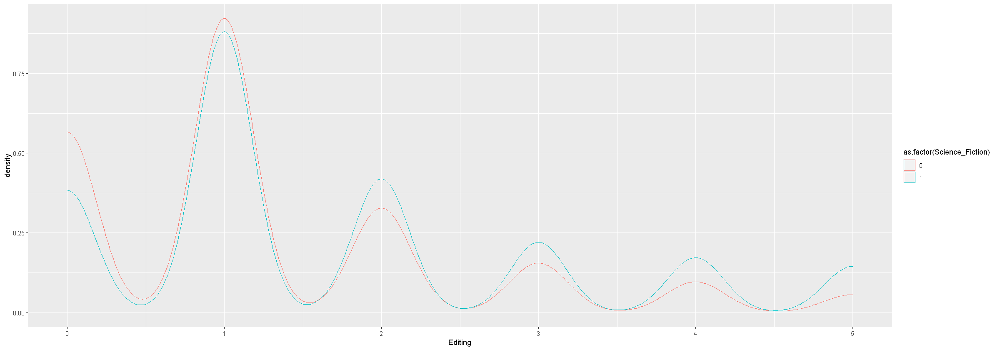

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


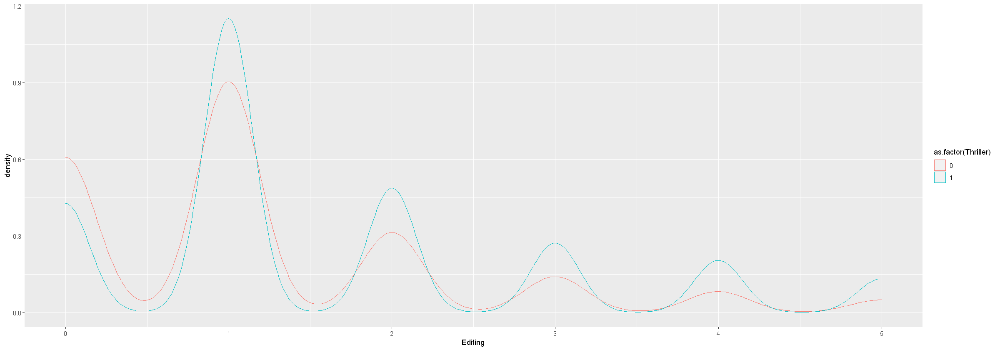

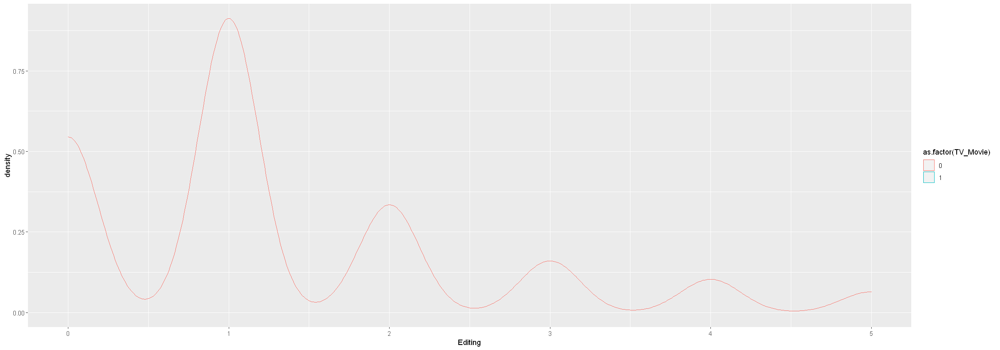

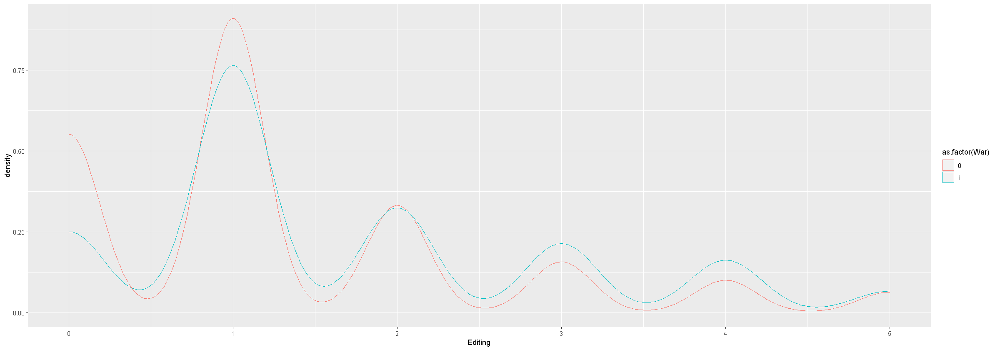

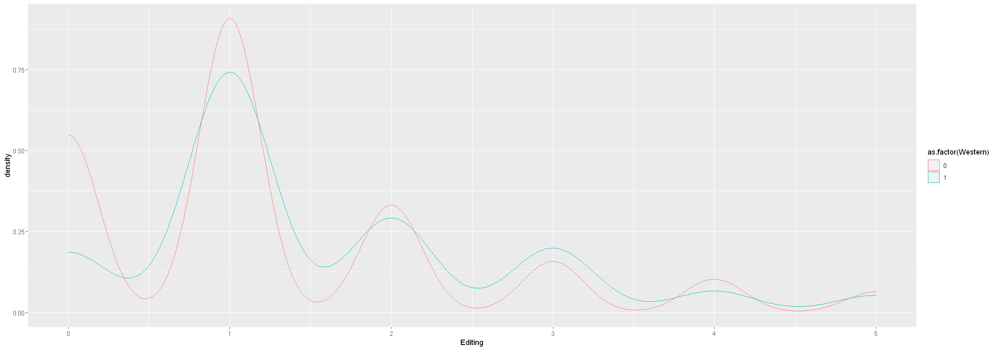

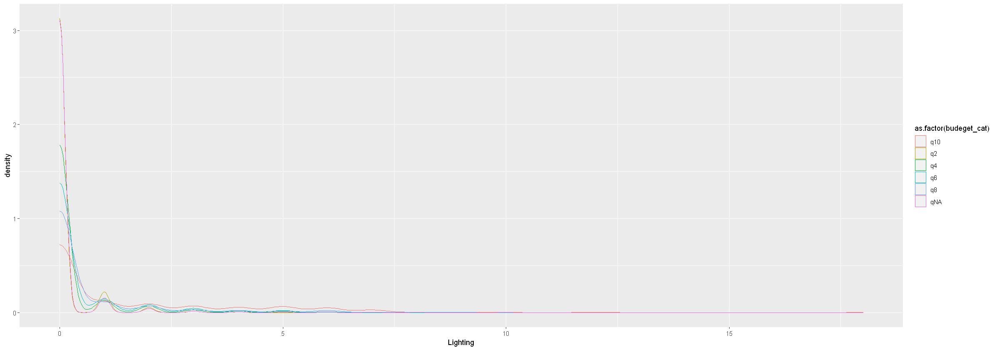

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

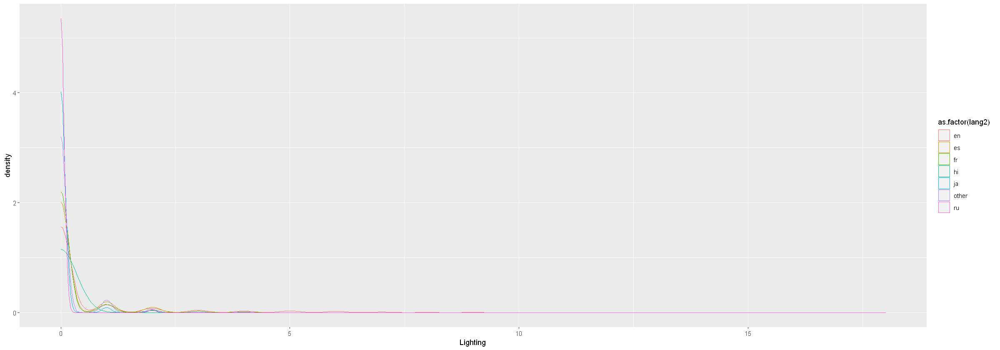

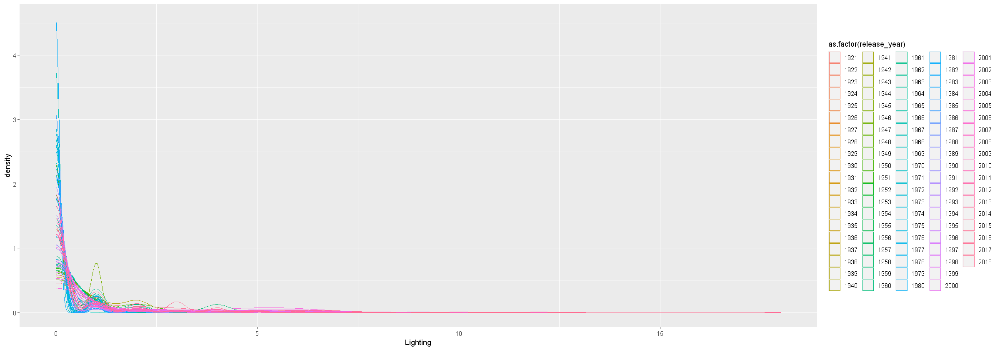

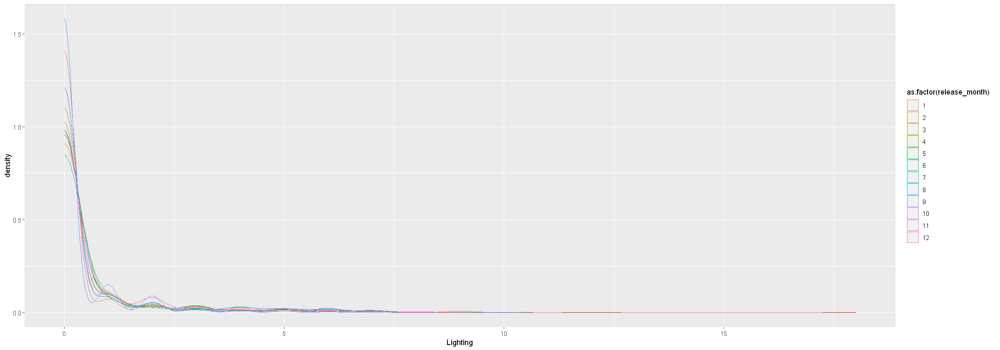

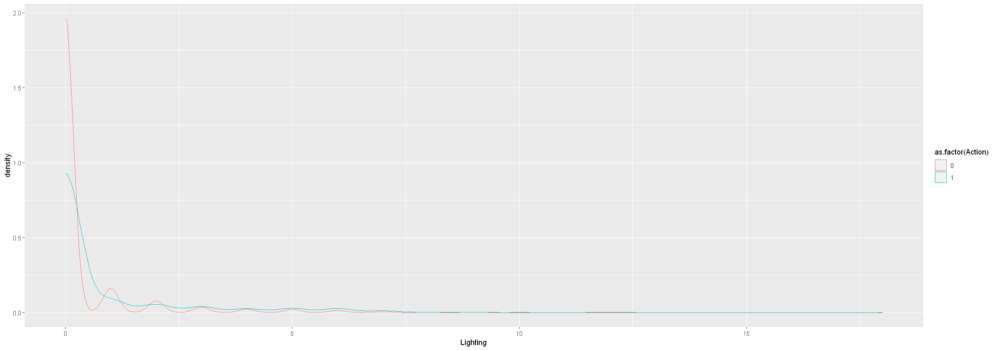

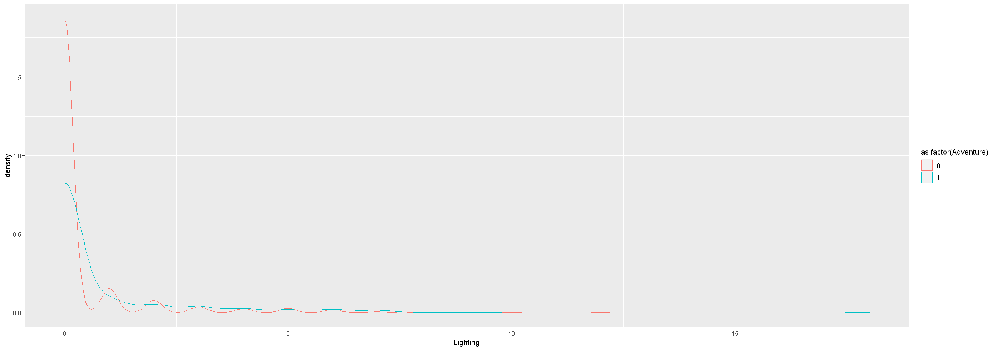

...

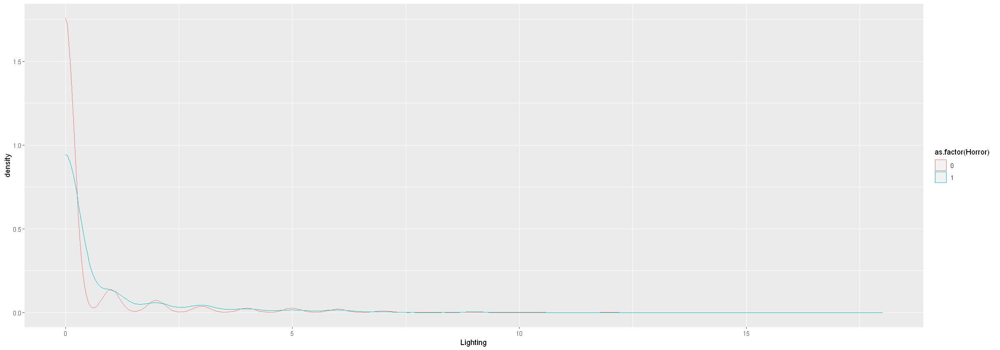

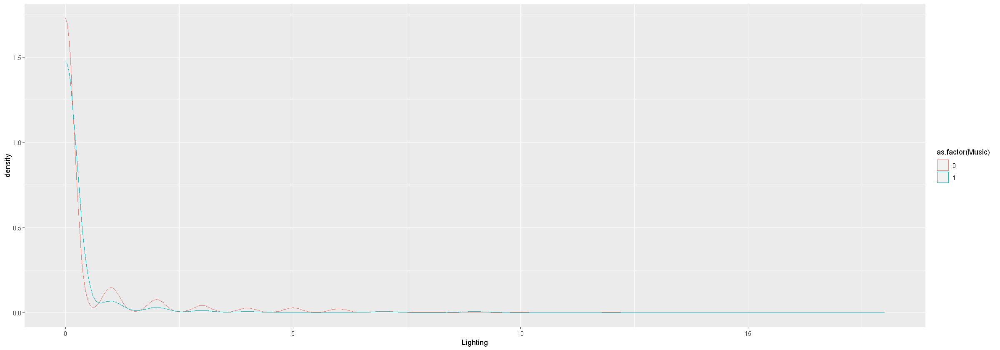

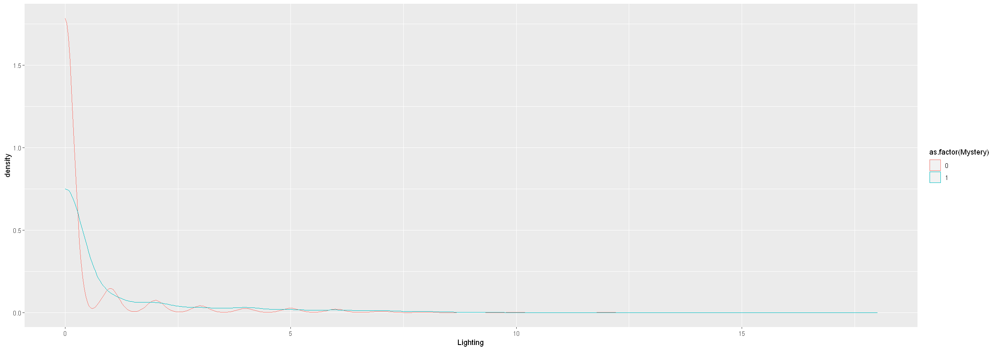

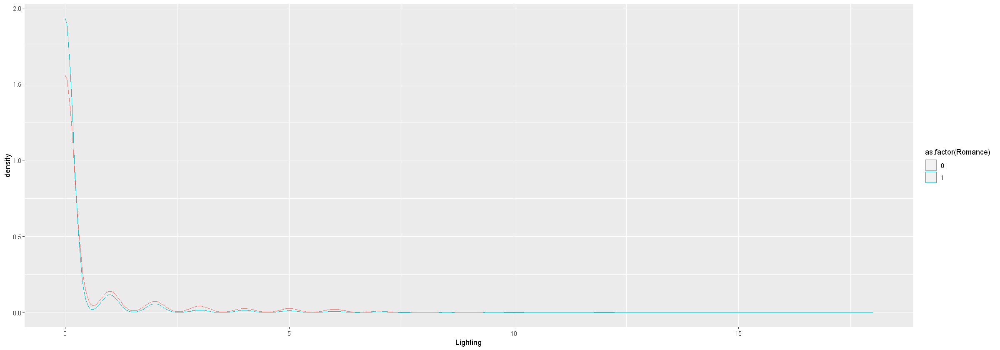

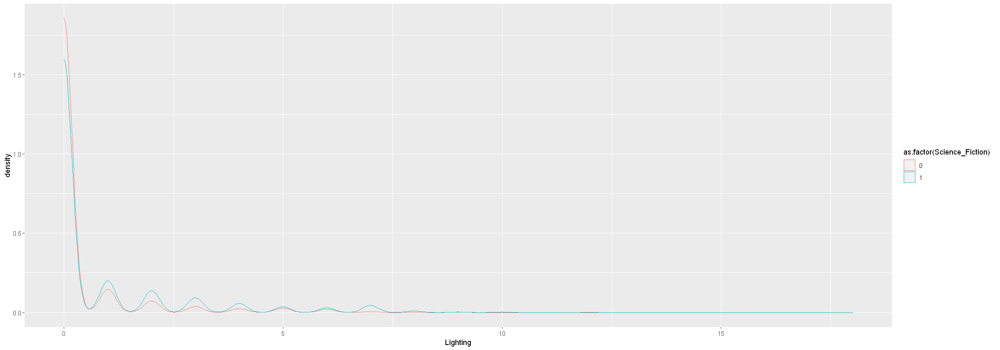

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


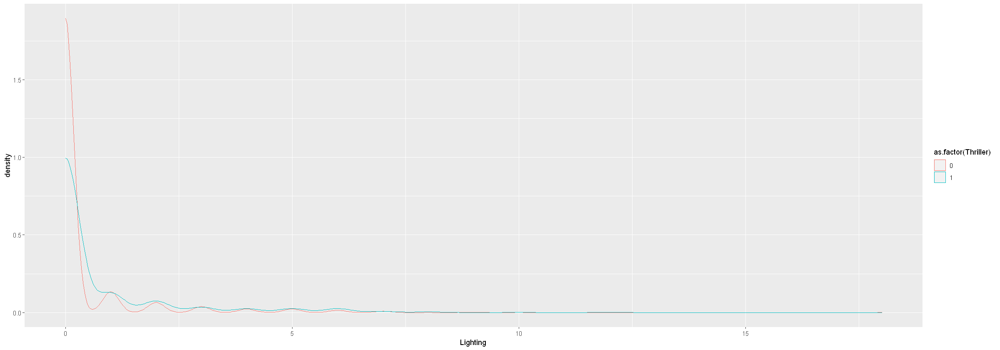

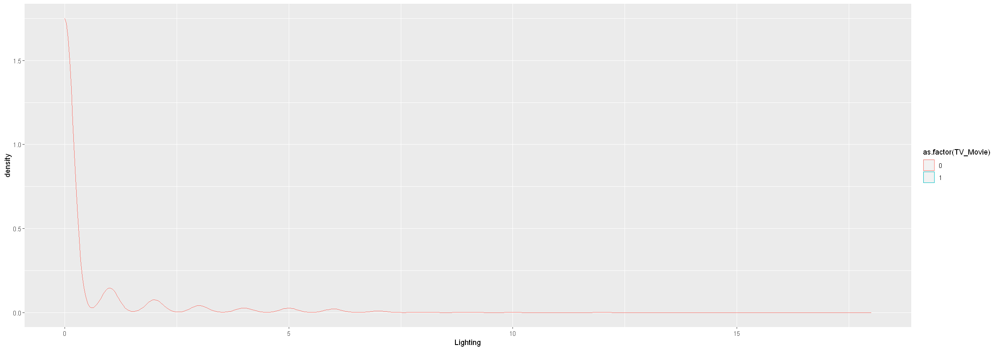

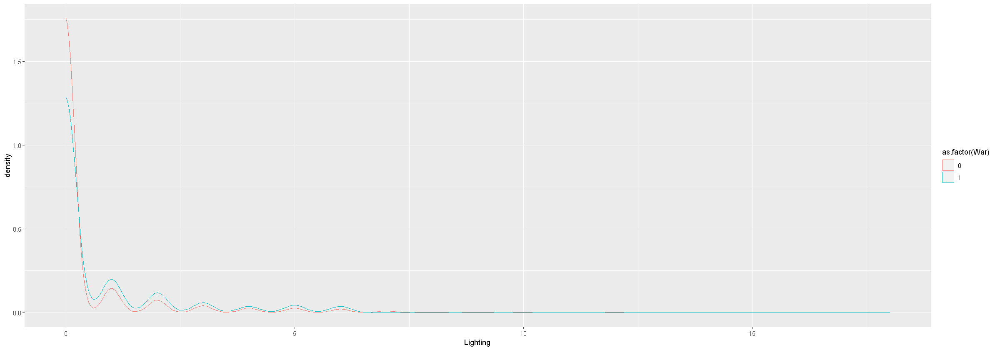

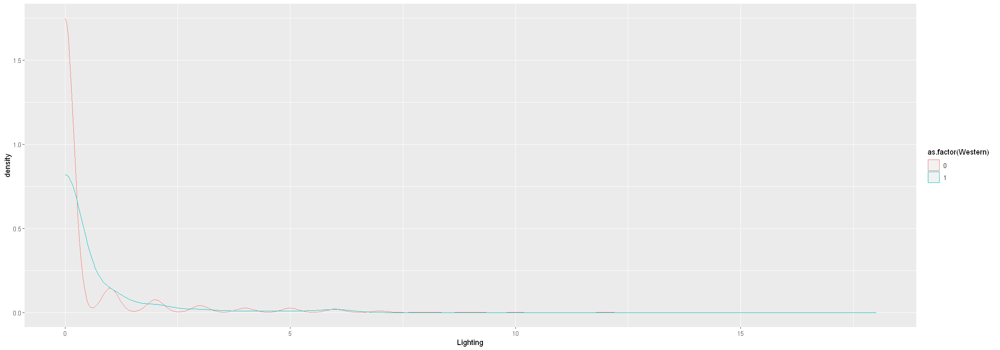

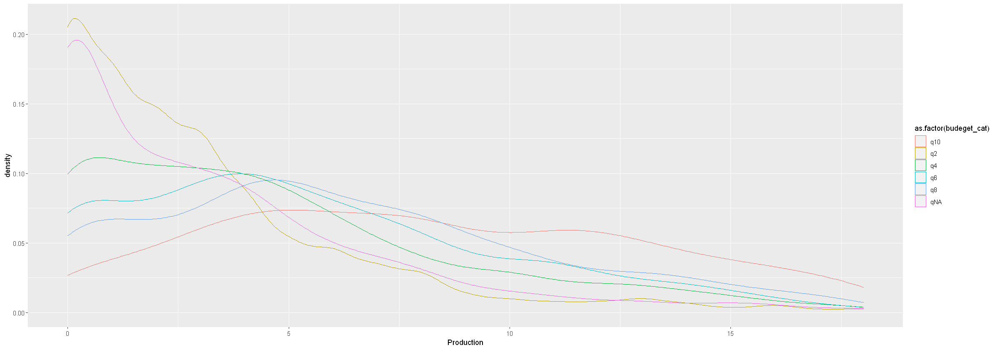

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

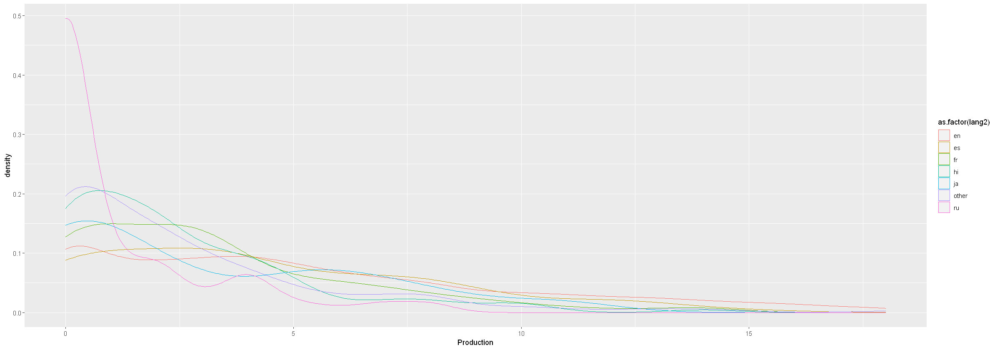

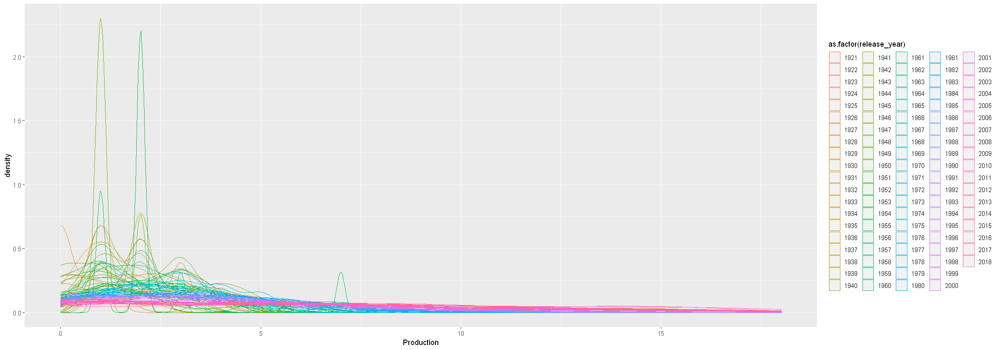

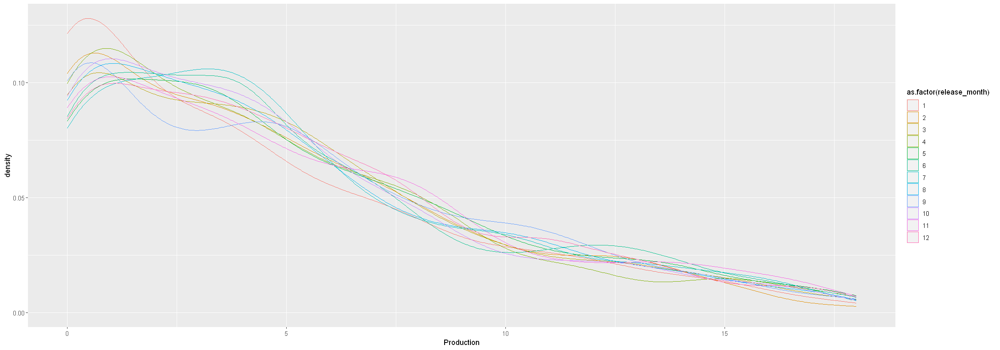

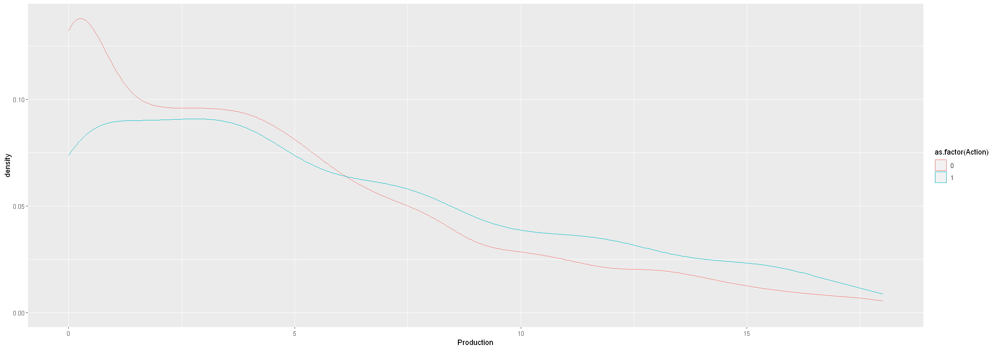

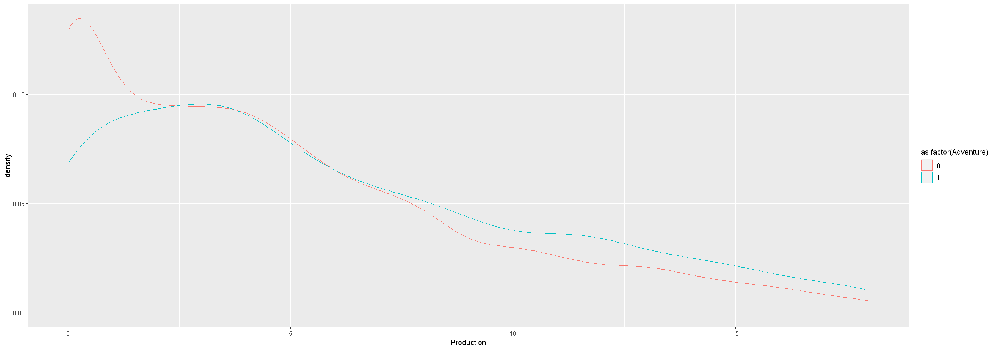

...

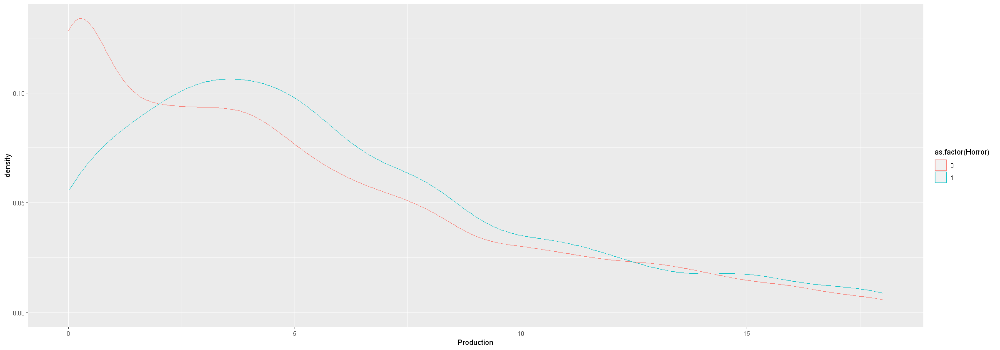

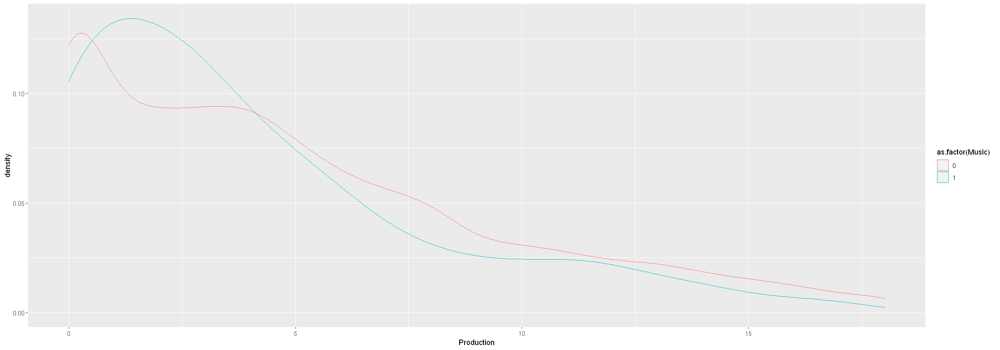

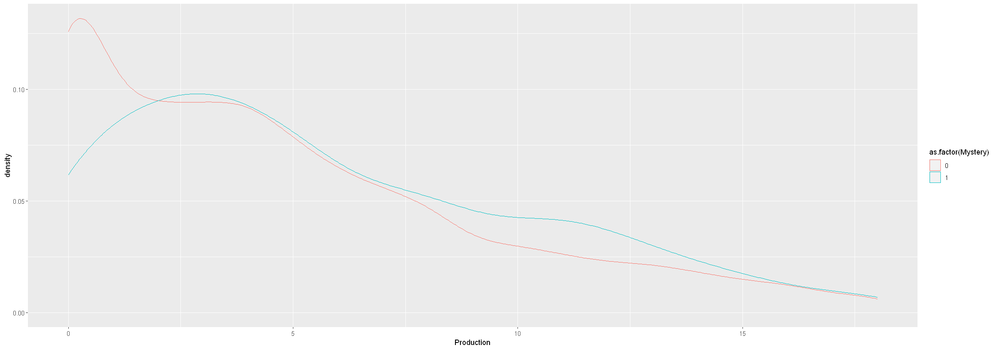

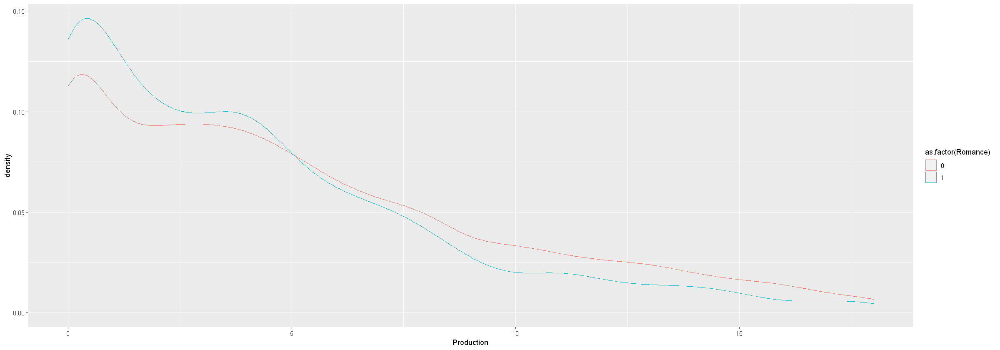

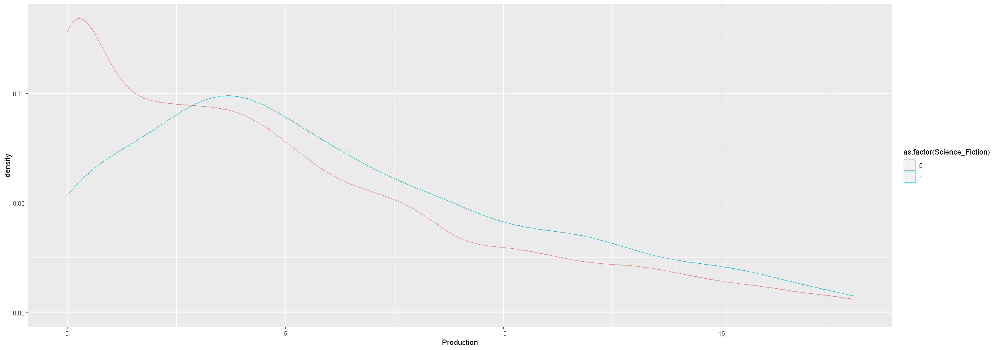

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


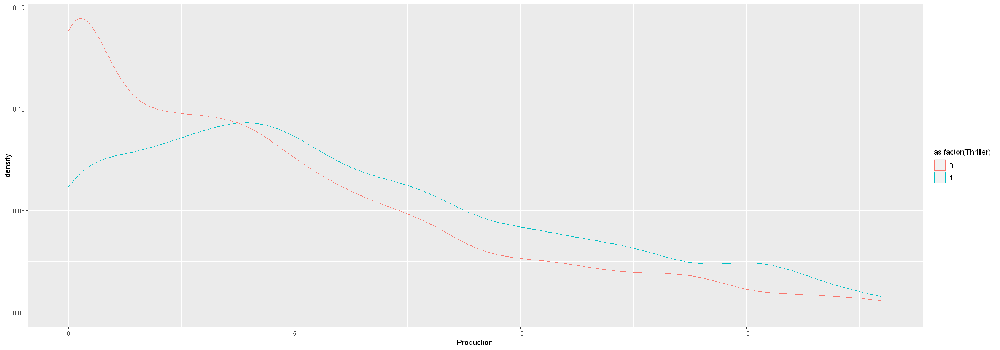

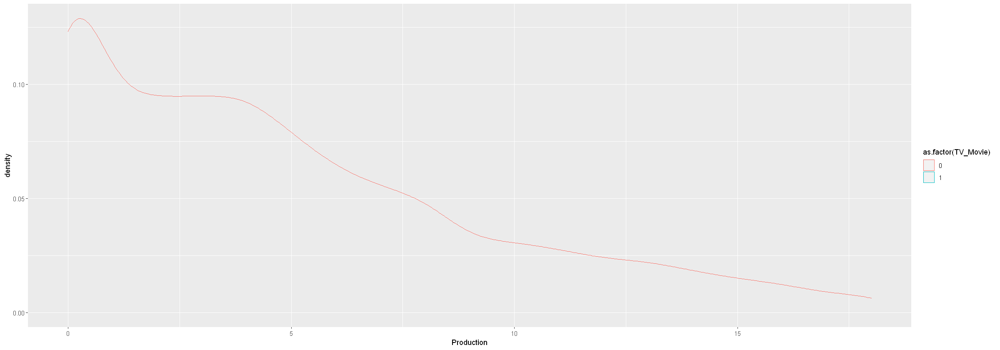

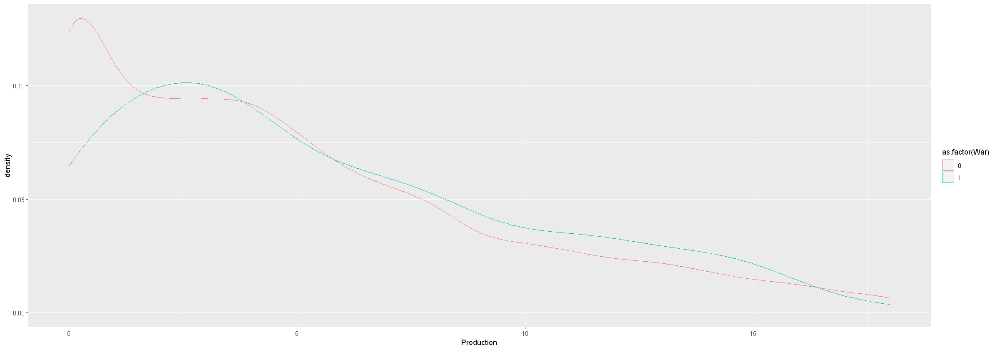

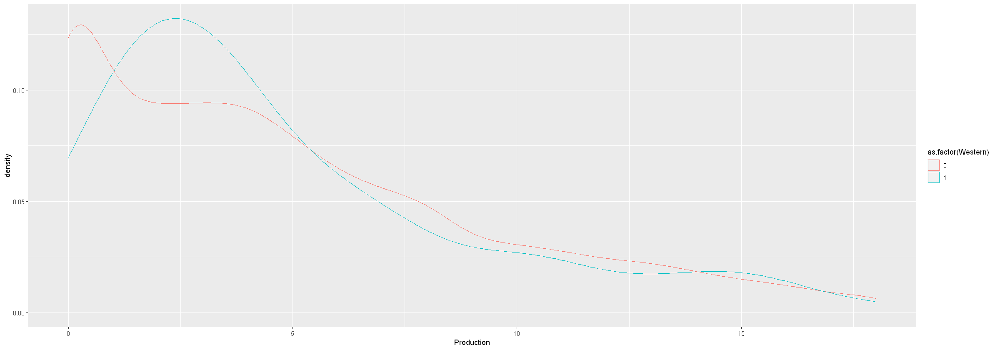

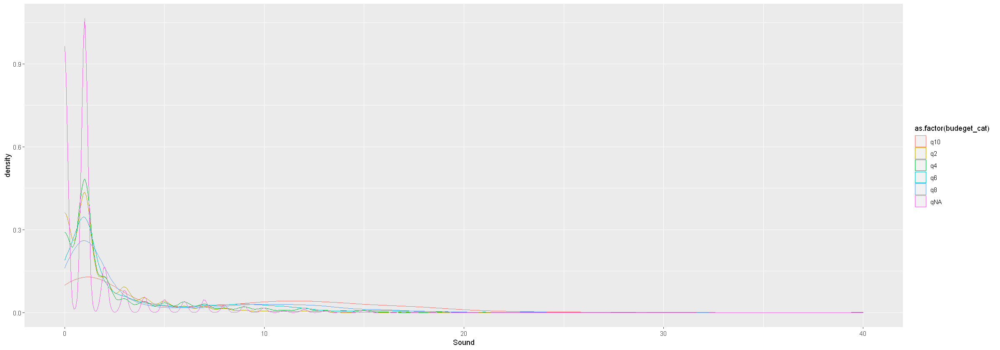

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

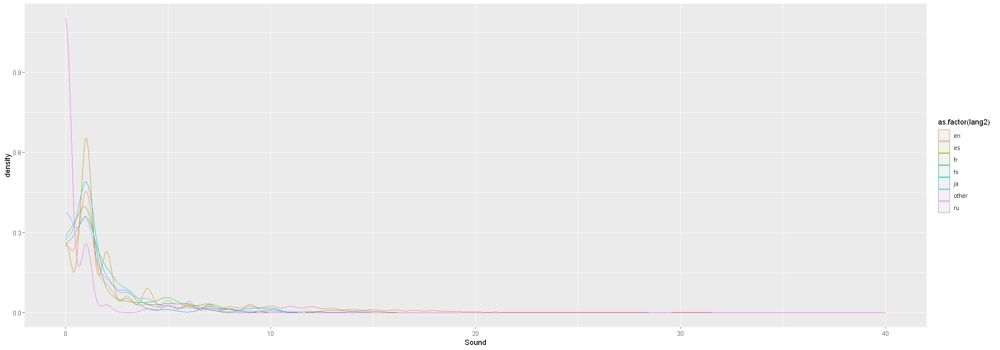

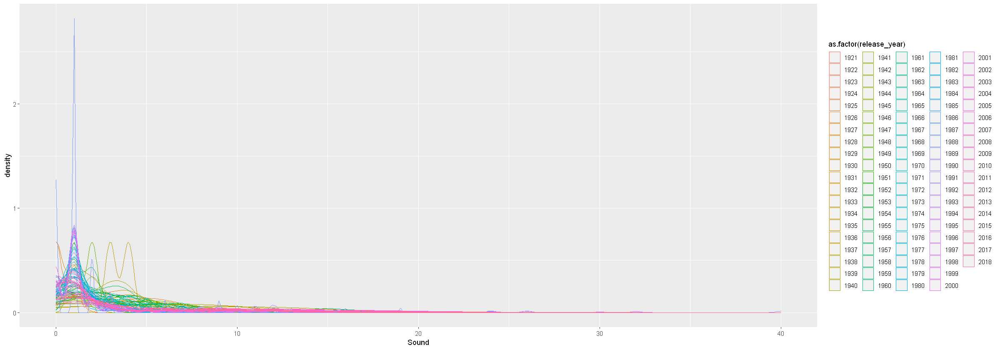

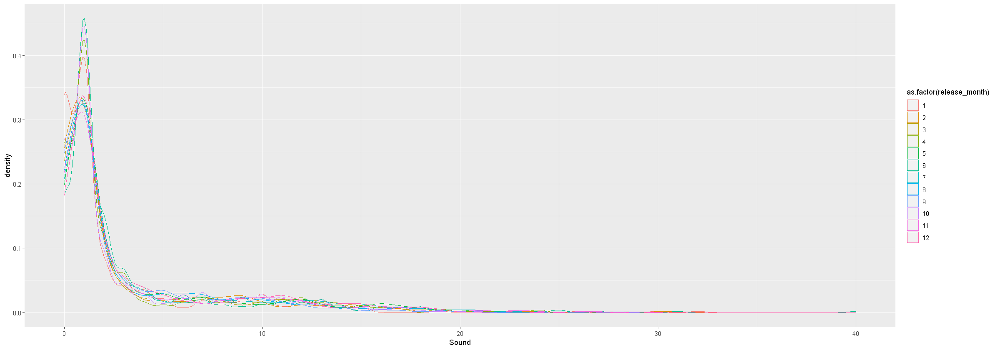

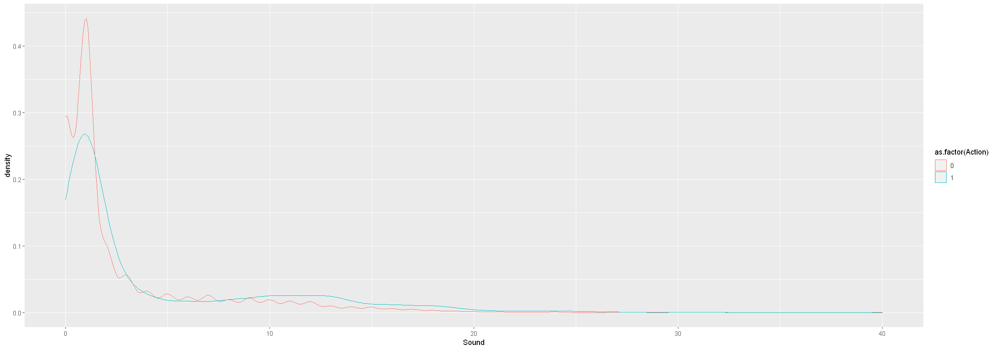

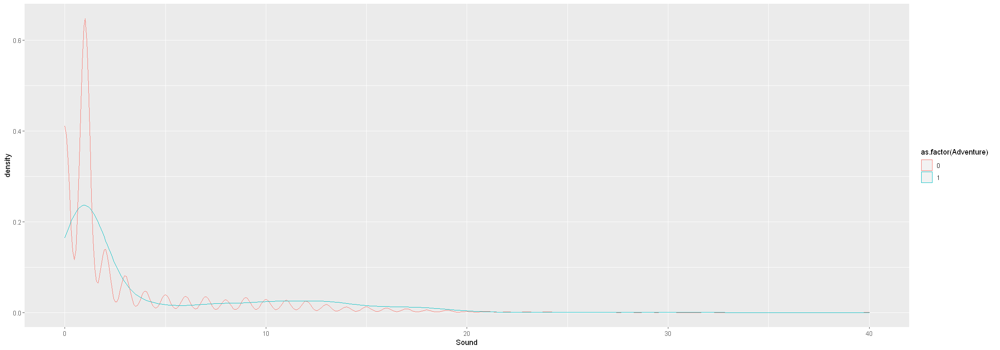

...

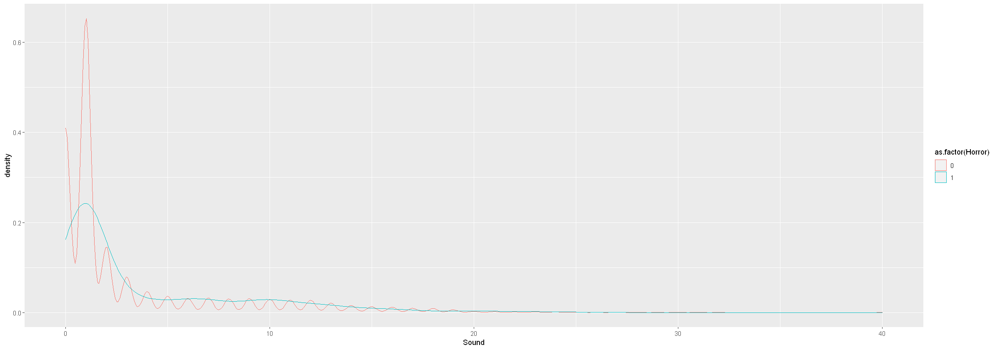

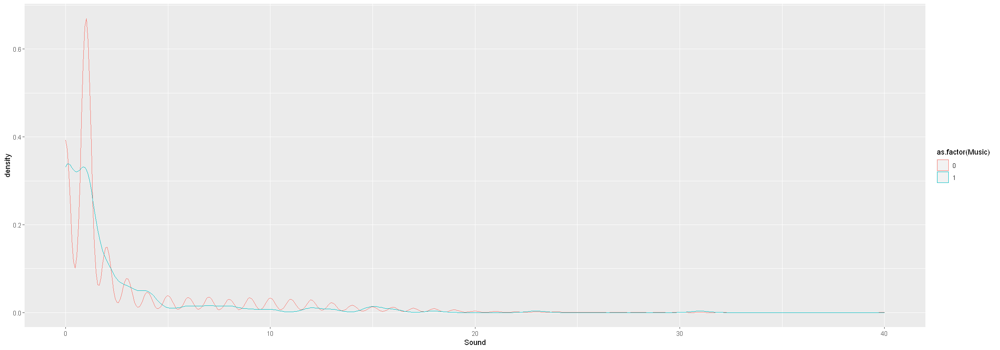

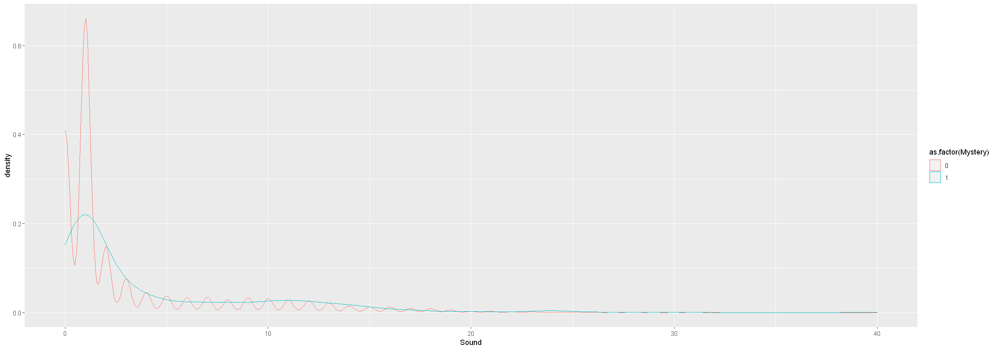

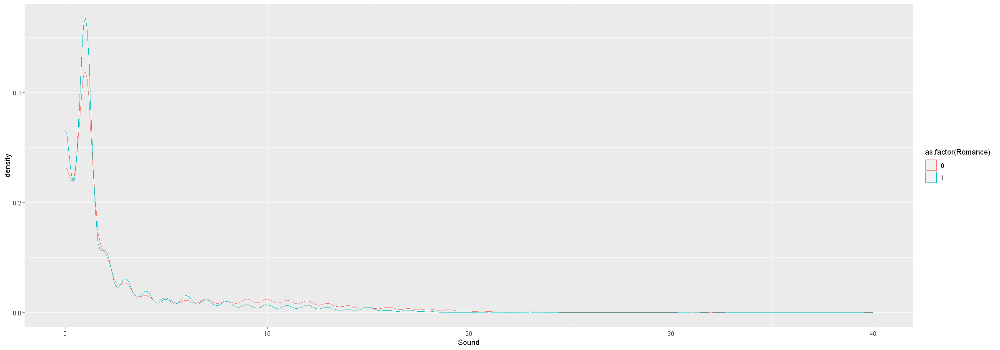

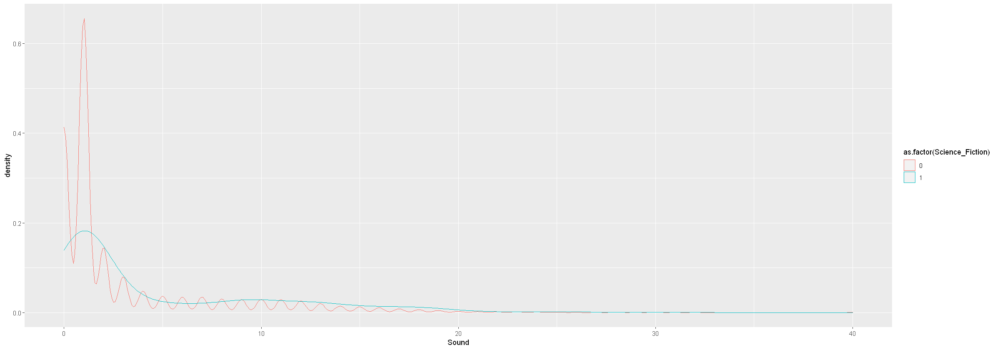

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


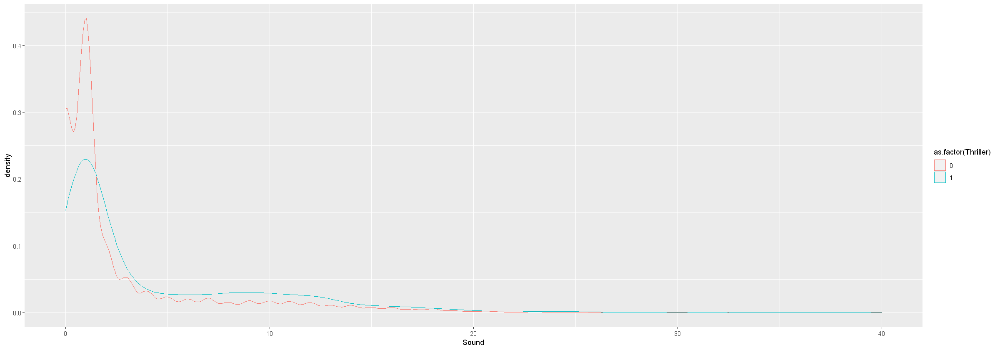

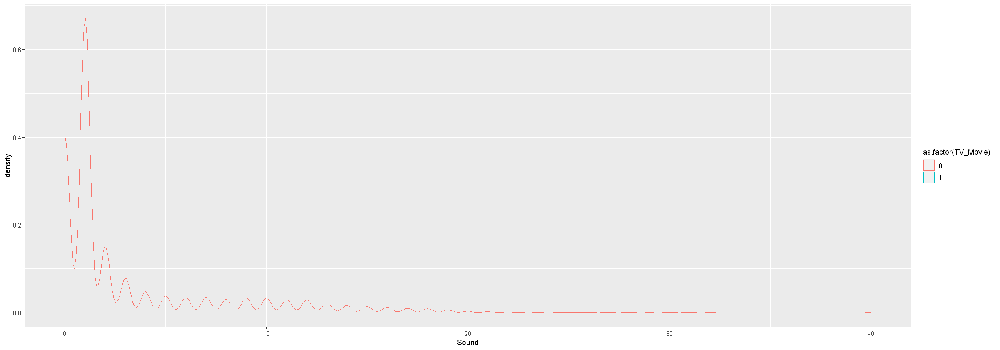

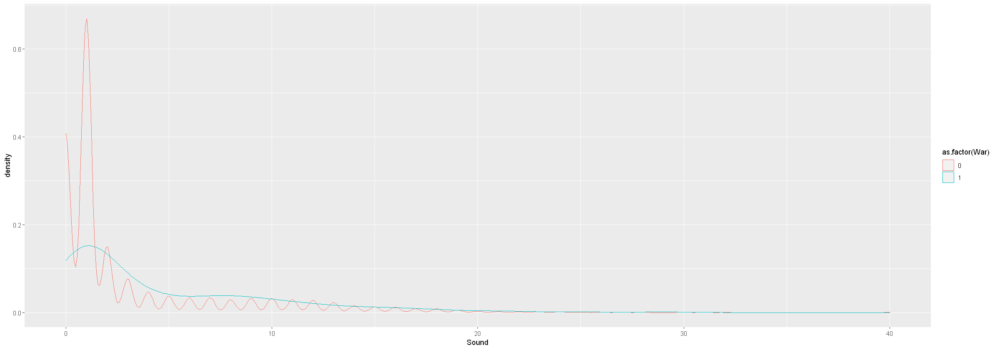

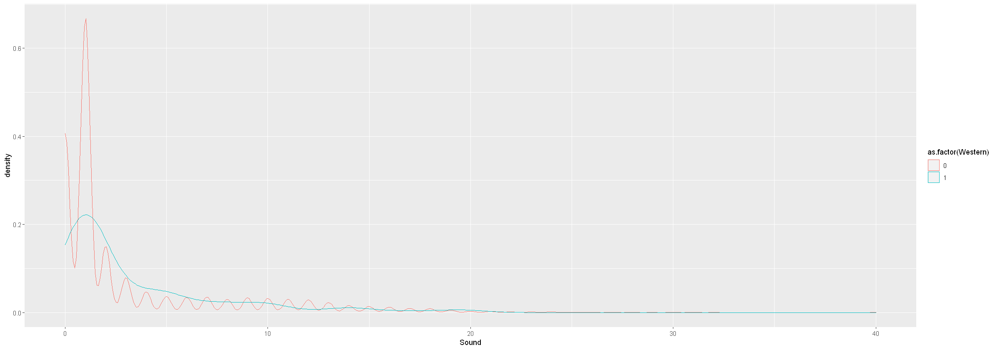

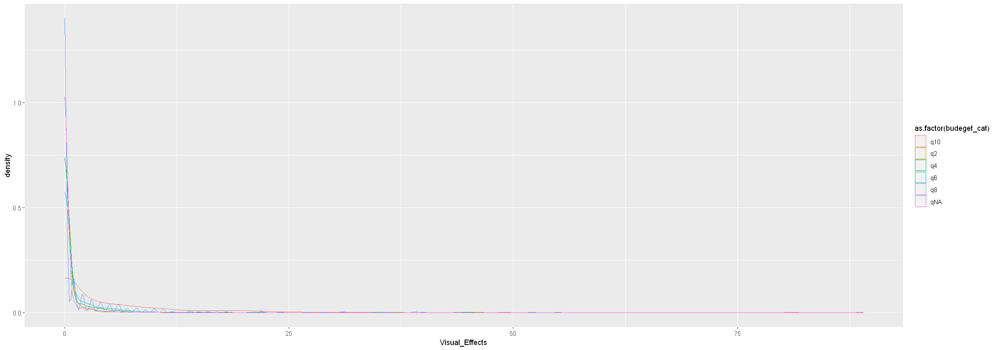

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

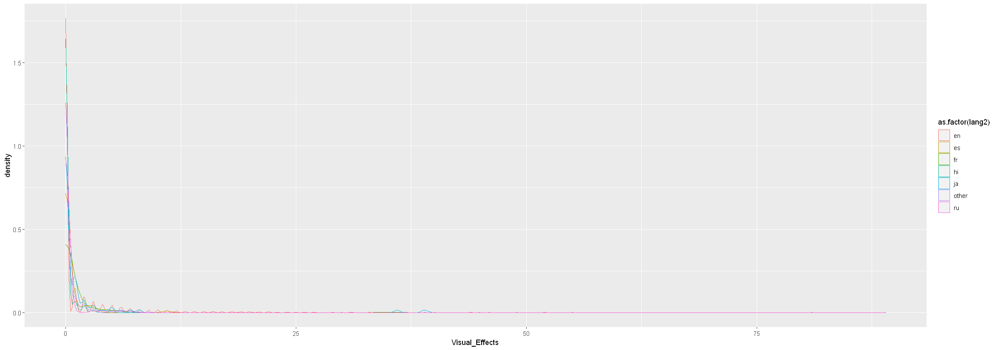

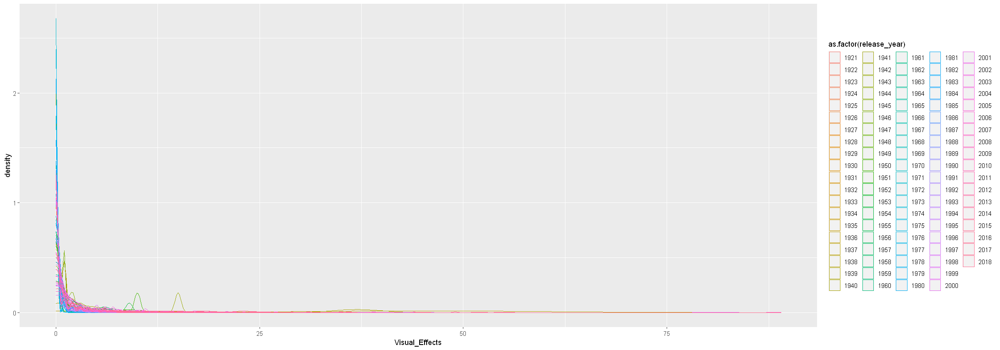

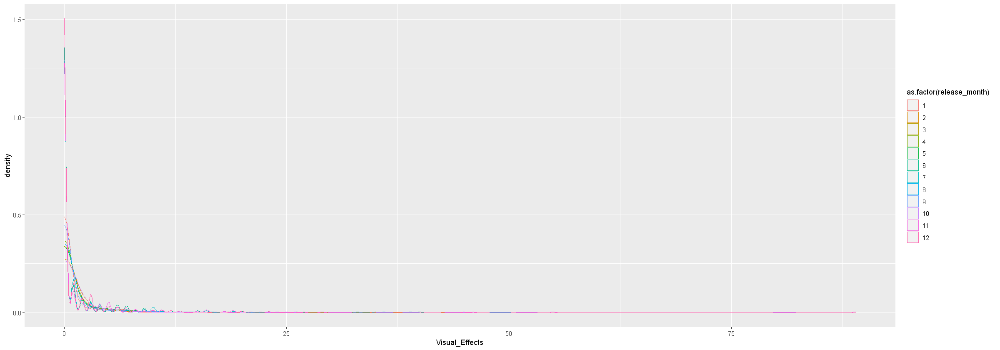

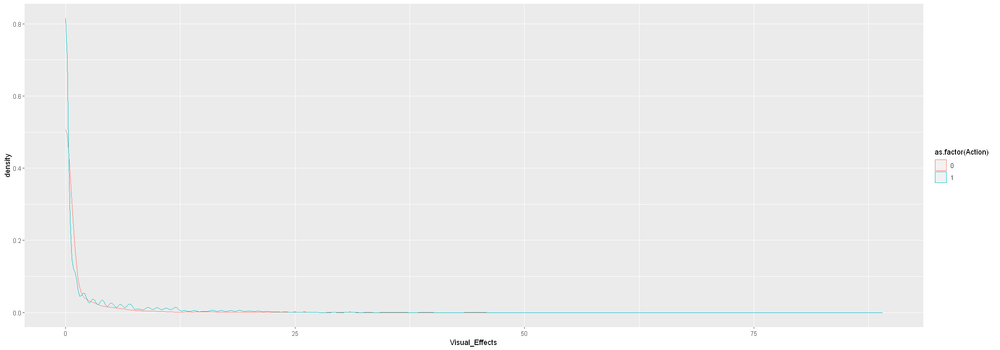

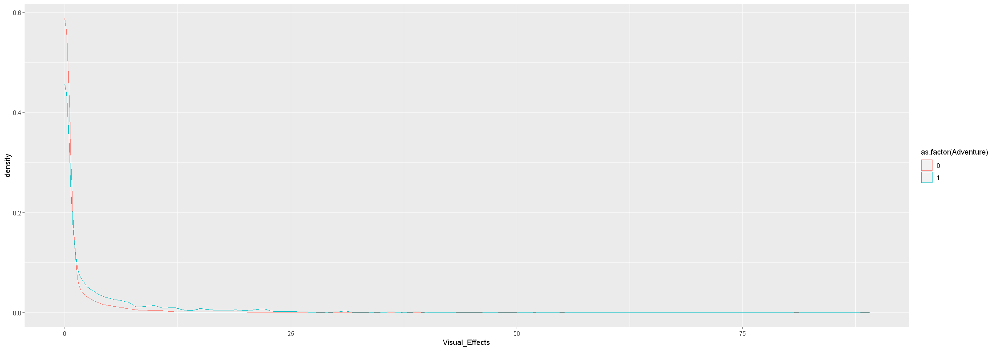

...

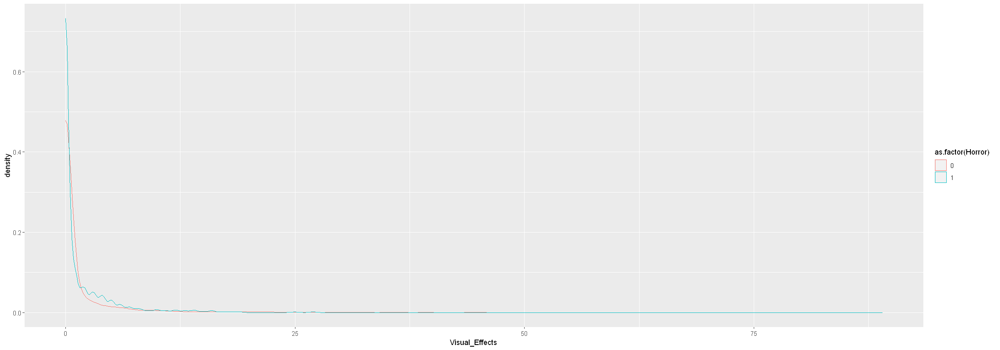

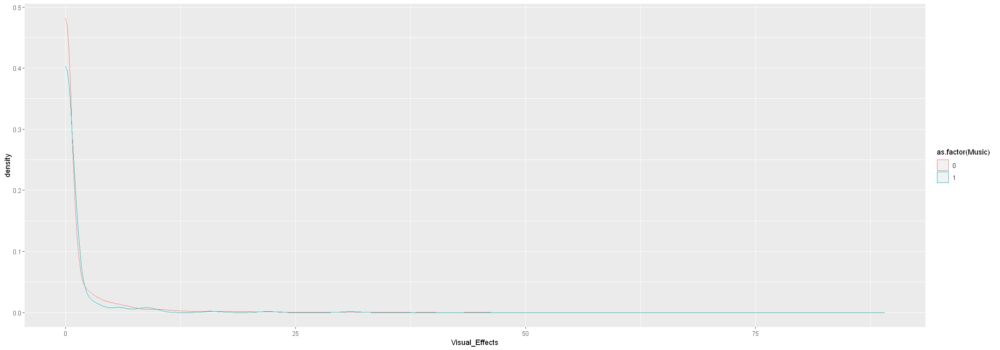

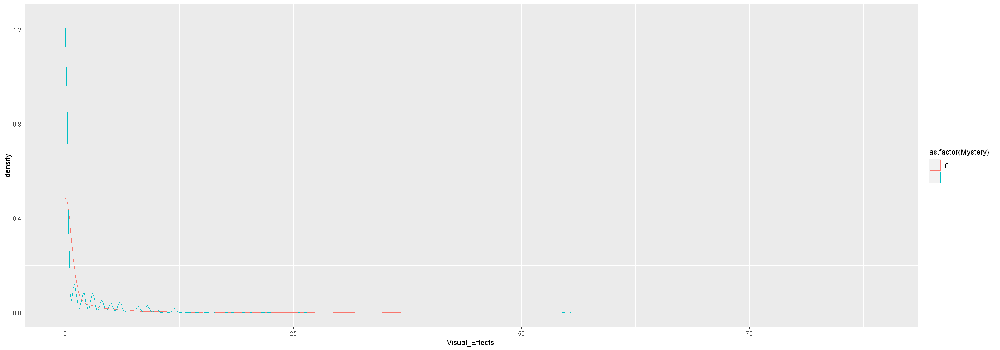

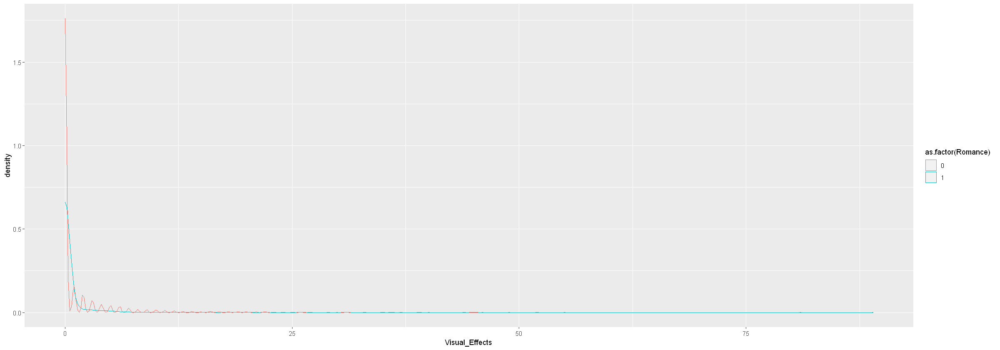

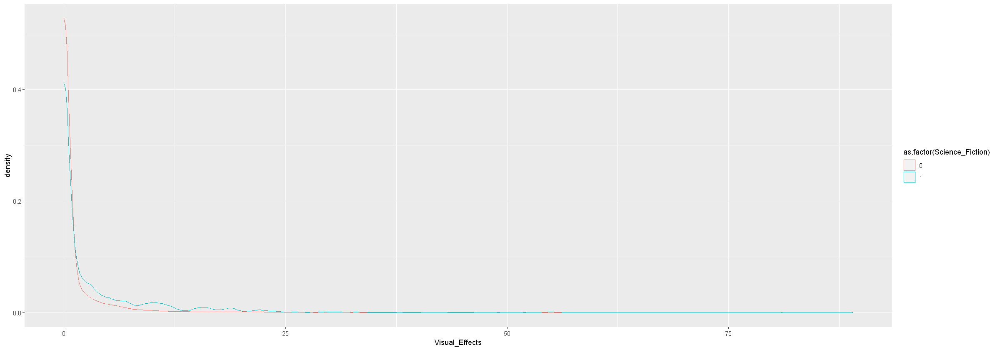

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


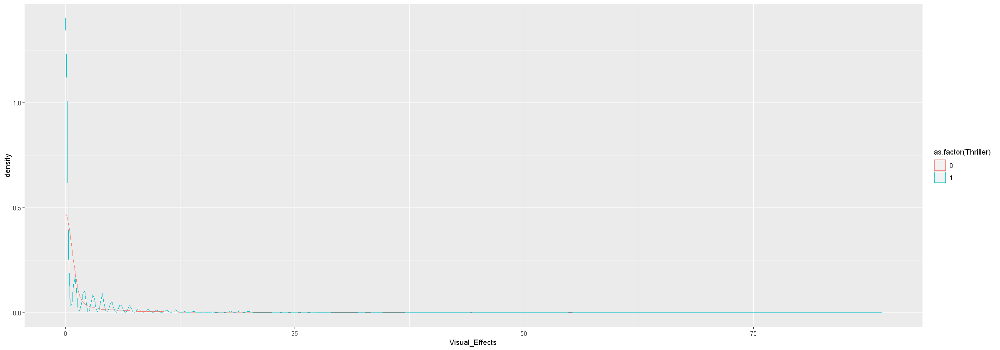

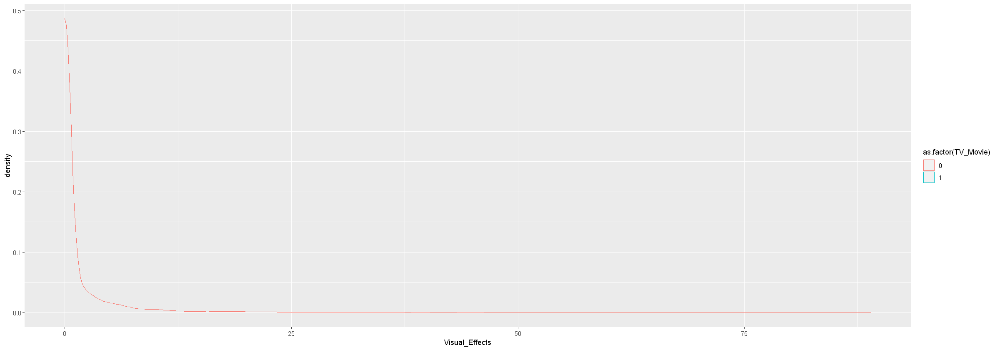

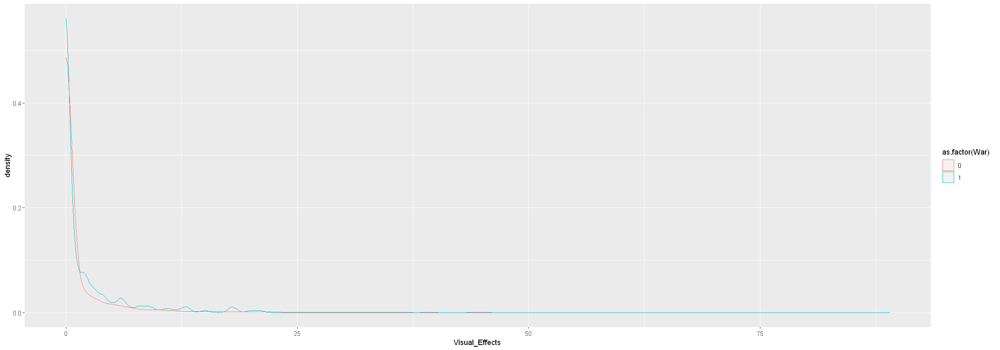

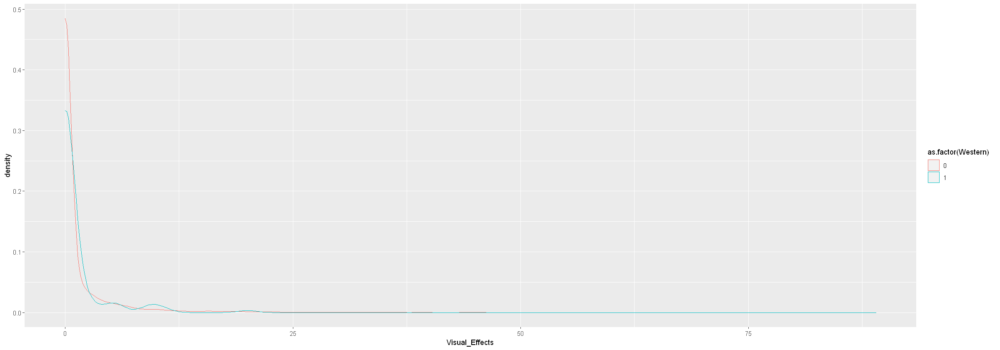

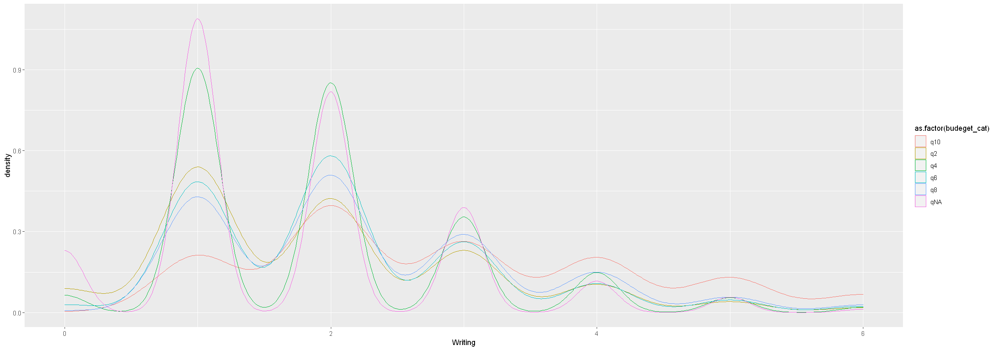

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to m

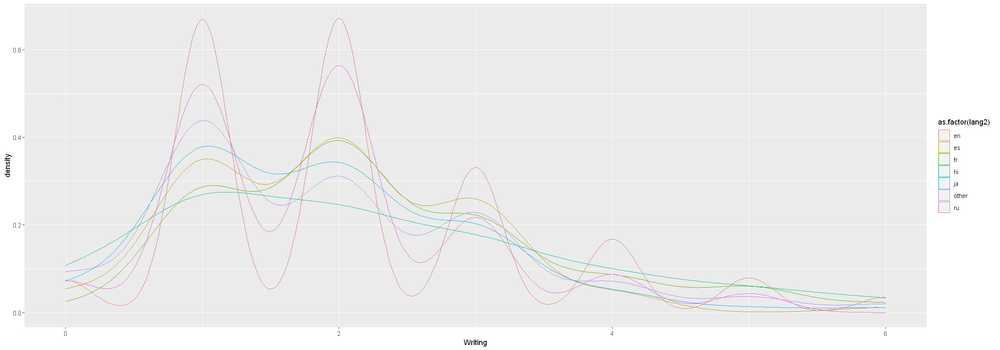

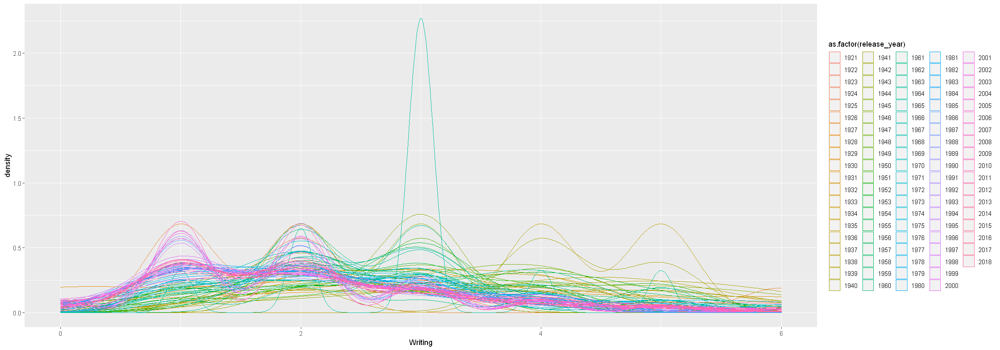

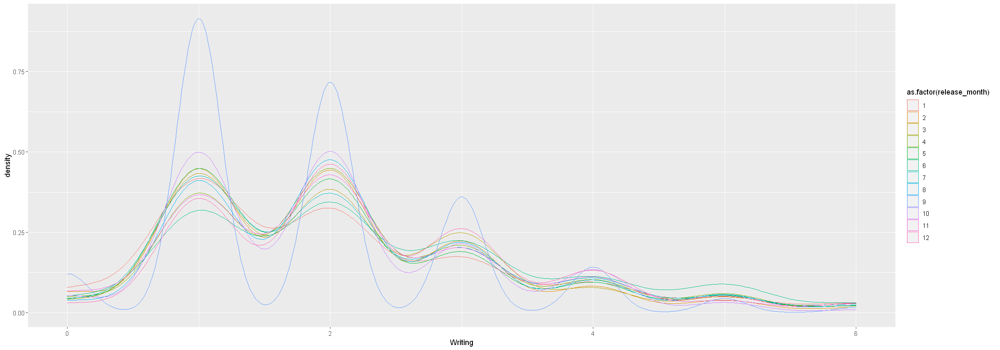

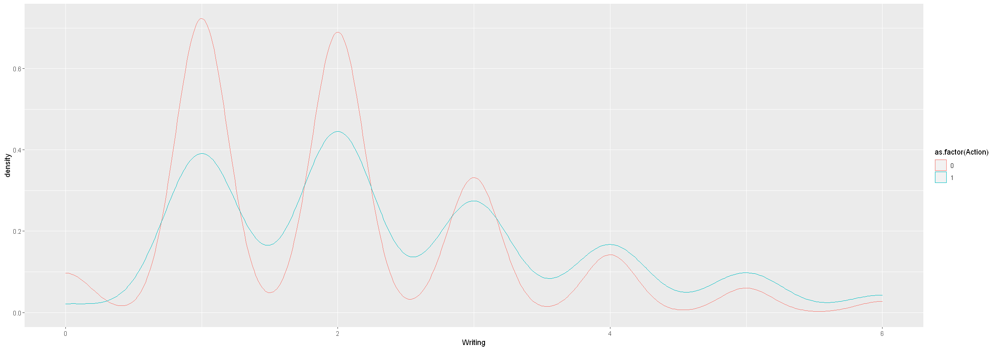

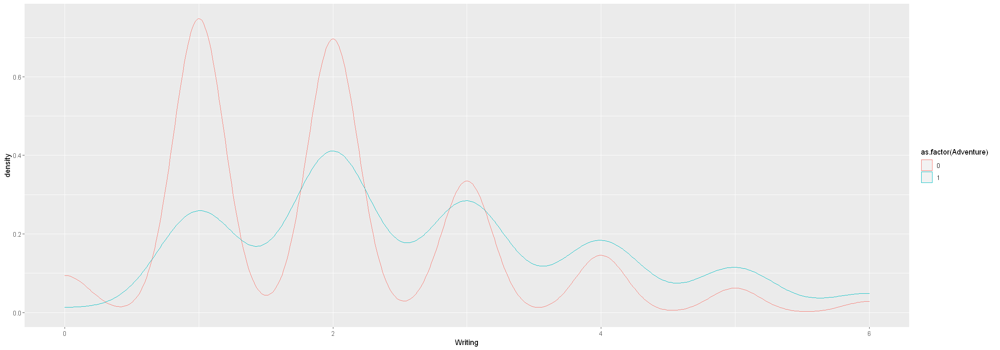

...

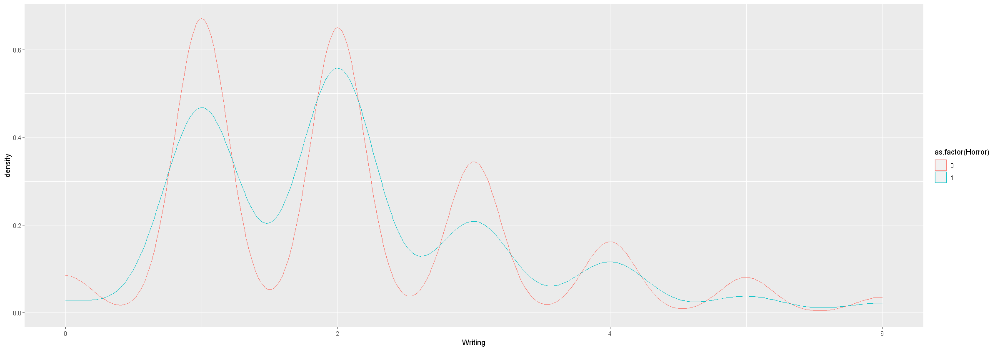

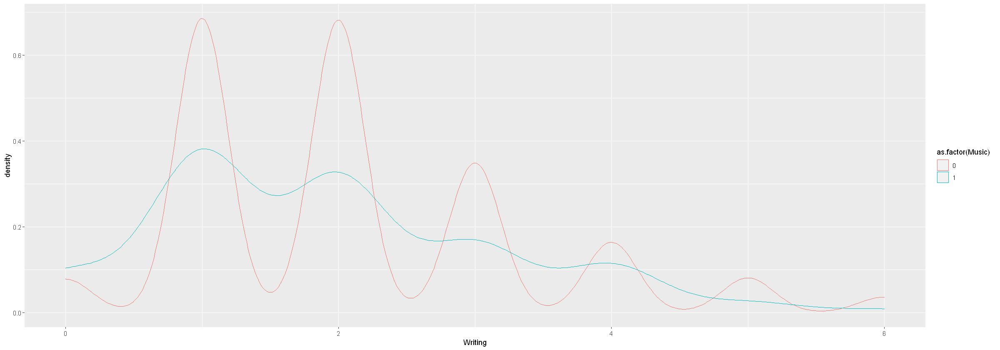

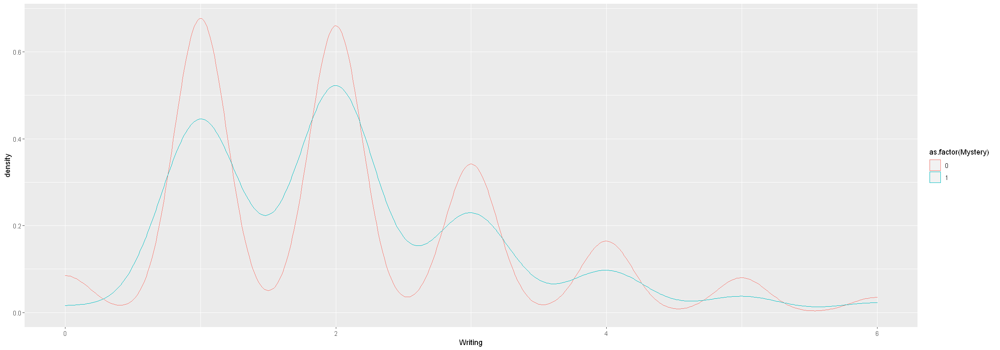

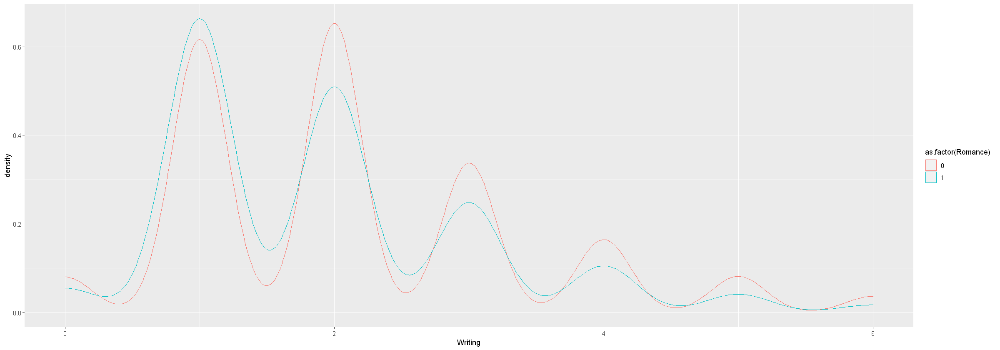

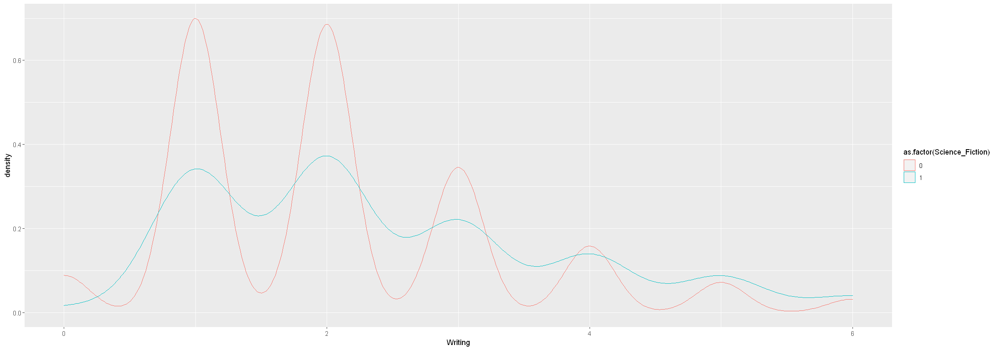

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


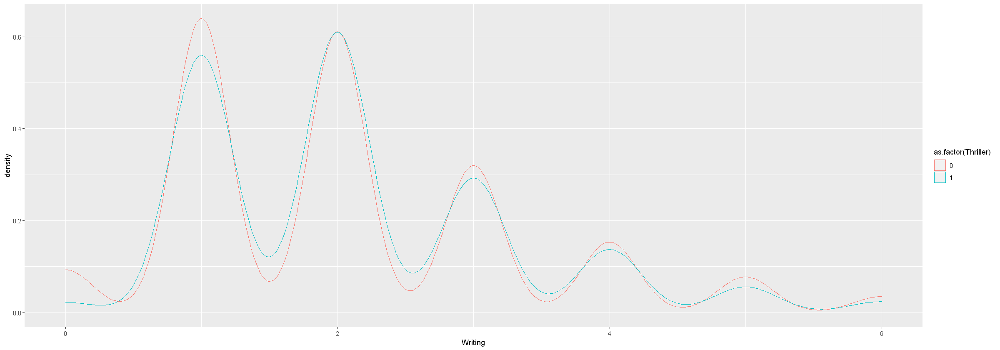

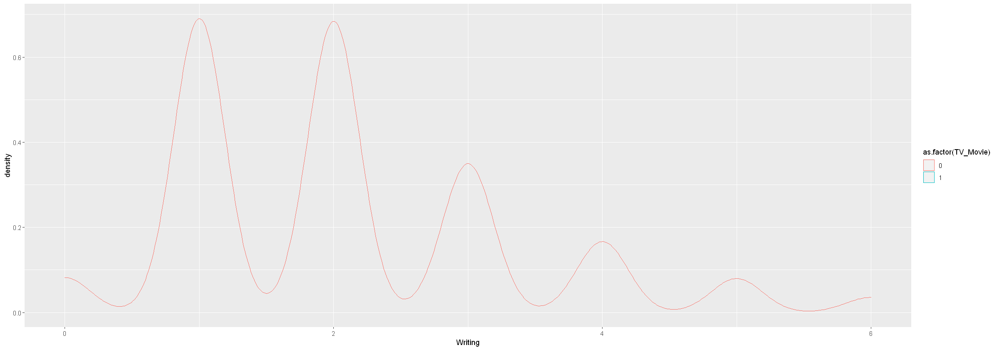

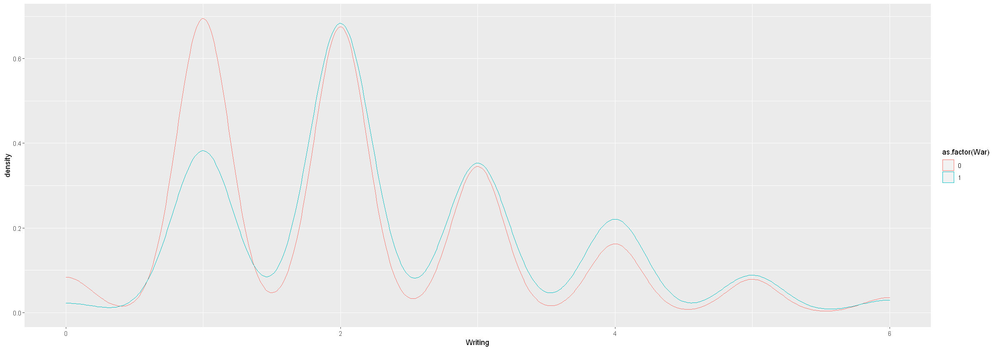

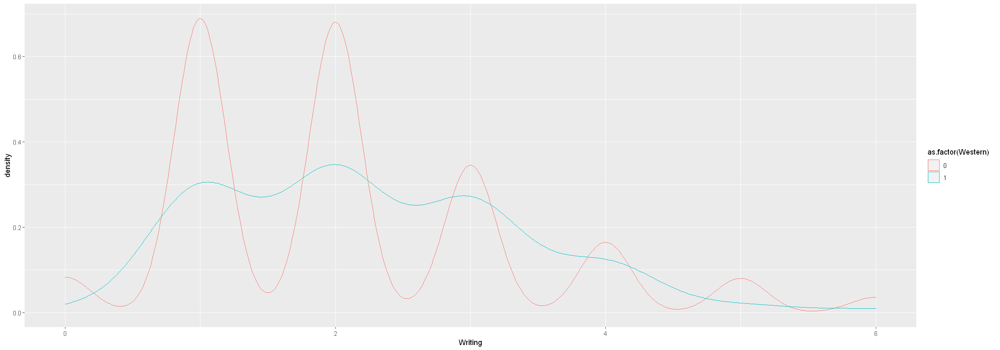

In [68]:
for (n in numlst){
    for (s in catlst){
            print(ggplot(data = ff_final, na.rm = TRUE) +
                    geom_density(aes(.data[[n]], group=as.factor(.data[[s]]), color=as.factor(.data[[s]]))))
    }
}

#### 3 - Correlation table

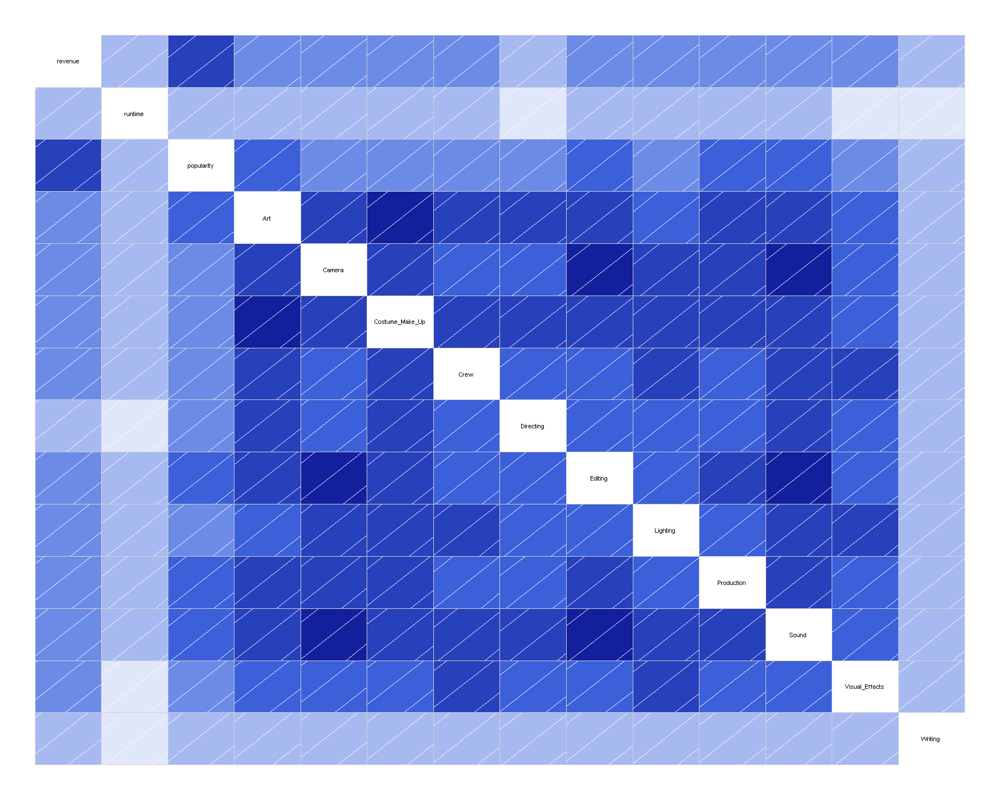

In [70]:
options(repr.plot.width = 15, repr.plot.height = 12)
ffcormat <- cor(ff_final[,c('revenue',c('runtime' 
            ,'popularity'   
            #,'Actors' 
            ,'Art' 
            ,'Camera' 
            ,'Costume_Make_Up' 
            ,'Crew' 
            ,'Directing' 
            ,'Editing' 
            ,'Lighting' 
            ,'Production' 
            ,'Sound' 
            ,'Visual_Effects' 
            ,'Writing'
            ))], use = "pairwise.complete.obs", method = "spearman")
corrgram::corrgram(ffcormat)

#### 4 - Outcome

In [71]:
length(ff_final$revenue)
summary(ff_final$revenue)
sd(ff_final$revenue, na.rm = T )

[1] 7348

     Min.   1st Qu.    Median      Mean   3rd Qu.      Max.      NA's 
1.000e+00 2.405e+06 1.686e+07 6.598e+07 6.873e+07 1.520e+09      4363 

[1] 135240835

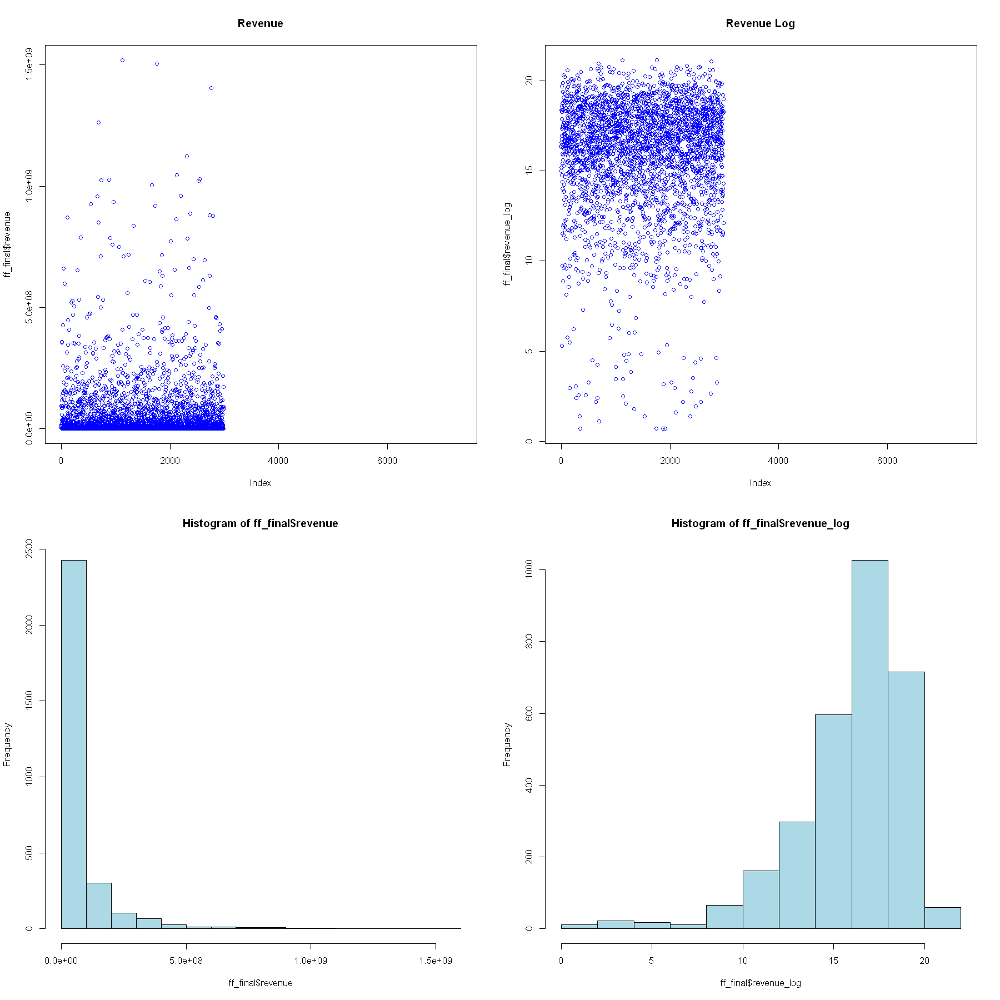

In [72]:
options(repr.plot.width =15, repr.plot.height = 15)
par(mfrow=c(2,2))
plot(ff_final$revenue, main = 'Revenue', col = 'blue')
plot(ff_final$revenue_log, main = 'Revenue Log', col = 'blue')
hist(ff_final$revenue, col = 'lightblue')
hist(ff_final$revenue_log, col = 'lightblue')

#### density charts of the outcome

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."
Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


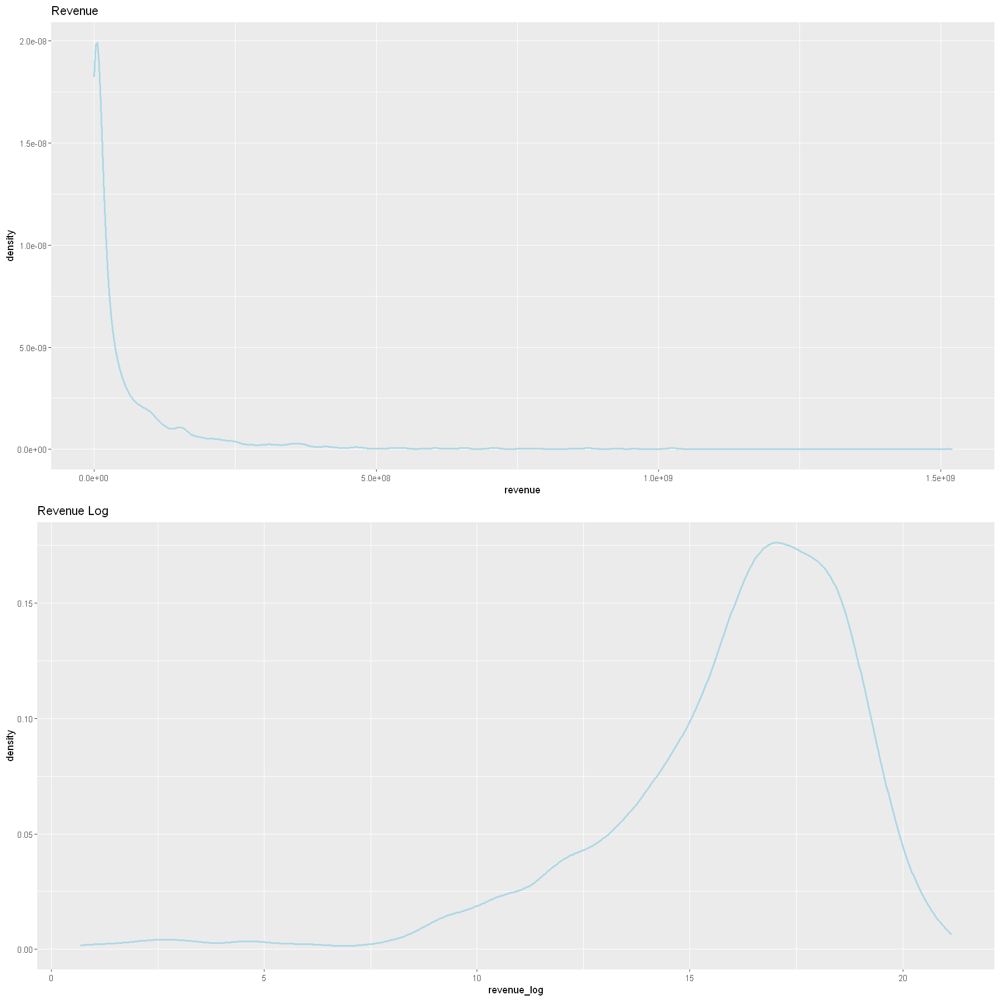

In [73]:
p1 <- ggplot(data = ff_final) +
            geom_density(aes(revenue), colour = 'light blue', size = 1) + ggtitle("Revenue")
p2 <- ggplot(data = ff_final) +
            geom_density(aes(revenue_log), colour = 'light blue', size = 1) + ggtitle("Revenue Log")

grid.arrange(p1, p2)    

#### graphs of the outcome against the categorical vars

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."
Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


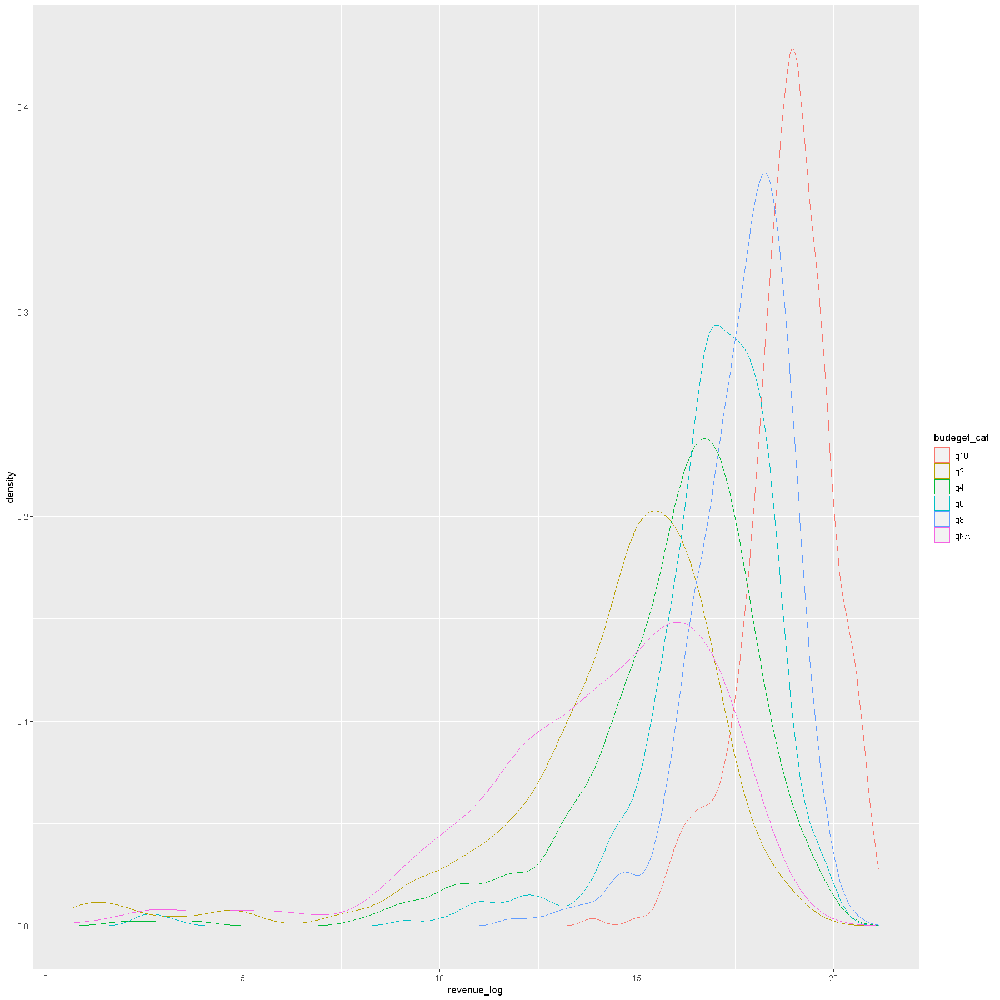

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning

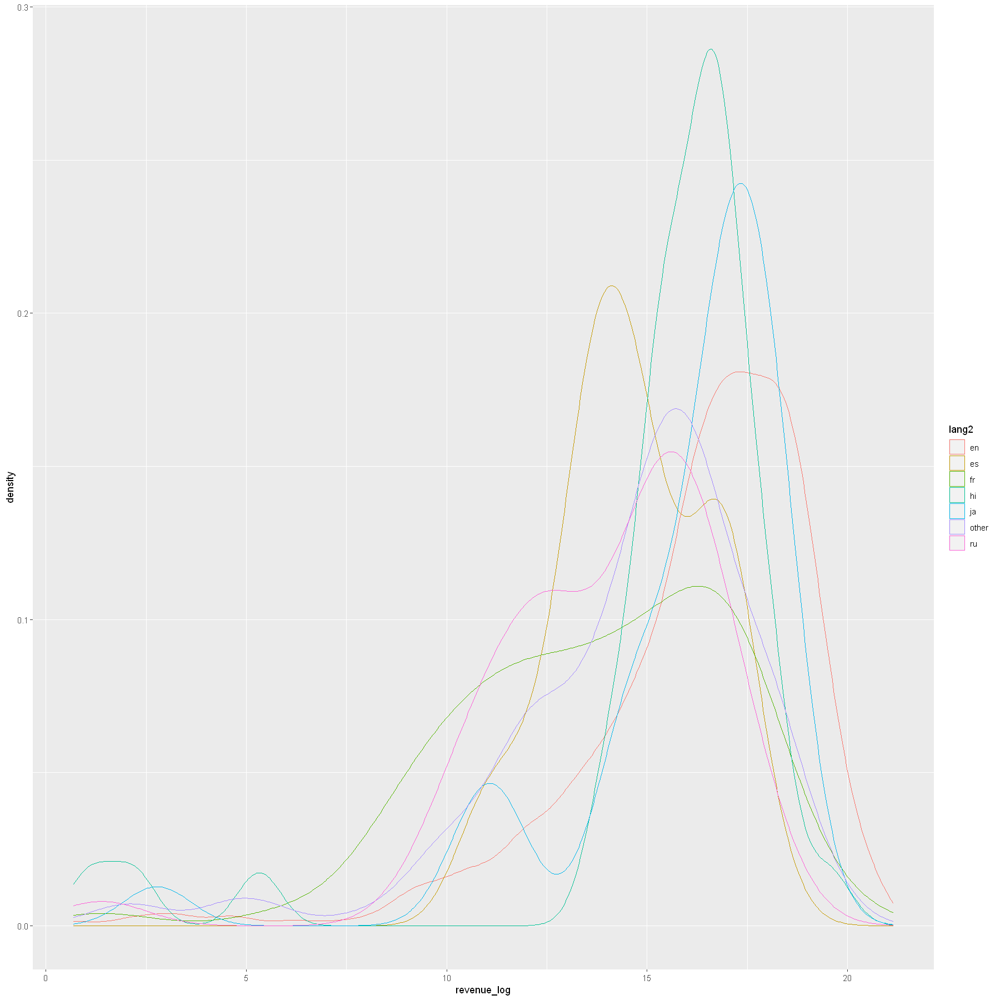

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


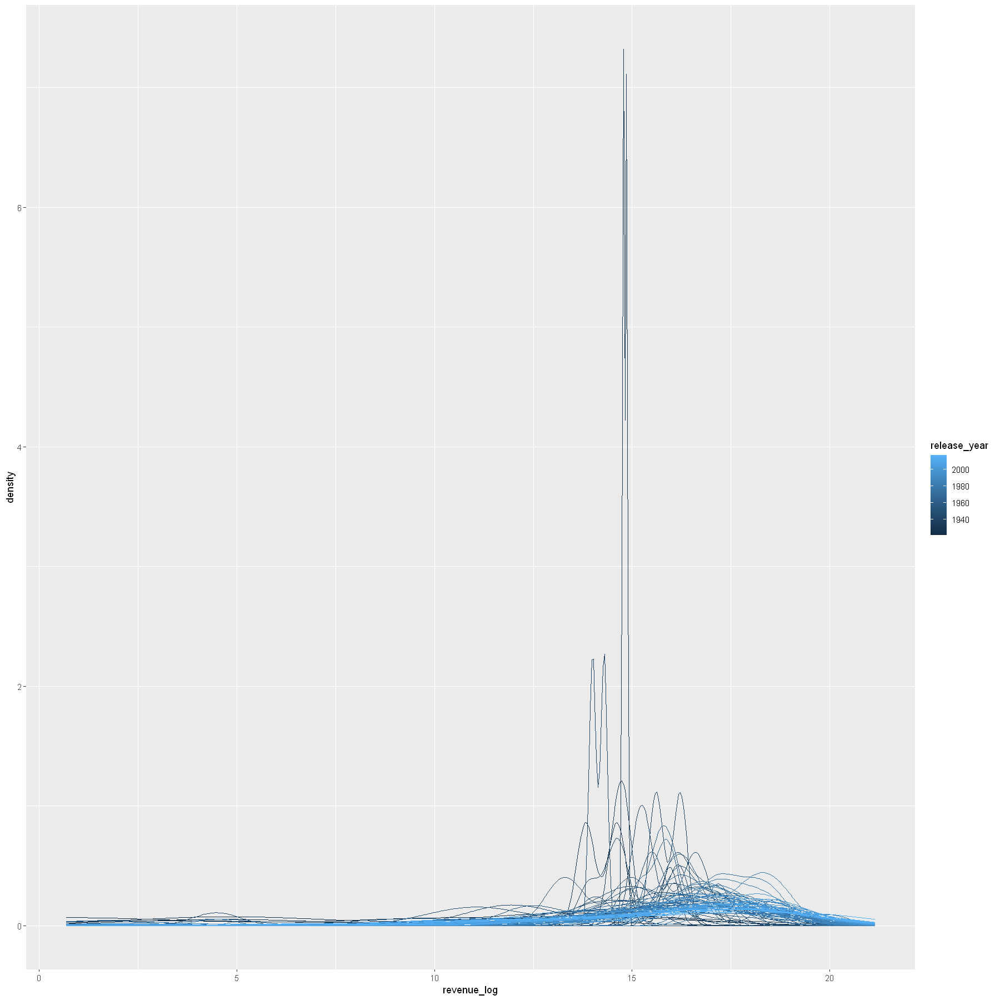

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


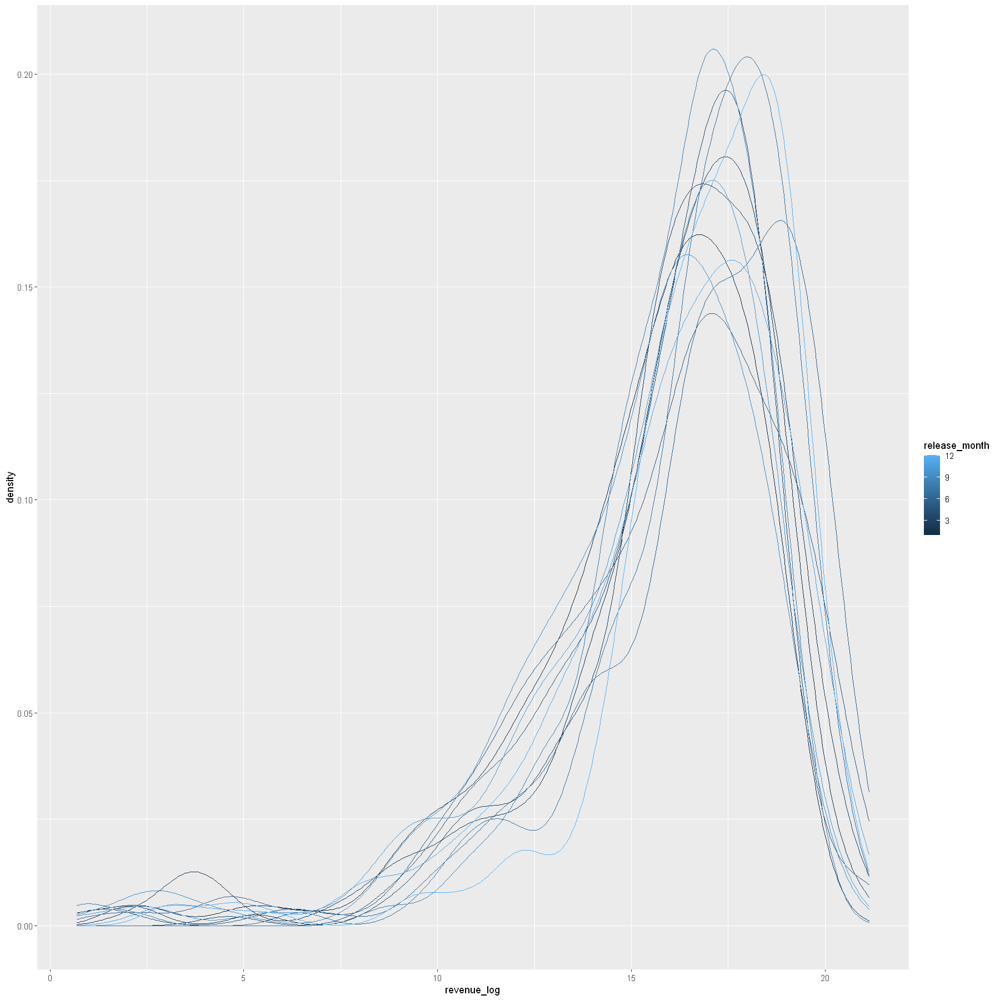

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


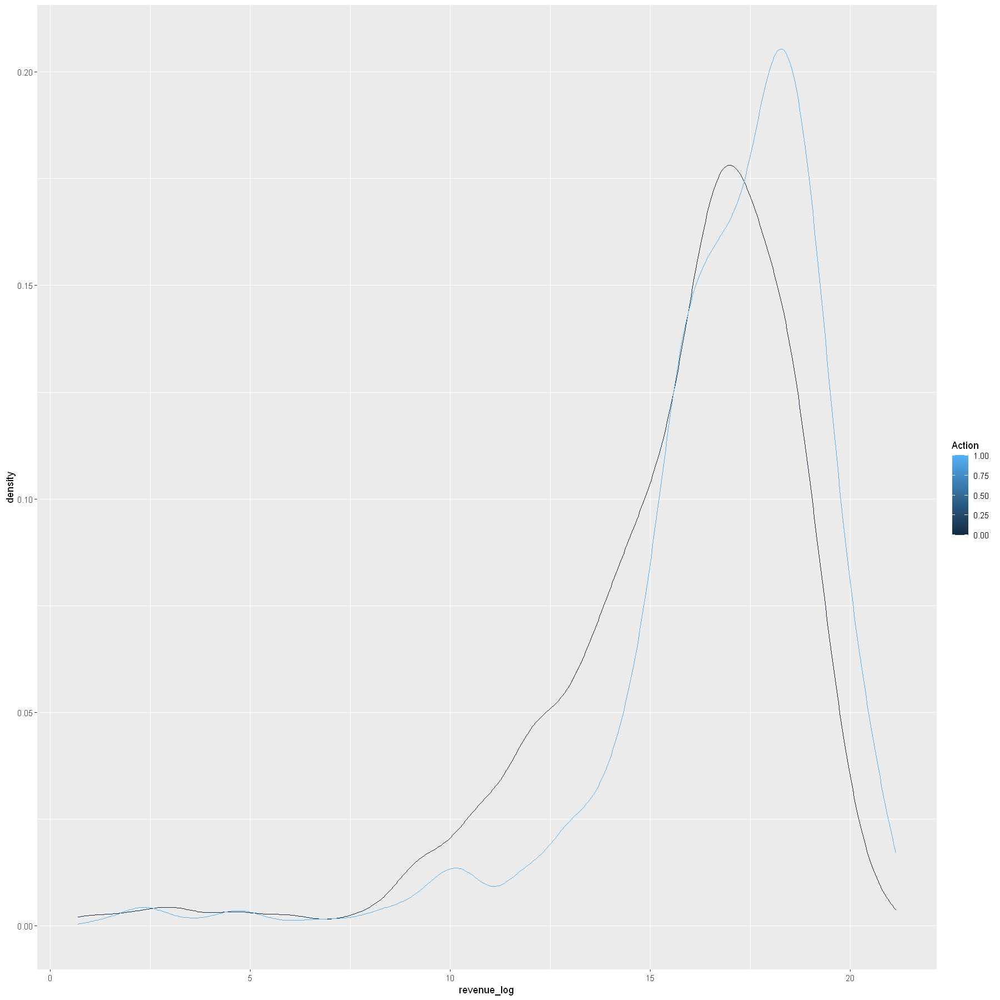

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


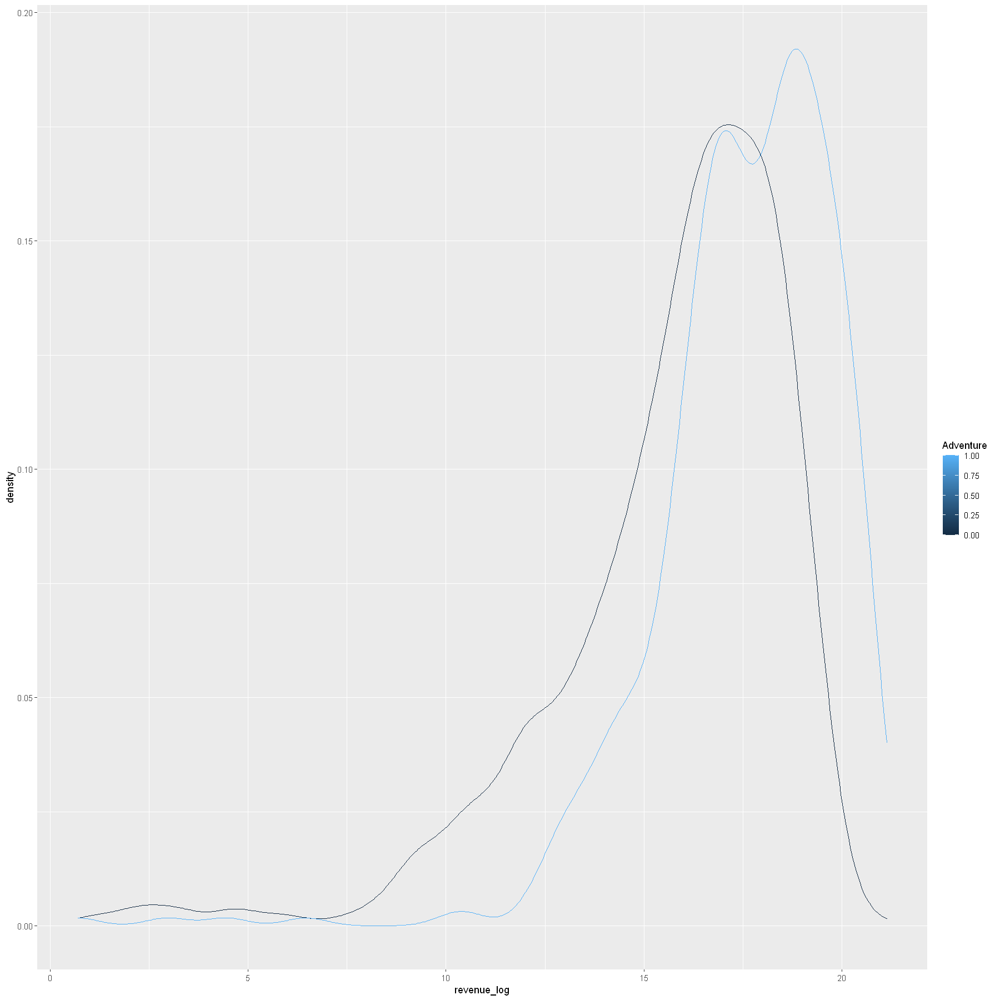

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


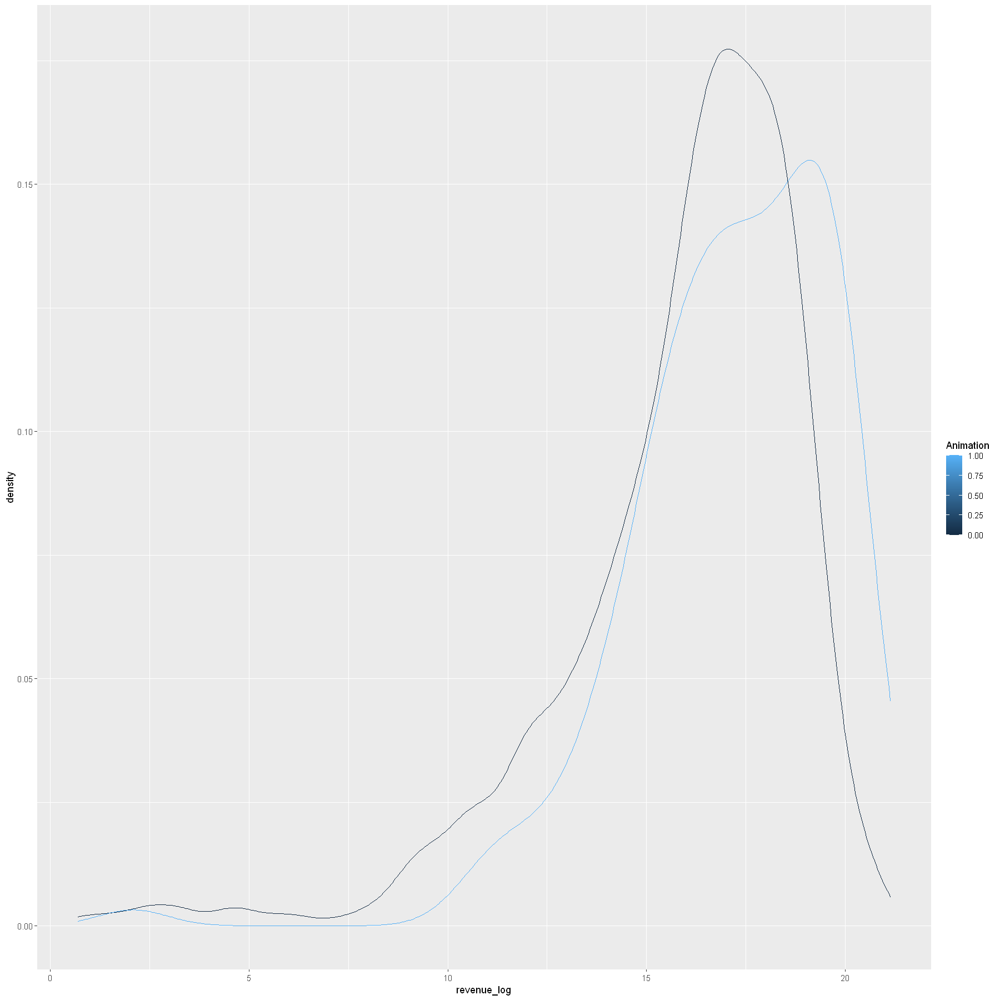

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


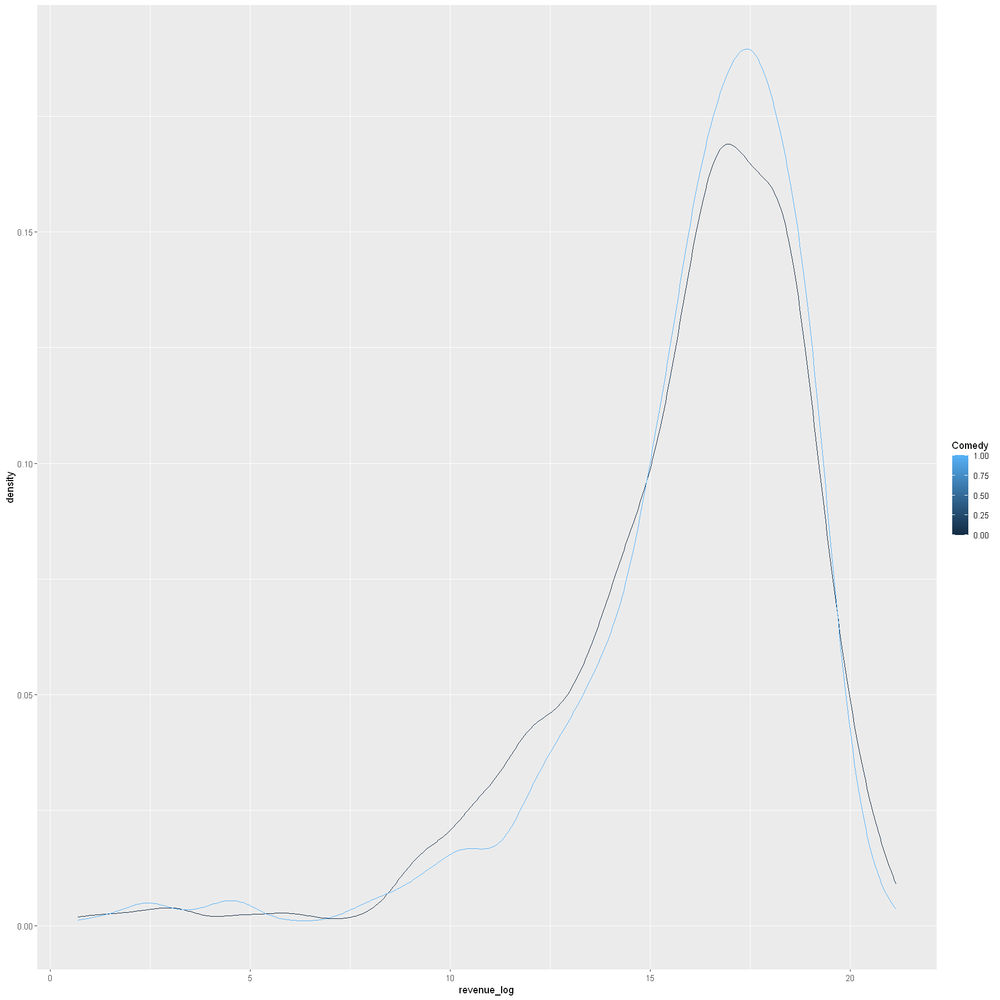

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


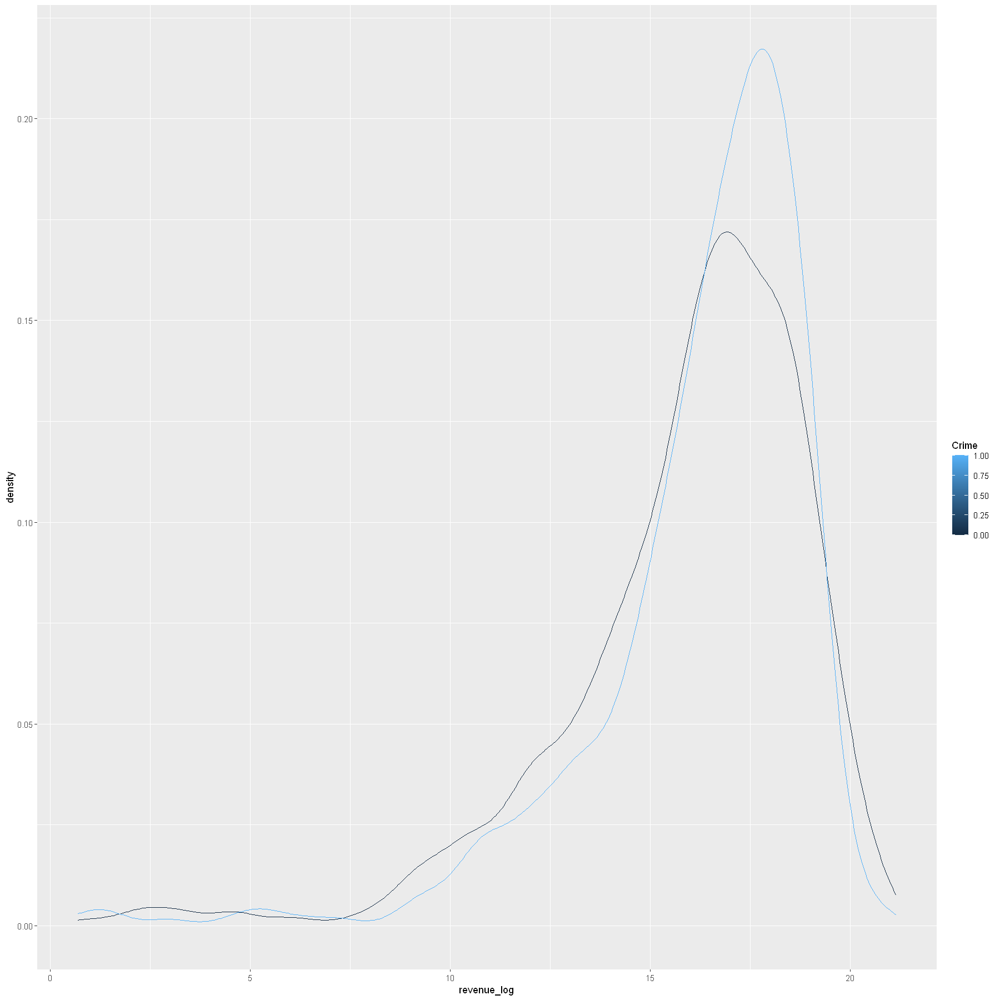

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


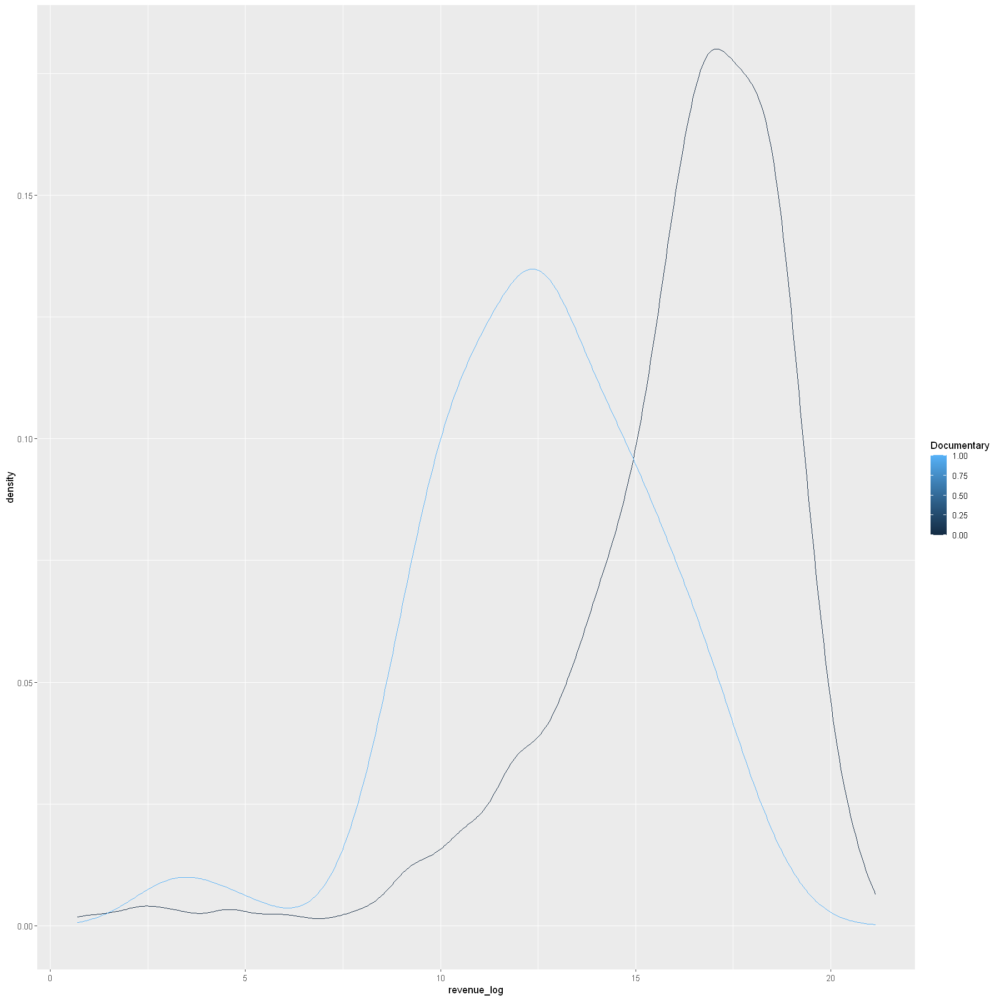

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


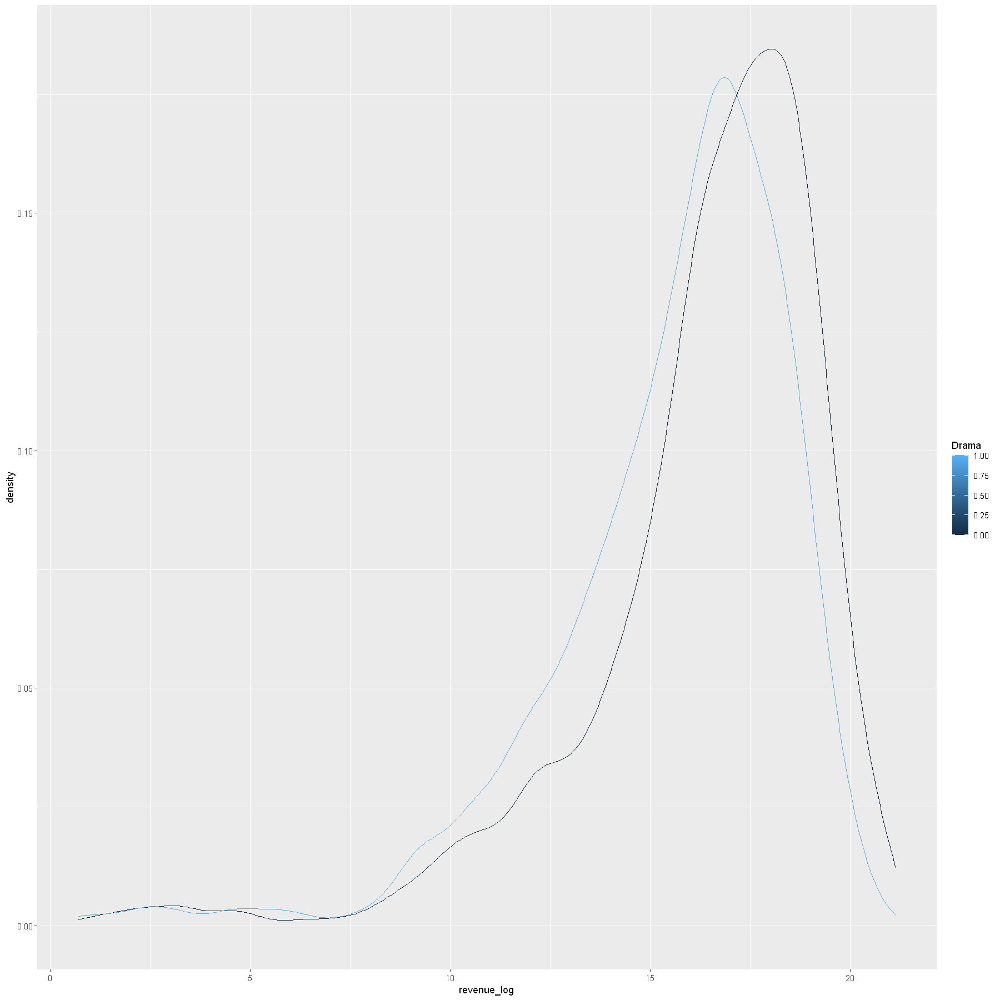

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


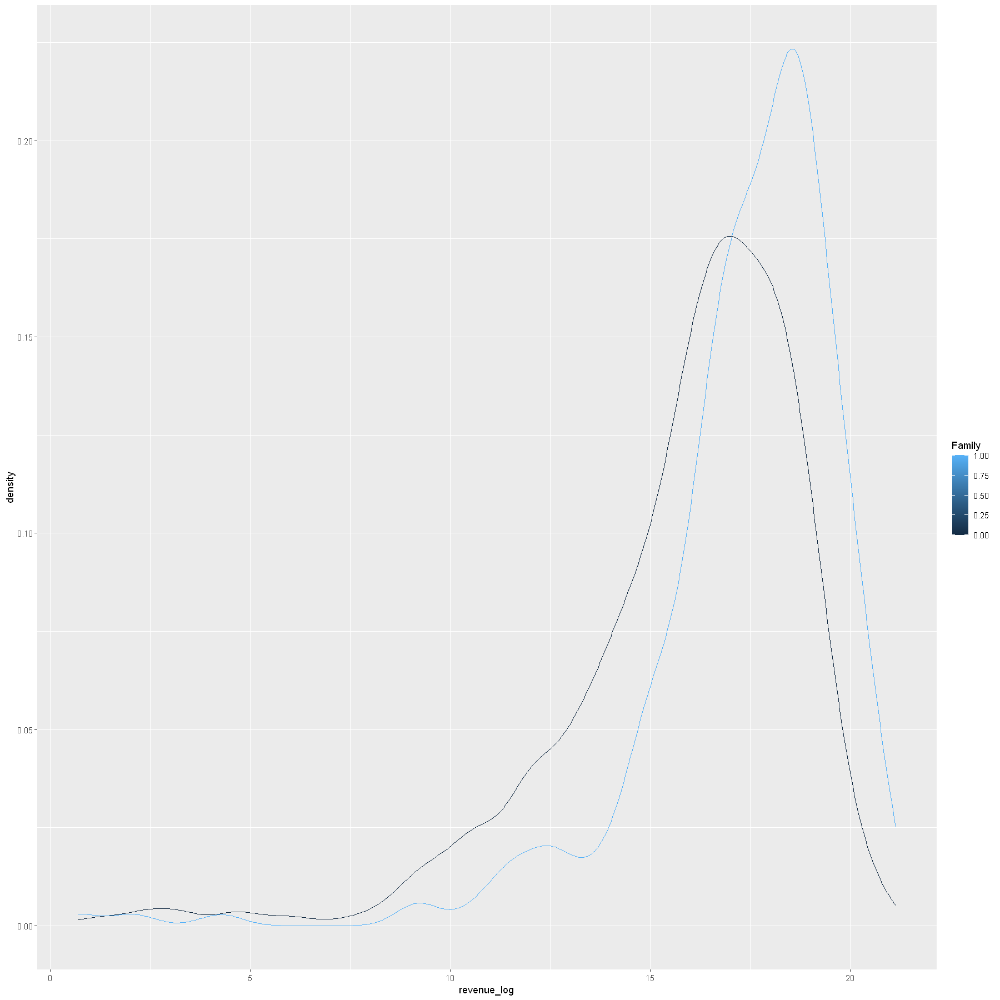

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


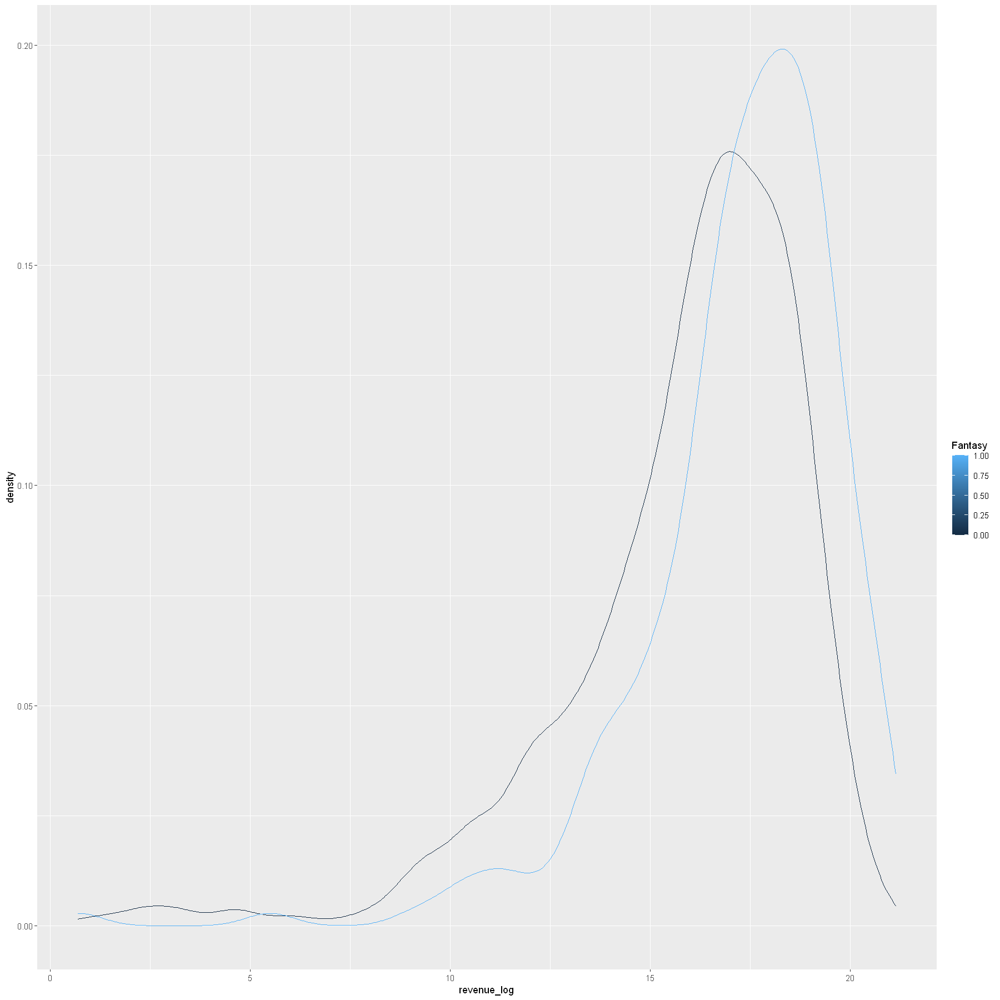

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


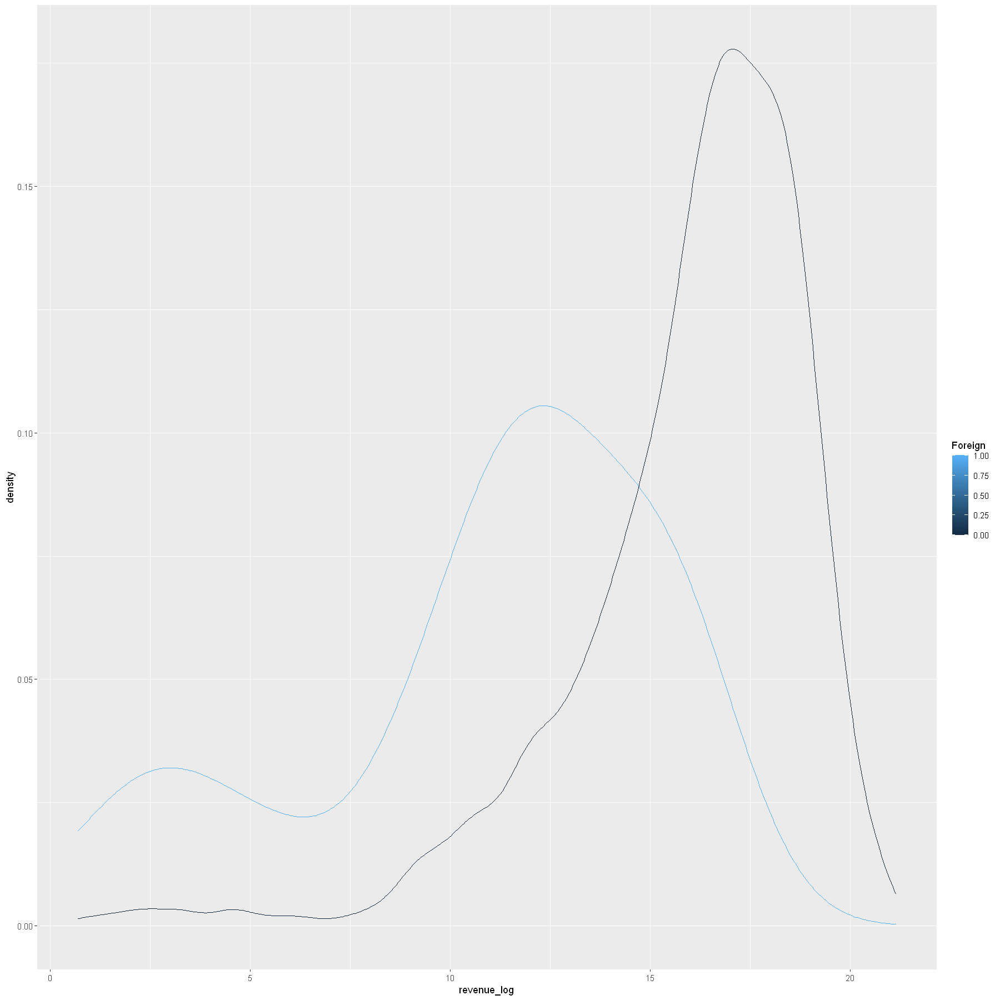

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


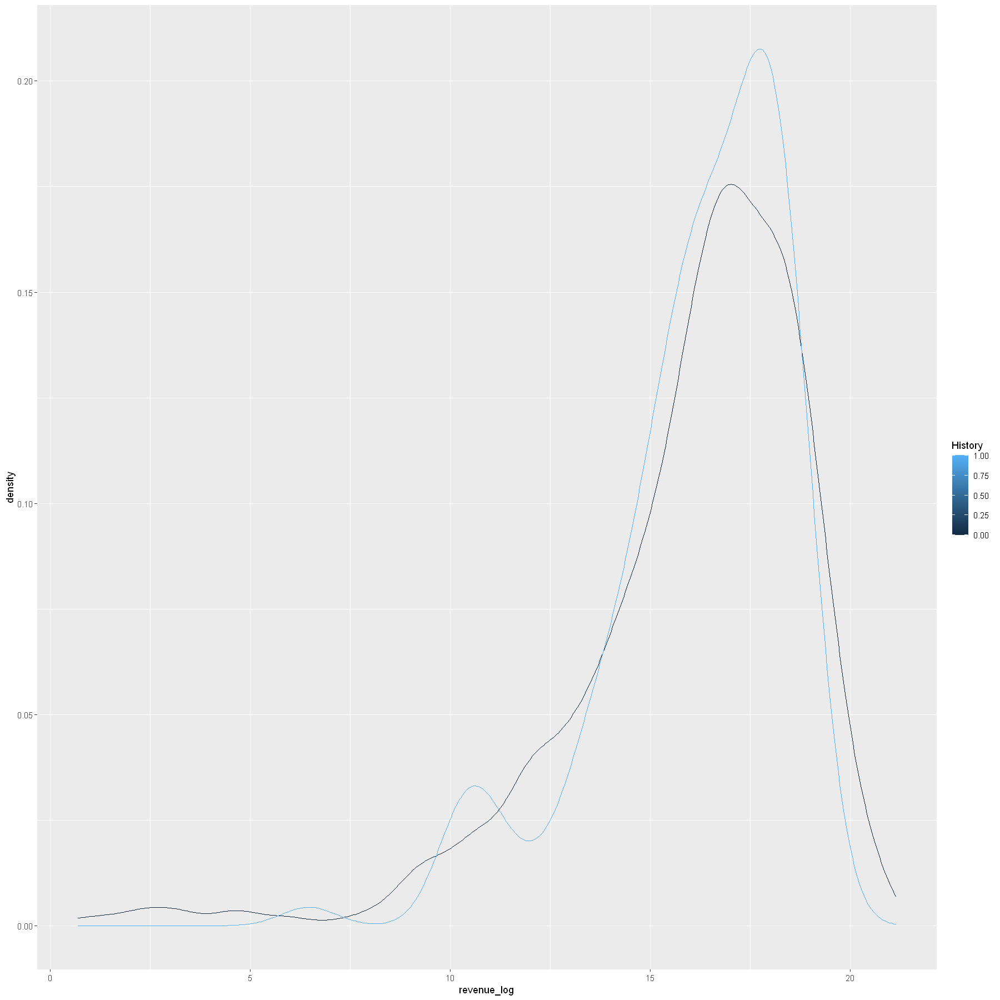

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


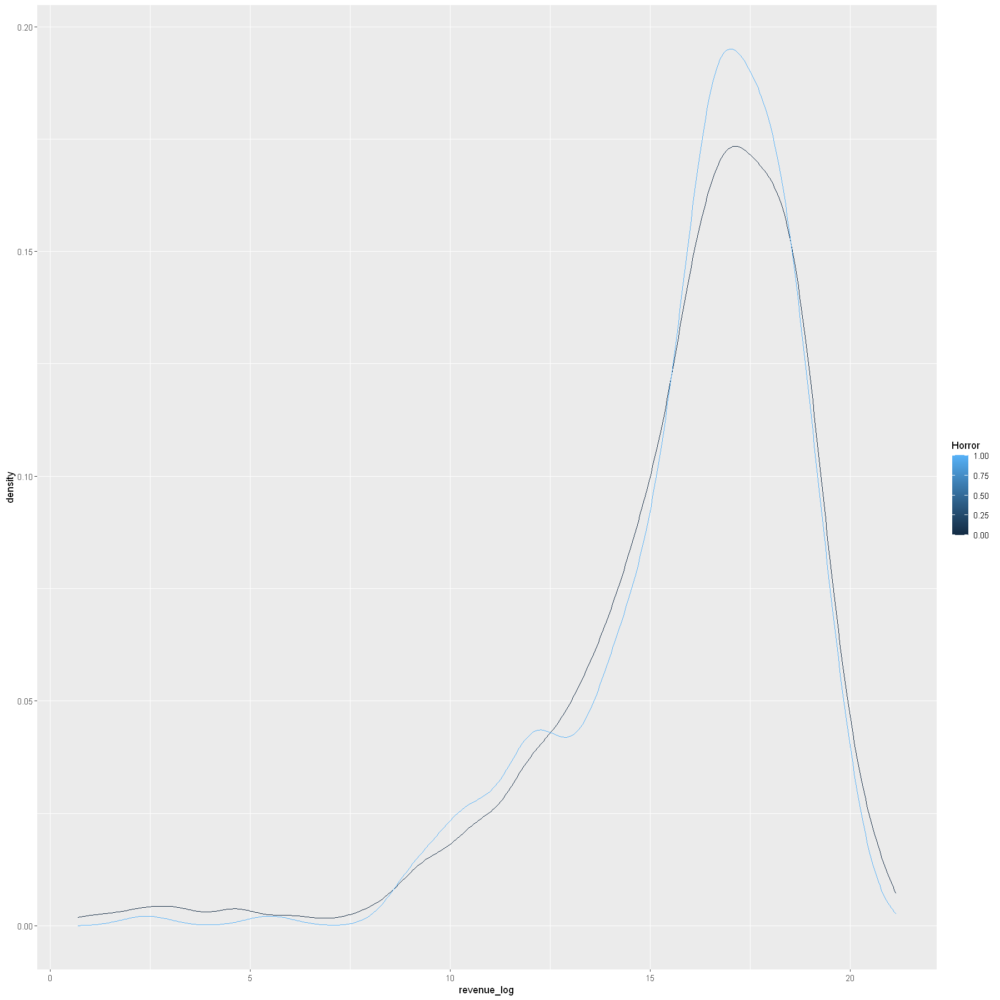

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


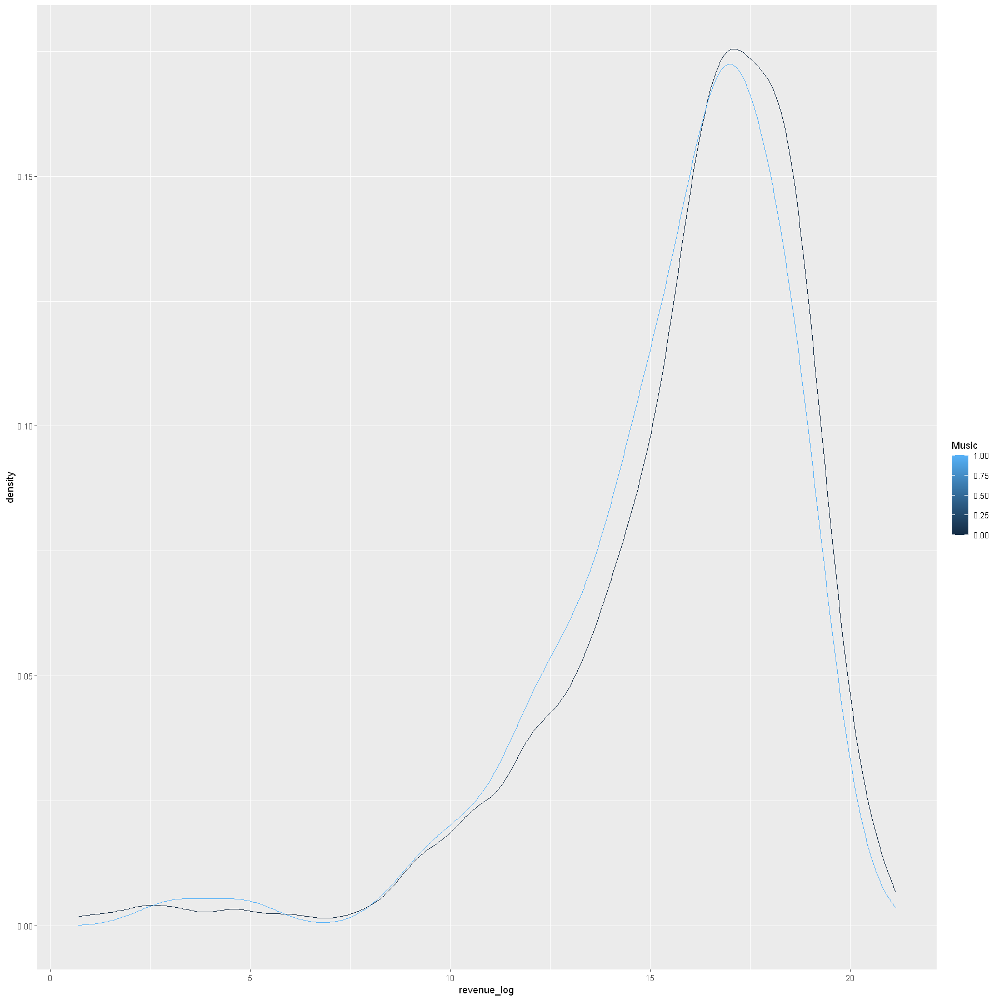

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


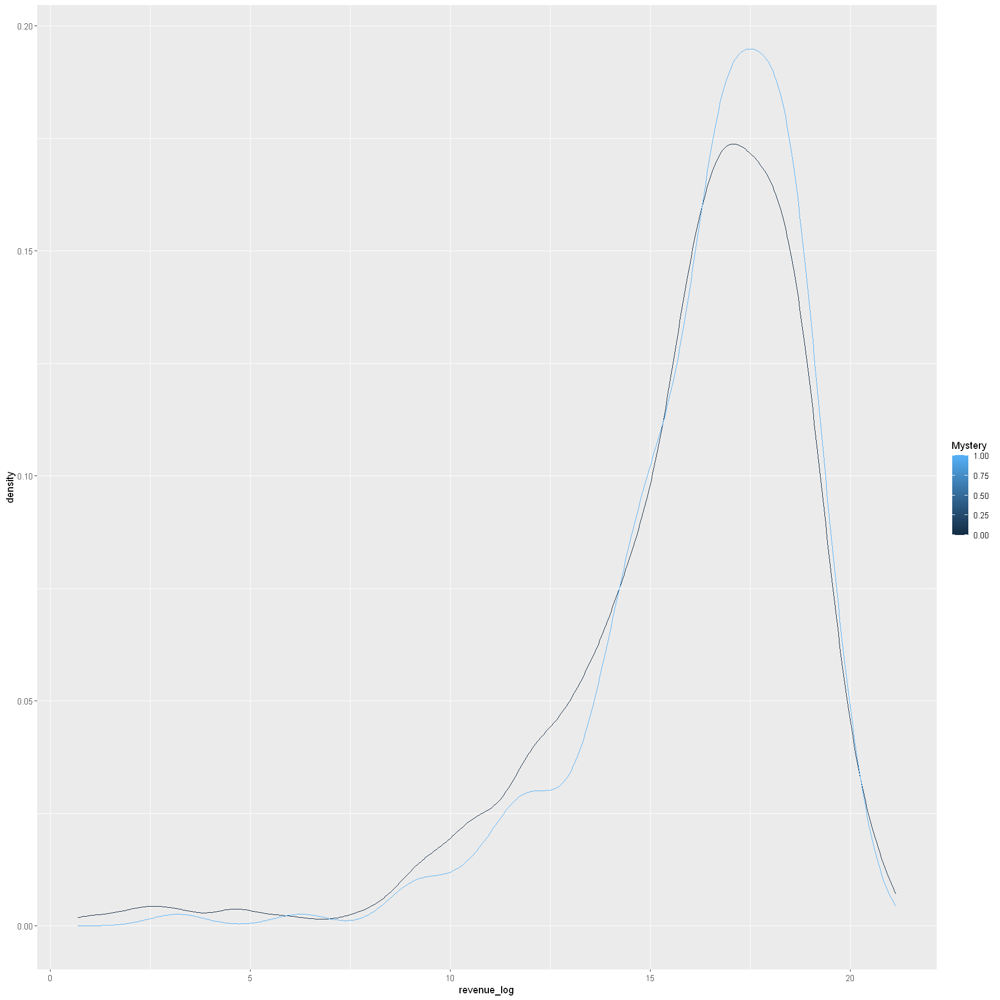

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


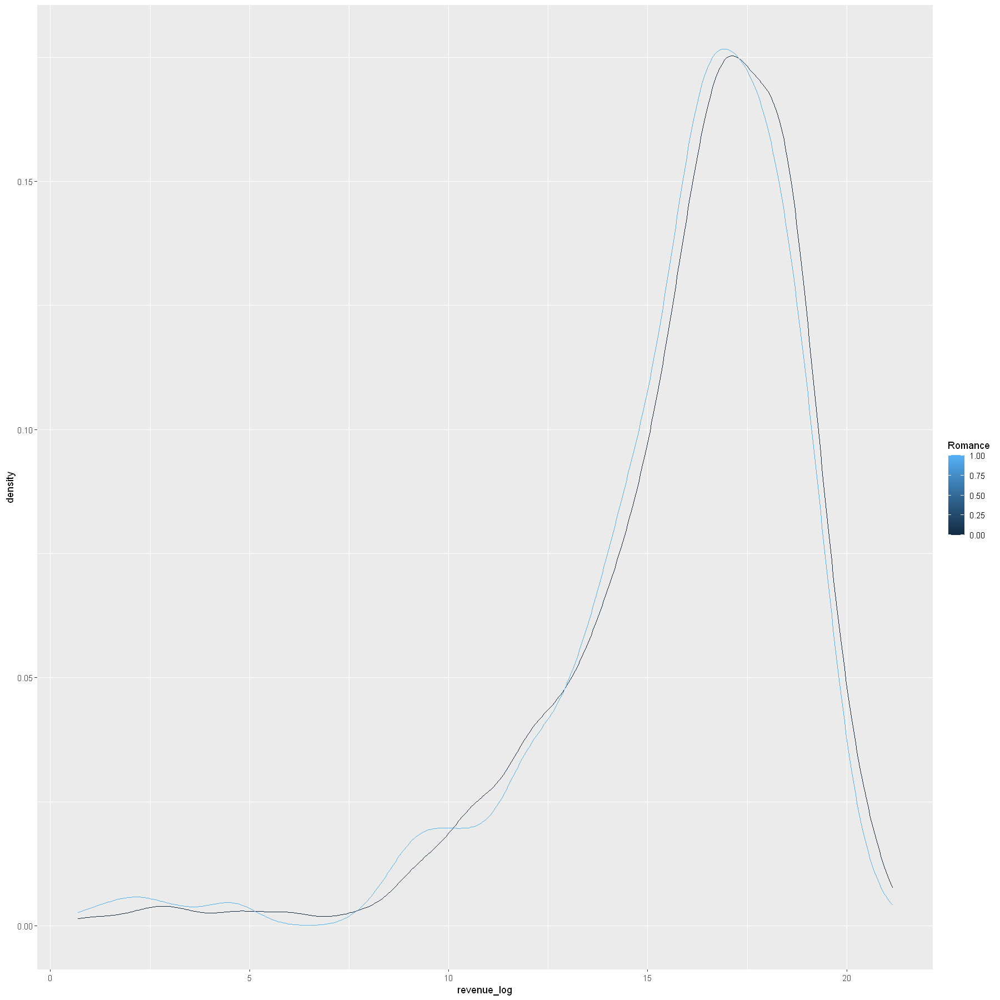

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


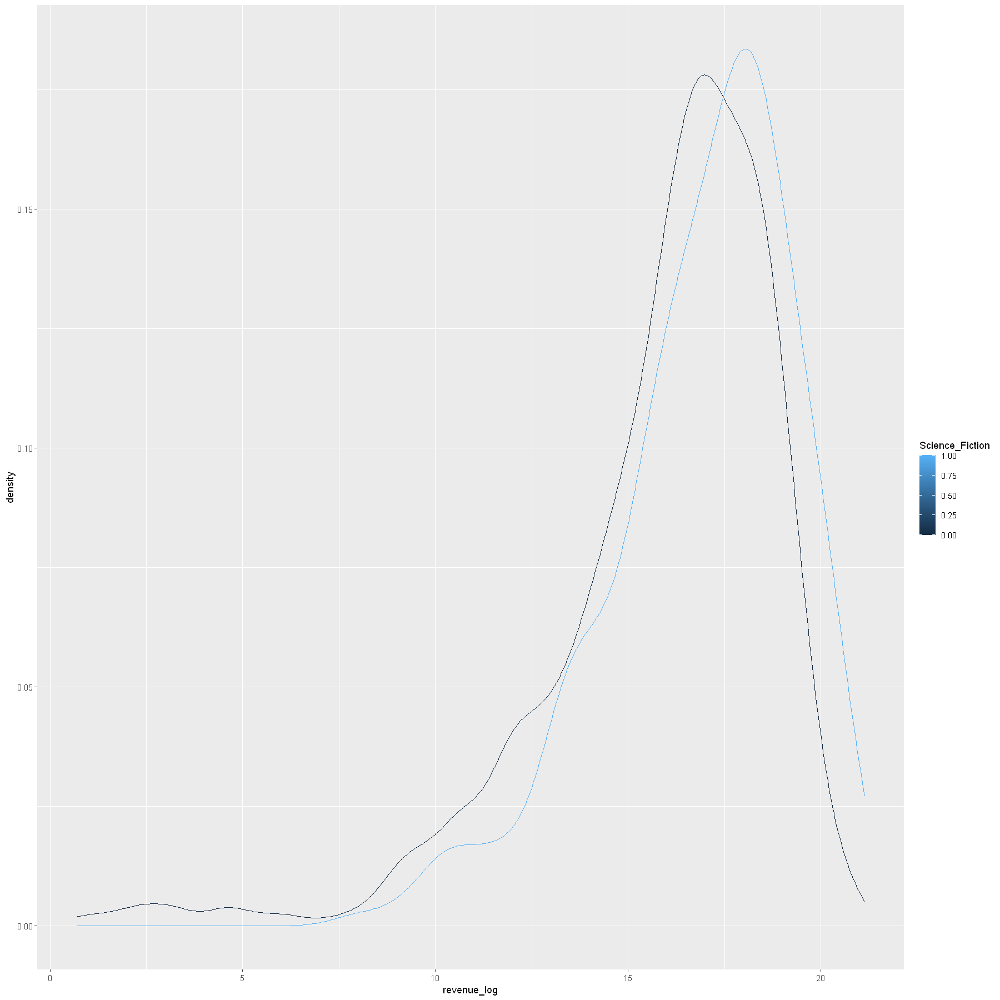

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


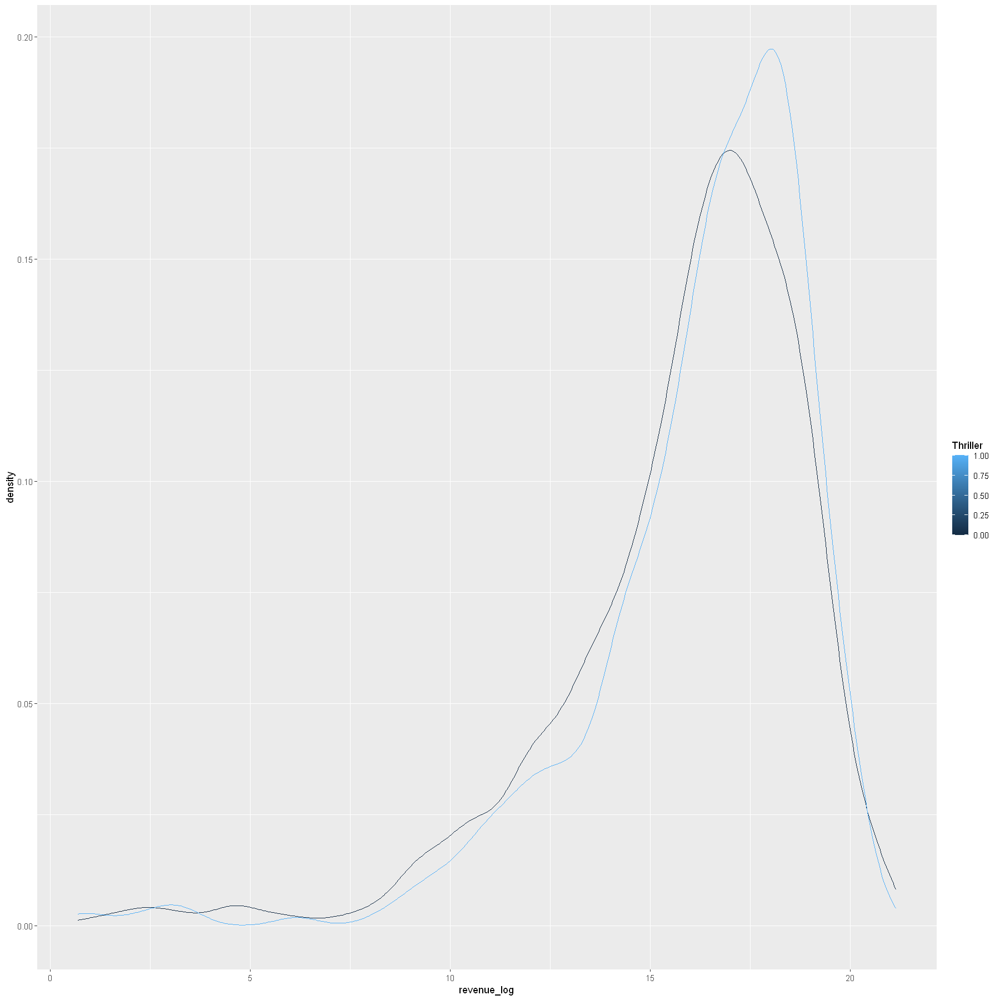

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


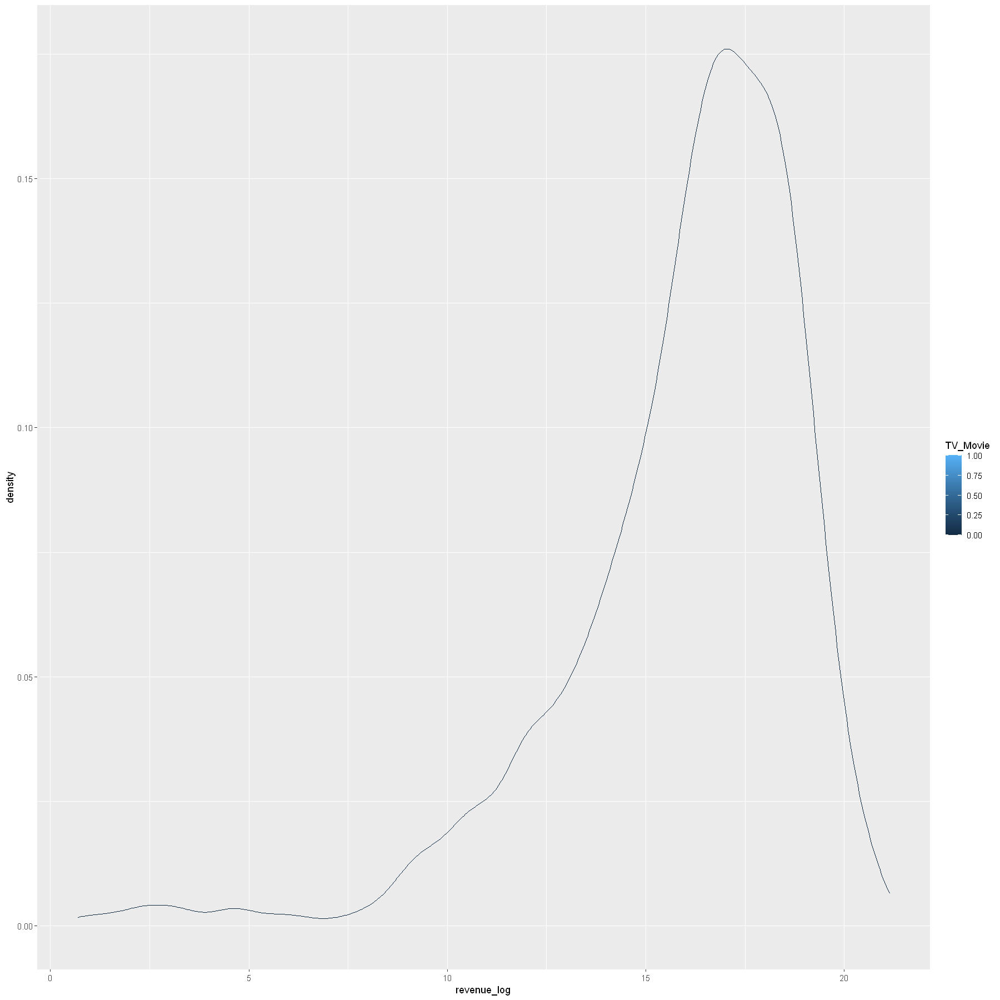

Warning message:
"Removed 4363 rows containing non-finite values (stat_density)."


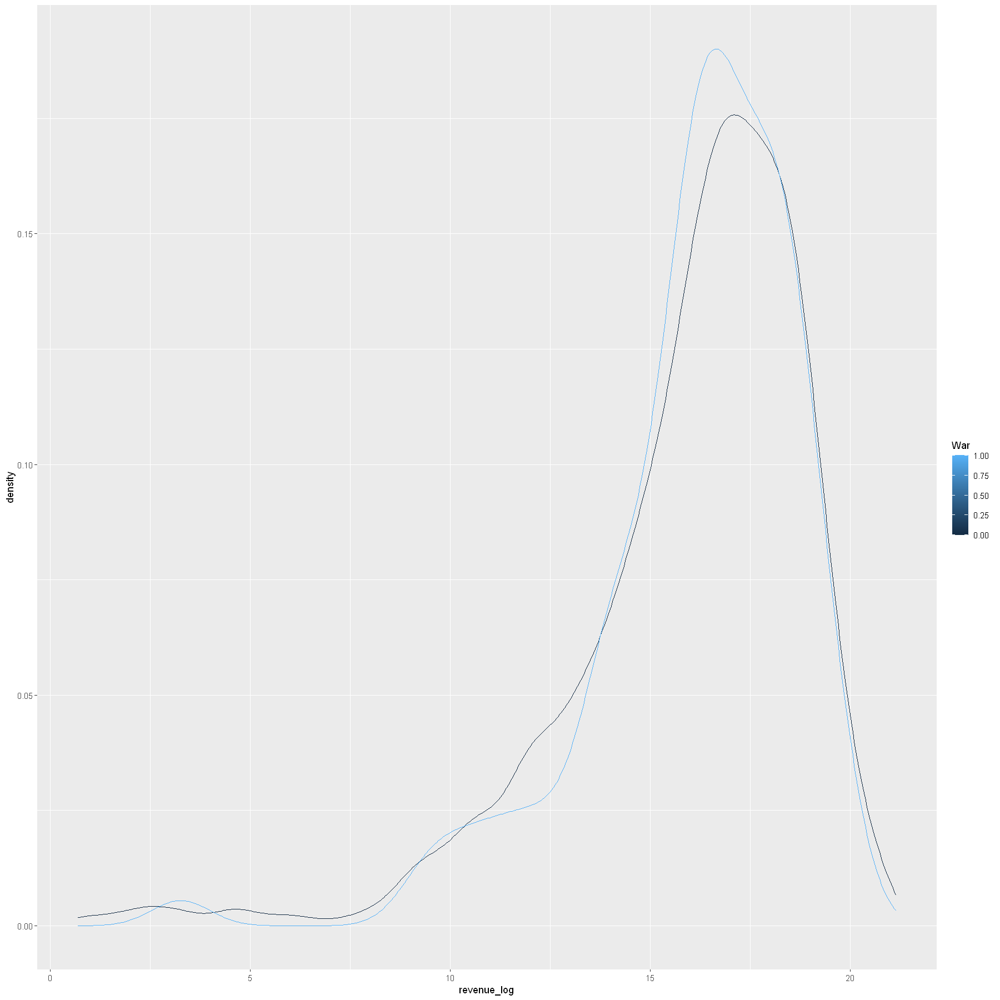

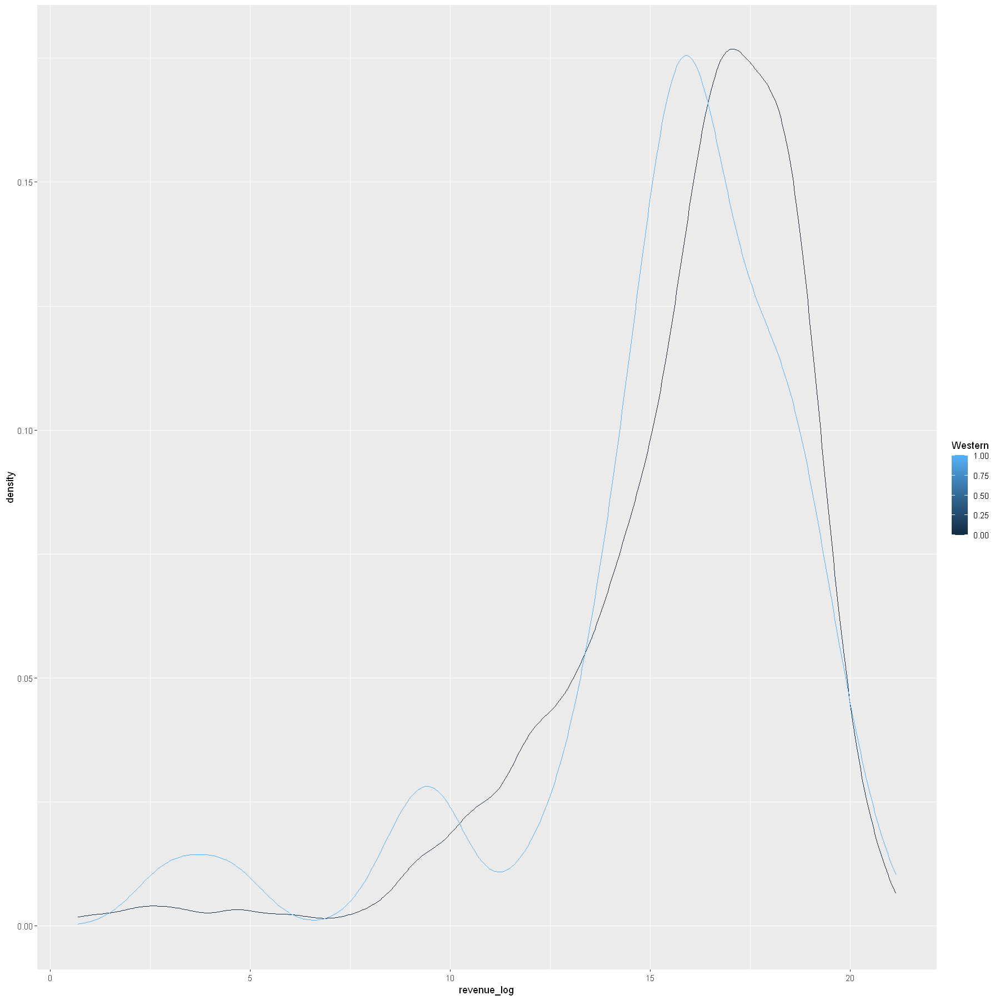

In [74]:
for (s in catlst){
        print(ggplot(data = ff_final) +
                geom_density(aes(revenue_log, group=.data[[s]], color=.data[[s]])))
}


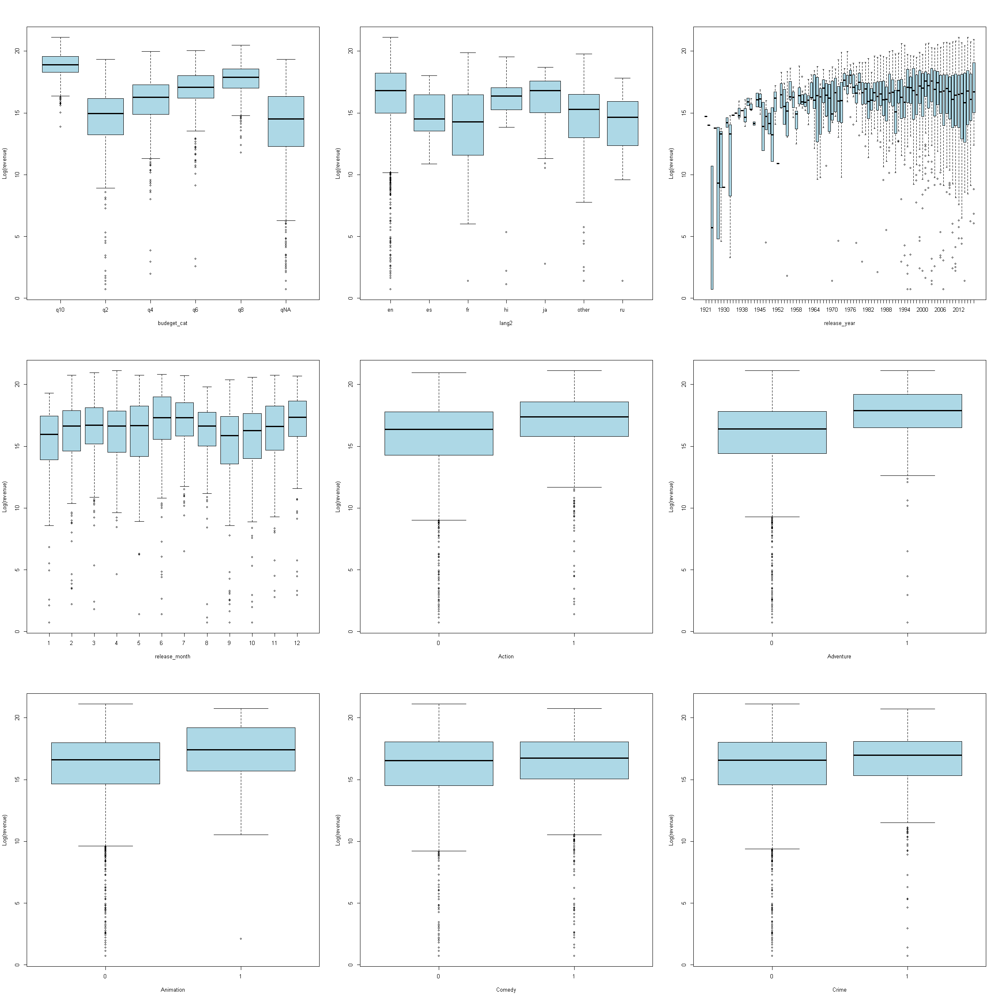

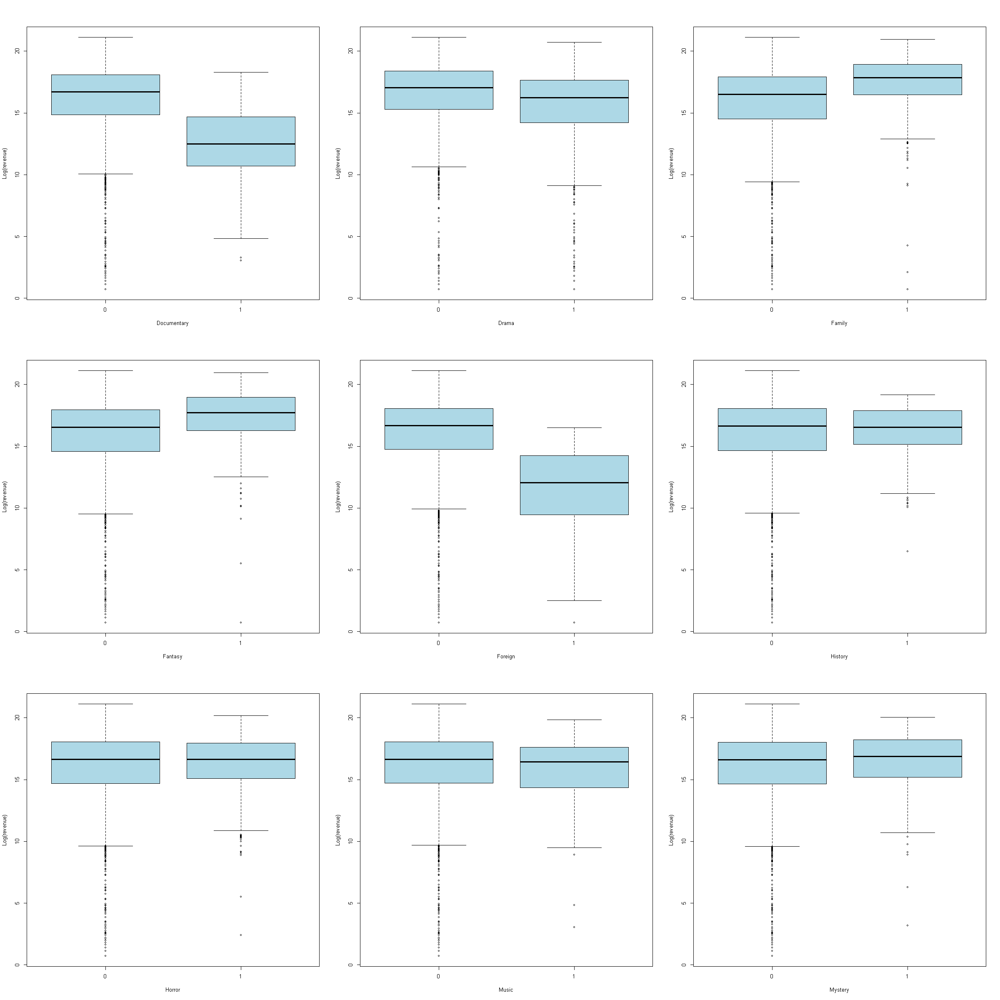

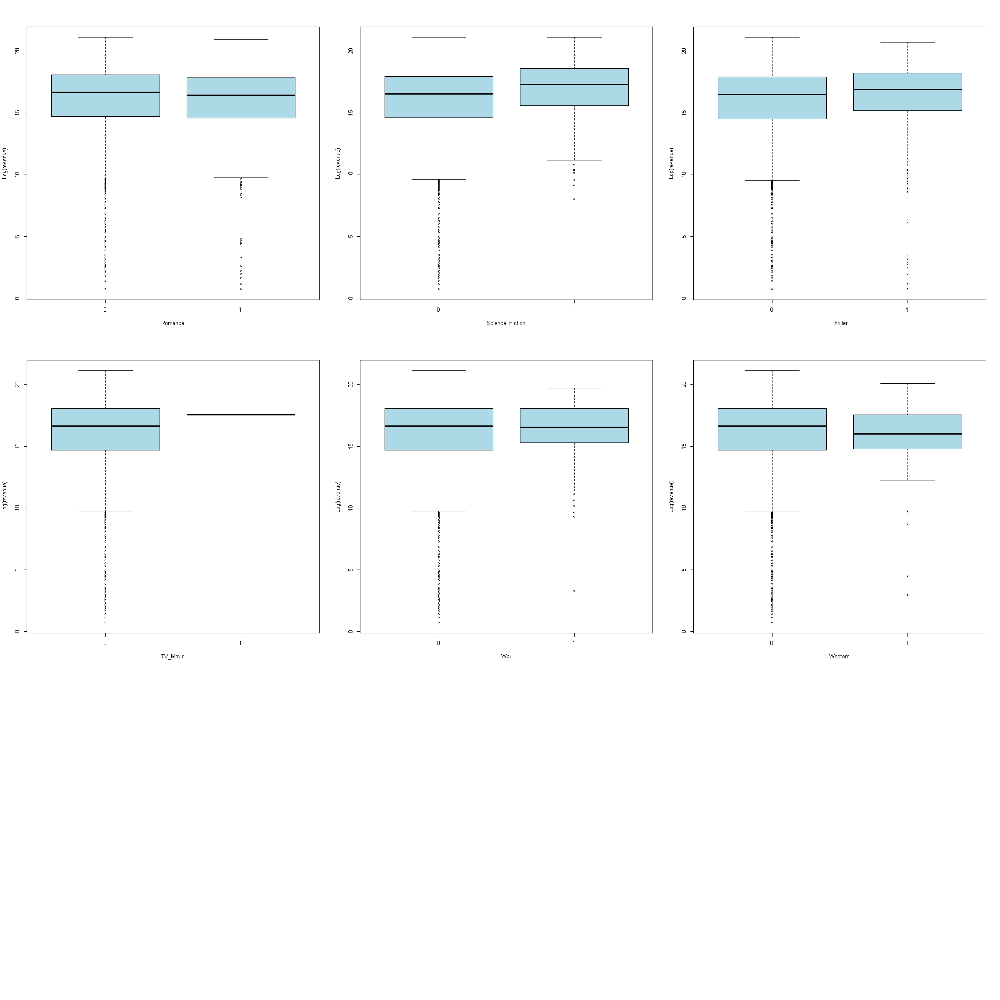

In [75]:
options(repr.plot.width =20, repr.plot.height = 20)
par(mfrow=c(3,3))
for (n in catlst){
    boxplot(ff_final$revenue_log ~ ff_final[[n]], xlab = n, ylab = 'Log(revenue)', col = 'light blue')
}


##### Calculate wilcoxon test to define if the distributions differ 

In [76]:
for (s in binlst){
        print(s)
        print(wilcox.test(ff_final$revenue_log ~ ff_final[[s]], var.equal = T,paired = F))
   }
   

[1] "Action"

	Wilcoxon rank sum test with continuity correction

data:  ff_final$revenue_log by ff_final[[s]]
W = 613699, p-value < 2.2e-16
alternative hypothesis: true location shift is not equal to 0

[1] "Adventure"

	Wilcoxon rank sum test with continuity correction

data:  ff_final$revenue_log by ff_final[[s]]
W = 329255, p-value < 2.2e-16
alternative hypothesis: true location shift is not equal to 0

[1] "Animation"

	Wilcoxon rank sum test with continuity correction

data:  ff_final$revenue_log by ff_final[[s]]
W = 149879, p-value = 4.024e-07
alternative hypothesis: true location shift is not equal to 0

[1] "Comedy"

	Wilcoxon rank sum test with continuity correction

data:  ff_final$revenue_log by ff_final[[s]]
W = 962477, p-value = 0.05744
alternative hypothesis: true location shift is not equal to 0

[1] "Crime"

	Wilcoxon rank sum test with continuity correction

data:  ff_final$revenue_log by ff_final[[s]]
W = 541965, p-value = 0.00852
alternative hypothesis: true locatio

The vars that make difference in the revenue are: Action, Adventure, Animation, Crime, Documentary, Drama, 
Family, Fantasy, Foreign, Science_Fiction, Thriller 

### 5 - outliers

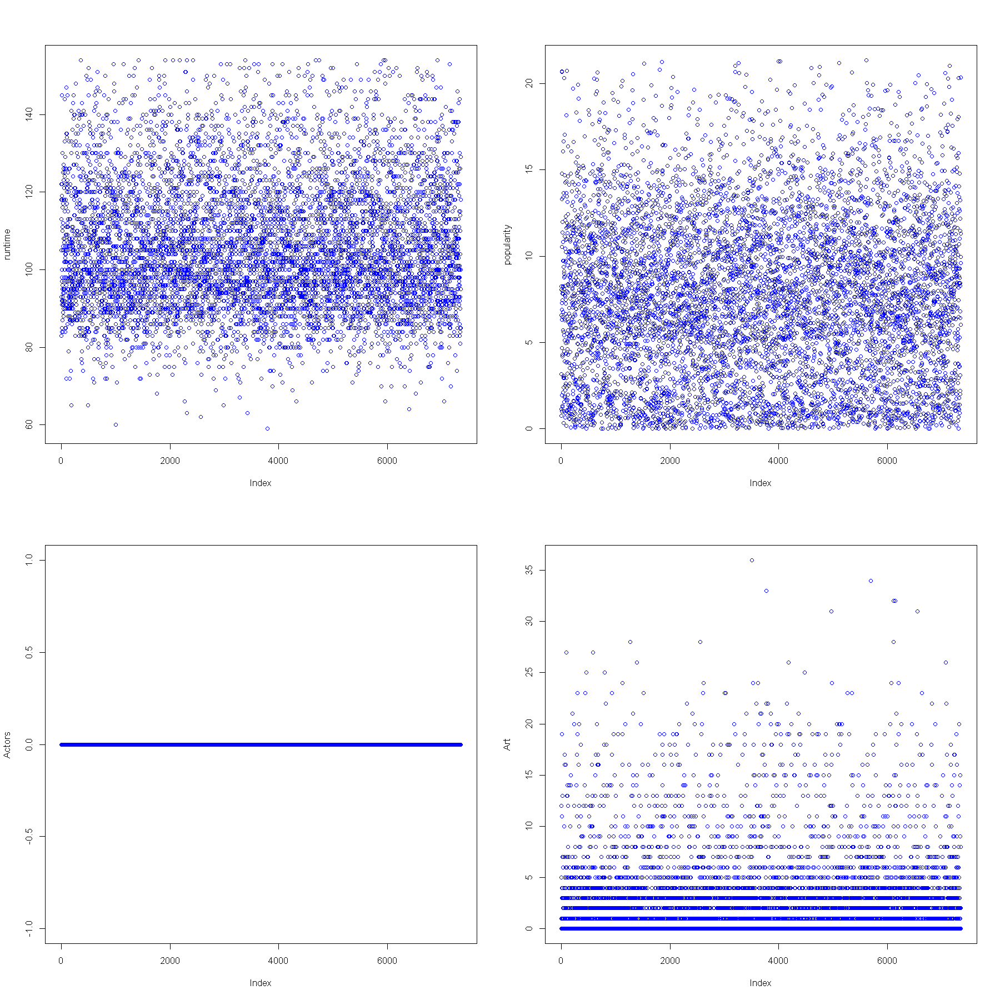

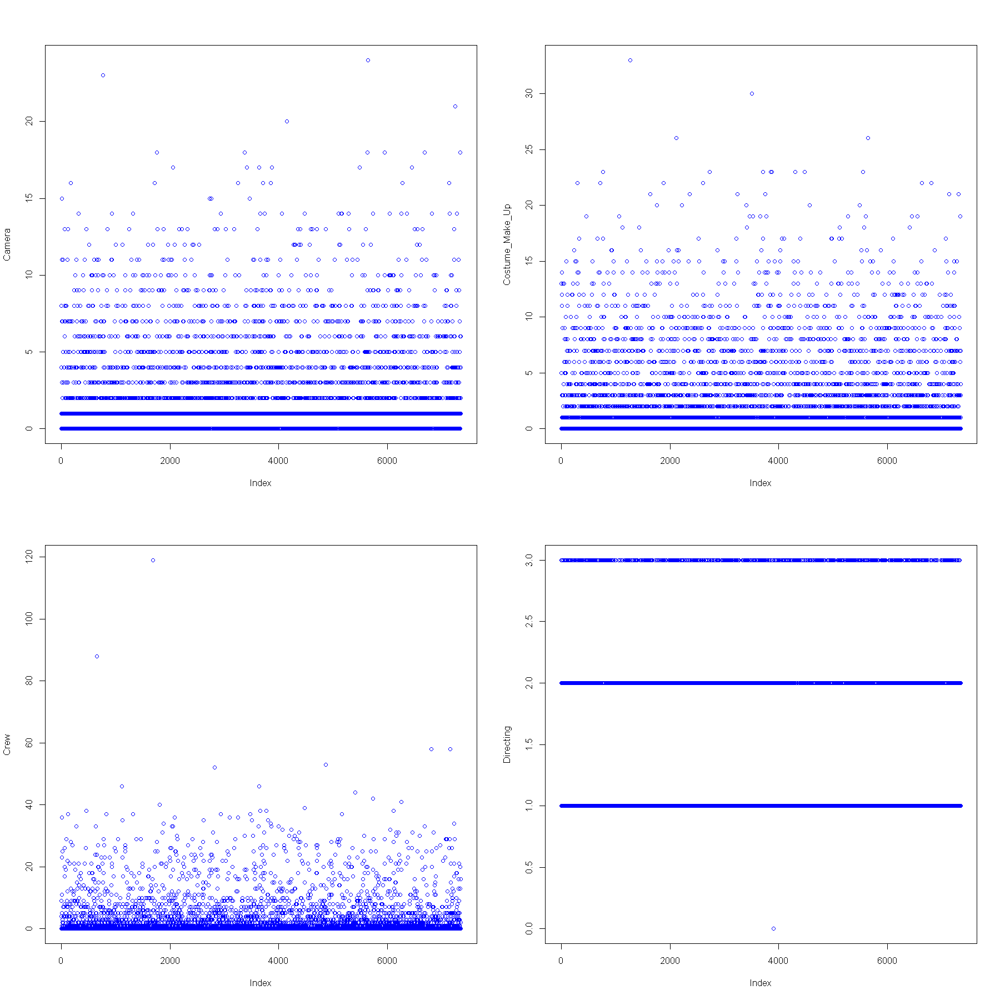

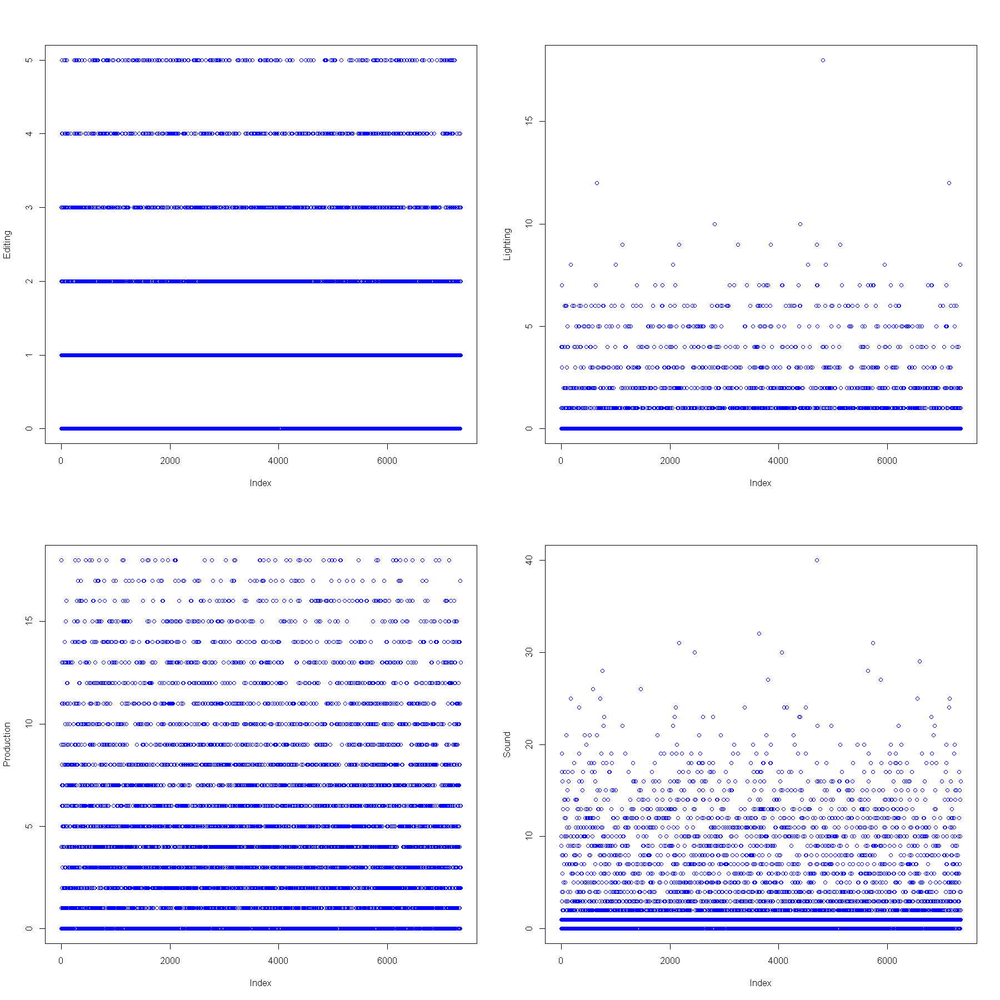

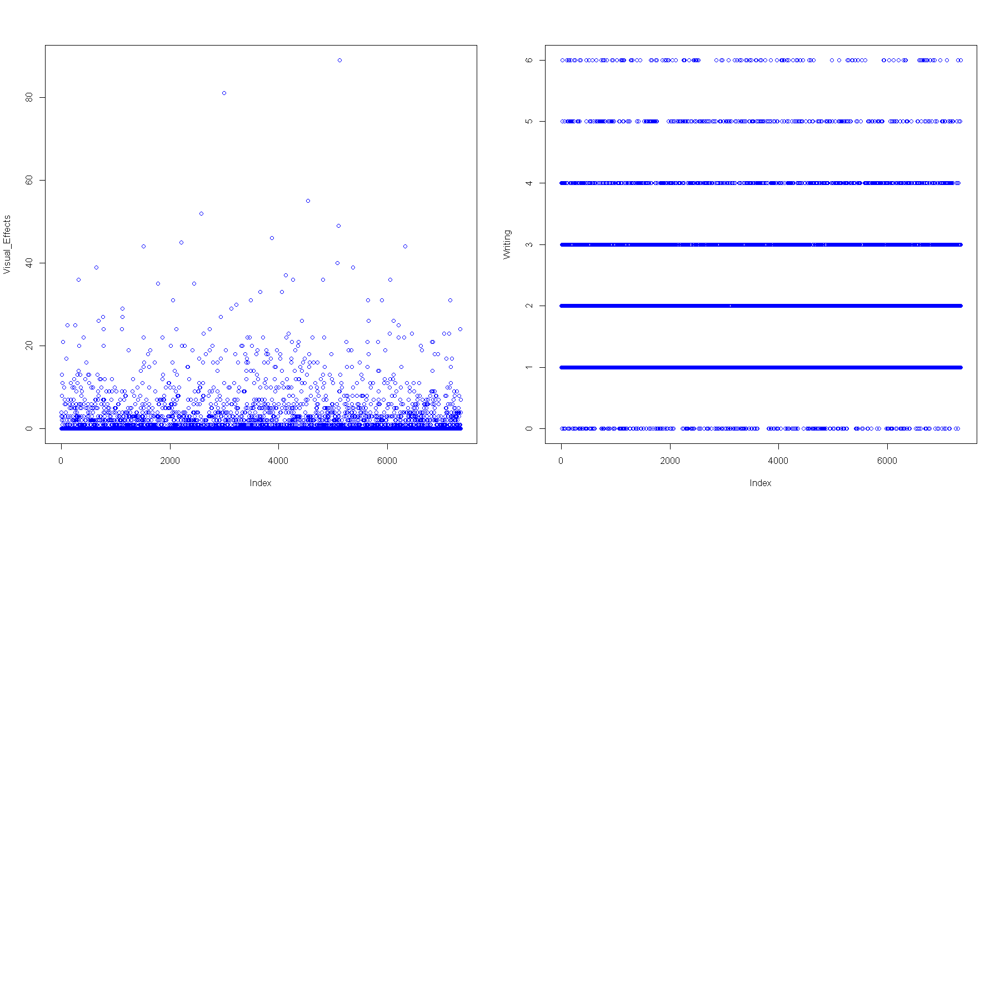

In [77]:
options(repr.plot.width =15, repr.plot.height = 15)
par(mfrow=c(2,2))
for (n in numlst){
    plot(ff_final[[n]], ylab = n, col = 'blue')
}

Still have outliers but much less then in the begining of the of the prosess

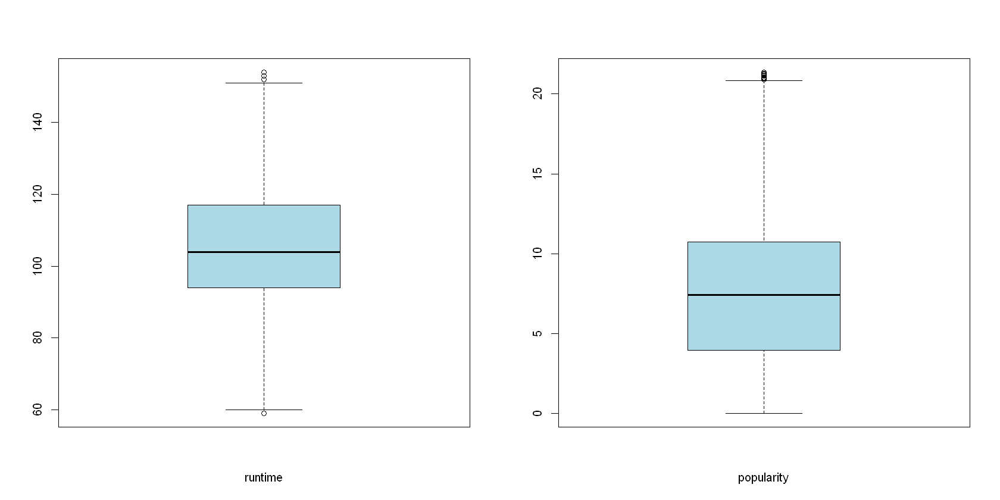

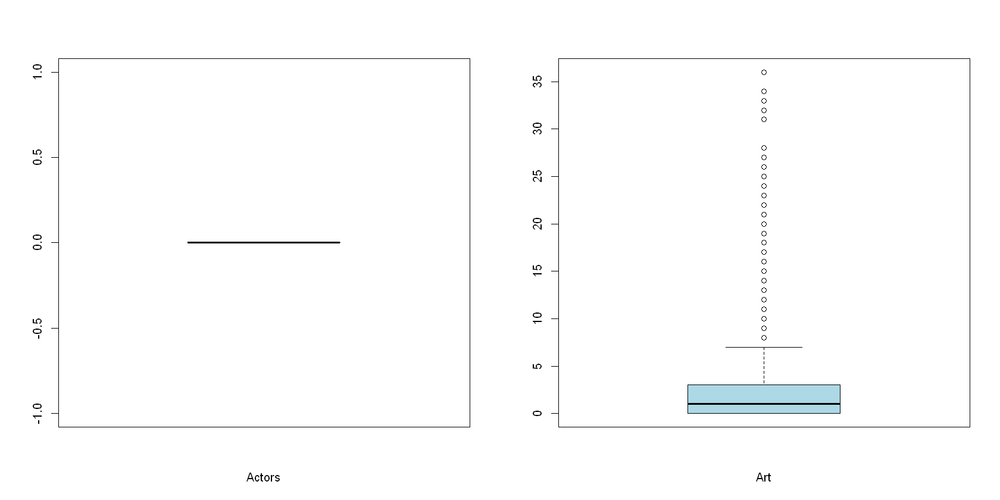

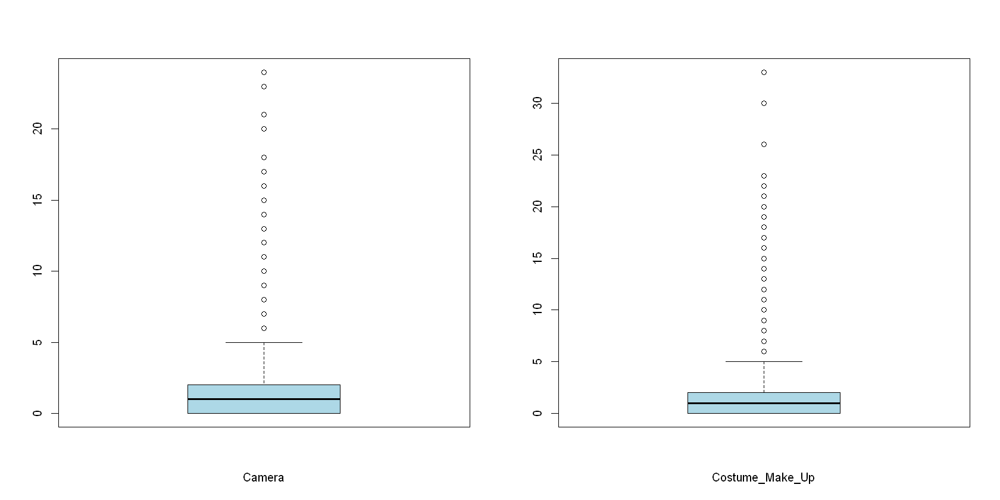

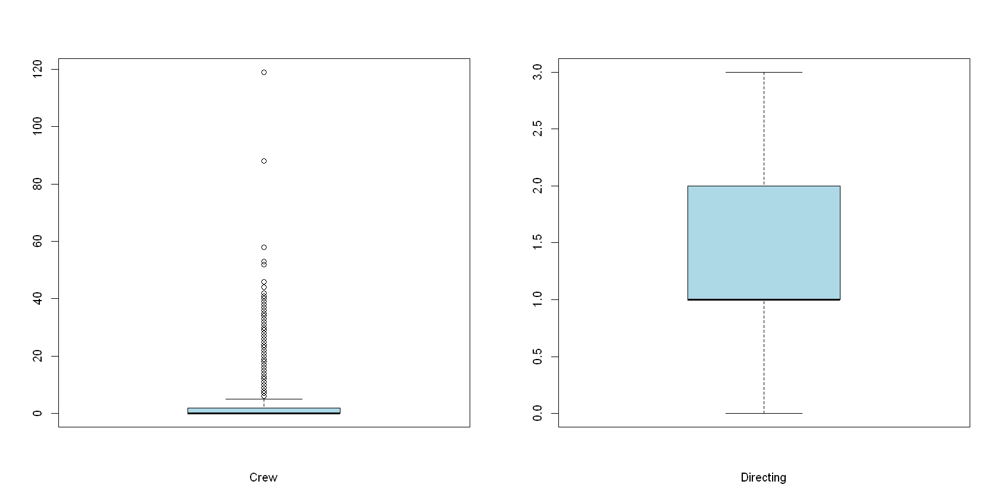

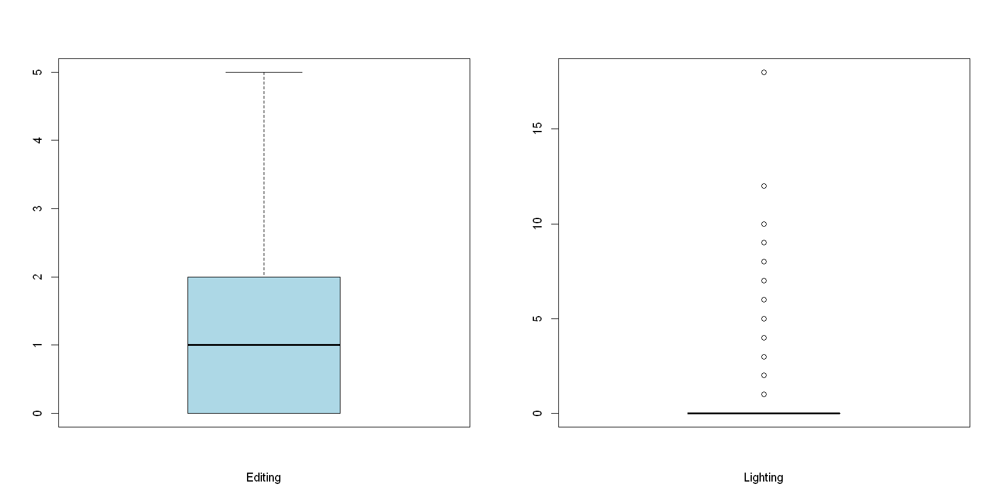

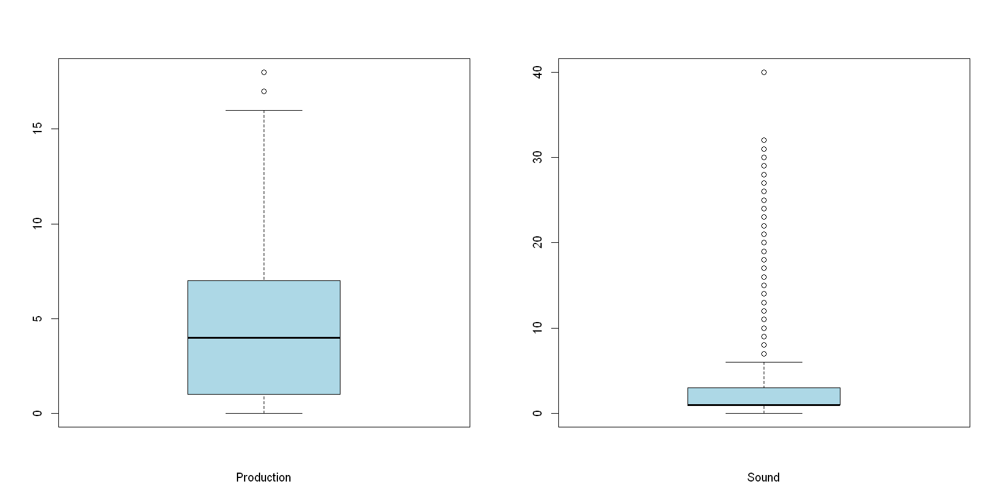

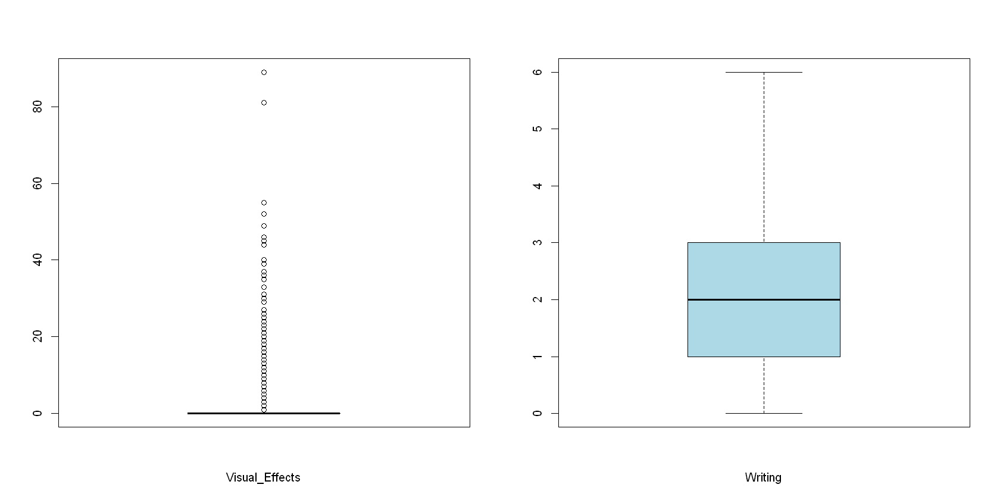

In [78]:
options(repr.plot.width =14, repr.plot.height = 7)
        par(mfrow=c(1,2))
for (n in numlst){
       boxplot(ff_final[[n]] , xlab = n, col = 'light blue')
    }

##### Outliers Matrix

In [79]:
ff_final_out <- outlierMatrix(ff_final)
head(ff_final_out)

,movie_id,revenue,revenue_log,runtime,popularity,release_year,release_month,Actors,Art,Camera,...,History,Horror,Music,Mystery,Romance,Science_Fiction,Thriller,TV_Movie,War,Western
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0,0,0,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


# END